In [3]:
import cv2
#import openpyxl

In [4]:

# import tensorflow.compat.v1 as tf
# tf.disable_v2_behavior()

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
# from keras.layers import Input, Dense, Reshape, Flatten, Dropout
# from keras.layers import BatchNormalization, Activation, ZeroPadding2D
# from keras.layers.advanced_activations import LeakyReLU
# from keras.layers.convolutional import UpSampling2D, Conv2D
#from keras.models import Sequential, Model
# #from keras.optimizers import Adam
# from keras.utils import np_utils

# from keras.backend import tensorflow_backend

import matplotlib.pyplot as plt
import os
import cv2
import numpy as np
# import rarfile as rar
from pathlib import Path

# import keras.callbacks

from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping()

custom_early_stopping = EarlyStopping(
    monitor='val_accuracy', 
    patience=8, 
    min_delta=0.001, 
    mode='max'
)

np.random.seed(0)
np.random.RandomState(0)
tf.random.set_seed(0)

config = tf.compat.v1.ConfigProto(gpu_options=tf.compat.v1.GPUOptions(allow_growth=True))
session = tf.compat.v1.Session(config=config)
tf.compat.v1.keras.backend.set_session(session)

root_dir = str(Path('../img/').resolve())
class_names = os.listdir(root_dir)
print(class_names)


['Black']


In [47]:
def makedirs(path):
    if not os.path.isdir(path):
        os.makedirs(path)

g_save_img_dir = 'data/gan_mm_B'
g_save_latent_dir = 'images/latent'

In [48]:
# import keras
# print(keras.__version__) 
import numpy as np
import cv2
import matplotlib.pyplot as plt
from decimal import Decimal, ROUND_HALF_UP


def dwt_haar(Img):
    
    if Img.shape[0] % 2 == 1 or Img.shape[1] % 2 == 1:
        print("画像のサイズは偶数にしろ。バグがあっても知らない")
    
    
    """
    １ブロックを
    [a b
     c d]と表すことにする
    """
    Img = Img.astype(np.float32)
    
    a = Img[0::2,0::2]
    b = Img[0::2,1::2]
    c = Img[1::2,0::2]
    d = Img[1::2,1::2]
    
    LL = (a + b + c + d) / 4
    LH = (a - b + c - d) / 4
    HL = (a + b - c - d) / 4
    HH = (a - b - c + d) / 4

    return LL,HL,LH,HH

"""
ハール基底のDWTを用いた透かしの抽出を行う関数
HL,LH,HHの最大値-最小値を四捨五入した値の偶数,奇数を参照することで埋め込まれた情報を取り出す。
"""
def ext_DWT(Img):

    Inv_Watermark = np.zeros( (4, 4) )
    count = 0
    
    haarLL = Img[0][:][:]
    haarHL = Img[1][:][:]
    haarLH = Img[2][:][:] 
    haarHH = Img[3][:][:]#dwt_haar(Img)
    #print("haarsize:",haarLL.shape)
    #print("image.shape[0]:   ",Img.shape[0])
    for i in range(int(Img.shape[0] )):
        for j in range(int(Img.shape[1] )):
            
            Max = max([ haarHL[i,j,0],haarLH[i,j,0],haarHH[i,j,0] ]) 
            Min = min([ haarHL[i,j,0],haarLH[i,j,0],haarHH[i,j,0] ]) 
            #print("Max:",Max,"Min",Min)
            #最大値-最小値を四捨五入した値を計算する
            diff = int(Decimal(str(Max - Min)).quantize(Decimal('0'), rounding=ROUND_HALF_UP))
            
            #最大値-最小値を四捨五入した値が奇数の場合は白しする
            if diff % 2 == 1:
                Inv_Watermark[i,j] = 255
                count=count+1
                
    return Inv_Watermark, count

"""
ハール基底を用いた逆DWTを行う
"""
def inv_dwt_haar(LL,HL,LH,HH):
    
    Img = np.zeros( (LL[0].size * 2, LL[1].size * 2) )
    
    Img[0::2,0::2] = LL + HL + LH + HH
    Img[1::2,0::2] = LL - HL + LH - HH
    Img[0::2,1::2] = LL + HL - LH - HH
    Img[1::2,1::2] = LL - HL - LH + HH
    
    
    return Img.clip(0, 255).astype(np.uint8)

In [49]:
class DCGAN():
    
    def __init__(self):

        self.class_names = os.listdir(root_dir)

        self.shape = (4, 4, 4) #(8, 8, 3)
        self.disc_size = (4, 4, 2) #(4, 4, 3)
        self.z_dim = 100
        
        self.totals=[]
        self.d_Loss=[]
        self.g_Loss=[]
        self.min=100
        
        self.top=0
        self.low=400


        optimizer = tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)

        self.discriminator = self.build_discriminator2()
        print("discriminator: ", type(self.discriminator))
        self.discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

        ori_noise, self.generator = self.build_generator()
        print("generator: ", self.generator)

        
        
        init = tf.compat.v1.global_variables_initializer()
        
        #下のものに差し替えたい
        self.combined = self.build_combined2()#self.build_combined2()
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer)

    # must under eagar mode
    def tensor_to_array(self, tensor1):
        return np.array(tensor1)


    def build_generator(self):
        noise_shape = (self.z_dim,)

        model = tf.keras.Sequential()

        model.add(layers.Dense(128 * 4 * 4 * 4, activation="LeakyReLU", input_shape=noise_shape))
        model.add(layers.Reshape((4, 4, 4, 128)))
        model.add(layers.BatchNormalization(momentum=0.8))
        #model.add(layers.UpSampling2D())
        model.add(layers.Conv2D(128, kernel_size=3, padding="same"))
        model.add(layers.Activation("LeakyReLU"))
        model.add(layers.BatchNormalization(momentum=0.8))
        #model.add(layers.UpSampling2D())
        model.add(layers.Conv2D(64, kernel_size=3, padding="same"))
        model.add(layers.Activation("LeakyReLU"))
        model.add(layers.BatchNormalization(momentum=0.8))
        model.add(layers.Conv2D(1, kernel_size=3, padding="same"))
        model.add(layers.Activation("tanh"))

        #model.summary()

        noise = keras.Input(shape=noise_shape)
        img = model(noise)
        print('In generator: img.shape = ', img.shape)

        return noise, keras.Model(noise, img)

    
    # Discriminator that learns from waveleted images
    def build_discriminator2(self):
        
        img_shape = self.disc_size
        
        model = tf.keras.Sequential()
        
        #model.add(layers.Conv2D(48, (1, 1), padding='same', input_shape=(2, 4, 4), activation='LeakyReLU'))
        model.add(layers.Conv2D(48, (1, 1), padding='same', input_shape=(4, 4, 2), activation='relu'))
        model.add(layers.Conv2D(128, (2, 2), padding='same', activation='LeakyReLU'))
        model.add(layers.Dropout(0.5))
        model.add(layers.Flatten())
        model.add(layers.Dense(128, activation='LeakyReLU'))
        model.add(layers.Dropout(0.5))
        model.add(layers.Dense(1, activation='sigmoid'))
        
        print('-- Model Summary: build_discriminator2 --')
        model.summary()
        
        img = keras.Input(shape=img_shape)
        validity = model(img)
        
        return keras.Model(img, validity)
    
    #generator学習時のモデル(discriminatorを含む)下のものより複雑なモデルを扱えるかも？
    def build_combined2(self):
        z = keras.Input(shape=(self.z_dim,))
        img = self.generator(z)
        #img = keras.layers.Lambda(lambda x:(0.5 * x + 0.5) * 255)(img)
        #print("img :",img.numpy())
        #mm = []
        mm = keras.layers.Lambda(lambda x:self.maxmin(x))(img)
        #print("model mm :",mm)
        #wav_img = keras.layers.Lambda(lambda x: self.wavelet_functional(x)/127.5)(img)
        #print("llllllllllllllllllll",wav_img.get_shape())
#         img = self.wavelet(img)
        
        self.discriminator.trainable = False
        valid = self.discriminator(mm)#img)
        #print("vvvvvvvvvvvvvvvvvvvvvvv",tf.shape(mm))
        #print(":::::::::::::::::::::::",valid)
        model = keras.Model(z, valid)

        print('-- Model Summary: build_combined2 --')
        model.summary()
        return model



    def build_combined(self):
        self.discriminator.trainable = False
        model = tf.keras.Sequential([self.generator, self.discriminator])

        return model

    def train(self, iterations, batch_size=128, save_interval=50, model_interval=1000, check_noise=None, r=5, c=5):

        X_train, labels = self.load_imgs()

        half_batch = int(batch_size / 2)

        #X_train = (X_train.astype(np.float32) - 127.5) / 127.5
        
        # save best_loss_val
        best_val_loss_D = 999
        best_val_loss_G = 999


        for iteration in range(iterations):

            # ------------------
            # Training Discriminator
            # -----------------            
            idx = np.random.randint(0, X_train.shape[0], half_batch)

            imgs = X_train[idx]

            noise = np.random.uniform(-1, 1, (half_batch, self.z_dim))

            gen_imgs = self.generator.predict(noise)
            gen_imgs = self.wavelets_gan(gen_imgs)
            #gen_imgs = np.squeeze(gen_imgs)
            #gen_imgs = (0.5 * gen_imgs + 0.5) * 255
            #gen_imgs = gen_imgs.astype(np.uint8)
#             print("gen_max0~255:",gen_imgs.max())
#             print("gen_min0~255:",gen_imgs.min())
            #print("gen_max:",gen_imgs.max())
            # generator: (8, 8, 1)
            # discremenator: (4, 4, 3)　-> (4, 4, 2)
            
            # normalize
            imgs = self.wavelets(imgs)/127.5
            #gen_imgs = self.wavelets(gen_imgs)/127.5
#             print("gen_max:",gen_imgs.max())
#             print("gen_min:",gen_imgs.min())

            #if iteration == 0 or g_loss2 <= 3:
            d_loss_real = self.discriminator.train_on_batch(imgs, np.ones((half_batch, 1)))
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, np.zeros((half_batch, 1))) 

            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            
            self.d_Loss.append(d_loss)

            # -----------------
            # Training Generator
            # -----------------

            noise = np.random.uniform(-1, 1, (batch_size, self.z_dim))

            g_loss = self.combined.train_on_batch(noise, np.ones((batch_size, 1)))
            g_loss2 = self.combined.train_on_batch(noise, np.ones((batch_size, 1)))
            self.g_Loss.append(g_loss2)
            
            if iteration == 1:
                print('d_loss_real : ', d_loss_real)
                print('d_loss_fake : ', d_loss_fake)
                print('g_loss : ', g_loss)

            print("%d [D loss: %f, acc.: %.2f%%] [G loss: %f, %f]" % (iteration, d_loss[0], 100 * d_loss[1], g_loss, g_loss2))
            
            if iteration % save_interval == 0:
                """グラフ表示"""
                plt.plot(range(len(self.g_Loss)), self.g_Loss, color = "red")
                plt.plot(range(len(self.g_Loss)), self.d_Loss, color = "blue");

                plt.show()


            model_dir = Path('ganmodels')
            model_dir.mkdir(exist_ok=True)
            if iteration % save_interval == 0:
                self.save_imgs(iteration, check_noise, r, c)
                start = np.expand_dims(check_noise[0], axis=0)
                end = np.expand_dims(check_noise[1], axis=0)
                resultImage = self.visualizeInterpolation(start=start, end=end)
                
                makedirs(g_save_latent_dir)
                cv2.imwrite("images/latent/" + "latent_{}.png".format(iteration), resultImage)
                if iteration % model_interval == 0:
                    self.generator.save(str(model_dir)+"/dcgan-{}-iter.h5".format(iteration))

    def save_imgs(self, iteration, check_noise, r, c):
        noise = check_noise
        gen_imgs = self.generator.predict(noise)
        #print(len(gen_imgs))
        W_imgs = np.zeros((len(gen_imgs),4,4))
        Imgs = np.zeros((len(gen_imgs),8,8))
        # 0-1 rescale
        #print(gen_imgs)
        gen_imgs = gen_imgs * 127.5  #(0.5 * gen_imgs + 0.5) * 255

        """ 透かし取り出し+黒の割合 """
        total = 0
        for i, img in enumerate(gen_imgs, 0):
            #print("i=", i , len(W_imgs))
            W_imgs[i], count = ext_DWT(img )
            total = total + count
        print("white ratio :",total/4) 
        
        
        """model save"""
        if total>self.top:
#             self.generator.save("img_generator_mmWl3.h5")
            self.top = total
    
        if total<self.low:
            self.generator.save("img_generator_mmB.h5")
            print("model saved!!!!!!!!!!!!!!!!!")
            self.low = total
            
        print("min :",self.low)
        print("max :",self.top)
        
        
        """グラフ表示"""
        self.totals.append(total)
        plt.plot(range(len(self.totals)),self.totals)
        plt.show()
        
        for i, img in enumerate(gen_imgs, 0):
            #print("i=", i , len(W_imgs))
            img = img.reshape(4,4,4)
            Imgs[i] = inv_dwt_haar(img[0],img[1],img[2],img[3])
            
        #print(W_imgs.shape)
        
        """"""
        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                #axs[i, j].imshow(gen_imgs[cnt, :, :])#, :])
                axs[i, j].imshow(W_imgs[cnt, :, :],cmap = 'gray')#, :])
                axs[i, j].axis('off')
                cnt += 1
        
        makedirs(g_save_img_dir)
        fig.savefig('data/gan_mm_B/watermark_i%d_t%d.png' % (iteration, total))
        
        cnt = 0
        for i in range(r):
            for j in range(c):
                #axs[i, j].imshow(gen_imgs[cnt, :, :])#, :])
                axs[i, j].imshow(Imgs[cnt, :, :],cmap = 'gray')#, :])
                axs[i, j].axis('off')
                cnt += 1
        
        makedirs(g_save_img_dir)
        fig.savefig('data/gan_mm_B/inv_image_i%d_t%d.png' % (iteration, total))
        plt.close()
        
    def get_class_one_hot(self, class_str):
        label_encoded = self.class_names.index(class_str)

        label_hot = tf.keras.utils.to_categorical(label_encoded, len(self.class_names))
        label_hot = label_hot

        return label_hot

    def load_imgs(self, ret_wavelet=False):
        img_paths = []
        labels = []
        images = []
        w_images = []

        for cl_name in class_names:
            print(cl_name)
            img_dir_names = os.listdir(os.path.join(root_dir, cl_name))

            for img_dir_name in img_dir_names:
                img_names = os.listdir(os.path.join(root_dir, cl_name, img_dir_name))

                for img_name in img_names:
                    img_paths.append(os.path.abspath(os.path.join(root_dir, cl_name, img_dir_name, img_name)))
                    hot_cl_name = self.get_class_one_hot(cl_name)
                    labels.append(hot_cl_name)

        for img_path in img_paths:
            img = cv2.imread(img_path)

            # (8, 8, 3) -> (8, 8, 1)へ次元を削減 すべて同じ値なので
            img = np.delete(img, [1, 2], 2)
            images.append(img)
            w_image = np.zeros((4, 4, 3))
            MM_image = np.zeros((4,4,2))
            for num in range(0, 4):
                for ber in range(0, 4):
                    w_image[num][ber][0] = (img[num*2][ber*2] - img[num*2+1][ber*2] + img[num*2][ber*2+1] - img[num*2+1][ber*2+1]) / 4
                    w_image[num][ber][1] = (img[num*2][ber*2] + img[num*2+1][ber*2] - img[num*2][ber*2+1] - img[num*2+1][ber*2+1]) / 4
                    w_image[num][ber][2] = (img[num*2][ber*2] - img[num*2+1][ber*2] - img[num*2][ber*2+1] + img[num*2+1][ber*2+1]) / 4
                    MM_image[num][ber][0] = max([w_image[num][ber][0],w_image[num][ber][1],w_image[num][ber][2]])
                    MM_image[num][ber][1] = min([w_image[num][ber][0],w_image[num][ber][1],w_image[num][ber][2]])
            #w_images.append(MM_image)
            w_images.append(w_image)

        images = np.array(images)

        if ret_wavelet:
            return np.array(w_images), np.array(labels)
        else:
            return np.array(images), np.array(labels)

   

    def visualizeInterpolation(self, start, end, save=True, nbSteps=10):
        print("Generating interpolations...")

        steps = nbSteps
        latentStart = start
        latentEnd = end

        startImg = self.generator.predict(latentStart)
        endImg = self.generator.predict(latentEnd)

        vectors = []

        alphaValues = np.linspace(0, 1, steps)
        for alpha in alphaValues:
            vector = latentStart * (1 - alpha) + latentEnd * alpha
            vectors.append(vector)

        vectors = np.array(vectors)

        resultLatent = None
        resultImage = None

        for i, vec in enumerate(vectors):
            gen_img = np.squeeze(self.generator.predict(vec), axis=0)
            gen_img = (0.5 * gen_img + 0.5) * 255
            interpolatedImage = gen_img #cv2.cvtColor(gen_img, cv2.COLOR_RGB2BGR)
            interpolatedImage = interpolatedImage.astype(np.uint8)
            resultImage = interpolatedImage if resultImage is None else np.hstack([resultImage, interpolatedImage])

        return resultImage
    
    def wavelet_transformation(self, imgs):
        a = imgs[:,0::2,0::2]
        b = imgs[:,0::2,1::2]
        c = imgs[:,1::2,0::2]
        d = imgs[:,1::2,1::2]
        
        LL = (a + b + c + d) / 4
        LH = (a - b + c - d) / 4
        HL = (a + b - c - d) / 4
        HH = (a - b - c + d) / 4
        
        
        
        return LL, LH, HL, HH

    def wavelets(self, imgs):            
        LL, LH, HL, HH = self.wavelet_transformation(imgs)
        #batch_size=16 -> 16*4*4 = 256 もっといい方法あるはずだけど、とりあえず
        
        cLH = LH.reshape(256)
        cHL = HL.reshape(256)
        cHH = HH.reshape(256)
        l = np.zeros((512))
        l1 = list(map(max,cLH,cHH,cHL))
        l2 = list(map(min,cLH,cHH,cHL))
        
        L1 = np.array(l1).reshape(16,4,4)
        L2 = np.array(l2).reshape(16,4,4)
        
        #L = np.stack([L1, L2], axis=2)
        #return np.concatenate([LL,LH, HL, HH], axis=3)
        return np.stack([L1, L2], axis=3)
    
    def wavelets_gan(self, imgs):            
        #LL, LH, HL, HH = self.wavelet_transformation(imgs)
        #batch_size=16 -> 16*4*4 = 256 もっといい方法あるはずだけど、とりあえず
        
        LL = imgs[:, 0, :, :,:]
        LH = imgs[:, 1, :, :,:]
        HL = imgs[:, 2, :, :,:]
        HH = imgs[:, 3, :, :,:]
        
        cLH = LH.reshape(256)
        cHL = HL.reshape(256)
        cHH = HH.reshape(256)

        l1 = list(map(max,cLH,cHH,cHL))
        l2 = list(map(min,cLH,cHH,cHL))
        
        L1 = np.array(l1).reshape(16,4,4)
        L2 = np.array(l2).reshape(16,4,4)
        
        #L = np.stack([L1, L2], axis=2)
        #return np.concatenate([LL,LH, HL, HH], axis=3)
        return np.stack([L1, L2], axis=3)

        
    def wavelet_functional(self, imgs):
        # Placeholder, v, h, channels
        LL, LH, HL, HH = self.wavelet_transformation(imgs)
        print("imgs::::", imgs)
        
        
        #Max, Min = MaxMin(LH, HL, HH)

        #return tf.concat([Max, Min], axis=2)
        return tf.concat([LL,LH, HL, HH], axis=3)
    
    def maxmin(self, imgs):

        LL = imgs[:, 0, :, :,:]
        LH = imgs[:, 1, :, :,:]
        HL = imgs[:, 2, :, :,:]
        HH = imgs[:, 3, :, :,:]
       
        
        #print("hhhhhhhhhhhhhhhhhhh",tf.size(LH))

        @tf.function
        #for文が使えない？=>使えるはず
        def MaxMin(LH, HL, HH):
            #print("hhhhhhhhhhhhhhhhhhh",tf.shape(LH[0,1,0,0]))
            n=-1
            # (4, 4, 2) : 0 init
            mx=[[[0.0] * 2 for i in range(4)] for i in range(4)]
            #mn=[[[0] * 2] * 4] * 4
#             Max= tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)
#             Min= tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)
            Max = []
            Min = []
        #ここのforをどのように回すのか？batch_sizeを指定したらだめなのか？
            #for L in LL:
            for n in range(32):
                #n=n+1
                #print("pppppppppppppp",n)
                for i in range(4):
                    for j in range(4):
                        mx[i][j][0] = LH[n,i,j,0]
                        mx[i][j][1] = LH[n,i,j,0]
                        
                        fmax1 = mx[i][j][0] < HL[n,i,j,0]
                        fmax2 = mx[i][j][0] < HH[n,i,j,0]
                        fmin1 = mx[i][j][1] > HL[n,i,j,0]
                        fmin2 = mx[i][j][1] > HH[n,i,j,0]
                        
                        mx[i][j][0] = tf.cond(fmax1,true_fn=lambda: HL[n,i,j,0],false_fn=lambda:mx[i][j][0])
                        mx[i][j][0] = tf.cond(fmax2,true_fn=lambda: HL[n,i,j,0],false_fn=lambda:mx[i][j][0])
                        mx[i][j][1] = tf.cond(fmin1,true_fn=lambda: HL[n,i,j,0],false_fn=lambda:mx[i][j][1])
                        mx[i][j][1] = tf.cond(fmin2,true_fn=lambda: HL[n,i,j,0],false_fn=lambda:mx[i][j][1])
#                         mx[i,j] = max(LH[n,i,j],HL[n,i,j],HH[n,i,j])
#                         mx[i,j] = min(LH[n,i,j],HL[n,i,j],HH[n,i,j])
                
                Max.append(mx)
                #Min.append(mn)
#                 Max = Max.write(index=n, value=mx)
#                 Min = Min.write(index=n, value=mn)
                #print("lllllllllllllllllll",len(Max))
        
           
            #return [Max.stack(), Min.stack()]
            return Max
        
        Mx = MaxMin(LH, HL, HH)
        #print("Mx in maxmin :",Mx)
#         print(np.array(Mx).shape)
#         print(tf.convert_to_tensor(Mx))
#         print("kkkkkkkkkkkkkkkkk",tf.shape(Mx))
#         print("kkkkkkkkkkkkkkkkk",tf.shape([0, 0, 0]))
        
#         print("kkkkkkkkkkkkkkkkk2",Mx)
        
        
        #return tf.concat([Mx, Mn], axis=4)
        #return Mx#tf.stack([Mx, Mn])
        return tf.convert_to_tensor(Mx)
    #おそらく結果が[2,none,4,4]になるが、これを[none,4,4,2]にしたい
   
   

-- Model Summary: build_discriminator2 --
Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_80 (Conv2D)           (None, 4, 4, 48)          144       
_________________________________________________________________
conv2d_81 (Conv2D)           (None, 4, 4, 128)         24704     
_________________________________________________________________
dropout_32 (Dropout)         (None, 4, 4, 128)         0         
_________________________________________________________________
flatten_16 (Flatten)         (None, 2048)              0         
_________________________________________________________________
dense_48 (Dense)             (None, 128)               262272    
_________________________________________________________________
dropout_33 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_49 (D

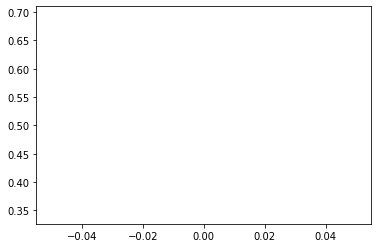

white ratio : 51.5
model saved!!!!!!!!!!!!!!!!!
min : 206
max : 206


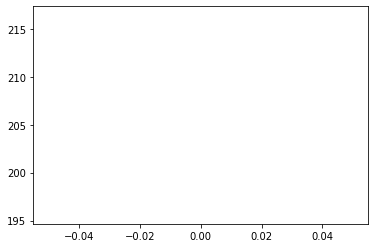

Generating interpolations...
d_loss_real :  [0.6342605948448181, 1.0]
d_loss_fake :  [0.716472864151001, 0.0]
g_loss :  0.6000041365623474
1 [D loss: 0.675367, acc.: 50.00%] [G loss: 0.600004, 0.468077]
2 [D loss: 0.683531, acc.: 50.00%] [G loss: 0.554366, 0.410895]
3 [D loss: 0.683213, acc.: 50.00%] [G loss: 0.446966, 0.341335]
4 [D loss: 0.679500, acc.: 50.00%] [G loss: 0.603588, 0.334161]
5 [D loss: 0.667292, acc.: 46.88%] [G loss: 0.557234, 0.287431]
6 [D loss: 0.679674, acc.: 59.38%] [G loss: 0.418751, 0.261598]
7 [D loss: 0.647592, acc.: 75.00%] [G loss: 0.779161, 0.302594]
8 [D loss: 0.657923, acc.: 75.00%] [G loss: 0.856423, 0.359809]
9 [D loss: 0.671572, acc.: 53.12%] [G loss: 1.389815, 1.375271]
10 [D loss: 0.602603, acc.: 75.00%] [G loss: 0.725573, 0.451345]
11 [D loss: 0.598621, acc.: 81.25%] [G loss: 1.253633, 0.501593]
12 [D loss: 0.528149, acc.: 78.12%] [G loss: 0.612354, 0.478219]
13 [D loss: 0.500722, acc.: 71.88%] [G loss: 0.870440, 0.579235]
14 [D loss: 0.526372, acc

123 [D loss: 0.011690, acc.: 100.00%] [G loss: 8.156097, 8.396770]
124 [D loss: 0.006164, acc.: 100.00%] [G loss: 6.107571, 8.755478]
125 [D loss: 0.020661, acc.: 100.00%] [G loss: 9.391498, 9.907511]
126 [D loss: 0.005676, acc.: 100.00%] [G loss: 8.783010, 9.455496]
127 [D loss: 0.008683, acc.: 100.00%] [G loss: 8.428547, 9.694595]
128 [D loss: 0.010801, acc.: 100.00%] [G loss: 9.309755, 7.620605]
129 [D loss: 0.009510, acc.: 100.00%] [G loss: 7.930858, 10.238051]
130 [D loss: 0.008943, acc.: 100.00%] [G loss: 10.960891, 9.821569]
131 [D loss: 0.008943, acc.: 100.00%] [G loss: 11.518768, 12.283343]
132 [D loss: 0.010026, acc.: 100.00%] [G loss: 3.612664, 11.449778]
133 [D loss: 0.008509, acc.: 100.00%] [G loss: 4.021986, 9.641943]
134 [D loss: 0.007486, acc.: 100.00%] [G loss: 11.893494, 8.416435]
135 [D loss: 0.005923, acc.: 100.00%] [G loss: 7.259107, 9.970383]
136 [D loss: 0.007287, acc.: 100.00%] [G loss: 8.514616, 8.957724]
137 [D loss: 0.008546, acc.: 100.00%] [G loss: 9.211482,

246 [D loss: 0.108105, acc.: 96.88%] [G loss: 0.839486, 0.407987]
247 [D loss: 0.228223, acc.: 90.62%] [G loss: 0.170094, 0.067809]
248 [D loss: 0.115181, acc.: 96.88%] [G loss: 3.686463, 4.748126]
249 [D loss: 0.120797, acc.: 93.75%] [G loss: 1.920928, 2.253373]
250 [D loss: 0.252523, acc.: 84.38%] [G loss: 2.422270, 0.259548]
251 [D loss: 0.193258, acc.: 90.62%] [G loss: 0.399047, 0.095506]
252 [D loss: 0.290543, acc.: 87.50%] [G loss: 0.208230, 0.125887]
253 [D loss: 0.305186, acc.: 87.50%] [G loss: 0.637759, 0.101439]
254 [D loss: 0.454568, acc.: 71.88%] [G loss: 0.225652, 0.159977]
255 [D loss: 0.536613, acc.: 68.75%] [G loss: 1.146871, 0.323515]
256 [D loss: 0.526621, acc.: 68.75%] [G loss: 0.901629, 0.272217]
257 [D loss: 0.414775, acc.: 81.25%] [G loss: 1.167796, 0.755414]
258 [D loss: 0.277315, acc.: 84.38%] [G loss: 2.958207, 0.367882]
259 [D loss: 0.168486, acc.: 93.75%] [G loss: 1.621567, 0.867121]
260 [D loss: 0.226249, acc.: 90.62%] [G loss: 0.936880, 0.792354]
261 [D los

371 [D loss: 0.205305, acc.: 93.75%] [G loss: 2.121913, 1.026820]
372 [D loss: 0.176821, acc.: 93.75%] [G loss: 2.602782, 1.770181]
373 [D loss: 0.088492, acc.: 96.88%] [G loss: 2.185660, 1.238072]
374 [D loss: 0.180001, acc.: 93.75%] [G loss: 2.783242, 3.375149]
375 [D loss: 0.204901, acc.: 90.62%] [G loss: 3.792622, 2.935141]
376 [D loss: 0.112078, acc.: 96.88%] [G loss: 1.960424, 1.213124]
377 [D loss: 0.193246, acc.: 96.88%] [G loss: 2.401429, 1.976830]
378 [D loss: 0.361044, acc.: 87.50%] [G loss: 2.162598, 1.745534]
379 [D loss: 0.264450, acc.: 87.50%] [G loss: 3.024830, 2.541543]
380 [D loss: 0.243232, acc.: 84.38%] [G loss: 1.364708, 0.611421]
381 [D loss: 0.233661, acc.: 90.62%] [G loss: 2.957622, 0.123475]
382 [D loss: 0.295195, acc.: 87.50%] [G loss: 2.342198, 1.746357]
383 [D loss: 0.286563, acc.: 87.50%] [G loss: 1.763132, 1.023968]
384 [D loss: 0.315722, acc.: 87.50%] [G loss: 2.986619, 3.175759]
385 [D loss: 0.127440, acc.: 96.88%] [G loss: 5.412265, 3.618478]
386 [D los

497 [D loss: 0.266065, acc.: 90.62%] [G loss: 1.354136, 0.197004]
498 [D loss: 0.197838, acc.: 90.62%] [G loss: 1.828447, 0.563740]
499 [D loss: 0.234808, acc.: 93.75%] [G loss: 1.560122, 1.264600]
500 [D loss: 0.276695, acc.: 90.62%] [G loss: 1.467383, 0.770257]
501 [D loss: 0.239000, acc.: 84.38%] [G loss: 1.364619, 0.903675]
502 [D loss: 0.246329, acc.: 90.62%] [G loss: 1.243420, 1.001080]
503 [D loss: 0.272100, acc.: 84.38%] [G loss: 1.102704, 0.801225]
504 [D loss: 0.358113, acc.: 87.50%] [G loss: 0.327738, 0.129681]
505 [D loss: 0.198304, acc.: 90.62%] [G loss: 1.177180, 0.880971]
506 [D loss: 0.230304, acc.: 90.62%] [G loss: 1.202750, 1.240361]
507 [D loss: 0.569564, acc.: 71.88%] [G loss: 0.183028, 0.102430]
508 [D loss: 0.529091, acc.: 68.75%] [G loss: 0.083594, 0.064362]
509 [D loss: 0.335721, acc.: 84.38%] [G loss: 0.897811, 0.609622]
510 [D loss: 0.187572, acc.: 93.75%] [G loss: 1.258186, 0.669718]
511 [D loss: 0.440064, acc.: 75.00%] [G loss: 1.592081, 1.050904]
512 [D los

624 [D loss: 0.086427, acc.: 100.00%] [G loss: 2.586478, 1.833717]
625 [D loss: 0.056861, acc.: 100.00%] [G loss: 3.942268, 3.655034]
626 [D loss: 0.121405, acc.: 96.88%] [G loss: 3.514708, 3.251689]
627 [D loss: 0.040045, acc.: 100.00%] [G loss: 2.377216, 1.574456]
628 [D loss: 0.108453, acc.: 96.88%] [G loss: 2.403272, 1.357867]
629 [D loss: 0.174784, acc.: 93.75%] [G loss: 1.614600, 0.609576]
630 [D loss: 0.122387, acc.: 100.00%] [G loss: 0.256934, 0.162702]
631 [D loss: 0.157259, acc.: 93.75%] [G loss: 0.900896, 1.994593]
632 [D loss: 0.157403, acc.: 93.75%] [G loss: 3.310499, 2.357553]
633 [D loss: 0.258287, acc.: 87.50%] [G loss: 0.109845, 0.099367]
634 [D loss: 0.106481, acc.: 100.00%] [G loss: 0.730650, 0.619540]
635 [D loss: 0.178891, acc.: 93.75%] [G loss: 3.119418, 1.917342]
636 [D loss: 0.191361, acc.: 90.62%] [G loss: 7.853456, 2.335266]
637 [D loss: 0.154759, acc.: 93.75%] [G loss: 0.360968, 0.285454]
638 [D loss: 0.071246, acc.: 100.00%] [G loss: 3.486077, 2.433348]
639 

751 [D loss: 0.088004, acc.: 100.00%] [G loss: 1.308484, 0.230206]
752 [D loss: 0.042447, acc.: 100.00%] [G loss: 8.401550, 2.427995]
753 [D loss: 0.052452, acc.: 100.00%] [G loss: 2.476032, 2.516017]
754 [D loss: 0.067438, acc.: 100.00%] [G loss: 1.476099, 0.851071]
755 [D loss: 0.165696, acc.: 90.62%] [G loss: 2.219023, 1.396960]
756 [D loss: 0.141091, acc.: 93.75%] [G loss: 0.524710, 0.133220]
757 [D loss: 0.070435, acc.: 96.88%] [G loss: 0.854294, 0.234006]
758 [D loss: 0.145160, acc.: 90.62%] [G loss: 0.108897, 0.051671]
759 [D loss: 0.136307, acc.: 93.75%] [G loss: 0.024373, 0.020515]
760 [D loss: 0.110684, acc.: 96.88%] [G loss: 3.056224, 2.063023]
761 [D loss: 0.070812, acc.: 100.00%] [G loss: 0.317677, 0.162147]
762 [D loss: 0.097079, acc.: 96.88%] [G loss: 1.452030, 1.165448]
763 [D loss: 0.200609, acc.: 90.62%] [G loss: 0.230548, 0.133033]
764 [D loss: 0.191593, acc.: 90.62%] [G loss: 4.824033, 1.339773]
765 [D loss: 0.125885, acc.: 96.88%] [G loss: 0.096081, 0.076357]
766 [

875 [D loss: 0.031481, acc.: 100.00%] [G loss: 0.458288, 0.065270]
876 [D loss: 0.041536, acc.: 100.00%] [G loss: 0.792295, 0.290098]
877 [D loss: 0.135972, acc.: 96.88%] [G loss: 0.281644, 0.019254]
878 [D loss: 0.109206, acc.: 96.88%] [G loss: 0.095153, 0.097268]
879 [D loss: 0.107039, acc.: 96.88%] [G loss: 0.343739, 0.289578]
880 [D loss: 0.102488, acc.: 96.88%] [G loss: 1.186541, 1.771127]
881 [D loss: 0.078278, acc.: 100.00%] [G loss: 2.480544, 3.775480]
882 [D loss: 0.061377, acc.: 100.00%] [G loss: 0.100028, 0.253469]
883 [D loss: 0.083239, acc.: 96.88%] [G loss: 1.125391, 0.448780]
884 [D loss: 0.049612, acc.: 100.00%] [G loss: 1.579792, 0.275103]
885 [D loss: 0.214141, acc.: 87.50%] [G loss: 1.059705, 0.226161]
886 [D loss: 0.031717, acc.: 100.00%] [G loss: 1.340543, 3.150458]
887 [D loss: 0.054401, acc.: 100.00%] [G loss: 1.800669, 0.857767]
888 [D loss: 0.086191, acc.: 100.00%] [G loss: 0.097168, 0.079255]
889 [D loss: 0.155663, acc.: 93.75%] [G loss: 0.059832, 0.054606]
89

998 [D loss: 0.180880, acc.: 90.62%] [G loss: 0.555263, 0.127826]
999 [D loss: 0.081747, acc.: 96.88%] [G loss: 4.179402, 4.370750]
1000 [D loss: 0.145434, acc.: 93.75%] [G loss: 0.826769, 1.311219]


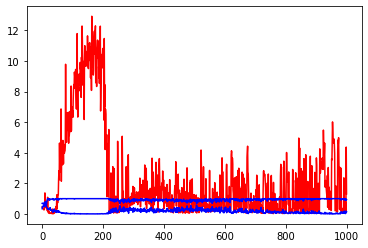

white ratio : 50.25
model saved!!!!!!!!!!!!!!!!!
min : 201
max : 206


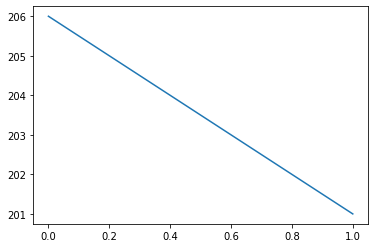

Generating interpolations...
1001 [D loss: 0.091197, acc.: 96.88%] [G loss: 1.843523, 3.410951]
1002 [D loss: 0.062469, acc.: 96.88%] [G loss: 3.233160, 2.962021]
1003 [D loss: 0.044050, acc.: 100.00%] [G loss: 2.365426, 1.411690]
1004 [D loss: 0.017046, acc.: 100.00%] [G loss: 2.863576, 2.325031]
1005 [D loss: 0.047824, acc.: 100.00%] [G loss: 1.399048, 0.721585]
1006 [D loss: 0.055072, acc.: 100.00%] [G loss: 0.428714, 0.095275]
1007 [D loss: 0.213148, acc.: 90.62%] [G loss: 0.392818, 0.068376]
1008 [D loss: 0.260985, acc.: 84.38%] [G loss: 1.068309, 0.784227]
1009 [D loss: 0.073299, acc.: 100.00%] [G loss: 0.939950, 1.341589]
1010 [D loss: 0.169729, acc.: 90.62%] [G loss: 2.711980, 1.461465]
1011 [D loss: 0.137464, acc.: 90.62%] [G loss: 0.528298, 0.133925]
1012 [D loss: 0.126480, acc.: 90.62%] [G loss: 4.424001, 2.923705]
1013 [D loss: 0.238608, acc.: 90.62%] [G loss: 1.735848, 0.385024]
1014 [D loss: 0.123635, acc.: 96.88%] [G loss: 2.596676, 0.400619]
1015 [D loss: 0.185896, acc.

1124 [D loss: 0.005522, acc.: 100.00%] [G loss: 4.642695, 4.595250]
1125 [D loss: 0.009653, acc.: 100.00%] [G loss: 4.463239, 3.521147]
1126 [D loss: 0.007219, acc.: 100.00%] [G loss: 4.177319, 4.064946]
1127 [D loss: 0.041968, acc.: 96.88%] [G loss: 3.356775, 2.666071]
1128 [D loss: 0.011452, acc.: 100.00%] [G loss: 3.650257, 3.115897]
1129 [D loss: 0.007235, acc.: 100.00%] [G loss: 3.207013, 2.747040]
1130 [D loss: 0.002950, acc.: 100.00%] [G loss: 3.239946, 3.013962]
1131 [D loss: 0.004046, acc.: 100.00%] [G loss: 1.890610, 1.415601]
1132 [D loss: 0.009041, acc.: 100.00%] [G loss: 1.771915, 0.752263]
1133 [D loss: 0.003039, acc.: 100.00%] [G loss: 6.819157, 3.421716]
1134 [D loss: 0.033033, acc.: 100.00%] [G loss: 1.738740, 1.497870]
1135 [D loss: 0.017240, acc.: 100.00%] [G loss: 3.590162, 2.088787]
1136 [D loss: 0.031404, acc.: 100.00%] [G loss: 1.014963, 0.342989]
1137 [D loss: 0.064739, acc.: 96.88%] [G loss: 5.253560, 3.205317]
1138 [D loss: 0.041744, acc.: 96.88%] [G loss: 3.2

1248 [D loss: 0.010839, acc.: 100.00%] [G loss: 2.642638, 2.684875]
1249 [D loss: 0.004594, acc.: 100.00%] [G loss: 3.246706, 3.249667]
1250 [D loss: 0.004684, acc.: 100.00%] [G loss: 7.560215, 5.211810]
1251 [D loss: 0.003893, acc.: 100.00%] [G loss: 3.567781, 3.352195]
1252 [D loss: 0.005893, acc.: 100.00%] [G loss: 4.274024, 3.436343]
1253 [D loss: 0.001904, acc.: 100.00%] [G loss: 3.527485, 3.464122]
1254 [D loss: 0.013615, acc.: 100.00%] [G loss: 7.941723, 5.936796]
1255 [D loss: 0.025890, acc.: 100.00%] [G loss: 3.137825, 2.716512]
1256 [D loss: 0.017123, acc.: 100.00%] [G loss: 3.595714, 3.739805]
1257 [D loss: 0.030810, acc.: 100.00%] [G loss: 3.100260, 2.740918]
1258 [D loss: 0.026225, acc.: 100.00%] [G loss: 3.715864, 3.856149]
1259 [D loss: 0.011038, acc.: 100.00%] [G loss: 4.104637, 3.956845]
1260 [D loss: 0.005805, acc.: 100.00%] [G loss: 3.825625, 3.835907]
1261 [D loss: 0.029854, acc.: 96.88%] [G loss: 2.822958, 2.392303]
1262 [D loss: 0.007597, acc.: 100.00%] [G loss: 4

1371 [D loss: 0.004697, acc.: 100.00%] [G loss: 4.867871, 4.794179]
1372 [D loss: 0.006416, acc.: 100.00%] [G loss: 5.265824, 4.904943]
1373 [D loss: 0.009238, acc.: 100.00%] [G loss: 5.019158, 5.102493]
1374 [D loss: 0.041391, acc.: 96.88%] [G loss: 4.726781, 4.613573]
1375 [D loss: 0.011251, acc.: 100.00%] [G loss: 4.366038, 3.764109]
1376 [D loss: 0.013767, acc.: 100.00%] [G loss: 4.718460, 4.556293]
1377 [D loss: 0.005367, acc.: 100.00%] [G loss: 5.370403, 5.303135]
1378 [D loss: 0.056886, acc.: 96.88%] [G loss: 4.331222, 4.385201]
1379 [D loss: 0.007293, acc.: 100.00%] [G loss: 4.615927, 4.885181]
1380 [D loss: 0.009983, acc.: 100.00%] [G loss: 4.984963, 5.127392]
1381 [D loss: 0.001880, acc.: 100.00%] [G loss: 4.841472, 5.237571]
1382 [D loss: 0.003534, acc.: 100.00%] [G loss: 5.686742, 4.812901]
1383 [D loss: 0.005769, acc.: 100.00%] [G loss: 5.255002, 4.937315]
1384 [D loss: 0.029874, acc.: 96.88%] [G loss: 4.910588, 5.055117]
1385 [D loss: 0.003012, acc.: 100.00%] [G loss: 4.5

1493 [D loss: 0.007121, acc.: 100.00%] [G loss: 3.940939, 3.705802]
1494 [D loss: 0.004669, acc.: 100.00%] [G loss: 4.609274, 3.757030]
1495 [D loss: 0.007099, acc.: 100.00%] [G loss: 4.606549, 4.072724]
1496 [D loss: 0.004918, acc.: 100.00%] [G loss: 4.991885, 4.819867]
1497 [D loss: 0.038518, acc.: 96.88%] [G loss: 4.291815, 4.080035]
1498 [D loss: 0.006583, acc.: 100.00%] [G loss: 3.556969, 2.984957]
1499 [D loss: 0.014978, acc.: 100.00%] [G loss: 2.203913, 1.037628]
1500 [D loss: 0.027320, acc.: 100.00%] [G loss: 3.052720, 1.864456]
1501 [D loss: 0.002385, acc.: 100.00%] [G loss: 0.800379, 0.085546]
1502 [D loss: 0.004298, acc.: 100.00%] [G loss: 0.064744, 0.057575]
1503 [D loss: 0.020455, acc.: 100.00%] [G loss: 0.961047, 0.103188]
1504 [D loss: 0.057822, acc.: 93.75%] [G loss: 0.117208, 0.078633]
1505 [D loss: 0.028254, acc.: 100.00%] [G loss: 0.605594, 0.103741]
1506 [D loss: 0.123445, acc.: 90.62%] [G loss: 1.043355, 0.385538]
1507 [D loss: 0.056957, acc.: 96.88%] [G loss: 0.20

1615 [D loss: 0.003236, acc.: 100.00%] [G loss: 4.602155, 4.279126]
1616 [D loss: 0.005081, acc.: 100.00%] [G loss: 5.088456, 5.046043]
1617 [D loss: 0.001924, acc.: 100.00%] [G loss: 5.119574, 4.973330]
1618 [D loss: 0.001436, acc.: 100.00%] [G loss: 4.598061, 4.806646]
1619 [D loss: 0.004617, acc.: 100.00%] [G loss: 5.695015, 5.325250]
1620 [D loss: 0.002938, acc.: 100.00%] [G loss: 5.114858, 4.701446]
1621 [D loss: 0.028162, acc.: 96.88%] [G loss: 5.232789, 5.066728]
1622 [D loss: 0.004077, acc.: 100.00%] [G loss: 4.364729, 3.661456]
1623 [D loss: 0.003372, acc.: 100.00%] [G loss: 4.447761, 4.165347]
1624 [D loss: 0.003392, acc.: 100.00%] [G loss: 4.885349, 4.677666]
1625 [D loss: 0.023581, acc.: 100.00%] [G loss: 4.556856, 4.374750]
1626 [D loss: 0.007592, acc.: 100.00%] [G loss: 6.101514, 4.702641]
1627 [D loss: 0.003562, acc.: 100.00%] [G loss: 3.712437, 2.826055]
1628 [D loss: 0.003061, acc.: 100.00%] [G loss: 4.480242, 3.206917]
1629 [D loss: 0.031923, acc.: 100.00%] [G loss: 5

1738 [D loss: 0.008679, acc.: 100.00%] [G loss: 4.639994, 4.212974]
1739 [D loss: 0.007317, acc.: 100.00%] [G loss: 4.552000, 4.728350]
1740 [D loss: 0.004634, acc.: 100.00%] [G loss: 5.117212, 4.743528]
1741 [D loss: 0.004117, acc.: 100.00%] [G loss: 5.378934, 5.062466]
1742 [D loss: 0.004452, acc.: 100.00%] [G loss: 5.258041, 4.953275]
1743 [D loss: 0.003574, acc.: 100.00%] [G loss: 5.882330, 5.575400]
1744 [D loss: 0.003891, acc.: 100.00%] [G loss: 4.640476, 4.799235]
1745 [D loss: 0.003395, acc.: 100.00%] [G loss: 5.005993, 4.880591]
1746 [D loss: 0.002257, acc.: 100.00%] [G loss: 6.069113, 5.646850]
1747 [D loss: 0.005693, acc.: 100.00%] [G loss: 4.211236, 4.182881]
1748 [D loss: 0.004010, acc.: 100.00%] [G loss: 4.720757, 4.529047]
1749 [D loss: 0.002824, acc.: 100.00%] [G loss: 10.728753, 4.737895]
1750 [D loss: 0.002475, acc.: 100.00%] [G loss: 4.913958, 5.076092]
1751 [D loss: 0.002466, acc.: 100.00%] [G loss: 4.550272, 4.850023]
1752 [D loss: 0.002855, acc.: 100.00%] [G loss:

1859 [D loss: 0.010673, acc.: 100.00%] [G loss: 4.281053, 3.383187]
1860 [D loss: 0.004655, acc.: 100.00%] [G loss: 4.971189, 2.133041]
1861 [D loss: 0.012797, acc.: 100.00%] [G loss: 3.614251, 2.391493]
1862 [D loss: 0.083157, acc.: 96.88%] [G loss: 0.209068, 0.069063]
1863 [D loss: 0.003744, acc.: 100.00%] [G loss: 2.690645, 0.227763]
1864 [D loss: 0.124430, acc.: 96.88%] [G loss: 0.368891, 0.599772]
1865 [D loss: 0.027232, acc.: 100.00%] [G loss: 5.050465, 5.835839]
1866 [D loss: 0.011075, acc.: 100.00%] [G loss: 0.224909, 0.066997]
1867 [D loss: 0.064414, acc.: 96.88%] [G loss: 0.060695, 0.053025]
1868 [D loss: 0.057425, acc.: 96.88%] [G loss: 0.016860, 0.012307]
1869 [D loss: 0.029855, acc.: 100.00%] [G loss: 0.043949, 0.028358]
1870 [D loss: 0.094347, acc.: 96.88%] [G loss: 0.051768, 0.042261]
1871 [D loss: 0.130013, acc.: 96.88%] [G loss: 0.040477, 0.034093]
1872 [D loss: 0.051049, acc.: 100.00%] [G loss: 5.218948, 5.242425]
1873 [D loss: 0.023686, acc.: 100.00%] [G loss: 1.5350

1983 [D loss: 0.008559, acc.: 100.00%] [G loss: 6.775144, 0.829066]
1984 [D loss: 0.015395, acc.: 100.00%] [G loss: 2.957373, 1.453979]
1985 [D loss: 0.007710, acc.: 100.00%] [G loss: 6.214217, 3.521476]
1986 [D loss: 0.027218, acc.: 100.00%] [G loss: 3.277683, 4.801133]
1987 [D loss: 0.027380, acc.: 96.88%] [G loss: 6.013119, 4.777922]
1988 [D loss: 0.002584, acc.: 100.00%] [G loss: 4.307572, 2.964858]
1989 [D loss: 0.012396, acc.: 100.00%] [G loss: 2.851821, 0.999889]
1990 [D loss: 0.013882, acc.: 100.00%] [G loss: 3.148820, 3.674376]
1991 [D loss: 0.004867, acc.: 100.00%] [G loss: 3.940083, 3.970055]
1992 [D loss: 0.003912, acc.: 100.00%] [G loss: 4.011488, 3.511121]
1993 [D loss: 0.033198, acc.: 100.00%] [G loss: 2.716144, 0.413107]
1994 [D loss: 0.004197, acc.: 100.00%] [G loss: 15.385783, 3.556217]
1995 [D loss: 0.042922, acc.: 100.00%] [G loss: 4.386642, 4.219206]
1996 [D loss: 0.011917, acc.: 100.00%] [G loss: 1.758922, 3.716899]
1997 [D loss: 0.014246, acc.: 100.00%] [G loss: 

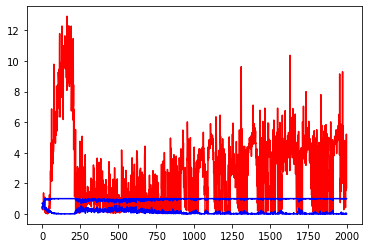

white ratio : 46.0
model saved!!!!!!!!!!!!!!!!!
min : 184
max : 206


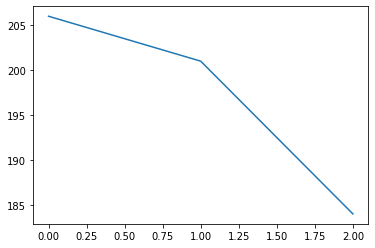

Generating interpolations...
2001 [D loss: 0.025717, acc.: 100.00%] [G loss: 1.773574, 4.909031]
2002 [D loss: 0.121193, acc.: 96.88%] [G loss: 2.298774, 0.154805]
2003 [D loss: 0.041394, acc.: 100.00%] [G loss: 15.994180, 11.722734]
2004 [D loss: 0.027355, acc.: 100.00%] [G loss: 4.065243, 2.072093]
2005 [D loss: 0.030195, acc.: 100.00%] [G loss: 0.036824, 0.023342]
2006 [D loss: 0.035936, acc.: 96.88%] [G loss: 1.336437, 0.404584]
2007 [D loss: 0.008065, acc.: 100.00%] [G loss: 7.269171, 3.960071]
2008 [D loss: 0.046864, acc.: 96.88%] [G loss: 5.000253, 3.688122]
2009 [D loss: 0.063451, acc.: 96.88%] [G loss: 3.504324, 0.666773]
2010 [D loss: 0.029640, acc.: 100.00%] [G loss: 1.223833, 2.135838]
2011 [D loss: 0.126521, acc.: 96.88%] [G loss: 15.539474, 14.794357]
2012 [D loss: 0.003496, acc.: 100.00%] [G loss: 13.584295, 9.857061]
2013 [D loss: 0.044081, acc.: 96.88%] [G loss: 1.675454, 1.742420]
2014 [D loss: 0.075611, acc.: 96.88%] [G loss: 0.157709, 0.103174]
2015 [D loss: 0.03142

2122 [D loss: 0.012271, acc.: 100.00%] [G loss: 4.239474, 2.062714]
2123 [D loss: 0.002484, acc.: 100.00%] [G loss: 0.557326, 0.083985]
2124 [D loss: 0.005017, acc.: 100.00%] [G loss: 6.865252, 4.997767]
2125 [D loss: 0.039915, acc.: 96.88%] [G loss: 3.243788, 4.593477]
2126 [D loss: 0.003524, acc.: 100.00%] [G loss: 0.567213, 0.503563]
2127 [D loss: 0.044351, acc.: 96.88%] [G loss: 1.906985, 2.489925]
2128 [D loss: 0.007646, acc.: 100.00%] [G loss: 3.752339, 1.538921]
2129 [D loss: 0.003494, acc.: 100.00%] [G loss: 7.330636, 5.311629]
2130 [D loss: 0.016230, acc.: 100.00%] [G loss: 3.772805, 1.414757]
2131 [D loss: 0.011751, acc.: 100.00%] [G loss: 4.834864, 3.818482]
2132 [D loss: 0.042057, acc.: 100.00%] [G loss: 0.668408, 0.367461]
2133 [D loss: 0.082348, acc.: 96.88%] [G loss: 4.217268, 1.316540]
2134 [D loss: 0.005812, acc.: 100.00%] [G loss: 5.807173, 5.991045]
2135 [D loss: 0.160032, acc.: 93.75%] [G loss: 1.505330, 2.690779]
2136 [D loss: 0.010245, acc.: 100.00%] [G loss: 2.55

2243 [D loss: 0.024142, acc.: 100.00%] [G loss: 5.369704, 4.200391]
2244 [D loss: 0.012409, acc.: 100.00%] [G loss: 6.160835, 2.172221]
2245 [D loss: 0.006711, acc.: 100.00%] [G loss: 0.548934, 0.015687]
2246 [D loss: 0.006230, acc.: 100.00%] [G loss: 7.190978, 5.043087]
2247 [D loss: 0.004719, acc.: 100.00%] [G loss: 5.504856, 4.006471]
2248 [D loss: 0.005461, acc.: 100.00%] [G loss: 3.908381, 3.041972]
2249 [D loss: 0.005821, acc.: 100.00%] [G loss: 5.567055, 4.903440]
2250 [D loss: 0.079133, acc.: 96.88%] [G loss: 1.381887, 1.124786]
2251 [D loss: 0.119405, acc.: 93.75%] [G loss: 6.018540, 3.688493]
2252 [D loss: 0.060588, acc.: 96.88%] [G loss: 0.361966, 0.373287]
2253 [D loss: 0.005423, acc.: 100.00%] [G loss: 5.497790, 4.256666]
2254 [D loss: 0.015808, acc.: 100.00%] [G loss: 0.575474, 0.169019]
2255 [D loss: 0.023138, acc.: 100.00%] [G loss: 11.404343, 5.680181]
2256 [D loss: 0.020531, acc.: 100.00%] [G loss: 5.697563, 5.506590]
2257 [D loss: 0.004532, acc.: 100.00%] [G loss: 2.

2367 [D loss: 0.001761, acc.: 100.00%] [G loss: 4.934836, 2.739819]
2368 [D loss: 0.021678, acc.: 100.00%] [G loss: 3.070836, 0.162810]
2369 [D loss: 0.012116, acc.: 100.00%] [G loss: 0.054195, 0.070502]
2370 [D loss: 0.086739, acc.: 96.88%] [G loss: 8.962883, 6.614911]
2371 [D loss: 0.006204, acc.: 100.00%] [G loss: 5.214775, 4.243160]
2372 [D loss: 0.080920, acc.: 96.88%] [G loss: 0.125276, 0.062789]
2373 [D loss: 0.005365, acc.: 100.00%] [G loss: 4.863103, 3.025521]
2374 [D loss: 0.021010, acc.: 100.00%] [G loss: 2.675790, 2.367302]
2375 [D loss: 0.062506, acc.: 96.88%] [G loss: 0.201459, 0.121478]
2376 [D loss: 0.214457, acc.: 96.88%] [G loss: 0.007611, 0.008607]
2377 [D loss: 0.330023, acc.: 84.38%] [G loss: 3.762221, 4.927275]
2378 [D loss: 0.130684, acc.: 93.75%] [G loss: 0.344531, 0.185971]
2379 [D loss: 0.003038, acc.: 100.00%] [G loss: 3.394872, 3.606273]
2380 [D loss: 0.055865, acc.: 96.88%] [G loss: 3.407546, 3.097691]
2381 [D loss: 0.001874, acc.: 100.00%] [G loss: 5.47624

2491 [D loss: 0.001989, acc.: 100.00%] [G loss: 6.586351, 6.896166]
2492 [D loss: 0.001789, acc.: 100.00%] [G loss: 3.284230, 1.793635]
2493 [D loss: 0.049266, acc.: 96.88%] [G loss: 5.964089, 5.737664]
2494 [D loss: 0.021560, acc.: 100.00%] [G loss: 6.430868, 6.225527]
2495 [D loss: 0.002001, acc.: 100.00%] [G loss: 4.973903, 3.521940]
2496 [D loss: 0.001271, acc.: 100.00%] [G loss: 4.320643, 1.260409]
2497 [D loss: 0.005227, acc.: 100.00%] [G loss: 5.750387, 4.143531]
2498 [D loss: 0.023468, acc.: 100.00%] [G loss: 4.636650, 2.232234]
2499 [D loss: 0.208464, acc.: 93.75%] [G loss: 4.328429, 1.988301]
2500 [D loss: 0.040463, acc.: 96.88%] [G loss: 3.494725, 2.728227]
2501 [D loss: 0.000741, acc.: 100.00%] [G loss: 6.260923, 5.333132]
2502 [D loss: 0.010783, acc.: 100.00%] [G loss: 5.832109, 5.942950]
2503 [D loss: 0.004500, acc.: 100.00%] [G loss: 6.912342, 6.164380]
2504 [D loss: 0.001896, acc.: 100.00%] [G loss: 7.162210, 6.854939]
2505 [D loss: 0.001668, acc.: 100.00%] [G loss: 7.1

2614 [D loss: 0.006892, acc.: 100.00%] [G loss: 6.700229, 5.569653]
2615 [D loss: 0.017572, acc.: 100.00%] [G loss: 2.978524, 1.922639]
2616 [D loss: 0.002116, acc.: 100.00%] [G loss: 3.784877, 0.931600]
2617 [D loss: 0.043809, acc.: 100.00%] [G loss: 6.023735, 4.939508]
2618 [D loss: 0.005037, acc.: 100.00%] [G loss: 4.034107, 3.767024]
2619 [D loss: 0.050132, acc.: 96.88%] [G loss: 0.128556, 0.115248]
2620 [D loss: 0.003084, acc.: 100.00%] [G loss: 5.357957, 3.859586]
2621 [D loss: 0.012742, acc.: 100.00%] [G loss: 5.931624, 5.466278]
2622 [D loss: 0.091249, acc.: 96.88%] [G loss: 4.887747, 4.596621]
2623 [D loss: 0.120164, acc.: 96.88%] [G loss: 0.067578, 0.015937]
2624 [D loss: 0.018328, acc.: 100.00%] [G loss: 5.633862, 2.422059]
2625 [D loss: 0.045422, acc.: 96.88%] [G loss: 3.762264, 2.957229]
2626 [D loss: 0.009139, acc.: 100.00%] [G loss: 10.162483, 7.030074]
2627 [D loss: 0.027294, acc.: 96.88%] [G loss: 4.207430, 3.782419]
2628 [D loss: 0.001176, acc.: 100.00%] [G loss: 5.56

2735 [D loss: 0.010628, acc.: 100.00%] [G loss: 5.452667, 5.113464]
2736 [D loss: 0.002599, acc.: 100.00%] [G loss: 3.080021, 2.429993]
2737 [D loss: 0.002950, acc.: 100.00%] [G loss: 4.902414, 4.414709]
2738 [D loss: 0.006895, acc.: 100.00%] [G loss: 4.554246, 3.913248]
2739 [D loss: 0.002070, acc.: 100.00%] [G loss: 4.809288, 4.921336]
2740 [D loss: 0.010455, acc.: 100.00%] [G loss: 3.410333, 3.355236]
2741 [D loss: 0.001474, acc.: 100.00%] [G loss: 4.711626, 3.580558]
2742 [D loss: 0.195856, acc.: 96.88%] [G loss: 5.127934, 4.738690]
2743 [D loss: 0.004205, acc.: 100.00%] [G loss: 3.769791, 2.882089]
2744 [D loss: 0.006892, acc.: 100.00%] [G loss: 3.951929, 3.472947]
2745 [D loss: 0.008650, acc.: 100.00%] [G loss: 4.309271, 4.153409]
2746 [D loss: 0.005042, acc.: 100.00%] [G loss: 5.872541, 4.041821]
2747 [D loss: 0.009678, acc.: 100.00%] [G loss: 5.584658, 4.572825]
2748 [D loss: 0.002964, acc.: 100.00%] [G loss: 4.302187, 3.895878]
2749 [D loss: 0.015065, acc.: 100.00%] [G loss: 2

2859 [D loss: 0.005100, acc.: 100.00%] [G loss: 2.940129, 2.078011]
2860 [D loss: 0.008708, acc.: 100.00%] [G loss: 3.637514, 1.231667]
2861 [D loss: 0.006442, acc.: 100.00%] [G loss: 3.985599, 2.036503]
2862 [D loss: 0.069171, acc.: 96.88%] [G loss: 5.659349, 1.439206]
2863 [D loss: 0.029611, acc.: 100.00%] [G loss: 3.234351, 1.698094]
2864 [D loss: 0.005988, acc.: 100.00%] [G loss: 6.456860, 4.910004]
2865 [D loss: 0.060000, acc.: 96.88%] [G loss: 3.229967, 1.601800]
2866 [D loss: 0.002663, acc.: 100.00%] [G loss: 6.795586, 5.918052]
2867 [D loss: 0.049807, acc.: 96.88%] [G loss: 3.847540, 0.505497]
2868 [D loss: 0.060919, acc.: 96.88%] [G loss: 6.600646, 6.001678]
2869 [D loss: 0.009852, acc.: 100.00%] [G loss: 5.025974, 4.579055]
2870 [D loss: 0.006962, acc.: 100.00%] [G loss: 25.564713, 2.381425]
2871 [D loss: 0.025495, acc.: 96.88%] [G loss: 2.467144, 1.760229]
2872 [D loss: 0.002871, acc.: 100.00%] [G loss: 1.795060, 1.025338]
2873 [D loss: 0.021555, acc.: 100.00%] [G loss: 5.94

2981 [D loss: 0.029249, acc.: 100.00%] [G loss: 0.606039, 0.296377]
2982 [D loss: 0.001398, acc.: 100.00%] [G loss: 3.969628, 0.918522]
2983 [D loss: 0.019086, acc.: 100.00%] [G loss: 5.637748, 4.056076]
2984 [D loss: 0.002641, acc.: 100.00%] [G loss: 1.425532, 0.238376]
2985 [D loss: 0.027818, acc.: 96.88%] [G loss: 0.596471, 0.869600]
2986 [D loss: 0.002213, acc.: 100.00%] [G loss: 1.719532, 0.106877]
2987 [D loss: 0.017614, acc.: 100.00%] [G loss: 6.544339, 3.417873]
2988 [D loss: 0.009634, acc.: 100.00%] [G loss: 1.820818, 0.078883]
2989 [D loss: 0.002691, acc.: 100.00%] [G loss: 1.958428, 0.171624]
2990 [D loss: 0.005966, acc.: 100.00%] [G loss: 11.467444, 4.839345]
2991 [D loss: 0.002918, acc.: 100.00%] [G loss: 5.955930, 5.407743]
2992 [D loss: 0.028472, acc.: 96.88%] [G loss: 6.108932, 5.030624]
2993 [D loss: 0.001762, acc.: 100.00%] [G loss: 7.584093, 6.944038]
2994 [D loss: 0.015411, acc.: 100.00%] [G loss: 0.000493, 0.000956]
2995 [D loss: 0.007218, acc.: 100.00%] [G loss: 3

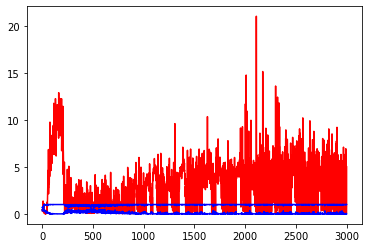

white ratio : 54.5
min : 184
max : 218


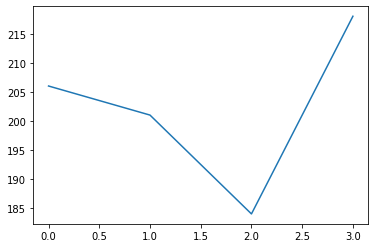

Generating interpolations...
3001 [D loss: 0.006845, acc.: 100.00%] [G loss: 7.337720, 4.318591]
3002 [D loss: 0.039517, acc.: 96.88%] [G loss: 0.689409, 1.032959]
3003 [D loss: 0.063924, acc.: 96.88%] [G loss: 0.080970, 0.032172]
3004 [D loss: 0.019674, acc.: 100.00%] [G loss: 0.227796, 0.143631]
3005 [D loss: 0.027058, acc.: 100.00%] [G loss: 2.040714, 0.123015]
3006 [D loss: 0.013146, acc.: 100.00%] [G loss: 4.538323, 2.851448]
3007 [D loss: 0.004597, acc.: 100.00%] [G loss: 0.146505, 0.136579]
3008 [D loss: 0.003391, acc.: 100.00%] [G loss: 7.140836, 5.365781]
3009 [D loss: 0.036570, acc.: 96.88%] [G loss: 0.129566, 0.065521]
3010 [D loss: 0.023361, acc.: 100.00%] [G loss: 3.356265, 4.409617]
3011 [D loss: 0.012228, acc.: 100.00%] [G loss: 0.285056, 0.127868]
3012 [D loss: 0.004097, acc.: 100.00%] [G loss: 7.376883, 4.237179]
3013 [D loss: 0.008840, acc.: 100.00%] [G loss: 0.841991, 0.006025]
3014 [D loss: 0.033044, acc.: 96.88%] [G loss: 0.757386, 0.031478]
3015 [D loss: 0.003052,

3122 [D loss: 0.048600, acc.: 96.88%] [G loss: 0.722294, 0.324065]
3123 [D loss: 0.001962, acc.: 100.00%] [G loss: 6.392756, 2.798182]
3124 [D loss: 0.090218, acc.: 96.88%] [G loss: 3.645936, 0.112709]
3125 [D loss: 0.024585, acc.: 100.00%] [G loss: 4.091011, 1.106963]
3126 [D loss: 0.007950, acc.: 100.00%] [G loss: 6.725236, 4.391849]
3127 [D loss: 0.000800, acc.: 100.00%] [G loss: 4.638621, 4.571631]
3128 [D loss: 0.001598, acc.: 100.00%] [G loss: 15.314079, 1.947520]
3129 [D loss: 0.000633, acc.: 100.00%] [G loss: 6.898295, 6.283630]
3130 [D loss: 0.000753, acc.: 100.00%] [G loss: 2.894848, 1.173042]
3131 [D loss: 0.000546, acc.: 100.00%] [G loss: 3.850647, 0.775918]
3132 [D loss: 0.007943, acc.: 100.00%] [G loss: 2.510008, 0.427974]
3133 [D loss: 0.007345, acc.: 100.00%] [G loss: 7.634895, 5.256428]
3134 [D loss: 0.005295, acc.: 100.00%] [G loss: 7.517118, 2.621490]
3135 [D loss: 0.011161, acc.: 100.00%] [G loss: 6.441988, 1.248259]
3136 [D loss: 0.000883, acc.: 100.00%] [G loss: 1

3245 [D loss: 0.013936, acc.: 100.00%] [G loss: 5.325638, 5.049310]
3246 [D loss: 0.025001, acc.: 100.00%] [G loss: 7.836612, 7.088507]
3247 [D loss: 0.002167, acc.: 100.00%] [G loss: 0.258113, 0.172327]
3248 [D loss: 0.002914, acc.: 100.00%] [G loss: 10.673931, 8.547131]
3249 [D loss: 0.001016, acc.: 100.00%] [G loss: 8.812519, 6.939322]
3250 [D loss: 0.012590, acc.: 100.00%] [G loss: 4.848258, 3.085414]
3251 [D loss: 0.039536, acc.: 96.88%] [G loss: 0.211659, 0.031779]
3252 [D loss: 0.020842, acc.: 100.00%] [G loss: 3.576766, 3.858330]
3253 [D loss: 0.004872, acc.: 100.00%] [G loss: 7.622365, 4.982208]
3254 [D loss: 0.025253, acc.: 100.00%] [G loss: 7.344293, 6.616743]
3255 [D loss: 0.006799, acc.: 100.00%] [G loss: 5.915407, 4.246716]
3256 [D loss: 0.257689, acc.: 90.62%] [G loss: 5.828889, 1.476020]
3257 [D loss: 0.012262, acc.: 100.00%] [G loss: 0.989556, 0.115294]
3258 [D loss: 0.062992, acc.: 96.88%] [G loss: 20.830044, 8.108883]
3259 [D loss: 0.074183, acc.: 96.88%] [G loss: 7.

3368 [D loss: 0.005007, acc.: 100.00%] [G loss: 2.943871, 0.208751]
3369 [D loss: 0.061956, acc.: 96.88%] [G loss: 0.647100, 0.330813]
3370 [D loss: 0.017406, acc.: 100.00%] [G loss: 1.043612, 0.194176]
3371 [D loss: 0.003547, acc.: 100.00%] [G loss: 1.337407, 1.617167]
3372 [D loss: 0.011940, acc.: 100.00%] [G loss: 1.633946, 0.068184]
3373 [D loss: 0.005022, acc.: 100.00%] [G loss: 0.557509, 0.312902]
3374 [D loss: 0.007863, acc.: 100.00%] [G loss: 3.243039, 1.089981]
3375 [D loss: 0.007101, acc.: 100.00%] [G loss: 3.614974, 2.229300]
3376 [D loss: 0.008765, acc.: 100.00%] [G loss: 3.789622, 1.402035]
3377 [D loss: 0.017750, acc.: 100.00%] [G loss: 1.835250, 0.164922]
3378 [D loss: 0.037507, acc.: 100.00%] [G loss: 4.972627, 4.290841]
3379 [D loss: 0.090794, acc.: 90.62%] [G loss: 5.143229, 2.419311]
3380 [D loss: 0.002741, acc.: 100.00%] [G loss: 1.605201, 1.102062]
3381 [D loss: 0.037139, acc.: 96.88%] [G loss: 26.304277, 1.469479]
3382 [D loss: 0.004897, acc.: 100.00%] [G loss: 2.

3489 [D loss: 0.002594, acc.: 100.00%] [G loss: 6.543142, 6.625227]
3490 [D loss: 0.002475, acc.: 100.00%] [G loss: 5.635547, 4.743551]
3491 [D loss: 0.005001, acc.: 100.00%] [G loss: 3.810874, 2.226153]
3492 [D loss: 0.004562, acc.: 100.00%] [G loss: 1.544186, 0.702025]
3493 [D loss: 0.005998, acc.: 100.00%] [G loss: 6.244436, 6.355764]
3494 [D loss: 0.056580, acc.: 96.88%] [G loss: 5.081607, 3.564242]
3495 [D loss: 0.004392, acc.: 100.00%] [G loss: 0.473901, 0.307033]
3496 [D loss: 0.012777, acc.: 100.00%] [G loss: 0.945216, 0.417200]
3497 [D loss: 0.003849, acc.: 100.00%] [G loss: 0.206403, 0.139787]
3498 [D loss: 0.024482, acc.: 96.88%] [G loss: 2.064507, 0.248427]
3499 [D loss: 0.001470, acc.: 100.00%] [G loss: 6.749075, 3.454940]
3500 [D loss: 0.001123, acc.: 100.00%] [G loss: 3.574230, 4.288195]
3501 [D loss: 0.005956, acc.: 100.00%] [G loss: 7.413626, 10.745946]
3502 [D loss: 0.001381, acc.: 100.00%] [G loss: 5.931672, 4.368723]
3503 [D loss: 0.007515, acc.: 100.00%] [G loss: 6

3613 [D loss: 0.027535, acc.: 100.00%] [G loss: 6.671230, 6.054181]
3614 [D loss: 0.006870, acc.: 100.00%] [G loss: 0.023121, 0.017439]
3615 [D loss: 0.044531, acc.: 100.00%] [G loss: 6.107887, 3.541483]
3616 [D loss: 0.001562, acc.: 100.00%] [G loss: 0.014451, 0.014864]
3617 [D loss: 0.006191, acc.: 100.00%] [G loss: 5.466454, 3.201794]
3618 [D loss: 0.013947, acc.: 100.00%] [G loss: 4.488598, 4.996840]
3619 [D loss: 0.110737, acc.: 93.75%] [G loss: 1.629388, 1.038236]
3620 [D loss: 0.002506, acc.: 100.00%] [G loss: 3.887453, 0.595262]
3621 [D loss: 0.068773, acc.: 96.88%] [G loss: 2.514215, 5.584231]
3622 [D loss: 0.001921, acc.: 100.00%] [G loss: 3.368974, 2.590121]
3623 [D loss: 0.002595, acc.: 100.00%] [G loss: 1.207027, 0.187472]
3624 [D loss: 0.113170, acc.: 93.75%] [G loss: 0.162872, 0.083643]
3625 [D loss: 0.007522, acc.: 100.00%] [G loss: 4.543835, 2.091893]
3626 [D loss: 0.047617, acc.: 96.88%] [G loss: 5.654153, 4.074159]
3627 [D loss: 0.055025, acc.: 93.75%] [G loss: 2.674

3735 [D loss: 0.000734, acc.: 100.00%] [G loss: 9.344473, 9.039804]
3736 [D loss: 0.000512, acc.: 100.00%] [G loss: 6.832324, 6.063154]
3737 [D loss: 0.000517, acc.: 100.00%] [G loss: 6.536507, 6.077875]
3738 [D loss: 0.000784, acc.: 100.00%] [G loss: 6.366455, 4.704514]
3739 [D loss: 0.000840, acc.: 100.00%] [G loss: 6.795288, 6.799284]
3740 [D loss: 0.080065, acc.: 96.88%] [G loss: 3.675712, 2.405827]
3741 [D loss: 0.000697, acc.: 100.00%] [G loss: 4.962661, 4.095242]
3742 [D loss: 0.001265, acc.: 100.00%] [G loss: 3.588967, 3.843073]
3743 [D loss: 0.004684, acc.: 100.00%] [G loss: 3.703559, 2.656410]
3744 [D loss: 0.002857, acc.: 100.00%] [G loss: 11.275122, 1.752498]
3745 [D loss: 0.030852, acc.: 96.88%] [G loss: 0.747212, 0.263051]
3746 [D loss: 0.002654, acc.: 100.00%] [G loss: 3.250003, 2.244512]
3747 [D loss: 0.014564, acc.: 100.00%] [G loss: 3.681732, 1.847851]
3748 [D loss: 0.004651, acc.: 100.00%] [G loss: 0.911413, 0.127552]
3749 [D loss: 0.005430, acc.: 100.00%] [G loss: 4

3856 [D loss: 0.001504, acc.: 100.00%] [G loss: 1.673170, 0.917356]
3857 [D loss: 0.003650, acc.: 100.00%] [G loss: 5.634412, 4.773694]
3858 [D loss: 0.002209, acc.: 100.00%] [G loss: 0.087700, 0.124291]
3859 [D loss: 0.002690, acc.: 100.00%] [G loss: 5.057198, 4.701859]
3860 [D loss: 0.001617, acc.: 100.00%] [G loss: 3.536204, 3.044474]
3861 [D loss: 0.001800, acc.: 100.00%] [G loss: 0.597896, 0.416635]
3862 [D loss: 0.016105, acc.: 100.00%] [G loss: 3.544461, 2.507457]
3863 [D loss: 0.038827, acc.: 96.88%] [G loss: 3.679488, 2.665001]
3864 [D loss: 0.002099, acc.: 100.00%] [G loss: 1.407548, 0.961385]
3865 [D loss: 0.004190, acc.: 100.00%] [G loss: 1.996445, 0.230166]
3866 [D loss: 0.000835, acc.: 100.00%] [G loss: 1.458264, 0.561342]
3867 [D loss: 0.002686, acc.: 100.00%] [G loss: 4.909319, 2.698652]
3868 [D loss: 0.002085, acc.: 100.00%] [G loss: 1.885289, 0.059809]
3869 [D loss: 0.004030, acc.: 100.00%] [G loss: 5.054877, 4.327556]
3870 [D loss: 0.001183, acc.: 100.00%] [G loss: 6

3977 [D loss: 0.001721, acc.: 100.00%] [G loss: 1.336158, 0.457092]
3978 [D loss: 0.001961, acc.: 100.00%] [G loss: 4.449831, 2.661123]
3979 [D loss: 0.011913, acc.: 100.00%] [G loss: 0.047851, 0.027474]
3980 [D loss: 0.005532, acc.: 100.00%] [G loss: 0.098170, 0.053601]
3981 [D loss: 0.022182, acc.: 100.00%] [G loss: 1.585693, 0.063556]
3982 [D loss: 0.004171, acc.: 100.00%] [G loss: 1.023159, 0.236080]
3983 [D loss: 0.002277, acc.: 100.00%] [G loss: 1.237737, 0.288682]
3984 [D loss: 0.001461, acc.: 100.00%] [G loss: 0.200293, 0.100089]
3985 [D loss: 0.005991, acc.: 100.00%] [G loss: 0.242503, 0.006808]
3986 [D loss: 0.172336, acc.: 96.88%] [G loss: 3.394848, 0.147806]
3987 [D loss: 0.003659, acc.: 100.00%] [G loss: 11.650392, 4.291910]
3988 [D loss: 0.001568, acc.: 100.00%] [G loss: 7.472231, 7.388129]
3989 [D loss: 0.000639, acc.: 100.00%] [G loss: 6.366669, 5.787668]
3990 [D loss: 0.000626, acc.: 100.00%] [G loss: 11.068545, 8.265588]
3991 [D loss: 0.029853, acc.: 96.88%] [G loss: 

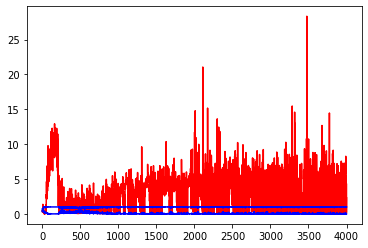

white ratio : 50.5
min : 184
max : 218


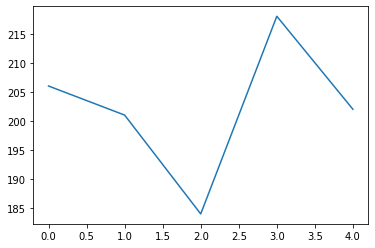

Generating interpolations...
4001 [D loss: 0.029642, acc.: 96.88%] [G loss: 2.756518, 0.089471]
4002 [D loss: 0.086204, acc.: 96.88%] [G loss: 5.607681, 4.355222]
4003 [D loss: 0.130107, acc.: 96.88%] [G loss: 4.092381, 0.134186]
4004 [D loss: 0.028345, acc.: 96.88%] [G loss: 12.654218, 2.475530]
4005 [D loss: 0.003838, acc.: 100.00%] [G loss: 1.877097, 0.788851]
4006 [D loss: 0.005776, acc.: 100.00%] [G loss: 5.479774, 2.738650]
4007 [D loss: 0.011024, acc.: 100.00%] [G loss: 4.604558, 4.068960]
4008 [D loss: 0.016869, acc.: 100.00%] [G loss: 2.541358, 2.072268]
4009 [D loss: 0.002337, acc.: 100.00%] [G loss: 5.038215, 3.559010]
4010 [D loss: 0.004456, acc.: 100.00%] [G loss: 0.847351, 0.025947]
4011 [D loss: 0.003171, acc.: 100.00%] [G loss: 7.716584, 5.072475]
4012 [D loss: 0.002652, acc.: 100.00%] [G loss: 1.174713, 1.175273]
4013 [D loss: 0.004385, acc.: 100.00%] [G loss: 4.497794, 1.223302]
4014 [D loss: 0.105927, acc.: 96.88%] [G loss: 0.273636, 0.207770]
4015 [D loss: 0.020457,

4123 [D loss: 0.002672, acc.: 100.00%] [G loss: 0.046594, 0.044644]
4124 [D loss: 0.001712, acc.: 100.00%] [G loss: 0.003471, 0.005241]
4125 [D loss: 0.003483, acc.: 100.00%] [G loss: 2.017131, 1.132938]
4126 [D loss: 0.010012, acc.: 100.00%] [G loss: 0.036095, 0.047551]
4127 [D loss: 0.007199, acc.: 100.00%] [G loss: 5.357235, 4.411773]
4128 [D loss: 0.009044, acc.: 100.00%] [G loss: 4.204537, 2.570149]
4129 [D loss: 0.022439, acc.: 100.00%] [G loss: 4.593212, 2.939422]
4130 [D loss: 0.007779, acc.: 100.00%] [G loss: 6.164964, 5.495561]
4131 [D loss: 0.004139, acc.: 100.00%] [G loss: 4.132127, 0.694921]
4132 [D loss: 0.004721, acc.: 100.00%] [G loss: 1.807841, 0.234330]
4133 [D loss: 0.001964, acc.: 100.00%] [G loss: 2.022484, 0.035572]
4134 [D loss: 0.016673, acc.: 100.00%] [G loss: 0.012675, 0.022452]
4135 [D loss: 0.002566, acc.: 100.00%] [G loss: 0.000193, 0.000153]
4136 [D loss: 0.025797, acc.: 96.88%] [G loss: 3.253814, 3.025341]
4137 [D loss: 0.020107, acc.: 100.00%] [G loss: 0

4247 [D loss: 0.063651, acc.: 96.88%] [G loss: 3.066351, 0.684699]
4248 [D loss: 0.002775, acc.: 100.00%] [G loss: 5.340614, 3.433694]
4249 [D loss: 0.000442, acc.: 100.00%] [G loss: 7.213976, 21.270815]
4250 [D loss: 0.017758, acc.: 100.00%] [G loss: 0.641077, 1.746213]
4251 [D loss: 0.004692, acc.: 100.00%] [G loss: 6.196896, 5.243796]
4252 [D loss: 0.010328, acc.: 100.00%] [G loss: 5.470478, 5.000391]
4253 [D loss: 0.002505, acc.: 100.00%] [G loss: 3.555626, 2.078101]
4254 [D loss: 0.001186, acc.: 100.00%] [G loss: 1.736662, 0.367288]
4255 [D loss: 0.002664, acc.: 100.00%] [G loss: 3.491788, 2.116146]
4256 [D loss: 0.000717, acc.: 100.00%] [G loss: 8.584963, 0.320004]
4257 [D loss: 0.042964, acc.: 100.00%] [G loss: 0.032420, 0.095885]
4258 [D loss: 0.019376, acc.: 100.00%] [G loss: 1.437667, 0.725879]
4259 [D loss: 0.003063, acc.: 100.00%] [G loss: 5.092595, 4.201272]
4260 [D loss: 0.001654, acc.: 100.00%] [G loss: 0.244417, 0.167399]
4261 [D loss: 0.048421, acc.: 96.88%] [G loss: 2

4370 [D loss: 0.002338, acc.: 100.00%] [G loss: 1.035835, 0.906491]
4371 [D loss: 0.047395, acc.: 96.88%] [G loss: 0.669513, 0.802413]
4372 [D loss: 0.002012, acc.: 100.00%] [G loss: 0.113498, 0.074065]
4373 [D loss: 0.001221, acc.: 100.00%] [G loss: 1.040029, 0.075461]
4374 [D loss: 0.007800, acc.: 100.00%] [G loss: 6.229656, 5.717016]
4375 [D loss: 0.007190, acc.: 100.00%] [G loss: 7.824943, 3.952636]
4376 [D loss: 0.005468, acc.: 100.00%] [G loss: 1.393795, 1.624044]
4377 [D loss: 0.030220, acc.: 96.88%] [G loss: 3.815139, 2.489936]
4378 [D loss: 0.032029, acc.: 96.88%] [G loss: 2.417888, 1.102393]
4379 [D loss: 0.003970, acc.: 100.00%] [G loss: 0.004124, 0.006516]
4380 [D loss: 0.003787, acc.: 100.00%] [G loss: 5.954800, 3.315377]
4381 [D loss: 0.001934, acc.: 100.00%] [G loss: 2.560987, 1.830044]
4382 [D loss: 0.001678, acc.: 100.00%] [G loss: 7.115079, 4.704675]
4383 [D loss: 0.023437, acc.: 100.00%] [G loss: 1.671383, 3.252289]
4384 [D loss: 0.013293, acc.: 100.00%] [G loss: 0.6

4494 [D loss: 0.002658, acc.: 100.00%] [G loss: 6.615855, 5.549858]
4495 [D loss: 0.001122, acc.: 100.00%] [G loss: 6.689412, 6.400983]
4496 [D loss: 0.000890, acc.: 100.00%] [G loss: 6.319097, 6.227243]
4497 [D loss: 0.003059, acc.: 100.00%] [G loss: 2.875432, 0.290810]
4498 [D loss: 0.061911, acc.: 96.88%] [G loss: 5.291965, 2.933206]
4499 [D loss: 0.002809, acc.: 100.00%] [G loss: 3.176342, 0.033165]
4500 [D loss: 0.072328, acc.: 96.88%] [G loss: 0.040946, 0.048419]
4501 [D loss: 0.072629, acc.: 96.88%] [G loss: 0.004754, 0.004437]
4502 [D loss: 0.046013, acc.: 96.88%] [G loss: 0.051809, 0.015958]
4503 [D loss: 0.001617, acc.: 100.00%] [G loss: 0.027078, 0.029225]
4504 [D loss: 0.002399, acc.: 100.00%] [G loss: 1.073108, 0.109364]
4505 [D loss: 0.006225, acc.: 100.00%] [G loss: 12.151665, 0.012052]
4506 [D loss: 0.001066, acc.: 100.00%] [G loss: 0.011714, 0.007784]
4507 [D loss: 0.129740, acc.: 96.88%] [G loss: 2.859095, 1.082151]
4508 [D loss: 0.011087, acc.: 100.00%] [G loss: 2.89

4616 [D loss: 0.061573, acc.: 96.88%] [G loss: 1.600904, 0.207526]
4617 [D loss: 0.005442, acc.: 100.00%] [G loss: 0.078488, 0.012001]
4618 [D loss: 0.240545, acc.: 90.62%] [G loss: 7.578775, 6.089955]
4619 [D loss: 0.005718, acc.: 100.00%] [G loss: 12.297373, 7.955138]
4620 [D loss: 0.108091, acc.: 93.75%] [G loss: 3.496024, 2.129501]
4621 [D loss: 0.002508, acc.: 100.00%] [G loss: 8.932130, 1.199566]
4622 [D loss: 0.030195, acc.: 100.00%] [G loss: 6.030016, 4.796709]
4623 [D loss: 0.003736, acc.: 100.00%] [G loss: 6.167559, 6.547542]
4624 [D loss: 0.001314, acc.: 100.00%] [G loss: 7.047746, 6.557475]
4625 [D loss: 0.001857, acc.: 100.00%] [G loss: 7.628273, 6.832253]
4626 [D loss: 0.067683, acc.: 96.88%] [G loss: 2.726352, 1.245412]
4627 [D loss: 0.004168, acc.: 100.00%] [G loss: 6.038060, 5.195180]
4628 [D loss: 0.016215, acc.: 100.00%] [G loss: 2.684280, 0.043998]
4629 [D loss: 0.020301, acc.: 100.00%] [G loss: 0.001867, 0.009456]
4630 [D loss: 0.028968, acc.: 100.00%] [G loss: 5.1

4739 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.004929, 0.004439]
4740 [D loss: 0.137004, acc.: 96.88%] [G loss: 1.696461, 0.867817]
4741 [D loss: 0.107304, acc.: 96.88%] [G loss: 2.244525, 1.378612]
4742 [D loss: 0.001416, acc.: 100.00%] [G loss: 7.307684, 6.546280]
4743 [D loss: 0.001709, acc.: 100.00%] [G loss: 9.497583, 6.077919]
4744 [D loss: 0.000651, acc.: 100.00%] [G loss: 1.303900, 0.995629]
4745 [D loss: 0.000314, acc.: 100.00%] [G loss: 0.183874, 0.135830]
4746 [D loss: 0.001697, acc.: 100.00%] [G loss: 0.758901, 0.133813]
4747 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.010396, 0.014613]
4748 [D loss: 0.000457, acc.: 100.00%] [G loss: 4.312903, 2.254348]
4749 [D loss: 0.001082, acc.: 100.00%] [G loss: 3.398573, 1.754375]
4750 [D loss: 0.002883, acc.: 100.00%] [G loss: 6.049728, 6.072659]
4751 [D loss: 0.004596, acc.: 100.00%] [G loss: 5.344517, 4.339673]
4752 [D loss: 0.022596, acc.: 100.00%] [G loss: 0.004094, 0.003451]
4753 [D loss: 0.004216, acc.: 100.00%] [G loss: 0.

4861 [D loss: 0.000631, acc.: 100.00%] [G loss: 6.340604, 6.358432]
4862 [D loss: 0.001566, acc.: 100.00%] [G loss: 0.058001, 0.019290]
4863 [D loss: 0.012770, acc.: 100.00%] [G loss: 12.499472, 3.320643]
4864 [D loss: 0.000112, acc.: 100.00%] [G loss: 5.555847, 5.194974]
4865 [D loss: 0.000340, acc.: 100.00%] [G loss: 5.551931, 5.143463]
4866 [D loss: 0.000379, acc.: 100.00%] [G loss: 4.608637, 2.441113]
4867 [D loss: 0.001069, acc.: 100.00%] [G loss: 3.449632, 1.340010]
4868 [D loss: 0.001017, acc.: 100.00%] [G loss: 2.228363, 0.843756]
4869 [D loss: 0.001633, acc.: 100.00%] [G loss: 3.133431, 0.303586]
4870 [D loss: 0.032564, acc.: 96.88%] [G loss: 1.752781, 2.435498]
4871 [D loss: 0.000915, acc.: 100.00%] [G loss: 0.286068, 0.113414]
4872 [D loss: 0.007196, acc.: 100.00%] [G loss: 5.929219, 5.106606]
4873 [D loss: 0.006413, acc.: 100.00%] [G loss: 0.579679, 0.190983]
4874 [D loss: 0.002457, acc.: 100.00%] [G loss: 5.645991, 2.047385]
4875 [D loss: 0.011328, acc.: 100.00%] [G loss: 

4983 [D loss: 0.062094, acc.: 93.75%] [G loss: 3.946330, 2.677663]
4984 [D loss: 0.000620, acc.: 100.00%] [G loss: 1.208660, 0.019652]
4985 [D loss: 0.008530, acc.: 100.00%] [G loss: 9.306702, 0.131173]
4986 [D loss: 0.020118, acc.: 100.00%] [G loss: 8.042912, 7.569287]
4987 [D loss: 0.047564, acc.: 96.88%] [G loss: 5.367603, 3.929890]
4988 [D loss: 0.017970, acc.: 100.00%] [G loss: 7.826929, 7.033143]
4989 [D loss: 0.010441, acc.: 100.00%] [G loss: 0.006229, 0.004683]
4990 [D loss: 0.003098, acc.: 100.00%] [G loss: 0.019262, 0.011734]
4991 [D loss: 0.001593, acc.: 100.00%] [G loss: 0.110265, 0.055182]
4992 [D loss: 0.000706, acc.: 100.00%] [G loss: 0.035618, 0.018141]
4993 [D loss: 0.005924, acc.: 100.00%] [G loss: 6.760957, 6.432080]
4994 [D loss: 0.006356, acc.: 100.00%] [G loss: 5.105201, 3.793404]
4995 [D loss: 0.001987, acc.: 100.00%] [G loss: 5.921871, 3.229647]
4996 [D loss: 0.003115, acc.: 100.00%] [G loss: 3.601488, 0.179681]
4997 [D loss: 0.000844, acc.: 100.00%] [G loss: 9.

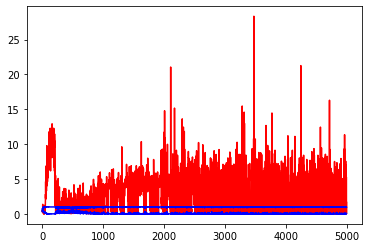

white ratio : 50.0
min : 184
max : 218


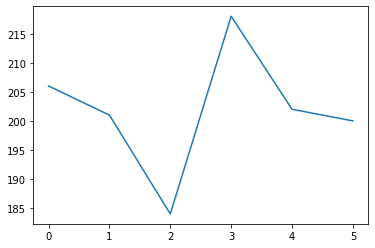

Generating interpolations...
5001 [D loss: 0.002056, acc.: 100.00%] [G loss: 5.936351, 5.124410]
5002 [D loss: 0.016013, acc.: 100.00%] [G loss: 6.409872, 5.324198]
5003 [D loss: 0.000430, acc.: 100.00%] [G loss: 6.813605, 4.571175]
5004 [D loss: 0.002496, acc.: 100.00%] [G loss: 0.018385, 0.018282]
5005 [D loss: 0.000674, acc.: 100.00%] [G loss: 0.020713, 0.013802]
5006 [D loss: 0.001541, acc.: 100.00%] [G loss: 0.056985, 0.063807]
5007 [D loss: 0.006088, acc.: 100.00%] [G loss: 2.961624, 2.008612]
5008 [D loss: 0.000750, acc.: 100.00%] [G loss: 8.366024, 6.451871]
5009 [D loss: 0.000480, acc.: 100.00%] [G loss: 0.021871, 0.030056]
5010 [D loss: 0.010647, acc.: 100.00%] [G loss: 0.101597, 0.048346]
5011 [D loss: 0.090811, acc.: 96.88%] [G loss: 3.407511, 1.745702]
5012 [D loss: 0.008191, acc.: 100.00%] [G loss: 0.013668, 0.088614]
5013 [D loss: 0.000446, acc.: 100.00%] [G loss: 0.009730, 0.004537]
5014 [D loss: 0.000556, acc.: 100.00%] [G loss: 5.982214, 5.423590]
5015 [D loss: 0.0008

5119 [D loss: 0.000258, acc.: 100.00%] [G loss: 7.415911, 5.457332]
5120 [D loss: 0.001818, acc.: 100.00%] [G loss: 3.099855, 0.961243]
5121 [D loss: 0.009460, acc.: 100.00%] [G loss: 6.590336, 5.846401]
5122 [D loss: 0.036789, acc.: 96.88%] [G loss: 7.568680, 6.881222]
5123 [D loss: 0.040152, acc.: 96.88%] [G loss: 3.868205, 1.781108]
5124 [D loss: 0.063541, acc.: 96.88%] [G loss: 4.764170, 1.892594]
5125 [D loss: 0.000713, acc.: 100.00%] [G loss: 4.933109, 1.959158]
5126 [D loss: 0.001171, acc.: 100.00%] [G loss: 5.424904, 2.436981]
5127 [D loss: 0.001665, acc.: 100.00%] [G loss: 5.574961, 4.539917]
5128 [D loss: 0.001912, acc.: 100.00%] [G loss: 6.814106, 4.161303]
5129 [D loss: 0.003771, acc.: 100.00%] [G loss: 9.579714, 8.420160]
5130 [D loss: 0.000152, acc.: 100.00%] [G loss: 6.231708, 6.004783]
5131 [D loss: 0.047234, acc.: 96.88%] [G loss: 5.828686, 5.599605]
5132 [D loss: 0.005925, acc.: 100.00%] [G loss: 7.107462, 5.067585]
5133 [D loss: 0.014680, acc.: 100.00%] [G loss: 6.96

5241 [D loss: 0.000346, acc.: 100.00%] [G loss: 7.290969, 6.097964]
5242 [D loss: 0.001522, acc.: 100.00%] [G loss: 8.864275, 7.926045]
5243 [D loss: 0.001181, acc.: 100.00%] [G loss: 5.358987, 3.302839]
5244 [D loss: 0.001477, acc.: 100.00%] [G loss: 0.002492, 0.001342]
5245 [D loss: 0.000877, acc.: 100.00%] [G loss: 3.799554, 0.400495]
5246 [D loss: 0.000606, acc.: 100.00%] [G loss: 6.998525, 7.819476]
5247 [D loss: 0.000693, acc.: 100.00%] [G loss: 6.356519, 5.776688]
5248 [D loss: 0.000400, acc.: 100.00%] [G loss: 7.659690, 6.498012]
5249 [D loss: 0.062780, acc.: 96.88%] [G loss: 0.060607, 0.023516]
5250 [D loss: 0.026486, acc.: 96.88%] [G loss: 0.064790, 0.041411]
5251 [D loss: 0.022340, acc.: 100.00%] [G loss: 0.031460, 0.018422]
5252 [D loss: 0.003213, acc.: 100.00%] [G loss: 3.078788, 1.740435]
5253 [D loss: 0.010604, acc.: 100.00%] [G loss: 2.048162, 0.242457]
5254 [D loss: 0.067373, acc.: 96.88%] [G loss: 9.643282, 7.842626]
5255 [D loss: 0.000968, acc.: 100.00%] [G loss: 1.6

5364 [D loss: 0.000758, acc.: 100.00%] [G loss: 7.526598, 5.466729]
5365 [D loss: 0.001370, acc.: 100.00%] [G loss: 4.291708, 3.467303]
5366 [D loss: 0.002914, acc.: 100.00%] [G loss: 0.190720, 0.086017]
5367 [D loss: 0.028959, acc.: 96.88%] [G loss: 7.638817, 7.544051]
5368 [D loss: 0.000624, acc.: 100.00%] [G loss: 5.824651, 4.573132]
5369 [D loss: 0.002435, acc.: 100.00%] [G loss: 0.677493, 0.172714]
5370 [D loss: 0.026675, acc.: 96.88%] [G loss: 6.816945, 6.478185]
5371 [D loss: 0.000988, acc.: 100.00%] [G loss: 3.493414, 2.579841]
5372 [D loss: 0.001098, acc.: 100.00%] [G loss: 0.025030, 0.008564]
5373 [D loss: 0.008710, acc.: 100.00%] [G loss: 11.905532, 5.605381]
5374 [D loss: 0.000285, acc.: 100.00%] [G loss: 2.757116, 2.497060]
5375 [D loss: 0.000173, acc.: 100.00%] [G loss: 5.038887, 3.872628]
5376 [D loss: 0.001681, acc.: 100.00%] [G loss: 0.026217, 0.005747]
5377 [D loss: 0.001525, acc.: 100.00%] [G loss: 4.360370, 2.730107]
5378 [D loss: 0.000491, acc.: 100.00%] [G loss: 7

5487 [D loss: 0.003075, acc.: 100.00%] [G loss: 9.303097, 9.357468]
5488 [D loss: 0.013876, acc.: 100.00%] [G loss: 0.008214, 0.004809]
5489 [D loss: 0.000371, acc.: 100.00%] [G loss: 5.574885, 3.989856]
5490 [D loss: 0.000582, acc.: 100.00%] [G loss: 5.299923, 1.058152]
5491 [D loss: 0.001406, acc.: 100.00%] [G loss: 0.255025, 0.108532]
5492 [D loss: 0.002620, acc.: 100.00%] [G loss: 0.012723, 0.011364]
5493 [D loss: 0.000815, acc.: 100.00%] [G loss: 5.520872, 4.275518]
5494 [D loss: 0.003487, acc.: 100.00%] [G loss: 0.004235, 0.005914]
5495 [D loss: 0.185196, acc.: 96.88%] [G loss: 7.074892, 6.963796]
5496 [D loss: 0.007017, acc.: 100.00%] [G loss: 0.001164, 0.001513]
5497 [D loss: 0.080190, acc.: 96.88%] [G loss: 0.000458, 0.000905]
5498 [D loss: 0.004146, acc.: 100.00%] [G loss: 0.008021, 0.008027]
5499 [D loss: 0.002126, acc.: 100.00%] [G loss: 0.056712, 0.044938]
5500 [D loss: 0.001439, acc.: 100.00%] [G loss: 6.549474, 7.636580]
5501 [D loss: 0.004885, acc.: 100.00%] [G loss: 0.

5609 [D loss: 0.101041, acc.: 96.88%] [G loss: 7.540589, 6.064409]
5610 [D loss: 0.001391, acc.: 100.00%] [G loss: 5.496630, 1.696348]
5611 [D loss: 0.024733, acc.: 100.00%] [G loss: 4.528048, 3.751707]
5612 [D loss: 0.001067, acc.: 100.00%] [G loss: 20.186092, 1.637187]
5613 [D loss: 0.000197, acc.: 100.00%] [G loss: 9.140657, 7.346153]
5614 [D loss: 0.016969, acc.: 100.00%] [G loss: 0.178703, 0.036895]
5615 [D loss: 0.053824, acc.: 96.88%] [G loss: 4.141769, 2.592607]
5616 [D loss: 0.001422, acc.: 100.00%] [G loss: 8.172159, 7.461047]
5617 [D loss: 0.063811, acc.: 96.88%] [G loss: 0.015738, 0.019433]
5618 [D loss: 0.068095, acc.: 96.88%] [G loss: 0.376834, 0.190585]
5619 [D loss: 0.000437, acc.: 100.00%] [G loss: 3.476694, 1.251061]
5620 [D loss: 0.000442, acc.: 100.00%] [G loss: 0.378245, 0.093003]
5621 [D loss: 0.000265, acc.: 100.00%] [G loss: 2.424794, 2.263932]
5622 [D loss: 0.000217, acc.: 100.00%] [G loss: 11.061375, 6.440413]
5623 [D loss: 0.020129, acc.: 100.00%] [G loss: 5.

5730 [D loss: 0.184804, acc.: 96.88%] [G loss: 8.172580, 7.363265]
5731 [D loss: 0.003465, acc.: 100.00%] [G loss: 7.613931, 6.822488]
5732 [D loss: 0.000710, acc.: 100.00%] [G loss: 11.383081, 8.078658]
5733 [D loss: 0.000200, acc.: 100.00%] [G loss: 7.781025, 6.889897]
5734 [D loss: 0.002746, acc.: 100.00%] [G loss: 3.631057, 2.381874]
5735 [D loss: 0.216925, acc.: 93.75%] [G loss: 0.001722, 0.001542]
5736 [D loss: 0.012199, acc.: 100.00%] [G loss: 0.000043, 0.000049]
5737 [D loss: 0.004909, acc.: 100.00%] [G loss: 0.069656, 0.076656]
5738 [D loss: 0.040208, acc.: 96.88%] [G loss: 0.964552, 0.400349]
5739 [D loss: 0.000840, acc.: 100.00%] [G loss: 5.457191, 6.178043]
5740 [D loss: 0.003597, acc.: 100.00%] [G loss: 8.486782, 6.155039]
5741 [D loss: 0.000800, acc.: 100.00%] [G loss: 4.510427, 2.928506]
5742 [D loss: 0.011469, acc.: 100.00%] [G loss: 0.066627, 0.060112]
5743 [D loss: 0.004544, acc.: 100.00%] [G loss: 0.017139, 0.014304]
5744 [D loss: 0.000979, acc.: 100.00%] [G loss: 0.

5851 [D loss: 0.001219, acc.: 100.00%] [G loss: 2.729158, 1.769312]
5852 [D loss: 0.001210, acc.: 100.00%] [G loss: 3.376448, 1.878202]
5853 [D loss: 0.001298, acc.: 100.00%] [G loss: 1.481241, 1.203601]
5854 [D loss: 0.014871, acc.: 100.00%] [G loss: 5.538517, 0.983621]
5855 [D loss: 0.000822, acc.: 100.00%] [G loss: 0.020468, 0.004154]
5856 [D loss: 0.007440, acc.: 100.00%] [G loss: 3.198945, 2.230327]
5857 [D loss: 0.000569, acc.: 100.00%] [G loss: 0.822816, 0.247814]
5858 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.653626, 0.160535]
5859 [D loss: 0.000060, acc.: 100.00%] [G loss: 10.039460, 0.241121]
5860 [D loss: 0.002139, acc.: 100.00%] [G loss: 0.307004, 0.332129]
5861 [D loss: 0.002142, acc.: 100.00%] [G loss: 10.757970, 5.549252]
5862 [D loss: 0.000500, acc.: 100.00%] [G loss: 3.422366, 3.254295]
5863 [D loss: 0.000148, acc.: 100.00%] [G loss: 3.935131, 3.695951]
5864 [D loss: 0.000301, acc.: 100.00%] [G loss: 1.833887, 0.794967]
5865 [D loss: 0.000212, acc.: 100.00%] [G loss

5972 [D loss: 0.000342, acc.: 100.00%] [G loss: 4.823534, 1.741672]
5973 [D loss: 0.003695, acc.: 100.00%] [G loss: 26.805725, 0.960654]
5974 [D loss: 0.000534, acc.: 100.00%] [G loss: 2.706792, 2.041086]
5975 [D loss: 0.000599, acc.: 100.00%] [G loss: 6.045821, 5.622409]
5976 [D loss: 0.001102, acc.: 100.00%] [G loss: 7.356667, 6.447777]
5977 [D loss: 0.002648, acc.: 100.00%] [G loss: 7.060900, 5.917923]
5978 [D loss: 0.000867, acc.: 100.00%] [G loss: 3.272638, 1.355942]
5979 [D loss: 0.000668, acc.: 100.00%] [G loss: 1.862741, 3.845793]
5980 [D loss: 0.070802, acc.: 96.88%] [G loss: 0.293052, 1.055141]
5981 [D loss: 0.006773, acc.: 100.00%] [G loss: 8.055429, 7.009035]
5982 [D loss: 0.043815, acc.: 96.88%] [G loss: 0.154853, 0.048004]
5983 [D loss: 0.001417, acc.: 100.00%] [G loss: 2.528398, 0.063664]
5984 [D loss: 0.011908, acc.: 100.00%] [G loss: 3.196311, 1.363122]
5985 [D loss: 0.012242, acc.: 100.00%] [G loss: 4.299964, 7.359712]
5986 [D loss: 0.011758, acc.: 100.00%] [G loss: 5

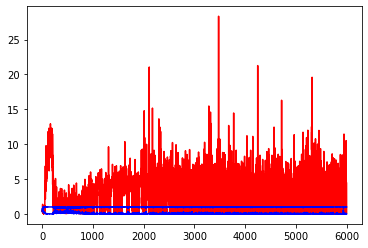

white ratio : 49.75
min : 184
max : 218


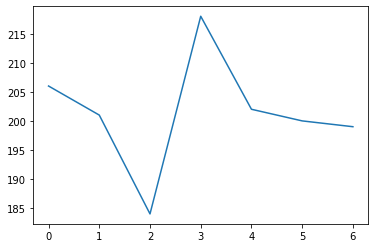

Generating interpolations...
6001 [D loss: 0.002175, acc.: 100.00%] [G loss: 4.989874, 4.157391]
6002 [D loss: 0.008287, acc.: 100.00%] [G loss: 5.377044, 3.212487]
6003 [D loss: 0.010035, acc.: 100.00%] [G loss: 12.004616, 5.697154]
6004 [D loss: 0.001126, acc.: 100.00%] [G loss: 6.999276, 6.109611]
6005 [D loss: 0.009654, acc.: 100.00%] [G loss: 6.108170, 2.252506]
6006 [D loss: 0.000220, acc.: 100.00%] [G loss: 8.681234, 8.889835]
6007 [D loss: 0.000073, acc.: 100.00%] [G loss: 2.472537, 1.613571]
6008 [D loss: 0.000567, acc.: 100.00%] [G loss: 2.108223, 1.729419]
6009 [D loss: 0.002993, acc.: 100.00%] [G loss: 5.358681, 4.820908]
6010 [D loss: 0.001726, acc.: 100.00%] [G loss: 1.957681, 1.946196]
6011 [D loss: 0.000480, acc.: 100.00%] [G loss: 7.492913, 6.155630]
6012 [D loss: 0.013836, acc.: 100.00%] [G loss: 5.029455, 4.489007]
6013 [D loss: 0.008011, acc.: 100.00%] [G loss: 4.112068, 2.575322]
6014 [D loss: 0.007351, acc.: 100.00%] [G loss: 5.581729, 2.056619]
6015 [D loss: 0.00

6122 [D loss: 0.000916, acc.: 100.00%] [G loss: 3.967745, 3.091786]
6123 [D loss: 0.000548, acc.: 100.00%] [G loss: 7.024775, 5.987180]
6124 [D loss: 0.001915, acc.: 100.00%] [G loss: 0.094910, 0.019990]
6125 [D loss: 0.001891, acc.: 100.00%] [G loss: 0.117431, 0.077816]
6126 [D loss: 0.001481, acc.: 100.00%] [G loss: 0.078577, 0.062232]
6127 [D loss: 0.002074, acc.: 100.00%] [G loss: 0.128171, 0.082074]
6128 [D loss: 0.265725, acc.: 93.75%] [G loss: 4.267313, 2.181901]
6129 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.010896, 0.016611]
6130 [D loss: 0.002129, acc.: 100.00%] [G loss: 0.000059, 0.000091]
6131 [D loss: 0.023924, acc.: 100.00%] [G loss: 2.684756, 4.945329]
6132 [D loss: 0.008421, acc.: 100.00%] [G loss: 1.754227, 0.015082]
6133 [D loss: 0.006250, acc.: 100.00%] [G loss: 3.823348, 1.898833]
6134 [D loss: 0.002942, acc.: 100.00%] [G loss: 8.736635, 2.070718]
6135 [D loss: 0.004118, acc.: 100.00%] [G loss: 0.001807, 0.000205]
6136 [D loss: 0.004844, acc.: 100.00%] [G loss: 1

6243 [D loss: 0.002158, acc.: 100.00%] [G loss: 2.109353, 1.634079]
6244 [D loss: 0.003728, acc.: 100.00%] [G loss: 5.955740, 4.395783]
6245 [D loss: 0.003483, acc.: 100.00%] [G loss: 6.621490, 5.490588]
6246 [D loss: 0.064439, acc.: 96.88%] [G loss: 0.114111, 0.070789]
6247 [D loss: 0.001943, acc.: 100.00%] [G loss: 6.012558, 3.492029]
6248 [D loss: 0.009909, acc.: 100.00%] [G loss: 7.113205, 3.939835]
6249 [D loss: 0.023192, acc.: 100.00%] [G loss: 3.400308, 2.862181]
6250 [D loss: 0.001684, acc.: 100.00%] [G loss: 8.844080, 7.103683]
6251 [D loss: 0.000868, acc.: 100.00%] [G loss: 4.426877, 3.330124]
6252 [D loss: 0.006253, acc.: 100.00%] [G loss: 3.912631, 1.122997]
6253 [D loss: 0.021824, acc.: 100.00%] [G loss: 8.486521, 5.185643]
6254 [D loss: 0.002540, acc.: 100.00%] [G loss: 4.333021, 4.651500]
6255 [D loss: 0.001547, acc.: 100.00%] [G loss: 10.412897, 8.527866]
6256 [D loss: 0.000899, acc.: 100.00%] [G loss: 2.922427, 1.224724]
6257 [D loss: 0.000170, acc.: 100.00%] [G loss: 

6364 [D loss: 0.002936, acc.: 100.00%] [G loss: 5.008398, 6.963589]
6365 [D loss: 0.015366, acc.: 100.00%] [G loss: 0.475671, 0.225963]
6366 [D loss: 0.010442, acc.: 100.00%] [G loss: 0.158284, 0.189911]
6367 [D loss: 0.003359, acc.: 100.00%] [G loss: 0.001465, 0.006795]
6368 [D loss: 0.000823, acc.: 100.00%] [G loss: 0.003765, 0.003645]
6369 [D loss: 0.094231, acc.: 93.75%] [G loss: 0.759744, 0.304549]
6370 [D loss: 0.079052, acc.: 96.88%] [G loss: 0.001395, 0.000860]
6371 [D loss: 0.001005, acc.: 100.00%] [G loss: 0.012329, 0.018274]
6372 [D loss: 0.035978, acc.: 96.88%] [G loss: 4.856227, 2.078914]
6373 [D loss: 0.000117, acc.: 100.00%] [G loss: 1.372752, 0.034527]
6374 [D loss: 0.030143, acc.: 96.88%] [G loss: 4.531978, 3.861346]
6375 [D loss: 0.000338, acc.: 100.00%] [G loss: 3.387663, 1.493839]
6376 [D loss: 0.001588, acc.: 100.00%] [G loss: 1.234651, 0.777906]
6377 [D loss: 0.000442, acc.: 100.00%] [G loss: 0.282070, 0.111833]
6378 [D loss: 0.001205, acc.: 100.00%] [G loss: 7.73

6485 [D loss: 0.000662, acc.: 100.00%] [G loss: 4.921887, 4.596179]
6486 [D loss: 0.004584, acc.: 100.00%] [G loss: 7.068324, 6.774786]
6487 [D loss: 0.005322, acc.: 100.00%] [G loss: 0.002009, 0.002141]
6488 [D loss: 0.001457, acc.: 100.00%] [G loss: 5.320205, 3.668872]
6489 [D loss: 0.002558, acc.: 100.00%] [G loss: 3.997789, 3.347712]
6490 [D loss: 0.007886, acc.: 100.00%] [G loss: 1.339832, 0.109394]
6491 [D loss: 0.005545, acc.: 100.00%] [G loss: 0.018651, 0.003116]
6492 [D loss: 0.000838, acc.: 100.00%] [G loss: 4.963548, 5.707237]
6493 [D loss: 0.000905, acc.: 100.00%] [G loss: 1.559569, 0.945252]
6494 [D loss: 0.020314, acc.: 100.00%] [G loss: 6.075607, 3.561939]
6495 [D loss: 0.000959, acc.: 100.00%] [G loss: 0.141500, 0.063041]
6496 [D loss: 0.000524, acc.: 100.00%] [G loss: 8.740256, 7.089105]
6497 [D loss: 0.027113, acc.: 96.88%] [G loss: 4.296965, 1.402526]
6498 [D loss: 0.001259, acc.: 100.00%] [G loss: 8.408380, 8.525688]
6499 [D loss: 0.001820, acc.: 100.00%] [G loss: 3

6606 [D loss: 0.014933, acc.: 100.00%] [G loss: 4.470207, 3.595034]
6607 [D loss: 0.097929, acc.: 96.88%] [G loss: 1.928385, 1.490238]
6608 [D loss: 0.002356, acc.: 100.00%] [G loss: 3.970391, 5.585217]
6609 [D loss: 0.016695, acc.: 100.00%] [G loss: 3.195934, 2.912773]
6610 [D loss: 0.000547, acc.: 100.00%] [G loss: 5.596620, 5.062201]
6611 [D loss: 0.010521, acc.: 100.00%] [G loss: 3.491668, 2.860938]
6612 [D loss: 0.014252, acc.: 100.00%] [G loss: 6.825343, 5.202963]
6613 [D loss: 0.002465, acc.: 100.00%] [G loss: 0.947415, 0.445431]
6614 [D loss: 0.001659, acc.: 100.00%] [G loss: 0.000916, 0.001118]
6615 [D loss: 0.001331, acc.: 100.00%] [G loss: 2.415022, 0.748466]
6616 [D loss: 0.001865, acc.: 100.00%] [G loss: 1.964791, 1.075902]
6617 [D loss: 0.002790, acc.: 100.00%] [G loss: 0.056692, 0.013335]
6618 [D loss: 0.015899, acc.: 100.00%] [G loss: 0.022462, 0.035871]
6619 [D loss: 0.026684, acc.: 96.88%] [G loss: 2.241663, 0.967506]
6620 [D loss: 0.013872, acc.: 100.00%] [G loss: 4.

6730 [D loss: 0.010624, acc.: 100.00%] [G loss: 4.260948, 3.643862]
6731 [D loss: 0.009089, acc.: 100.00%] [G loss: 3.979430, 3.660593]
6732 [D loss: 0.003549, acc.: 100.00%] [G loss: 4.837992, 0.010397]
6733 [D loss: 0.007404, acc.: 100.00%] [G loss: 2.620800, 2.280099]
6734 [D loss: 0.150559, acc.: 96.88%] [G loss: 0.687131, 0.516354]
6735 [D loss: 0.002810, acc.: 100.00%] [G loss: 0.000007, 0.000029]
6736 [D loss: 0.017941, acc.: 100.00%] [G loss: 0.890411, 0.560170]
6737 [D loss: 0.004400, acc.: 100.00%] [G loss: 4.200133, 3.732414]
6738 [D loss: 0.001142, acc.: 100.00%] [G loss: 2.516267, 1.814021]
6739 [D loss: 0.001872, acc.: 100.00%] [G loss: 3.342029, 2.677640]
6740 [D loss: 0.001356, acc.: 100.00%] [G loss: 0.042635, 0.053630]
6741 [D loss: 0.002952, acc.: 100.00%] [G loss: 0.009241, 0.004236]
6742 [D loss: 0.001767, acc.: 100.00%] [G loss: 0.010422, 0.013949]
6743 [D loss: 0.007134, acc.: 100.00%] [G loss: 4.476433, 4.099008]
6744 [D loss: 0.005059, acc.: 100.00%] [G loss: 0

6853 [D loss: 0.000229, acc.: 100.00%] [G loss: 4.277328, 1.719972]
6854 [D loss: 0.002621, acc.: 100.00%] [G loss: 3.399153, 1.379964]
6855 [D loss: 0.001380, acc.: 100.00%] [G loss: 0.176065, 0.195722]
6856 [D loss: 0.000167, acc.: 100.00%] [G loss: 3.830524, 1.022258]
6857 [D loss: 0.005895, acc.: 100.00%] [G loss: 0.060709, 0.058462]
6858 [D loss: 0.001002, acc.: 100.00%] [G loss: 3.606520, 1.196117]
6859 [D loss: 0.113108, acc.: 96.88%] [G loss: 0.023272, 0.026578]
6860 [D loss: 0.005011, acc.: 100.00%] [G loss: 3.107064, 0.976039]
6861 [D loss: 0.018979, acc.: 100.00%] [G loss: 3.022941, 1.466248]
6862 [D loss: 0.019174, acc.: 100.00%] [G loss: 0.026842, 0.012286]
6863 [D loss: 0.001321, acc.: 100.00%] [G loss: 6.904849, 0.737101]
6864 [D loss: 0.115743, acc.: 96.88%] [G loss: 0.051099, 0.025482]
6865 [D loss: 0.006345, acc.: 100.00%] [G loss: 0.370444, 0.157517]
6866 [D loss: 0.002824, acc.: 100.00%] [G loss: 0.027244, 0.051903]
6867 [D loss: 0.029970, acc.: 100.00%] [G loss: 3.

6974 [D loss: 0.002130, acc.: 100.00%] [G loss: 0.394138, 0.128306]
6975 [D loss: 0.138427, acc.: 96.88%] [G loss: 0.023025, 0.018125]
6976 [D loss: 0.006359, acc.: 100.00%] [G loss: 0.893940, 0.400188]
6977 [D loss: 0.018075, acc.: 100.00%] [G loss: 4.037800, 2.182084]
6978 [D loss: 0.000495, acc.: 100.00%] [G loss: 4.664392, 3.930769]
6979 [D loss: 0.098851, acc.: 96.88%] [G loss: 5.731767, 4.624401]
6980 [D loss: 0.047521, acc.: 96.88%] [G loss: 1.563119, 0.193331]
6981 [D loss: 0.027557, acc.: 100.00%] [G loss: 1.875623, 2.625968]
6982 [D loss: 0.003799, acc.: 100.00%] [G loss: 2.167915, 1.738563]
6983 [D loss: 0.000149, acc.: 100.00%] [G loss: 1.950058, 0.617496]
6984 [D loss: 0.000450, acc.: 100.00%] [G loss: 6.954384, 0.188607]
6985 [D loss: 0.000586, acc.: 100.00%] [G loss: 1.848482, 0.793321]
6986 [D loss: 0.002857, acc.: 100.00%] [G loss: 4.025173, 1.918072]
6987 [D loss: 0.002487, acc.: 100.00%] [G loss: 7.189972, 4.406331]
6988 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.8

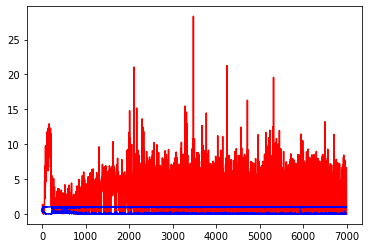

white ratio : 48.75
min : 184
max : 218


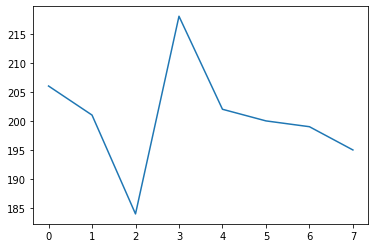

Generating interpolations...
7001 [D loss: 0.004866, acc.: 100.00%] [G loss: 5.090694, 9.383556]
7002 [D loss: 0.000533, acc.: 100.00%] [G loss: 11.518458, 10.285931]
7003 [D loss: 0.000219, acc.: 100.00%] [G loss: 12.894406, 8.125885]
7004 [D loss: 0.000496, acc.: 100.00%] [G loss: 10.244432, 9.853535]
7005 [D loss: 0.000113, acc.: 100.00%] [G loss: 8.445099, 7.507517]
7006 [D loss: 0.000271, acc.: 100.00%] [G loss: 8.814667, 8.305628]
7007 [D loss: 0.001718, acc.: 100.00%] [G loss: 7.620130, 6.916504]
7008 [D loss: 0.001575, acc.: 100.00%] [G loss: 6.957094, 6.427419]
7009 [D loss: 0.001484, acc.: 100.00%] [G loss: 8.528852, 8.664402]
7010 [D loss: 0.000206, acc.: 100.00%] [G loss: 7.715438, 7.721908]
7011 [D loss: 0.000554, acc.: 100.00%] [G loss: 4.351254, 4.065534]
7012 [D loss: 0.002586, acc.: 100.00%] [G loss: 4.960619, 5.087582]
7013 [D loss: 0.000199, acc.: 100.00%] [G loss: 4.314461, 4.026517]
7014 [D loss: 0.000530, acc.: 100.00%] [G loss: 4.853452, 4.450536]
7015 [D loss: 0

7124 [D loss: 0.037456, acc.: 96.88%] [G loss: 2.345077, 1.891732]
7125 [D loss: 0.002850, acc.: 100.00%] [G loss: 0.574770, 0.332172]
7126 [D loss: 0.029824, acc.: 100.00%] [G loss: 3.347960, 1.332811]
7127 [D loss: 0.045082, acc.: 96.88%] [G loss: 2.260571, 2.362430]
7128 [D loss: 0.035183, acc.: 96.88%] [G loss: 6.562960, 6.422386]
7129 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.231709, 0.304262]
7130 [D loss: 0.012435, acc.: 100.00%] [G loss: 5.791348, 4.580853]
7131 [D loss: 0.009882, acc.: 100.00%] [G loss: 0.238908, 0.193094]
7132 [D loss: 0.001015, acc.: 100.00%] [G loss: 6.148904, 5.286817]
7133 [D loss: 0.000230, acc.: 100.00%] [G loss: 6.731073, 5.319849]
7134 [D loss: 0.000723, acc.: 100.00%] [G loss: 2.332940, 1.573649]
7135 [D loss: 0.004226, acc.: 100.00%] [G loss: 8.274127, 4.772155]
7136 [D loss: 0.001940, acc.: 100.00%] [G loss: 8.232112, 2.471720]
7137 [D loss: 0.001538, acc.: 100.00%] [G loss: 2.013751, 0.616792]
7138 [D loss: 0.004289, acc.: 100.00%] [G loss: 3.1

7248 [D loss: 0.043766, acc.: 96.88%] [G loss: 6.315389, 6.514546]
7249 [D loss: 0.002497, acc.: 100.00%] [G loss: 0.725456, 1.304982]
7250 [D loss: 0.000534, acc.: 100.00%] [G loss: 0.008218, 0.063569]
7251 [D loss: 0.000136, acc.: 100.00%] [G loss: 5.097577, 3.889279]
7252 [D loss: 0.000085, acc.: 100.00%] [G loss: 7.107604, 6.566205]
7253 [D loss: 0.006197, acc.: 100.00%] [G loss: 4.024645, 3.106874]
7254 [D loss: 0.000969, acc.: 100.00%] [G loss: 0.066642, 0.002495]
7255 [D loss: 0.001004, acc.: 100.00%] [G loss: 0.004069, 0.002706]
7256 [D loss: 0.009186, acc.: 100.00%] [G loss: 0.264117, 0.052825]
7257 [D loss: 0.005836, acc.: 100.00%] [G loss: 0.315997, 0.030413]
7258 [D loss: 0.003272, acc.: 100.00%] [G loss: 4.242901, 3.282751]
7259 [D loss: 0.002590, acc.: 100.00%] [G loss: 3.798134, 2.690287]
7260 [D loss: 0.001715, acc.: 100.00%] [G loss: 2.559863, 1.891267]
7261 [D loss: 0.001019, acc.: 100.00%] [G loss: 4.416574, 3.649396]
7262 [D loss: 0.156556, acc.: 96.88%] [G loss: 5.

7372 [D loss: 0.015136, acc.: 100.00%] [G loss: 6.507782, 5.347944]
7373 [D loss: 0.000746, acc.: 100.00%] [G loss: 0.097746, 0.015220]
7374 [D loss: 0.003735, acc.: 100.00%] [G loss: 0.217732, 0.082774]
7375 [D loss: 0.000606, acc.: 100.00%] [G loss: 5.378490, 3.878119]
7376 [D loss: 0.016526, acc.: 100.00%] [G loss: 5.354622, 2.678062]
7377 [D loss: 0.021251, acc.: 100.00%] [G loss: 14.512737, 3.273597]
7378 [D loss: 0.005538, acc.: 100.00%] [G loss: 5.612780, 3.475620]
7379 [D loss: 0.010498, acc.: 100.00%] [G loss: 9.337696, 5.883636]
7380 [D loss: 0.000027, acc.: 100.00%] [G loss: 8.077700, 4.133074]
7381 [D loss: 0.001081, acc.: 100.00%] [G loss: 7.706482, 7.179707]
7382 [D loss: 0.000660, acc.: 100.00%] [G loss: 7.801896, 7.203934]
7383 [D loss: 0.000960, acc.: 100.00%] [G loss: 7.496704, 9.881634]
7384 [D loss: 0.000140, acc.: 100.00%] [G loss: 9.238626, 8.217333]
7385 [D loss: 0.094030, acc.: 96.88%] [G loss: 4.996489, 3.647432]
7386 [D loss: 0.002560, acc.: 100.00%] [G loss: 

7493 [D loss: 0.084164, acc.: 96.88%] [G loss: 2.782068, 0.725569]
7494 [D loss: 0.003991, acc.: 100.00%] [G loss: 2.668125, 1.269900]
7495 [D loss: 0.064786, acc.: 96.88%] [G loss: 7.529848, 5.021960]
7496 [D loss: 0.000434, acc.: 100.00%] [G loss: 2.317054, 0.752542]
7497 [D loss: 0.245850, acc.: 93.75%] [G loss: 4.647789, 6.911072]
7498 [D loss: 0.033679, acc.: 100.00%] [G loss: 6.983972, 6.797879]
7499 [D loss: 0.000268, acc.: 100.00%] [G loss: 8.326239, 7.713420]
7500 [D loss: 0.160595, acc.: 96.88%] [G loss: 5.417742, 5.122835]
7501 [D loss: 0.012712, acc.: 100.00%] [G loss: 3.093524, 1.842575]
7502 [D loss: 0.000845, acc.: 100.00%] [G loss: 5.216611, 4.662974]
7503 [D loss: 0.001157, acc.: 100.00%] [G loss: 14.302690, 6.949933]
7504 [D loss: 0.002225, acc.: 100.00%] [G loss: 1.783107, 0.686158]
7505 [D loss: 0.027353, acc.: 100.00%] [G loss: 3.446254, 1.914453]
7506 [D loss: 0.001794, acc.: 100.00%] [G loss: 5.370079, 4.624385]
7507 [D loss: 0.013337, acc.: 100.00%] [G loss: 7.0

7614 [D loss: 0.000497, acc.: 100.00%] [G loss: 4.983359, 4.752417]
7615 [D loss: 0.001914, acc.: 100.00%] [G loss: 7.597359, 7.288965]
7616 [D loss: 0.004176, acc.: 100.00%] [G loss: 4.958283, 3.640483]
7617 [D loss: 0.000496, acc.: 100.00%] [G loss: 5.917513, 6.044381]
7618 [D loss: 0.001288, acc.: 100.00%] [G loss: 2.960017, 1.684602]
7619 [D loss: 0.002935, acc.: 100.00%] [G loss: 1.413250, 0.697798]
7620 [D loss: 0.000751, acc.: 100.00%] [G loss: 2.616987, 2.212937]
7621 [D loss: 0.001584, acc.: 100.00%] [G loss: 5.295833, 4.068609]
7622 [D loss: 0.002836, acc.: 100.00%] [G loss: 4.542505, 4.884188]
7623 [D loss: 0.001582, acc.: 100.00%] [G loss: 5.109816, 4.861959]
7624 [D loss: 0.001587, acc.: 100.00%] [G loss: 4.539138, 3.572979]
7625 [D loss: 0.002358, acc.: 100.00%] [G loss: 2.017650, 1.985010]
7626 [D loss: 0.124000, acc.: 96.88%] [G loss: 4.589132, 3.014511]
7627 [D loss: 0.001964, acc.: 100.00%] [G loss: 34.383080, 2.336017]
7628 [D loss: 0.057601, acc.: 96.88%] [G loss: 3

7737 [D loss: 0.002216, acc.: 100.00%] [G loss: 3.685578, 1.645812]
7738 [D loss: 0.000300, acc.: 100.00%] [G loss: 5.492179, 6.352723]
7739 [D loss: 0.014052, acc.: 100.00%] [G loss: 6.818026, 5.013775]
7740 [D loss: 0.005274, acc.: 100.00%] [G loss: 9.770191, 3.608133]
7741 [D loss: 0.004135, acc.: 100.00%] [G loss: 4.649315, 0.517067]
7742 [D loss: 0.002707, acc.: 100.00%] [G loss: 8.116676, 3.512257]
7743 [D loss: 0.004203, acc.: 100.00%] [G loss: 4.807871, 0.237354]
7744 [D loss: 0.000924, acc.: 100.00%] [G loss: 18.953636, 6.476911]
7745 [D loss: 0.001212, acc.: 100.00%] [G loss: 8.931845, 4.081716]
7746 [D loss: 0.114870, acc.: 96.88%] [G loss: 12.327710, 9.541290]
7747 [D loss: 0.045683, acc.: 100.00%] [G loss: 0.262180, 0.159764]
7748 [D loss: 0.013265, acc.: 100.00%] [G loss: 4.478166, 3.277344]
7749 [D loss: 0.004312, acc.: 100.00%] [G loss: 4.140770, 3.025080]
7750 [D loss: 0.085504, acc.: 96.88%] [G loss: 5.695459, 3.650845]
7751 [D loss: 0.044146, acc.: 96.88%] [G loss: 7

7858 [D loss: 0.010807, acc.: 100.00%] [G loss: 1.484890, 1.469988]
7859 [D loss: 0.000511, acc.: 100.00%] [G loss: 8.429827, 3.124638]
7860 [D loss: 0.002095, acc.: 100.00%] [G loss: 0.025204, 0.015494]
7861 [D loss: 0.003281, acc.: 100.00%] [G loss: 0.006214, 0.004417]
7862 [D loss: 0.001684, acc.: 100.00%] [G loss: 3.495784, 3.589404]
7863 [D loss: 0.007587, acc.: 100.00%] [G loss: 2.939745, 2.249211]
7864 [D loss: 0.004145, acc.: 100.00%] [G loss: 8.975871, 1.923342]
7865 [D loss: 0.001775, acc.: 100.00%] [G loss: 1.798139, 0.749708]
7866 [D loss: 0.001975, acc.: 100.00%] [G loss: 2.458729, 1.121746]
7867 [D loss: 0.030085, acc.: 96.88%] [G loss: 1.683722, 3.214095]
7868 [D loss: 0.000373, acc.: 100.00%] [G loss: 0.184678, 0.533720]
7869 [D loss: 0.031403, acc.: 96.88%] [G loss: 0.043624, 0.027824]
7870 [D loss: 0.006139, acc.: 100.00%] [G loss: 0.191494, 0.197530]
7871 [D loss: 0.003131, acc.: 100.00%] [G loss: 7.759404, 3.569665]
7872 [D loss: 0.007426, acc.: 100.00%] [G loss: 2.

7982 [D loss: 0.002208, acc.: 100.00%] [G loss: 6.309443, 6.189005]
7983 [D loss: 0.016314, acc.: 100.00%] [G loss: 6.946943, 6.661160]
7984 [D loss: 0.003804, acc.: 100.00%] [G loss: 5.478827, 3.358073]
7985 [D loss: 0.002541, acc.: 100.00%] [G loss: 0.556041, 0.089184]
7986 [D loss: 0.003108, acc.: 100.00%] [G loss: 0.120889, 0.010625]
7987 [D loss: 0.031542, acc.: 100.00%] [G loss: 2.408154, 0.088992]
7988 [D loss: 0.001332, acc.: 100.00%] [G loss: 6.004059, 5.178932]
7989 [D loss: 0.111152, acc.: 96.88%] [G loss: 0.000369, 0.000968]
7990 [D loss: 0.002254, acc.: 100.00%] [G loss: 2.862998, 2.152365]
7991 [D loss: 0.005927, acc.: 100.00%] [G loss: 4.819601, 3.976967]
7992 [D loss: 0.006769, acc.: 100.00%] [G loss: 5.060955, 0.157120]
7993 [D loss: 0.000727, acc.: 100.00%] [G loss: 4.651183, 5.069543]
7994 [D loss: 0.003176, acc.: 100.00%] [G loss: 7.112399, 6.511272]
7995 [D loss: 0.026499, acc.: 100.00%] [G loss: 4.571750, 0.954498]
7996 [D loss: 0.000728, acc.: 100.00%] [G loss: 3

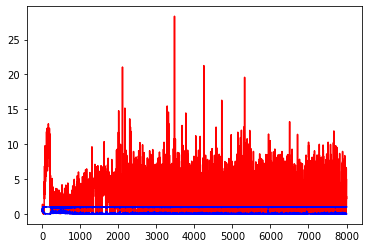

white ratio : 52.25
min : 184
max : 218


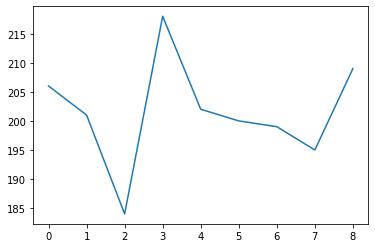

Generating interpolations...
8001 [D loss: 0.000894, acc.: 100.00%] [G loss: 0.003409, 0.002596]
8002 [D loss: 0.000307, acc.: 100.00%] [G loss: 8.148978, 6.490977]
8003 [D loss: 0.001091, acc.: 100.00%] [G loss: 1.127769, 1.820037]
8004 [D loss: 0.001795, acc.: 100.00%] [G loss: 6.988771, 6.390261]
8005 [D loss: 0.008550, acc.: 100.00%] [G loss: 1.749717, 0.694885]
8006 [D loss: 0.001933, acc.: 100.00%] [G loss: 4.662682, 4.566616]
8007 [D loss: 0.000516, acc.: 100.00%] [G loss: 3.521253, 4.783214]
8008 [D loss: 0.000596, acc.: 100.00%] [G loss: 5.772178, 5.457479]
8009 [D loss: 0.000302, acc.: 100.00%] [G loss: 6.066100, 5.052395]
8010 [D loss: 0.060639, acc.: 96.88%] [G loss: 6.967391, 6.486086]
8011 [D loss: 0.015056, acc.: 100.00%] [G loss: 6.693504, 6.271286]
8012 [D loss: 0.007920, acc.: 100.00%] [G loss: 0.229386, 0.153422]
8013 [D loss: 0.005301, acc.: 100.00%] [G loss: 1.043849, 1.547884]
8014 [D loss: 0.001299, acc.: 100.00%] [G loss: 6.001059, 4.125345]
8015 [D loss: 0.0282

8122 [D loss: 0.015052, acc.: 100.00%] [G loss: 6.366920, 5.073993]
8123 [D loss: 0.015128, acc.: 100.00%] [G loss: 0.104665, 0.055273]
8124 [D loss: 0.001466, acc.: 100.00%] [G loss: 3.247580, 1.678022]
8125 [D loss: 0.012898, acc.: 100.00%] [G loss: 0.293641, 0.128907]
8126 [D loss: 0.001225, acc.: 100.00%] [G loss: 4.633367, 4.285557]
8127 [D loss: 0.004630, acc.: 100.00%] [G loss: 0.001490, 0.001537]
8128 [D loss: 0.000190, acc.: 100.00%] [G loss: 4.839173, 3.878911]
8129 [D loss: 0.000875, acc.: 100.00%] [G loss: 0.034114, 0.024018]
8130 [D loss: 0.000366, acc.: 100.00%] [G loss: 8.666765, 6.434539]
8131 [D loss: 0.000531, acc.: 100.00%] [G loss: 6.983796, 6.509451]
8132 [D loss: 0.001116, acc.: 100.00%] [G loss: 6.215283, 4.840019]
8133 [D loss: 0.000375, acc.: 100.00%] [G loss: 7.531115, 2.993522]
8134 [D loss: 0.002885, acc.: 100.00%] [G loss: 6.357707, 4.648377]
8135 [D loss: 0.000428, acc.: 100.00%] [G loss: 7.756532, 5.751836]
8136 [D loss: 0.000611, acc.: 100.00%] [G loss: 

8245 [D loss: 0.025463, acc.: 100.00%] [G loss: 0.034673, 0.019777]
8246 [D loss: 0.003615, acc.: 100.00%] [G loss: 7.556498, 7.618993]
8247 [D loss: 0.000667, acc.: 100.00%] [G loss: 0.000315, 0.000580]
8248 [D loss: 0.000508, acc.: 100.00%] [G loss: 6.877628, 8.516016]
8249 [D loss: 0.002631, acc.: 100.00%] [G loss: 7.034121, 6.908702]
8250 [D loss: 0.000427, acc.: 100.00%] [G loss: 0.563369, 0.134132]
8251 [D loss: 0.000349, acc.: 100.00%] [G loss: 2.853807, 0.001001]
8252 [D loss: 0.000891, acc.: 100.00%] [G loss: 6.466255, 4.429657]
8253 [D loss: 0.001631, acc.: 100.00%] [G loss: 8.059464, 6.658292]
8254 [D loss: 0.027442, acc.: 100.00%] [G loss: 4.953873, 3.554091]
8255 [D loss: 0.002057, acc.: 100.00%] [G loss: 6.677068, 5.435741]
8256 [D loss: 0.001636, acc.: 100.00%] [G loss: 0.079836, 0.037310]
8257 [D loss: 0.003532, acc.: 100.00%] [G loss: 5.932905, 3.801389]
8258 [D loss: 0.000979, acc.: 100.00%] [G loss: 5.842891, 4.780013]
8259 [D loss: 0.000265, acc.: 100.00%] [G loss: 

8368 [D loss: 0.000160, acc.: 100.00%] [G loss: 3.337690, 0.416899]
8369 [D loss: 0.070501, acc.: 96.88%] [G loss: 7.176897, 5.325767]
8370 [D loss: 0.003256, acc.: 100.00%] [G loss: 16.115452, 0.044979]
8371 [D loss: 0.182736, acc.: 96.88%] [G loss: 7.593966, 7.799613]
8372 [D loss: 0.000730, acc.: 100.00%] [G loss: 8.669777, 6.307916]
8373 [D loss: 0.000560, acc.: 100.00%] [G loss: 7.121613, 7.184705]
8374 [D loss: 0.002799, acc.: 100.00%] [G loss: 5.670908, 5.285089]
8375 [D loss: 0.003764, acc.: 100.00%] [G loss: 0.000002, 0.000002]
8376 [D loss: 0.002661, acc.: 100.00%] [G loss: 0.002475, 0.001136]
8377 [D loss: 0.002004, acc.: 100.00%] [G loss: 4.703158, 4.273158]
8378 [D loss: 0.006159, acc.: 100.00%] [G loss: 4.027616, 4.556735]
8379 [D loss: 0.003305, acc.: 100.00%] [G loss: 8.898344, 6.690797]
8380 [D loss: 0.000605, acc.: 100.00%] [G loss: 9.770062, 6.802035]
8381 [D loss: 0.013750, acc.: 100.00%] [G loss: 5.808889, 5.328083]
8382 [D loss: 0.001538, acc.: 100.00%] [G loss: 7

8492 [D loss: 0.021969, acc.: 100.00%] [G loss: 0.013487, 0.043284]
8493 [D loss: 0.000657, acc.: 100.00%] [G loss: 5.024445, 3.658348]
8494 [D loss: 0.002320, acc.: 100.00%] [G loss: 4.441194, 1.403290]
8495 [D loss: 0.001082, acc.: 100.00%] [G loss: 0.916772, 0.105849]
8496 [D loss: 0.138088, acc.: 96.88%] [G loss: 22.494858, 8.092701]
8497 [D loss: 0.001199, acc.: 100.00%] [G loss: 5.667786, 5.721429]
8498 [D loss: 0.008146, acc.: 100.00%] [G loss: 6.032701, 4.651801]
8499 [D loss: 0.306316, acc.: 93.75%] [G loss: 0.952688, 0.580265]
8500 [D loss: 0.120130, acc.: 96.88%] [G loss: 5.153189, 4.862865]
8501 [D loss: 0.001210, acc.: 100.00%] [G loss: 7.715782, 7.307387]
8502 [D loss: 0.000135, acc.: 100.00%] [G loss: 7.319154, 6.724035]
8503 [D loss: 0.002214, acc.: 100.00%] [G loss: 4.543772, 7.525735]
8504 [D loss: 0.021715, acc.: 100.00%] [G loss: 6.480204, 5.872697]
8505 [D loss: 0.005831, acc.: 100.00%] [G loss: 8.705126, 8.121023]
8506 [D loss: 0.000907, acc.: 100.00%] [G loss: 2.

8615 [D loss: 0.074514, acc.: 96.88%] [G loss: 4.130370, 2.997054]
8616 [D loss: 0.026889, acc.: 100.00%] [G loss: 43.389168, 8.375083]
8617 [D loss: 0.001428, acc.: 100.00%] [G loss: 2.260247, 3.412906]
8618 [D loss: 0.000712, acc.: 100.00%] [G loss: 3.698884, 3.586645]
8619 [D loss: 0.001784, acc.: 100.00%] [G loss: 1.148590, 0.102808]
8620 [D loss: 0.078578, acc.: 96.88%] [G loss: 0.024902, 0.032616]
8621 [D loss: 0.016419, acc.: 100.00%] [G loss: 6.103803, 4.075481]
8622 [D loss: 0.003224, acc.: 100.00%] [G loss: 4.247456, 3.410001]
8623 [D loss: 0.010946, acc.: 100.00%] [G loss: 5.959328, 5.417933]
8624 [D loss: 0.004269, acc.: 100.00%] [G loss: 0.000147, 0.000015]
8625 [D loss: 0.016623, acc.: 100.00%] [G loss: 4.065162, 4.396419]
8626 [D loss: 0.003031, acc.: 100.00%] [G loss: 3.389839, 2.805021]
8627 [D loss: 0.294659, acc.: 93.75%] [G loss: 9.617628, 6.170668]
8628 [D loss: 0.011324, acc.: 100.00%] [G loss: 0.897791, 0.538303]
8629 [D loss: 0.012447, acc.: 100.00%] [G loss: 0.

8739 [D loss: 0.022643, acc.: 96.88%] [G loss: 2.671939, 1.437515]
8740 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.027707, 0.080067]
8741 [D loss: 0.000894, acc.: 100.00%] [G loss: 0.754983, 0.362174]
8742 [D loss: 0.001141, acc.: 100.00%] [G loss: 0.000169, 0.000121]
8743 [D loss: 0.001165, acc.: 100.00%] [G loss: 1.902007, 0.622400]
8744 [D loss: 0.013879, acc.: 100.00%] [G loss: 5.536002, 0.847394]
8745 [D loss: 0.005185, acc.: 100.00%] [G loss: 3.552135, 2.367306]
8746 [D loss: 0.004667, acc.: 100.00%] [G loss: 0.102337, 0.031327]
8747 [D loss: 0.002880, acc.: 100.00%] [G loss: 2.407410, 1.785238]
8748 [D loss: 0.001197, acc.: 100.00%] [G loss: 1.460400, 1.022151]
8749 [D loss: 0.033880, acc.: 100.00%] [G loss: 2.399525, 1.792361]
8750 [D loss: 0.019351, acc.: 100.00%] [G loss: 1.102750, 0.504638]
8751 [D loss: 0.056528, acc.: 100.00%] [G loss: 3.383868, 0.662217]
8752 [D loss: 0.104859, acc.: 96.88%] [G loss: 0.603326, 1.521508]
8753 [D loss: 0.214295, acc.: 93.75%] [G loss: 0.0

8861 [D loss: 0.018495, acc.: 100.00%] [G loss: 0.078205, 0.001034]
8862 [D loss: 0.006436, acc.: 100.00%] [G loss: 0.000101, 0.000134]
8863 [D loss: 0.010930, acc.: 100.00%] [G loss: 4.431715, 2.704618]
8864 [D loss: 0.004245, acc.: 100.00%] [G loss: 5.542095, 5.070405]
8865 [D loss: 0.002368, acc.: 100.00%] [G loss: 0.000132, 0.000111]
8866 [D loss: 0.003678, acc.: 100.00%] [G loss: 0.059891, 0.019731]
8867 [D loss: 0.006975, acc.: 100.00%] [G loss: 0.095892, 0.050818]
8868 [D loss: 0.001513, acc.: 100.00%] [G loss: 0.039961, 0.033018]
8869 [D loss: 0.003905, acc.: 100.00%] [G loss: 0.571143, 0.170083]
8870 [D loss: 0.000905, acc.: 100.00%] [G loss: 0.417229, 0.203420]
8871 [D loss: 0.000768, acc.: 100.00%] [G loss: 0.000035, 0.000022]
8872 [D loss: 0.006725, acc.: 100.00%] [G loss: 0.000030, 0.000003]
8873 [D loss: 0.005131, acc.: 100.00%] [G loss: 0.023197, 0.028719]
8874 [D loss: 0.001669, acc.: 100.00%] [G loss: 0.420545, 0.133360]
8875 [D loss: 0.002606, acc.: 100.00%] [G loss: 

8985 [D loss: 0.009242, acc.: 100.00%] [G loss: 0.018305, 0.010962]
8986 [D loss: 0.001014, acc.: 100.00%] [G loss: 1.161086, 0.865045]
8987 [D loss: 0.001518, acc.: 100.00%] [G loss: 0.947108, 1.186980]
8988 [D loss: 0.000780, acc.: 100.00%] [G loss: 0.616045, 0.173255]
8989 [D loss: 0.002078, acc.: 100.00%] [G loss: 20.972942, 15.849185]
8990 [D loss: 0.004184, acc.: 100.00%] [G loss: 4.580884, 4.147198]
8991 [D loss: 0.000335, acc.: 100.00%] [G loss: 2.778686, 2.134892]
8992 [D loss: 0.000461, acc.: 100.00%] [G loss: 3.171669, 2.623946]
8993 [D loss: 0.020342, acc.: 100.00%] [G loss: 4.006477, 3.464090]
8994 [D loss: 0.000315, acc.: 100.00%] [G loss: 3.973614, 3.488838]
8995 [D loss: 0.000201, acc.: 100.00%] [G loss: 3.772691, 3.352295]
8996 [D loss: 0.000085, acc.: 100.00%] [G loss: 2.685720, 2.969797]
8997 [D loss: 0.005394, acc.: 100.00%] [G loss: 3.033127, 2.918484]
8998 [D loss: 0.000300, acc.: 100.00%] [G loss: 2.113354, 2.159318]
8999 [D loss: 0.000396, acc.: 100.00%] [G loss

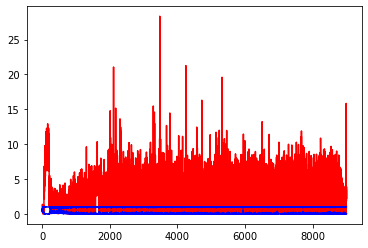

white ratio : 47.0
min : 184
max : 218


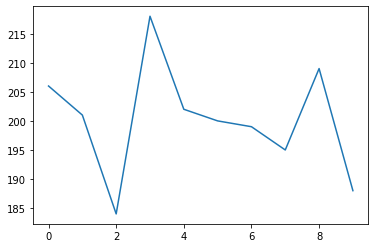

Generating interpolations...
9001 [D loss: 0.002341, acc.: 100.00%] [G loss: 3.061336, 2.740329]
9002 [D loss: 0.001018, acc.: 100.00%] [G loss: 2.269454, 1.812191]
9003 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.914618, 0.904076]
9004 [D loss: 0.000434, acc.: 100.00%] [G loss: 2.635276, 2.466291]
9005 [D loss: 0.000426, acc.: 100.00%] [G loss: 4.100192, 3.743086]
9006 [D loss: 0.000041, acc.: 100.00%] [G loss: 2.995580, 2.932027]
9007 [D loss: 0.000965, acc.: 100.00%] [G loss: 0.907185, 0.835013]
9008 [D loss: 0.000206, acc.: 100.00%] [G loss: 2.970430, 2.111513]
9009 [D loss: 0.000093, acc.: 100.00%] [G loss: 2.106247, 2.099690]
9010 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.965900, 0.458162]
9011 [D loss: 0.000199, acc.: 100.00%] [G loss: 1.132465, 0.538236]
9012 [D loss: 0.000101, acc.: 100.00%] [G loss: 1.316915, 0.580320]
9013 [D loss: 0.004365, acc.: 100.00%] [G loss: 1.163393, 0.850980]
9014 [D loss: 0.025980, acc.: 100.00%] [G loss: 0.336072, 0.105588]
9015 [D loss: 0.076

9121 [D loss: 0.000858, acc.: 100.00%] [G loss: 6.016447, 6.863723]
9122 [D loss: 0.001068, acc.: 100.00%] [G loss: 4.211273, 2.050236]
9123 [D loss: 0.002207, acc.: 100.00%] [G loss: 2.603736, 3.806853]
9124 [D loss: 0.000269, acc.: 100.00%] [G loss: 10.288753, 9.587776]
9125 [D loss: 0.000184, acc.: 100.00%] [G loss: 1.804907, 0.956526]
9126 [D loss: 0.306709, acc.: 93.75%] [G loss: 2.653354, 0.918685]
9127 [D loss: 0.002527, acc.: 100.00%] [G loss: 0.097477, 0.053746]
9128 [D loss: 0.040932, acc.: 96.88%] [G loss: 9.380940, 8.802393]
9129 [D loss: 0.000643, acc.: 100.00%] [G loss: 7.452225, 7.861483]
9130 [D loss: 0.003993, acc.: 100.00%] [G loss: 14.003580, 5.658340]
9131 [D loss: 0.038188, acc.: 96.88%] [G loss: 4.252235, 5.210931]
9132 [D loss: 0.070756, acc.: 93.75%] [G loss: 3.017803, 2.277469]
9133 [D loss: 0.048714, acc.: 96.88%] [G loss: 4.284102, 2.222409]
9134 [D loss: 0.012445, acc.: 100.00%] [G loss: 8.845133, 7.087292]
9135 [D loss: 0.001333, acc.: 100.00%] [G loss: 13.

9242 [D loss: 0.000986, acc.: 100.00%] [G loss: 0.024635, 0.059792]
9243 [D loss: 0.258837, acc.: 93.75%] [G loss: 1.772805, 1.530993]
9244 [D loss: 0.013013, acc.: 100.00%] [G loss: 2.847990, 2.004472]
9245 [D loss: 0.040664, acc.: 96.88%] [G loss: 2.239195, 1.668863]
9246 [D loss: 0.000772, acc.: 100.00%] [G loss: 2.658517, 2.016285]
9247 [D loss: 0.004607, acc.: 100.00%] [G loss: 0.696765, 0.066845]
9248 [D loss: 0.001836, acc.: 100.00%] [G loss: 3.815434, 2.569139]
9249 [D loss: 0.004481, acc.: 100.00%] [G loss: 8.513216, 7.941618]
9250 [D loss: 0.126812, acc.: 96.88%] [G loss: 3.793858, 2.483070]
9251 [D loss: 0.005144, acc.: 100.00%] [G loss: 4.001726, 3.056415]
9252 [D loss: 0.005669, acc.: 100.00%] [G loss: 6.805630, 7.021803]
9253 [D loss: 0.007081, acc.: 100.00%] [G loss: 4.726363, 5.581562]
9254 [D loss: 0.000419, acc.: 100.00%] [G loss: 4.939152, 3.282310]
9255 [D loss: 0.000078, acc.: 100.00%] [G loss: 9.305048, 7.333060]
9256 [D loss: 0.003638, acc.: 100.00%] [G loss: 7.7

9366 [D loss: 0.000533, acc.: 100.00%] [G loss: 3.387559, 2.695065]
9367 [D loss: 0.004390, acc.: 100.00%] [G loss: 3.231022, 1.655481]
9368 [D loss: 0.000980, acc.: 100.00%] [G loss: 3.980083, 2.798505]
9369 [D loss: 0.002339, acc.: 100.00%] [G loss: 3.620382, 5.961620]
9370 [D loss: 0.008481, acc.: 100.00%] [G loss: 31.141138, 12.025070]
9371 [D loss: 0.009108, acc.: 100.00%] [G loss: 0.002386, 0.015021]
9372 [D loss: 0.002618, acc.: 100.00%] [G loss: 4.299061, 3.872361]
9373 [D loss: 0.001657, acc.: 100.00%] [G loss: 13.411081, 7.965344]
9374 [D loss: 0.000139, acc.: 100.00%] [G loss: 4.410707, 3.180418]
9375 [D loss: 0.021919, acc.: 96.88%] [G loss: 10.984064, 9.178638]
9376 [D loss: 0.000034, acc.: 100.00%] [G loss: 8.839283, 8.617540]
9377 [D loss: 0.000221, acc.: 100.00%] [G loss: 7.338286, 7.456423]
9378 [D loss: 0.000817, acc.: 100.00%] [G loss: 1.808636, 0.449300]
9379 [D loss: 0.006028, acc.: 100.00%] [G loss: 3.846811, 3.196629]
9380 [D loss: 0.000691, acc.: 100.00%] [G los

9489 [D loss: 0.001244, acc.: 100.00%] [G loss: 5.926919, 5.362888]
9490 [D loss: 0.001094, acc.: 100.00%] [G loss: 5.982819, 5.427371]
9491 [D loss: 0.000978, acc.: 100.00%] [G loss: 0.022206, 0.016862]
9492 [D loss: 0.001165, acc.: 100.00%] [G loss: 0.823004, 0.847136]
9493 [D loss: 0.002660, acc.: 100.00%] [G loss: 6.424639, 5.856136]
9494 [D loss: 0.004040, acc.: 100.00%] [G loss: 0.045689, 0.042595]
9495 [D loss: 0.111825, acc.: 96.88%] [G loss: 0.583003, 0.075302]
9496 [D loss: 0.010622, acc.: 100.00%] [G loss: 0.027757, 0.019669]
9497 [D loss: 0.006654, acc.: 100.00%] [G loss: 0.014760, 0.005267]
9498 [D loss: 0.006197, acc.: 100.00%] [G loss: 1.702064, 0.927233]
9499 [D loss: 0.032387, acc.: 96.88%] [G loss: 0.241041, 0.174459]
9500 [D loss: 0.000686, acc.: 100.00%] [G loss: 0.717592, 0.031744]
9501 [D loss: 0.100290, acc.: 96.88%] [G loss: 1.440739, 1.130661]
9502 [D loss: 0.009478, acc.: 100.00%] [G loss: 0.109150, 0.147071]
9503 [D loss: 0.001286, acc.: 100.00%] [G loss: 6.8

9612 [D loss: 0.005241, acc.: 100.00%] [G loss: 2.958898, 0.195326]
9613 [D loss: 0.003279, acc.: 100.00%] [G loss: 0.096725, 0.061662]
9614 [D loss: 0.097071, acc.: 96.88%] [G loss: 0.842767, 2.906379]
9615 [D loss: 0.128311, acc.: 96.88%] [G loss: 0.000007, 0.000006]
9616 [D loss: 0.003408, acc.: 100.00%] [G loss: 1.314215, 0.760494]
9617 [D loss: 0.000643, acc.: 100.00%] [G loss: 10.183950, 1.460252]
9618 [D loss: 0.000436, acc.: 100.00%] [G loss: 0.000392, 0.000287]
9619 [D loss: 0.000678, acc.: 100.00%] [G loss: 6.949180, 5.753316]
9620 [D loss: 0.000615, acc.: 100.00%] [G loss: 0.008222, 0.008872]
9621 [D loss: 0.000855, acc.: 100.00%] [G loss: 8.175444, 7.313616]
9622 [D loss: 0.001646, acc.: 100.00%] [G loss: 1.232152, 0.133170]
9623 [D loss: 0.001504, acc.: 100.00%] [G loss: 1.704936, 0.904544]
9624 [D loss: 0.000998, acc.: 100.00%] [G loss: 27.055069, 5.821455]
9625 [D loss: 0.006929, acc.: 100.00%] [G loss: 8.001671, 6.578207]
9626 [D loss: 0.000060, acc.: 100.00%] [G loss: 

9736 [D loss: 0.000490, acc.: 100.00%] [G loss: 1.843036, 0.139525]
9737 [D loss: 0.000661, acc.: 100.00%] [G loss: 0.007534, 0.041361]
9738 [D loss: 0.001287, acc.: 100.00%] [G loss: 5.152285, 5.050919]
9739 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.467029, 0.152580]
9740 [D loss: 0.000571, acc.: 100.00%] [G loss: 2.943752, 2.370850]
9741 [D loss: 0.023621, acc.: 96.88%] [G loss: 0.145055, 0.121950]
9742 [D loss: 0.010021, acc.: 100.00%] [G loss: 1.706346, 1.026870]
9743 [D loss: 0.000720, acc.: 100.00%] [G loss: 0.120604, 0.055925]
9744 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.030637, 0.030609]
9745 [D loss: 0.000703, acc.: 100.00%] [G loss: 0.764347, 0.257121]
9746 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.624655, 0.583881]
9747 [D loss: 0.000393, acc.: 100.00%] [G loss: 0.011616, 0.006756]
9748 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.374478, 0.156496]
9749 [D loss: 0.000848, acc.: 100.00%] [G loss: 0.001040, 0.009663]
9750 [D loss: 0.001093, acc.: 100.00%] [G loss: 0

9859 [D loss: 0.001778, acc.: 100.00%] [G loss: 2.423002, 0.426766]
9860 [D loss: 0.002660, acc.: 100.00%] [G loss: 8.828020, 1.316454]
9861 [D loss: 0.002363, acc.: 100.00%] [G loss: 0.104523, 0.117852]
9862 [D loss: 0.000193, acc.: 100.00%] [G loss: 6.713478, 5.645558]
9863 [D loss: 0.038346, acc.: 96.88%] [G loss: 18.305210, 1.875363]
9864 [D loss: 0.000891, acc.: 100.00%] [G loss: 0.159247, 0.237613]
9865 [D loss: 0.000521, acc.: 100.00%] [G loss: 0.026045, 0.036971]
9866 [D loss: 0.001198, acc.: 100.00%] [G loss: 0.000328, 0.000553]
9867 [D loss: 0.001880, acc.: 100.00%] [G loss: 8.698218, 6.458508]
9868 [D loss: 0.057284, acc.: 96.88%] [G loss: 1.751699, 0.065665]
9869 [D loss: 0.164389, acc.: 96.88%] [G loss: 2.198859, 0.011905]
9870 [D loss: 0.000474, acc.: 100.00%] [G loss: 1.666923, 0.789645]
9871 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.030433, 0.002716]
9872 [D loss: 0.005590, acc.: 100.00%] [G loss: 3.607745, 4.013667]
9873 [D loss: 0.000379, acc.: 100.00%] [G loss: 0.

9981 [D loss: 0.004414, acc.: 100.00%] [G loss: 5.016053, 3.788750]
9982 [D loss: 0.022738, acc.: 100.00%] [G loss: 0.033927, 0.030837]
9983 [D loss: 0.001449, acc.: 100.00%] [G loss: 3.792526, 1.367583]
9984 [D loss: 0.003807, acc.: 100.00%] [G loss: 1.040960, 0.055481]
9985 [D loss: 0.001608, acc.: 100.00%] [G loss: 8.954539, 3.847590]
9986 [D loss: 0.007483, acc.: 100.00%] [G loss: 0.001439, 0.000713]
9987 [D loss: 0.000901, acc.: 100.00%] [G loss: 0.644447, 0.063982]
9988 [D loss: 0.000654, acc.: 100.00%] [G loss: 1.298803, 4.975149]
9989 [D loss: 0.088185, acc.: 96.88%] [G loss: 0.171644, 0.077811]
9990 [D loss: 0.007087, acc.: 100.00%] [G loss: 0.024019, 0.017542]
9991 [D loss: 0.007622, acc.: 100.00%] [G loss: 0.001235, 0.006600]
9992 [D loss: 0.012548, acc.: 100.00%] [G loss: 0.011963, 0.016053]
9993 [D loss: 0.004074, acc.: 100.00%] [G loss: 0.004611, 0.001844]
9994 [D loss: 0.032726, acc.: 96.88%] [G loss: 0.768467, 0.424945]
9995 [D loss: 0.038139, acc.: 96.88%] [G loss: 1.0

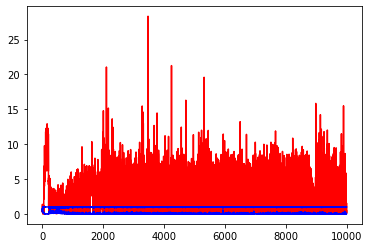

white ratio : 48.0
min : 184
max : 218


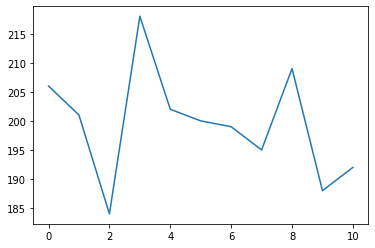

Generating interpolations...
10001 [D loss: 0.039900, acc.: 96.88%] [G loss: 0.991229, 0.798342]
10002 [D loss: 0.000999, acc.: 100.00%] [G loss: 4.022402, 0.927623]
10003 [D loss: 0.002799, acc.: 100.00%] [G loss: 3.039603, 0.000906]
10004 [D loss: 0.012218, acc.: 100.00%] [G loss: 2.364771, 0.016327]
10005 [D loss: 0.000345, acc.: 100.00%] [G loss: 0.205860, 0.025382]
10006 [D loss: 0.000781, acc.: 100.00%] [G loss: 33.680099, 10.100422]
10007 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.148149, 8.757435]
10008 [D loss: 0.132085, acc.: 96.88%] [G loss: 7.919042, 7.555134]
10009 [D loss: 0.157997, acc.: 96.88%] [G loss: 3.099800, 0.556775]
10010 [D loss: 0.001398, acc.: 100.00%] [G loss: 4.151527, 2.763891]
10011 [D loss: 0.006350, acc.: 100.00%] [G loss: 7.274347, 6.426726]
10012 [D loss: 0.103896, acc.: 96.88%] [G loss: 0.417036, 0.128608]
10013 [D loss: 0.006055, acc.: 100.00%] [G loss: 2.565510, 2.372009]
10014 [D loss: 0.004698, acc.: 100.00%] [G loss: 0.656346, 0.273577]
10015 

10119 [D loss: 0.075622, acc.: 96.88%] [G loss: 1.781762, 0.593495]
10120 [D loss: 0.006608, acc.: 100.00%] [G loss: 5.190196, 3.595595]
10121 [D loss: 0.005506, acc.: 100.00%] [G loss: 0.079742, 0.077231]
10122 [D loss: 0.008123, acc.: 100.00%] [G loss: 2.500796, 1.417426]
10123 [D loss: 0.050489, acc.: 96.88%] [G loss: 10.403876, 5.716585]
10124 [D loss: 0.013141, acc.: 100.00%] [G loss: 12.900378, 8.094662]
10125 [D loss: 0.025826, acc.: 100.00%] [G loss: 0.134126, 0.217223]
10126 [D loss: 0.002378, acc.: 100.00%] [G loss: 4.048757, 3.113751]
10127 [D loss: 0.001692, acc.: 100.00%] [G loss: 4.981405, 2.712224]
10128 [D loss: 0.004740, acc.: 100.00%] [G loss: 4.278847, 5.594059]
10129 [D loss: 0.010404, acc.: 100.00%] [G loss: 4.243927, 4.301003]
10130 [D loss: 0.027120, acc.: 100.00%] [G loss: 15.623581, 3.993032]
10131 [D loss: 0.013922, acc.: 100.00%] [G loss: 4.043236, 2.375295]
10132 [D loss: 0.000378, acc.: 100.00%] [G loss: 9.024467, 2.129857]
10133 [D loss: 0.002683, acc.: 10

10240 [D loss: 0.000874, acc.: 100.00%] [G loss: 0.960372, 1.025747]
10241 [D loss: 0.033239, acc.: 96.88%] [G loss: 7.250741, 6.954105]
10242 [D loss: 0.032987, acc.: 100.00%] [G loss: 6.070708, 4.870131]
10243 [D loss: 0.013737, acc.: 100.00%] [G loss: 8.077343, 6.552410]
10244 [D loss: 0.021799, acc.: 100.00%] [G loss: 7.163854, 6.594129]
10245 [D loss: 0.006685, acc.: 100.00%] [G loss: 4.298403, 3.746532]
10246 [D loss: 0.032036, acc.: 96.88%] [G loss: 7.513262, 5.011369]
10247 [D loss: 0.000978, acc.: 100.00%] [G loss: 4.509542, 3.508235]
10248 [D loss: 0.001779, acc.: 100.00%] [G loss: 7.653705, 5.537619]
10249 [D loss: 0.012231, acc.: 100.00%] [G loss: 7.652735, 8.079494]
10250 [D loss: 0.001958, acc.: 100.00%] [G loss: 1.441967, 0.812255]
10251 [D loss: 0.000979, acc.: 100.00%] [G loss: 5.195783, 4.289277]
10252 [D loss: 0.036896, acc.: 96.88%] [G loss: 4.384225, 2.501438]
10253 [D loss: 0.031699, acc.: 96.88%] [G loss: 0.830350, 1.634703]
10254 [D loss: 0.001947, acc.: 100.00%

10362 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.210447, 0.182867]
10363 [D loss: 0.000841, acc.: 100.00%] [G loss: 0.000265, 0.000125]
10364 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.019151, 0.015723]
10365 [D loss: 0.015950, acc.: 100.00%] [G loss: 3.886091, 3.782753]
10366 [D loss: 0.023503, acc.: 96.88%] [G loss: 0.005729, 0.002566]
10367 [D loss: 0.001746, acc.: 100.00%] [G loss: 0.010756, 0.012465]
10368 [D loss: 0.000090, acc.: 100.00%] [G loss: 4.855100, 3.716812]
10369 [D loss: 0.107794, acc.: 96.88%] [G loss: 6.280032, 5.374162]
10370 [D loss: 0.000908, acc.: 100.00%] [G loss: 0.262871, 0.113970]
10371 [D loss: 0.004266, acc.: 100.00%] [G loss: 0.000001, 0.000000]
10372 [D loss: 0.001085, acc.: 100.00%] [G loss: 0.000181, 0.000092]
10373 [D loss: 0.000473, acc.: 100.00%] [G loss: 0.043978, 0.073531]
10374 [D loss: 0.009533, acc.: 100.00%] [G loss: 0.008892, 0.008737]
10375 [D loss: 0.004577, acc.: 100.00%] [G loss: 0.030679, 0.007412]
10376 [D loss: 0.000884, acc.: 100.0

10484 [D loss: 0.018255, acc.: 100.00%] [G loss: 5.145728, 4.410852]
10485 [D loss: 0.044461, acc.: 96.88%] [G loss: 5.934245, 5.336717]
10486 [D loss: 0.084303, acc.: 96.88%] [G loss: 15.779045, 1.941853]
10487 [D loss: 0.000725, acc.: 100.00%] [G loss: 2.293590, 1.127380]
10488 [D loss: 0.000350, acc.: 100.00%] [G loss: 5.517857, 4.811251]
10489 [D loss: 0.000685, acc.: 100.00%] [G loss: 7.811990, 7.625215]
10490 [D loss: 0.000542, acc.: 100.00%] [G loss: 4.435808, 2.864348]
10491 [D loss: 0.000232, acc.: 100.00%] [G loss: 5.915250, 4.738703]
10492 [D loss: 0.000744, acc.: 100.00%] [G loss: 2.368679, 0.570617]
10493 [D loss: 0.000695, acc.: 100.00%] [G loss: 5.455420, 4.537513]
10494 [D loss: 0.011851, acc.: 100.00%] [G loss: 5.738480, 4.499599]
10495 [D loss: 0.000154, acc.: 100.00%] [G loss: 6.118944, 5.446698]
10496 [D loss: 0.000170, acc.: 100.00%] [G loss: 3.012722, 1.204363]
10497 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.511538, 0.009073]
10498 [D loss: 0.002691, acc.: 100.

10604 [D loss: 0.000311, acc.: 100.00%] [G loss: 8.459183, 8.112123]
10605 [D loss: 0.002647, acc.: 100.00%] [G loss: 1.593029, 1.640139]
10606 [D loss: 0.002662, acc.: 100.00%] [G loss: 9.915041, 8.065436]
10607 [D loss: 0.005382, acc.: 100.00%] [G loss: 1.923979, 0.499067]
10608 [D loss: 0.000371, acc.: 100.00%] [G loss: 8.371471, 6.709331]
10609 [D loss: 0.004655, acc.: 100.00%] [G loss: 8.722869, 6.948200]
10610 [D loss: 0.000436, acc.: 100.00%] [G loss: 1.099807, 0.029515]
10611 [D loss: 0.000693, acc.: 100.00%] [G loss: 14.553019, 2.271943]
10612 [D loss: 0.000236, acc.: 100.00%] [G loss: 9.897302, 9.795315]
10613 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.788021, 7.121222]
10614 [D loss: 0.155926, acc.: 96.88%] [G loss: 0.216772, 0.330269]
10615 [D loss: 0.001244, acc.: 100.00%] [G loss: 0.006934, 0.025221]
10616 [D loss: 0.000154, acc.: 100.00%] [G loss: 3.634479, 2.372739]
10617 [D loss: 0.011319, acc.: 100.00%] [G loss: 0.003015, 0.001822]
10618 [D loss: 0.000682, acc.: 100

10726 [D loss: 0.000439, acc.: 100.00%] [G loss: 10.354279, 9.851700]
10727 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.025379, 0.042117]
10728 [D loss: 0.000132, acc.: 100.00%] [G loss: 7.763298, 6.212921]
10729 [D loss: 0.000431, acc.: 100.00%] [G loss: 0.167855, 0.093471]
10730 [D loss: 0.000092, acc.: 100.00%] [G loss: 4.838655, 7.678494]
10731 [D loss: 0.000010, acc.: 100.00%] [G loss: 10.164224, 9.128335]
10732 [D loss: 0.000060, acc.: 100.00%] [G loss: 9.189650, 6.453029]
10733 [D loss: 0.000043, acc.: 100.00%] [G loss: 11.763272, 11.248706]
10734 [D loss: 0.000158, acc.: 100.00%] [G loss: 7.606822, 7.271880]
10735 [D loss: 0.000730, acc.: 100.00%] [G loss: 7.743487, 6.816793]
10736 [D loss: 0.000370, acc.: 100.00%] [G loss: 9.899300, 9.292370]
10737 [D loss: 0.000059, acc.: 100.00%] [G loss: 4.066543, 2.219841]
10738 [D loss: 0.097254, acc.: 96.88%] [G loss: 5.240342, 4.610478]
10739 [D loss: 0.000438, acc.: 100.00%] [G loss: 2.063607, 0.526105]
10740 [D loss: 0.000284, acc.: 

10848 [D loss: 0.000193, acc.: 100.00%] [G loss: 16.867233, 10.200907]
10849 [D loss: 0.000103, acc.: 100.00%] [G loss: 11.593200, 11.603716]
10850 [D loss: 0.000212, acc.: 100.00%] [G loss: 18.804892, 12.452543]
10851 [D loss: 0.002697, acc.: 100.00%] [G loss: 2.755303, 4.003991]
10852 [D loss: 0.002809, acc.: 100.00%] [G loss: 8.895138, 7.804402]
10853 [D loss: 0.000893, acc.: 100.00%] [G loss: 0.045306, 0.045931]
10854 [D loss: 0.004256, acc.: 100.00%] [G loss: 4.006293, 1.778459]
10855 [D loss: 0.034999, acc.: 96.88%] [G loss: 0.861518, 1.040490]
10856 [D loss: 0.000813, acc.: 100.00%] [G loss: 0.962672, 0.752072]
10857 [D loss: 0.000590, acc.: 100.00%] [G loss: 4.175341, 0.311865]
10858 [D loss: 0.000470, acc.: 100.00%] [G loss: 8.343805, 7.378362]
10859 [D loss: 0.000929, acc.: 100.00%] [G loss: 2.911779, 3.893970]
10860 [D loss: 0.001564, acc.: 100.00%] [G loss: 1.627805, 0.948975]
10861 [D loss: 0.001117, acc.: 100.00%] [G loss: 6.976992, 6.127851]
10862 [D loss: 0.000188, acc.

10969 [D loss: 0.000809, acc.: 100.00%] [G loss: 7.917746, 6.864204]
10970 [D loss: 0.000063, acc.: 100.00%] [G loss: 9.957180, 10.386946]
10971 [D loss: 0.000738, acc.: 100.00%] [G loss: 1.872394, 0.376002]
10972 [D loss: 0.001500, acc.: 100.00%] [G loss: 0.509067, 0.051103]
10973 [D loss: 0.000549, acc.: 100.00%] [G loss: 5.568819, 4.123225]
10974 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.585082, 0.388916]
10975 [D loss: 0.000095, acc.: 100.00%] [G loss: 3.426456, 2.553953]
10976 [D loss: 0.000349, acc.: 100.00%] [G loss: 1.735407, 0.373648]
10977 [D loss: 0.000487, acc.: 100.00%] [G loss: 5.521418, 1.455345]
10978 [D loss: 0.000986, acc.: 100.00%] [G loss: 3.560046, 2.492376]
10979 [D loss: 0.002139, acc.: 100.00%] [G loss: 3.535916, 1.449830]
10980 [D loss: 0.000138, acc.: 100.00%] [G loss: 3.978372, 2.587502]
10981 [D loss: 0.000069, acc.: 100.00%] [G loss: 4.004645, 3.162476]
10982 [D loss: 0.000506, acc.: 100.00%] [G loss: 1.195965, 1.019330]
10983 [D loss: 0.000217, acc.: 10

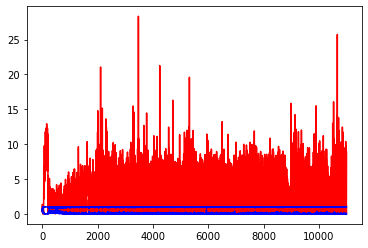

white ratio : 51.25
min : 184
max : 218


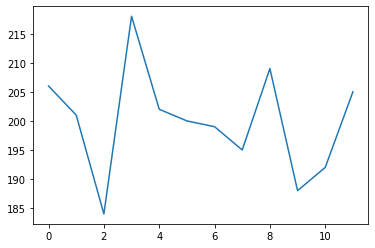

Generating interpolations...
11001 [D loss: 0.000073, acc.: 100.00%] [G loss: 9.974302, 0.717480]
11002 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.606449, 0.680183]
11003 [D loss: 0.000214, acc.: 100.00%] [G loss: 8.868192, 8.626159]
11004 [D loss: 0.001104, acc.: 100.00%] [G loss: 6.634585, 4.928385]
11005 [D loss: 0.000628, acc.: 100.00%] [G loss: 6.176913, 3.854888]
11006 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.948714, 1.541267]
11007 [D loss: 0.002748, acc.: 100.00%] [G loss: 5.399424, 0.891149]
11008 [D loss: 0.000183, acc.: 100.00%] [G loss: 6.262746, 5.414895]
11009 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.935274, 0.786864]
11010 [D loss: 0.000291, acc.: 100.00%] [G loss: 2.973914, 2.362986]
11011 [D loss: 0.000310, acc.: 100.00%] [G loss: 3.258966, 2.844336]
11012 [D loss: 0.005696, acc.: 100.00%] [G loss: 0.175996, 0.086383]
11013 [D loss: 0.000798, acc.: 100.00%] [G loss: 1.087368, 1.469697]
11014 [D loss: 0.002157, acc.: 100.00%] [G loss: 5.151223, 3.458847]
11015

11120 [D loss: 0.000341, acc.: 100.00%] [G loss: 3.245357, 1.067666]
11121 [D loss: 0.001970, acc.: 100.00%] [G loss: 5.147037, 3.368876]
11122 [D loss: 0.000730, acc.: 100.00%] [G loss: 8.477121, 4.483145]
11123 [D loss: 0.003215, acc.: 100.00%] [G loss: 3.150888, 1.375933]
11124 [D loss: 0.000512, acc.: 100.00%] [G loss: 9.813406, 3.216385]
11125 [D loss: 0.001214, acc.: 100.00%] [G loss: 21.489725, 8.731688]
11126 [D loss: 0.081619, acc.: 96.88%] [G loss: 1.101440, 1.011356]
11127 [D loss: 0.004547, acc.: 100.00%] [G loss: 0.007047, 0.002100]
11128 [D loss: 0.021163, acc.: 100.00%] [G loss: 4.516091, 3.245336]
11129 [D loss: 0.002762, acc.: 100.00%] [G loss: 7.067001, 7.292369]
11130 [D loss: 0.004332, acc.: 100.00%] [G loss: 1.326832, 0.084975]
11131 [D loss: 0.000399, acc.: 100.00%] [G loss: 7.409951, 5.587627]
11132 [D loss: 0.000261, acc.: 100.00%] [G loss: 5.690430, 3.603986]
11133 [D loss: 0.001232, acc.: 100.00%] [G loss: 8.252062, 5.395844]
11134 [D loss: 0.000127, acc.: 100

11241 [D loss: 0.001935, acc.: 100.00%] [G loss: 0.102480, 0.087563]
11242 [D loss: 0.001716, acc.: 100.00%] [G loss: 4.465298, 3.541133]
11243 [D loss: 0.004491, acc.: 100.00%] [G loss: 4.664619, 3.599210]
11244 [D loss: 0.012729, acc.: 100.00%] [G loss: 1.248292, 0.177449]
11245 [D loss: 0.000855, acc.: 100.00%] [G loss: 12.474036, 11.919468]
11246 [D loss: 0.240344, acc.: 96.88%] [G loss: 3.310000, 1.791856]
11247 [D loss: 0.003648, acc.: 100.00%] [G loss: 6.132323, 1.159112]
11248 [D loss: 0.010867, acc.: 100.00%] [G loss: 3.356970, 2.354284]
11249 [D loss: 0.010030, acc.: 100.00%] [G loss: 0.095641, 0.087426]
11250 [D loss: 0.002374, acc.: 100.00%] [G loss: 7.351576, 4.097990]
11251 [D loss: 0.000165, acc.: 100.00%] [G loss: 3.683600, 2.965505]
11252 [D loss: 0.000235, acc.: 100.00%] [G loss: 3.125345, 0.341177]
11253 [D loss: 0.014217, acc.: 100.00%] [G loss: 1.069011, 0.479251]
11254 [D loss: 0.224908, acc.: 96.88%] [G loss: 5.986334, 6.460899]
11255 [D loss: 0.010039, acc.: 100

11361 [D loss: 0.018743, acc.: 100.00%] [G loss: 4.140789, 3.160287]
11362 [D loss: 0.032985, acc.: 96.88%] [G loss: 0.000237, 0.000123]
11363 [D loss: 0.044606, acc.: 96.88%] [G loss: 5.038917, 3.087299]
11364 [D loss: 0.002109, acc.: 100.00%] [G loss: 0.107444, 0.065744]
11365 [D loss: 0.019621, acc.: 100.00%] [G loss: 1.346276, 0.174328]
11366 [D loss: 0.001788, acc.: 100.00%] [G loss: 10.335718, 7.039536]
11367 [D loss: 0.020557, acc.: 100.00%] [G loss: 5.949351, 5.640736]
11368 [D loss: 0.000718, acc.: 100.00%] [G loss: 7.641877, 6.453955]
11369 [D loss: 0.003917, acc.: 100.00%] [G loss: 4.876824, 4.292233]
11370 [D loss: 0.000777, acc.: 100.00%] [G loss: 1.690523, 1.302204]
11371 [D loss: 0.002856, acc.: 100.00%] [G loss: 2.969455, 1.829499]
11372 [D loss: 0.003558, acc.: 100.00%] [G loss: 0.505472, 0.293419]
11373 [D loss: 0.007556, acc.: 100.00%] [G loss: 21.291805, 8.436897]
11374 [D loss: 0.001490, acc.: 100.00%] [G loss: 9.705711, 9.931260]
11375 [D loss: 0.000493, acc.: 100

11482 [D loss: 0.000682, acc.: 100.00%] [G loss: 1.301017, 0.891180]
11483 [D loss: 0.001749, acc.: 100.00%] [G loss: 7.034918, 5.213325]
11484 [D loss: 0.004876, acc.: 100.00%] [G loss: 1.381298, 0.887053]
11485 [D loss: 0.000185, acc.: 100.00%] [G loss: 3.454930, 1.912004]
11486 [D loss: 0.004544, acc.: 100.00%] [G loss: 2.114766, 0.379841]
11487 [D loss: 0.005180, acc.: 100.00%] [G loss: 0.019689, 0.029381]
11488 [D loss: 0.001032, acc.: 100.00%] [G loss: 1.815964, 0.244340]
11489 [D loss: 0.004602, acc.: 100.00%] [G loss: 7.296513, 5.273286]
11490 [D loss: 0.001202, acc.: 100.00%] [G loss: 1.026276, 1.142292]
11491 [D loss: 0.000245, acc.: 100.00%] [G loss: 2.105423, 1.430330]
11492 [D loss: 0.000274, acc.: 100.00%] [G loss: 1.980848, 0.969222]
11493 [D loss: 0.028143, acc.: 100.00%] [G loss: 3.903503, 1.912155]
11494 [D loss: 0.020084, acc.: 100.00%] [G loss: 5.293711, 4.391420]
11495 [D loss: 0.027650, acc.: 96.88%] [G loss: 7.173553, 0.416182]
11496 [D loss: 0.000835, acc.: 100.

11602 [D loss: 0.000103, acc.: 100.00%] [G loss: 5.307785, 4.279624]
11603 [D loss: 0.000829, acc.: 100.00%] [G loss: 0.302040, 0.045891]
11604 [D loss: 0.020278, acc.: 100.00%] [G loss: 25.272606, 3.152388]
11605 [D loss: 0.000781, acc.: 100.00%] [G loss: 6.979054, 6.689335]
11606 [D loss: 0.005019, acc.: 100.00%] [G loss: 4.821805, 6.792700]
11607 [D loss: 0.143964, acc.: 93.75%] [G loss: 4.423646, 3.521692]
11608 [D loss: 0.001847, acc.: 100.00%] [G loss: 0.457938, 0.590662]
11609 [D loss: 0.004962, acc.: 100.00%] [G loss: 0.012062, 0.001953]
11610 [D loss: 0.001667, acc.: 100.00%] [G loss: 0.168645, 0.105029]
11611 [D loss: 0.002146, acc.: 100.00%] [G loss: 0.103547, 0.102872]
11612 [D loss: 0.001011, acc.: 100.00%] [G loss: 0.007427, 0.029254]
11613 [D loss: 0.002050, acc.: 100.00%] [G loss: 4.167484, 2.848006]
11614 [D loss: 0.001372, acc.: 100.00%] [G loss: 0.061280, 0.026927]
11615 [D loss: 0.000721, acc.: 100.00%] [G loss: 1.374771, 0.772798]
11616 [D loss: 0.005369, acc.: 100

11722 [D loss: 0.255197, acc.: 96.88%] [G loss: 0.152405, 0.034163]
11723 [D loss: 0.012692, acc.: 100.00%] [G loss: 0.003620, 0.004045]
11724 [D loss: 0.012427, acc.: 100.00%] [G loss: 7.867908, 7.106848]
11725 [D loss: 0.019770, acc.: 100.00%] [G loss: 1.312621, 1.166310]
11726 [D loss: 0.001296, acc.: 100.00%] [G loss: 0.038320, 0.050714]
11727 [D loss: 0.003526, acc.: 100.00%] [G loss: 1.166207, 1.233394]
11728 [D loss: 0.049681, acc.: 96.88%] [G loss: 0.169226, 0.026832]
11729 [D loss: 0.003860, acc.: 100.00%] [G loss: 9.745134, 7.790316]
11730 [D loss: 0.003867, acc.: 100.00%] [G loss: 4.656602, 3.865443]
11731 [D loss: 0.001667, acc.: 100.00%] [G loss: 0.011742, 0.040226]
11732 [D loss: 0.003223, acc.: 100.00%] [G loss: 0.748502, 0.192831]
11733 [D loss: 0.011777, acc.: 100.00%] [G loss: 5.844652, 5.341205]
11734 [D loss: 0.005720, acc.: 100.00%] [G loss: 0.000066, 0.000020]
11735 [D loss: 0.002886, acc.: 100.00%] [G loss: 1.067044, 0.655277]
11736 [D loss: 0.020320, acc.: 100.0

11843 [D loss: 0.000281, acc.: 100.00%] [G loss: 1.248205, 0.858480]
11844 [D loss: 0.064269, acc.: 96.88%] [G loss: 3.377550, 2.211299]
11845 [D loss: 0.000932, acc.: 100.00%] [G loss: 1.610478, 0.290073]
11846 [D loss: 0.000778, acc.: 100.00%] [G loss: 0.194012, 0.184106]
11847 [D loss: 0.002107, acc.: 100.00%] [G loss: 1.064314, 0.422831]
11848 [D loss: 0.004639, acc.: 100.00%] [G loss: 1.022955, 0.366895]
11849 [D loss: 0.000596, acc.: 100.00%] [G loss: 9.057096, 1.367056]
11850 [D loss: 0.003204, acc.: 100.00%] [G loss: 12.254191, 8.958139]
11851 [D loss: 0.000385, acc.: 100.00%] [G loss: 0.448205, 0.005429]
11852 [D loss: 0.001781, acc.: 100.00%] [G loss: 0.006038, 0.001632]
11853 [D loss: 0.002256, acc.: 100.00%] [G loss: 7.538561, 7.233231]
11854 [D loss: 0.002404, acc.: 100.00%] [G loss: 1.046254, 0.351966]
11855 [D loss: 0.001444, acc.: 100.00%] [G loss: 0.570327, 0.302318]
11856 [D loss: 0.017631, acc.: 100.00%] [G loss: 0.000004, 0.000003]
11857 [D loss: 0.000671, acc.: 100

11963 [D loss: 0.001006, acc.: 100.00%] [G loss: 2.997110, 2.064096]
11964 [D loss: 0.001763, acc.: 100.00%] [G loss: 2.462208, 1.061545]
11965 [D loss: 0.001099, acc.: 100.00%] [G loss: 0.174877, 0.099750]
11966 [D loss: 0.001445, acc.: 100.00%] [G loss: 3.352267, 2.110008]
11967 [D loss: 0.011289, acc.: 100.00%] [G loss: 2.307040, 3.058371]
11968 [D loss: 0.003859, acc.: 100.00%] [G loss: 9.962387, 7.227636]
11969 [D loss: 0.000383, acc.: 100.00%] [G loss: 0.082327, 0.305890]
11970 [D loss: 0.007879, acc.: 100.00%] [G loss: 0.000001, 0.000003]
11971 [D loss: 0.020344, acc.: 100.00%] [G loss: 2.395028, 1.301845]
11972 [D loss: 0.002219, acc.: 100.00%] [G loss: 0.038263, 0.028502]
11973 [D loss: 0.007507, acc.: 100.00%] [G loss: 5.866464, 1.864974]
11974 [D loss: 0.001548, acc.: 100.00%] [G loss: 0.226881, 0.095174]
11975 [D loss: 0.002630, acc.: 100.00%] [G loss: 0.000053, 0.000025]
11976 [D loss: 0.001209, acc.: 100.00%] [G loss: 0.230111, 0.280282]
11977 [D loss: 0.121778, acc.: 96.

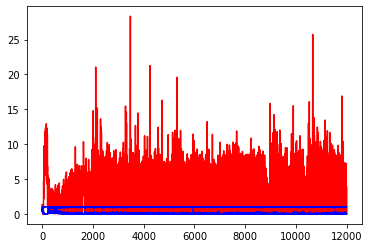

white ratio : 49.0
min : 184
max : 218


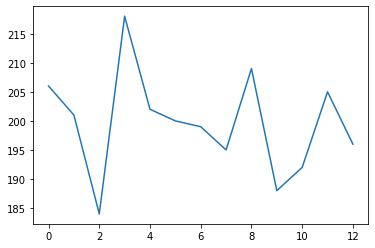

Generating interpolations...
12001 [D loss: 0.006248, acc.: 100.00%] [G loss: 5.005312, 4.345713]
12002 [D loss: 0.010938, acc.: 100.00%] [G loss: 0.000080, 0.000065]
12003 [D loss: 0.002801, acc.: 100.00%] [G loss: 6.151181, 5.756806]
12004 [D loss: 0.089066, acc.: 96.88%] [G loss: 18.530258, 4.184690]
12005 [D loss: 0.000234, acc.: 100.00%] [G loss: 4.913563, 3.546343]
12006 [D loss: 0.000108, acc.: 100.00%] [G loss: 3.423079, 2.829166]
12007 [D loss: 0.000456, acc.: 100.00%] [G loss: 1.479379, 0.769322]
12008 [D loss: 0.000700, acc.: 100.00%] [G loss: 7.288550, 6.312634]
12009 [D loss: 0.001016, acc.: 100.00%] [G loss: 1.581774, 1.259366]
12010 [D loss: 0.000423, acc.: 100.00%] [G loss: 4.463320, 3.557503]
12011 [D loss: 0.002717, acc.: 100.00%] [G loss: 2.602652, 2.125233]
12012 [D loss: 0.001673, acc.: 100.00%] [G loss: 2.732262, 1.773454]
12013 [D loss: 0.002334, acc.: 100.00%] [G loss: 0.790183, 0.361299]
12014 [D loss: 0.007353, acc.: 100.00%] [G loss: 0.000797, 0.002085]
12015

12122 [D loss: 0.027587, acc.: 96.88%] [G loss: 0.026499, 0.004875]
12123 [D loss: 0.002627, acc.: 100.00%] [G loss: 4.549579, 3.154244]
12124 [D loss: 0.000493, acc.: 100.00%] [G loss: 1.356074, 0.653638]
12125 [D loss: 0.048446, acc.: 96.88%] [G loss: 1.716359, 0.890235]
12126 [D loss: 0.001526, acc.: 100.00%] [G loss: 0.000105, 0.000013]
12127 [D loss: 0.192509, acc.: 93.75%] [G loss: 0.000298, 0.000628]
12128 [D loss: 0.008975, acc.: 100.00%] [G loss: 0.000082, 0.000031]
12129 [D loss: 0.054905, acc.: 100.00%] [G loss: 0.000691, 0.000188]
12130 [D loss: 0.100720, acc.: 96.88%] [G loss: 0.030706, 0.011263]
12131 [D loss: 0.036860, acc.: 96.88%] [G loss: 0.000079, 0.000166]
12132 [D loss: 0.006624, acc.: 100.00%] [G loss: 0.000001, 0.000001]
12133 [D loss: 0.002963, acc.: 100.00%] [G loss: 0.011008, 0.004342]
12134 [D loss: 0.003771, acc.: 100.00%] [G loss: 0.045113, 0.004855]
12135 [D loss: 0.007724, acc.: 100.00%] [G loss: 0.053589, 0.020200]
12136 [D loss: 0.004404, acc.: 100.00%]

12242 [D loss: 0.001921, acc.: 100.00%] [G loss: 0.919638, 0.323748]
12243 [D loss: 0.000846, acc.: 100.00%] [G loss: 0.011407, 0.002733]
12244 [D loss: 0.017330, acc.: 100.00%] [G loss: 3.707700, 1.851669]
12245 [D loss: 0.012056, acc.: 100.00%] [G loss: 8.859002, 8.263399]
12246 [D loss: 0.001038, acc.: 100.00%] [G loss: 0.009428, 0.006189]
12247 [D loss: 0.148540, acc.: 96.88%] [G loss: 0.022768, 0.011913]
12248 [D loss: 0.007265, acc.: 100.00%] [G loss: 0.000859, 0.000509]
12249 [D loss: 0.004985, acc.: 100.00%] [G loss: 3.561811, 0.345961]
12250 [D loss: 0.001211, acc.: 100.00%] [G loss: 4.983234, 0.265387]
12251 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.783861, 1.055036]
12252 [D loss: 0.000270, acc.: 100.00%] [G loss: 4.412228, 4.280019]
12253 [D loss: 0.000678, acc.: 100.00%] [G loss: 0.000471, 0.000787]
12254 [D loss: 0.000681, acc.: 100.00%] [G loss: 0.733606, 0.620295]
12255 [D loss: 0.009267, acc.: 100.00%] [G loss: 2.458218, 1.041346]
12256 [D loss: 0.000628, acc.: 100.

12363 [D loss: 0.000646, acc.: 100.00%] [G loss: 0.666448, 0.657153]
12364 [D loss: 0.000488, acc.: 100.00%] [G loss: 3.257964, 2.071039]
12365 [D loss: 0.001175, acc.: 100.00%] [G loss: 2.195131, 3.534782]
12366 [D loss: 0.000447, acc.: 100.00%] [G loss: 0.868037, 0.753928]
12367 [D loss: 0.000730, acc.: 100.00%] [G loss: 1.545292, 1.317536]
12368 [D loss: 0.007694, acc.: 100.00%] [G loss: 5.240163, 1.124319]
12369 [D loss: 0.000136, acc.: 100.00%] [G loss: 2.238132, 0.566310]
12370 [D loss: 0.000409, acc.: 100.00%] [G loss: 1.448525, 0.627609]
12371 [D loss: 0.000834, acc.: 100.00%] [G loss: 0.077055, 0.021188]
12372 [D loss: 0.000565, acc.: 100.00%] [G loss: 0.010986, 0.002473]
12373 [D loss: 0.001983, acc.: 100.00%] [G loss: 0.006808, 0.002091]
12374 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.101376, 0.217733]
12375 [D loss: 0.187546, acc.: 96.88%] [G loss: 0.228960, 0.088531]
12376 [D loss: 0.001935, acc.: 100.00%] [G loss: 0.054887, 0.075500]
12377 [D loss: 0.007279, acc.: 100.

12484 [D loss: 0.000875, acc.: 100.00%] [G loss: 7.061348, 6.161473]
12485 [D loss: 0.000194, acc.: 100.00%] [G loss: 1.420824, 0.096014]
12486 [D loss: 0.005522, acc.: 100.00%] [G loss: 0.292658, 0.023934]
12487 [D loss: 0.000423, acc.: 100.00%] [G loss: 0.034216, 0.055372]
12488 [D loss: 0.002476, acc.: 100.00%] [G loss: 3.429276, 2.593095]
12489 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.529740, 0.080417]
12490 [D loss: 0.000056, acc.: 100.00%] [G loss: 3.181036, 0.005326]
12491 [D loss: 0.001063, acc.: 100.00%] [G loss: 4.506927, 3.414204]
12492 [D loss: 0.000356, acc.: 100.00%] [G loss: 5.905583, 4.634786]
12493 [D loss: 0.008033, acc.: 100.00%] [G loss: 6.711576, 5.559909]
12494 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.108607, 0.072290]
12495 [D loss: 0.000351, acc.: 100.00%] [G loss: 1.086996, 1.336675]
12496 [D loss: 0.000294, acc.: 100.00%] [G loss: 1.190971, 0.601133]
12497 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.847181, 0.542687]
12498 [D loss: 0.000633, acc.: 100

12606 [D loss: 0.012483, acc.: 100.00%] [G loss: 0.000541, 0.001693]
12607 [D loss: 0.016578, acc.: 100.00%] [G loss: 0.193032, 0.053347]
12608 [D loss: 0.051637, acc.: 96.88%] [G loss: 8.353770, 5.280043]
12609 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.523971, 0.646709]
12610 [D loss: 0.000083, acc.: 100.00%] [G loss: 6.204533, 5.651385]
12611 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.386883, 3.001342]
12612 [D loss: 0.000068, acc.: 100.00%] [G loss: 6.119468, 4.575020]
12613 [D loss: 0.000034, acc.: 100.00%] [G loss: 2.976010, 0.212980]
12614 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.021002, 0.038323]
12615 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.983612, 0.352445]
12616 [D loss: 0.000034, acc.: 100.00%] [G loss: 3.789907, 2.123270]
12617 [D loss: 0.023514, acc.: 96.88%] [G loss: 0.017315, 0.025836]
12618 [D loss: 0.001138, acc.: 100.00%] [G loss: 0.137940, 0.095807]
12619 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.954009, 0.019777]
12620 [D loss: 0.000060, acc.: 100.0

12725 [D loss: 0.000146, acc.: 100.00%] [G loss: 4.180695, 1.911397]
12726 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.195358, 0.183456]
12727 [D loss: 0.002395, acc.: 100.00%] [G loss: 2.750589, 2.880336]
12728 [D loss: 0.000038, acc.: 100.00%] [G loss: 1.017807, 0.854279]
12729 [D loss: 0.018335, acc.: 100.00%] [G loss: 1.262777, 1.463250]
12730 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.655237, 1.580124]
12731 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.621303, 0.943427]
12732 [D loss: 0.003618, acc.: 100.00%] [G loss: 18.686256, 0.273767]
12733 [D loss: 0.000738, acc.: 100.00%] [G loss: 2.152780, 1.552226]
12734 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.283332, 0.224411]
12735 [D loss: 0.000046, acc.: 100.00%] [G loss: 6.004640, 4.568017]
12736 [D loss: 0.000062, acc.: 100.00%] [G loss: 1.595408, 1.545436]
12737 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.877854, 1.475710]
12738 [D loss: 0.000036, acc.: 100.00%] [G loss: 4.699211, 3.085743]
12739 [D loss: 0.000339, acc.: 10

12844 [D loss: 0.000108, acc.: 100.00%] [G loss: 2.882488, 1.758613]
12845 [D loss: 0.001692, acc.: 100.00%] [G loss: 7.443984, 6.168028]
12846 [D loss: 0.000750, acc.: 100.00%] [G loss: 4.258080, 4.253038]
12847 [D loss: 0.189254, acc.: 96.88%] [G loss: 1.002197, 0.505013]
12848 [D loss: 0.000266, acc.: 100.00%] [G loss: 5.436153, 4.395492]
12849 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.206807, 0.044519]
12850 [D loss: 0.060192, acc.: 96.88%] [G loss: 4.703311, 3.826052]
12851 [D loss: 0.000219, acc.: 100.00%] [G loss: 2.888438, 7.319849]
12852 [D loss: 0.000022, acc.: 100.00%] [G loss: 12.242697, 12.440969]
12853 [D loss: 0.000095, acc.: 100.00%] [G loss: 9.855266, 8.598537]
12854 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.779226, 8.011222]
12855 [D loss: 0.000073, acc.: 100.00%] [G loss: 9.490557, 9.174129]
12856 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.527223, 6.168235]
12857 [D loss: 0.000018, acc.: 100.00%] [G loss: 8.629986, 7.678998]
12858 [D loss: 0.000378, acc.: 100

12963 [D loss: 0.000039, acc.: 100.00%] [G loss: 7.243335, 6.332569]
12964 [D loss: 0.002866, acc.: 100.00%] [G loss: 10.800117, 10.620577]
12965 [D loss: 0.000027, acc.: 100.00%] [G loss: 10.867301, 10.376448]
12966 [D loss: 0.000315, acc.: 100.00%] [G loss: 11.434500, 11.253733]
12967 [D loss: 0.000069, acc.: 100.00%] [G loss: 11.752310, 11.229919]
12968 [D loss: 0.000200, acc.: 100.00%] [G loss: 12.139157, 11.059198]
12969 [D loss: 0.000244, acc.: 100.00%] [G loss: 8.495928, 7.469654]
12970 [D loss: 0.000102, acc.: 100.00%] [G loss: 3.831103, 2.912879]
12971 [D loss: 0.000575, acc.: 100.00%] [G loss: 9.072348, 9.016919]
12972 [D loss: 0.000215, acc.: 100.00%] [G loss: 9.986875, 7.489090]
12973 [D loss: 0.000425, acc.: 100.00%] [G loss: 20.488708, 15.146000]
12974 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.651692, 8.761629]
12975 [D loss: 0.199161, acc.: 96.88%] [G loss: 1.764436, 0.940139]
12976 [D loss: 0.000159, acc.: 100.00%] [G loss: 7.353694, 5.829542]
12977 [D loss: 0.000012

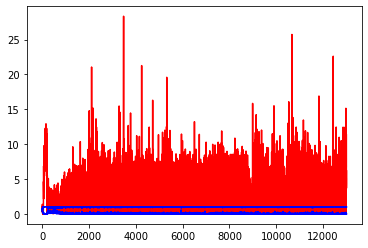

white ratio : 54.25
min : 184
max : 218


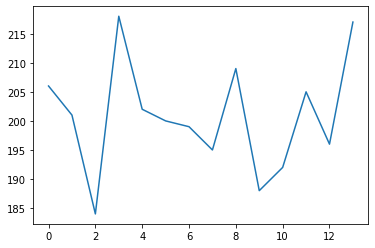

Generating interpolations...
13001 [D loss: 0.000096, acc.: 100.00%] [G loss: 10.520573, 8.551414]
13002 [D loss: 0.001219, acc.: 100.00%] [G loss: 9.447117, 7.378491]
13003 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.112808, 0.077461]
13004 [D loss: 0.184880, acc.: 96.88%] [G loss: 0.394766, 0.008404]
13005 [D loss: 0.090814, acc.: 96.88%] [G loss: 9.213384, 7.695223]
13006 [D loss: 0.000032, acc.: 100.00%] [G loss: 10.424282, 10.560085]
13007 [D loss: 0.000095, acc.: 100.00%] [G loss: 12.123944, 8.215485]
13008 [D loss: 0.000021, acc.: 100.00%] [G loss: 9.116817, 8.886764]
13009 [D loss: 0.000020, acc.: 100.00%] [G loss: 10.012620, 3.946070]
13010 [D loss: 0.000180, acc.: 100.00%] [G loss: 6.261174, 5.306253]
13011 [D loss: 0.004259, acc.: 100.00%] [G loss: 9.096739, 7.987442]
13012 [D loss: 0.000292, acc.: 100.00%] [G loss: 10.385808, 9.253410]
13013 [D loss: 0.000346, acc.: 100.00%] [G loss: 7.169412, 6.712756]
13014 [D loss: 0.000083, acc.: 100.00%] [G loss: 5.459038, 4.564372]
1

13122 [D loss: 0.001072, acc.: 100.00%] [G loss: 7.077238, 6.331172]
13123 [D loss: 0.003270, acc.: 100.00%] [G loss: 3.474984, 2.276494]
13124 [D loss: 0.000805, acc.: 100.00%] [G loss: 3.954414, 1.160383]
13125 [D loss: 0.000363, acc.: 100.00%] [G loss: 4.273787, 2.372097]
13126 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.953993, 4.075222]
13127 [D loss: 0.001356, acc.: 100.00%] [G loss: 0.552297, 0.464665]
13128 [D loss: 0.044873, acc.: 96.88%] [G loss: 0.004900, 0.006810]
13129 [D loss: 0.039450, acc.: 96.88%] [G loss: 2.270584, 1.171604]
13130 [D loss: 0.000248, acc.: 100.00%] [G loss: 10.499558, 8.501530]
13131 [D loss: 0.000919, acc.: 100.00%] [G loss: 10.656887, 7.156149]
13132 [D loss: 0.000769, acc.: 100.00%] [G loss: 2.717309, 1.823627]
13133 [D loss: 0.000045, acc.: 100.00%] [G loss: 3.509043, 2.776537]
13134 [D loss: 0.000670, acc.: 100.00%] [G loss: 9.518000, 8.799570]
13135 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.642937, 0.133354]
13136 [D loss: 0.004276, acc.: 10

13242 [D loss: 0.001622, acc.: 100.00%] [G loss: 1.592762, 0.957292]
13243 [D loss: 0.005676, acc.: 100.00%] [G loss: 5.922012, 3.045885]
13244 [D loss: 0.009111, acc.: 100.00%] [G loss: 5.682444, 5.545946]
13245 [D loss: 0.001074, acc.: 100.00%] [G loss: 10.013591, 10.495132]
13246 [D loss: 0.001405, acc.: 100.00%] [G loss: 6.275167, 5.544371]
13247 [D loss: 0.002436, acc.: 100.00%] [G loss: 0.342702, 0.139938]
13248 [D loss: 0.000802, acc.: 100.00%] [G loss: 0.108450, 0.043268]
13249 [D loss: 0.007542, acc.: 100.00%] [G loss: 2.520721, 1.282977]
13250 [D loss: 0.004006, acc.: 100.00%] [G loss: 3.411428, 2.752187]
13251 [D loss: 0.000671, acc.: 100.00%] [G loss: 0.337418, 0.266744]
13252 [D loss: 0.000745, acc.: 100.00%] [G loss: 8.946671, 8.721872]
13253 [D loss: 0.000918, acc.: 100.00%] [G loss: 1.064054, 0.463959]
13254 [D loss: 0.042953, acc.: 96.88%] [G loss: 5.048318, 2.496997]
13255 [D loss: 0.024921, acc.: 96.88%] [G loss: 4.812727, 3.954967]
13256 [D loss: 0.003709, acc.: 100

13362 [D loss: 0.000251, acc.: 100.00%] [G loss: 9.883846, 3.976269]
13363 [D loss: 0.000843, acc.: 100.00%] [G loss: 3.943244, 3.031174]
13364 [D loss: 0.000739, acc.: 100.00%] [G loss: 0.682515, 0.128456]
13365 [D loss: 0.002930, acc.: 100.00%] [G loss: 0.044610, 0.052806]
13366 [D loss: 0.014837, acc.: 100.00%] [G loss: 6.322468, 6.624700]
13367 [D loss: 0.007427, acc.: 100.00%] [G loss: 8.010292, 7.113240]
13368 [D loss: 0.138312, acc.: 96.88%] [G loss: 0.000044, 0.000080]
13369 [D loss: 0.012863, acc.: 100.00%] [G loss: 0.213762, 0.109223]
13370 [D loss: 0.002696, acc.: 100.00%] [G loss: 1.588221, 0.002346]
13371 [D loss: 0.011702, acc.: 100.00%] [G loss: 1.616630, 0.382646]
13372 [D loss: 0.000974, acc.: 100.00%] [G loss: 0.567114, 0.405693]
13373 [D loss: 0.001066, acc.: 100.00%] [G loss: 15.708916, 4.705052]
13374 [D loss: 0.000332, acc.: 100.00%] [G loss: 7.887938, 7.603674]
13375 [D loss: 0.001309, acc.: 100.00%] [G loss: 6.871367, 6.255279]
13376 [D loss: 0.000556, acc.: 100

13483 [D loss: 0.000092, acc.: 100.00%] [G loss: 1.093283, 0.001438]
13484 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.087410, 0.073003]
13485 [D loss: 0.002697, acc.: 100.00%] [G loss: 0.900558, 0.720039]
13486 [D loss: 0.001386, acc.: 100.00%] [G loss: 0.031216, 0.021921]
13487 [D loss: 0.006366, acc.: 100.00%] [G loss: 0.149449, 0.048447]
13488 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.144572, 0.073529]
13489 [D loss: 0.000496, acc.: 100.00%] [G loss: 5.546025, 5.045586]
13490 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.230310, 0.228451]
13491 [D loss: 0.000326, acc.: 100.00%] [G loss: 8.881065, 6.221778]
13492 [D loss: 0.000595, acc.: 100.00%] [G loss: 7.413815, 7.599127]
13493 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.469101, 0.268591]
13494 [D loss: 0.000529, acc.: 100.00%] [G loss: 0.466257, 0.538544]
13495 [D loss: 0.000444, acc.: 100.00%] [G loss: 1.217561, 0.723460]
13496 [D loss: 0.000350, acc.: 100.00%] [G loss: 0.047684, 0.058541]
13497 [D loss: 0.000069, acc.: 100

13603 [D loss: 0.002297, acc.: 100.00%] [G loss: 4.136655, 3.283986]
13604 [D loss: 0.063597, acc.: 96.88%] [G loss: 4.552454, 2.427692]
13605 [D loss: 0.018905, acc.: 100.00%] [G loss: 1.062939, 0.076497]
13606 [D loss: 0.013316, acc.: 100.00%] [G loss: 0.316674, 0.066611]
13607 [D loss: 0.002842, acc.: 100.00%] [G loss: 0.156743, 0.035091]
13608 [D loss: 0.001908, acc.: 100.00%] [G loss: 8.508362, 7.820041]
13609 [D loss: 0.002602, acc.: 100.00%] [G loss: 0.089699, 0.055754]
13610 [D loss: 0.001657, acc.: 100.00%] [G loss: 3.624789, 1.217594]
13611 [D loss: 0.001090, acc.: 100.00%] [G loss: 1.154962, 0.734376]
13612 [D loss: 0.073071, acc.: 96.88%] [G loss: 6.765826, 4.611970]
13613 [D loss: 0.000120, acc.: 100.00%] [G loss: 36.260635, 8.364288]
13614 [D loss: 0.001553, acc.: 100.00%] [G loss: 11.172086, 10.338713]
13615 [D loss: 0.001194, acc.: 100.00%] [G loss: 10.756280, 9.216312]
13616 [D loss: 0.000055, acc.: 100.00%] [G loss: 12.669968, 12.220845]
13617 [D loss: 0.022377, acc.:

13724 [D loss: 0.002569, acc.: 100.00%] [G loss: 2.096785, 1.262468]
13725 [D loss: 0.000182, acc.: 100.00%] [G loss: 3.692364, 3.455887]
13726 [D loss: 0.000781, acc.: 100.00%] [G loss: 3.692105, 2.581234]
13727 [D loss: 0.000170, acc.: 100.00%] [G loss: 7.697492, 4.781500]
13728 [D loss: 0.036064, acc.: 96.88%] [G loss: 1.137970, 0.211856]
13729 [D loss: 0.029119, acc.: 100.00%] [G loss: 0.000164, 0.000145]
13730 [D loss: 0.016685, acc.: 100.00%] [G loss: 0.832809, 0.561030]
13731 [D loss: 0.005440, acc.: 100.00%] [G loss: 5.920257, 4.534240]
13732 [D loss: 0.003433, acc.: 100.00%] [G loss: 6.509901, 6.280937]
13733 [D loss: 0.002162, acc.: 100.00%] [G loss: 2.001717, 1.133752]
13734 [D loss: 0.001316, acc.: 100.00%] [G loss: 5.438684, 1.028774]
13735 [D loss: 0.010806, acc.: 100.00%] [G loss: 5.253634, 3.797808]
13736 [D loss: 0.005142, acc.: 100.00%] [G loss: 4.743306, 4.035770]
13737 [D loss: 0.003759, acc.: 100.00%] [G loss: 0.872344, 0.008769]
13738 [D loss: 0.009677, acc.: 100.

13846 [D loss: 0.000336, acc.: 100.00%] [G loss: 3.511820, 1.637846]
13847 [D loss: 0.000751, acc.: 100.00%] [G loss: 0.856410, 0.481261]
13848 [D loss: 0.001260, acc.: 100.00%] [G loss: 0.048658, 0.015048]
13849 [D loss: 0.001888, acc.: 100.00%] [G loss: 2.987535, 2.452146]
13850 [D loss: 0.000312, acc.: 100.00%] [G loss: 7.286116, 6.594928]
13851 [D loss: 0.000299, acc.: 100.00%] [G loss: 0.000001, 0.000000]
13852 [D loss: 0.000671, acc.: 100.00%] [G loss: 8.620903, 5.534945]
13853 [D loss: 0.004609, acc.: 100.00%] [G loss: 0.154273, 0.003298]
13854 [D loss: 0.006514, acc.: 100.00%] [G loss: 10.065127, 4.105355]
13855 [D loss: 0.000354, acc.: 100.00%] [G loss: 5.484462, 5.766291]
13856 [D loss: 0.000436, acc.: 100.00%] [G loss: 10.067717, 7.483065]
13857 [D loss: 0.000222, acc.: 100.00%] [G loss: 8.747128, 7.458312]
13858 [D loss: 0.023403, acc.: 96.88%] [G loss: 6.704828, 6.485262]
13859 [D loss: 0.000583, acc.: 100.00%] [G loss: 2.698612, 1.150619]
13860 [D loss: 0.013762, acc.: 10

13967 [D loss: 0.017179, acc.: 100.00%] [G loss: 0.558751, 0.387949]
13968 [D loss: 0.002962, acc.: 100.00%] [G loss: 0.000022, 0.000026]
13969 [D loss: 0.001176, acc.: 100.00%] [G loss: 0.587210, 0.010507]
13970 [D loss: 0.000357, acc.: 100.00%] [G loss: 0.001767, 0.003272]
13971 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.138455, 0.114072]
13972 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.001379, 0.014397]
13973 [D loss: 0.130382, acc.: 96.88%] [G loss: 0.035952, 0.048383]
13974 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.000834, 0.001252]
13975 [D loss: 0.000952, acc.: 100.00%] [G loss: 0.568424, 0.344594]
13976 [D loss: 0.005195, acc.: 100.00%] [G loss: 0.993523, 0.491081]
13977 [D loss: 0.003097, acc.: 100.00%] [G loss: 0.000073, 0.000378]
13978 [D loss: 0.173692, acc.: 96.88%] [G loss: 0.000257, 0.000023]
13979 [D loss: 0.006023, acc.: 100.00%] [G loss: 2.990563, 2.407298]
13980 [D loss: 0.008519, acc.: 100.00%] [G loss: 6.305645, 5.375081]
13981 [D loss: 0.006393, acc.: 100.0

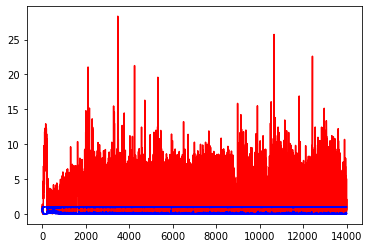

white ratio : 47.25
min : 184
max : 218


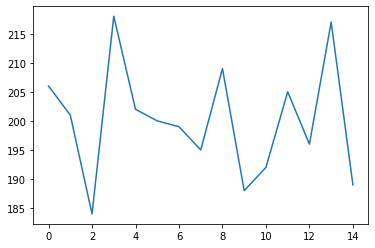

Generating interpolations...
14001 [D loss: 0.001516, acc.: 100.00%] [G loss: 2.468633, 2.253749]
14002 [D loss: 0.003065, acc.: 100.00%] [G loss: 0.000113, 0.000042]
14003 [D loss: 0.003494, acc.: 100.00%] [G loss: 1.539353, 0.758547]
14004 [D loss: 0.031066, acc.: 96.88%] [G loss: 1.675239, 2.110750]
14005 [D loss: 0.002006, acc.: 100.00%] [G loss: 0.716307, 0.127906]
14006 [D loss: 0.000843, acc.: 100.00%] [G loss: 3.626415, 4.296314]
14007 [D loss: 0.000569, acc.: 100.00%] [G loss: 8.571515, 7.310300]
14008 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.000045, 0.000117]
14009 [D loss: 0.002382, acc.: 100.00%] [G loss: 0.342059, 0.361185]
14010 [D loss: 0.000631, acc.: 100.00%] [G loss: 0.350266, 0.250009]
14011 [D loss: 0.000097, acc.: 100.00%] [G loss: 5.641949, 5.643591]
14012 [D loss: 0.005088, acc.: 100.00%] [G loss: 0.061820, 0.013838]
14013 [D loss: 0.001550, acc.: 100.00%] [G loss: 7.545836, 0.063105]
14014 [D loss: 0.088324, acc.: 96.88%] [G loss: 1.415549, 1.441649]
14015 [

14121 [D loss: 0.002315, acc.: 100.00%] [G loss: 6.444757, 0.014844]
14122 [D loss: 0.036685, acc.: 100.00%] [G loss: 2.221010, 0.081825]
14123 [D loss: 0.000523, acc.: 100.00%] [G loss: 4.955670, 0.007414]
14124 [D loss: 0.000123, acc.: 100.00%] [G loss: 4.849905, 4.157132]
14125 [D loss: 0.006971, acc.: 100.00%] [G loss: 0.018391, 0.003545]
14126 [D loss: 0.000381, acc.: 100.00%] [G loss: 0.007100, 0.004455]
14127 [D loss: 0.000088, acc.: 100.00%] [G loss: 3.434784, 3.253955]
14128 [D loss: 0.000106, acc.: 100.00%] [G loss: 4.534102, 1.837512]
14129 [D loss: 0.000494, acc.: 100.00%] [G loss: 1.058838, 0.011824]
14130 [D loss: 0.000364, acc.: 100.00%] [G loss: 0.000844, 0.002714]
14131 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.049575, 0.018181]
14132 [D loss: 0.001869, acc.: 100.00%] [G loss: 2.682839, 1.791463]
14133 [D loss: 0.001642, acc.: 100.00%] [G loss: 2.002675, 1.690181]
14134 [D loss: 0.105830, acc.: 96.88%] [G loss: 0.000021, 0.000016]
14135 [D loss: 0.001227, acc.: 100.

14242 [D loss: 0.030647, acc.: 100.00%] [G loss: 0.001104, 0.012317]
14243 [D loss: 0.002506, acc.: 100.00%] [G loss: 0.320858, 0.006429]
14244 [D loss: 0.001023, acc.: 100.00%] [G loss: 0.000087, 0.000069]
14245 [D loss: 0.239621, acc.: 96.88%] [G loss: 0.000007, 0.000004]
14246 [D loss: 0.001319, acc.: 100.00%] [G loss: 0.992768, 0.226510]
14247 [D loss: 0.069561, acc.: 96.88%] [G loss: 0.529415, 0.288617]
14248 [D loss: 0.001030, acc.: 100.00%] [G loss: 0.004802, 0.003505]
14249 [D loss: 0.000277, acc.: 100.00%] [G loss: 1.426508, 0.018650]
14250 [D loss: 0.012980, acc.: 100.00%] [G loss: 5.109693, 3.132416]
14251 [D loss: 0.000530, acc.: 100.00%] [G loss: 5.880364, 5.239592]
14252 [D loss: 0.003695, acc.: 100.00%] [G loss: 9.229315, 5.182408]
14253 [D loss: 0.001027, acc.: 100.00%] [G loss: 3.577489, 3.536270]
14254 [D loss: 0.000241, acc.: 100.00%] [G loss: 0.242271, 0.180473]
14255 [D loss: 0.005998, acc.: 100.00%] [G loss: 5.895912, 5.046406]
14256 [D loss: 0.034341, acc.: 96.88

14364 [D loss: 0.000980, acc.: 100.00%] [G loss: 2.028729, 1.097651]
14365 [D loss: 0.000681, acc.: 100.00%] [G loss: 0.000027, 0.000057]
14366 [D loss: 0.001339, acc.: 100.00%] [G loss: 0.053018, 0.069456]
14367 [D loss: 0.001093, acc.: 100.00%] [G loss: 0.001005, 0.000479]
14368 [D loss: 0.001042, acc.: 100.00%] [G loss: 2.833049, 0.986409]
14369 [D loss: 0.000535, acc.: 100.00%] [G loss: 5.762667, 4.626520]
14370 [D loss: 0.003995, acc.: 100.00%] [G loss: 2.898994, 1.805305]
14371 [D loss: 0.001217, acc.: 100.00%] [G loss: 3.577877, 3.245109]
14372 [D loss: 0.000538, acc.: 100.00%] [G loss: 0.126216, 0.130076]
14373 [D loss: 0.000562, acc.: 100.00%] [G loss: 0.034257, 0.034572]
14374 [D loss: 0.001857, acc.: 100.00%] [G loss: 0.064233, 0.063762]
14375 [D loss: 0.000128, acc.: 100.00%] [G loss: 1.176135, 0.162614]
14376 [D loss: 0.000674, acc.: 100.00%] [G loss: 0.001891, 0.002859]
14377 [D loss: 0.000436, acc.: 100.00%] [G loss: 1.291693, 1.108262]
14378 [D loss: 0.001038, acc.: 100

14486 [D loss: 0.001216, acc.: 100.00%] [G loss: 0.580375, 0.402741]
14487 [D loss: 0.085895, acc.: 93.75%] [G loss: 0.000014, 0.000081]
14488 [D loss: 0.042036, acc.: 96.88%] [G loss: 4.985634, 3.039178]
14489 [D loss: 0.120366, acc.: 96.88%] [G loss: 8.429108, 7.850351]
14490 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.137117, 0.178747]
14491 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.021200, 0.014075]
14492 [D loss: 0.000844, acc.: 100.00%] [G loss: 4.358347, 2.445959]
14493 [D loss: 0.000538, acc.: 100.00%] [G loss: 0.003823, 0.007800]
14494 [D loss: 0.000250, acc.: 100.00%] [G loss: 0.052225, 0.013344]
14495 [D loss: 0.000523, acc.: 100.00%] [G loss: 19.785408, 0.000126]
14496 [D loss: 0.011602, acc.: 100.00%] [G loss: 3.713967, 2.990026]
14497 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.904479, 2.557126]
14498 [D loss: 0.000043, acc.: 100.00%] [G loss: 10.198757, 7.521817]
14499 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.040273, 6.822995]
14500 [D loss: 0.000004, acc.: 100.

14607 [D loss: 0.001769, acc.: 100.00%] [G loss: 0.009203, 0.002107]
14608 [D loss: 0.001284, acc.: 100.00%] [G loss: 0.315077, 0.294845]
14609 [D loss: 0.083895, acc.: 96.88%] [G loss: 0.033125, 0.015996]
14610 [D loss: 0.005706, acc.: 100.00%] [G loss: 1.844655, 0.315866]
14611 [D loss: 0.010842, acc.: 100.00%] [G loss: 3.345074, 0.000015]
14612 [D loss: 0.012003, acc.: 100.00%] [G loss: 1.020165, 0.733394]
14613 [D loss: 0.019602, acc.: 100.00%] [G loss: 0.109503, 0.145110]
14614 [D loss: 0.002073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
14615 [D loss: 0.011941, acc.: 100.00%] [G loss: 0.000350, 0.000456]
14616 [D loss: 0.004490, acc.: 100.00%] [G loss: 0.040563, 0.012348]
14617 [D loss: 0.000517, acc.: 100.00%] [G loss: 0.000470, 0.000231]
14618 [D loss: 0.001682, acc.: 100.00%] [G loss: 0.000004, 0.000011]
14619 [D loss: 0.005511, acc.: 100.00%] [G loss: 0.324123, 0.081331]
14620 [D loss: 0.002416, acc.: 100.00%] [G loss: 0.000772, 0.000064]
14621 [D loss: 0.001591, acc.: 100.

14727 [D loss: 0.001117, acc.: 100.00%] [G loss: 0.006662, 0.002737]
14728 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000009, 0.000003]
14729 [D loss: 0.003051, acc.: 100.00%] [G loss: 1.046211, 0.350075]
14730 [D loss: 0.000383, acc.: 100.00%] [G loss: 0.232131, 0.162554]
14731 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.053362, 0.072798]
14732 [D loss: 0.000657, acc.: 100.00%] [G loss: 0.000000, 0.000000]
14733 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.006792, 0.015040]
14734 [D loss: 0.004254, acc.: 100.00%] [G loss: 3.256875, 0.231372]
14735 [D loss: 0.000408, acc.: 100.00%] [G loss: 0.024196, 0.026534]
14736 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000002, 0.000002]
14737 [D loss: 0.000821, acc.: 100.00%] [G loss: 2.002094, 0.865985]
14738 [D loss: 0.220026, acc.: 96.88%] [G loss: 40.106651, 4.299405]
14739 [D loss: 0.002261, acc.: 100.00%] [G loss: 0.342079, 0.299552]
14740 [D loss: 0.003116, acc.: 100.00%] [G loss: 0.592795, 0.494360]
14741 [D loss: 0.000170, acc.: 100

14848 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.099529, 0.077041]
14849 [D loss: 0.000675, acc.: 100.00%] [G loss: 0.123544, 0.155241]
14850 [D loss: 0.000385, acc.: 100.00%] [G loss: 1.410035, 0.808236]
14851 [D loss: 0.024392, acc.: 96.88%] [G loss: 0.108347, 0.098078]
14852 [D loss: 0.001108, acc.: 100.00%] [G loss: 0.000487, 0.001540]
14853 [D loss: 0.001827, acc.: 100.00%] [G loss: 0.397106, 0.112869]
14854 [D loss: 0.005355, acc.: 100.00%] [G loss: 4.815781, 3.346291]
14855 [D loss: 0.000683, acc.: 100.00%] [G loss: 0.000000, 0.000000]
14856 [D loss: 0.002085, acc.: 100.00%] [G loss: 4.081345, 3.284570]
14857 [D loss: 0.002838, acc.: 100.00%] [G loss: 0.000009, 0.000006]
14858 [D loss: 0.000263, acc.: 100.00%] [G loss: 3.257589, 0.163486]
14859 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000001, 0.000000]
14860 [D loss: 0.001091, acc.: 100.00%] [G loss: 3.038714, 2.325948]
14861 [D loss: 0.002286, acc.: 100.00%] [G loss: 0.000686, 0.001647]
14862 [D loss: 0.001194, acc.: 100.

14970 [D loss: 0.000016, acc.: 100.00%] [G loss: 5.182334, 4.323351]
14971 [D loss: 0.000128, acc.: 100.00%] [G loss: 5.060138, 4.368557]
14972 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.271976, 1.331619]
14973 [D loss: 0.000023, acc.: 100.00%] [G loss: 5.692866, 1.500391]
14974 [D loss: 0.000126, acc.: 100.00%] [G loss: 3.301027, 1.196902]
14975 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.210055, 0.080601]
14976 [D loss: 0.000560, acc.: 100.00%] [G loss: 3.756049, 2.527668]
14977 [D loss: 0.000196, acc.: 100.00%] [G loss: 3.289657, 1.547223]
14978 [D loss: 0.000245, acc.: 100.00%] [G loss: 6.674497, 5.406628]
14979 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.836851, 0.166027]
14980 [D loss: 0.000151, acc.: 100.00%] [G loss: 10.005198, 0.120632]
14981 [D loss: 0.000767, acc.: 100.00%] [G loss: 0.000809, 0.006103]
14982 [D loss: 0.003750, acc.: 100.00%] [G loss: 2.683230, 1.525021]
14983 [D loss: 0.002712, acc.: 100.00%] [G loss: 4.390790, 1.427810]
14984 [D loss: 0.004987, acc.: 10

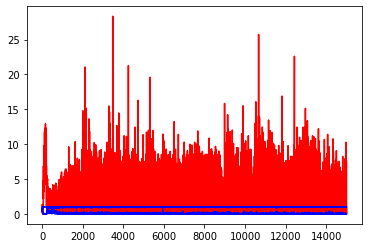

white ratio : 48.75
min : 184
max : 218


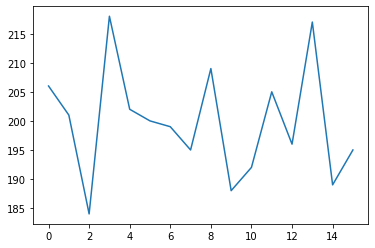

Generating interpolations...
15001 [D loss: 0.000299, acc.: 100.00%] [G loss: 2.559916, 1.429735]
15002 [D loss: 0.205295, acc.: 96.88%] [G loss: 0.045602, 0.063071]
15003 [D loss: 0.000372, acc.: 100.00%] [G loss: 25.576963, 1.312625]
15004 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.171768, 1.243477]
15005 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.826584, 0.986390]
15006 [D loss: 0.000069, acc.: 100.00%] [G loss: 5.585615, 4.577939]
15007 [D loss: 0.000332, acc.: 100.00%] [G loss: 2.072369, 0.745759]
15008 [D loss: 0.000073, acc.: 100.00%] [G loss: 10.228838, 9.124591]
15009 [D loss: 0.002842, acc.: 100.00%] [G loss: 4.582497, 3.416603]
15010 [D loss: 0.000744, acc.: 100.00%] [G loss: 7.716041, 6.686825]
15011 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.020522, 0.002379]
15012 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.229062, 0.059273]
15013 [D loss: 0.003387, acc.: 100.00%] [G loss: 0.094837, 0.067507]
15014 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.046135, 0.007454]
1501

15117 [D loss: 0.001674, acc.: 100.00%] [G loss: 0.030411, 0.033693]
15118 [D loss: 0.009832, acc.: 100.00%] [G loss: 0.014113, 0.023130]
15119 [D loss: 0.108453, acc.: 96.88%] [G loss: 5.179748, 3.411653]
15120 [D loss: 0.005309, acc.: 100.00%] [G loss: 0.487488, 0.113168]
15121 [D loss: 0.004458, acc.: 100.00%] [G loss: 0.096662, 0.077684]
15122 [D loss: 0.004556, acc.: 100.00%] [G loss: 0.046750, 0.045446]
15123 [D loss: 0.002349, acc.: 100.00%] [G loss: 8.613216, 1.669507]
15124 [D loss: 0.007939, acc.: 100.00%] [G loss: 1.312218, 0.702068]
15125 [D loss: 0.011563, acc.: 100.00%] [G loss: 9.505915, 6.324824]
15126 [D loss: 0.000540, acc.: 100.00%] [G loss: 0.799966, 1.045112]
15127 [D loss: 0.000922, acc.: 100.00%] [G loss: 0.000021, 0.000055]
15128 [D loss: 0.042379, acc.: 96.88%] [G loss: 4.686046, 4.374262]
15129 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.361193, 10.745925]
15130 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.606142, 7.981161]
15131 [D loss: 0.000002, acc.: 100

15238 [D loss: 0.000772, acc.: 100.00%] [G loss: 0.381489, 0.299334]
15239 [D loss: 0.000455, acc.: 100.00%] [G loss: 6.151580, 5.679593]
15240 [D loss: 0.002788, acc.: 100.00%] [G loss: 0.004763, 0.011303]
15241 [D loss: 0.006281, acc.: 100.00%] [G loss: 0.913568, 1.741131]
15242 [D loss: 0.000922, acc.: 100.00%] [G loss: 5.091836, 1.747121]
15243 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.128459, 0.229007]
15244 [D loss: 0.000770, acc.: 100.00%] [G loss: 0.669025, 0.814336]
15245 [D loss: 0.001762, acc.: 100.00%] [G loss: 1.087706, 0.330723]
15246 [D loss: 0.000864, acc.: 100.00%] [G loss: 0.305536, 0.191259]
15247 [D loss: 0.003812, acc.: 100.00%] [G loss: 0.084720, 0.032085]
15248 [D loss: 0.000277, acc.: 100.00%] [G loss: 1.018527, 0.346061]
15249 [D loss: 0.004632, acc.: 100.00%] [G loss: 0.160281, 0.103762]
15250 [D loss: 0.005766, acc.: 100.00%] [G loss: 0.000002, 0.000008]
15251 [D loss: 0.000749, acc.: 100.00%] [G loss: 18.313641, 0.000587]
15252 [D loss: 0.000312, acc.: 10

15359 [D loss: 0.004433, acc.: 100.00%] [G loss: 0.235968, 0.056610]
15360 [D loss: 0.000312, acc.: 100.00%] [G loss: 11.577906, 9.091409]
15361 [D loss: 0.000339, acc.: 100.00%] [G loss: 3.336652, 2.524602]
15362 [D loss: 0.002103, acc.: 100.00%] [G loss: 8.398172, 7.178095]
15363 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.026019, 0.018252]
15364 [D loss: 0.006463, acc.: 100.00%] [G loss: 5.158164, 4.810400]
15365 [D loss: 0.001761, acc.: 100.00%] [G loss: 7.954575, 7.166569]
15366 [D loss: 0.000927, acc.: 100.00%] [G loss: 9.387028, 2.713988]
15367 [D loss: 0.000593, acc.: 100.00%] [G loss: 1.920171, 1.459158]
15368 [D loss: 0.001054, acc.: 100.00%] [G loss: 8.842055, 8.748643]
15369 [D loss: 0.002938, acc.: 100.00%] [G loss: 5.028216, 0.118189]
15370 [D loss: 0.002230, acc.: 100.00%] [G loss: 4.098277, 3.031358]
15371 [D loss: 0.000117, acc.: 100.00%] [G loss: 2.389342, 1.156324]
15372 [D loss: 0.002127, acc.: 100.00%] [G loss: 1.591830, 0.688189]
15373 [D loss: 0.004794, acc.: 10

15480 [D loss: 0.001319, acc.: 100.00%] [G loss: 0.181991, 0.194174]
15481 [D loss: 0.000809, acc.: 100.00%] [G loss: 7.010527, 6.311373]
15482 [D loss: 0.000939, acc.: 100.00%] [G loss: 0.030232, 0.027464]
15483 [D loss: 0.000462, acc.: 100.00%] [G loss: 7.915225, 7.460628]
15484 [D loss: 0.001512, acc.: 100.00%] [G loss: 0.001975, 0.005890]
15485 [D loss: 0.052824, acc.: 96.88%] [G loss: 4.091368, 3.060899]
15486 [D loss: 0.000110, acc.: 100.00%] [G loss: 12.747536, 3.369284]
15487 [D loss: 0.001738, acc.: 100.00%] [G loss: 1.715433, 1.394114]
15488 [D loss: 0.015639, acc.: 100.00%] [G loss: 0.227713, 0.057605]
15489 [D loss: 0.017621, acc.: 100.00%] [G loss: 7.274281, 4.881392]
15490 [D loss: 0.015772, acc.: 100.00%] [G loss: 9.063837, 0.338319]
15491 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.300960, 0.562090]
15492 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.620754, 0.489973]
15493 [D loss: 0.000085, acc.: 100.00%] [G loss: 3.982877, 2.342711]
15494 [D loss: 0.000277, acc.: 100

15601 [D loss: 0.005535, acc.: 100.00%] [G loss: 0.067210, 0.072719]
15602 [D loss: 0.001322, acc.: 100.00%] [G loss: 2.716885, 2.040880]
15603 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.000003, 0.000017]
15604 [D loss: 0.000498, acc.: 100.00%] [G loss: 2.941390, 2.608223]
15605 [D loss: 0.001130, acc.: 100.00%] [G loss: 16.297203, 3.494616]
15606 [D loss: 0.000758, acc.: 100.00%] [G loss: 1.569915, 1.315091]
15607 [D loss: 0.000680, acc.: 100.00%] [G loss: 0.287135, 0.294176]
15608 [D loss: 0.121122, acc.: 96.88%] [G loss: 0.147014, 0.097165]
15609 [D loss: 0.001326, acc.: 100.00%] [G loss: 1.639241, 0.953654]
15610 [D loss: 0.001728, acc.: 100.00%] [G loss: 0.035682, 0.013879]
15611 [D loss: 0.026950, acc.: 96.88%] [G loss: 0.475852, 0.327905]
15612 [D loss: 0.003686, acc.: 100.00%] [G loss: 0.287582, 0.288269]
15613 [D loss: 0.001034, acc.: 100.00%] [G loss: 0.241470, 0.153775]
15614 [D loss: 0.000925, acc.: 100.00%] [G loss: 0.119215, 0.145950]
15615 [D loss: 0.000704, acc.: 100.

15721 [D loss: 0.000048, acc.: 100.00%] [G loss: 3.743097, 2.158608]
15722 [D loss: 0.000065, acc.: 100.00%] [G loss: 1.528582, 0.558821]
15723 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.033415, 0.003009]
15724 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.025856, 0.116788]
15725 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.000403, 0.000280]
15726 [D loss: 0.015049, acc.: 100.00%] [G loss: 5.479579, 4.849084]
15727 [D loss: 0.000842, acc.: 100.00%] [G loss: 0.049841, 0.111851]
15728 [D loss: 0.000472, acc.: 100.00%] [G loss: 0.000003, 0.000006]
15729 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.199039, 0.158111]
15730 [D loss: 0.018667, acc.: 100.00%] [G loss: 0.000046, 0.000121]
15731 [D loss: 0.002252, acc.: 100.00%] [G loss: 0.003816, 0.002461]
15732 [D loss: 0.001013, acc.: 100.00%] [G loss: 0.036149, 0.012181]
15733 [D loss: 0.000426, acc.: 100.00%] [G loss: 4.820561, 3.878655]
15734 [D loss: 0.001722, acc.: 100.00%] [G loss: 1.429666, 0.542831]
15735 [D loss: 0.001243, acc.: 100

15841 [D loss: 0.028110, acc.: 96.88%] [G loss: 0.000001, 0.000000]
15842 [D loss: 0.031987, acc.: 100.00%] [G loss: 0.047946, 0.048824]
15843 [D loss: 0.000837, acc.: 100.00%] [G loss: 0.002045, 0.002133]
15844 [D loss: 0.001215, acc.: 100.00%] [G loss: 2.546319, 1.393230]
15845 [D loss: 0.195553, acc.: 96.88%] [G loss: 0.029602, 0.003386]
15846 [D loss: 0.021140, acc.: 100.00%] [G loss: 0.355214, 0.118921]
15847 [D loss: 0.001805, acc.: 100.00%] [G loss: 2.730465, 1.273992]
15848 [D loss: 0.024609, acc.: 100.00%] [G loss: 0.000014, 0.000105]
15849 [D loss: 0.008094, acc.: 100.00%] [G loss: 0.003433, 0.001498]
15850 [D loss: 0.061986, acc.: 96.88%] [G loss: 0.000001, 0.000002]
15851 [D loss: 0.008747, acc.: 100.00%] [G loss: 4.949108, 2.995992]
15852 [D loss: 0.027894, acc.: 100.00%] [G loss: 0.375653, 0.022532]
15853 [D loss: 0.003914, acc.: 100.00%] [G loss: 0.000009, 0.000001]
15854 [D loss: 0.000614, acc.: 100.00%] [G loss: 6.121299, 4.334881]
15855 [D loss: 0.001895, acc.: 100.00

15961 [D loss: 0.000422, acc.: 100.00%] [G loss: 7.166349, 6.242408]
15962 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.002195, 0.003712]
15963 [D loss: 0.001273, acc.: 100.00%] [G loss: 0.500244, 0.152698]
15964 [D loss: 0.002122, acc.: 100.00%] [G loss: 33.818855, 0.246294]
15965 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.975519, 1.693633]
15966 [D loss: 0.000202, acc.: 100.00%] [G loss: 4.481330, 3.573760]
15967 [D loss: 0.000162, acc.: 100.00%] [G loss: 5.027957, 4.336946]
15968 [D loss: 0.000269, acc.: 100.00%] [G loss: 1.993234, 3.433887]
15969 [D loss: 0.000029, acc.: 100.00%] [G loss: 3.974123, 2.620461]
15970 [D loss: 0.000087, acc.: 100.00%] [G loss: 4.895983, 3.847212]
15971 [D loss: 0.002090, acc.: 100.00%] [G loss: 1.367912, 0.499102]
15972 [D loss: 0.000409, acc.: 100.00%] [G loss: 3.433121, 1.045733]
15973 [D loss: 0.000620, acc.: 100.00%] [G loss: 0.052133, 0.092509]
15974 [D loss: 0.000286, acc.: 100.00%] [G loss: 0.004080, 0.004928]
15975 [D loss: 0.000106, acc.: 10

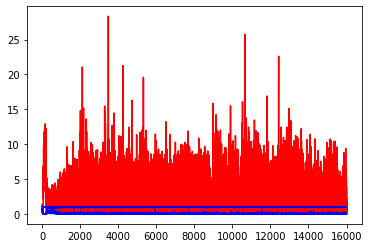

white ratio : 48.5
min : 184
max : 218


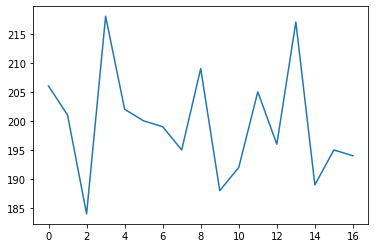

Generating interpolations...
16001 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.012841, 0.027704]
16002 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000235, 0.000289]
16003 [D loss: 0.001050, acc.: 100.00%] [G loss: 0.202407, 0.076769]
16004 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.002018, 0.001485]
16005 [D loss: 0.000380, acc.: 100.00%] [G loss: 3.144083, 2.378375]
16006 [D loss: 0.000517, acc.: 100.00%] [G loss: 5.884750, 5.227329]
16007 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000705, 0.002096]
16008 [D loss: 0.000452, acc.: 100.00%] [G loss: 3.451957, 0.002808]
16009 [D loss: 0.000398, acc.: 100.00%] [G loss: 0.014204, 0.031142]
16010 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.505374, 0.349362]
16011 [D loss: 0.000233, acc.: 100.00%] [G loss: 5.409929, 4.620047]
16012 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.130635, 0.066625]
16013 [D loss: 0.000157, acc.: 100.00%] [G loss: 2.864431, 1.688281]
16014 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000986, 0.035579]
16015

16121 [D loss: 0.000525, acc.: 100.00%] [G loss: 0.001376, 0.000322]
16122 [D loss: 0.001357, acc.: 100.00%] [G loss: 0.002551, 0.001714]
16123 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.000027, 0.000016]
16124 [D loss: 0.002228, acc.: 100.00%] [G loss: 0.322295, 0.175396]
16125 [D loss: 0.001435, acc.: 100.00%] [G loss: 0.002817, 0.002942]
16126 [D loss: 0.023462, acc.: 100.00%] [G loss: 0.005319, 0.008433]
16127 [D loss: 0.003340, acc.: 100.00%] [G loss: 0.005813, 0.020863]
16128 [D loss: 0.006793, acc.: 100.00%] [G loss: 0.000001, 0.000002]
16129 [D loss: 0.010953, acc.: 100.00%] [G loss: 0.000225, 0.000216]
16130 [D loss: 0.000999, acc.: 100.00%] [G loss: 0.000574, 0.000814]
16131 [D loss: 0.040212, acc.: 96.88%] [G loss: 0.003772, 0.001674]
16132 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.018467, 0.028257]
16133 [D loss: 0.000522, acc.: 100.00%] [G loss: 0.083444, 0.014384]
16134 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.583342, 0.301438]
16135 [D loss: 0.000272, acc.: 100.

16241 [D loss: 0.001166, acc.: 100.00%] [G loss: 0.016422, 0.013250]
16242 [D loss: 0.014294, acc.: 100.00%] [G loss: 0.000012, 0.000009]
16243 [D loss: 0.001279, acc.: 100.00%] [G loss: 0.012747, 0.003510]
16244 [D loss: 0.000924, acc.: 100.00%] [G loss: 0.007218, 0.005643]
16245 [D loss: 0.000820, acc.: 100.00%] [G loss: 3.048722, 0.547377]
16246 [D loss: 0.000969, acc.: 100.00%] [G loss: 0.001014, 0.000077]
16247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.727295, 0.386989]
16248 [D loss: 0.001344, acc.: 100.00%] [G loss: 0.001005, 0.000594]
16249 [D loss: 0.000270, acc.: 100.00%] [G loss: 0.002862, 0.003150]
16250 [D loss: 0.000877, acc.: 100.00%] [G loss: 0.000001, 0.000001]
16251 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.014091, 0.005217]
16252 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.008684, 0.007354]
16253 [D loss: 0.001640, acc.: 100.00%] [G loss: 0.012679, 0.049821]
16254 [D loss: 0.003017, acc.: 100.00%] [G loss: 0.000149, 0.000121]
16255 [D loss: 0.000144, acc.: 100

16361 [D loss: 0.000578, acc.: 100.00%] [G loss: 0.977828, 0.453169]
16362 [D loss: 0.000948, acc.: 100.00%] [G loss: 0.027258, 0.019251]
16363 [D loss: 0.000755, acc.: 100.00%] [G loss: 0.101557, 0.179093]
16364 [D loss: 0.000152, acc.: 100.00%] [G loss: 1.084666, 0.522263]
16365 [D loss: 0.000060, acc.: 100.00%] [G loss: 1.087208, 0.362616]
16366 [D loss: 0.001032, acc.: 100.00%] [G loss: 0.073324, 0.045147]
16367 [D loss: 0.001180, acc.: 100.00%] [G loss: 3.066405, 4.627672]
16368 [D loss: 0.000319, acc.: 100.00%] [G loss: 0.002655, 0.025968]
16369 [D loss: 0.024946, acc.: 96.88%] [G loss: 5.843904, 5.052110]
16370 [D loss: 0.001423, acc.: 100.00%] [G loss: 0.137044, 0.053201]
16371 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.202024, 0.316814]
16372 [D loss: 0.003356, acc.: 100.00%] [G loss: 0.014507, 0.020831]
16373 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.571100, 0.319102]
16374 [D loss: 0.019053, acc.: 100.00%] [G loss: 0.000051, 0.000021]
16375 [D loss: 0.001780, acc.: 100.

16482 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.064196, 0.088783]
16483 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.047311, 0.051170]
16484 [D loss: 0.000950, acc.: 100.00%] [G loss: 1.254457, 0.261002]
16485 [D loss: 0.000495, acc.: 100.00%] [G loss: 0.000101, 0.000041]
16486 [D loss: 0.017464, acc.: 100.00%] [G loss: 0.128242, 0.118573]
16487 [D loss: 0.002573, acc.: 100.00%] [G loss: 0.000402, 0.000326]
16488 [D loss: 0.004033, acc.: 100.00%] [G loss: 4.054022, 2.521115]
16489 [D loss: 0.074954, acc.: 96.88%] [G loss: 2.106565, 0.874913]
16490 [D loss: 0.000153, acc.: 100.00%] [G loss: 1.202576, 0.842688]
16491 [D loss: 0.001046, acc.: 100.00%] [G loss: 1.125157, 0.668345]
16492 [D loss: 0.000016, acc.: 100.00%] [G loss: 10.320679, 2.815447]
16493 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.046993, 0.012985]
16494 [D loss: 0.007181, acc.: 100.00%] [G loss: 0.883701, 0.021181]
16495 [D loss: 0.214199, acc.: 96.88%] [G loss: 4.650862, 2.805984]
16496 [D loss: 0.000096, acc.: 100.

16601 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.922467, 1.277641]
16602 [D loss: 0.094665, acc.: 96.88%] [G loss: 9.617890, 2.662721]
16603 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.781583, 0.714964]
16604 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.163725, 0.087272]
16605 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.228544, 0.048944]
16606 [D loss: 0.003552, acc.: 100.00%] [G loss: 2.239175, 1.188475]
16607 [D loss: 0.011123, acc.: 100.00%] [G loss: 0.080918, 0.071258]
16608 [D loss: 0.002518, acc.: 100.00%] [G loss: 0.157407, 0.083113]
16609 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004586, 0.002462]
16610 [D loss: 0.022394, acc.: 96.88%] [G loss: 0.539190, 0.013783]
16611 [D loss: 0.000158, acc.: 100.00%] [G loss: 1.031617, 0.372565]
16612 [D loss: 0.000445, acc.: 100.00%] [G loss: 0.007754, 0.001603]
16613 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.236829, 0.066102]
16614 [D loss: 0.000376, acc.: 100.00%] [G loss: 12.725197, 0.743660]
16615 [D loss: 0.005082, acc.: 100.

16722 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.546824, 0.314619]
16723 [D loss: 0.000909, acc.: 100.00%] [G loss: 3.208371, 2.639714]
16724 [D loss: 0.000516, acc.: 100.00%] [G loss: 0.960789, 0.556324]
16725 [D loss: 0.000373, acc.: 100.00%] [G loss: 2.536854, 1.846779]
16726 [D loss: 0.001254, acc.: 100.00%] [G loss: 6.232490, 5.246017]
16727 [D loss: 0.001259, acc.: 100.00%] [G loss: 8.372326, 8.448839]
16728 [D loss: 0.002014, acc.: 100.00%] [G loss: 0.754749, 0.760169]
16729 [D loss: 0.001880, acc.: 100.00%] [G loss: 5.259247, 3.301225]
16730 [D loss: 0.002819, acc.: 100.00%] [G loss: 0.447133, 0.008470]
16731 [D loss: 0.000165, acc.: 100.00%] [G loss: 1.807613, 1.810781]
16732 [D loss: 0.000851, acc.: 100.00%] [G loss: 7.127876, 4.251067]
16733 [D loss: 0.001473, acc.: 100.00%] [G loss: 10.247076, 4.972492]
16734 [D loss: 0.000040, acc.: 100.00%] [G loss: 6.678796, 6.956520]
16735 [D loss: 0.000044, acc.: 100.00%] [G loss: 12.196586, 10.112748]
16736 [D loss: 0.000114, acc.: 

16841 [D loss: 0.004416, acc.: 100.00%] [G loss: 1.050432, 0.372277]
16842 [D loss: 0.000446, acc.: 100.00%] [G loss: 14.932526, 5.761495]
16843 [D loss: 0.013378, acc.: 100.00%] [G loss: 6.562207, 5.804450]
16844 [D loss: 0.036495, acc.: 96.88%] [G loss: 3.470681, 3.236307]
16845 [D loss: 0.002484, acc.: 100.00%] [G loss: 2.723336, 2.264744]
16846 [D loss: 0.001706, acc.: 100.00%] [G loss: 3.914296, 3.099002]
16847 [D loss: 0.028817, acc.: 100.00%] [G loss: 2.132652, 1.641176]
16848 [D loss: 0.002506, acc.: 100.00%] [G loss: 6.014561, 5.892439]
16849 [D loss: 0.007944, acc.: 100.00%] [G loss: 3.206164, 1.815149]
16850 [D loss: 0.008117, acc.: 100.00%] [G loss: 0.564528, 0.075881]
16851 [D loss: 0.000610, acc.: 100.00%] [G loss: 5.302245, 3.604154]
16852 [D loss: 0.001088, acc.: 100.00%] [G loss: 2.368846, 0.780261]
16853 [D loss: 0.000982, acc.: 100.00%] [G loss: 6.280633, 6.836647]
16854 [D loss: 0.004630, acc.: 100.00%] [G loss: 5.828002, 5.982492]
16855 [D loss: 0.002164, acc.: 100

16961 [D loss: 0.000569, acc.: 100.00%] [G loss: 34.650822, 7.294967]
16962 [D loss: 0.000371, acc.: 100.00%] [G loss: 3.586889, 2.866094]
16963 [D loss: 0.043794, acc.: 96.88%] [G loss: 3.718852, 1.808330]
16964 [D loss: 0.001256, acc.: 100.00%] [G loss: 5.030813, 4.010206]
16965 [D loss: 0.008010, acc.: 100.00%] [G loss: 7.862351, 7.322067]
16966 [D loss: 0.037458, acc.: 96.88%] [G loss: 0.000128, 0.000253]
16967 [D loss: 0.001267, acc.: 100.00%] [G loss: 0.387612, 0.325649]
16968 [D loss: 0.005457, acc.: 100.00%] [G loss: 2.907052, 2.176666]
16969 [D loss: 0.016173, acc.: 100.00%] [G loss: 3.869678, 2.629096]
16970 [D loss: 0.001054, acc.: 100.00%] [G loss: 1.462996, 9.226295]
16971 [D loss: 0.002488, acc.: 100.00%] [G loss: 4.332484, 3.807627]
16972 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.175755, 2.047132]
16973 [D loss: 0.004265, acc.: 100.00%] [G loss: 6.302073, 6.219900]
16974 [D loss: 0.000761, acc.: 100.00%] [G loss: 8.308735, 7.801147]
16975 [D loss: 0.000189, acc.: 100

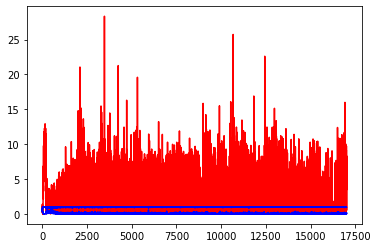

white ratio : 52.75
min : 184
max : 218


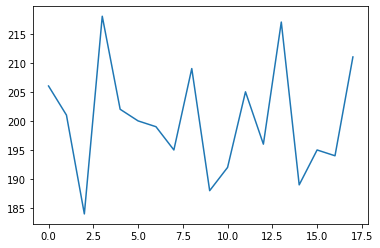

Generating interpolations...
17001 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.905070, 0.415546]
17002 [D loss: 0.000496, acc.: 100.00%] [G loss: 9.615006, 8.728205]
17003 [D loss: 0.058643, acc.: 96.88%] [G loss: 10.807368, 4.121230]
17004 [D loss: 0.001079, acc.: 100.00%] [G loss: 3.499523, 2.772127]
17005 [D loss: 0.002107, acc.: 100.00%] [G loss: 2.830747, 1.466504]
17006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.157127, 0.005806]
17007 [D loss: 0.000961, acc.: 100.00%] [G loss: 9.038120, 5.396378]
17008 [D loss: 0.001404, acc.: 100.00%] [G loss: 3.689943, 3.746641]
17009 [D loss: 0.001230, acc.: 100.00%] [G loss: 6.288220, 5.313872]
17010 [D loss: 0.001566, acc.: 100.00%] [G loss: 4.741685, 4.915944]
17011 [D loss: 0.002105, acc.: 100.00%] [G loss: 1.145113, 0.185398]
17012 [D loss: 0.001321, acc.: 100.00%] [G loss: 0.188361, 0.101534]
17013 [D loss: 0.001407, acc.: 100.00%] [G loss: 3.062716, 2.152966]
17014 [D loss: 0.000473, acc.: 100.00%] [G loss: 4.975091, 4.735727]
17015

17119 [D loss: 0.000006, acc.: 100.00%] [G loss: 11.863884, 12.258998]
17120 [D loss: 0.007270, acc.: 100.00%] [G loss: 11.353651, 10.075788]
17121 [D loss: 0.105569, acc.: 96.88%] [G loss: 8.482086, 8.121697]
17122 [D loss: 0.000452, acc.: 100.00%] [G loss: 10.602287, 9.886146]
17123 [D loss: 0.000017, acc.: 100.00%] [G loss: 6.239216, 5.023098]
17124 [D loss: 0.000528, acc.: 100.00%] [G loss: 7.978471, 6.245646]
17125 [D loss: 0.000103, acc.: 100.00%] [G loss: 9.463491, 9.069208]
17126 [D loss: 0.001858, acc.: 100.00%] [G loss: 12.587154, 10.904031]
17127 [D loss: 0.001022, acc.: 100.00%] [G loss: 2.323990, 2.031658]
17128 [D loss: 0.000024, acc.: 100.00%] [G loss: 10.556288, 10.157060]
17129 [D loss: 0.083757, acc.: 96.88%] [G loss: 7.903622, 7.818834]
17130 [D loss: 0.000149, acc.: 100.00%] [G loss: 2.190753, 1.716175]
17131 [D loss: 0.001038, acc.: 100.00%] [G loss: 3.164448, 2.381459]
17132 [D loss: 0.001349, acc.: 100.00%] [G loss: 3.227340, 2.580144]
17133 [D loss: 0.001783, ac

17238 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.540936, 0.184330]
17239 [D loss: 0.001114, acc.: 100.00%] [G loss: 16.159288, 3.833718]
17240 [D loss: 0.003196, acc.: 100.00%] [G loss: 5.308623, 4.118345]
17241 [D loss: 0.003354, acc.: 100.00%] [G loss: 0.054555, 0.076467]
17242 [D loss: 0.020013, acc.: 100.00%] [G loss: 0.981500, 0.041118]
17243 [D loss: 0.006843, acc.: 100.00%] [G loss: 0.922604, 0.851084]
17244 [D loss: 0.001100, acc.: 100.00%] [G loss: 5.974600, 4.220464]
17245 [D loss: 0.000407, acc.: 100.00%] [G loss: 3.554501, 3.441024]
17246 [D loss: 0.007831, acc.: 100.00%] [G loss: 9.298481, 8.749035]
17247 [D loss: 0.072691, acc.: 96.88%] [G loss: 1.719626, 1.227911]
17248 [D loss: 0.009629, acc.: 100.00%] [G loss: 0.142467, 0.000016]
17249 [D loss: 0.014407, acc.: 100.00%] [G loss: 7.219389, 4.840383]
17250 [D loss: 0.000242, acc.: 100.00%] [G loss: 2.899901, 2.697147]
17251 [D loss: 0.000152, acc.: 100.00%] [G loss: 4.142992, 3.570054]
17252 [D loss: 0.000229, acc.: 100

17357 [D loss: 0.005188, acc.: 100.00%] [G loss: 1.435674, 1.335403]
17358 [D loss: 0.002028, acc.: 100.00%] [G loss: 6.692803, 5.347657]
17359 [D loss: 0.002344, acc.: 100.00%] [G loss: 0.000144, 0.000278]
17360 [D loss: 0.191920, acc.: 96.88%] [G loss: 12.440380, 2.543552]
17361 [D loss: 0.001445, acc.: 100.00%] [G loss: 5.986918, 5.444416]
17362 [D loss: 0.001970, acc.: 100.00%] [G loss: 3.141349, 2.827817]
17363 [D loss: 0.002151, acc.: 100.00%] [G loss: 6.541821, 5.362109]
17364 [D loss: 0.001496, acc.: 100.00%] [G loss: 5.092050, 4.593924]
17365 [D loss: 0.002514, acc.: 100.00%] [G loss: 5.480526, 4.576779]
17366 [D loss: 0.004498, acc.: 100.00%] [G loss: 0.001355, 0.002556]
17367 [D loss: 0.009906, acc.: 100.00%] [G loss: 5.584472, 0.060236]
17368 [D loss: 0.001434, acc.: 100.00%] [G loss: 7.632261, 7.701591]
17369 [D loss: 0.007113, acc.: 100.00%] [G loss: 6.145452, 6.376516]
17370 [D loss: 0.001278, acc.: 100.00%] [G loss: 1.479711, 0.784215]
17371 [D loss: 0.082942, acc.: 96.

17479 [D loss: 0.002843, acc.: 100.00%] [G loss: 0.005867, 0.001597]
17480 [D loss: 0.000686, acc.: 100.00%] [G loss: 4.971582, 4.276466]
17481 [D loss: 0.000619, acc.: 100.00%] [G loss: 0.239316, 0.264444]
17482 [D loss: 0.002763, acc.: 100.00%] [G loss: 2.108419, 1.904095]
17483 [D loss: 0.000947, acc.: 100.00%] [G loss: 7.083917, 6.280627]
17484 [D loss: 0.000550, acc.: 100.00%] [G loss: 0.004007, 0.001670]
17485 [D loss: 0.000771, acc.: 100.00%] [G loss: 14.112892, 5.858312]
17486 [D loss: 0.025461, acc.: 96.88%] [G loss: 7.437772, 7.406510]
17487 [D loss: 0.016615, acc.: 100.00%] [G loss: 1.479610, 1.072926]
17488 [D loss: 0.001276, acc.: 100.00%] [G loss: 7.604552, 5.769450]
17489 [D loss: 0.000742, acc.: 100.00%] [G loss: 6.116515, 4.519638]
17490 [D loss: 0.004543, acc.: 100.00%] [G loss: 3.762959, 2.922606]
17491 [D loss: 0.001118, acc.: 100.00%] [G loss: 0.000579, 0.000417]
17492 [D loss: 0.005691, acc.: 100.00%] [G loss: 1.425904, 0.868318]
17493 [D loss: 0.019002, acc.: 100

17600 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.104130, 0.144705]
17601 [D loss: 0.003072, acc.: 100.00%] [G loss: 1.011175, 0.553385]
17602 [D loss: 0.048578, acc.: 96.88%] [G loss: 6.607939, 6.393499]
17603 [D loss: 0.067383, acc.: 96.88%] [G loss: 4.502621, 3.585592]
17604 [D loss: 0.001314, acc.: 100.00%] [G loss: 0.000652, 0.000289]
17605 [D loss: 0.001088, acc.: 100.00%] [G loss: 0.000996, 0.000638]
17606 [D loss: 0.001187, acc.: 100.00%] [G loss: 0.000410, 0.000491]
17607 [D loss: 0.036137, acc.: 96.88%] [G loss: 0.775837, 0.539686]
17608 [D loss: 0.010768, acc.: 100.00%] [G loss: 0.158947, 0.030893]
17609 [D loss: 0.001011, acc.: 100.00%] [G loss: 7.557426, 0.039266]
17610 [D loss: 0.001562, acc.: 100.00%] [G loss: 7.139510, 6.474051]
17611 [D loss: 0.012157, acc.: 100.00%] [G loss: 2.178348, 1.246163]
17612 [D loss: 0.001187, acc.: 100.00%] [G loss: 0.005110, 0.007087]
17613 [D loss: 0.251814, acc.: 96.88%] [G loss: 4.139964, 4.121493]
17614 [D loss: 0.201749, acc.: 96.88%]

17720 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.094335, 0.176185]
17721 [D loss: 0.031591, acc.: 96.88%] [G loss: 3.718637, 2.873082]
17722 [D loss: 0.001720, acc.: 100.00%] [G loss: 4.117549, 2.768075]
17723 [D loss: 0.000425, acc.: 100.00%] [G loss: 0.000608, 0.021717]
17724 [D loss: 0.002119, acc.: 100.00%] [G loss: 0.075701, 0.007854]
17725 [D loss: 0.002456, acc.: 100.00%] [G loss: 0.617211, 0.642451]
17726 [D loss: 0.001157, acc.: 100.00%] [G loss: 0.166630, 0.011151]
17727 [D loss: 0.000498, acc.: 100.00%] [G loss: 4.210195, 0.132600]
17728 [D loss: 0.000437, acc.: 100.00%] [G loss: 5.740120, 5.328553]
17729 [D loss: 0.000660, acc.: 100.00%] [G loss: 4.175189, 3.616740]
17730 [D loss: 0.003536, acc.: 100.00%] [G loss: 3.042686, 1.335224]
17731 [D loss: 0.000799, acc.: 100.00%] [G loss: 7.021259, 6.618843]
17732 [D loss: 0.000422, acc.: 100.00%] [G loss: 2.871857, 2.327604]
17733 [D loss: 0.000506, acc.: 100.00%] [G loss: 2.730069, 1.507936]
17734 [D loss: 0.000211, acc.: 100.

17841 [D loss: 0.004315, acc.: 100.00%] [G loss: 6.813849, 6.248345]
17842 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.010499, 0.015326]
17843 [D loss: 0.009155, acc.: 100.00%] [G loss: 0.005280, 0.007273]
17844 [D loss: 0.031435, acc.: 96.88%] [G loss: 7.598308, 7.553856]
17845 [D loss: 0.000892, acc.: 100.00%] [G loss: 7.547055, 7.037421]
17846 [D loss: 0.001411, acc.: 100.00%] [G loss: 5.250283, 4.711478]
17847 [D loss: 0.001232, acc.: 100.00%] [G loss: 0.647910, 0.361298]
17848 [D loss: 0.000807, acc.: 100.00%] [G loss: 7.449668, 4.545805]
17849 [D loss: 0.017042, acc.: 100.00%] [G loss: 0.082566, 0.023584]
17850 [D loss: 0.000857, acc.: 100.00%] [G loss: 2.782415, 0.676905]
17851 [D loss: 0.000635, acc.: 100.00%] [G loss: 0.151458, 0.171775]
17852 [D loss: 0.187815, acc.: 93.75%] [G loss: 10.702623, 4.909300]
17853 [D loss: 0.012333, acc.: 100.00%] [G loss: 4.975564, 4.529854]
17854 [D loss: 0.088467, acc.: 93.75%] [G loss: 6.655938, 5.823402]
17855 [D loss: 0.001385, acc.: 100.0

17962 [D loss: 0.000612, acc.: 100.00%] [G loss: 0.715987, 0.546120]
17963 [D loss: 0.003703, acc.: 100.00%] [G loss: 1.117564, 0.562917]
17964 [D loss: 0.033577, acc.: 96.88%] [G loss: 12.556988, 2.863388]
17965 [D loss: 0.004367, acc.: 100.00%] [G loss: 2.376824, 2.384876]
17966 [D loss: 0.081170, acc.: 96.88%] [G loss: 1.040468, 1.909268]
17967 [D loss: 0.000647, acc.: 100.00%] [G loss: 4.478699, 3.947403]
17968 [D loss: 0.003240, acc.: 100.00%] [G loss: 0.008359, 0.008818]
17969 [D loss: 0.006283, acc.: 100.00%] [G loss: 6.883169, 5.047858]
17970 [D loss: 0.009950, acc.: 100.00%] [G loss: 0.688176, 0.308883]
17971 [D loss: 0.002714, acc.: 100.00%] [G loss: 0.987887, 0.785431]
17972 [D loss: 0.004796, acc.: 100.00%] [G loss: 2.353522, 1.917447]
17973 [D loss: 0.001174, acc.: 100.00%] [G loss: 1.381973, 4.123413]
17974 [D loss: 0.003174, acc.: 100.00%] [G loss: 4.424945, 3.185647]
17975 [D loss: 0.002807, acc.: 100.00%] [G loss: 5.489066, 5.148345]
17976 [D loss: 0.001207, acc.: 100.

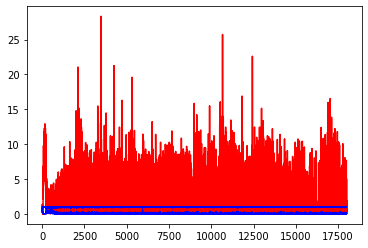

white ratio : 50.5
min : 184
max : 218


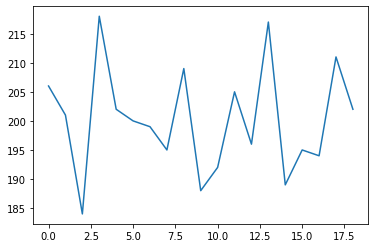

Generating interpolations...
18001 [D loss: 0.003330, acc.: 100.00%] [G loss: 2.530936, 1.619739]
18002 [D loss: 0.003350, acc.: 100.00%] [G loss: 0.000742, 0.000295]
18003 [D loss: 0.001496, acc.: 100.00%] [G loss: 0.241043, 0.145864]
18004 [D loss: 0.002558, acc.: 100.00%] [G loss: 0.080527, 0.025162]
18005 [D loss: 0.001626, acc.: 100.00%] [G loss: 4.973443, 4.426833]
18006 [D loss: 0.017248, acc.: 100.00%] [G loss: 0.020342, 0.029910]
18007 [D loss: 0.044181, acc.: 96.88%] [G loss: 0.007992, 0.006549]
18008 [D loss: 0.005283, acc.: 100.00%] [G loss: 0.000012, 0.000010]
18009 [D loss: 0.043281, acc.: 96.88%] [G loss: 0.000251, 0.000831]
18010 [D loss: 0.025795, acc.: 96.88%] [G loss: 1.017383, 0.000002]
18011 [D loss: 0.022557, acc.: 100.00%] [G loss: 0.000320, 0.000731]
18012 [D loss: 0.000050, acc.: 100.00%] [G loss: 1.122024, 1.188038]
18013 [D loss: 0.010499, acc.: 100.00%] [G loss: 3.779091, 2.894351]
18014 [D loss: 0.005871, acc.: 100.00%] [G loss: 0.007275, 0.002576]
18015 [D

18123 [D loss: 0.077666, acc.: 96.88%] [G loss: 1.505773, 0.128585]
18124 [D loss: 0.093399, acc.: 93.75%] [G loss: 0.000020, 0.000020]
18125 [D loss: 0.005029, acc.: 100.00%] [G loss: 0.239259, 0.047101]
18126 [D loss: 0.098093, acc.: 93.75%] [G loss: 0.000000, 0.000000]
18127 [D loss: 0.063075, acc.: 96.88%] [G loss: 0.012264, 0.007390]
18128 [D loss: 0.006955, acc.: 100.00%] [G loss: 0.000000, 0.000001]
18129 [D loss: 0.092681, acc.: 96.88%] [G loss: 0.000000, 0.000000]
18130 [D loss: 0.005890, acc.: 100.00%] [G loss: 0.000045, 0.000302]
18131 [D loss: 0.075011, acc.: 93.75%] [G loss: 1.522409, 0.824205]
18132 [D loss: 0.003725, acc.: 100.00%] [G loss: 5.198744, 4.334116]
18133 [D loss: 0.002352, acc.: 100.00%] [G loss: 0.000000, 0.000000]
18134 [D loss: 0.003311, acc.: 100.00%] [G loss: 6.155761, 2.476637]
18135 [D loss: 0.003562, acc.: 100.00%] [G loss: 0.000139, 0.000803]
18136 [D loss: 0.001233, acc.: 100.00%] [G loss: 0.438595, 0.315599]
18137 [D loss: 0.000772, acc.: 100.00%] 

18244 [D loss: 0.017829, acc.: 100.00%] [G loss: 2.647227, 1.382835]
18245 [D loss: 0.050978, acc.: 96.88%] [G loss: 2.415840, 0.974216]
18246 [D loss: 0.001219, acc.: 100.00%] [G loss: 0.000812, 0.002207]
18247 [D loss: 0.042140, acc.: 96.88%] [G loss: 0.003495, 0.003104]
18248 [D loss: 0.001227, acc.: 100.00%] [G loss: 0.066289, 0.080357]
18249 [D loss: 0.011538, acc.: 100.00%] [G loss: 0.180965, 0.089523]
18250 [D loss: 0.009151, acc.: 100.00%] [G loss: 2.764181, 1.551025]
18251 [D loss: 0.001875, acc.: 100.00%] [G loss: 7.994817, 1.859362]
18252 [D loss: 0.001182, acc.: 100.00%] [G loss: 0.016390, 0.030136]
18253 [D loss: 0.000504, acc.: 100.00%] [G loss: 3.204177, 0.255236]
18254 [D loss: 0.003565, acc.: 100.00%] [G loss: 1.252565, 0.701432]
18255 [D loss: 0.001328, acc.: 100.00%] [G loss: 0.035053, 0.055011]
18256 [D loss: 0.002618, acc.: 100.00%] [G loss: 0.003313, 0.026508]
18257 [D loss: 0.000802, acc.: 100.00%] [G loss: 0.194771, 0.002661]
18258 [D loss: 0.001830, acc.: 100.0

18363 [D loss: 0.009180, acc.: 100.00%] [G loss: 6.021218, 1.605634]
18364 [D loss: 0.001215, acc.: 100.00%] [G loss: 0.031358, 0.016393]
18365 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.043428, 0.004229]
18366 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.553034, 0.043318]
18367 [D loss: 0.000651, acc.: 100.00%] [G loss: 0.005396, 0.032052]
18368 [D loss: 0.001136, acc.: 100.00%] [G loss: 1.064042, 0.186801]
18369 [D loss: 0.000308, acc.: 100.00%] [G loss: 0.000063, 0.000739]
18370 [D loss: 0.023847, acc.: 96.88%] [G loss: 0.006248, 0.004191]
18371 [D loss: 0.000327, acc.: 100.00%] [G loss: 0.455843, 0.269224]
18372 [D loss: 0.008748, acc.: 100.00%] [G loss: 0.014844, 0.015829]
18373 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.708538, 0.004540]
18374 [D loss: 0.002001, acc.: 100.00%] [G loss: 0.242070, 0.040852]
18375 [D loss: 0.228007, acc.: 96.88%] [G loss: 0.000233, 0.000113]
18376 [D loss: 0.021016, acc.: 100.00%] [G loss: 1.312627, 0.961312]
18377 [D loss: 0.079532, acc.: 96.88

18485 [D loss: 0.027899, acc.: 96.88%] [G loss: 0.478500, 0.225832]
18486 [D loss: 0.000702, acc.: 100.00%] [G loss: 4.406790, 3.403363]
18487 [D loss: 0.001248, acc.: 100.00%] [G loss: 0.004217, 0.001747]
18488 [D loss: 0.006920, acc.: 100.00%] [G loss: 2.128824, 0.884846]
18489 [D loss: 0.001355, acc.: 100.00%] [G loss: 1.325302, 0.290433]
18490 [D loss: 0.006423, acc.: 100.00%] [G loss: 0.243551, 0.256387]
18491 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.173145, 0.049578]
18492 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.044934, 0.057666]
18493 [D loss: 0.001356, acc.: 100.00%] [G loss: 0.008129, 0.014900]
18494 [D loss: 0.001531, acc.: 100.00%] [G loss: 0.000051, 0.000024]
18495 [D loss: 0.005288, acc.: 100.00%] [G loss: 0.002139, 0.003609]
18496 [D loss: 0.175858, acc.: 93.75%] [G loss: 0.002839, 0.002372]
18497 [D loss: 0.003277, acc.: 100.00%] [G loss: 0.000762, 0.000707]
18498 [D loss: 0.007152, acc.: 100.00%] [G loss: 0.001835, 0.000666]
18499 [D loss: 0.001512, acc.: 100.0

18606 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.169319, 0.082779]
18607 [D loss: 0.001505, acc.: 100.00%] [G loss: 4.409014, 2.624779]
18608 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.681483, 0.315221]
18609 [D loss: 0.001287, acc.: 100.00%] [G loss: 0.414308, 0.012535]
18610 [D loss: 0.094569, acc.: 96.88%] [G loss: 0.000139, 0.000038]
18611 [D loss: 0.000192, acc.: 100.00%] [G loss: 2.921788, 0.089608]
18612 [D loss: 0.003498, acc.: 100.00%] [G loss: 0.000887, 0.001499]
18613 [D loss: 0.001052, acc.: 100.00%] [G loss: 0.119410, 0.069131]
18614 [D loss: 0.000803, acc.: 100.00%] [G loss: 0.088161, 0.095503]
18615 [D loss: 0.003076, acc.: 100.00%] [G loss: 0.000469, 0.000308]
18616 [D loss: 0.002605, acc.: 100.00%] [G loss: 0.458699, 0.345735]
18617 [D loss: 0.001455, acc.: 100.00%] [G loss: 0.011973, 0.004480]
18618 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.270790, 0.128358]
18619 [D loss: 0.004442, acc.: 100.00%] [G loss: 0.012111, 0.014270]
18620 [D loss: 0.002230, acc.: 100.

18725 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.191420, 0.358754]
18726 [D loss: 0.001378, acc.: 100.00%] [G loss: 0.282891, 0.161714]
18727 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.211718, 0.134838]
18728 [D loss: 0.000736, acc.: 100.00%] [G loss: 0.449050, 0.282532]
18729 [D loss: 0.000680, acc.: 100.00%] [G loss: 0.011947, 0.025103]
18730 [D loss: 0.001842, acc.: 100.00%] [G loss: 0.066319, 0.061557]
18731 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.045820, 0.135369]
18732 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.243929, 0.040116]
18733 [D loss: 0.000688, acc.: 100.00%] [G loss: 0.079741, 0.052220]
18734 [D loss: 0.001231, acc.: 100.00%] [G loss: 0.009136, 0.014142]
18735 [D loss: 0.091744, acc.: 96.88%] [G loss: 0.000002, 0.000002]
18736 [D loss: 0.002242, acc.: 100.00%] [G loss: 0.000173, 0.000291]
18737 [D loss: 0.004307, acc.: 100.00%] [G loss: 0.009968, 0.005295]
18738 [D loss: 0.015263, acc.: 100.00%] [G loss: 0.000063, 0.000030]
18739 [D loss: 0.000124, acc.: 100.

18844 [D loss: 0.004044, acc.: 100.00%] [G loss: 5.612239, 5.612557]
18845 [D loss: 0.019089, acc.: 100.00%] [G loss: 0.092164, 0.073502]
18846 [D loss: 0.000312, acc.: 100.00%] [G loss: 5.853274, 5.130679]
18847 [D loss: 0.000405, acc.: 100.00%] [G loss: 0.515355, 0.206654]
18848 [D loss: 0.002863, acc.: 100.00%] [G loss: 0.899664, 0.357370]
18849 [D loss: 0.003564, acc.: 100.00%] [G loss: 1.306365, 0.597580]
18850 [D loss: 0.000077, acc.: 100.00%] [G loss: 3.071878, 5.189693]
18851 [D loss: 0.000147, acc.: 100.00%] [G loss: 2.190217, 2.082853]
18852 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.587529, 0.479929]
18853 [D loss: 0.007048, acc.: 100.00%] [G loss: 4.271380, 3.102004]
18854 [D loss: 0.001548, acc.: 100.00%] [G loss: 2.161987, 0.284240]
18855 [D loss: 0.000613, acc.: 100.00%] [G loss: 0.182531, 0.112932]
18856 [D loss: 0.001371, acc.: 100.00%] [G loss: 5.289842, 1.638758]
18857 [D loss: 0.033875, acc.: 96.88%] [G loss: 1.554785, 0.636847]
18858 [D loss: 0.000208, acc.: 100.

18963 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.211361, 0.288691]
18964 [D loss: 0.000404, acc.: 100.00%] [G loss: 5.450469, 1.035706]
18965 [D loss: 0.003244, acc.: 100.00%] [G loss: 0.183559, 0.181758]
18966 [D loss: 0.000033, acc.: 100.00%] [G loss: 2.001440, 1.592667]
18967 [D loss: 0.000376, acc.: 100.00%] [G loss: 7.388780, 6.976563]
18968 [D loss: 0.001236, acc.: 100.00%] [G loss: 4.969679, 3.987911]
18969 [D loss: 0.000411, acc.: 100.00%] [G loss: 0.183250, 0.049375]
18970 [D loss: 0.000877, acc.: 100.00%] [G loss: 0.227779, 0.065672]
18971 [D loss: 0.001041, acc.: 100.00%] [G loss: 0.028759, 0.030651]
18972 [D loss: 0.009404, acc.: 100.00%] [G loss: 6.477603, 6.977270]
18973 [D loss: 0.000219, acc.: 100.00%] [G loss: 2.786327, 1.855178]
18974 [D loss: 0.000112, acc.: 100.00%] [G loss: 4.459020, 4.040347]
18975 [D loss: 0.003389, acc.: 100.00%] [G loss: 4.697457, 0.782258]
18976 [D loss: 0.009357, acc.: 100.00%] [G loss: 7.247366, 6.030129]
18977 [D loss: 0.001240, acc.: 100

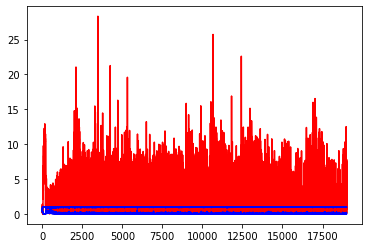

white ratio : 48.0
min : 184
max : 218


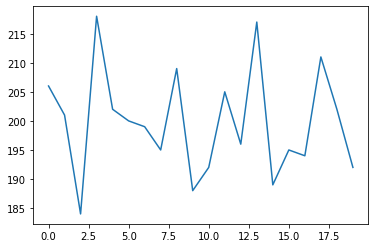

Generating interpolations...
19001 [D loss: 0.002250, acc.: 100.00%] [G loss: 0.455681, 0.286157]
19002 [D loss: 0.002114, acc.: 100.00%] [G loss: 7.086020, 7.238128]
19003 [D loss: 0.031560, acc.: 96.88%] [G loss: 2.111950, 1.365742]
19004 [D loss: 0.020594, acc.: 100.00%] [G loss: 16.234703, 4.832995]
19005 [D loss: 0.001470, acc.: 100.00%] [G loss: 3.551686, 2.566599]
19006 [D loss: 0.001588, acc.: 100.00%] [G loss: 7.001129, 5.440751]
19007 [D loss: 0.000276, acc.: 100.00%] [G loss: 7.183949, 5.507213]
19008 [D loss: 0.000906, acc.: 100.00%] [G loss: 4.116036, 2.904725]
19009 [D loss: 0.000257, acc.: 100.00%] [G loss: 2.168550, 5.222445]
19010 [D loss: 0.000590, acc.: 100.00%] [G loss: 5.666139, 3.860903]
19011 [D loss: 0.000162, acc.: 100.00%] [G loss: 12.544692, 7.593515]
19012 [D loss: 0.003845, acc.: 100.00%] [G loss: 21.022268, 4.283134]
19013 [D loss: 0.000396, acc.: 100.00%] [G loss: 11.712061, 11.078629]
19014 [D loss: 0.000042, acc.: 100.00%] [G loss: 7.009577, 5.916281]
1

19121 [D loss: 0.015047, acc.: 100.00%] [G loss: 2.114770, 0.576949]
19122 [D loss: 0.009529, acc.: 100.00%] [G loss: 4.730309, 3.547956]
19123 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.032188, 0.021945]
19124 [D loss: 0.000250, acc.: 100.00%] [G loss: 10.673644, 0.054085]
19125 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.835986, 4.324928]
19126 [D loss: 0.000032, acc.: 100.00%] [G loss: 6.119797, 5.040201]
19127 [D loss: 0.005881, acc.: 100.00%] [G loss: 3.465784, 1.734136]
19128 [D loss: 0.007098, acc.: 100.00%] [G loss: 1.254019, 0.896938]
19129 [D loss: 0.001451, acc.: 100.00%] [G loss: 7.040766, 6.000154]
19130 [D loss: 0.001022, acc.: 100.00%] [G loss: 6.635462, 1.177290]
19131 [D loss: 0.000275, acc.: 100.00%] [G loss: 5.873953, 5.366260]
19132 [D loss: 0.000012, acc.: 100.00%] [G loss: 9.180672, 8.018799]
19133 [D loss: 0.000196, acc.: 100.00%] [G loss: 13.652914, 4.807266]
19134 [D loss: 0.003744, acc.: 100.00%] [G loss: 3.182056, 1.490109]
19135 [D loss: 0.000557, acc.: 1

19241 [D loss: 0.000082, acc.: 100.00%] [G loss: 4.330902, 2.433959]
19242 [D loss: 0.000622, acc.: 100.00%] [G loss: 5.186648, 3.290464]
19243 [D loss: 0.007069, acc.: 100.00%] [G loss: 0.402621, 0.469788]
19244 [D loss: 0.001149, acc.: 100.00%] [G loss: 2.108088, 1.419722]
19245 [D loss: 0.000400, acc.: 100.00%] [G loss: 4.640488, 4.126913]
19246 [D loss: 0.000274, acc.: 100.00%] [G loss: 8.959596, 7.969534]
19247 [D loss: 0.000357, acc.: 100.00%] [G loss: 8.522524, 5.642705]
19248 [D loss: 0.000248, acc.: 100.00%] [G loss: 3.542835, 2.731402]
19249 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000110, 0.007720]
19250 [D loss: 0.000334, acc.: 100.00%] [G loss: 3.044240, 2.482536]
19251 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.134495, 0.014505]
19252 [D loss: 0.000011, acc.: 100.00%] [G loss: 6.824477, 5.783211]
19253 [D loss: 0.019775, acc.: 100.00%] [G loss: 8.877922, 3.793838]
19254 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.284254, 3.780311]
19255 [D loss: 0.000000, acc.: 100

19360 [D loss: 0.001188, acc.: 100.00%] [G loss: 6.986850, 6.680155]
19361 [D loss: 0.000897, acc.: 100.00%] [G loss: 0.533110, 0.629459]
19362 [D loss: 0.000893, acc.: 100.00%] [G loss: 2.441256, 1.365482]
19363 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.053627, 0.054309]
19364 [D loss: 0.000550, acc.: 100.00%] [G loss: 21.923023, 0.028004]
19365 [D loss: 0.005000, acc.: 100.00%] [G loss: 1.531219, 1.676213]
19366 [D loss: 0.000578, acc.: 100.00%] [G loss: 6.613005, 6.494577]
19367 [D loss: 0.000276, acc.: 100.00%] [G loss: 3.431492, 1.689881]
19368 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.702996, 0.381035]
19369 [D loss: 0.000562, acc.: 100.00%] [G loss: 0.000520, 0.002353]
19370 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.000944, 0.016980]
19371 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.029324, 0.017679]
19372 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.744611, 1.936308]
19373 [D loss: 0.001271, acc.: 100.00%] [G loss: 11.246668, 0.507472]
19374 [D loss: 0.000027, acc.: 1

19481 [D loss: 0.000087, acc.: 100.00%] [G loss: 13.807613, 13.435408]
19482 [D loss: 0.000259, acc.: 100.00%] [G loss: 10.420959, 2.685149]
19483 [D loss: 0.000040, acc.: 100.00%] [G loss: 9.637344, 8.107588]
19484 [D loss: 0.000243, acc.: 100.00%] [G loss: 15.268040, 13.310329]
19485 [D loss: 0.038957, acc.: 96.88%] [G loss: 6.999332, 6.387002]
19486 [D loss: 0.000402, acc.: 100.00%] [G loss: 12.185705, 12.019467]
19487 [D loss: 0.003897, acc.: 100.00%] [G loss: 10.412261, 9.714300]
19488 [D loss: 0.000058, acc.: 100.00%] [G loss: 10.633577, 9.972109]
19489 [D loss: 0.016128, acc.: 100.00%] [G loss: 8.414377, 6.951016]
19490 [D loss: 0.000606, acc.: 100.00%] [G loss: 4.000126, 2.006380]
19491 [D loss: 0.000145, acc.: 100.00%] [G loss: 17.134968, 9.482684]
19492 [D loss: 0.000200, acc.: 100.00%] [G loss: 5.751756, 3.771621]
19493 [D loss: 0.028572, acc.: 96.88%] [G loss: 0.225082, 0.229716]
19494 [D loss: 0.000017, acc.: 100.00%] [G loss: 24.924957, 9.888624]
19495 [D loss: 0.029304, 

19600 [D loss: 0.000097, acc.: 100.00%] [G loss: 9.344953, 8.936515]
19601 [D loss: 0.000783, acc.: 100.00%] [G loss: 8.386221, 9.753021]
19602 [D loss: 0.000348, acc.: 100.00%] [G loss: 2.308464, 1.018556]
19603 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.147273, 0.044711]
19604 [D loss: 0.000152, acc.: 100.00%] [G loss: 18.137362, 10.457474]
19605 [D loss: 0.000371, acc.: 100.00%] [G loss: 9.086073, 8.867564]
19606 [D loss: 0.000420, acc.: 100.00%] [G loss: 4.312167, 3.046653]
19607 [D loss: 0.000121, acc.: 100.00%] [G loss: 5.079468, 3.398541]
19608 [D loss: 0.000298, acc.: 100.00%] [G loss: 0.047160, 0.038073]
19609 [D loss: 0.011677, acc.: 100.00%] [G loss: 0.934311, 0.563732]
19610 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.550015, 0.501234]
19611 [D loss: 0.003705, acc.: 100.00%] [G loss: 4.368563, 3.939199]
19612 [D loss: 0.000403, acc.: 100.00%] [G loss: 10.552900, 3.216317]
19613 [D loss: 0.001313, acc.: 100.00%] [G loss: 3.740850, 1.231554]
19614 [D loss: 0.000036, acc.: 

19722 [D loss: 0.000057, acc.: 100.00%] [G loss: 12.790109, 9.427437]
19723 [D loss: 0.000807, acc.: 100.00%] [G loss: 4.920908, 8.412060]
19724 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.204597, 7.087154]
19725 [D loss: 0.015249, acc.: 100.00%] [G loss: 9.673374, 8.676666]
19726 [D loss: 0.000036, acc.: 100.00%] [G loss: 6.546500, 5.603894]
19727 [D loss: 0.000632, acc.: 100.00%] [G loss: 6.300249, 5.315410]
19728 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.225969, 9.180074]
19729 [D loss: 0.003657, acc.: 100.00%] [G loss: 4.152228, 3.081863]
19730 [D loss: 0.072455, acc.: 96.88%] [G loss: 2.152719, 0.000806]
19731 [D loss: 0.000513, acc.: 100.00%] [G loss: 6.034268, 5.654148]
19732 [D loss: 0.000255, acc.: 100.00%] [G loss: 6.636731, 5.921751]
19733 [D loss: 0.002327, acc.: 100.00%] [G loss: 6.517241, 8.501106]
19734 [D loss: 0.026857, acc.: 96.88%] [G loss: 5.104783, 3.112635]
19735 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.041779, 0.211500]
19736 [D loss: 0.000487, acc.: 100.

19844 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.467156, 0.309066]
19845 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.000004, 0.000001]
19846 [D loss: 0.033015, acc.: 96.88%] [G loss: 0.969601, 0.388423]
19847 [D loss: 0.000415, acc.: 100.00%] [G loss: 0.211503, 0.011978]
19848 [D loss: 0.003665, acc.: 100.00%] [G loss: 0.000000, 0.000000]
19849 [D loss: 0.000222, acc.: 100.00%] [G loss: 17.212711, 0.126333]
19850 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.011184, 0.029209]
19851 [D loss: 0.001214, acc.: 100.00%] [G loss: 0.471232, 0.472178]
19852 [D loss: 0.003750, acc.: 100.00%] [G loss: 4.034194, 3.785045]
19853 [D loss: 0.000840, acc.: 100.00%] [G loss: 0.582370, 0.437892]
19854 [D loss: 0.002782, acc.: 100.00%] [G loss: 3.728966, 0.912706]
19855 [D loss: 0.001473, acc.: 100.00%] [G loss: 0.823916, 0.318865]
19856 [D loss: 0.006777, acc.: 100.00%] [G loss: 5.845078, 0.000632]
19857 [D loss: 0.000841, acc.: 100.00%] [G loss: 3.398580, 3.693932]
19858 [D loss: 0.001564, acc.: 100

19963 [D loss: 0.000325, acc.: 100.00%] [G loss: 2.999835, 2.367353]
19964 [D loss: 0.000763, acc.: 100.00%] [G loss: 2.381192, 4.615627]
19965 [D loss: 0.000055, acc.: 100.00%] [G loss: 6.396299, 6.584692]
19966 [D loss: 0.000991, acc.: 100.00%] [G loss: 36.064468, 0.304436]
19967 [D loss: 0.000174, acc.: 100.00%] [G loss: 6.675013, 6.129140]
19968 [D loss: 0.000584, acc.: 100.00%] [G loss: 0.823978, 0.420814]
19969 [D loss: 0.000233, acc.: 100.00%] [G loss: 3.047699, 2.693061]
19970 [D loss: 0.000049, acc.: 100.00%] [G loss: 3.512789, 2.230141]
19971 [D loss: 0.000420, acc.: 100.00%] [G loss: 13.258156, 3.616710]
19972 [D loss: 0.000101, acc.: 100.00%] [G loss: 5.775033, 5.573620]
19973 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.152936, 0.566010]
19974 [D loss: 0.000101, acc.: 100.00%] [G loss: 5.675786, 4.390100]
19975 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.084957, 0.723054]
19976 [D loss: 0.000055, acc.: 100.00%] [G loss: 5.190759, 3.534528]
19977 [D loss: 0.000971, acc.: 1

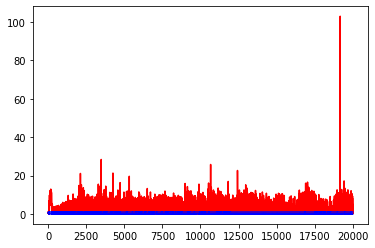

white ratio : 47.75
min : 184
max : 218


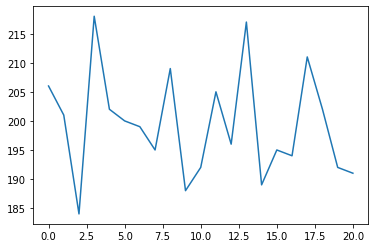

Generating interpolations...
20001 [D loss: 0.003728, acc.: 100.00%] [G loss: 3.899819, 1.621914]
20002 [D loss: 0.000054, acc.: 100.00%] [G loss: 4.219288, 4.802511]
20003 [D loss: 0.000098, acc.: 100.00%] [G loss: 18.749163, 9.631756]
20004 [D loss: 0.001815, acc.: 100.00%] [G loss: 7.264144, 5.701973]
20005 [D loss: 0.006855, acc.: 100.00%] [G loss: 9.692642, 9.303589]
20006 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.005024, 0.007282]
20007 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.006291, 0.001110]
20008 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.010980, 0.002537]
20009 [D loss: 0.000228, acc.: 100.00%] [G loss: 20.085049, 0.003233]
20010 [D loss: 0.000034, acc.: 100.00%] [G loss: 7.715689, 7.003820]
20011 [D loss: 0.188640, acc.: 96.88%] [G loss: 6.646552, 5.938302]
20012 [D loss: 0.023097, acc.: 100.00%] [G loss: 7.369720, 5.986449]
20013 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.055115, 0.037539]
20014 [D loss: 0.000713, acc.: 100.00%] [G loss: 6.862071, 7.813919]
2001

20119 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.310157, 0.176222]
20120 [D loss: 0.000298, acc.: 100.00%] [G loss: 0.000055, 0.001319]
20121 [D loss: 0.001849, acc.: 100.00%] [G loss: 0.767299, 0.051665]
20122 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.035107, 0.012526]
20123 [D loss: 0.000329, acc.: 100.00%] [G loss: 0.801356, 0.201769]
20124 [D loss: 0.000034, acc.: 100.00%] [G loss: 15.830027, 2.959778]
20125 [D loss: 0.002999, acc.: 100.00%] [G loss: 0.000008, 0.000141]
20126 [D loss: 0.000185, acc.: 100.00%] [G loss: 5.352874, 4.151408]
20127 [D loss: 0.007797, acc.: 100.00%] [G loss: 0.473317, 0.035060]
20128 [D loss: 0.004805, acc.: 100.00%] [G loss: 5.083405, 0.128530]
20129 [D loss: 0.000346, acc.: 100.00%] [G loss: 0.007528, 0.009140]
20130 [D loss: 0.000093, acc.: 100.00%] [G loss: 9.575127, 0.306588]
20131 [D loss: 0.003076, acc.: 100.00%] [G loss: 0.336804, 0.502202]
20132 [D loss: 0.000077, acc.: 100.00%] [G loss: 13.667938, 0.804756]
20133 [D loss: 0.000027, acc.: 1

20240 [D loss: 0.000101, acc.: 100.00%] [G loss: 1.171280, 0.138299]
20241 [D loss: 0.005081, acc.: 100.00%] [G loss: 3.231282, 0.023321]
20242 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.389669, 0.111907]
20243 [D loss: 0.000287, acc.: 100.00%] [G loss: 9.894491, 0.120931]
20244 [D loss: 0.000178, acc.: 100.00%] [G loss: 4.163688, 2.736115]
20245 [D loss: 0.000163, acc.: 100.00%] [G loss: 7.805281, 6.743948]
20246 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000002, 0.134332]
20247 [D loss: 0.000044, acc.: 100.00%] [G loss: 4.625284, 3.781276]
20248 [D loss: 0.000342, acc.: 100.00%] [G loss: 23.592670, 0.010841]
20249 [D loss: 0.092692, acc.: 93.75%] [G loss: 0.031688, 0.188900]
20250 [D loss: 0.000672, acc.: 100.00%] [G loss: 3.964307, 3.359349]
20251 [D loss: 0.031117, acc.: 100.00%] [G loss: 1.553632, 0.666207]
20252 [D loss: 0.003131, acc.: 100.00%] [G loss: 8.697065, 8.538114]
20253 [D loss: 0.000115, acc.: 100.00%] [G loss: 9.915149, 1.795188]
20254 [D loss: 0.000987, acc.: 100

20359 [D loss: 0.310359, acc.: 96.88%] [G loss: 24.074520, 0.109557]
20360 [D loss: 0.000014, acc.: 100.00%] [G loss: 4.210330, 4.040730]
20361 [D loss: 0.000015, acc.: 100.00%] [G loss: 4.812253, 3.727966]
20362 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.782155, 3.784745]
20363 [D loss: 0.000174, acc.: 100.00%] [G loss: 1.350096, 0.773550]
20364 [D loss: 0.000067, acc.: 100.00%] [G loss: 1.034703, 0.219335]
20365 [D loss: 0.000324, acc.: 100.00%] [G loss: 49.312027, 3.102601]
20366 [D loss: 0.028933, acc.: 96.88%] [G loss: 0.002907, 0.267124]
20367 [D loss: 0.000778, acc.: 100.00%] [G loss: 6.875611, 6.223248]
20368 [D loss: 0.000578, acc.: 100.00%] [G loss: 1.284802, 1.629993]
20369 [D loss: 0.000559, acc.: 100.00%] [G loss: 0.242670, 0.486367]
20370 [D loss: 0.000021, acc.: 100.00%] [G loss: 7.354362, 6.000241]
20371 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.028806, 0.563180]
20372 [D loss: 0.000093, acc.: 100.00%] [G loss: 5.632754, 4.325614]
20373 [D loss: 0.000016, acc.: 100

20479 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.000538, 0.000093]
20480 [D loss: 0.000603, acc.: 100.00%] [G loss: 3.447499, 2.188373]
20481 [D loss: 0.000670, acc.: 100.00%] [G loss: 0.667757, 0.000609]
20482 [D loss: 0.001037, acc.: 100.00%] [G loss: 0.000138, 0.000751]
20483 [D loss: 0.001538, acc.: 100.00%] [G loss: 6.810266, 6.282946]
20484 [D loss: 0.011319, acc.: 100.00%] [G loss: 0.000284, 0.000538]
20485 [D loss: 0.005463, acc.: 100.00%] [G loss: 1.830117, 1.640957]
20486 [D loss: 0.002961, acc.: 100.00%] [G loss: 2.541604, 0.128306]
20487 [D loss: 0.004316, acc.: 100.00%] [G loss: 0.013621, 0.118446]
20488 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.019114, 0.004150]
20489 [D loss: 0.000438, acc.: 100.00%] [G loss: 7.199810, 7.022843]
20490 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.474113, 0.052422]
20491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001211, 0.001087]
20492 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.268612, 6.563732]
20493 [D loss: 0.000094, acc.: 100

20598 [D loss: 0.000091, acc.: 100.00%] [G loss: 19.904585, 6.293902]
20599 [D loss: 0.000390, acc.: 100.00%] [G loss: 7.492273, 7.423122]
20600 [D loss: 0.001631, acc.: 100.00%] [G loss: 3.022980, 1.811347]
20601 [D loss: 0.294696, acc.: 96.88%] [G loss: 29.009350, 0.271924]
20602 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.099764, 0.045010]
20603 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.069239, 0.149647]
20604 [D loss: 0.000171, acc.: 100.00%] [G loss: 2.333020, 1.359179]
20605 [D loss: 0.000270, acc.: 100.00%] [G loss: 1.173304, 0.968183]
20606 [D loss: 0.002560, acc.: 100.00%] [G loss: 1.017772, 0.455570]
20607 [D loss: 0.000650, acc.: 100.00%] [G loss: 0.262127, 0.087596]
20608 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.002402, 0.001287]
20609 [D loss: 0.001939, acc.: 100.00%] [G loss: 2.766426, 2.740449]
20610 [D loss: 0.007430, acc.: 100.00%] [G loss: 3.001088, 1.558425]
20611 [D loss: 0.002361, acc.: 100.00%] [G loss: 20.327425, 4.404285]
20612 [D loss: 0.000156, acc.: 1

20719 [D loss: 0.000043, acc.: 100.00%] [G loss: 3.675945, 1.997345]
20720 [D loss: 0.000058, acc.: 100.00%] [G loss: 2.085157, 1.269218]
20721 [D loss: 0.000690, acc.: 100.00%] [G loss: 0.784037, 0.082199]
20722 [D loss: 0.001114, acc.: 100.00%] [G loss: 0.263012, 0.175287]
20723 [D loss: 0.028920, acc.: 100.00%] [G loss: 0.610074, 0.614534]
20724 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.223311, 0.530114]
20725 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.122501, 0.327291]
20726 [D loss: 0.000040, acc.: 100.00%] [G loss: 6.508989, 7.038118]
20727 [D loss: 0.003283, acc.: 100.00%] [G loss: 3.668271, 2.572014]
20728 [D loss: 0.000559, acc.: 100.00%] [G loss: 0.784592, 0.000334]
20729 [D loss: 0.000046, acc.: 100.00%] [G loss: 3.221917, 1.416023]
20730 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.135662, 0.267129]
20731 [D loss: 0.000153, acc.: 100.00%] [G loss: 8.498173, 7.473415]
20732 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.563136, 0.530570]
20733 [D loss: 0.000215, acc.: 100

20838 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.180863, 8.168429]
20839 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.379951, 0.350629]
20840 [D loss: 0.000040, acc.: 100.00%] [G loss: 3.958211, 0.301480]
20841 [D loss: 0.000031, acc.: 100.00%] [G loss: 2.186711, 1.752566]
20842 [D loss: 0.000963, acc.: 100.00%] [G loss: 0.912776, 0.606391]
20843 [D loss: 0.002471, acc.: 100.00%] [G loss: 2.954964, 1.479717]
20844 [D loss: 0.000659, acc.: 100.00%] [G loss: 1.618776, 10.871719]
20845 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.297622, 0.866800]
20846 [D loss: 0.089466, acc.: 96.88%] [G loss: 6.618751, 5.770586]
20847 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.103447, 0.015315]
20848 [D loss: 0.000240, acc.: 100.00%] [G loss: 7.633178, 7.291233]
20849 [D loss: 0.002402, acc.: 100.00%] [G loss: 0.018470, 0.079660]
20850 [D loss: 0.003930, acc.: 100.00%] [G loss: 9.533370, 7.417997]
20851 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.739282, 0.965691]
20852 [D loss: 0.000758, acc.: 100

20959 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.209131, 0.081959]
20960 [D loss: 0.001313, acc.: 100.00%] [G loss: 1.473194, 0.512823]
20961 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.578870, 1.686653]
20962 [D loss: 0.000479, acc.: 100.00%] [G loss: 0.376750, 0.261180]
20963 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.040528, 0.043145]
20964 [D loss: 0.000307, acc.: 100.00%] [G loss: 4.539321, 4.011706]
20965 [D loss: 0.000085, acc.: 100.00%] [G loss: 4.106807, 0.083179]
20966 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.160289, 0.069681]
20967 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.445114, 6.209333]
20968 [D loss: 0.001908, acc.: 100.00%] [G loss: 2.400999, 0.119213]
20969 [D loss: 0.000527, acc.: 100.00%] [G loss: 7.200973, 7.432711]
20970 [D loss: 0.000322, acc.: 100.00%] [G loss: 4.545291, 3.789724]
20971 [D loss: 0.000639, acc.: 100.00%] [G loss: 0.135259, 0.245909]
20972 [D loss: 0.003181, acc.: 100.00%] [G loss: 5.286268, 4.958459]
20973 [D loss: 0.000106, acc.: 10

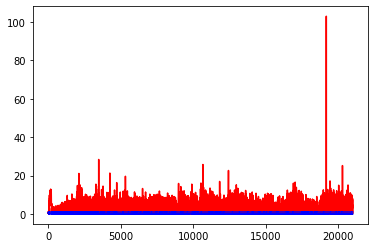

white ratio : 48.0
min : 184
max : 218


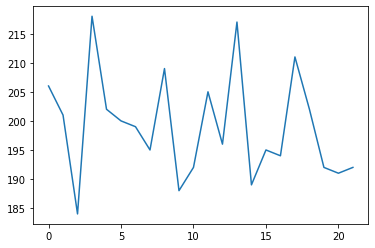

Generating interpolations...
21001 [D loss: 0.000230, acc.: 100.00%] [G loss: 6.388829, 5.356925]
21002 [D loss: 0.000115, acc.: 100.00%] [G loss: 7.732243, 6.983114]
21003 [D loss: 0.000099, acc.: 100.00%] [G loss: 1.504670, 0.852139]
21004 [D loss: 0.001249, acc.: 100.00%] [G loss: 7.541428, 6.581061]
21005 [D loss: 0.000268, acc.: 100.00%] [G loss: 4.061840, 2.982831]
21006 [D loss: 0.056159, acc.: 96.88%] [G loss: 0.168685, 0.368927]
21007 [D loss: 0.044597, acc.: 96.88%] [G loss: 0.031345, 0.025497]
21008 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.127018, 0.044309]
21009 [D loss: 0.002301, acc.: 100.00%] [G loss: 6.154840, 6.050065]
21010 [D loss: 0.228235, acc.: 93.75%] [G loss: 0.000087, 0.000376]
21011 [D loss: 0.002126, acc.: 100.00%] [G loss: 3.767284, 3.645411]
21012 [D loss: 0.001013, acc.: 100.00%] [G loss: 0.003965, 0.005655]
21013 [D loss: 0.002406, acc.: 100.00%] [G loss: 0.000001, 0.000002]
21014 [D loss: 0.002615, acc.: 100.00%] [G loss: 0.000015, 0.000151]
21015 [D

21122 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.867815, 0.049457]
21123 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.000005, 0.000025]
21124 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.758822, 0.245834]
21125 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.095235, 0.080282]
21126 [D loss: 0.000736, acc.: 100.00%] [G loss: 0.075730, 0.148732]
21127 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.491621, 0.995406]
21128 [D loss: 0.000108, acc.: 100.00%] [G loss: 1.056895, 0.743583]
21129 [D loss: 0.001951, acc.: 100.00%] [G loss: 0.186893, 0.160502]
21130 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.616518, 0.862537]
21131 [D loss: 0.000134, acc.: 100.00%] [G loss: 1.535990, 0.090888]
21132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.957449, 0.749590]
21133 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.953579, 0.917249]
21134 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.484433, 1.341692]
21135 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.975588, 0.674992]
21136 [D loss: 0.005990, acc.: 100

21243 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.270691, 2.019833]
21244 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.119410, 0.056741]
21245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.297360, 0.125692]
21246 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.408941, 0.755907]
21247 [D loss: 0.000467, acc.: 100.00%] [G loss: 7.952326, 2.119178]
21248 [D loss: 0.000825, acc.: 100.00%] [G loss: 0.041229, 0.007504]
21249 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.040616, 0.665002]
21250 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.178912, 0.817464]
21251 [D loss: 0.000271, acc.: 100.00%] [G loss: 1.146096, 1.286465]
21252 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.588567, 0.559341]
21253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.155580, 0.108742]
21254 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.221442, 0.171324]
21255 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.064363, 0.081654]
21256 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.542797, 0.473055]
21257 [D loss: 0.006713, acc.: 100

21362 [D loss: 0.001099, acc.: 100.00%] [G loss: 1.498294, 1.212014]
21363 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.368181, 2.724278]
21364 [D loss: 0.005867, acc.: 100.00%] [G loss: 0.839474, 0.974989]
21365 [D loss: 0.001213, acc.: 100.00%] [G loss: 0.334589, 0.181145]
21366 [D loss: 0.001452, acc.: 100.00%] [G loss: 0.484933, 0.485248]
21367 [D loss: 0.000235, acc.: 100.00%] [G loss: 1.197217, 1.290356]
21368 [D loss: 0.000451, acc.: 100.00%] [G loss: 0.087935, 0.040511]
21369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.155291, 0.126119]
21370 [D loss: 0.000812, acc.: 100.00%] [G loss: 1.538665, 0.012593]
21371 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.617085, 0.132103]
21372 [D loss: 0.085192, acc.: 96.88%] [G loss: 0.000050, 0.000069]
21373 [D loss: 0.026248, acc.: 100.00%] [G loss: 0.006499, 0.009219]
21374 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.067613, 0.116529]
21375 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.084302, 0.042189]
21376 [D loss: 0.000043, acc.: 100.

21484 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000097, 0.000244]
21485 [D loss: 0.001729, acc.: 100.00%] [G loss: 0.001217, 0.000148]
21486 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000150, 0.000024]
21487 [D loss: 0.001215, acc.: 100.00%] [G loss: 0.000073, 0.000334]
21488 [D loss: 0.009659, acc.: 100.00%] [G loss: 0.000059, 0.000088]
21489 [D loss: 0.000573, acc.: 100.00%] [G loss: 0.000002, 0.000000]
21490 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000006, 0.000008]
21491 [D loss: 0.001681, acc.: 100.00%] [G loss: 0.000004, 0.000003]
21492 [D loss: 0.001409, acc.: 100.00%] [G loss: 0.000916, 0.001578]
21493 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000133, 0.000214]
21494 [D loss: 0.000853, acc.: 100.00%] [G loss: 0.000060, 0.000045]
21495 [D loss: 0.009952, acc.: 100.00%] [G loss: 0.000120, 0.000044]
21496 [D loss: 0.001240, acc.: 100.00%] [G loss: 0.000161, 0.000310]
21497 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000717, 0.000633]
21498 [D loss: 0.000074, acc.: 100

21604 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.182668, 0.040272]
21605 [D loss: 0.000770, acc.: 100.00%] [G loss: 0.026801, 0.043294]
21606 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.030649, 0.005801]
21607 [D loss: 0.000699, acc.: 100.00%] [G loss: 0.010922, 0.001591]
21608 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.133116, 0.023884]
21609 [D loss: 0.002198, acc.: 100.00%] [G loss: 0.000174, 0.000248]
21610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.199721, 0.104590]
21611 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.776709, 0.011623]
21612 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.014295, 0.038040]
21613 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.063699, 0.062217]
21614 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.023659, 0.038492]
21615 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.008906, 0.001347]
21616 [D loss: 0.002925, acc.: 100.00%] [G loss: 0.480585, 0.285793]
21617 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.156088, 0.019535]
21618 [D loss: 0.000090, acc.: 100

21726 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.760827, 0.081165]
21727 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.746429, 0.809568]
21728 [D loss: 0.000424, acc.: 100.00%] [G loss: 0.020414, 0.004600]
21729 [D loss: 0.000125, acc.: 100.00%] [G loss: 1.171864, 0.392056]
21730 [D loss: 0.000825, acc.: 100.00%] [G loss: 2.340777, 0.894033]
21731 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.117692, 0.142524]
21732 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.405743, 0.364181]
21733 [D loss: 0.003052, acc.: 100.00%] [G loss: 0.001682, 0.003383]
21734 [D loss: 0.000317, acc.: 100.00%] [G loss: 0.225145, 0.278031]
21735 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.049739, 0.028663]
21736 [D loss: 0.000634, acc.: 100.00%] [G loss: 0.026178, 0.009486]
21737 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.490069, 0.570189]
21738 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.003992, 0.002530]
21739 [D loss: 0.007777, acc.: 100.00%] [G loss: 0.000624, 0.001022]
21740 [D loss: 0.000265, acc.: 100

21847 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.053418, 0.215825]
21848 [D loss: 0.011668, acc.: 100.00%] [G loss: 3.441048, 2.871724]
21849 [D loss: 0.000820, acc.: 100.00%] [G loss: 0.123659, 0.079221]
21850 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.037841, 6.127832]
21851 [D loss: 0.000015, acc.: 100.00%] [G loss: 3.979530, 3.252892]
21852 [D loss: 0.000405, acc.: 100.00%] [G loss: 1.838085, 0.427744]
21853 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.123178, 0.173392]
21854 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.824716, 1.716046]
21855 [D loss: 0.006522, acc.: 100.00%] [G loss: 3.948678, 2.384318]
21856 [D loss: 0.075726, acc.: 96.88%] [G loss: 0.001415, 0.000471]
21857 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.002171, 0.001200]
21858 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002030, 0.001663]
21859 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
21860 [D loss: 0.087877, acc.: 96.88%] [G loss: 0.235238, 0.048229]
21861 [D loss: 0.001384, acc.: 100.0

21968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.273407, 0.361040]
21969 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.000304, 0.000102]
21970 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025800, 0.001933]
21971 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.007394, 0.001735]
21972 [D loss: 0.000421, acc.: 100.00%] [G loss: 1.324574, 0.013543]
21973 [D loss: 0.000501, acc.: 100.00%] [G loss: 0.105854, 0.033569]
21974 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.002324, 0.000751]
21975 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.000001, 0.000001]
21976 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017088, 0.035267]
21977 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.036464, 0.028986]
21978 [D loss: 0.000769, acc.: 100.00%] [G loss: 0.000011, 0.000006]
21979 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.011952, 0.033847]
21980 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.037529, 0.120825]
21981 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000470, 0.000668]
21982 [D loss: 0.000081, acc.: 100

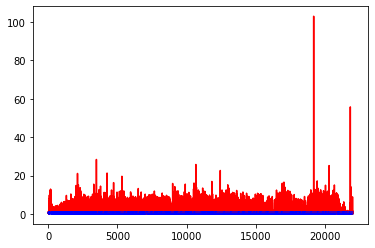

white ratio : 49.75
min : 184
max : 218


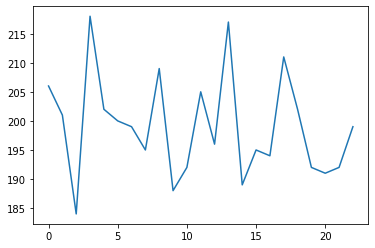

Generating interpolations...
22001 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.944755, 0.786521]
22002 [D loss: 0.000115, acc.: 100.00%] [G loss: 1.388158, 1.035187]
22003 [D loss: 0.000316, acc.: 100.00%] [G loss: 0.442214, 0.353213]
22004 [D loss: 0.000434, acc.: 100.00%] [G loss: 0.823525, 1.079951]
22005 [D loss: 0.000443, acc.: 100.00%] [G loss: 1.741450, 1.434162]
22006 [D loss: 0.000790, acc.: 100.00%] [G loss: 1.113933, 1.000487]
22007 [D loss: 0.001052, acc.: 100.00%] [G loss: 1.649475, 0.820455]
22008 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.324761, 0.397673]
22009 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.200841, 0.194548]
22010 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.542056, 0.237394]
22011 [D loss: 0.000413, acc.: 100.00%] [G loss: 0.126443, 0.356158]
22012 [D loss: 0.000956, acc.: 100.00%] [G loss: 0.347037, 0.198194]
22013 [D loss: 0.000919, acc.: 100.00%] [G loss: 0.383745, 0.410458]
22014 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.339408, 0.184561]
22015

22122 [D loss: 0.002637, acc.: 100.00%] [G loss: 1.091282, 1.390839]
22123 [D loss: 0.000244, acc.: 100.00%] [G loss: 9.501410, 4.855140]
22124 [D loss: 0.000101, acc.: 100.00%] [G loss: 5.827900, 3.041135]
22125 [D loss: 0.000426, acc.: 100.00%] [G loss: 5.899686, 4.864113]
22126 [D loss: 0.000012, acc.: 100.00%] [G loss: 6.699632, 5.224804]
22127 [D loss: 0.000192, acc.: 100.00%] [G loss: 2.658755, 0.818504]
22128 [D loss: 0.001936, acc.: 100.00%] [G loss: 4.104661, 1.881670]
22129 [D loss: 0.000322, acc.: 100.00%] [G loss: 0.262713, 0.043471]
22130 [D loss: 0.002167, acc.: 100.00%] [G loss: 1.150849, 0.544690]
22131 [D loss: 0.000656, acc.: 100.00%] [G loss: 7.232873, 2.992075]
22132 [D loss: 0.000905, acc.: 100.00%] [G loss: 4.374848, 1.788805]
22133 [D loss: 0.005215, acc.: 100.00%] [G loss: 1.769660, 0.609561]
22134 [D loss: 0.237429, acc.: 96.88%] [G loss: 0.004193, 0.000514]
22135 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.200412, 0.229064]
22136 [D loss: 0.002143, acc.: 100.

22244 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.090755, 11.788366]
22245 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.249882, 7.182368]
22246 [D loss: 0.000043, acc.: 100.00%] [G loss: 9.624069, 7.696361]
22247 [D loss: 0.002498, acc.: 100.00%] [G loss: 15.175152, 11.764458]
22248 [D loss: 0.000233, acc.: 100.00%] [G loss: 9.051353, 11.755041]
22249 [D loss: 0.000073, acc.: 100.00%] [G loss: 9.083845, 8.255768]
22250 [D loss: 0.180990, acc.: 96.88%] [G loss: 5.850813, 4.243076]
22251 [D loss: 0.001144, acc.: 100.00%] [G loss: 3.091506, 0.353734]
22252 [D loss: 0.000507, acc.: 100.00%] [G loss: 0.274777, 1.449775]
22253 [D loss: 0.000078, acc.: 100.00%] [G loss: 12.402313, 7.544354]
22254 [D loss: 0.076871, acc.: 96.88%] [G loss: 0.022339, 0.004545]
22255 [D loss: 0.141792, acc.: 96.88%] [G loss: 13.458790, 11.187836]
22256 [D loss: 0.000004, acc.: 100.00%] [G loss: 17.364948, 17.085421]
22257 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.112392, 18.587902]
22258 [D loss: 0.000001, 

22364 [D loss: 0.082370, acc.: 96.88%] [G loss: 1.885688, 0.733887]
22365 [D loss: 0.000964, acc.: 100.00%] [G loss: 5.819290, 2.736088]
22366 [D loss: 0.000761, acc.: 100.00%] [G loss: 6.557434, 5.230719]
22367 [D loss: 0.008516, acc.: 100.00%] [G loss: 1.128554, 0.342804]
22368 [D loss: 0.001788, acc.: 100.00%] [G loss: 8.770584, 7.678973]
22369 [D loss: 0.009047, acc.: 100.00%] [G loss: 6.301280, 5.967145]
22370 [D loss: 0.001279, acc.: 100.00%] [G loss: 9.615273, 8.730125]
22371 [D loss: 0.001673, acc.: 100.00%] [G loss: 9.874616, 4.871810]
22372 [D loss: 0.025270, acc.: 96.88%] [G loss: 6.280892, 5.738428]
22373 [D loss: 0.269229, acc.: 96.88%] [G loss: 10.101183, 10.444252]
22374 [D loss: 0.000174, acc.: 100.00%] [G loss: 6.473961, 5.781579]
22375 [D loss: 0.002370, acc.: 100.00%] [G loss: 1.447801, 0.330376]
22376 [D loss: 0.004861, acc.: 100.00%] [G loss: 0.065551, 0.005651]
22377 [D loss: 0.007012, acc.: 100.00%] [G loss: 3.270710, 1.916379]
22378 [D loss: 0.079288, acc.: 96.8

22484 [D loss: 0.099244, acc.: 96.88%] [G loss: 0.094641, 0.062776]
22485 [D loss: 0.000865, acc.: 100.00%] [G loss: 14.782885, 7.823317]
22486 [D loss: 0.000018, acc.: 100.00%] [G loss: 8.745644, 8.208895]
22487 [D loss: 0.000025, acc.: 100.00%] [G loss: 10.318504, 9.453053]
22488 [D loss: 0.182474, acc.: 96.88%] [G loss: 2.366694, 1.912504]
22489 [D loss: 0.000166, acc.: 100.00%] [G loss: 2.094486, 1.411415]
22490 [D loss: 0.000410, acc.: 100.00%] [G loss: 4.964872, 3.446305]
22491 [D loss: 0.001767, acc.: 100.00%] [G loss: 4.050059, 2.945646]
22492 [D loss: 0.000143, acc.: 100.00%] [G loss: 30.114491, 4.465624]
22493 [D loss: 0.000008, acc.: 100.00%] [G loss: 8.368347, 8.269181]
22494 [D loss: 0.070601, acc.: 96.88%] [G loss: 6.631727, 5.739059]
22495 [D loss: 0.000054, acc.: 100.00%] [G loss: 8.256180, 6.797156]
22496 [D loss: 0.000126, acc.: 100.00%] [G loss: 10.271515, 9.755194]
22497 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.100916, 4.879946]
22498 [D loss: 0.000138, acc.: 10

22604 [D loss: 0.000891, acc.: 100.00%] [G loss: 2.035470, 3.561026]
22605 [D loss: 0.000044, acc.: 100.00%] [G loss: 7.339829, 7.914196]
22606 [D loss: 0.000666, acc.: 100.00%] [G loss: 6.818108, 6.124035]
22607 [D loss: 0.000571, acc.: 100.00%] [G loss: 6.107743, 5.380073]
22608 [D loss: 0.171899, acc.: 96.88%] [G loss: 4.669821, 4.098160]
22609 [D loss: 0.001004, acc.: 100.00%] [G loss: 1.455181, 0.584489]
22610 [D loss: 0.001577, acc.: 100.00%] [G loss: 3.329102, 2.825410]
22611 [D loss: 0.001712, acc.: 100.00%] [G loss: 2.289607, 1.409050]
22612 [D loss: 0.066314, acc.: 96.88%] [G loss: 14.449991, 4.783339]
22613 [D loss: 0.004323, acc.: 100.00%] [G loss: 0.262308, 0.762736]
22614 [D loss: 0.174439, acc.: 96.88%] [G loss: 6.086587, 6.075703]
22615 [D loss: 0.017503, acc.: 100.00%] [G loss: 0.340122, 0.131000]
22616 [D loss: 0.003274, acc.: 100.00%] [G loss: 0.571928, 0.344577]
22617 [D loss: 0.004107, acc.: 100.00%] [G loss: 0.619174, 0.376682]
22618 [D loss: 0.006685, acc.: 100.0

22726 [D loss: 0.000293, acc.: 100.00%] [G loss: 5.049935, 4.803810]
22727 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.891275, 2.904540]
22728 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.804449, 3.675151]
22729 [D loss: 0.000677, acc.: 100.00%] [G loss: 9.230251, 8.425707]
22730 [D loss: 0.000021, acc.: 100.00%] [G loss: 3.739043, 2.569034]
22731 [D loss: 0.001763, acc.: 100.00%] [G loss: 1.378687, 0.426189]
22732 [D loss: 0.044286, acc.: 96.88%] [G loss: 0.000120, 0.000437]
22733 [D loss: 0.000173, acc.: 100.00%] [G loss: 1.135674, 0.938425]
22734 [D loss: 0.001004, acc.: 100.00%] [G loss: 5.229197, 4.825701]
22735 [D loss: 0.009757, acc.: 100.00%] [G loss: 0.078677, 0.033775]
22736 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.799266, 0.254967]
22737 [D loss: 0.000471, acc.: 100.00%] [G loss: 1.808903, 0.859425]
22738 [D loss: 0.002619, acc.: 100.00%] [G loss: 1.041665, 0.000845]
22739 [D loss: 0.000554, acc.: 100.00%] [G loss: 0.422867, 0.000938]
22740 [D loss: 0.000762, acc.: 100.

22847 [D loss: 0.003735, acc.: 100.00%] [G loss: 0.724242, 0.213643]
22848 [D loss: 0.011082, acc.: 100.00%] [G loss: 0.541174, 0.361364]
22849 [D loss: 0.001104, acc.: 100.00%] [G loss: 1.349401, 0.292594]
22850 [D loss: 0.017947, acc.: 100.00%] [G loss: 0.295060, 0.936762]
22851 [D loss: 0.027359, acc.: 96.88%] [G loss: 15.505172, 3.768778]
22852 [D loss: 0.000100, acc.: 100.00%] [G loss: 7.953266, 8.230534]
22853 [D loss: 0.000885, acc.: 100.00%] [G loss: 0.056934, 0.010419]
22854 [D loss: 0.000075, acc.: 100.00%] [G loss: 2.732308, 2.640878]
22855 [D loss: 0.000211, acc.: 100.00%] [G loss: 5.421133, 5.536148]
22856 [D loss: 0.000273, acc.: 100.00%] [G loss: 9.195710, 8.812511]
22857 [D loss: 0.011242, acc.: 100.00%] [G loss: 8.197441, 6.320067]
22858 [D loss: 0.005446, acc.: 100.00%] [G loss: 3.932990, 6.978214]
22859 [D loss: 0.000505, acc.: 100.00%] [G loss: 12.660091, 7.255663]
22860 [D loss: 0.000010, acc.: 100.00%] [G loss: 7.610832, 8.465447]
22861 [D loss: 0.000070, acc.: 10

22969 [D loss: 0.003529, acc.: 100.00%] [G loss: 7.255071, 0.494298]
22970 [D loss: 0.013574, acc.: 100.00%] [G loss: 0.690023, 0.809506]
22971 [D loss: 0.001282, acc.: 100.00%] [G loss: 0.495867, 0.532623]
22972 [D loss: 0.000647, acc.: 100.00%] [G loss: 0.075528, 0.031520]
22973 [D loss: 0.002638, acc.: 100.00%] [G loss: 2.676243, 1.661907]
22974 [D loss: 0.001112, acc.: 100.00%] [G loss: 0.129700, 0.114259]
22975 [D loss: 0.000873, acc.: 100.00%] [G loss: 4.213878, 4.204280]
22976 [D loss: 0.001663, acc.: 100.00%] [G loss: 6.615168, 6.354443]
22977 [D loss: 0.019327, acc.: 100.00%] [G loss: 0.035835, 0.096883]
22978 [D loss: 0.001709, acc.: 100.00%] [G loss: 0.417704, 0.278146]
22979 [D loss: 0.007383, acc.: 100.00%] [G loss: 2.448570, 5.877831]
22980 [D loss: 0.000393, acc.: 100.00%] [G loss: 4.984121, 4.777939]
22981 [D loss: 0.001878, acc.: 100.00%] [G loss: 3.722192, 3.581800]
22982 [D loss: 0.000604, acc.: 100.00%] [G loss: 1.725082, 1.897751]
22983 [D loss: 0.000613, acc.: 100

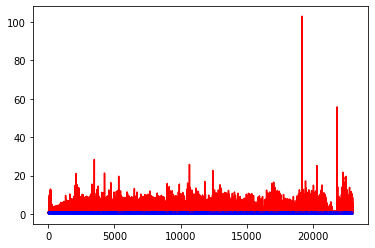

white ratio : 48.0
min : 184
max : 218


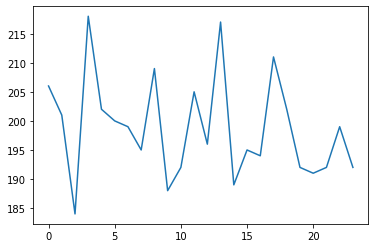

Generating interpolations...
23001 [D loss: 0.000124, acc.: 100.00%] [G loss: 2.729528, 2.558000]
23002 [D loss: 0.000854, acc.: 100.00%] [G loss: 8.799301, 8.361602]
23003 [D loss: 0.002913, acc.: 100.00%] [G loss: 8.809875, 8.549635]
23004 [D loss: 0.001256, acc.: 100.00%] [G loss: 2.400879, 2.310455]
23005 [D loss: 0.017844, acc.: 100.00%] [G loss: 4.254949, 3.296862]
23006 [D loss: 0.003510, acc.: 100.00%] [G loss: 0.634518, 0.227227]
23007 [D loss: 0.036418, acc.: 96.88%] [G loss: 0.155467, 0.093796]
23008 [D loss: 0.087578, acc.: 96.88%] [G loss: 5.979472, 0.911359]
23009 [D loss: 0.000809, acc.: 100.00%] [G loss: 2.006693, 1.182792]
23010 [D loss: 0.000299, acc.: 100.00%] [G loss: 6.035614, 4.591116]
23011 [D loss: 0.002280, acc.: 100.00%] [G loss: 6.821277, 5.897771]
23012 [D loss: 0.001828, acc.: 100.00%] [G loss: 0.814098, 2.566655]
23013 [D loss: 0.000311, acc.: 100.00%] [G loss: 6.890449, 4.183917]
23014 [D loss: 0.000335, acc.: 100.00%] [G loss: 3.298299, 3.304263]
23015 [

23122 [D loss: 0.000634, acc.: 100.00%] [G loss: 2.357380, 2.165942]
23123 [D loss: 0.001535, acc.: 100.00%] [G loss: 15.775977, 7.507982]
23124 [D loss: 0.001290, acc.: 100.00%] [G loss: 2.456965, 1.794770]
23125 [D loss: 0.000355, acc.: 100.00%] [G loss: 7.612622, 5.431196]
23126 [D loss: 0.000477, acc.: 100.00%] [G loss: 6.470140, 5.219851]
23127 [D loss: 0.035694, acc.: 96.88%] [G loss: 7.285268, 6.979598]
23128 [D loss: 0.108848, acc.: 96.88%] [G loss: 0.412838, 0.296656]
23129 [D loss: 0.001348, acc.: 100.00%] [G loss: 5.976348, 0.548192]
23130 [D loss: 0.009175, acc.: 100.00%] [G loss: 13.482924, 1.516674]
23131 [D loss: 0.015778, acc.: 100.00%] [G loss: 4.332318, 3.686151]
23132 [D loss: 0.000421, acc.: 100.00%] [G loss: 3.157587, 2.173028]
23133 [D loss: 0.001770, acc.: 100.00%] [G loss: 2.116691, 5.811657]
23134 [D loss: 0.000658, acc.: 100.00%] [G loss: 4.438677, 3.873127]
23135 [D loss: 0.004369, acc.: 100.00%] [G loss: 4.948499, 4.493545]
23136 [D loss: 0.037287, acc.: 96.

23242 [D loss: 0.000167, acc.: 100.00%] [G loss: 4.073790, 1.115987]
23243 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.817629, 1.031489]
23244 [D loss: 0.000411, acc.: 100.00%] [G loss: 3.802843, 3.548683]
23245 [D loss: 0.000205, acc.: 100.00%] [G loss: 4.919894, 5.017340]
23246 [D loss: 0.000351, acc.: 100.00%] [G loss: 4.285812, 3.560346]
23247 [D loss: 0.000358, acc.: 100.00%] [G loss: 2.028837, 1.864045]
23248 [D loss: 0.000280, acc.: 100.00%] [G loss: 1.857984, 1.901800]
23249 [D loss: 0.024601, acc.: 96.88%] [G loss: 4.314321, 3.821113]
23250 [D loss: 0.000340, acc.: 100.00%] [G loss: 0.739007, 0.634953]
23251 [D loss: 0.000278, acc.: 100.00%] [G loss: 5.904128, 2.682346]
23252 [D loss: 0.000998, acc.: 100.00%] [G loss: 4.317022, 3.581899]
23253 [D loss: 0.003566, acc.: 100.00%] [G loss: 1.296435, 1.118399]
23254 [D loss: 0.001593, acc.: 100.00%] [G loss: 2.899626, 1.500175]
23255 [D loss: 0.002717, acc.: 100.00%] [G loss: 4.607844, 4.273465]
23256 [D loss: 0.000770, acc.: 100.

23363 [D loss: 0.000413, acc.: 100.00%] [G loss: 6.173097, 5.868867]
23364 [D loss: 0.000292, acc.: 100.00%] [G loss: 7.199836, 7.340426]
23365 [D loss: 0.000866, acc.: 100.00%] [G loss: 4.175683, 3.746775]
23366 [D loss: 0.000512, acc.: 100.00%] [G loss: 5.531067, 5.867173]
23367 [D loss: 0.000272, acc.: 100.00%] [G loss: 5.348028, 3.005418]
23368 [D loss: 0.000229, acc.: 100.00%] [G loss: 4.113547, 4.095295]
23369 [D loss: 0.000468, acc.: 100.00%] [G loss: 4.020578, 3.534969]
23370 [D loss: 0.000370, acc.: 100.00%] [G loss: 6.263362, 5.731840]
23371 [D loss: 0.007876, acc.: 100.00%] [G loss: 3.873742, 3.148442]
23372 [D loss: 0.000038, acc.: 100.00%] [G loss: 1.776803, 3.627717]
23373 [D loss: 0.001296, acc.: 100.00%] [G loss: 6.301273, 3.500529]
23374 [D loss: 0.000226, acc.: 100.00%] [G loss: 12.348374, 5.606753]
23375 [D loss: 0.000187, acc.: 100.00%] [G loss: 5.577192, 5.407136]
23376 [D loss: 0.001229, acc.: 100.00%] [G loss: 8.262864, 5.653317]
23377 [D loss: 0.000079, acc.: 10

23484 [D loss: 0.004414, acc.: 100.00%] [G loss: 5.244937, 4.597642]
23485 [D loss: 0.000129, acc.: 100.00%] [G loss: 3.873122, 3.468971]
23486 [D loss: 0.000492, acc.: 100.00%] [G loss: 6.379371, 6.248315]
23487 [D loss: 0.000370, acc.: 100.00%] [G loss: 2.348952, 1.813599]
23488 [D loss: 0.000240, acc.: 100.00%] [G loss: 4.100388, 3.434541]
23489 [D loss: 0.000378, acc.: 100.00%] [G loss: 19.134151, 7.071842]
23490 [D loss: 0.000334, acc.: 100.00%] [G loss: 8.570906, 8.413216]
23491 [D loss: 0.016243, acc.: 100.00%] [G loss: 6.874284, 6.252025]
23492 [D loss: 0.000512, acc.: 100.00%] [G loss: 6.788091, 7.125917]
23493 [D loss: 0.000261, acc.: 100.00%] [G loss: 3.559988, 4.222631]
23494 [D loss: 0.000454, acc.: 100.00%] [G loss: 6.404403, 7.274481]
23495 [D loss: 0.000113, acc.: 100.00%] [G loss: 2.366236, 1.437887]
23496 [D loss: 0.000365, acc.: 100.00%] [G loss: 5.380676, 3.864481]
23497 [D loss: 0.002209, acc.: 100.00%] [G loss: 7.655023, 1.686251]
23498 [D loss: 0.000762, acc.: 10

23603 [D loss: 0.000242, acc.: 100.00%] [G loss: 22.105267, 6.162152]
23604 [D loss: 0.000182, acc.: 100.00%] [G loss: 7.730620, 6.991956]
23605 [D loss: 0.001153, acc.: 100.00%] [G loss: 8.253422, 7.609284]
23606 [D loss: 0.000175, acc.: 100.00%] [G loss: 7.247419, 7.301215]
23607 [D loss: 0.000149, acc.: 100.00%] [G loss: 4.579285, 4.508180]
23608 [D loss: 0.000166, acc.: 100.00%] [G loss: 5.490546, 5.728355]
23609 [D loss: 0.001090, acc.: 100.00%] [G loss: 4.476978, 4.553626]
23610 [D loss: 0.002145, acc.: 100.00%] [G loss: 4.389600, 3.484603]
23611 [D loss: 0.000259, acc.: 100.00%] [G loss: 2.361939, 1.445424]
23612 [D loss: 0.000267, acc.: 100.00%] [G loss: 2.624490, 2.324063]
23613 [D loss: 0.000596, acc.: 100.00%] [G loss: 4.077625, 3.713570]
23614 [D loss: 0.000985, acc.: 100.00%] [G loss: 1.311071, 1.687393]
23615 [D loss: 0.024562, acc.: 96.88%] [G loss: 1.625074, 0.057762]
23616 [D loss: 0.002193, acc.: 100.00%] [G loss: 0.698216, 0.418339]
23617 [D loss: 0.000383, acc.: 100

23723 [D loss: 0.000059, acc.: 100.00%] [G loss: 13.964788, 6.610265]
23724 [D loss: 0.002623, acc.: 100.00%] [G loss: 4.647813, 4.634338]
23725 [D loss: 0.000191, acc.: 100.00%] [G loss: 6.039148, 5.368915]
23726 [D loss: 0.000115, acc.: 100.00%] [G loss: 7.094262, 6.125751]
23727 [D loss: 0.000164, acc.: 100.00%] [G loss: 7.821460, 0.642562]
23728 [D loss: 0.000528, acc.: 100.00%] [G loss: 1.484305, 1.090495]
23729 [D loss: 0.000056, acc.: 100.00%] [G loss: 6.819833, 6.270813]
23730 [D loss: 0.000470, acc.: 100.00%] [G loss: 1.382594, 1.076362]
23731 [D loss: 0.000051, acc.: 100.00%] [G loss: 13.753780, 6.534902]
23732 [D loss: 0.000143, acc.: 100.00%] [G loss: 9.585800, 7.627218]
23733 [D loss: 0.000093, acc.: 100.00%] [G loss: 4.272071, 3.843615]
23734 [D loss: 0.000062, acc.: 100.00%] [G loss: 2.003338, 3.037582]
23735 [D loss: 0.002983, acc.: 100.00%] [G loss: 5.577285, 4.617599]
23736 [D loss: 0.000351, acc.: 100.00%] [G loss: 1.104761, 1.450697]
23737 [D loss: 0.000566, acc.: 1

23845 [D loss: 0.003311, acc.: 100.00%] [G loss: 0.370122, 0.117902]
23846 [D loss: 0.020671, acc.: 100.00%] [G loss: 0.000373, 0.000494]
23847 [D loss: 0.106827, acc.: 96.88%] [G loss: 0.187997, 0.111315]
23848 [D loss: 0.068314, acc.: 93.75%] [G loss: 3.320369, 3.267590]
23849 [D loss: 0.000503, acc.: 100.00%] [G loss: 2.882458, 1.803241]
23850 [D loss: 0.072762, acc.: 96.88%] [G loss: 1.647930, 1.319818]
23851 [D loss: 0.000982, acc.: 100.00%] [G loss: 4.273805, 3.462621]
23852 [D loss: 0.000868, acc.: 100.00%] [G loss: 0.837360, 0.279619]
23853 [D loss: 0.003039, acc.: 100.00%] [G loss: 0.482748, 0.085500]
23854 [D loss: 0.000468, acc.: 100.00%] [G loss: 2.350892, 1.763177]
23855 [D loss: 0.000529, acc.: 100.00%] [G loss: 4.003533, 3.612783]
23856 [D loss: 0.000986, acc.: 100.00%] [G loss: 3.571336, 1.915787]
23857 [D loss: 0.224387, acc.: 96.88%] [G loss: 0.000545, 0.000068]
23858 [D loss: 0.007014, acc.: 100.00%] [G loss: 0.897213, 1.234445]
23859 [D loss: 0.002729, acc.: 100.00%

23966 [D loss: 0.240657, acc.: 96.88%] [G loss: 0.148935, 0.373663]
23967 [D loss: 0.038161, acc.: 96.88%] [G loss: 4.128005, 3.720271]
23968 [D loss: 0.000197, acc.: 100.00%] [G loss: 4.546491, 5.126722]
23969 [D loss: 0.000061, acc.: 100.00%] [G loss: 4.523308, 4.408734]
23970 [D loss: 0.000629, acc.: 100.00%] [G loss: 9.628677, 7.687242]
23971 [D loss: 0.000189, acc.: 100.00%] [G loss: 8.599987, 7.655450]
23972 [D loss: 0.000244, acc.: 100.00%] [G loss: 2.228305, 3.567284]
23973 [D loss: 0.000125, acc.: 100.00%] [G loss: 5.910405, 5.205966]
23974 [D loss: 0.000277, acc.: 100.00%] [G loss: 5.591563, 5.376598]
23975 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.643767, 0.206152]
23976 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.115207, 0.296873]
23977 [D loss: 0.000843, acc.: 100.00%] [G loss: 20.901272, 7.664638]
23978 [D loss: 0.001677, acc.: 100.00%] [G loss: 11.590231, 8.122246]
23979 [D loss: 0.000103, acc.: 100.00%] [G loss: 6.861691, 6.007077]
23980 [D loss: 0.000057, acc.: 100

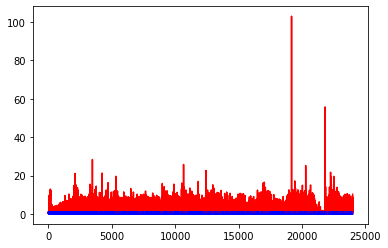

white ratio : 48.0
min : 184
max : 218


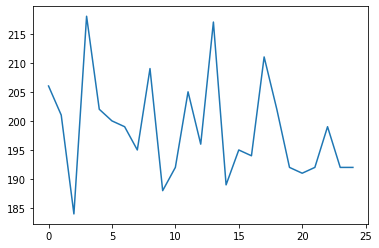

Generating interpolations...
24001 [D loss: 0.000008, acc.: 100.00%] [G loss: 8.041479, 7.479163]
24002 [D loss: 0.009336, acc.: 100.00%] [G loss: 7.807114, 6.410533]
24003 [D loss: 0.000130, acc.: 100.00%] [G loss: 8.133549, 8.685528]
24004 [D loss: 0.000061, acc.: 100.00%] [G loss: 6.492130, 2.854735]
24005 [D loss: 0.000235, acc.: 100.00%] [G loss: 4.758247, 4.696141]
24006 [D loss: 0.000747, acc.: 100.00%] [G loss: 1.571153, 1.460186]
24007 [D loss: 0.004230, acc.: 100.00%] [G loss: 5.189760, 5.596576]
24008 [D loss: 0.001094, acc.: 100.00%] [G loss: 6.507135, 6.227110]
24009 [D loss: 0.000062, acc.: 100.00%] [G loss: 14.522485, 3.894130]
24010 [D loss: 0.000541, acc.: 100.00%] [G loss: 8.036789, 6.519958]
24011 [D loss: 0.000053, acc.: 100.00%] [G loss: 4.691441, 4.502864]
24012 [D loss: 0.002352, acc.: 100.00%] [G loss: 6.381809, 5.914924]
24013 [D loss: 0.000167, acc.: 100.00%] [G loss: 6.083670, 5.362520]
24014 [D loss: 0.000173, acc.: 100.00%] [G loss: 4.714303, 4.861425]
2401

24120 [D loss: 0.000229, acc.: 100.00%] [G loss: 39.722946, 0.027791]
24121 [D loss: 0.001001, acc.: 100.00%] [G loss: 2.245805, 0.969951]
24122 [D loss: 0.020057, acc.: 100.00%] [G loss: 5.882272, 6.596672]
24123 [D loss: 0.000537, acc.: 100.00%] [G loss: 1.844020, 1.175390]
24124 [D loss: 0.000245, acc.: 100.00%] [G loss: 1.582217, 2.378921]
24125 [D loss: 0.034825, acc.: 96.88%] [G loss: 6.226199, 6.514526]
24126 [D loss: 0.000384, acc.: 100.00%] [G loss: 3.451706, 2.045289]
24127 [D loss: 0.002890, acc.: 100.00%] [G loss: 3.352795, 3.513139]
24128 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.172131, 0.269767]
24129 [D loss: 0.000140, acc.: 100.00%] [G loss: 1.664490, 1.022998]
24130 [D loss: 0.063728, acc.: 96.88%] [G loss: 0.028213, 0.156887]
24131 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.000013, 0.000002]
24132 [D loss: 0.000654, acc.: 100.00%] [G loss: 0.000038, 0.000193]
24133 [D loss: 0.008366, acc.: 100.00%] [G loss: 0.130104, 0.144291]
24134 [D loss: 0.000552, acc.: 100.

24239 [D loss: 0.123367, acc.: 96.88%] [G loss: 0.000948, 0.000132]
24240 [D loss: 0.009849, acc.: 100.00%] [G loss: 3.815218, 2.545310]
24241 [D loss: 0.006987, acc.: 100.00%] [G loss: 3.212353, 3.215865]
24242 [D loss: 0.007737, acc.: 100.00%] [G loss: 0.000015, 0.000077]
24243 [D loss: 0.001171, acc.: 100.00%] [G loss: 2.448630, 0.855118]
24244 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.893993, 0.081893]
24245 [D loss: 0.001379, acc.: 100.00%] [G loss: 0.158075, 0.188107]
24246 [D loss: 0.011593, acc.: 100.00%] [G loss: 7.930816, 7.004743]
24247 [D loss: 0.000833, acc.: 100.00%] [G loss: 0.379593, 0.367190]
24248 [D loss: 0.005316, acc.: 100.00%] [G loss: 0.060662, 0.014190]
24249 [D loss: 0.009499, acc.: 100.00%] [G loss: 0.221540, 0.227996]
24250 [D loss: 0.003712, acc.: 100.00%] [G loss: 3.151861, 1.617337]
24251 [D loss: 0.000068, acc.: 100.00%] [G loss: 18.234478, 0.175170]
24252 [D loss: 0.000081, acc.: 100.00%] [G loss: 3.465353, 2.686470]
24253 [D loss: 0.000075, acc.: 100

24358 [D loss: 0.000071, acc.: 100.00%] [G loss: 4.418041, 3.127409]
24359 [D loss: 0.000040, acc.: 100.00%] [G loss: 1.049522, 0.305602]
24360 [D loss: 0.000419, acc.: 100.00%] [G loss: 8.767319, 8.289304]
24361 [D loss: 0.239725, acc.: 96.88%] [G loss: 2.434667, 1.283171]
24362 [D loss: 0.014910, acc.: 100.00%] [G loss: 0.000003, 0.000005]
24363 [D loss: 0.016330, acc.: 100.00%] [G loss: 0.000686, 0.003305]
24364 [D loss: 0.001151, acc.: 100.00%] [G loss: 8.365754, 6.056129]
24365 [D loss: 0.000456, acc.: 100.00%] [G loss: 1.278295, 0.979654]
24366 [D loss: 0.000504, acc.: 100.00%] [G loss: 0.024324, 0.084241]
24367 [D loss: 0.012899, acc.: 100.00%] [G loss: 4.749870, 5.766620]
24368 [D loss: 0.012890, acc.: 100.00%] [G loss: 0.000109, 0.000279]
24369 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.220011, 0.082749]
24370 [D loss: 0.002832, acc.: 100.00%] [G loss: 9.239234, 8.860224]
24371 [D loss: 0.000362, acc.: 100.00%] [G loss: 8.035552, 7.794587]
24372 [D loss: 0.001849, acc.: 100.

24479 [D loss: 0.000050, acc.: 100.00%] [G loss: 5.179605, 4.781754]
24480 [D loss: 0.000187, acc.: 100.00%] [G loss: 5.198406, 4.097179]
24481 [D loss: 0.000062, acc.: 100.00%] [G loss: 11.351944, 5.527045]
24482 [D loss: 0.000270, acc.: 100.00%] [G loss: 10.363567, 10.095352]
24483 [D loss: 0.000053, acc.: 100.00%] [G loss: 7.211805, 5.442252]
24484 [D loss: 0.000572, acc.: 100.00%] [G loss: 0.005098, 0.031044]
24485 [D loss: 0.000469, acc.: 100.00%] [G loss: 2.419534, 0.570619]
24486 [D loss: 0.000353, acc.: 100.00%] [G loss: 4.741895, 2.813004]
24487 [D loss: 0.000535, acc.: 100.00%] [G loss: 0.122761, 0.004913]
24488 [D loss: 0.000259, acc.: 100.00%] [G loss: 0.000019, 0.000001]
24489 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.509136, 0.575261]
24490 [D loss: 0.000112, acc.: 100.00%] [G loss: 1.712444, 1.072359]
24491 [D loss: 0.005575, acc.: 100.00%] [G loss: 0.603367, 0.688612]
24492 [D loss: 0.000138, acc.: 100.00%] [G loss: 21.942524, 1.041861]
24493 [D loss: 0.000311, acc.:

24601 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.998933, 7.222846]
24602 [D loss: 0.000414, acc.: 100.00%] [G loss: 11.795965, 5.690465]
24603 [D loss: 0.000123, acc.: 100.00%] [G loss: 1.869748, 1.451452]
24604 [D loss: 0.001929, acc.: 100.00%] [G loss: 0.736257, 1.197742]
24605 [D loss: 0.000085, acc.: 100.00%] [G loss: 9.912846, 9.124251]
24606 [D loss: 0.003577, acc.: 100.00%] [G loss: 11.458424, 7.341313]
24607 [D loss: 0.000148, acc.: 100.00%] [G loss: 9.270909, 9.301777]
24608 [D loss: 0.000033, acc.: 100.00%] [G loss: 14.393988, 7.236698]
24609 [D loss: 0.000104, acc.: 100.00%] [G loss: 12.476223, 12.376665]
24610 [D loss: 0.001897, acc.: 100.00%] [G loss: 9.403924, 9.195856]
24611 [D loss: 0.000054, acc.: 100.00%] [G loss: 15.050819, 12.982473]
24612 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.232453, 10.520042]
24613 [D loss: 0.000007, acc.: 100.00%] [G loss: 10.720402, 11.118587]
24614 [D loss: 0.000586, acc.: 100.00%] [G loss: 11.202305, 10.391854]
24615 [D loss: 0.0000

24721 [D loss: 0.002599, acc.: 100.00%] [G loss: 0.020620, 0.039043]
24722 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.004847, 0.000395]
24723 [D loss: 0.000049, acc.: 100.00%] [G loss: 2.922520, 0.932021]
24724 [D loss: 0.008068, acc.: 100.00%] [G loss: 7.387448, 5.996972]
24725 [D loss: 0.002897, acc.: 100.00%] [G loss: 10.580746, 6.872374]
24726 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.473373, 9.338385]
24727 [D loss: 0.000044, acc.: 100.00%] [G loss: 8.755678, 7.902490]
24728 [D loss: 0.000062, acc.: 100.00%] [G loss: 8.336432, 7.590393]
24729 [D loss: 0.000099, acc.: 100.00%] [G loss: 2.260614, 2.239981]
24730 [D loss: 0.000098, acc.: 100.00%] [G loss: 10.315239, 6.782475]
24731 [D loss: 0.001442, acc.: 100.00%] [G loss: 2.776579, 3.348879]
24732 [D loss: 0.001958, acc.: 100.00%] [G loss: 4.642372, 4.825657]
24733 [D loss: 0.000168, acc.: 100.00%] [G loss: 8.797253, 8.999451]
24734 [D loss: 0.000878, acc.: 100.00%] [G loss: 7.084811, 5.535635]
24735 [D loss: 0.000192, acc.: 1

24842 [D loss: 0.000035, acc.: 100.00%] [G loss: 7.150800, 5.815380]
24843 [D loss: 0.000064, acc.: 100.00%] [G loss: 9.139156, 8.341486]
24844 [D loss: 0.000185, acc.: 100.00%] [G loss: 5.156488, 8.177271]
24845 [D loss: 0.000232, acc.: 100.00%] [G loss: 12.131382, 9.358364]
24846 [D loss: 0.000012, acc.: 100.00%] [G loss: 7.935197, 7.880089]
24847 [D loss: 0.000030, acc.: 100.00%] [G loss: 11.592662, 10.868727]
24848 [D loss: 0.000006, acc.: 100.00%] [G loss: 12.710758, 11.350220]
24849 [D loss: 0.143340, acc.: 96.88%] [G loss: 8.848100, 8.480377]
24850 [D loss: 0.000080, acc.: 100.00%] [G loss: 8.568239, 7.712502]
24851 [D loss: 0.000689, acc.: 100.00%] [G loss: 7.486894, 7.368336]
24852 [D loss: 0.000281, acc.: 100.00%] [G loss: 7.630903, 6.908191]
24853 [D loss: 0.004076, acc.: 100.00%] [G loss: 3.326219, 2.644497]
24854 [D loss: 0.003940, acc.: 100.00%] [G loss: 7.374515, 6.825111]
24855 [D loss: 0.000299, acc.: 100.00%] [G loss: 5.300924, 4.837511]
24856 [D loss: 0.001014, acc.:

24964 [D loss: 0.000228, acc.: 100.00%] [G loss: 7.313498, 6.907773]
24965 [D loss: 0.000098, acc.: 100.00%] [G loss: 7.148431, 5.999876]
24966 [D loss: 0.000177, acc.: 100.00%] [G loss: 8.979601, 7.706025]
24967 [D loss: 0.147442, acc.: 93.75%] [G loss: 0.896237, 0.667751]
24968 [D loss: 0.018729, acc.: 100.00%] [G loss: 2.392508, 1.642643]
24969 [D loss: 0.005051, acc.: 100.00%] [G loss: 5.026127, 1.802493]
24970 [D loss: 0.002409, acc.: 100.00%] [G loss: 2.995862, 1.783527]
24971 [D loss: 0.096008, acc.: 96.88%] [G loss: 30.112137, 5.761095]
24972 [D loss: 0.000039, acc.: 100.00%] [G loss: 11.259343, 8.021723]
24973 [D loss: 0.000009, acc.: 100.00%] [G loss: 14.090963, 12.949505]
24974 [D loss: 0.088811, acc.: 96.88%] [G loss: 5.160613, 4.799079]
24975 [D loss: 0.016926, acc.: 100.00%] [G loss: 10.261339, 5.556356]
24976 [D loss: 0.001051, acc.: 100.00%] [G loss: 1.695524, 0.722299]
24977 [D loss: 0.001722, acc.: 100.00%] [G loss: 4.392304, 3.876204]
24978 [D loss: 0.000483, acc.: 1

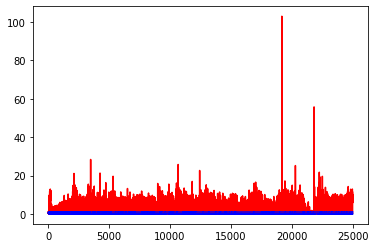

white ratio : 55.25
min : 184
max : 221


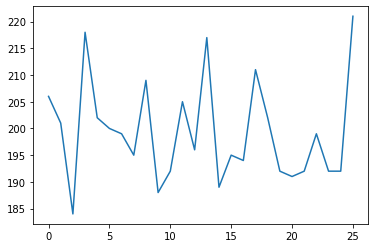

Generating interpolations...
25001 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.398450, 6.770947]
25002 [D loss: 0.005954, acc.: 100.00%] [G loss: 8.382488, 8.296513]
25003 [D loss: 0.000030, acc.: 100.00%] [G loss: 7.359597, 7.006905]
25004 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.643146, 7.147206]
25005 [D loss: 0.000227, acc.: 100.00%] [G loss: 8.726100, 10.877636]
25006 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.641352, 7.965851]
25007 [D loss: 0.215475, acc.: 96.88%] [G loss: 8.578960, 8.260389]
25008 [D loss: 0.000052, acc.: 100.00%] [G loss: 10.281673, 5.552215]
25009 [D loss: 0.000160, acc.: 100.00%] [G loss: 6.657434, 5.543719]
25010 [D loss: 0.000228, acc.: 100.00%] [G loss: 8.511473, 8.348619]
25011 [D loss: 0.000097, acc.: 100.00%] [G loss: 5.072606, 4.316941]
25012 [D loss: 0.000054, acc.: 100.00%] [G loss: 8.105465, 7.265371]
25013 [D loss: 0.000120, acc.: 100.00%] [G loss: 9.246456, 4.173315]
25014 [D loss: 0.000041, acc.: 100.00%] [G loss: 7.632862, 6.598326]
2501

25119 [D loss: 0.000490, acc.: 100.00%] [G loss: 0.368610, 0.242730]
25120 [D loss: 0.000199, acc.: 100.00%] [G loss: 0.189785, 0.058022]
25121 [D loss: 0.000708, acc.: 100.00%] [G loss: 0.367786, 0.149657]
25122 [D loss: 0.012955, acc.: 100.00%] [G loss: 1.079697, 0.247929]
25123 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.193397, 0.178479]
25124 [D loss: 0.000355, acc.: 100.00%] [G loss: 0.063782, 0.045700]
25125 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.194310, 0.143951]
25126 [D loss: 0.000795, acc.: 100.00%] [G loss: 0.280503, 0.427190]
25127 [D loss: 0.000986, acc.: 100.00%] [G loss: 0.117864, 0.102033]
25128 [D loss: 0.000404, acc.: 100.00%] [G loss: 0.111039, 0.010609]
25129 [D loss: 0.008886, acc.: 100.00%] [G loss: 0.000344, 0.000126]
25130 [D loss: 0.000479, acc.: 100.00%] [G loss: 1.219409, 0.089637]
25131 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.722365, 0.970319]
25132 [D loss: 0.000940, acc.: 100.00%] [G loss: 1.031714, 0.447072]
25133 [D loss: 0.000034, acc.: 100

25239 [D loss: 0.000480, acc.: 100.00%] [G loss: 0.034761, 0.044526]
25240 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.034921, 0.063215]
25241 [D loss: 0.001172, acc.: 100.00%] [G loss: 0.071272, 0.021838]
25242 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.015463, 0.030712]
25243 [D loss: 0.000247, acc.: 100.00%] [G loss: 1.112019, 0.696200]
25244 [D loss: 0.000617, acc.: 100.00%] [G loss: 0.002359, 0.002927]
25245 [D loss: 0.000322, acc.: 100.00%] [G loss: 0.221556, 0.194193]
25246 [D loss: 0.000239, acc.: 100.00%] [G loss: 0.000900, 0.001566]
25247 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.001872, 0.003384]
25248 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.028382, 0.035914]
25249 [D loss: 0.001226, acc.: 100.00%] [G loss: 0.000026, 0.000009]
25250 [D loss: 0.072694, acc.: 96.88%] [G loss: 0.000084, 0.000119]
25251 [D loss: 0.007375, acc.: 100.00%] [G loss: 0.000019, 0.000021]
25252 [D loss: 0.003637, acc.: 100.00%] [G loss: 0.000003, 0.000028]
25253 [D loss: 0.000291, acc.: 100.

25359 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.006495, 0.027357]
25360 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.007269, 0.011966]
25361 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.073773, 0.030171]
25362 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.104259, 0.097317]
25363 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.180460, 0.125731]
25364 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.010463, 0.000597]
25365 [D loss: 0.002041, acc.: 100.00%] [G loss: 0.580892, 0.402931]
25366 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000317, 0.003109]
25367 [D loss: 0.001124, acc.: 100.00%] [G loss: 0.010608, 0.001330]
25368 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.001499, 0.008548]
25369 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.004700, 0.002548]
25370 [D loss: 0.000242, acc.: 100.00%] [G loss: 0.213666, 0.056831]
25371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000135, 0.000610]
25372 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.054102, 0.000407]
25373 [D loss: 0.000017, acc.: 100

25480 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.019865, 0.270032]
25481 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.003839, 0.005373]
25482 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.143310, 0.163651]
25483 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.089931, 0.159940]
25484 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.081502, 0.079711]
25485 [D loss: 0.000283, acc.: 100.00%] [G loss: 1.211998, 0.472591]
25486 [D loss: 0.028565, acc.: 96.88%] [G loss: 0.114230, 0.174854]
25487 [D loss: 0.000010, acc.: 100.00%] [G loss: 5.520086, 2.233740]
25488 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.523704, 2.641611]
25489 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.721227, 2.710660]
25490 [D loss: 0.000376, acc.: 100.00%] [G loss: 0.535177, 0.523592]
25491 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.991030, 0.463248]
25492 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.097679, 0.118519]
25493 [D loss: 0.205959, acc.: 96.88%] [G loss: 0.000182, 0.000234]
25494 [D loss: 0.001192, acc.: 100.0

25601 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.008526, 0.022674]
25602 [D loss: 0.000391, acc.: 100.00%] [G loss: 0.041361, 0.055181]
25603 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.005003, 0.003308]
25604 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000114, 0.000398]
25605 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000574, 0.000212]
25606 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.001135, 0.000387]
25607 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.006429, 0.001926]
25608 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.133609, 0.004748]
25609 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.285765, 0.207546]
25610 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.140166, 0.287941]
25611 [D loss: 0.000633, acc.: 100.00%] [G loss: 0.001322, 0.002113]
25612 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.012516, 0.047163]
25613 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.005659, 0.000866]
25614 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.317919, 0.154745]
25615 [D loss: 0.000480, acc.: 100

25721 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000293, 0.000587]
25722 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.000039, 0.000029]
25723 [D loss: 0.000256, acc.: 100.00%] [G loss: 0.000066, 0.000080]
25724 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.000012, 0.000012]
25725 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000428, 0.000100]
25726 [D loss: 0.000579, acc.: 100.00%] [G loss: 0.000002, 0.000001]
25727 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000013, 0.000050]
25728 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.001782, 0.007325]
25729 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.000671, 0.000544]
25730 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.000705, 0.004287]
25731 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.004651, 0.001109]
25732 [D loss: 0.008686, acc.: 100.00%] [G loss: 0.005982, 0.004290]
25733 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.011461, 0.022387]
25734 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.119424, 0.160062]
25735 [D loss: 0.000130, acc.: 100

25842 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.011567, 0.015136]
25843 [D loss: 0.000575, acc.: 100.00%] [G loss: 0.020091, 0.032154]
25844 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.000015, 0.000012]
25845 [D loss: 0.026468, acc.: 96.88%] [G loss: 0.000007, 0.000008]
25846 [D loss: 0.003777, acc.: 100.00%] [G loss: 0.000015, 0.000024]
25847 [D loss: 0.000663, acc.: 100.00%] [G loss: 0.000650, 0.000452]
25848 [D loss: 0.013959, acc.: 100.00%] [G loss: 0.000084, 0.000155]
25849 [D loss: 0.001067, acc.: 100.00%] [G loss: 0.001303, 0.001063]
25850 [D loss: 0.000584, acc.: 100.00%] [G loss: 0.000137, 0.001100]
25851 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.005466, 0.005838]
25852 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.028783, 0.008569]
25853 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.007112, 0.003226]
25854 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000132, 0.000075]
25855 [D loss: 0.004375, acc.: 100.00%] [G loss: 0.004633, 0.001063]
25856 [D loss: 0.001124, acc.: 100.

25964 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.715535, 0.400547]
25965 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.590414, 0.368088]
25966 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.412034, 0.200902]
25967 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.077933, 0.044623]
25968 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.138530, 0.002246]
25969 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.065430, 0.012494]
25970 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.375257, 0.410136]
25971 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.172167, 0.085014]
25972 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.078145, 0.085456]
25973 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.001725, 0.000377]
25974 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.323234, 0.187544]
25975 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.003619, 0.001930]
25976 [D loss: 0.011810, acc.: 100.00%] [G loss: 0.001743, 0.004306]
25977 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.063219, 0.042518]
25978 [D loss: 0.000007, acc.: 100

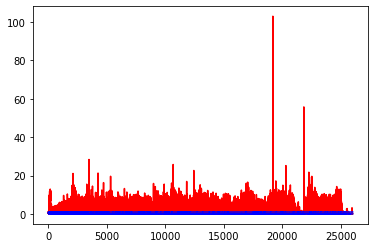

white ratio : 49.25
min : 184
max : 221


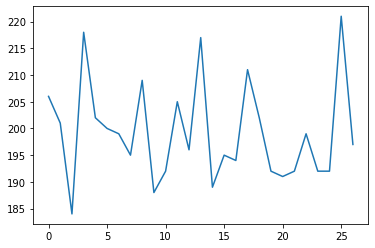

Generating interpolations...
26001 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.000123, 0.000306]
26002 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.022090, 0.012229]
26003 [D loss: 0.001123, acc.: 100.00%] [G loss: 0.002953, 0.009601]
26004 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.000017, 0.000030]
26005 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000053, 0.000107]
26006 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.004869, 0.002247]
26007 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.007435, 0.013769]
26008 [D loss: 0.000722, acc.: 100.00%] [G loss: 0.004075, 0.001668]
26009 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000011, 0.000012]
26010 [D loss: 0.000475, acc.: 100.00%] [G loss: 0.000109, 0.000028]
26011 [D loss: 0.002114, acc.: 100.00%] [G loss: 0.000199, 0.000146]
26012 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.025812, 0.022576]
26013 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000291, 0.000565]
26014 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.013433, 0.001199]
26015

26121 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000052, 0.000049]
26122 [D loss: 0.076226, acc.: 96.88%] [G loss: 0.000000, 0.000000]
26123 [D loss: 0.006973, acc.: 100.00%] [G loss: 0.000490, 0.006282]
26124 [D loss: 0.013535, acc.: 100.00%] [G loss: 0.000041, 0.000028]
26125 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000000, 0.000000]
26126 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.000096, 0.000060]
26127 [D loss: 0.000873, acc.: 100.00%] [G loss: 0.000668, 0.000639]
26128 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.000219, 0.000405]
26129 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.000213, 0.000021]
26130 [D loss: 0.000909, acc.: 100.00%] [G loss: 0.000035, 0.000309]
26131 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000677, 0.000620]
26132 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000105, 0.000032]
26133 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.000001, 0.000001]
26134 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.000368, 0.000029]
26135 [D loss: 0.000123, acc.: 100.

26243 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.037332, 0.004433]
26244 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.001815, 0.002960]
26245 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004512, 0.002394]
26246 [D loss: 0.000111, acc.: 100.00%] [G loss: 2.198297, 2.305292]
26247 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.181876, 1.148192]
26248 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.211952, 0.202127]
26249 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.136353, 0.184061]
26250 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.134276, 0.112361]
26251 [D loss: 0.000028, acc.: 100.00%] [G loss: 2.600113, 2.898461]
26252 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.391937, 0.221719]
26253 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.802391, 0.384082]
26254 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.282913, 0.207297]
26255 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.137478, 0.137335]
26256 [D loss: 0.000055, acc.: 100.00%] [G loss: 2.312567, 1.220003]
26257 [D loss: 0.000116, acc.: 100

26363 [D loss: 0.000126, acc.: 100.00%] [G loss: 2.996765, 1.487451]
26364 [D loss: 0.000807, acc.: 100.00%] [G loss: 11.997353, 0.148004]
26365 [D loss: 0.000035, acc.: 100.00%] [G loss: 6.991876, 6.454276]
26366 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.106460, 6.594169]
26367 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.258214, 7.174518]
26368 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.550183, 9.817524]
26369 [D loss: 0.001305, acc.: 100.00%] [G loss: 0.329428, 0.161917]
26370 [D loss: 0.000156, acc.: 100.00%] [G loss: 3.870064, 0.725605]
26371 [D loss: 0.000014, acc.: 100.00%] [G loss: 10.856503, 5.925710]
26372 [D loss: 0.000022, acc.: 100.00%] [G loss: 7.129132, 6.746517]
26373 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.459498, 3.900663]
26374 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.018924, 3.466819]
26375 [D loss: 0.000533, acc.: 100.00%] [G loss: 4.303586, 3.582126]
26376 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.002325, 3.497310]
26377 [D loss: 0.000021, acc.: 

26483 [D loss: 0.000040, acc.: 100.00%] [G loss: 1.218160, 1.289740]
26484 [D loss: 0.001070, acc.: 100.00%] [G loss: 1.013627, 0.589164]
26485 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.034219, 0.829742]
26486 [D loss: 0.000034, acc.: 100.00%] [G loss: 1.348693, 0.776750]
26487 [D loss: 0.000106, acc.: 100.00%] [G loss: 26.987219, 3.624213]
26488 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.198235, 0.311837]
26489 [D loss: 0.000070, acc.: 100.00%] [G loss: 2.558210, 1.889195]
26490 [D loss: 0.000086, acc.: 100.00%] [G loss: 1.311647, 1.270010]
26491 [D loss: 0.152939, acc.: 96.88%] [G loss: 0.019361, 0.021942]
26492 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.007397, 0.012904]
26493 [D loss: 0.000401, acc.: 100.00%] [G loss: 0.092987, 0.025090]
26494 [D loss: 0.094092, acc.: 96.88%] [G loss: 1.162753, 0.835221]
26495 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.919309, 1.137030]
26496 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.904754, 0.768981]
26497 [D loss: 0.000096, acc.: 100.

26602 [D loss: 0.000204, acc.: 100.00%] [G loss: 1.682616, 0.616529]
26603 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.012548, 0.014450]
26604 [D loss: 0.001279, acc.: 100.00%] [G loss: 0.146363, 0.140826]
26605 [D loss: 0.002228, acc.: 100.00%] [G loss: 3.346719, 1.746248]
26606 [D loss: 0.000115, acc.: 100.00%] [G loss: 2.640278, 0.699361]
26607 [D loss: 0.000425, acc.: 100.00%] [G loss: 0.003445, 0.011262]
26608 [D loss: 0.000373, acc.: 100.00%] [G loss: 0.034192, 0.030861]
26609 [D loss: 0.001235, acc.: 100.00%] [G loss: 0.018568, 0.020215]
26610 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.979203, 0.257725]
26611 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.768067, 1.289263]
26612 [D loss: 0.000471, acc.: 100.00%] [G loss: 1.341638, 1.046869]
26613 [D loss: 0.001473, acc.: 100.00%] [G loss: 0.029411, 0.033831]
26614 [D loss: 0.000032, acc.: 100.00%] [G loss: 2.469865, 1.331540]
26615 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.017432, 0.024061]
26616 [D loss: 0.000439, acc.: 100

26723 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.017476, 0.022296]
26724 [D loss: 0.000182, acc.: 100.00%] [G loss: 0.560144, 0.374970]
26725 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.056910, 0.057888]
26726 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.084857, 0.121802]
26727 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.258873, 0.091298]
26728 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.006074, 0.008190]
26729 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.008368, 0.003339]
26730 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.007723, 0.000677]
26731 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.000499, 0.005302]
26732 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.030866, 0.063806]
26733 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000072, 0.000075]
26734 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.010038, 0.025943]
26735 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.016409, 0.015889]
26736 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.001911, 0.003397]
26737 [D loss: 0.000349, acc.: 100

26843 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.044376, 0.117215]
26844 [D loss: 0.001606, acc.: 100.00%] [G loss: 0.900678, 0.341454]
26845 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.064854, 0.048495]
26846 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.391477, 0.254766]
26847 [D loss: 0.000267, acc.: 100.00%] [G loss: 0.002746, 0.008428]
26848 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.806394, 0.540031]
26849 [D loss: 0.000660, acc.: 100.00%] [G loss: 0.010939, 0.002865]
26850 [D loss: 0.000824, acc.: 100.00%] [G loss: 0.602593, 0.172011]
26851 [D loss: 0.000299, acc.: 100.00%] [G loss: 4.429642, 2.686613]
26852 [D loss: 0.000926, acc.: 100.00%] [G loss: 23.485332, 1.298741]
26853 [D loss: 0.000040, acc.: 100.00%] [G loss: 3.297657, 1.846082]
26854 [D loss: 0.000616, acc.: 100.00%] [G loss: 0.185404, 0.033319]
26855 [D loss: 0.026482, acc.: 96.88%] [G loss: 24.637421, 3.731813]
26856 [D loss: 0.000016, acc.: 100.00%] [G loss: 5.819280, 5.312935]
26857 [D loss: 0.000015, acc.: 10

26963 [D loss: 0.001705, acc.: 100.00%] [G loss: 0.212900, 0.251395]
26964 [D loss: 0.000673, acc.: 100.00%] [G loss: 1.088757, 0.684270]
26965 [D loss: 0.001183, acc.: 100.00%] [G loss: 1.825555, 0.466833]
26966 [D loss: 0.001546, acc.: 100.00%] [G loss: 0.000371, 0.012939]
26967 [D loss: 0.003336, acc.: 100.00%] [G loss: 1.371988, 0.010251]
26968 [D loss: 0.004000, acc.: 100.00%] [G loss: 1.294950, 1.078770]
26969 [D loss: 0.002336, acc.: 100.00%] [G loss: 1.737062, 0.302219]
26970 [D loss: 0.001940, acc.: 100.00%] [G loss: 10.432879, 0.994901]
26971 [D loss: 0.000711, acc.: 100.00%] [G loss: 1.665573, 1.152283]
26972 [D loss: 0.066391, acc.: 96.88%] [G loss: 2.643905, 0.758264]
26973 [D loss: 0.000264, acc.: 100.00%] [G loss: 4.450371, 3.370038]
26974 [D loss: 0.000337, acc.: 100.00%] [G loss: 3.232593, 1.032648]
26975 [D loss: 0.000378, acc.: 100.00%] [G loss: 21.521629, 5.752491]
26976 [D loss: 0.050811, acc.: 96.88%] [G loss: 3.700315, 2.868229]
26977 [D loss: 0.000063, acc.: 100

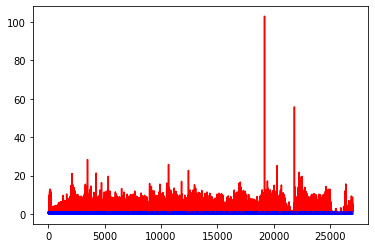

white ratio : 54.0
min : 184
max : 221


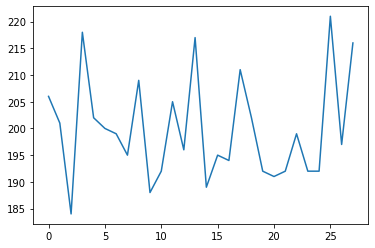

Generating interpolations...
27001 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.656125, 0.298993]
27002 [D loss: 0.000931, acc.: 100.00%] [G loss: 0.012047, 0.010820]
27003 [D loss: 0.000475, acc.: 100.00%] [G loss: 2.796848, 1.759879]
27004 [D loss: 0.000140, acc.: 100.00%] [G loss: 1.822474, 1.295178]
27005 [D loss: 0.000490, acc.: 100.00%] [G loss: 11.072330, 1.340054]
27006 [D loss: 0.071094, acc.: 96.88%] [G loss: 3.160728, 2.514235]
27007 [D loss: 0.001098, acc.: 100.00%] [G loss: 2.019393, 1.087955]
27008 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.265476, 0.000000]
27009 [D loss: 0.001540, acc.: 100.00%] [G loss: 0.009131, 0.023357]
27010 [D loss: 0.000252, acc.: 100.00%] [G loss: 0.000353, 0.002063]
27011 [D loss: 0.000231, acc.: 100.00%] [G loss: 7.032297, 5.804726]
27012 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.562483, 2.544088]
27013 [D loss: 0.000176, acc.: 100.00%] [G loss: 3.903712, 2.718333]
27014 [D loss: 0.000033, acc.: 100.00%] [G loss: 3.331124, 1.208632]
27015

27120 [D loss: 0.000473, acc.: 100.00%] [G loss: 2.813313, 2.155083]
27121 [D loss: 0.000562, acc.: 100.00%] [G loss: 8.546497, 0.221916]
27122 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.229880, 0.451336]
27123 [D loss: 0.001763, acc.: 100.00%] [G loss: 0.941748, 0.784836]
27124 [D loss: 0.000182, acc.: 100.00%] [G loss: 1.159860, 0.280072]
27125 [D loss: 0.136675, acc.: 96.88%] [G loss: 1.377180, 0.879080]
27126 [D loss: 0.001143, acc.: 100.00%] [G loss: 46.797592, 6.007641]
27127 [D loss: 0.000429, acc.: 100.00%] [G loss: 3.951767, 4.281005]
27128 [D loss: 0.000711, acc.: 100.00%] [G loss: 3.984068, 4.211134]
27129 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.667403, 1.446219]
27130 [D loss: 0.000682, acc.: 100.00%] [G loss: 1.197265, 0.514108]
27131 [D loss: 0.001240, acc.: 100.00%] [G loss: 0.539641, 0.105200]
27132 [D loss: 0.000507, acc.: 100.00%] [G loss: 1.468661, 1.540923]
27133 [D loss: 0.032018, acc.: 96.88%] [G loss: 2.943332, 2.672958]
27134 [D loss: 0.006772, acc.: 100.

27240 [D loss: 0.000219, acc.: 100.00%] [G loss: 4.329855, 3.607953]
27241 [D loss: 0.000359, acc.: 100.00%] [G loss: 2.950656, 1.334656]
27242 [D loss: 0.001458, acc.: 100.00%] [G loss: 1.275711, 2.376878]
27243 [D loss: 0.001560, acc.: 100.00%] [G loss: 1.778044, 2.118965]
27244 [D loss: 0.000020, acc.: 100.00%] [G loss: 9.074368, 3.382402]
27245 [D loss: 0.000871, acc.: 100.00%] [G loss: 2.127526, 2.910470]
27246 [D loss: 0.000078, acc.: 100.00%] [G loss: 3.631330, 3.164623]
27247 [D loss: 0.007618, acc.: 100.00%] [G loss: 1.019294, 0.404360]
27248 [D loss: 0.000188, acc.: 100.00%] [G loss: 2.671359, 1.956565]
27249 [D loss: 0.000243, acc.: 100.00%] [G loss: 4.786249, 2.440107]
27250 [D loss: 0.000207, acc.: 100.00%] [G loss: 1.473518, 0.703785]
27251 [D loss: 0.000318, acc.: 100.00%] [G loss: 4.027676, 3.415714]
27252 [D loss: 0.000344, acc.: 100.00%] [G loss: 3.073839, 2.010206]
27253 [D loss: 0.029067, acc.: 96.88%] [G loss: 0.466227, 0.217523]
27254 [D loss: 0.000396, acc.: 100.

27361 [D loss: 0.000809, acc.: 100.00%] [G loss: 0.499922, 0.583810]
27362 [D loss: 0.000028, acc.: 100.00%] [G loss: 2.182359, 1.013063]
27363 [D loss: 0.044501, acc.: 96.88%] [G loss: 0.078959, 0.062178]
27364 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.292308, 0.158098]
27365 [D loss: 0.001358, acc.: 100.00%] [G loss: 0.525127, 0.928660]
27366 [D loss: 0.000273, acc.: 100.00%] [G loss: 2.178455, 1.056432]
27367 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.088847, 0.127973]
27368 [D loss: 0.000491, acc.: 100.00%] [G loss: 0.052721, 0.059877]
27369 [D loss: 0.017348, acc.: 100.00%] [G loss: 5.350754, 2.400111]
27370 [D loss: 0.000057, acc.: 100.00%] [G loss: 7.062886, 6.140357]
27371 [D loss: 0.000026, acc.: 100.00%] [G loss: 4.541386, 0.883485]
27372 [D loss: 0.000337, acc.: 100.00%] [G loss: 1.901360, 1.222523]
27373 [D loss: 0.002486, acc.: 100.00%] [G loss: 0.948312, 0.707412]
27374 [D loss: 0.014908, acc.: 100.00%] [G loss: 0.186242, 0.083965]
27375 [D loss: 0.000642, acc.: 100.

27483 [D loss: 0.008413, acc.: 100.00%] [G loss: 4.912059, 4.131768]
27484 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.924228, 0.309352]
27485 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.170113, 0.259205]
27486 [D loss: 0.000192, acc.: 100.00%] [G loss: 2.647518, 1.689593]
27487 [D loss: 0.076045, acc.: 96.88%] [G loss: 0.003528, 0.013406]
27488 [D loss: 0.000322, acc.: 100.00%] [G loss: 1.216639, 0.061032]
27489 [D loss: 0.004258, acc.: 100.00%] [G loss: 0.012858, 0.000062]
27490 [D loss: 0.000793, acc.: 100.00%] [G loss: 0.006819, 0.007431]
27491 [D loss: 0.037189, acc.: 96.88%] [G loss: 0.120571, 0.004935]
27492 [D loss: 0.001988, acc.: 100.00%] [G loss: 0.000274, 0.000106]
27493 [D loss: 0.000538, acc.: 100.00%] [G loss: 0.048645, 0.001535]
27494 [D loss: 0.000401, acc.: 100.00%] [G loss: 0.200025, 0.107059]
27495 [D loss: 0.017693, acc.: 100.00%] [G loss: 0.189928, 0.321164]
27496 [D loss: 0.100003, acc.: 96.88%] [G loss: 0.002784, 0.007911]
27497 [D loss: 0.002823, acc.: 100.00

27604 [D loss: 0.003916, acc.: 100.00%] [G loss: 0.056127, 0.111755]
27605 [D loss: 0.002112, acc.: 100.00%] [G loss: 0.067328, 0.010219]
27606 [D loss: 0.001160, acc.: 100.00%] [G loss: 1.578659, 1.146572]
27607 [D loss: 0.004965, acc.: 100.00%] [G loss: 0.006096, 0.021012]
27608 [D loss: 0.039396, acc.: 96.88%] [G loss: 0.023673, 0.021158]
27609 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.004980, 0.017488]
27610 [D loss: 0.001979, acc.: 100.00%] [G loss: 0.081117, 0.236860]
27611 [D loss: 0.005218, acc.: 100.00%] [G loss: 0.234042, 0.408894]
27612 [D loss: 0.000586, acc.: 100.00%] [G loss: 0.174131, 0.015587]
27613 [D loss: 0.000759, acc.: 100.00%] [G loss: 17.174118, 0.342173]
27614 [D loss: 0.000047, acc.: 100.00%] [G loss: 2.736143, 0.385246]
27615 [D loss: 0.000095, acc.: 100.00%] [G loss: 1.720046, 1.699665]
27616 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.964459, 1.715021]
27617 [D loss: 0.000806, acc.: 100.00%] [G loss: 0.269454, 0.151412]
27618 [D loss: 0.010300, acc.: 100

27724 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.583486, 0.474586]
27725 [D loss: 0.000949, acc.: 100.00%] [G loss: 1.358871, 0.933915]
27726 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.363554, 0.146180]
27727 [D loss: 0.001242, acc.: 100.00%] [G loss: 2.286363, 2.090181]
27728 [D loss: 0.007162, acc.: 100.00%] [G loss: 0.453897, 0.492697]
27729 [D loss: 0.000682, acc.: 100.00%] [G loss: 2.432590, 2.129278]
27730 [D loss: 0.001257, acc.: 100.00%] [G loss: 0.394406, 0.426099]
27731 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.787362, 0.358496]
27732 [D loss: 0.000023, acc.: 100.00%] [G loss: 5.304869, 1.593455]
27733 [D loss: 0.002052, acc.: 100.00%] [G loss: 2.094445, 2.164317]
27734 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.483764, 0.658446]
27735 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.242557, 0.279700]
27736 [D loss: 0.000179, acc.: 100.00%] [G loss: 2.455316, 1.388584]
27737 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.064211, 0.079898]
27738 [D loss: 0.000079, acc.: 100

27845 [D loss: 0.001628, acc.: 100.00%] [G loss: 0.355260, 0.235766]
27846 [D loss: 0.000514, acc.: 100.00%] [G loss: 2.159446, 1.387344]
27847 [D loss: 0.000077, acc.: 100.00%] [G loss: 1.673394, 6.477117]
27848 [D loss: 0.000140, acc.: 100.00%] [G loss: 4.627337, 4.883634]
27849 [D loss: 0.000023, acc.: 100.00%] [G loss: 5.695575, 3.637611]
27850 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.301266, 3.997490]
27851 [D loss: 0.000032, acc.: 100.00%] [G loss: 3.941678, 2.901154]
27852 [D loss: 0.001751, acc.: 100.00%] [G loss: 2.326997, 2.376200]
27853 [D loss: 0.000127, acc.: 100.00%] [G loss: 4.204237, 3.677007]
27854 [D loss: 0.000026, acc.: 100.00%] [G loss: 2.018417, 1.497152]
27855 [D loss: 0.000856, acc.: 100.00%] [G loss: 3.131227, 3.033062]
27856 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.172485, 1.288411]
27857 [D loss: 0.000601, acc.: 100.00%] [G loss: 0.693015, 0.131738]
27858 [D loss: 0.000158, acc.: 100.00%] [G loss: 2.995900, 3.373998]
27859 [D loss: 0.000151, acc.: 100

27966 [D loss: 0.000883, acc.: 100.00%] [G loss: 0.134014, 0.189230]
27967 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.044121, 0.211050]
27968 [D loss: 0.000635, acc.: 100.00%] [G loss: 0.044600, 0.086994]
27969 [D loss: 0.000665, acc.: 100.00%] [G loss: 0.147328, 0.105526]
27970 [D loss: 0.000879, acc.: 100.00%] [G loss: 0.389247, 0.459214]
27971 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.586028, 0.263020]
27972 [D loss: 0.000682, acc.: 100.00%] [G loss: 0.052832, 0.037843]
27973 [D loss: 0.004265, acc.: 100.00%] [G loss: 0.076272, 0.389485]
27974 [D loss: 0.023531, acc.: 100.00%] [G loss: 0.569597, 0.026432]
27975 [D loss: 0.002512, acc.: 100.00%] [G loss: 0.000079, 0.000018]
27976 [D loss: 0.000586, acc.: 100.00%] [G loss: 0.162649, 0.163486]
27977 [D loss: 0.064877, acc.: 96.88%] [G loss: 0.028965, 0.001040]
27978 [D loss: 0.001420, acc.: 100.00%] [G loss: 0.000090, 0.000387]
27979 [D loss: 0.043368, acc.: 96.88%] [G loss: 0.359422, 0.386054]
27980 [D loss: 0.000100, acc.: 100.0

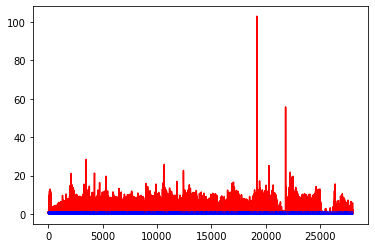

white ratio : 49.0
min : 184
max : 221


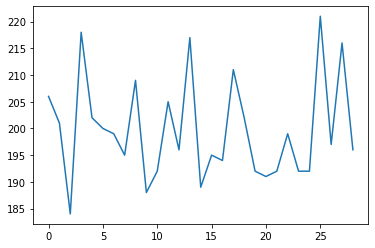

Generating interpolations...
28001 [D loss: 0.003420, acc.: 100.00%] [G loss: 0.273949, 0.078391]
28002 [D loss: 0.002408, acc.: 100.00%] [G loss: 1.091299, 0.115856]
28003 [D loss: 0.000827, acc.: 100.00%] [G loss: 2.214807, 1.089946]
28004 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.154272, 0.230582]
28005 [D loss: 0.000702, acc.: 100.00%] [G loss: 0.279363, 0.216209]
28006 [D loss: 0.012096, acc.: 100.00%] [G loss: 0.500814, 0.166384]
28007 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.705872, 0.566927]
28008 [D loss: 0.000710, acc.: 100.00%] [G loss: 0.036546, 0.040383]
28009 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.118625, 0.260424]
28010 [D loss: 0.000342, acc.: 100.00%] [G loss: 0.000311, 0.000649]
28011 [D loss: 0.000563, acc.: 100.00%] [G loss: 0.163704, 0.082455]
28012 [D loss: 0.000365, acc.: 100.00%] [G loss: 0.416592, 0.006155]
28013 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.413206, 0.623368]
28014 [D loss: 0.000550, acc.: 100.00%] [G loss: 0.060383, 0.060153]
28015

28121 [D loss: 0.091621, acc.: 96.88%] [G loss: 0.683168, 0.200090]
28122 [D loss: 0.000081, acc.: 100.00%] [G loss: 1.081829, 0.004496]
28123 [D loss: 0.000784, acc.: 100.00%] [G loss: 11.631992, 2.216407]
28124 [D loss: 0.010585, acc.: 100.00%] [G loss: 2.835934, 1.008218]
28125 [D loss: 0.015953, acc.: 100.00%] [G loss: 0.294307, 0.361638]
28126 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.267799, 0.486563]
28127 [D loss: 0.016869, acc.: 100.00%] [G loss: 0.260937, 0.027338]
28128 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.507026, 0.001455]
28129 [D loss: 0.004942, acc.: 100.00%] [G loss: 0.111718, 0.180784]
28130 [D loss: 0.000790, acc.: 100.00%] [G loss: 0.045408, 0.006963]
28131 [D loss: 0.140529, acc.: 96.88%] [G loss: 0.004978, 0.004848]
28132 [D loss: 0.001050, acc.: 100.00%] [G loss: 0.003196, 0.014383]
28133 [D loss: 0.000515, acc.: 100.00%] [G loss: 0.440284, 0.234668]
28134 [D loss: 0.001189, acc.: 100.00%] [G loss: 0.587866, 0.255012]
28135 [D loss: 0.000105, acc.: 100.

28242 [D loss: 0.000458, acc.: 100.00%] [G loss: 0.072967, 0.002383]
28243 [D loss: 0.001605, acc.: 100.00%] [G loss: 0.152663, 0.205387]
28244 [D loss: 0.002977, acc.: 100.00%] [G loss: 1.306581, 0.060874]
28245 [D loss: 0.000399, acc.: 100.00%] [G loss: 2.705903, 2.102093]
28246 [D loss: 0.005484, acc.: 100.00%] [G loss: 4.598359, 0.076628]
28247 [D loss: 0.000206, acc.: 100.00%] [G loss: 2.463075, 3.147712]
28248 [D loss: 0.000069, acc.: 100.00%] [G loss: 4.137874, 3.985690]
28249 [D loss: 0.000386, acc.: 100.00%] [G loss: 4.838744, 2.999249]
28250 [D loss: 0.000036, acc.: 100.00%] [G loss: 3.832335, 1.708785]
28251 [D loss: 0.001433, acc.: 100.00%] [G loss: 0.085063, 0.050372]
28252 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.008796, 0.007001]
28253 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.423945, 0.184254]
28254 [D loss: 0.003431, acc.: 100.00%] [G loss: 0.529346, 0.870832]
28255 [D loss: 0.000593, acc.: 100.00%] [G loss: 4.405691, 3.408102]
28256 [D loss: 0.000188, acc.: 100

28362 [D loss: 0.000533, acc.: 100.00%] [G loss: 1.004514, 0.851653]
28363 [D loss: 0.000219, acc.: 100.00%] [G loss: 0.045739, 0.184607]
28364 [D loss: 0.000415, acc.: 100.00%] [G loss: 0.518533, 1.274000]
28365 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.622056, 0.335355]
28366 [D loss: 0.000448, acc.: 100.00%] [G loss: 0.804563, 1.851350]
28367 [D loss: 0.000527, acc.: 100.00%] [G loss: 0.107167, 0.002720]
28368 [D loss: 0.000222, acc.: 100.00%] [G loss: 7.047389, 0.234332]
28369 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.034591, 0.043565]
28370 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.024274, 0.838765]
28371 [D loss: 0.001382, acc.: 100.00%] [G loss: 3.665140, 3.355536]
28372 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.029773, 0.037322]
28373 [D loss: 0.001450, acc.: 100.00%] [G loss: 0.164706, 0.038665]
28374 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.228311, 0.151469]
28375 [D loss: 0.000034, acc.: 100.00%] [G loss: 1.826075, 2.073551]
28376 [D loss: 0.000089, acc.: 100

28484 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.602403, 3.089536]
28485 [D loss: 0.000047, acc.: 100.00%] [G loss: 3.317613, 2.710890]
28486 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.773120, 3.804009]
28487 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.231654, 2.724204]
28488 [D loss: 0.000342, acc.: 100.00%] [G loss: 4.529638, 3.639482]
28489 [D loss: 0.000029, acc.: 100.00%] [G loss: 3.298905, 1.763935]
28490 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.797999, 1.542490]
28491 [D loss: 0.000030, acc.: 100.00%] [G loss: 2.897017, 3.559862]
28492 [D loss: 0.000125, acc.: 100.00%] [G loss: 2.445352, 2.058257]
28493 [D loss: 0.000062, acc.: 100.00%] [G loss: 3.438106, 2.365438]
28494 [D loss: 0.007296, acc.: 100.00%] [G loss: 1.956341, 0.783526]
28495 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.003298, 3.969871]
28496 [D loss: 0.000089, acc.: 100.00%] [G loss: 2.319475, 1.331998]
28497 [D loss: 0.000056, acc.: 100.00%] [G loss: 7.331275, 5.123010]
28498 [D loss: 0.000000, acc.: 100

28603 [D loss: 0.027024, acc.: 96.88%] [G loss: 5.300388, 2.630594]
28604 [D loss: 0.000085, acc.: 100.00%] [G loss: 7.926449, 5.453154]
28605 [D loss: 0.000350, acc.: 100.00%] [G loss: 6.122020, 4.321141]
28606 [D loss: 0.001623, acc.: 100.00%] [G loss: 7.299195, 4.746932]
28607 [D loss: 0.000099, acc.: 100.00%] [G loss: 19.128006, 3.943878]
28608 [D loss: 0.000090, acc.: 100.00%] [G loss: 2.163415, 1.307653]
28609 [D loss: 0.000094, acc.: 100.00%] [G loss: 8.779757, 3.556883]
28610 [D loss: 0.000034, acc.: 100.00%] [G loss: 9.749462, 7.436176]
28611 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.269103, 0.857368]
28612 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.694740, 0.394518]
28613 [D loss: 0.002783, acc.: 100.00%] [G loss: 1.788394, 6.191848]
28614 [D loss: 0.005506, acc.: 100.00%] [G loss: 8.140464, 3.978252]
28615 [D loss: 0.014464, acc.: 100.00%] [G loss: 11.236979, 6.244433]
28616 [D loss: 0.000317, acc.: 100.00%] [G loss: 1.085435, 0.411489]
28617 [D loss: 0.000069, acc.: 10

28722 [D loss: 0.000055, acc.: 100.00%] [G loss: 9.217249, 0.896104]
28723 [D loss: 0.183367, acc.: 96.88%] [G loss: 1.242826, 0.462891]
28724 [D loss: 0.000659, acc.: 100.00%] [G loss: 0.028901, 0.022192]
28725 [D loss: 0.001667, acc.: 100.00%] [G loss: 0.930466, 0.016563]
28726 [D loss: 0.009725, acc.: 100.00%] [G loss: 0.009914, 0.023481]
28727 [D loss: 0.000641, acc.: 100.00%] [G loss: 14.174919, 4.284296]
28728 [D loss: 0.000572, acc.: 100.00%] [G loss: 2.650460, 2.948378]
28729 [D loss: 0.000247, acc.: 100.00%] [G loss: 4.878784, 4.005240]
28730 [D loss: 0.000281, acc.: 100.00%] [G loss: 6.204755, 4.433286]
28731 [D loss: 0.004675, acc.: 100.00%] [G loss: 1.015396, 0.294003]
28732 [D loss: 0.000408, acc.: 100.00%] [G loss: 11.958037, 2.711006]
28733 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.661808, 0.357269]
28734 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.224950, 0.376778]
28735 [D loss: 0.000126, acc.: 100.00%] [G loss: 10.013438, 0.270157]
28736 [D loss: 0.000437, acc.: 1

28843 [D loss: 0.000243, acc.: 100.00%] [G loss: 0.917720, 1.863410]
28844 [D loss: 0.000183, acc.: 100.00%] [G loss: 8.074678, 3.725087]
28845 [D loss: 0.000028, acc.: 100.00%] [G loss: 7.208639, 6.360956]
28846 [D loss: 0.000036, acc.: 100.00%] [G loss: 8.135295, 5.049368]
28847 [D loss: 0.000058, acc.: 100.00%] [G loss: 13.462471, 13.176680]
28848 [D loss: 0.000030, acc.: 100.00%] [G loss: 5.950175, 4.593021]
28849 [D loss: 0.000132, acc.: 100.00%] [G loss: 5.956586, 3.949983]
28850 [D loss: 0.000146, acc.: 100.00%] [G loss: 1.869732, 1.175368]
28851 [D loss: 0.000853, acc.: 100.00%] [G loss: 2.456270, 0.842971]
28852 [D loss: 0.000164, acc.: 100.00%] [G loss: 2.647645, 6.708522]
28853 [D loss: 0.000461, acc.: 100.00%] [G loss: 11.125708, 11.781217]
28854 [D loss: 0.000043, acc.: 100.00%] [G loss: 3.335992, 4.854835]
28855 [D loss: 0.000073, acc.: 100.00%] [G loss: 3.897637, 3.714941]
28856 [D loss: 0.000069, acc.: 100.00%] [G loss: 6.940840, 5.816693]
28857 [D loss: 0.000029, acc.:

28964 [D loss: 0.000100, acc.: 100.00%] [G loss: 4.690842, 3.372678]
28965 [D loss: 0.000193, acc.: 100.00%] [G loss: 3.864959, 1.891967]
28966 [D loss: 0.000564, acc.: 100.00%] [G loss: 3.657256, 3.051631]
28967 [D loss: 0.000352, acc.: 100.00%] [G loss: 10.716172, 8.558636]
28968 [D loss: 0.000033, acc.: 100.00%] [G loss: 5.123943, 4.218004]
28969 [D loss: 0.001288, acc.: 100.00%] [G loss: 3.667556, 3.211545]
28970 [D loss: 0.000120, acc.: 100.00%] [G loss: 3.358757, 1.631422]
28971 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.854234, 0.641397]
28972 [D loss: 0.000274, acc.: 100.00%] [G loss: 17.235302, 5.423509]
28973 [D loss: 0.001184, acc.: 100.00%] [G loss: 9.514900, 8.749014]
28974 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.341492, 1.178962]
28975 [D loss: 0.001619, acc.: 100.00%] [G loss: 3.842710, 2.016830]
28976 [D loss: 0.001006, acc.: 100.00%] [G loss: 4.326871, 1.729060]
28977 [D loss: 0.000324, acc.: 100.00%] [G loss: 7.271212, 6.202311]
28978 [D loss: 0.000001, acc.: 1

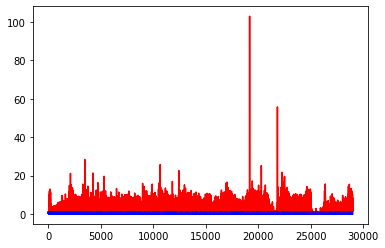

white ratio : 53.25
min : 184
max : 221


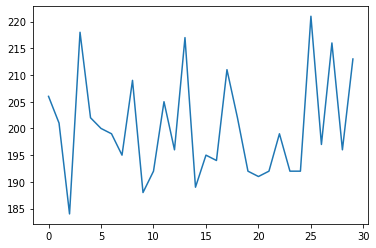

Generating interpolations...
29001 [D loss: 0.000318, acc.: 100.00%] [G loss: 4.172579, 3.619698]
29002 [D loss: 0.000037, acc.: 100.00%] [G loss: 1.842405, 0.888666]
29003 [D loss: 0.000038, acc.: 100.00%] [G loss: 28.240034, 6.073727]
29004 [D loss: 0.307424, acc.: 96.88%] [G loss: 5.108917, 4.668409]
29005 [D loss: 0.000401, acc.: 100.00%] [G loss: 3.813655, 3.265577]
29006 [D loss: 0.000239, acc.: 100.00%] [G loss: 3.999863, 1.421586]
29007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.613881, 0.622817]
29008 [D loss: 0.001429, acc.: 100.00%] [G loss: 2.259799, 1.547462]
29009 [D loss: 0.005996, acc.: 100.00%] [G loss: 2.123750, 1.536892]
29010 [D loss: 0.000272, acc.: 100.00%] [G loss: 7.979096, 1.474962]
29011 [D loss: 0.002958, acc.: 100.00%] [G loss: 2.170733, 1.966088]
29012 [D loss: 0.000226, acc.: 100.00%] [G loss: 3.357628, 0.880523]
29013 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.933087, 0.591507]
29014 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.615069, 0.260771]
29015

29122 [D loss: 0.002045, acc.: 100.00%] [G loss: 1.114778, 1.064921]
29123 [D loss: 0.002149, acc.: 100.00%] [G loss: 0.263159, 0.152209]
29124 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.214292, 0.009067]
29125 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.032643, 0.001543]
29126 [D loss: 0.000102, acc.: 100.00%] [G loss: 1.099486, 1.986003]
29127 [D loss: 0.001965, acc.: 100.00%] [G loss: 22.627621, 2.969920]
29128 [D loss: 0.013607, acc.: 100.00%] [G loss: 5.526358, 4.727616]
29129 [D loss: 0.006372, acc.: 100.00%] [G loss: 8.952986, 7.495987]
29130 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.867966, 7.841153]
29131 [D loss: 0.000039, acc.: 100.00%] [G loss: 7.193201, 5.563480]
29132 [D loss: 0.000489, acc.: 100.00%] [G loss: 7.077382, 5.452403]
29133 [D loss: 0.000387, acc.: 100.00%] [G loss: 5.015885, 4.985112]
29134 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.916656, 3.517417]
29135 [D loss: 0.000020, acc.: 100.00%] [G loss: 16.027096, 3.719748]
29136 [D loss: 0.000089, acc.: 1

29244 [D loss: 0.039059, acc.: 96.88%] [G loss: 0.646981, 0.022486]
29245 [D loss: 0.000272, acc.: 100.00%] [G loss: 3.816551, 2.877850]
29246 [D loss: 0.001328, acc.: 100.00%] [G loss: 0.730022, 0.959642]
29247 [D loss: 0.001878, acc.: 100.00%] [G loss: 0.972740, 0.707125]
29248 [D loss: 0.011600, acc.: 100.00%] [G loss: 0.925249, 0.395129]
29249 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.367049, 0.084837]
29250 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.637997, 0.036430]
29251 [D loss: 0.005659, acc.: 100.00%] [G loss: 3.813846, 2.462065]
29252 [D loss: 0.001759, acc.: 100.00%] [G loss: 2.037127, 1.388195]
29253 [D loss: 0.002677, acc.: 100.00%] [G loss: 4.083411, 2.132362]
29254 [D loss: 0.001454, acc.: 100.00%] [G loss: 5.263529, 3.400561]
29255 [D loss: 0.000895, acc.: 100.00%] [G loss: 2.631443, 2.540206]
29256 [D loss: 0.000421, acc.: 100.00%] [G loss: 1.097760, 0.119862]
29257 [D loss: 0.000525, acc.: 100.00%] [G loss: 5.709331, 5.428332]
29258 [D loss: 0.000218, acc.: 100.

29366 [D loss: 0.000011, acc.: 100.00%] [G loss: 10.258905, 9.922295]
29367 [D loss: 0.000040, acc.: 100.00%] [G loss: 9.461138, 7.902474]
29368 [D loss: 0.000133, acc.: 100.00%] [G loss: 6.753560, 5.660277]
29369 [D loss: 0.058019, acc.: 96.88%] [G loss: 20.173645, 7.807856]
29370 [D loss: 0.000449, acc.: 100.00%] [G loss: 12.878594, 8.338037]
29371 [D loss: 0.000019, acc.: 100.00%] [G loss: 28.694115, 11.879112]
29372 [D loss: 0.000183, acc.: 100.00%] [G loss: 12.983639, 12.890243]
29373 [D loss: 0.011234, acc.: 100.00%] [G loss: 11.752148, 10.751201]
29374 [D loss: 0.000017, acc.: 100.00%] [G loss: 11.218328, 10.509995]
29375 [D loss: 0.000026, acc.: 100.00%] [G loss: 9.421144, 9.512588]
29376 [D loss: 0.000047, acc.: 100.00%] [G loss: 13.227201, 12.976008]
29377 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.076706, 8.544718]
29378 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.626423, 10.608053]
29379 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.118295, 9.315984]
29380 [D loss: 0.0018

29485 [D loss: 0.000193, acc.: 100.00%] [G loss: 2.380328, 2.272842]
29486 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.329037, 0.137573]
29487 [D loss: 0.000378, acc.: 100.00%] [G loss: 1.958487, 1.273893]
29488 [D loss: 0.000441, acc.: 100.00%] [G loss: 2.899398, 1.776877]
29489 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.713408, 0.398086]
29490 [D loss: 0.000576, acc.: 100.00%] [G loss: 0.332898, 0.009258]
29491 [D loss: 0.001109, acc.: 100.00%] [G loss: 18.566214, 2.408518]
29492 [D loss: 0.000454, acc.: 100.00%] [G loss: 2.332553, 2.791053]
29493 [D loss: 0.000526, acc.: 100.00%] [G loss: 1.458856, 0.654394]
29494 [D loss: 0.000901, acc.: 100.00%] [G loss: 0.043607, 0.037893]
29495 [D loss: 0.000081, acc.: 100.00%] [G loss: 10.231306, 1.836758]
29496 [D loss: 0.000105, acc.: 100.00%] [G loss: 1.289232, 0.612340]
29497 [D loss: 0.000737, acc.: 100.00%] [G loss: 0.120943, 0.064644]
29498 [D loss: 0.010931, acc.: 100.00%] [G loss: 13.316765, 5.146774]
29499 [D loss: 0.001354, acc.: 

29605 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.756838, 0.432159]
29606 [D loss: 0.000539, acc.: 100.00%] [G loss: 0.529506, 0.013000]
29607 [D loss: 0.001384, acc.: 100.00%] [G loss: 0.041492, 0.065163]
29608 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.011693, 0.024824]
29609 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.003431, 0.000586]
29610 [D loss: 0.000275, acc.: 100.00%] [G loss: 20.007832, 0.017100]
29611 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.628411, 0.890799]
29612 [D loss: 0.000386, acc.: 100.00%] [G loss: 2.574539, 1.702215]
29613 [D loss: 0.000939, acc.: 100.00%] [G loss: 0.446573, 0.499931]
29614 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.293684, 0.314755]
29615 [D loss: 0.002220, acc.: 100.00%] [G loss: 7.135900, 2.479673]
29616 [D loss: 0.015782, acc.: 100.00%] [G loss: 0.134358, 0.223847]
29617 [D loss: 0.006183, acc.: 100.00%] [G loss: 1.380746, 0.689204]
29618 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.462601, 0.401337]
29619 [D loss: 0.019207, acc.: 10

29724 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.948596, 0.737323]
29725 [D loss: 0.000035, acc.: 100.00%] [G loss: 2.335042, 1.257420]
29726 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.429820, 0.227966]
29727 [D loss: 0.003357, acc.: 100.00%] [G loss: 0.340947, 0.182551]
29728 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.376205, 0.204647]
29729 [D loss: 0.000817, acc.: 100.00%] [G loss: 7.673831, 3.521298]
29730 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.717030, 3.738294]
29731 [D loss: 0.000893, acc.: 100.00%] [G loss: 3.119301, 2.756054]
29732 [D loss: 0.000205, acc.: 100.00%] [G loss: 1.662485, 1.408122]
29733 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.130331, 1.204678]
29734 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.668962, 0.401645]
29735 [D loss: 0.000455, acc.: 100.00%] [G loss: 1.276695, 2.209456]
29736 [D loss: 0.000175, acc.: 100.00%] [G loss: 1.460311, 0.966479]
29737 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.595838, 0.366626]
29738 [D loss: 0.000633, acc.: 100

29844 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.379986, 0.093747]
29845 [D loss: 0.000527, acc.: 100.00%] [G loss: 0.129708, 0.101355]
29846 [D loss: 0.001041, acc.: 100.00%] [G loss: 0.001442, 0.007314]
29847 [D loss: 0.001713, acc.: 100.00%] [G loss: 0.062074, 0.014298]
29848 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.105797, 0.034009]
29849 [D loss: 0.001381, acc.: 100.00%] [G loss: 0.231221, 0.526499]
29850 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.055188, 0.051165]
29851 [D loss: 0.000927, acc.: 100.00%] [G loss: 0.118090, 0.038883]
29852 [D loss: 0.005678, acc.: 100.00%] [G loss: 0.166221, 0.165826]
29853 [D loss: 0.000170, acc.: 100.00%] [G loss: 13.581631, 0.411962]
29854 [D loss: 0.000631, acc.: 100.00%] [G loss: 1.252580, 0.914089]
29855 [D loss: 0.000444, acc.: 100.00%] [G loss: 0.528816, 0.420612]
29856 [D loss: 0.000672, acc.: 100.00%] [G loss: 0.060864, 0.021744]
29857 [D loss: 0.000091, acc.: 100.00%] [G loss: 2.803388, 1.903922]
29858 [D loss: 0.000299, acc.: 10

29964 [D loss: 0.000129, acc.: 100.00%] [G loss: 1.270460, 0.993622]
29965 [D loss: 0.000345, acc.: 100.00%] [G loss: 0.000350, 0.000216]
29966 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.193703, 0.135722]
29967 [D loss: 0.000564, acc.: 100.00%] [G loss: 1.045563, 0.393888]
29968 [D loss: 0.004066, acc.: 100.00%] [G loss: 6.695099, 0.694642]
29969 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.191140, 0.108616]
29970 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.406776, 0.520299]
29971 [D loss: 0.000318, acc.: 100.00%] [G loss: 0.120467, 0.033770]
29972 [D loss: 0.000271, acc.: 100.00%] [G loss: 0.690551, 0.198310]
29973 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.187592, 0.013928]
29974 [D loss: 0.025426, acc.: 96.88%] [G loss: 0.023386, 0.007170]
29975 [D loss: 0.001430, acc.: 100.00%] [G loss: 0.004396, 0.008476]
29976 [D loss: 0.000105, acc.: 100.00%] [G loss: 6.204420, 0.073238]
29977 [D loss: 0.001659, acc.: 100.00%] [G loss: 1.066560, 0.536157]
29978 [D loss: 0.000169, acc.: 100.

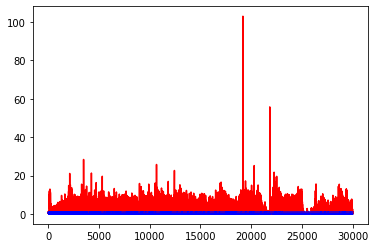

white ratio : 51.0
min : 184
max : 221


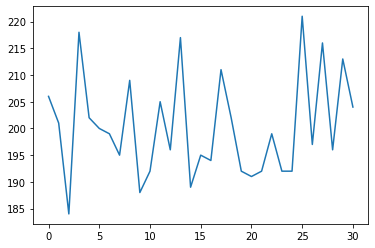

Generating interpolations...
30001 [D loss: 0.000475, acc.: 100.00%] [G loss: 1.995918, 1.612464]
30002 [D loss: 0.001132, acc.: 100.00%] [G loss: 0.135515, 0.082476]
30003 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.330444, 1.569084]
30004 [D loss: 0.001040, acc.: 100.00%] [G loss: 6.949205, 1.873798]
30005 [D loss: 0.000415, acc.: 100.00%] [G loss: 10.427748, 2.833258]
30006 [D loss: 0.000109, acc.: 100.00%] [G loss: 4.032272, 3.900211]
30007 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.880698, 1.708030]
30008 [D loss: 0.000013, acc.: 100.00%] [G loss: 4.153568, 4.231859]
30009 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.573216, 0.552410]
30010 [D loss: 0.001021, acc.: 100.00%] [G loss: 0.620307, 0.585671]
30011 [D loss: 0.000029, acc.: 100.00%] [G loss: 2.760649, 1.692683]
30012 [D loss: 0.000006, acc.: 100.00%] [G loss: 26.433083, 4.425385]
30013 [D loss: 0.000439, acc.: 100.00%] [G loss: 0.198880, 0.901645]
30014 [D loss: 0.000208, acc.: 100.00%] [G loss: 1.614249, 1.228459]
300

30117 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.995138, 5.640680]
30118 [D loss: 0.000008, acc.: 100.00%] [G loss: 6.588939, 5.982675]
30119 [D loss: 0.000100, acc.: 100.00%] [G loss: 3.425800, 2.681059]
30120 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.478419, 3.225251]
30121 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.827332, 0.991561]
30122 [D loss: 0.001118, acc.: 100.00%] [G loss: 1.632029, 0.884988]
30123 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.378599, 0.327974]
30124 [D loss: 0.000081, acc.: 100.00%] [G loss: 2.676048, 2.209849]
30125 [D loss: 0.000141, acc.: 100.00%] [G loss: 13.879127, 2.665993]
30126 [D loss: 0.001042, acc.: 100.00%] [G loss: 4.492040, 5.172247]
30127 [D loss: 0.000067, acc.: 100.00%] [G loss: 3.513777, 2.605474]
30128 [D loss: 0.000088, acc.: 100.00%] [G loss: 4.210497, 4.064255]
30129 [D loss: 0.000165, acc.: 100.00%] [G loss: 2.254228, 1.272833]
30130 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.193202, 3.644970]
30131 [D loss: 0.000497, acc.: 10

30237 [D loss: 0.000248, acc.: 100.00%] [G loss: 2.990872, 3.060446]
30238 [D loss: 0.000017, acc.: 100.00%] [G loss: 9.927088, 4.266463]
30239 [D loss: 0.001219, acc.: 100.00%] [G loss: 4.317272, 2.511202]
30240 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.269936, 1.212411]
30241 [D loss: 0.000007, acc.: 100.00%] [G loss: 8.871691, 3.937498]
30242 [D loss: 0.000159, acc.: 100.00%] [G loss: 4.071687, 3.744430]
30243 [D loss: 0.002471, acc.: 100.00%] [G loss: 1.797473, 0.470388]
30244 [D loss: 0.000498, acc.: 100.00%] [G loss: 0.261465, 0.055147]
30245 [D loss: 0.000318, acc.: 100.00%] [G loss: 4.464034, 0.097596]
30246 [D loss: 0.000060, acc.: 100.00%] [G loss: 10.010897, 4.229147]
30247 [D loss: 0.000015, acc.: 100.00%] [G loss: 4.689208, 4.298151]
30248 [D loss: 0.000112, acc.: 100.00%] [G loss: 8.952078, 3.146722]
30249 [D loss: 0.000019, acc.: 100.00%] [G loss: 3.159981, 3.600395]
30250 [D loss: 0.000072, acc.: 100.00%] [G loss: 2.996908, 2.817215]
30251 [D loss: 0.007599, acc.: 10

30357 [D loss: 0.000621, acc.: 100.00%] [G loss: 8.309860, 3.236468]
30358 [D loss: 0.000307, acc.: 100.00%] [G loss: 2.904554, 1.987107]
30359 [D loss: 0.000065, acc.: 100.00%] [G loss: 1.510338, 1.064245]
30360 [D loss: 0.000046, acc.: 100.00%] [G loss: 3.888033, 3.470965]
30361 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.040528, 0.034083]
30362 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.104785, 0.132427]
30363 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.054615, 0.149303]
30364 [D loss: 0.000257, acc.: 100.00%] [G loss: 1.408084, 1.562233]
30365 [D loss: 0.000021, acc.: 100.00%] [G loss: 5.864641, 0.133530]
30366 [D loss: 0.000020, acc.: 100.00%] [G loss: 4.165596, 3.846499]
30367 [D loss: 0.004590, acc.: 100.00%] [G loss: 4.587598, 4.127099]
30368 [D loss: 0.000070, acc.: 100.00%] [G loss: 8.161318, 0.905105]
30369 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.332130, 0.294151]
30370 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.558799, 1.574075]
30371 [D loss: 0.001342, acc.: 100

30478 [D loss: 0.000020, acc.: 100.00%] [G loss: 4.131076, 4.665616]
30479 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.618024, 0.648437]
30480 [D loss: 0.000033, acc.: 100.00%] [G loss: 2.101984, 1.951302]
30481 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.614008, 2.665177]
30482 [D loss: 0.000059, acc.: 100.00%] [G loss: 2.232256, 2.276577]
30483 [D loss: 0.000302, acc.: 100.00%] [G loss: 0.958680, 0.930761]
30484 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.186159, 1.037140]
30485 [D loss: 0.000119, acc.: 100.00%] [G loss: 1.392996, 0.494504]
30486 [D loss: 0.002060, acc.: 100.00%] [G loss: 1.427384, 1.655959]
30487 [D loss: 0.000068, acc.: 100.00%] [G loss: 1.242006, 0.714440]
30488 [D loss: 0.000251, acc.: 100.00%] [G loss: 1.003190, 0.000042]
30489 [D loss: 0.220572, acc.: 96.88%] [G loss: 0.036946, 0.003374]
30490 [D loss: 0.083008, acc.: 96.88%] [G loss: 0.809594, 0.359901]
30491 [D loss: 0.000270, acc.: 100.00%] [G loss: 1.535854, 1.141810]
30492 [D loss: 0.003620, acc.: 100.0

30597 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.188124, 0.135872]
30598 [D loss: 0.000337, acc.: 100.00%] [G loss: 2.580367, 0.637877]
30599 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.855127, 1.207956]
30600 [D loss: 0.000873, acc.: 100.00%] [G loss: 4.534895, 3.263099]
30601 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.789725, 0.365588]
30602 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.525337, 0.301088]
30603 [D loss: 0.000407, acc.: 100.00%] [G loss: 0.290608, 0.309087]
30604 [D loss: 0.001137, acc.: 100.00%] [G loss: 0.012540, 0.279555]
30605 [D loss: 0.000212, acc.: 100.00%] [G loss: 3.554701, 4.133012]
30606 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.431764, 0.301064]
30607 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.720652, 0.717943]
30608 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.006537, 0.006288]
30609 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.944365, 0.429815]
30610 [D loss: 0.000028, acc.: 100.00%] [G loss: 7.662197, 0.351983]
30611 [D loss: 0.000111, acc.: 100

30717 [D loss: 0.000681, acc.: 100.00%] [G loss: 1.508045, 1.477644]
30718 [D loss: 0.000192, acc.: 100.00%] [G loss: 3.934632, 3.282688]
30719 [D loss: 0.000646, acc.: 100.00%] [G loss: 2.740486, 2.837292]
30720 [D loss: 0.000015, acc.: 100.00%] [G loss: 14.481664, 1.671742]
30721 [D loss: 0.000061, acc.: 100.00%] [G loss: 4.843186, 4.055717]
30722 [D loss: 0.000626, acc.: 100.00%] [G loss: 12.398420, 7.113771]
30723 [D loss: 0.000005, acc.: 100.00%] [G loss: 17.580898, 5.401288]
30724 [D loss: 0.000029, acc.: 100.00%] [G loss: 7.685275, 6.517505]
30725 [D loss: 0.000019, acc.: 100.00%] [G loss: 3.054708, 0.584653]
30726 [D loss: 0.000015, acc.: 100.00%] [G loss: 2.332186, 2.423487]
30727 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.343882, 5.193261]
30728 [D loss: 0.000223, acc.: 100.00%] [G loss: 5.943272, 5.658383]
30729 [D loss: 0.000042, acc.: 100.00%] [G loss: 1.917582, 1.529459]
30730 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.428131, 2.226938]
30731 [D loss: 0.000128, acc.: 

30836 [D loss: 0.001688, acc.: 100.00%] [G loss: 10.669819, 5.357369]
30837 [D loss: 0.000150, acc.: 100.00%] [G loss: 5.948663, 6.017551]
30838 [D loss: 0.003402, acc.: 100.00%] [G loss: 3.492368, 6.084508]
30839 [D loss: 0.000052, acc.: 100.00%] [G loss: 4.841560, 4.501966]
30840 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.097368, 0.240562]
30841 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.165256, 6.424475]
30842 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.774337, 1.671006]
30843 [D loss: 0.000471, acc.: 100.00%] [G loss: 7.811135, 7.216350]
30844 [D loss: 0.000204, acc.: 100.00%] [G loss: 7.690597, 6.551018]
30845 [D loss: 0.000253, acc.: 100.00%] [G loss: 7.396603, 7.742899]
30846 [D loss: 0.000221, acc.: 100.00%] [G loss: 8.044329, 0.972229]
30847 [D loss: 0.000072, acc.: 100.00%] [G loss: 3.894940, 3.492876]
30848 [D loss: 0.000084, acc.: 100.00%] [G loss: 7.495125, 6.557916]
30849 [D loss: 0.000222, acc.: 100.00%] [G loss: 6.677029, 6.045390]
30850 [D loss: 0.000303, acc.: 10

30958 [D loss: 0.000896, acc.: 100.00%] [G loss: 10.051748, 6.396511]
30959 [D loss: 0.000256, acc.: 100.00%] [G loss: 6.864844, 6.623696]
30960 [D loss: 0.000303, acc.: 100.00%] [G loss: 2.980433, 3.194381]
30961 [D loss: 0.000158, acc.: 100.00%] [G loss: 6.466716, 6.940843]
30962 [D loss: 0.000425, acc.: 100.00%] [G loss: 6.165266, 6.361476]
30963 [D loss: 0.000181, acc.: 100.00%] [G loss: 7.239888, 7.554945]
30964 [D loss: 0.000035, acc.: 100.00%] [G loss: 2.154325, 1.984896]
30965 [D loss: 0.001309, acc.: 100.00%] [G loss: 5.606294, 5.611608]
30966 [D loss: 0.000009, acc.: 100.00%] [G loss: 6.212598, 5.954019]
30967 [D loss: 0.001734, acc.: 100.00%] [G loss: 0.918363, 1.226798]
30968 [D loss: 0.000068, acc.: 100.00%] [G loss: 2.131192, 0.823492]
30969 [D loss: 0.000008, acc.: 100.00%] [G loss: 6.451819, 6.314492]
30970 [D loss: 0.000038, acc.: 100.00%] [G loss: 4.654364, 4.159790]
30971 [D loss: 0.000157, acc.: 100.00%] [G loss: 4.845871, 4.032830]
30972 [D loss: 0.000018, acc.: 10

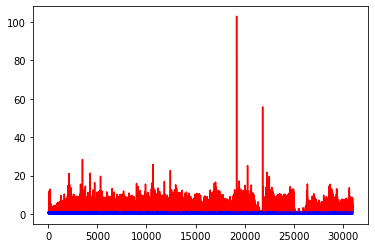

white ratio : 46.75
min : 184
max : 221


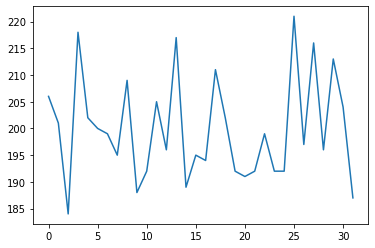

Generating interpolations...
31001 [D loss: 0.000185, acc.: 100.00%] [G loss: 2.470071, 1.731564]
31002 [D loss: 0.000138, acc.: 100.00%] [G loss: 7.514321, 7.191924]
31003 [D loss: 0.000488, acc.: 100.00%] [G loss: 7.223504, 5.377590]
31004 [D loss: 0.000081, acc.: 100.00%] [G loss: 4.839285, 4.007808]
31005 [D loss: 0.000104, acc.: 100.00%] [G loss: 2.855616, 2.812579]
31006 [D loss: 0.005411, acc.: 100.00%] [G loss: 3.260529, 1.971062]
31007 [D loss: 0.000972, acc.: 100.00%] [G loss: 1.912609, 1.772264]
31008 [D loss: 0.000297, acc.: 100.00%] [G loss: 2.971931, 3.155598]
31009 [D loss: 0.000458, acc.: 100.00%] [G loss: 3.202304, 1.803851]
31010 [D loss: 0.000051, acc.: 100.00%] [G loss: 4.314532, 3.832935]
31011 [D loss: 0.000907, acc.: 100.00%] [G loss: 5.499814, 5.559978]
31012 [D loss: 0.001646, acc.: 100.00%] [G loss: 1.017733, 1.517542]
31013 [D loss: 0.000039, acc.: 100.00%] [G loss: 18.253468, 5.405158]
31014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.332101, 0.249833]
3101

31121 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.966161, 2.035250]
31122 [D loss: 0.000176, acc.: 100.00%] [G loss: 11.413521, 0.341405]
31123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.215498, 0.134689]
31124 [D loss: 0.028968, acc.: 96.88%] [G loss: 0.331120, 0.485726]
31125 [D loss: 0.000118, acc.: 100.00%] [G loss: 6.304427, 6.662643]
31126 [D loss: 0.004529, acc.: 100.00%] [G loss: 16.562923, 8.329246]
31127 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.837004, 8.229960]
31128 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.231948, 7.883327]
31129 [D loss: 0.000165, acc.: 100.00%] [G loss: 10.720990, 2.569616]
31130 [D loss: 0.000279, acc.: 100.00%] [G loss: 8.133251, 7.568003]
31131 [D loss: 0.000005, acc.: 100.00%] [G loss: 11.464006, 11.308228]
31132 [D loss: 0.014099, acc.: 100.00%] [G loss: 8.768908, 8.533073]
31133 [D loss: 0.000023, acc.: 100.00%] [G loss: 9.604479, 9.921495]
31134 [D loss: 0.018495, acc.: 100.00%] [G loss: 6.431451, 6.388095]
31135 [D loss: 0.000233, acc.:

31242 [D loss: 0.001662, acc.: 100.00%] [G loss: 1.297311, 1.159615]
31243 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.907647, 0.408597]
31244 [D loss: 0.000287, acc.: 100.00%] [G loss: 5.682530, 2.959399]
31245 [D loss: 0.002259, acc.: 100.00%] [G loss: 1.399135, 0.673318]
31246 [D loss: 0.040857, acc.: 96.88%] [G loss: 7.726528, 4.767632]
31247 [D loss: 0.000039, acc.: 100.00%] [G loss: 1.613992, 1.365477]
31248 [D loss: 0.000086, acc.: 100.00%] [G loss: 5.209470, 5.029405]
31249 [D loss: 0.000059, acc.: 100.00%] [G loss: 5.618633, 5.605469]
31250 [D loss: 0.000019, acc.: 100.00%] [G loss: 15.901714, 6.102283]
31251 [D loss: 0.006328, acc.: 100.00%] [G loss: 4.893790, 3.723720]
31252 [D loss: 0.000027, acc.: 100.00%] [G loss: 5.436952, 4.648654]
31253 [D loss: 0.000240, acc.: 100.00%] [G loss: 7.863207, 4.529525]
31254 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.444735, 4.136994]
31255 [D loss: 0.001774, acc.: 100.00%] [G loss: 5.220362, 5.040088]
31256 [D loss: 0.000195, acc.: 100

31362 [D loss: 0.000077, acc.: 100.00%] [G loss: 15.079161, 1.615358]
31363 [D loss: 0.000117, acc.: 100.00%] [G loss: 6.651991, 6.669408]
31364 [D loss: 0.000026, acc.: 100.00%] [G loss: 6.832219, 6.413946]
31365 [D loss: 0.000061, acc.: 100.00%] [G loss: 5.249277, 4.745178]
31366 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.820053, 0.335956]
31367 [D loss: 0.000020, acc.: 100.00%] [G loss: 4.202423, 3.654657]
31368 [D loss: 0.000031, acc.: 100.00%] [G loss: 2.165918, 1.957900]
31369 [D loss: 0.025942, acc.: 96.88%] [G loss: 10.773977, 8.218163]
31370 [D loss: 0.000266, acc.: 100.00%] [G loss: 9.170493, 8.452646]
31371 [D loss: 0.000024, acc.: 100.00%] [G loss: 6.579720, 5.190009]
31372 [D loss: 0.007183, acc.: 100.00%] [G loss: 18.231533, 7.926181]
31373 [D loss: 0.000630, acc.: 100.00%] [G loss: 4.543553, 3.382771]
31374 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.595651, 5.790816]
31375 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.826196, 1.236227]
31376 [D loss: 0.000013, acc.: 1

31484 [D loss: 0.000633, acc.: 100.00%] [G loss: 19.245819, 5.931894]
31485 [D loss: 0.000035, acc.: 100.00%] [G loss: 5.816920, 5.227622]
31486 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.922522, 3.327212]
31487 [D loss: 0.001871, acc.: 100.00%] [G loss: 6.279377, 5.176402]
31488 [D loss: 0.000032, acc.: 100.00%] [G loss: 22.058069, 7.768580]
31489 [D loss: 0.000024, acc.: 100.00%] [G loss: 6.310413, 6.628341]
31490 [D loss: 0.000088, acc.: 100.00%] [G loss: 6.224768, 5.954365]
31491 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.789822, 4.457058]
31492 [D loss: 0.000042, acc.: 100.00%] [G loss: 5.998425, 5.750462]
31493 [D loss: 0.000059, acc.: 100.00%] [G loss: 5.844451, 4.609523]
31494 [D loss: 0.000113, acc.: 100.00%] [G loss: 6.588220, 5.691238]
31495 [D loss: 0.000010, acc.: 100.00%] [G loss: 4.008420, 2.996383]
31496 [D loss: 0.000226, acc.: 100.00%] [G loss: 5.412144, 4.163397]
31497 [D loss: 0.000070, acc.: 100.00%] [G loss: 5.090186, 3.165615]
31498 [D loss: 0.000365, acc.: 1

31603 [D loss: 0.000045, acc.: 100.00%] [G loss: 2.387767, 0.064966]
31604 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.126752, 0.013156]
31605 [D loss: 0.070061, acc.: 96.88%] [G loss: 0.272473, 0.337941]
31606 [D loss: 0.001790, acc.: 100.00%] [G loss: 0.595412, 0.252058]
31607 [D loss: 0.003574, acc.: 100.00%] [G loss: 0.000359, 0.000035]
31608 [D loss: 0.000361, acc.: 100.00%] [G loss: 1.172001, 0.206451]
31609 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.099918, 0.068776]
31610 [D loss: 0.000864, acc.: 100.00%] [G loss: 0.283697, 0.528947]
31611 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.330447, 0.475939]
31612 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.148895, 0.190315]
31613 [D loss: 0.000882, acc.: 100.00%] [G loss: 8.592761, 0.334848]
31614 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.922336, 1.264225]
31615 [D loss: 0.000637, acc.: 100.00%] [G loss: 0.080163, 0.106642]
31616 [D loss: 0.052685, acc.: 96.88%] [G loss: 1.005376, 0.829610]
31617 [D loss: 0.000262, acc.: 100.0

31724 [D loss: 0.000430, acc.: 100.00%] [G loss: 0.151231, 0.692340]
31725 [D loss: 0.001007, acc.: 100.00%] [G loss: 0.052636, 0.056432]
31726 [D loss: 0.007108, acc.: 100.00%] [G loss: 7.748681, 1.120833]
31727 [D loss: 0.000051, acc.: 100.00%] [G loss: 4.977436, 3.176675]
31728 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.204894, 1.730502]
31729 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.522460, 0.287017]
31730 [D loss: 0.000231, acc.: 100.00%] [G loss: 3.919086, 3.235570]
31731 [D loss: 0.000277, acc.: 100.00%] [G loss: 0.687454, 0.646673]
31732 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.165832, 0.050220]
31733 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.031765, 0.263818]
31734 [D loss: 0.000028, acc.: 100.00%] [G loss: 2.437273, 2.516242]
31735 [D loss: 0.000333, acc.: 100.00%] [G loss: 1.239177, 1.093381]
31736 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.328926, 1.123735]
31737 [D loss: 0.000811, acc.: 100.00%] [G loss: 1.147320, 1.159457]
31738 [D loss: 0.000250, acc.: 100

31843 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.632150, 1.084587]
31844 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.006577, 0.539784]
31845 [D loss: 0.000249, acc.: 100.00%] [G loss: 3.494724, 3.661961]
31846 [D loss: 0.000021, acc.: 100.00%] [G loss: 3.018871, 3.495719]
31847 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.749132, 1.044541]
31848 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.422596, 0.620860]
31849 [D loss: 0.000075, acc.: 100.00%] [G loss: 2.936207, 2.696647]
31850 [D loss: 0.000035, acc.: 100.00%] [G loss: 16.439777, 3.991476]
31851 [D loss: 0.000082, acc.: 100.00%] [G loss: 3.251059, 3.246589]
31852 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.043447, 3.813859]
31853 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.108670, 3.708692]
31854 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.363031, 2.173897]
31855 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.062673, 3.439538]
31856 [D loss: 0.000061, acc.: 100.00%] [G loss: 3.684760, 4.577604]
31857 [D loss: 0.000099, acc.: 10

31963 [D loss: 0.000135, acc.: 100.00%] [G loss: 1.794347, 2.607143]
31964 [D loss: 0.000071, acc.: 100.00%] [G loss: 3.380815, 3.941375]
31965 [D loss: 0.000276, acc.: 100.00%] [G loss: 4.556629, 4.574747]
31966 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.098729, 4.690010]
31967 [D loss: 0.000029, acc.: 100.00%] [G loss: 5.845509, 5.390916]
31968 [D loss: 0.000050, acc.: 100.00%] [G loss: 1.470366, 1.714739]
31969 [D loss: 0.000062, acc.: 100.00%] [G loss: 2.558305, 2.253532]
31970 [D loss: 0.000094, acc.: 100.00%] [G loss: 3.332131, 3.540097]
31971 [D loss: 0.000087, acc.: 100.00%] [G loss: 15.564915, 0.530497]
31972 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.193736, 0.215504]
31973 [D loss: 0.018184, acc.: 100.00%] [G loss: 2.037722, 1.789022]
31974 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.902009, 1.055952]
31975 [D loss: 0.000820, acc.: 100.00%] [G loss: 2.871316, 2.183385]
31976 [D loss: 0.002506, acc.: 100.00%] [G loss: 0.009589, 0.020762]
31977 [D loss: 0.000345, acc.: 10

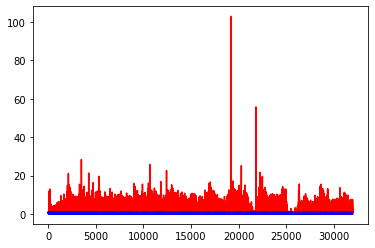

white ratio : 50.25
min : 184
max : 221


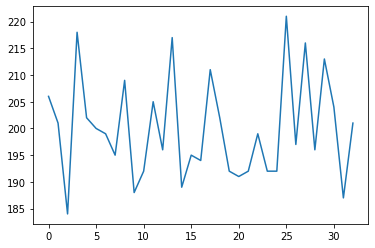

Generating interpolations...
32001 [D loss: 0.000247, acc.: 100.00%] [G loss: 2.726681, 2.406175]
32002 [D loss: 0.000243, acc.: 100.00%] [G loss: 4.718657, 4.450380]
32003 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.611536, 1.052984]
32004 [D loss: 0.000196, acc.: 100.00%] [G loss: 2.401452, 2.113413]
32005 [D loss: 0.000117, acc.: 100.00%] [G loss: 2.615404, 2.561898]
32006 [D loss: 0.000041, acc.: 100.00%] [G loss: 2.976327, 2.139557]
32007 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.461446, 0.283655]
32008 [D loss: 0.000080, acc.: 100.00%] [G loss: 3.091555, 2.349545]
32009 [D loss: 0.000275, acc.: 100.00%] [G loss: 1.611570, 1.174076]
32010 [D loss: 0.004477, acc.: 100.00%] [G loss: 18.770544, 2.810530]
32011 [D loss: 0.000362, acc.: 100.00%] [G loss: 3.406727, 2.334722]
32012 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.452366, 0.190664]
32013 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.174581, 0.046337]
32014 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.247806, 0.250065]
3201

32121 [D loss: 0.000056, acc.: 100.00%] [G loss: 1.471094, 1.240482]
32122 [D loss: 0.000159, acc.: 100.00%] [G loss: 2.030222, 1.292394]
32123 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.760935, 4.033073]
32124 [D loss: 0.000084, acc.: 100.00%] [G loss: 1.807917, 2.245003]
32125 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.035494, 0.041570]
32126 [D loss: 0.000228, acc.: 100.00%] [G loss: 2.001030, 0.011515]
32127 [D loss: 0.003705, acc.: 100.00%] [G loss: 0.882740, 2.848897]
32128 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.265715, 0.462720]
32129 [D loss: 0.000480, acc.: 100.00%] [G loss: 2.515573, 1.804124]
32130 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.627651, 1.358770]
32131 [D loss: 0.000018, acc.: 100.00%] [G loss: 8.596075, 3.121599]
32132 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.414299, 1.850952]
32133 [D loss: 0.000024, acc.: 100.00%] [G loss: 4.821769, 4.072364]
32134 [D loss: 0.000022, acc.: 100.00%] [G loss: 7.298456, 6.969398]
32135 [D loss: 0.000008, acc.: 100

32240 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.184284, 3.570061]
32241 [D loss: 0.172137, acc.: 93.75%] [G loss: 0.158348, 0.331995]
32242 [D loss: 0.006250, acc.: 100.00%] [G loss: 0.411390, 0.018038]
32243 [D loss: 0.010003, acc.: 100.00%] [G loss: 0.005409, 0.013591]
32244 [D loss: 0.001336, acc.: 100.00%] [G loss: 0.348396, 0.000843]
32245 [D loss: 0.000225, acc.: 100.00%] [G loss: 2.366422, 2.088878]
32246 [D loss: 0.001129, acc.: 100.00%] [G loss: 1.414418, 1.209958]
32247 [D loss: 0.000049, acc.: 100.00%] [G loss: 3.197220, 2.761036]
32248 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.853611, 0.526834]
32249 [D loss: 0.000049, acc.: 100.00%] [G loss: 2.992676, 1.891960]
32250 [D loss: 0.000574, acc.: 100.00%] [G loss: 2.321363, 1.846346]
32251 [D loss: 0.000099, acc.: 100.00%] [G loss: 6.452715, 0.379434]
32252 [D loss: 0.000017, acc.: 100.00%] [G loss: 3.600546, 3.091116]
32253 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.047187, 3.288141]
32254 [D loss: 0.000043, acc.: 100.

32360 [D loss: 0.000116, acc.: 100.00%] [G loss: 1.424179, 1.254742]
32361 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.052163, 0.004372]
32362 [D loss: 0.000903, acc.: 100.00%] [G loss: 0.229423, 0.129569]
32363 [D loss: 0.000983, acc.: 100.00%] [G loss: 0.015168, 0.008549]
32364 [D loss: 0.000565, acc.: 100.00%] [G loss: 0.060208, 0.084294]
32365 [D loss: 0.047003, acc.: 96.88%] [G loss: 4.032310, 3.404229]
32366 [D loss: 0.001727, acc.: 100.00%] [G loss: 0.002431, 0.007040]
32367 [D loss: 0.003603, acc.: 100.00%] [G loss: 3.287141, 2.431146]
32368 [D loss: 0.009363, acc.: 100.00%] [G loss: 4.510028, 8.468437]
32369 [D loss: 0.001057, acc.: 100.00%] [G loss: 0.801500, 1.138215]
32370 [D loss: 0.000719, acc.: 100.00%] [G loss: 4.702711, 4.965588]
32371 [D loss: 0.001365, acc.: 100.00%] [G loss: 1.027010, 0.875500]
32372 [D loss: 0.023572, acc.: 96.88%] [G loss: 1.568879, 1.757558]
32373 [D loss: 0.026713, acc.: 96.88%] [G loss: 0.166371, 0.079803]
32374 [D loss: 0.003572, acc.: 100.00

32479 [D loss: 0.000540, acc.: 100.00%] [G loss: 0.246841, 0.282466]
32480 [D loss: 0.001447, acc.: 100.00%] [G loss: 2.332097, 1.696066]
32481 [D loss: 0.000068, acc.: 100.00%] [G loss: 6.259139, 1.779875]
32482 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.329041, 0.317765]
32483 [D loss: 0.000545, acc.: 100.00%] [G loss: 0.344857, 0.189673]
32484 [D loss: 0.000216, acc.: 100.00%] [G loss: 2.147692, 0.777602]
32485 [D loss: 0.001030, acc.: 100.00%] [G loss: 0.293619, 0.094781]
32486 [D loss: 0.000231, acc.: 100.00%] [G loss: 1.348499, 0.950376]
32487 [D loss: 0.002118, acc.: 100.00%] [G loss: 0.630010, 0.492094]
32488 [D loss: 0.000212, acc.: 100.00%] [G loss: 3.115849, 1.909908]
32489 [D loss: 0.002153, acc.: 100.00%] [G loss: 0.724691, 0.567172]
32490 [D loss: 0.000429, acc.: 100.00%] [G loss: 0.148279, 0.038772]
32491 [D loss: 0.000077, acc.: 100.00%] [G loss: 1.538833, 1.597225]
32492 [D loss: 0.108673, acc.: 96.88%] [G loss: 0.211826, 0.151183]
32493 [D loss: 0.000957, acc.: 100.

32598 [D loss: 0.001815, acc.: 100.00%] [G loss: 5.455439, 6.190729]
32599 [D loss: 0.000054, acc.: 100.00%] [G loss: 3.624001, 3.960635]
32600 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.736088, 0.431755]
32601 [D loss: 0.001423, acc.: 100.00%] [G loss: 3.833327, 2.779660]
32602 [D loss: 0.000232, acc.: 100.00%] [G loss: 8.824418, 7.473159]
32603 [D loss: 0.000240, acc.: 100.00%] [G loss: 1.110859, 1.142789]
32604 [D loss: 0.000125, acc.: 100.00%] [G loss: 1.995422, 2.013876]
32605 [D loss: 0.017765, acc.: 100.00%] [G loss: 7.614627, 7.216660]
32606 [D loss: 0.002284, acc.: 100.00%] [G loss: 1.768281, 0.886103]
32607 [D loss: 0.003270, acc.: 100.00%] [G loss: 0.370065, 0.382859]
32608 [D loss: 0.039676, acc.: 96.88%] [G loss: 37.264030, 8.725800]
32609 [D loss: 0.000013, acc.: 100.00%] [G loss: 9.526958, 10.426218]
32610 [D loss: 0.000527, acc.: 100.00%] [G loss: 11.967743, 12.243650]
32611 [D loss: 0.017760, acc.: 100.00%] [G loss: 11.312313, 10.868660]
32612 [D loss: 0.000007, acc.

32717 [D loss: 0.000302, acc.: 100.00%] [G loss: 10.486230, 9.300058]
32718 [D loss: 0.000011, acc.: 100.00%] [G loss: 6.222905, 6.492075]
32719 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.575199, 4.156737]
32720 [D loss: 0.000187, acc.: 100.00%] [G loss: 8.097130, 8.154284]
32721 [D loss: 0.034529, acc.: 96.88%] [G loss: 5.981677, 4.623633]
32722 [D loss: 0.000211, acc.: 100.00%] [G loss: 4.516418, 4.614308]
32723 [D loss: 0.001697, acc.: 100.00%] [G loss: 7.115431, 6.826763]
32724 [D loss: 0.000141, acc.: 100.00%] [G loss: 4.664664, 3.114048]
32725 [D loss: 0.000303, acc.: 100.00%] [G loss: 5.692931, 5.992582]
32726 [D loss: 0.000195, acc.: 100.00%] [G loss: 6.099775, 4.857938]
32727 [D loss: 0.000327, acc.: 100.00%] [G loss: 8.923661, 4.794853]
32728 [D loss: 0.000098, acc.: 100.00%] [G loss: 7.046094, 7.042268]
32729 [D loss: 0.000612, acc.: 100.00%] [G loss: 7.459348, 5.823807]
32730 [D loss: 0.000113, acc.: 100.00%] [G loss: 6.435382, 5.702222]
32731 [D loss: 0.000182, acc.: 100

32837 [D loss: 0.000016, acc.: 100.00%] [G loss: 3.791248, 3.592194]
32838 [D loss: 0.000050, acc.: 100.00%] [G loss: 3.324122, 1.647616]
32839 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.829310, 0.353314]
32840 [D loss: 0.000639, acc.: 100.00%] [G loss: 1.807613, 1.470004]
32841 [D loss: 0.001925, acc.: 100.00%] [G loss: 1.117972, 0.849083]
32842 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.668479, 0.621672]
32843 [D loss: 0.000148, acc.: 100.00%] [G loss: 33.023499, 1.241104]
32844 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.674078, 2.564296]
32845 [D loss: 0.000463, acc.: 100.00%] [G loss: 0.601040, 1.192525]
32846 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.252694, 0.310185]
32847 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.125519, 3.696568]
32848 [D loss: 0.000803, acc.: 100.00%] [G loss: 0.574928, 0.575243]
32849 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.182437, 0.575819]
32850 [D loss: 0.000790, acc.: 100.00%] [G loss: 1.742299, 1.331320]
32851 [D loss: 0.000335, acc.: 10

32959 [D loss: 0.141880, acc.: 93.75%] [G loss: 1.395435, 1.276762]
32960 [D loss: 0.000067, acc.: 100.00%] [G loss: 12.039283, 11.012653]
32961 [D loss: 0.000010, acc.: 100.00%] [G loss: 9.232887, 8.715759]
32962 [D loss: 0.066336, acc.: 96.88%] [G loss: 11.580675, 9.014632]
32963 [D loss: 0.000041, acc.: 100.00%] [G loss: 9.610031, 8.335939]
32964 [D loss: 0.000063, acc.: 100.00%] [G loss: 18.268051, 9.098648]
32965 [D loss: 0.000052, acc.: 100.00%] [G loss: 10.752577, 9.310329]
32966 [D loss: 0.000011, acc.: 100.00%] [G loss: 9.769743, 9.958741]
32967 [D loss: 0.000187, acc.: 100.00%] [G loss: 6.978810, 6.001179]
32968 [D loss: 0.000144, acc.: 100.00%] [G loss: 8.472862, 7.547562]
32969 [D loss: 0.101649, acc.: 96.88%] [G loss: 3.009529, 0.886363]
32970 [D loss: 0.001220, acc.: 100.00%] [G loss: 2.273476, 1.139191]
32971 [D loss: 0.016497, acc.: 100.00%] [G loss: 2.209489, 0.027532]
32972 [D loss: 0.001307, acc.: 100.00%] [G loss: 3.330443, 2.734241]
32973 [D loss: 0.036630, acc.: 9

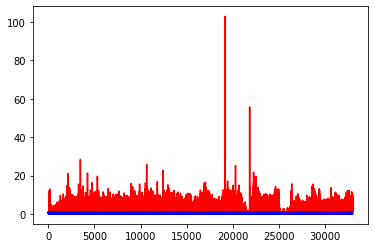

white ratio : 51.5
min : 184
max : 221


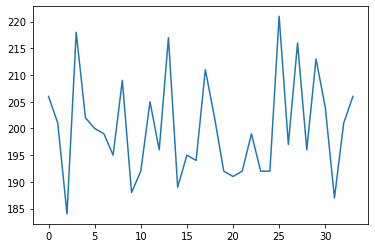

Generating interpolations...
33001 [D loss: 0.001212, acc.: 100.00%] [G loss: 6.500276, 3.291408]
33002 [D loss: 0.000153, acc.: 100.00%] [G loss: 24.727432, 4.073219]
33003 [D loss: 0.000139, acc.: 100.00%] [G loss: 9.369524, 8.430542]
33004 [D loss: 0.000050, acc.: 100.00%] [G loss: 5.325519, 4.196915]
33005 [D loss: 0.000709, acc.: 100.00%] [G loss: 5.046739, 4.469646]
33006 [D loss: 0.000325, acc.: 100.00%] [G loss: 8.122769, 7.747502]
33007 [D loss: 0.006993, acc.: 100.00%] [G loss: 2.350957, 1.667017]
33008 [D loss: 0.002248, acc.: 100.00%] [G loss: 36.817444, 3.022152]
33009 [D loss: 0.001819, acc.: 100.00%] [G loss: 7.345043, 6.291465]
33010 [D loss: 0.000295, acc.: 100.00%] [G loss: 2.530349, 1.857243]
33011 [D loss: 0.000403, acc.: 100.00%] [G loss: 1.689794, 0.669672]
33012 [D loss: 0.001819, acc.: 100.00%] [G loss: 4.557682, 4.054069]
33013 [D loss: 0.004313, acc.: 100.00%] [G loss: 10.414764, 9.286196]
33014 [D loss: 0.000645, acc.: 100.00%] [G loss: 1.655118, 1.222273]
33

33120 [D loss: 0.011068, acc.: 100.00%] [G loss: 2.078766, 1.508964]
33121 [D loss: 0.079556, acc.: 96.88%] [G loss: 8.191207, 6.052773]
33122 [D loss: 0.002141, acc.: 100.00%] [G loss: 12.321974, 7.019009]
33123 [D loss: 0.001061, acc.: 100.00%] [G loss: 8.171204, 8.189993]
33124 [D loss: 0.000371, acc.: 100.00%] [G loss: 14.595165, 14.176056]
33125 [D loss: 0.002934, acc.: 100.00%] [G loss: 12.231429, 10.204477]
33126 [D loss: 0.367345, acc.: 90.62%] [G loss: 3.882629, 3.837512]
33127 [D loss: 0.002769, acc.: 100.00%] [G loss: 2.008838, 1.312109]
33128 [D loss: 0.052823, acc.: 100.00%] [G loss: 8.938524, 4.063278]
33129 [D loss: 0.001148, acc.: 100.00%] [G loss: 5.317389, 5.958618]
33130 [D loss: 0.001599, acc.: 100.00%] [G loss: 8.125136, 7.298144]
33131 [D loss: 0.005413, acc.: 100.00%] [G loss: 9.419741, 8.350232]
33132 [D loss: 0.000374, acc.: 100.00%] [G loss: 12.311287, 13.187359]
33133 [D loss: 0.160477, acc.: 96.88%] [G loss: 19.239923, 10.990329]
33134 [D loss: 0.027637, acc

33239 [D loss: 0.000529, acc.: 100.00%] [G loss: 12.531425, 9.564682]
33240 [D loss: 0.000093, acc.: 100.00%] [G loss: 9.174976, 8.587940]
33241 [D loss: 0.242047, acc.: 93.75%] [G loss: 3.624091, 2.938902]
33242 [D loss: 0.004691, acc.: 100.00%] [G loss: 7.817972, 5.413258]
33243 [D loss: 0.000253, acc.: 100.00%] [G loss: 4.353979, 3.479663]
33244 [D loss: 0.000026, acc.: 100.00%] [G loss: 5.201112, 4.563144]
33245 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.217223, 3.712204]
33246 [D loss: 0.000407, acc.: 100.00%] [G loss: 7.018785, 5.922829]
33247 [D loss: 0.017300, acc.: 100.00%] [G loss: 2.208569, 1.795559]
33248 [D loss: 0.022616, acc.: 96.88%] [G loss: 1.374680, 1.680076]
33249 [D loss: 0.001568, acc.: 100.00%] [G loss: 2.872941, 2.319795]
33250 [D loss: 0.004329, acc.: 100.00%] [G loss: 2.869186, 2.091075]
33251 [D loss: 0.013351, acc.: 100.00%] [G loss: 2.000999, 2.081028]
33252 [D loss: 0.002988, acc.: 100.00%] [G loss: 0.240117, 0.536966]
33253 [D loss: 0.000449, acc.: 100.

33360 [D loss: 0.001403, acc.: 100.00%] [G loss: 22.457933, 6.039824]
33361 [D loss: 0.000187, acc.: 100.00%] [G loss: 9.495300, 8.964983]
33362 [D loss: 0.000304, acc.: 100.00%] [G loss: 9.148027, 10.846851]
33363 [D loss: 0.000115, acc.: 100.00%] [G loss: 8.486469, 8.349873]
33364 [D loss: 0.000567, acc.: 100.00%] [G loss: 9.637195, 9.166449]
33365 [D loss: 0.004307, acc.: 100.00%] [G loss: 8.014814, 6.866287]
33366 [D loss: 0.002121, acc.: 100.00%] [G loss: 1.945370, 1.428436]
33367 [D loss: 0.001609, acc.: 100.00%] [G loss: 7.423878, 6.938884]
33368 [D loss: 0.010365, acc.: 100.00%] [G loss: 9.209165, 7.779002]
33369 [D loss: 0.000147, acc.: 100.00%] [G loss: 14.128343, 10.920113]
33370 [D loss: 0.003531, acc.: 100.00%] [G loss: 8.219987, 7.837647]
33371 [D loss: 0.000428, acc.: 100.00%] [G loss: 4.450124, 2.596967]
33372 [D loss: 0.000338, acc.: 100.00%] [G loss: 7.202142, 7.287142]
33373 [D loss: 0.002408, acc.: 100.00%] [G loss: 17.354176, 11.308756]
33374 [D loss: 0.000253, acc

33480 [D loss: 0.002276, acc.: 100.00%] [G loss: 5.770526, 5.959845]
33481 [D loss: 0.000649, acc.: 100.00%] [G loss: 3.902059, 5.471684]
33482 [D loss: 0.009382, acc.: 100.00%] [G loss: 0.411472, 0.320871]
33483 [D loss: 0.000731, acc.: 100.00%] [G loss: 7.768949, 7.664599]
33484 [D loss: 0.000296, acc.: 100.00%] [G loss: 28.594742, 7.871118]
33485 [D loss: 0.000178, acc.: 100.00%] [G loss: 8.705548, 8.993058]
33486 [D loss: 0.010835, acc.: 100.00%] [G loss: 9.533884, 8.915958]
33487 [D loss: 0.000070, acc.: 100.00%] [G loss: 9.086643, 8.073133]
33488 [D loss: 0.000204, acc.: 100.00%] [G loss: 11.684700, 11.476627]
33489 [D loss: 0.000465, acc.: 100.00%] [G loss: 11.209021, 11.059999]
33490 [D loss: 0.000153, acc.: 100.00%] [G loss: 8.958393, 7.936530]
33491 [D loss: 0.000183, acc.: 100.00%] [G loss: 9.251562, 9.036293]
33492 [D loss: 0.056145, acc.: 96.88%] [G loss: 7.237092, 6.794236]
33493 [D loss: 0.007101, acc.: 100.00%] [G loss: 6.286774, 5.313612]
33494 [D loss: 0.006620, acc.:

33600 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.836855, 0.838369]
33601 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.177528, 2.458988]
33602 [D loss: 0.000312, acc.: 100.00%] [G loss: 3.700313, 3.897818]
33603 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.658006, 2.098319]
33604 [D loss: 0.000015, acc.: 100.00%] [G loss: 2.583244, 3.693247]
33605 [D loss: 0.000057, acc.: 100.00%] [G loss: 3.929866, 3.035048]
33606 [D loss: 0.000032, acc.: 100.00%] [G loss: 3.293088, 3.442168]
33607 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.077714, 3.845178]
33608 [D loss: 0.000024, acc.: 100.00%] [G loss: 5.607708, 4.799749]
33609 [D loss: 0.009864, acc.: 100.00%] [G loss: 6.676580, 6.617346]
33610 [D loss: 0.001810, acc.: 100.00%] [G loss: 2.756498, 2.139951]
33611 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.567043, 0.337332]
33612 [D loss: 0.000115, acc.: 100.00%] [G loss: 1.365887, 1.485323]
33613 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.320101, 0.631293]
33614 [D loss: 0.000002, acc.: 10

33721 [D loss: 0.000009, acc.: 100.00%] [G loss: 5.129825, 6.812984]
33722 [D loss: 0.000122, acc.: 100.00%] [G loss: 4.303678, 3.790255]
33723 [D loss: 0.000189, acc.: 100.00%] [G loss: 7.990005, 7.727993]
33724 [D loss: 0.000920, acc.: 100.00%] [G loss: 17.007706, 8.396524]
33725 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.466064, 2.697965]
33726 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.657744, 6.002851]
33727 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.762637, 1.628444]
33728 [D loss: 0.000026, acc.: 100.00%] [G loss: 8.548470, 3.297345]
33729 [D loss: 0.000240, acc.: 100.00%] [G loss: 5.534562, 3.748813]
33730 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.327730, 7.593292]
33731 [D loss: 0.000304, acc.: 100.00%] [G loss: 2.332317, 1.561137]
33732 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.179412, 0.355213]
33733 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000738, 0.000056]
33734 [D loss: 0.019261, acc.: 100.00%] [G loss: 0.494739, 0.500094]
33735 [D loss: 0.000602, acc.: 10

33841 [D loss: 0.001240, acc.: 100.00%] [G loss: 0.088039, 0.072721]
33842 [D loss: 0.006542, acc.: 100.00%] [G loss: 2.474898, 1.179443]
33843 [D loss: 0.001323, acc.: 100.00%] [G loss: 0.032791, 0.027505]
33844 [D loss: 0.001655, acc.: 100.00%] [G loss: 5.772951, 0.839107]
33845 [D loss: 0.000600, acc.: 100.00%] [G loss: 0.000230, 0.000487]
33846 [D loss: 0.000790, acc.: 100.00%] [G loss: 0.156436, 0.120640]
33847 [D loss: 0.000410, acc.: 100.00%] [G loss: 1.040406, 1.264792]
33848 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.024689, 0.040206]
33849 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.263414, 1.185999]
33850 [D loss: 0.000022, acc.: 100.00%] [G loss: 2.120003, 0.578872]
33851 [D loss: 0.007844, acc.: 100.00%] [G loss: 1.895346, 1.500417]
33852 [D loss: 0.031813, acc.: 96.88%] [G loss: 0.515327, 0.452822]
33853 [D loss: 0.002312, acc.: 100.00%] [G loss: 0.189550, 0.038651]
33854 [D loss: 0.013470, acc.: 100.00%] [G loss: 2.985103, 4.895600]
33855 [D loss: 0.000000, acc.: 100.

33962 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.574477, 0.409540]
33963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.354462, 0.152146]
33964 [D loss: 0.000060, acc.: 100.00%] [G loss: 67.223808, 0.423303]
33965 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.620225, 2.824391]
33966 [D loss: 0.000024, acc.: 100.00%] [G loss: 3.689953, 3.162344]
33967 [D loss: 0.000026, acc.: 100.00%] [G loss: 6.794552, 5.870220]
33968 [D loss: 0.000968, acc.: 100.00%] [G loss: 0.117128, 0.247224]
33969 [D loss: 0.000331, acc.: 100.00%] [G loss: 3.903835, 5.207254]
33970 [D loss: 0.000105, acc.: 100.00%] [G loss: 2.970008, 2.466455]
33971 [D loss: 0.001226, acc.: 100.00%] [G loss: 2.252471, 2.308769]
33972 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.657867, 0.387165]
33973 [D loss: 0.150795, acc.: 96.88%] [G loss: 13.864950, 0.147303]
33974 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.750022, 0.560266]
33975 [D loss: 0.003795, acc.: 100.00%] [G loss: 3.199170, 2.525506]
33976 [D loss: 0.008291, acc.: 10

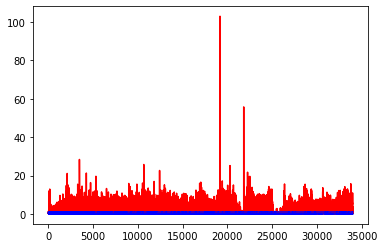

white ratio : 49.25
min : 184
max : 221


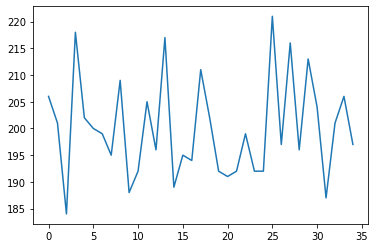

Generating interpolations...
34001 [D loss: 0.007099, acc.: 100.00%] [G loss: 3.743348, 2.815369]
34002 [D loss: 0.000121, acc.: 100.00%] [G loss: 1.447205, 0.462248]
34003 [D loss: 0.000378, acc.: 100.00%] [G loss: 0.923097, 0.271983]
34004 [D loss: 0.000857, acc.: 100.00%] [G loss: 0.311797, 0.381054]
34005 [D loss: 0.009609, acc.: 100.00%] [G loss: 1.577430, 0.026116]
34006 [D loss: 0.023285, acc.: 100.00%] [G loss: 0.070623, 0.085484]
34007 [D loss: 0.039579, acc.: 96.88%] [G loss: 1.259904, 0.511271]
34008 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.345005, 0.855379]
34009 [D loss: 0.000323, acc.: 100.00%] [G loss: 1.607519, 0.825564]
34010 [D loss: 0.055867, acc.: 96.88%] [G loss: 0.731350, 0.213654]
34011 [D loss: 0.003831, acc.: 100.00%] [G loss: 0.082154, 0.061088]
34012 [D loss: 0.045134, acc.: 96.88%] [G loss: 0.223603, 0.050110]
34013 [D loss: 0.001077, acc.: 100.00%] [G loss: 1.594518, 0.261984]
34014 [D loss: 0.004730, acc.: 100.00%] [G loss: 10.745492, 0.223814]
34015 

34120 [D loss: 0.000077, acc.: 100.00%] [G loss: 7.032270, 6.328758]
34121 [D loss: 0.004219, acc.: 100.00%] [G loss: 3.655517, 1.810143]
34122 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.919363, 3.475188]
34123 [D loss: 0.000167, acc.: 100.00%] [G loss: 3.294818, 1.289754]
34124 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.958660, 1.580798]
34125 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.638932, 0.578893]
34126 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.015917, 0.019372]
34127 [D loss: 0.000072, acc.: 100.00%] [G loss: 12.958274, 0.230219]
34128 [D loss: 0.000987, acc.: 100.00%] [G loss: 0.166746, 0.002875]
34129 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.210000, 0.000098]
34130 [D loss: 0.011210, acc.: 100.00%] [G loss: 23.864777, 5.227413]
34131 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.626582, 0.880597]
34132 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.051085, 0.304183]
34133 [D loss: 0.001315, acc.: 100.00%] [G loss: 1.339238, 0.512404]
34134 [D loss: 0.001218, acc.: 1

34239 [D loss: 0.000189, acc.: 100.00%] [G loss: 2.929234, 3.322240]
34240 [D loss: 0.000199, acc.: 100.00%] [G loss: 0.677856, 0.558443]
34241 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.231742, 0.272956]
34242 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.173302, 1.188237]
34243 [D loss: 0.000995, acc.: 100.00%] [G loss: 0.225955, 0.032511]
34244 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.766957, 0.414718]
34245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.403136, 0.073598]
34246 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.828081, 0.591854]
34247 [D loss: 0.040091, acc.: 96.88%] [G loss: 0.749370, 0.028122]
34248 [D loss: 0.010892, acc.: 100.00%] [G loss: 5.314289, 2.964478]
34249 [D loss: 0.000336, acc.: 100.00%] [G loss: 11.352392, 1.765528]
34250 [D loss: 0.001702, acc.: 100.00%] [G loss: 3.788253, 3.398389]
34251 [D loss: 0.000007, acc.: 100.00%] [G loss: 6.619747, 4.725678]
34252 [D loss: 0.003418, acc.: 100.00%] [G loss: 0.212272, 0.058945]
34253 [D loss: 0.009088, acc.: 100

34360 [D loss: 0.001767, acc.: 100.00%] [G loss: 2.260547, 1.338149]
34361 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.137193, 0.226916]
34362 [D loss: 0.000938, acc.: 100.00%] [G loss: 0.573092, 0.612896]
34363 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.145404, 0.234574]
34364 [D loss: 0.003284, acc.: 100.00%] [G loss: 0.185839, 0.186271]
34365 [D loss: 0.000344, acc.: 100.00%] [G loss: 0.226930, 0.161546]
34366 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.132215, 0.119076]
34367 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.075268, 0.069669]
34368 [D loss: 0.000598, acc.: 100.00%] [G loss: 0.042775, 0.002153]
34369 [D loss: 0.001103, acc.: 100.00%] [G loss: 0.759733, 0.564073]
34370 [D loss: 0.000403, acc.: 100.00%] [G loss: 0.780081, 0.505788]
34371 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.010855, 0.002878]
34372 [D loss: 0.000515, acc.: 100.00%] [G loss: 0.297933, 0.163453]
34373 [D loss: 0.000405, acc.: 100.00%] [G loss: 0.928384, 0.521377]
34374 [D loss: 0.000000, acc.: 100

34482 [D loss: 0.001265, acc.: 100.00%] [G loss: 0.106367, 0.086798]
34483 [D loss: 0.000489, acc.: 100.00%] [G loss: 0.259086, 0.013099]
34484 [D loss: 0.007249, acc.: 100.00%] [G loss: 1.105656, 0.016833]
34485 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.850671, 0.333146]
34486 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.075731, 0.389145]
34487 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.335059, 0.330114]
34488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.044344, 0.029950]
34489 [D loss: 0.013801, acc.: 100.00%] [G loss: 0.735664, 0.803608]
34490 [D loss: 0.000067, acc.: 100.00%] [G loss: 3.388514, 4.212622]
34491 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.520374, 1.331402]
34492 [D loss: 0.000047, acc.: 100.00%] [G loss: 1.566861, 5.237957]
34493 [D loss: 0.000084, acc.: 100.00%] [G loss: 2.448410, 1.629786]
34494 [D loss: 0.000459, acc.: 100.00%] [G loss: 0.541427, 0.723155]
34495 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.969352, 0.601960]
34496 [D loss: 0.010285, acc.: 100

34604 [D loss: 0.001981, acc.: 100.00%] [G loss: 0.025426, 0.002637]
34605 [D loss: 0.018252, acc.: 100.00%] [G loss: 0.058636, 0.092670]
34606 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.177628, 0.308417]
34607 [D loss: 0.020571, acc.: 100.00%] [G loss: 0.310614, 0.218023]
34608 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.232061, 0.383102]
34609 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.098834, 0.076806]
34610 [D loss: 0.000150, acc.: 100.00%] [G loss: 17.629076, 3.636376]
34611 [D loss: 0.003628, acc.: 100.00%] [G loss: 3.771995, 4.668257]
34612 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.006773, 2.834718]
34613 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.255704, 3.088177]
34614 [D loss: 0.000190, acc.: 100.00%] [G loss: 1.306910, 0.731184]
34615 [D loss: 0.001793, acc.: 100.00%] [G loss: 2.777663, 1.945513]
34616 [D loss: 0.000023, acc.: 100.00%] [G loss: 3.817502, 3.319886]
34617 [D loss: 0.001092, acc.: 100.00%] [G loss: 0.149773, 0.103911]
34618 [D loss: 0.012711, acc.: 10

34725 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.855955, 0.508055]
34726 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.683604, 0.550239]
34727 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.386070, 1.878802]
34728 [D loss: 0.002701, acc.: 100.00%] [G loss: 1.162865, 0.352248]
34729 [D loss: 0.000124, acc.: 100.00%] [G loss: 1.632586, 0.996251]
34730 [D loss: 0.000881, acc.: 100.00%] [G loss: 1.876050, 1.248979]
34731 [D loss: 0.001393, acc.: 100.00%] [G loss: 0.813597, 0.676256]
34732 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.080543, 0.028834]
34733 [D loss: 0.000040, acc.: 100.00%] [G loss: 1.051718, 0.720084]
34734 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.166968, 0.274898]
34735 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.289748, 0.458286]
34736 [D loss: 0.000660, acc.: 100.00%] [G loss: 24.321213, 0.281924]
34737 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.545979, 0.119855]
34738 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.547123, 1.153303]
34739 [D loss: 0.000016, acc.: 10

34846 [D loss: 0.004601, acc.: 100.00%] [G loss: 4.236963, 4.077563]
34847 [D loss: 0.000139, acc.: 100.00%] [G loss: 3.156394, 4.585568]
34848 [D loss: 0.000477, acc.: 100.00%] [G loss: 4.497222, 2.726079]
34849 [D loss: 0.000060, acc.: 100.00%] [G loss: 3.267948, 3.773402]
34850 [D loss: 0.003299, acc.: 100.00%] [G loss: 3.775502, 2.890907]
34851 [D loss: 0.000173, acc.: 100.00%] [G loss: 6.695611, 5.380859]
34852 [D loss: 0.000049, acc.: 100.00%] [G loss: 2.746051, 1.759177]
34853 [D loss: 0.000068, acc.: 100.00%] [G loss: 1.199507, 1.846917]
34854 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.237802, 1.176903]
34855 [D loss: 0.000101, acc.: 100.00%] [G loss: 4.756876, 4.415532]
34856 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.599097, 4.542633]
34857 [D loss: 0.000245, acc.: 100.00%] [G loss: 17.812134, 4.980881]
34858 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.267525, 6.940684]
34859 [D loss: 0.000150, acc.: 100.00%] [G loss: 6.632847, 5.835616]
34860 [D loss: 0.005740, acc.: 10

34967 [D loss: 0.000118, acc.: 100.00%] [G loss: 6.672637, 6.775189]
34968 [D loss: 0.000306, acc.: 100.00%] [G loss: 7.954275, 8.140989]
34969 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.822343, 6.430368]
34970 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.264328, 6.537099]
34971 [D loss: 0.002386, acc.: 100.00%] [G loss: 4.905881, 4.526494]
34972 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.608799, 5.690656]
34973 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.630031, 3.507663]
34974 [D loss: 0.000117, acc.: 100.00%] [G loss: 6.266894, 5.282837]
34975 [D loss: 0.000054, acc.: 100.00%] [G loss: 5.532152, 4.050829]
34976 [D loss: 0.010748, acc.: 100.00%] [G loss: 6.732955, 1.728410]
34977 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.420990, 0.337064]
34978 [D loss: 0.000288, acc.: 100.00%] [G loss: 2.792290, 0.782193]
34979 [D loss: 0.000031, acc.: 100.00%] [G loss: 49.035553, 7.139459]
34980 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.788002, 5.972403]
34981 [D loss: 0.007139, acc.: 10

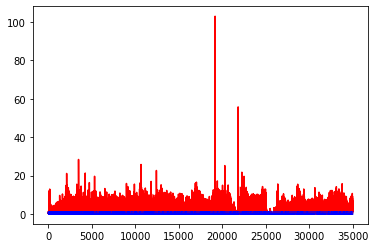

white ratio : 48.25
min : 184
max : 221


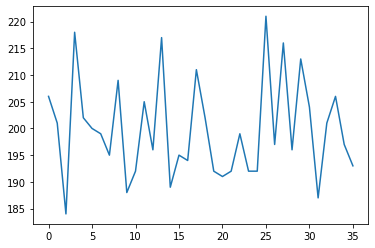

Generating interpolations...
35001 [D loss: 0.000131, acc.: 100.00%] [G loss: 2.381925, 1.744753]
35002 [D loss: 0.001949, acc.: 100.00%] [G loss: 2.396513, 2.098249]
35003 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.314388, 0.242432]
35004 [D loss: 0.000330, acc.: 100.00%] [G loss: 2.604519, 1.835788]
35005 [D loss: 0.000194, acc.: 100.00%] [G loss: 1.172270, 0.768262]
35006 [D loss: 0.000603, acc.: 100.00%] [G loss: 4.398673, 3.287647]
35007 [D loss: 0.025732, acc.: 100.00%] [G loss: 8.690176, 2.188419]
35008 [D loss: 0.124549, acc.: 96.88%] [G loss: 15.066647, 2.350664]
35009 [D loss: 0.000970, acc.: 100.00%] [G loss: 4.027221, 2.987315]
35010 [D loss: 0.000067, acc.: 100.00%] [G loss: 4.122215, 4.444356]
35011 [D loss: 0.000146, acc.: 100.00%] [G loss: 2.252459, 2.098894]
35012 [D loss: 0.001804, acc.: 100.00%] [G loss: 3.072895, 2.288523]
35013 [D loss: 0.000126, acc.: 100.00%] [G loss: 4.773955, 2.394126]
35014 [D loss: 0.000507, acc.: 100.00%] [G loss: 2.676404, 1.665123]
35015

35119 [D loss: 0.010813, acc.: 100.00%] [G loss: 11.025245, 4.748523]
35120 [D loss: 0.018827, acc.: 100.00%] [G loss: 1.887194, 2.231427]
35121 [D loss: 0.001271, acc.: 100.00%] [G loss: 3.638463, 3.809031]
35122 [D loss: 0.000332, acc.: 100.00%] [G loss: 2.547583, 1.926471]
35123 [D loss: 0.031381, acc.: 96.88%] [G loss: 5.278251, 5.134726]
35124 [D loss: 0.000136, acc.: 100.00%] [G loss: 7.484481, 7.939001]
35125 [D loss: 0.036416, acc.: 96.88%] [G loss: 3.115789, 3.170025]
35126 [D loss: 0.000768, acc.: 100.00%] [G loss: 4.669002, 3.874737]
35127 [D loss: 0.007249, acc.: 100.00%] [G loss: 3.213023, 5.011775]
35128 [D loss: 0.000187, acc.: 100.00%] [G loss: 6.857739, 7.095506]
35129 [D loss: 0.005043, acc.: 100.00%] [G loss: 7.514816, 7.242682]
35130 [D loss: 0.004858, acc.: 100.00%] [G loss: 7.228408, 6.625235]
35131 [D loss: 0.046122, acc.: 96.88%] [G loss: 3.866361, 5.944115]
35132 [D loss: 0.000668, acc.: 100.00%] [G loss: 6.859245, 6.437572]
35133 [D loss: 0.001092, acc.: 100.0

35238 [D loss: 0.000493, acc.: 100.00%] [G loss: 1.143773, 0.317577]
35239 [D loss: 0.000292, acc.: 100.00%] [G loss: 5.195438, 6.457897]
35240 [D loss: 0.000184, acc.: 100.00%] [G loss: 5.721577, 5.180579]
35241 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.939610, 7.675924]
35242 [D loss: 0.000815, acc.: 100.00%] [G loss: 6.368184, 7.017138]
35243 [D loss: 0.000837, acc.: 100.00%] [G loss: 6.023292, 3.064276]
35244 [D loss: 0.000069, acc.: 100.00%] [G loss: 6.298340, 4.927322]
35245 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.833478, 0.710977]
35246 [D loss: 0.000880, acc.: 100.00%] [G loss: 7.195369, 6.296595]
35247 [D loss: 0.000031, acc.: 100.00%] [G loss: 8.854388, 0.701408]
35248 [D loss: 0.004062, acc.: 100.00%] [G loss: 21.699776, 9.565615]
35249 [D loss: 0.000032, acc.: 100.00%] [G loss: 7.701568, 7.295062]
35250 [D loss: 0.050104, acc.: 96.88%] [G loss: 5.136365, 5.022067]
35251 [D loss: 0.022417, acc.: 100.00%] [G loss: 2.067000, 1.620624]
35252 [D loss: 0.004061, acc.: 100

35358 [D loss: 0.000218, acc.: 100.00%] [G loss: 5.185745, 6.960908]
35359 [D loss: 0.000147, acc.: 100.00%] [G loss: 4.406817, 3.892385]
35360 [D loss: 0.000657, acc.: 100.00%] [G loss: 7.246704, 6.271181]
35361 [D loss: 0.000817, acc.: 100.00%] [G loss: 4.955104, 6.575936]
35362 [D loss: 0.014812, acc.: 100.00%] [G loss: 3.800643, 3.609471]
35363 [D loss: 0.133908, acc.: 96.88%] [G loss: 3.296134, 2.776142]
35364 [D loss: 0.026255, acc.: 100.00%] [G loss: 5.695116, 5.198767]
35365 [D loss: 0.023772, acc.: 96.88%] [G loss: 14.339471, 7.625927]
35366 [D loss: 0.000203, acc.: 100.00%] [G loss: 6.955699, 7.744896]
35367 [D loss: 0.000037, acc.: 100.00%] [G loss: 8.708151, 9.092808]
35368 [D loss: 0.000051, acc.: 100.00%] [G loss: 7.853867, 7.124365]
35369 [D loss: 0.000087, acc.: 100.00%] [G loss: 7.822494, 7.892503]
35370 [D loss: 0.000111, acc.: 100.00%] [G loss: 7.991857, 6.928469]
35371 [D loss: 0.000085, acc.: 100.00%] [G loss: 8.072691, 8.941339]
35372 [D loss: 0.000403, acc.: 100.

35478 [D loss: 0.003757, acc.: 100.00%] [G loss: 1.763055, 1.457262]
35479 [D loss: 0.007846, acc.: 100.00%] [G loss: 6.241004, 5.925978]
35480 [D loss: 0.048059, acc.: 96.88%] [G loss: 12.973830, 1.513420]
35481 [D loss: 0.032208, acc.: 96.88%] [G loss: 6.355486, 5.192443]
35482 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.485128, 0.018893]
35483 [D loss: 0.000488, acc.: 100.00%] [G loss: 4.099721, 4.372971]
35484 [D loss: 0.024403, acc.: 100.00%] [G loss: 6.310258, 2.759553]
35485 [D loss: 0.007482, acc.: 100.00%] [G loss: 3.612871, 0.109278]
35486 [D loss: 0.003790, acc.: 100.00%] [G loss: 6.007336, 4.843149]
35487 [D loss: 0.000055, acc.: 100.00%] [G loss: 8.022064, 7.394169]
35488 [D loss: 0.000864, acc.: 100.00%] [G loss: 6.170719, 5.692721]
35489 [D loss: 0.001114, acc.: 100.00%] [G loss: 9.171673, 8.750465]
35490 [D loss: 0.000052, acc.: 100.00%] [G loss: 4.107397, 4.804173]
35491 [D loss: 0.001086, acc.: 100.00%] [G loss: 3.729027, 3.283365]
35492 [D loss: 0.001585, acc.: 100.

35599 [D loss: 0.000486, acc.: 100.00%] [G loss: 5.440754, 6.056990]
35600 [D loss: 0.048483, acc.: 96.88%] [G loss: 3.928493, 3.390757]
35601 [D loss: 0.001117, acc.: 100.00%] [G loss: 2.855124, 2.927078]
35602 [D loss: 0.000198, acc.: 100.00%] [G loss: 3.155658, 3.777734]
35603 [D loss: 0.000734, acc.: 100.00%] [G loss: 3.164654, 2.428051]
35604 [D loss: 0.000262, acc.: 100.00%] [G loss: 2.252969, 1.968225]
35605 [D loss: 0.000431, acc.: 100.00%] [G loss: 1.113029, 0.874962]
35606 [D loss: 0.002982, acc.: 100.00%] [G loss: 2.923763, 3.202881]
35607 [D loss: 0.000256, acc.: 100.00%] [G loss: 3.662502, 3.103809]
35608 [D loss: 0.036503, acc.: 96.88%] [G loss: 0.077667, 0.154251]
35609 [D loss: 0.003142, acc.: 100.00%] [G loss: 1.100372, 0.638488]
35610 [D loss: 0.007290, acc.: 100.00%] [G loss: 2.733813, 2.716037]
35611 [D loss: 0.002200, acc.: 100.00%] [G loss: 1.551788, 0.825772]
35612 [D loss: 0.006608, acc.: 100.00%] [G loss: 0.201144, 0.186324]
35613 [D loss: 0.024807, acc.: 100.0

35720 [D loss: 0.004195, acc.: 100.00%] [G loss: 1.552647, 1.602002]
35721 [D loss: 0.006234, acc.: 100.00%] [G loss: 3.010096, 1.649882]
35722 [D loss: 0.000647, acc.: 100.00%] [G loss: 1.553597, 1.670258]
35723 [D loss: 0.002160, acc.: 100.00%] [G loss: 1.817421, 2.012514]
35724 [D loss: 0.003769, acc.: 100.00%] [G loss: 3.162027, 2.508879]
35725 [D loss: 0.001038, acc.: 100.00%] [G loss: 2.639455, 2.967318]
35726 [D loss: 0.026246, acc.: 100.00%] [G loss: 0.000714, 0.000261]
35727 [D loss: 0.000479, acc.: 100.00%] [G loss: 1.421898, 1.282789]
35728 [D loss: 0.000911, acc.: 100.00%] [G loss: 4.657673, 3.245025]
35729 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.361327, 0.255150]
35730 [D loss: 0.000314, acc.: 100.00%] [G loss: 0.625587, 0.586774]
35731 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.844118, 0.340435]
35732 [D loss: 0.000805, acc.: 100.00%] [G loss: 2.564014, 1.420170]
35733 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.306383, 0.126961]
35734 [D loss: 0.000003, acc.: 100

35840 [D loss: 0.001161, acc.: 100.00%] [G loss: 1.187413, 1.683059]
35841 [D loss: 0.005414, acc.: 100.00%] [G loss: 2.811924, 2.044043]
35842 [D loss: 0.000246, acc.: 100.00%] [G loss: 3.341798, 2.512479]
35843 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.038575, 0.015413]
35844 [D loss: 0.025381, acc.: 100.00%] [G loss: 0.328614, 0.359393]
35845 [D loss: 0.001199, acc.: 100.00%] [G loss: 1.637030, 0.090508]
35846 [D loss: 0.002117, acc.: 100.00%] [G loss: 0.394569, 0.340660]
35847 [D loss: 0.003362, acc.: 100.00%] [G loss: 1.099612, 1.083032]
35848 [D loss: 0.000932, acc.: 100.00%] [G loss: 1.057240, 1.154811]
35849 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.017891, 0.001090]
35850 [D loss: 0.022595, acc.: 100.00%] [G loss: 0.058665, 0.082373]
35851 [D loss: 0.109725, acc.: 96.88%] [G loss: 1.878056, 1.679817]
35852 [D loss: 0.001639, acc.: 100.00%] [G loss: 0.025254, 0.142108]
35853 [D loss: 0.007306, acc.: 100.00%] [G loss: 3.548576, 3.661633]
35854 [D loss: 0.003667, acc.: 100.

35961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
35962 [D loss: 0.000967, acc.: 100.00%] [G loss: 0.051491, 0.419900]
35963 [D loss: 0.000267, acc.: 100.00%] [G loss: 0.028513, 0.014553]
35964 [D loss: 0.070270, acc.: 96.88%] [G loss: 0.283037, 0.552949]
35965 [D loss: 0.001564, acc.: 100.00%] [G loss: 3.376667, 0.055567]
35966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015748, 0.020893]
35967 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.189497, 0.062310]
35968 [D loss: 0.001064, acc.: 100.00%] [G loss: 0.000016, 0.000043]
35969 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.268458, 0.111328]
35970 [D loss: 0.006444, acc.: 100.00%] [G loss: 0.034361, 0.056745]
35971 [D loss: 0.011041, acc.: 100.00%] [G loss: 0.330116, 0.089243]
35972 [D loss: 0.000371, acc.: 100.00%] [G loss: 0.363441, 0.216949]
35973 [D loss: 0.000836, acc.: 100.00%] [G loss: 0.305181, 0.163315]
35974 [D loss: 0.050031, acc.: 96.88%] [G loss: 0.053721, 0.295229]
35975 [D loss: 0.018240, acc.: 100.0

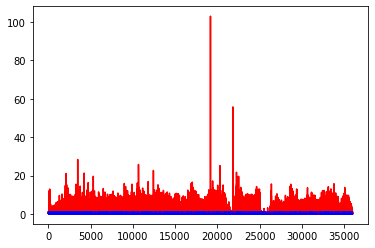

white ratio : 45.0
model saved!!!!!!!!!!!!!!!!!
min : 180
max : 221


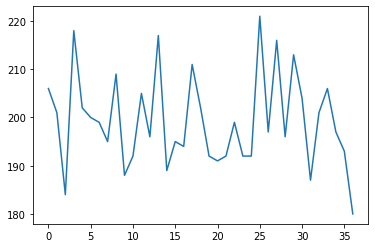

Generating interpolations...
36001 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.349284, 0.418133]
36002 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.134136, 0.262788]
36003 [D loss: 0.003032, acc.: 100.00%] [G loss: 0.182940, 0.252170]
36004 [D loss: 0.002281, acc.: 100.00%] [G loss: 0.080225, 0.118381]
36005 [D loss: 0.015517, acc.: 100.00%] [G loss: 0.000017, 0.000223]
36006 [D loss: 0.000256, acc.: 100.00%] [G loss: 0.174958, 0.018950]
36007 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.027079, 0.167389]
36008 [D loss: 0.000357, acc.: 100.00%] [G loss: 0.326245, 0.174142]
36009 [D loss: 0.000861, acc.: 100.00%] [G loss: 0.000013, 0.000249]
36010 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.269950, 0.023244]
36011 [D loss: 0.049934, acc.: 96.88%] [G loss: 1.563902, 0.114599]
36012 [D loss: 0.000309, acc.: 100.00%] [G loss: 0.297771, 0.289760]
36013 [D loss: 0.001559, acc.: 100.00%] [G loss: 0.092043, 0.174361]
36014 [D loss: 0.032554, acc.: 96.88%] [G loss: 0.306894, 0.168535]
36015 [

36122 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.012879, 0.112199]
36123 [D loss: 0.002369, acc.: 100.00%] [G loss: 0.105683, 0.030475]
36124 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.866312, 0.577420]
36125 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.162736, 0.122977]
36126 [D loss: 0.000252, acc.: 100.00%] [G loss: 0.014602, 0.059330]
36127 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.580804, 0.273169]
36128 [D loss: 0.019871, acc.: 100.00%] [G loss: 0.162215, 0.265769]
36129 [D loss: 0.000225, acc.: 100.00%] [G loss: 0.000001, 0.000000]
36130 [D loss: 0.000692, acc.: 100.00%] [G loss: 0.001040, 0.001624]
36131 [D loss: 0.000498, acc.: 100.00%] [G loss: 0.000000, 0.000000]
36132 [D loss: 0.000504, acc.: 100.00%] [G loss: 0.101496, 0.004713]
36133 [D loss: 0.000463, acc.: 100.00%] [G loss: 0.022042, 0.013527]
36134 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004740, 0.003184]
36135 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000005, 0.000004]
36136 [D loss: 0.001187, acc.: 100

36244 [D loss: 0.008871, acc.: 100.00%] [G loss: 0.009629, 0.084311]
36245 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.004215, 0.119823]
36246 [D loss: 0.000310, acc.: 100.00%] [G loss: 0.041529, 0.030624]
36247 [D loss: 0.022411, acc.: 100.00%] [G loss: 0.003527, 0.004941]
36248 [D loss: 0.001279, acc.: 100.00%] [G loss: 0.309702, 0.040514]
36249 [D loss: 0.002272, acc.: 100.00%] [G loss: 0.073647, 0.000459]
36250 [D loss: 0.002202, acc.: 100.00%] [G loss: 0.024287, 0.001707]
36251 [D loss: 0.002793, acc.: 100.00%] [G loss: 0.034281, 0.036306]
36252 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.507644, 0.026439]
36253 [D loss: 0.002519, acc.: 100.00%] [G loss: 0.061582, 0.010418]
36254 [D loss: 0.008160, acc.: 100.00%] [G loss: 0.349416, 0.203221]
36255 [D loss: 0.007998, acc.: 100.00%] [G loss: 0.016897, 0.000588]
36256 [D loss: 0.001984, acc.: 100.00%] [G loss: 0.035619, 0.059066]
36257 [D loss: 0.000987, acc.: 100.00%] [G loss: 0.024460, 0.003312]
36258 [D loss: 0.000801, acc.: 100

36364 [D loss: 0.002362, acc.: 100.00%] [G loss: 0.001502, 0.001850]
36365 [D loss: 0.002492, acc.: 100.00%] [G loss: 0.003846, 0.002339]
36366 [D loss: 0.000602, acc.: 100.00%] [G loss: 0.012827, 0.003552]
36367 [D loss: 0.002159, acc.: 100.00%] [G loss: 0.016686, 0.015393]
36368 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.038244, 0.005470]
36369 [D loss: 0.017273, acc.: 100.00%] [G loss: 3.690313, 0.219066]
36370 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.011265, 0.250809]
36371 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.670159, 0.236205]
36372 [D loss: 0.000034, acc.: 100.00%] [G loss: 1.441001, 0.600909]
36373 [D loss: 0.000839, acc.: 100.00%] [G loss: 2.357839, 0.229002]
36374 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.010769, 0.046244]
36375 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.300691, 0.225145]
36376 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.337806, 0.187847]
36377 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.271055, 0.192298]
36378 [D loss: 0.000009, acc.: 100

36483 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.033217, 0.088609]
36484 [D loss: 0.080736, acc.: 96.88%] [G loss: 0.836179, 0.226704]
36485 [D loss: 0.000336, acc.: 100.00%] [G loss: 2.181712, 0.961222]
36486 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.627362, 2.032583]
36487 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.124933, 0.315767]
36488 [D loss: 0.001964, acc.: 100.00%] [G loss: 0.884033, 0.785944]
36489 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.923997, 0.603285]
36490 [D loss: 0.093112, acc.: 96.88%] [G loss: 0.671281, 0.427771]
36491 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.554423, 0.254214]
36492 [D loss: 0.002667, acc.: 100.00%] [G loss: 0.001578, 0.023322]
36493 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.035489, 0.033404]
36494 [D loss: 0.000457, acc.: 100.00%] [G loss: 22.575100, 0.453025]
36495 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.014496, 0.617327]
36496 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.123186, 0.200908]
36497 [D loss: 0.000031, acc.: 100.

36602 [D loss: 0.000011, acc.: 100.00%] [G loss: 8.682772, 6.671651]
36603 [D loss: 0.000060, acc.: 100.00%] [G loss: 2.265642, 0.447571]
36604 [D loss: 0.000527, acc.: 100.00%] [G loss: 22.810846, 1.258515]
36605 [D loss: 0.000034, acc.: 100.00%] [G loss: 2.837415, 2.555620]
36606 [D loss: 0.001718, acc.: 100.00%] [G loss: 4.400053, 3.785529]
36607 [D loss: 0.000360, acc.: 100.00%] [G loss: 1.172589, 0.625858]
36608 [D loss: 0.010663, acc.: 100.00%] [G loss: 0.348637, 0.350791]
36609 [D loss: 0.000619, acc.: 100.00%] [G loss: 3.934977, 2.802290]
36610 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
36611 [D loss: 0.031631, acc.: 96.88%] [G loss: 4.228182, 3.645739]
36612 [D loss: 0.010647, acc.: 100.00%] [G loss: 3.943575, 2.350025]
36613 [D loss: 0.000039, acc.: 100.00%] [G loss: 1.749783, 1.707845]
36614 [D loss: 0.000091, acc.: 100.00%] [G loss: 2.266538, 1.547920]
36615 [D loss: 0.049057, acc.: 96.88%] [G loss: 10.168798, 8.393513]
36616 [D loss: 0.131177, acc.: 96.

36722 [D loss: 0.006019, acc.: 100.00%] [G loss: 8.822065, 6.950319]
36723 [D loss: 0.000407, acc.: 100.00%] [G loss: 1.520164, 0.806028]
36724 [D loss: 0.002371, acc.: 100.00%] [G loss: 0.140390, 0.255586]
36725 [D loss: 0.005344, acc.: 100.00%] [G loss: 0.754136, 0.346795]
36726 [D loss: 0.001314, acc.: 100.00%] [G loss: 4.067880, 2.123261]
36727 [D loss: 0.001754, acc.: 100.00%] [G loss: 1.163022, 1.165651]
36728 [D loss: 0.004654, acc.: 100.00%] [G loss: 0.024190, 0.026733]
36729 [D loss: 0.017253, acc.: 100.00%] [G loss: 2.018394, 1.016778]
36730 [D loss: 0.007529, acc.: 100.00%] [G loss: 0.000000, 0.000000]
36731 [D loss: 0.003961, acc.: 100.00%] [G loss: 0.711314, 0.594711]
36732 [D loss: 0.001118, acc.: 100.00%] [G loss: 1.428654, 0.724407]
36733 [D loss: 0.005467, acc.: 100.00%] [G loss: 1.279110, 0.261330]
36734 [D loss: 0.081724, acc.: 96.88%] [G loss: 0.000000, 0.000000]
36735 [D loss: 0.043571, acc.: 96.88%] [G loss: 2.279277, 0.000015]
36736 [D loss: 0.044164, acc.: 96.88

36842 [D loss: 0.000540, acc.: 100.00%] [G loss: 0.251960, 0.142544]
36843 [D loss: 0.009334, acc.: 100.00%] [G loss: 0.269360, 0.540574]
36844 [D loss: 0.003078, acc.: 100.00%] [G loss: 0.007880, 0.032502]
36845 [D loss: 0.002388, acc.: 100.00%] [G loss: 0.000398, 0.000402]
36846 [D loss: 0.002625, acc.: 100.00%] [G loss: 0.455006, 0.718812]
36847 [D loss: 0.022541, acc.: 100.00%] [G loss: 0.001817, 0.000308]
36848 [D loss: 0.002848, acc.: 100.00%] [G loss: 0.012043, 0.057630]
36849 [D loss: 0.109778, acc.: 93.75%] [G loss: 0.006810, 0.013223]
36850 [D loss: 0.014512, acc.: 100.00%] [G loss: 1.138583, 0.000063]
36851 [D loss: 0.001521, acc.: 100.00%] [G loss: 0.734066, 0.944703]
36852 [D loss: 0.002746, acc.: 100.00%] [G loss: 0.028143, 0.006828]
36853 [D loss: 0.007066, acc.: 100.00%] [G loss: 0.001647, 0.001242]
36854 [D loss: 0.001158, acc.: 100.00%] [G loss: 0.847938, 0.459964]
36855 [D loss: 0.008225, acc.: 100.00%] [G loss: 0.043239, 0.196133]
36856 [D loss: 0.112273, acc.: 96.8

36961 [D loss: 0.002339, acc.: 100.00%] [G loss: 0.012986, 0.019619]
36962 [D loss: 0.001462, acc.: 100.00%] [G loss: 0.000734, 0.000107]
36963 [D loss: 0.010378, acc.: 100.00%] [G loss: 0.000040, 0.000271]
36964 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000374, 0.003051]
36965 [D loss: 0.005195, acc.: 100.00%] [G loss: 0.000033, 0.002524]
36966 [D loss: 0.003606, acc.: 100.00%] [G loss: 0.054226, 0.020946]
36967 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000169, 0.000948]
36968 [D loss: 0.028976, acc.: 96.88%] [G loss: 0.000507, 0.000497]
36969 [D loss: 0.004408, acc.: 100.00%] [G loss: 0.056273, 0.002222]
36970 [D loss: 0.000774, acc.: 100.00%] [G loss: 0.000726, 0.000142]
36971 [D loss: 0.057435, acc.: 96.88%] [G loss: 0.094323, 0.104946]
36972 [D loss: 0.002130, acc.: 100.00%] [G loss: 0.000656, 0.000347]
36973 [D loss: 0.001563, acc.: 100.00%] [G loss: 0.024237, 0.008875]
36974 [D loss: 0.001130, acc.: 100.00%] [G loss: 0.001042, 0.000396]
36975 [D loss: 0.000874, acc.: 100.0

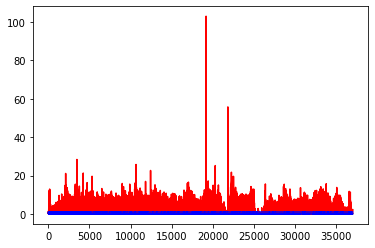

white ratio : 51.25
min : 180
max : 221


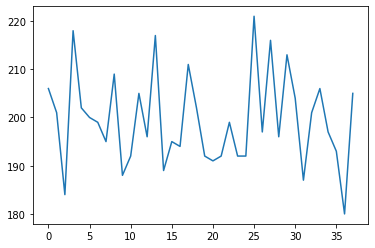

Generating interpolations...
37001 [D loss: 0.000321, acc.: 100.00%] [G loss: 1.952554, 1.767367]
37002 [D loss: 0.001838, acc.: 100.00%] [G loss: 4.915994, 3.082701]
37003 [D loss: 0.000092, acc.: 100.00%] [G loss: 3.063330, 1.412899]
37004 [D loss: 0.000056, acc.: 100.00%] [G loss: 4.229543, 3.469516]
37005 [D loss: 0.009631, acc.: 100.00%] [G loss: 2.436682, 2.196453]
37006 [D loss: 0.001139, acc.: 100.00%] [G loss: 15.326351, 4.503175]
37007 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.114504, 2.520059]
37008 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.903313, 6.116489]
37009 [D loss: 0.000070, acc.: 100.00%] [G loss: 6.268447, 5.967140]
37010 [D loss: 0.003248, acc.: 100.00%] [G loss: 1.901407, 1.154139]
37011 [D loss: 0.012991, acc.: 100.00%] [G loss: 2.795204, 1.696268]
37012 [D loss: 0.000136, acc.: 100.00%] [G loss: 12.881388, 2.682866]
37013 [D loss: 0.000144, acc.: 100.00%] [G loss: 2.324434, 2.827104]
37014 [D loss: 0.000072, acc.: 100.00%] [G loss: 2.951693, 3.250950]
370

37121 [D loss: 0.000200, acc.: 100.00%] [G loss: 1.645176, 2.878705]
37122 [D loss: 0.001995, acc.: 100.00%] [G loss: 4.697072, 2.690362]
37123 [D loss: 0.002019, acc.: 100.00%] [G loss: 4.749377, 3.904876]
37124 [D loss: 0.003842, acc.: 100.00%] [G loss: 13.565560, 2.623707]
37125 [D loss: 0.005599, acc.: 100.00%] [G loss: 3.321120, 2.764868]
37126 [D loss: 0.079076, acc.: 93.75%] [G loss: 4.112141, 2.779291]
37127 [D loss: 0.006783, acc.: 100.00%] [G loss: 9.639069, 7.270805]
37128 [D loss: 0.000360, acc.: 100.00%] [G loss: 9.389587, 9.260538]
37129 [D loss: 0.001108, acc.: 100.00%] [G loss: 7.511193, 7.587424]
37130 [D loss: 0.000319, acc.: 100.00%] [G loss: 5.155988, 5.357424]
37131 [D loss: 0.000041, acc.: 100.00%] [G loss: 5.459687, 4.619656]
37132 [D loss: 0.007743, acc.: 100.00%] [G loss: 9.733271, 9.481081]
37133 [D loss: 0.000460, acc.: 100.00%] [G loss: 5.370540, 3.766399]
37134 [D loss: 0.028922, acc.: 96.88%] [G loss: 7.776503, 6.345764]
37135 [D loss: 0.001150, acc.: 100.

37241 [D loss: 0.003013, acc.: 100.00%] [G loss: 12.609291, 8.159124]
37242 [D loss: 0.000772, acc.: 100.00%] [G loss: 9.035053, 8.371500]
37243 [D loss: 0.000108, acc.: 100.00%] [G loss: 9.573909, 7.583876]
37244 [D loss: 0.000339, acc.: 100.00%] [G loss: 8.010429, 6.942451]
37245 [D loss: 0.000325, acc.: 100.00%] [G loss: 7.823389, 8.280219]
37246 [D loss: 0.001894, acc.: 100.00%] [G loss: 7.172419, 6.872320]
37247 [D loss: 0.001039, acc.: 100.00%] [G loss: 34.776436, 15.904780]
37248 [D loss: 0.000550, acc.: 100.00%] [G loss: 7.536680, 8.584774]
37249 [D loss: 0.001607, acc.: 100.00%] [G loss: 3.750654, 2.331987]
37250 [D loss: 0.000558, acc.: 100.00%] [G loss: 6.042191, 6.572637]
37251 [D loss: 0.000111, acc.: 100.00%] [G loss: 6.662829, 3.908642]
37252 [D loss: 0.000504, acc.: 100.00%] [G loss: 5.776515, 5.264791]
37253 [D loss: 0.000354, acc.: 100.00%] [G loss: 5.781744, 2.046452]
37254 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.838624, 1.777707]
37255 [D loss: 0.001959, acc.: 

37362 [D loss: 0.002574, acc.: 100.00%] [G loss: 0.214081, 0.062102]
37363 [D loss: 0.008387, acc.: 100.00%] [G loss: 2.463928, 3.053414]
37364 [D loss: 0.000663, acc.: 100.00%] [G loss: 3.899575, 2.157664]
37365 [D loss: 0.000545, acc.: 100.00%] [G loss: 1.861925, 2.950437]
37366 [D loss: 0.000421, acc.: 100.00%] [G loss: 19.488165, 0.000492]
37367 [D loss: 0.000858, acc.: 100.00%] [G loss: 6.035558, 5.430107]
37368 [D loss: 0.006720, acc.: 100.00%] [G loss: 6.917444, 5.169153]
37369 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.595893, 2.785444]
37370 [D loss: 0.001194, acc.: 100.00%] [G loss: 2.246171, 2.752550]
37371 [D loss: 0.004482, acc.: 100.00%] [G loss: 0.000053, 0.011503]
37372 [D loss: 0.002552, acc.: 100.00%] [G loss: 1.471422, 1.028613]
37373 [D loss: 0.000522, acc.: 100.00%] [G loss: 3.803938, 2.601116]
37374 [D loss: 0.001312, acc.: 100.00%] [G loss: 3.071936, 3.887210]
37375 [D loss: 0.001920, acc.: 100.00%] [G loss: 2.872145, 1.974198]
37376 [D loss: 0.001814, acc.: 10

37484 [D loss: 0.000593, acc.: 100.00%] [G loss: 39.728973, 2.333419]
37485 [D loss: 0.066471, acc.: 96.88%] [G loss: 5.335155, 5.352510]
37486 [D loss: 0.002767, acc.: 100.00%] [G loss: 4.280491, 3.544250]
37487 [D loss: 0.000522, acc.: 100.00%] [G loss: 5.429485, 5.616750]
37488 [D loss: 0.001193, acc.: 100.00%] [G loss: 6.022150, 4.264419]
37489 [D loss: 0.000436, acc.: 100.00%] [G loss: 3.939604, 4.038517]
37490 [D loss: 0.002400, acc.: 100.00%] [G loss: 11.823664, 3.557861]
37491 [D loss: 0.000646, acc.: 100.00%] [G loss: 4.244976, 3.013482]
37492 [D loss: 0.001359, acc.: 100.00%] [G loss: 1.089283, 3.032750]
37493 [D loss: 0.002718, acc.: 100.00%] [G loss: 4.027829, 4.398205]
37494 [D loss: 0.018394, acc.: 100.00%] [G loss: 4.411599, 2.796778]
37495 [D loss: 0.008927, acc.: 100.00%] [G loss: 3.785967, 4.314899]
37496 [D loss: 0.007218, acc.: 100.00%] [G loss: 22.210005, 6.202078]
37497 [D loss: 0.000122, acc.: 100.00%] [G loss: 7.389968, 7.971335]
37498 [D loss: 0.000533, acc.: 1

37603 [D loss: 0.002330, acc.: 100.00%] [G loss: 5.978244, 5.025955]
37604 [D loss: 0.000553, acc.: 100.00%] [G loss: 7.306482, 3.947873]
37605 [D loss: 0.001368, acc.: 100.00%] [G loss: 30.980062, 6.115536]
37606 [D loss: 0.000074, acc.: 100.00%] [G loss: 6.876596, 4.987707]
37607 [D loss: 0.074907, acc.: 96.88%] [G loss: 11.525150, 9.353544]
37608 [D loss: 0.000309, acc.: 100.00%] [G loss: 16.941856, 12.288361]
37609 [D loss: 0.019298, acc.: 100.00%] [G loss: 13.247705, 12.048310]
37610 [D loss: 0.000127, acc.: 100.00%] [G loss: 13.467524, 9.446369]
37611 [D loss: 0.000430, acc.: 100.00%] [G loss: 10.323186, 10.392577]
37612 [D loss: 0.000000, acc.: 100.00%] [G loss: 40.303864, 9.999595]
37613 [D loss: 0.002671, acc.: 100.00%] [G loss: 9.193953, 9.498243]
37614 [D loss: 0.000329, acc.: 100.00%] [G loss: 0.186556, 0.038629]
37615 [D loss: 0.000657, acc.: 100.00%] [G loss: 11.388598, 12.687100]
37616 [D loss: 0.001214, acc.: 100.00%] [G loss: 10.291323, 12.082111]
37617 [D loss: 0.0004

37721 [D loss: 0.000591, acc.: 100.00%] [G loss: 5.999122, 3.741307]
37722 [D loss: 0.009361, acc.: 100.00%] [G loss: 21.910461, 10.262903]
37723 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.679811, 0.833766]
37724 [D loss: 0.000157, acc.: 100.00%] [G loss: 10.994469, 10.975269]
37725 [D loss: 0.009828, acc.: 100.00%] [G loss: 10.332428, 10.157522]
37726 [D loss: 0.000078, acc.: 100.00%] [G loss: 11.611275, 8.776819]
37727 [D loss: 0.000108, acc.: 100.00%] [G loss: 10.309763, 9.504007]
37728 [D loss: 0.019426, acc.: 100.00%] [G loss: 10.275549, 9.592491]
37729 [D loss: 0.000600, acc.: 100.00%] [G loss: 8.433710, 7.268568]
37730 [D loss: 0.000590, acc.: 100.00%] [G loss: 6.629496, 5.826572]
37731 [D loss: 0.000323, acc.: 100.00%] [G loss: 6.385779, 5.795355]
37732 [D loss: 0.000293, acc.: 100.00%] [G loss: 12.291569, 6.434175]
37733 [D loss: 0.013989, acc.: 100.00%] [G loss: 6.199099, 4.889049]
37734 [D loss: 0.016127, acc.: 100.00%] [G loss: 7.011495, 5.189147]
37735 [D loss: 0.045700,

37841 [D loss: 0.005091, acc.: 100.00%] [G loss: 8.677643, 0.425255]
37842 [D loss: 0.034353, acc.: 100.00%] [G loss: 0.000000, 0.000000]
37843 [D loss: 0.002191, acc.: 100.00%] [G loss: 1.932354, 1.428043]
37844 [D loss: 0.006070, acc.: 100.00%] [G loss: 0.000000, 0.000000]
37845 [D loss: 0.006382, acc.: 100.00%] [G loss: 4.785160, 3.292669]
37846 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000000]
37847 [D loss: 0.022757, acc.: 100.00%] [G loss: 0.000000, 0.000000]
37848 [D loss: 0.004767, acc.: 100.00%] [G loss: 13.628042, 9.528306]
37849 [D loss: 0.001315, acc.: 100.00%] [G loss: 0.755467, 3.645744]
37850 [D loss: 0.000271, acc.: 100.00%] [G loss: 10.751744, 10.950655]
37851 [D loss: 0.000133, acc.: 100.00%] [G loss: 10.260406, 10.225659]
37852 [D loss: 0.022415, acc.: 96.88%] [G loss: 9.712051, 9.299519]
37853 [D loss: 0.000263, acc.: 100.00%] [G loss: 8.979321, 7.927401]
37854 [D loss: 0.034066, acc.: 96.88%] [G loss: 6.994868, 7.158469]
37855 [D loss: 0.000913, acc.: 

37961 [D loss: 0.000265, acc.: 100.00%] [G loss: 1.198518, 1.284037]
37962 [D loss: 0.000841, acc.: 100.00%] [G loss: 0.023027, 0.071993]
37963 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.002643, 0.002008]
37964 [D loss: 0.000049, acc.: 100.00%] [G loss: 5.551537, 6.111049]
37965 [D loss: 0.000122, acc.: 100.00%] [G loss: 7.371724, 6.169620]
37966 [D loss: 0.069450, acc.: 96.88%] [G loss: 5.097716, 1.367707]
37967 [D loss: 0.000050, acc.: 100.00%] [G loss: 1.512320, 1.695056]
37968 [D loss: 0.001531, acc.: 100.00%] [G loss: 2.043212, 2.187275]
37969 [D loss: 0.000431, acc.: 100.00%] [G loss: 4.307275, 3.987554]
37970 [D loss: 0.000331, acc.: 100.00%] [G loss: 3.928490, 2.233334]
37971 [D loss: 0.002515, acc.: 100.00%] [G loss: 17.419613, 2.342377]
37972 [D loss: 0.000580, acc.: 100.00%] [G loss: 4.111911, 0.944953]
37973 [D loss: 0.001082, acc.: 100.00%] [G loss: 0.684904, 0.963309]
37974 [D loss: 0.002938, acc.: 100.00%] [G loss: 5.505842, 5.762461]
37975 [D loss: 0.002199, acc.: 100

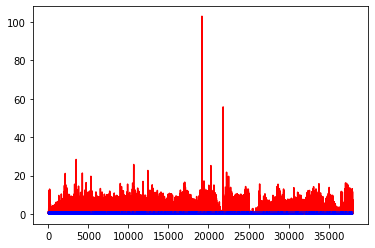

white ratio : 48.5
min : 180
max : 221


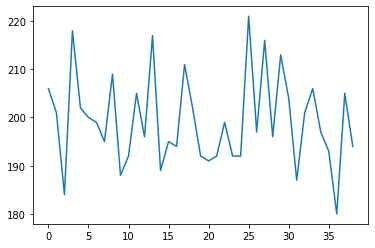

Generating interpolations...
38001 [D loss: 0.000528, acc.: 100.00%] [G loss: 2.824886, 2.564650]
38002 [D loss: 0.000448, acc.: 100.00%] [G loss: 8.083634, 6.892525]
38003 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000001, 0.000008]
38004 [D loss: 0.000204, acc.: 100.00%] [G loss: 4.909722, 5.120334]
38005 [D loss: 0.055401, acc.: 96.88%] [G loss: 5.439240, 4.584482]
38006 [D loss: 0.000280, acc.: 100.00%] [G loss: 2.211281, 2.467087]
38007 [D loss: 0.001857, acc.: 100.00%] [G loss: 4.359946, 4.474466]
38008 [D loss: 0.003306, acc.: 100.00%] [G loss: 0.000006, 0.000088]
38009 [D loss: 0.000200, acc.: 100.00%] [G loss: 7.774859, 5.954217]
38010 [D loss: 0.000037, acc.: 100.00%] [G loss: 4.385949, 3.242672]
38011 [D loss: 0.001673, acc.: 100.00%] [G loss: 3.794743, 1.918129]
38012 [D loss: 0.000871, acc.: 100.00%] [G loss: 6.481163, 3.749634]
38013 [D loss: 0.000458, acc.: 100.00%] [G loss: 2.459151, 2.077273]
38014 [D loss: 0.002286, acc.: 100.00%] [G loss: 6.118547, 5.953960]
38015 

38120 [D loss: 0.000554, acc.: 100.00%] [G loss: 2.437510, 3.757966]
38121 [D loss: 0.000148, acc.: 100.00%] [G loss: 13.731452, 5.780907]
38122 [D loss: 0.000331, acc.: 100.00%] [G loss: 6.754940, 5.364372]
38123 [D loss: 0.066246, acc.: 96.88%] [G loss: 5.930034, 4.351364]
38124 [D loss: 0.000085, acc.: 100.00%] [G loss: 5.444116, 4.372857]
38125 [D loss: 0.000194, acc.: 100.00%] [G loss: 3.943672, 2.327216]
38126 [D loss: 0.004815, acc.: 100.00%] [G loss: 5.759783, 4.578907]
38127 [D loss: 0.000095, acc.: 100.00%] [G loss: 5.869493, 4.189651]
38128 [D loss: 0.000878, acc.: 100.00%] [G loss: 4.787503, 5.733655]
38129 [D loss: 0.005518, acc.: 100.00%] [G loss: 5.192496, 4.305745]
38130 [D loss: 0.001467, acc.: 100.00%] [G loss: 3.866977, 3.368296]
38131 [D loss: 0.002210, acc.: 100.00%] [G loss: 3.960079, 3.246852]
38132 [D loss: 0.007730, acc.: 100.00%] [G loss: 3.379469, 2.422297]
38133 [D loss: 0.000961, acc.: 100.00%] [G loss: 5.411826, 1.968535]
38134 [D loss: 0.000918, acc.: 100

38241 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.694003, 0.694602]
38242 [D loss: 0.000775, acc.: 100.00%] [G loss: 5.508038, 4.100313]
38243 [D loss: 0.002678, acc.: 100.00%] [G loss: 3.887048, 1.666602]
38244 [D loss: 0.002165, acc.: 100.00%] [G loss: 0.622286, 0.284125]
38245 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.166579, 7.487306]
38246 [D loss: 0.000031, acc.: 100.00%] [G loss: 16.952805, 8.128543]
38247 [D loss: 0.000622, acc.: 100.00%] [G loss: 0.931390, 1.587831]
38248 [D loss: 0.000033, acc.: 100.00%] [G loss: 5.391265, 5.407729]
38249 [D loss: 0.000193, acc.: 100.00%] [G loss: 6.414611, 5.177787]
38250 [D loss: 0.001341, acc.: 100.00%] [G loss: 7.890267, 8.222530]
38251 [D loss: 0.002976, acc.: 100.00%] [G loss: 3.781604, 3.095635]
38252 [D loss: 0.000905, acc.: 100.00%] [G loss: 8.152931, 7.873894]
38253 [D loss: 0.001497, acc.: 100.00%] [G loss: 4.694500, 3.739928]
38254 [D loss: 0.001794, acc.: 100.00%] [G loss: 16.305336, 5.551837]
38255 [D loss: 0.000082, acc.: 1

38360 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.129650, 0.458055]
38361 [D loss: 0.000682, acc.: 100.00%] [G loss: 7.550038, 0.001365]
38362 [D loss: 0.001838, acc.: 100.00%] [G loss: 2.007605, 1.827061]
38363 [D loss: 0.013186, acc.: 100.00%] [G loss: 1.453433, 0.242145]
38364 [D loss: 0.001224, acc.: 100.00%] [G loss: 2.666354, 2.266430]
38365 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.233875, 0.489458]
38366 [D loss: 0.000502, acc.: 100.00%] [G loss: 2.935726, 2.616250]
38367 [D loss: 0.000397, acc.: 100.00%] [G loss: 2.485246, 1.716196]
38368 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.256785, 0.285346]
38369 [D loss: 0.004186, acc.: 100.00%] [G loss: 3.622643, 4.313100]
38370 [D loss: 0.000619, acc.: 100.00%] [G loss: 6.283040, 7.617943]
38371 [D loss: 0.000618, acc.: 100.00%] [G loss: 7.319924, 6.690718]
38372 [D loss: 0.000203, acc.: 100.00%] [G loss: 7.159489, 6.844075]
38373 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.467688, 5.537748]
38374 [D loss: 0.000016, acc.: 100

38482 [D loss: 0.000087, acc.: 100.00%] [G loss: 9.841303, 9.875587]
38483 [D loss: 0.000122, acc.: 100.00%] [G loss: 1.336382, 1.062226]
38484 [D loss: 0.000188, acc.: 100.00%] [G loss: 9.542500, 8.821379]
38485 [D loss: 0.000022, acc.: 100.00%] [G loss: 16.826347, 6.760157]
38486 [D loss: 0.000060, acc.: 100.00%] [G loss: 17.813469, 11.145499]
38487 [D loss: 0.000128, acc.: 100.00%] [G loss: 10.136457, 9.105448]
38488 [D loss: 0.004701, acc.: 100.00%] [G loss: 0.341045, 0.454209]
38489 [D loss: 0.000075, acc.: 100.00%] [G loss: 3.540656, 2.222764]
38490 [D loss: 0.000321, acc.: 100.00%] [G loss: 15.875032, 7.214055]
38491 [D loss: 0.001793, acc.: 100.00%] [G loss: 9.593789, 9.736193]
38492 [D loss: 0.000428, acc.: 100.00%] [G loss: 8.512197, 8.561901]
38493 [D loss: 0.000387, acc.: 100.00%] [G loss: 8.312263, 7.610163]
38494 [D loss: 0.000136, acc.: 100.00%] [G loss: 2.365848, 2.055443]
38495 [D loss: 0.000613, acc.: 100.00%] [G loss: 8.894406, 8.484516]
38496 [D loss: 0.000364, acc.

38604 [D loss: 0.000438, acc.: 100.00%] [G loss: 19.310326, 8.551441]
38605 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.135511, 3.997336]
38606 [D loss: 0.027305, acc.: 96.88%] [G loss: 3.933200, 4.525868]
38607 [D loss: 0.000068, acc.: 100.00%] [G loss: 2.247609, 0.958827]
38608 [D loss: 0.000047, acc.: 100.00%] [G loss: 15.903852, 2.758992]
38609 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.763442, 7.044258]
38610 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.346736, 5.395029]
38611 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.208036, 6.173375]
38612 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.354075, 4.223288]
38613 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.477064, 2.754260]
38614 [D loss: 0.000015, acc.: 100.00%] [G loss: 6.684801, 4.377654]
38615 [D loss: 0.000016, acc.: 100.00%] [G loss: 6.241167, 5.527484]
38616 [D loss: 0.000071, acc.: 100.00%] [G loss: 1.267251, 0.688347]
38617 [D loss: 0.000114, acc.: 100.00%] [G loss: 2.108867, 1.091637]
38618 [D loss: 0.000281, acc.: 10

38723 [D loss: 0.001003, acc.: 100.00%] [G loss: 2.320674, 2.533547]
38724 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.319198, 0.585113]
38725 [D loss: 0.019849, acc.: 100.00%] [G loss: 4.388663, 0.293090]
38726 [D loss: 0.000221, acc.: 100.00%] [G loss: 1.508276, 2.670748]
38727 [D loss: 0.000088, acc.: 100.00%] [G loss: 4.143427, 2.636368]
38728 [D loss: 0.000269, acc.: 100.00%] [G loss: 0.461617, 0.319876]
38729 [D loss: 0.000169, acc.: 100.00%] [G loss: 2.530524, 2.073888]
38730 [D loss: 0.000066, acc.: 100.00%] [G loss: 2.416719, 1.418724]
38731 [D loss: 0.180267, acc.: 96.88%] [G loss: 0.061224, 0.004960]
38732 [D loss: 0.000589, acc.: 100.00%] [G loss: 0.092143, 0.060725]
38733 [D loss: 0.004347, acc.: 100.00%] [G loss: 0.069449, 0.069578]
38734 [D loss: 0.000902, acc.: 100.00%] [G loss: 0.288465, 0.142354]
38735 [D loss: 0.001958, acc.: 100.00%] [G loss: 0.100705, 0.086847]
38736 [D loss: 0.019341, acc.: 100.00%] [G loss: 0.070031, 0.012108]
38737 [D loss: 0.000450, acc.: 100.

38842 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.587316, 0.364985]
38843 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000232, 0.000213]
38844 [D loss: 0.000307, acc.: 100.00%] [G loss: 0.022851, 0.027966]
38845 [D loss: 0.001608, acc.: 100.00%] [G loss: 0.026791, 0.125858]
38846 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.036294, 0.107704]
38847 [D loss: 0.000442, acc.: 100.00%] [G loss: 0.019993, 0.000836]
38848 [D loss: 0.066127, acc.: 96.88%] [G loss: 0.231027, 0.119384]
38849 [D loss: 0.000879, acc.: 100.00%] [G loss: 0.163416, 0.026080]
38850 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.522827, 0.191750]
38851 [D loss: 0.000857, acc.: 100.00%] [G loss: 0.218784, 0.042211]
38852 [D loss: 0.000395, acc.: 100.00%] [G loss: 0.106047, 0.109124]
38853 [D loss: 0.000099, acc.: 100.00%] [G loss: 1.010589, 1.071420]
38854 [D loss: 0.004087, acc.: 100.00%] [G loss: 0.000465, 0.000331]
38855 [D loss: 0.000202, acc.: 100.00%] [G loss: 5.669525, 0.013598]
38856 [D loss: 0.000103, acc.: 100.

38962 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.836230, 4.398839]
38963 [D loss: 0.000122, acc.: 100.00%] [G loss: 2.545910, 2.253679]
38964 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.422342, 4.143997]
38965 [D loss: 0.000033, acc.: 100.00%] [G loss: 2.190691, 1.602492]
38966 [D loss: 0.000558, acc.: 100.00%] [G loss: 3.914473, 2.918831]
38967 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.845890, 0.411345]
38968 [D loss: 0.110958, acc.: 96.88%] [G loss: 1.143483, 0.826628]
38969 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.620143, 0.142793]
38970 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.453070, 0.449894]
38971 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.058340, 0.013568]
38972 [D loss: 0.000491, acc.: 100.00%] [G loss: 0.170728, 0.074588]
38973 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.001454, 0.002433]
38974 [D loss: 0.008558, acc.: 100.00%] [G loss: 0.273347, 0.362450]
38975 [D loss: 0.005738, acc.: 100.00%] [G loss: 0.136211, 0.115652]
38976 [D loss: 0.000246, acc.: 100.

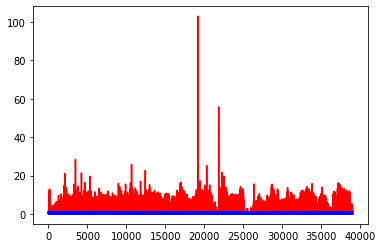

white ratio : 49.0
min : 180
max : 221


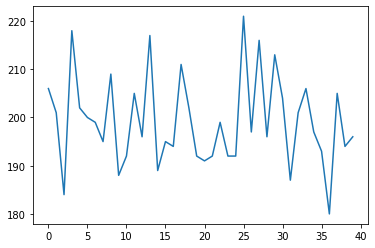

Generating interpolations...
39001 [D loss: 0.001197, acc.: 100.00%] [G loss: 0.006517, 0.086063]
39002 [D loss: 0.001008, acc.: 100.00%] [G loss: 0.317030, 0.336230]
39003 [D loss: 0.002219, acc.: 100.00%] [G loss: 0.119563, 0.107131]
39004 [D loss: 0.029703, acc.: 96.88%] [G loss: 0.063806, 0.004852]
39005 [D loss: 0.010629, acc.: 100.00%] [G loss: 0.005794, 0.023838]
39006 [D loss: 0.053687, acc.: 96.88%] [G loss: 0.000002, 0.000001]
39007 [D loss: 0.001281, acc.: 100.00%] [G loss: 0.083037, 0.058962]
39008 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.000158, 0.001316]
39009 [D loss: 0.001219, acc.: 100.00%] [G loss: 0.000617, 0.000337]
39010 [D loss: 0.005245, acc.: 100.00%] [G loss: 0.055981, 0.045090]
39011 [D loss: 0.001230, acc.: 100.00%] [G loss: 0.017050, 0.127661]
39012 [D loss: 0.003731, acc.: 100.00%] [G loss: 0.001218, 0.000560]
39013 [D loss: 0.000519, acc.: 100.00%] [G loss: 0.023109, 0.106907]
39014 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.048790, 0.017311]
39015 [

39122 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.174927, 0.457657]
39123 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.505768, 0.252201]
39124 [D loss: 0.001098, acc.: 100.00%] [G loss: 0.499827, 0.499726]
39125 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.215477, 0.071838]
39126 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.479453, 0.752881]
39127 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.031996, 0.049776]
39128 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.415944, 0.635536]
39129 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.021549, 0.115483]
39130 [D loss: 0.000271, acc.: 100.00%] [G loss: 0.033422, 0.001575]
39131 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.180677, 0.123655]
39132 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.688797, 0.073083]
39133 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.780618, 0.594388]
39134 [D loss: 0.000113, acc.: 100.00%] [G loss: 4.230759, 1.322107]
39135 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.805466, 1.111827]
39136 [D loss: 0.000006, acc.: 100

39242 [D loss: 0.000447, acc.: 100.00%] [G loss: 0.047151, 0.085368]
39243 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.611710, 0.317386]
39244 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.816083, 1.335072]
39245 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.080047, 0.012150]
39246 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.001375, 0.004193]
39247 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.092663, 0.111878]
39248 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.340142, 0.283069]
39249 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.087400, 0.057553]
39250 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.002620, 0.030123]
39251 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.002107, 0.002678]
39252 [D loss: 0.002944, acc.: 100.00%] [G loss: 0.108358, 0.072276]
39253 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.038904, 0.158932]
39254 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.061568, 0.119763]
39255 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.024919, 0.113783]
39256 [D loss: 0.000367, acc.: 100

39361 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.003284, 0.000966]
39362 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.003875, 0.000071]
39363 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000032, 0.003875]
39364 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.000141, 0.000158]
39365 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.031545, 0.117768]
39366 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.000162, 0.000030]
39367 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.004296, 0.012044]
39368 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.002478, 0.003717]
39369 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.000041, 0.000004]
39370 [D loss: 0.009189, acc.: 100.00%] [G loss: 0.003172, 0.000443]
39371 [D loss: 0.002644, acc.: 100.00%] [G loss: 0.132993, 0.003749]
39372 [D loss: 0.003292, acc.: 100.00%] [G loss: 0.001133, 0.001145]
39373 [D loss: 0.000712, acc.: 100.00%] [G loss: 0.000008, 0.000006]
39374 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.000240, 0.000600]
39375 [D loss: 0.000206, acc.: 100

39480 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.001248, 0.006482]
39481 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.012863, 0.014929]
39482 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.005520, 0.134393]
39483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.060053, 0.001183]
39484 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.091658, 0.018421]
39485 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.306387, 0.090799]
39486 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.006549, 0.001101]
39487 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.139011, 0.231754]
39488 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.345895, 0.040958]
39489 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.004561, 0.001527]
39490 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.006936, 0.010150]
39491 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.483716, 0.067352]
39492 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002539, 0.145358]
39493 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.175079, 0.059056]
39494 [D loss: 0.000346, acc.: 100

39599 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.196421, 0.071165]
39600 [D loss: 0.005574, acc.: 100.00%] [G loss: 0.138702, 0.581361]
39601 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.402454, 0.311703]
39602 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.248701, 0.051326]
39603 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.773866, 0.304169]
39604 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.082978, 0.173401]
39605 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.311433, 0.571699]
39606 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.410113, 0.121253]
39607 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.005023, 0.013134]
39608 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.474858, 0.261100]
39609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.333244, 0.084627]
39610 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.743869, 0.571112]
39611 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.694284, 0.248796]
39612 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.151238, 0.225235]
39613 [D loss: 0.000142, acc.: 100

39719 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000371, 0.000968]
39720 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.015168, 0.000066]
39721 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.023817, 0.020050]
39722 [D loss: 0.050799, acc.: 96.88%] [G loss: 1.310975, 0.359360]
39723 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.765622, 1.756840]
39724 [D loss: 0.060863, acc.: 96.88%] [G loss: 0.000054, 0.154630]
39725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.175865, 0.040418]
39726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015216, 0.041051]
39727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.161495, 0.024516]
39728 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.076490, 0.010489]
39729 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.028890, 0.060267]
39730 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.238507, 0.020464]
39731 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.318428, 0.421725]
39732 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.082269, 0.061381]
39733 [D loss: 0.000123, acc.: 100.0

39841 [D loss: 0.003960, acc.: 100.00%] [G loss: 0.000745, 0.000580]
39842 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.001058, 0.001419]
39843 [D loss: 0.000505, acc.: 100.00%] [G loss: 0.053543, 0.136263]
39844 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.025535, 0.016989]
39845 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.016561, 0.009243]
39846 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.193796, 0.169495]
39847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.443347, 0.393502]
39848 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.392764, 0.722430]
39849 [D loss: 0.005910, acc.: 100.00%] [G loss: 0.023025, 0.007012]
39850 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.114043, 0.157308]
39851 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.126618, 0.253825]
39852 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.026518, 0.461553]
39853 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.353235, 0.103203]
39854 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.101353, 0.054325]
39855 [D loss: 0.000023, acc.: 100

39961 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.070442, 0.002712]
39962 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.002576, 0.005154]
39963 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.019621, 0.001671]
39964 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.004344, 0.002361]
39965 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.001599, 0.002075]
39966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000132, 0.000264]
39967 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000112, 0.000276]
39968 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.006324, 0.000058]
39969 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.012814, 0.001226]
39970 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.002902, 0.000617]
39971 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000991, 0.000124]
39972 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003625, 0.001755]
39973 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000326, 0.003632]
39974 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000075, 0.000182]
39975 [D loss: 0.000017, acc.: 100

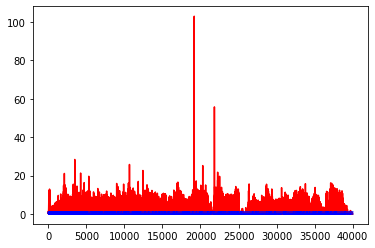

white ratio : 52.25
min : 180
max : 221


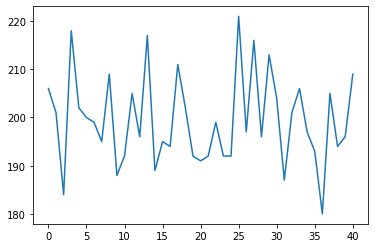

Generating interpolations...
40001 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.000950, 0.015906]
40002 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000032, 0.000011]
40003 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000447, 0.000246]
40004 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000223, 0.005002]
40005 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.002347, 0.038286]
40006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005439, 0.000109]
40007 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000514, 0.001487]
40008 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.020232, 0.015608]
40009 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.003763, 0.001018]
40010 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.005460, 0.000311]
40011 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.024741, 0.016077]
40012 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.011030, 0.000619]
40013 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000259, 0.087078]
40014 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.019736, 0.003064]
40015

40117 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000082, 0.000583]
40118 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000024, 0.000882]
40119 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000029, 0.001114]
40120 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.008473, 0.000040]
40121 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.008013, 0.000393]
40122 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000134, 0.000052]
40123 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001009, 0.003059]
40124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000049, 0.000172]
40125 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000054, 0.000006]
40126 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.030362, 0.172208]
40127 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000111, 0.001269]
40128 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.038113, 0.000501]
40129 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.003788, 0.011072]
40130 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003978, 0.011379]
40131 [D loss: 0.000051, acc.: 100

40238 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000013, 0.000137]
40239 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.005456, 0.000300]
40240 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000010, 0.004558]
40241 [D loss: 0.002933, acc.: 100.00%] [G loss: 0.000274, 0.000528]
40242 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000601, 0.000014]
40243 [D loss: 0.001875, acc.: 100.00%] [G loss: 0.000715, 0.000657]
40244 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002104, 0.000724]
40245 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.011635, 0.000253]
40246 [D loss: 0.000463, acc.: 100.00%] [G loss: 0.000060, 0.001063]
40247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001056, 0.000874]
40248 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001810, 0.068207]
40249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001207, 0.004494]
40250 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000004, 0.000021]
40251 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000020, 0.000002]
40252 [D loss: 0.000000, acc.: 100

40359 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.000001, 0.000020]
40360 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.007213, 0.004688]
40361 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.000060, 0.000077]
40362 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
40363 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000084, 0.000994]
40364 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000980, 0.000028]
40365 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.000103, 0.019171]
40366 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.004892, 0.000035]
40367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.012784, 0.000037]
40368 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000472, 0.000008]
40369 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000243, 0.000242]
40370 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.006472, 0.001069]
40371 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.010504, 0.062105]
40372 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000211, 0.004496]
40373 [D loss: 0.000009, acc.: 100

40478 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.829258, 0.349078]
40479 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.002339, 0.003000]
40480 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.023276, 0.172829]
40481 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.070266, 0.111918]
40482 [D loss: 0.000466, acc.: 100.00%] [G loss: 0.039607, 0.028558]
40483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.226474, 0.080550]
40484 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.082006, 0.176077]
40485 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000322, 0.004750]
40486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.030489, 0.014424]
40487 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.038623, 0.030156]
40488 [D loss: 0.000317, acc.: 100.00%] [G loss: 0.445101, 0.742395]
40489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.190814, 0.374405]
40490 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.218490, 0.139200]
40491 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.018525, 0.076929]
40492 [D loss: 0.000223, acc.: 100

40597 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.030673, 0.100444]
40598 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.147922, 0.235794]
40599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.144898, 0.157503]
40600 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.129932, 0.271046]
40601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.053358, 0.082378]
40602 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.070675, 0.122917]
40603 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.141708, 0.140494]
40604 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.027795, 0.012882]
40605 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.000306, 0.000217]
40606 [D loss: 0.000412, acc.: 100.00%] [G loss: 0.043945, 0.009218]
40607 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.002107, 0.057127]
40608 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000178, 0.015137]
40609 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.002363, 0.279423]
40610 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000015, 0.000742]
40611 [D loss: 0.000110, acc.: 100

40716 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.023512, 0.003424]
40717 [D loss: 0.000443, acc.: 100.00%] [G loss: 0.000073, 0.000289]
40718 [D loss: 0.000345, acc.: 100.00%] [G loss: 0.022536, 0.029436]
40719 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.005304, 0.012575]
40720 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.021788, 0.056399]
40721 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.006280, 0.057608]
40722 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.017424, 0.106846]
40723 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.288646, 0.273821]
40724 [D loss: 0.000382, acc.: 100.00%] [G loss: 0.030765, 0.010275]
40725 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.007373, 0.006742]
40726 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000631, 0.000682]
40727 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.399932, 0.373138]
40728 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.001554, 0.008230]
40729 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000235, 0.000117]
40730 [D loss: 0.002204, acc.: 100

40838 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.879465, 0.452835]
40839 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.106274, 4.995227]
40840 [D loss: 0.006655, acc.: 100.00%] [G loss: 1.462944, 0.478210]
40841 [D loss: 0.000935, acc.: 100.00%] [G loss: 9.597184, 4.877964]
40842 [D loss: 0.013085, acc.: 100.00%] [G loss: 0.828770, 0.730530]
40843 [D loss: 0.000391, acc.: 100.00%] [G loss: 3.257350, 1.500482]
40844 [D loss: 0.000848, acc.: 100.00%] [G loss: 5.862646, 6.662025]
40845 [D loss: 0.000084, acc.: 100.00%] [G loss: 8.330935, 7.548132]
40846 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.946144, 7.279061]
40847 [D loss: 0.000065, acc.: 100.00%] [G loss: 8.875004, 7.672464]
40848 [D loss: 0.000015, acc.: 100.00%] [G loss: 6.656737, 6.861271]
40849 [D loss: 0.000011, acc.: 100.00%] [G loss: 8.556913, 8.081709]
40850 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.186743, 6.623065]
40851 [D loss: 0.000022, acc.: 100.00%] [G loss: 5.606888, 4.844977]
40852 [D loss: 0.000240, acc.: 100

40960 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.748184, 1.059690]
40961 [D loss: 0.000108, acc.: 100.00%] [G loss: 6.199545, 2.077583]
40962 [D loss: 0.366421, acc.: 93.75%] [G loss: 0.019957, 0.058031]
40963 [D loss: 0.002273, acc.: 100.00%] [G loss: 0.544418, 0.032044]
40964 [D loss: 0.000686, acc.: 100.00%] [G loss: 0.000479, 0.014891]
40965 [D loss: 0.001907, acc.: 100.00%] [G loss: 0.046751, 0.012522]
40966 [D loss: 0.012731, acc.: 100.00%] [G loss: 0.000344, 0.000152]
40967 [D loss: 0.000757, acc.: 100.00%] [G loss: 0.001796, 0.002728]
40968 [D loss: 0.001945, acc.: 100.00%] [G loss: 0.049903, 0.022825]
40969 [D loss: 0.000976, acc.: 100.00%] [G loss: 0.094454, 0.251087]
40970 [D loss: 0.000355, acc.: 100.00%] [G loss: 0.079090, 0.146138]
40971 [D loss: 0.005813, acc.: 100.00%] [G loss: 0.027210, 0.055767]
40972 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.009672, 0.065202]
40973 [D loss: 0.002515, acc.: 100.00%] [G loss: 0.093866, 0.129349]
40974 [D loss: 0.000888, acc.: 100.

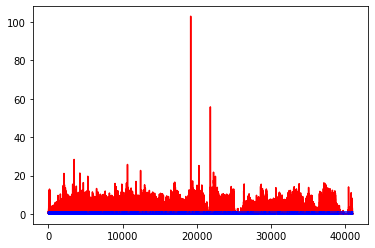

white ratio : 50.25
min : 180
max : 221


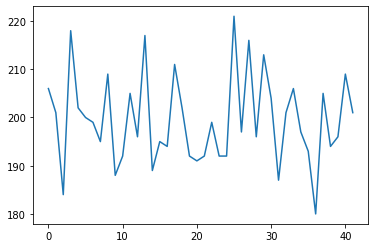

Generating interpolations...
41001 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.154120, 0.409170]
41002 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.843637, 0.773488]
41003 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.051495, 0.058382]
41004 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.056881, 0.085588]
41005 [D loss: 0.006168, acc.: 100.00%] [G loss: 0.203785, 0.022265]
41006 [D loss: 0.001387, acc.: 100.00%] [G loss: 0.204717, 0.211573]
41007 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.758512, 0.727589]
41008 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.283148, 0.032323]
41009 [D loss: 0.000267, acc.: 100.00%] [G loss: 0.870446, 0.763856]
41010 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.026826, 0.114327]
41011 [D loss: 0.000530, acc.: 100.00%] [G loss: 0.004006, 0.003750]
41012 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.375025, 0.258727]
41013 [D loss: 0.003726, acc.: 100.00%] [G loss: 0.007664, 0.053247]
41014 [D loss: 0.000620, acc.: 100.00%] [G loss: 0.000462, 0.000133]
41015

41120 [D loss: 0.010667, acc.: 100.00%] [G loss: 0.000773, 0.002783]
41121 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.160397, 0.070974]
41122 [D loss: 0.000256, acc.: 100.00%] [G loss: 0.000622, 0.003434]
41123 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.005354, 0.004946]
41124 [D loss: 0.000924, acc.: 100.00%] [G loss: 0.130826, 0.010997]
41125 [D loss: 0.003354, acc.: 100.00%] [G loss: 0.050773, 0.004193]
41126 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.191133, 0.012599]
41127 [D loss: 0.010561, acc.: 100.00%] [G loss: 0.000033, 0.000271]
41128 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.180372, 0.000920]
41129 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.047847, 0.185343]
41130 [D loss: 0.039352, acc.: 96.88%] [G loss: 0.005132, 0.042013]
41131 [D loss: 0.001731, acc.: 100.00%] [G loss: 0.000000, 0.000000]
41132 [D loss: 0.001307, acc.: 100.00%] [G loss: 0.000008, 0.000010]
41133 [D loss: 0.060811, acc.: 96.88%] [G loss: 0.114442, 0.017594]
41134 [D loss: 0.000068, acc.: 100.0

41239 [D loss: 0.000108, acc.: 100.00%] [G loss: 2.067187, 3.228766]
41240 [D loss: 0.000677, acc.: 100.00%] [G loss: 0.136991, 0.493895]
41241 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.163453, 0.157214]
41242 [D loss: 0.013410, acc.: 100.00%] [G loss: 0.727034, 0.857581]
41243 [D loss: 0.009286, acc.: 100.00%] [G loss: 0.748682, 0.415072]
41244 [D loss: 0.000046, acc.: 100.00%] [G loss: 4.824029, 0.301622]
41245 [D loss: 0.000104, acc.: 100.00%] [G loss: 3.360762, 3.520206]
41246 [D loss: 0.000080, acc.: 100.00%] [G loss: 1.208505, 0.761666]
41247 [D loss: 0.000879, acc.: 100.00%] [G loss: 4.968462, 3.892375]
41248 [D loss: 0.000120, acc.: 100.00%] [G loss: 1.977094, 0.855833]
41249 [D loss: 0.001248, acc.: 100.00%] [G loss: 0.782922, 0.323764]
41250 [D loss: 0.000540, acc.: 100.00%] [G loss: 8.953821, 0.077481]
41251 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.592481, 0.491569]
41252 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.574040, 0.586834]
41253 [D loss: 0.000260, acc.: 100

41360 [D loss: 0.004517, acc.: 100.00%] [G loss: 2.285578, 1.753302]
41361 [D loss: 0.025188, acc.: 96.88%] [G loss: 1.670048, 1.996060]
41362 [D loss: 0.000062, acc.: 100.00%] [G loss: 1.657954, 1.403418]
41363 [D loss: 0.234710, acc.: 93.75%] [G loss: 0.002058, 0.000296]
41364 [D loss: 0.001044, acc.: 100.00%] [G loss: 10.277139, 2.074310]
41365 [D loss: 0.000245, acc.: 100.00%] [G loss: 1.234359, 2.061643]
41366 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.156450, 0.327454]
41367 [D loss: 0.000300, acc.: 100.00%] [G loss: 14.240589, 0.498125]
41368 [D loss: 0.001439, acc.: 100.00%] [G loss: 1.151490, 0.400472]
41369 [D loss: 0.000730, acc.: 100.00%] [G loss: 1.304981, 1.168740]
41370 [D loss: 0.000515, acc.: 100.00%] [G loss: 0.936160, 0.293434]
41371 [D loss: 0.002407, acc.: 100.00%] [G loss: 0.885481, 0.541796]
41372 [D loss: 0.004599, acc.: 100.00%] [G loss: 0.831799, 0.273830]
41373 [D loss: 0.005513, acc.: 100.00%] [G loss: 0.526432, 0.426154]
41374 [D loss: 0.001017, acc.: 100

41479 [D loss: 0.000083, acc.: 100.00%] [G loss: 13.576916, 13.632559]
41480 [D loss: 0.152642, acc.: 93.75%] [G loss: 5.667904, 4.665134]
41481 [D loss: 0.000032, acc.: 100.00%] [G loss: 7.158145, 6.261849]
41482 [D loss: 0.004021, acc.: 100.00%] [G loss: 2.121999, 1.351921]
41483 [D loss: 0.004207, acc.: 100.00%] [G loss: 21.732704, 1.126792]
41484 [D loss: 0.000595, acc.: 100.00%] [G loss: 0.365365, 1.227494]
41485 [D loss: 0.000051, acc.: 100.00%] [G loss: 5.644882, 4.306900]
41486 [D loss: 0.000928, acc.: 100.00%] [G loss: 5.829892, 4.273275]
41487 [D loss: 0.000178, acc.: 100.00%] [G loss: 6.101145, 5.386021]
41488 [D loss: 0.000148, acc.: 100.00%] [G loss: 2.998637, 0.588705]
41489 [D loss: 0.000132, acc.: 100.00%] [G loss: 4.899586, 3.954008]
41490 [D loss: 0.000449, acc.: 100.00%] [G loss: 1.788201, 0.407319]
41491 [D loss: 0.001311, acc.: 100.00%] [G loss: 0.302358, 0.577119]
41492 [D loss: 0.071936, acc.: 96.88%] [G loss: 1.179602, 0.534126]
41493 [D loss: 0.033785, acc.: 96

41599 [D loss: 0.000562, acc.: 100.00%] [G loss: 6.217334, 3.676738]
41600 [D loss: 0.000457, acc.: 100.00%] [G loss: 7.951421, 6.049361]
41601 [D loss: 0.000312, acc.: 100.00%] [G loss: 10.473177, 8.142673]
41602 [D loss: 0.000827, acc.: 100.00%] [G loss: 5.752588, 4.348481]
41603 [D loss: 0.000574, acc.: 100.00%] [G loss: 6.468750, 3.087248]
41604 [D loss: 0.007618, acc.: 100.00%] [G loss: 11.844764, 3.877436]
41605 [D loss: 0.000688, acc.: 100.00%] [G loss: 7.355518, 1.291690]
41606 [D loss: 0.000151, acc.: 100.00%] [G loss: 9.322199, 9.304789]
41607 [D loss: 0.000050, acc.: 100.00%] [G loss: 8.616030, 7.669269]
41608 [D loss: 0.000074, acc.: 100.00%] [G loss: 8.805483, 7.889615]
41609 [D loss: 0.000099, acc.: 100.00%] [G loss: 5.803840, 3.375205]
41610 [D loss: 0.002520, acc.: 100.00%] [G loss: 7.437695, 5.573206]
41611 [D loss: 0.000057, acc.: 100.00%] [G loss: 20.254528, 7.633868]
41612 [D loss: 0.001818, acc.: 100.00%] [G loss: 6.352880, 5.872554]
41613 [D loss: 0.000622, acc.: 

41720 [D loss: 0.004167, acc.: 100.00%] [G loss: 9.829413, 8.921741]
41721 [D loss: 0.003034, acc.: 100.00%] [G loss: 0.151001, 0.046205]
41722 [D loss: 0.004711, acc.: 100.00%] [G loss: 9.718781, 8.579286]
41723 [D loss: 0.006976, acc.: 100.00%] [G loss: 1.788594, 0.641124]
41724 [D loss: 0.047287, acc.: 96.88%] [G loss: 0.004905, 0.000553]
41725 [D loss: 0.000048, acc.: 100.00%] [G loss: 14.106480, 11.316803]
41726 [D loss: 0.002711, acc.: 100.00%] [G loss: 10.739140, 10.043643]
41727 [D loss: 0.054358, acc.: 96.88%] [G loss: 11.385654, 10.789147]
41728 [D loss: 0.158132, acc.: 96.88%] [G loss: 9.548828, 9.537558]
41729 [D loss: 0.000997, acc.: 100.00%] [G loss: 8.471210, 8.187731]
41730 [D loss: 0.004524, acc.: 100.00%] [G loss: 7.328321, 6.508277]
41731 [D loss: 0.003934, acc.: 100.00%] [G loss: 1.384104, 0.229320]
41732 [D loss: 0.048944, acc.: 96.88%] [G loss: 7.604690, 9.477194]
41733 [D loss: 0.170970, acc.: 96.88%] [G loss: 0.841783, 0.504904]
41734 [D loss: 0.082707, acc.: 96

41842 [D loss: 0.000856, acc.: 100.00%] [G loss: 7.453457, 6.701230]
41843 [D loss: 0.015106, acc.: 100.00%] [G loss: 5.243264, 4.568301]
41844 [D loss: 0.057803, acc.: 96.88%] [G loss: 4.004933, 2.693511]
41845 [D loss: 0.003761, acc.: 100.00%] [G loss: 4.781817, 4.254675]
41846 [D loss: 0.005645, acc.: 100.00%] [G loss: 0.000274, 0.000044]
41847 [D loss: 0.033609, acc.: 96.88%] [G loss: 0.013025, 0.028250]
41848 [D loss: 0.003398, acc.: 100.00%] [G loss: 5.488875, 5.935575]
41849 [D loss: 0.001102, acc.: 100.00%] [G loss: 6.961480, 7.250958]
41850 [D loss: 0.003096, acc.: 100.00%] [G loss: 0.042837, 0.010972]
41851 [D loss: 0.000164, acc.: 100.00%] [G loss: 7.347391, 6.214333]
41852 [D loss: 0.001007, acc.: 100.00%] [G loss: 6.651084, 6.485529]
41853 [D loss: 0.004102, acc.: 100.00%] [G loss: 2.470601, 4.285120]
41854 [D loss: 0.000209, acc.: 100.00%] [G loss: 6.179104, 5.578870]
41855 [D loss: 0.001042, acc.: 100.00%] [G loss: 4.606657, 6.589764]
41856 [D loss: 0.045818, acc.: 96.88

41962 [D loss: 0.000870, acc.: 100.00%] [G loss: 5.936966, 5.531451]
41963 [D loss: 0.000040, acc.: 100.00%] [G loss: 3.134634, 2.885546]
41964 [D loss: 0.000416, acc.: 100.00%] [G loss: 7.752895, 2.882251]
41965 [D loss: 0.001810, acc.: 100.00%] [G loss: 0.788178, 1.164877]
41966 [D loss: 0.003835, acc.: 100.00%] [G loss: 3.189686, 2.309478]
41967 [D loss: 0.002094, acc.: 100.00%] [G loss: 3.805262, 3.012034]
41968 [D loss: 0.000221, acc.: 100.00%] [G loss: 1.947598, 1.938510]
41969 [D loss: 0.003940, acc.: 100.00%] [G loss: 1.031187, 3.870199]
41970 [D loss: 0.003872, acc.: 100.00%] [G loss: 3.464694, 2.193001]
41971 [D loss: 0.010053, acc.: 100.00%] [G loss: 32.163559, 4.773780]
41972 [D loss: 0.000703, acc.: 100.00%] [G loss: 6.184226, 6.206853]
41973 [D loss: 0.000201, acc.: 100.00%] [G loss: 7.459100, 6.742980]
41974 [D loss: 0.000646, acc.: 100.00%] [G loss: 6.472301, 6.044441]
41975 [D loss: 0.000190, acc.: 100.00%] [G loss: 5.407117, 6.136143]
41976 [D loss: 0.000107, acc.: 10

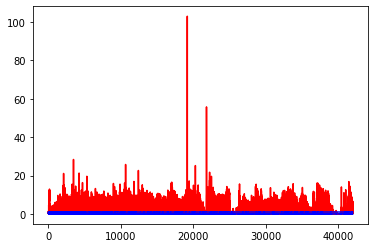

white ratio : 49.75
min : 180
max : 221


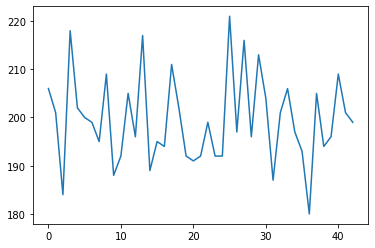

Generating interpolations...
42001 [D loss: 0.001792, acc.: 100.00%] [G loss: 2.917346, 4.428518]
42002 [D loss: 0.003336, acc.: 100.00%] [G loss: 14.961596, 6.758244]
42003 [D loss: 0.000166, acc.: 100.00%] [G loss: 9.093993, 9.068856]
42004 [D loss: 0.057988, acc.: 96.88%] [G loss: 0.000000, 0.000001]
42005 [D loss: 0.000376, acc.: 100.00%] [G loss: 5.141362, 5.112815]
42006 [D loss: 0.000299, acc.: 100.00%] [G loss: 1.783216, 1.958059]
42007 [D loss: 0.001881, acc.: 100.00%] [G loss: 5.899874, 5.260697]
42008 [D loss: 0.001348, acc.: 100.00%] [G loss: 4.630982, 4.929660]
42009 [D loss: 0.001071, acc.: 100.00%] [G loss: 5.545771, 5.013515]
42010 [D loss: 0.000510, acc.: 100.00%] [G loss: 5.769195, 4.759803]
42011 [D loss: 0.000670, acc.: 100.00%] [G loss: 4.193956, 4.107737]
42012 [D loss: 0.003534, acc.: 100.00%] [G loss: 5.599337, 4.931280]
42013 [D loss: 0.001339, acc.: 100.00%] [G loss: 5.312142, 4.426538]
42014 [D loss: 0.001470, acc.: 100.00%] [G loss: 1.080117, 0.770711]
42015

42122 [D loss: 0.000064, acc.: 100.00%] [G loss: 6.166049, 6.532496]
42123 [D loss: 0.000854, acc.: 100.00%] [G loss: 6.337323, 6.012504]
42124 [D loss: 0.047291, acc.: 96.88%] [G loss: 0.000000, 0.000000]
42125 [D loss: 0.000087, acc.: 100.00%] [G loss: 3.814266, 3.257203]
42126 [D loss: 0.000995, acc.: 100.00%] [G loss: 3.686841, 5.020793]
42127 [D loss: 0.000326, acc.: 100.00%] [G loss: 1.282538, 2.225472]
42128 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42129 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42130 [D loss: 0.007186, acc.: 100.00%] [G loss: 7.611516, 7.126951]
42131 [D loss: 0.000226, acc.: 100.00%] [G loss: 8.133708, 7.351328]
42132 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.664538, 7.201009]
42133 [D loss: 0.001506, acc.: 100.00%] [G loss: 6.985110, 7.938237]
42134 [D loss: 0.000163, acc.: 100.00%] [G loss: 6.116424, 6.482859]
42135 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42136 [D loss: 0.001015, acc.: 100.

42242 [D loss: 0.045299, acc.: 96.88%] [G loss: 0.080318, 0.002487]
42243 [D loss: 0.015527, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42244 [D loss: 0.063084, acc.: 96.88%] [G loss: 0.000000, 0.000000]
42245 [D loss: 0.015799, acc.: 100.00%] [G loss: 4.059231, 4.358069]
42246 [D loss: 0.029461, acc.: 96.88%] [G loss: 0.000019, 0.000004]
42247 [D loss: 0.002026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42248 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.000000, 0.000000]
42249 [D loss: 0.035844, acc.: 96.88%] [G loss: 5.759069, 5.710663]
42250 [D loss: 0.003391, acc.: 100.00%] [G loss: 0.000029, 0.000097]
42251 [D loss: 0.000514, acc.: 100.00%] [G loss: 5.885693, 5.011393]
42252 [D loss: 0.000861, acc.: 100.00%] [G loss: 0.000541, 0.000003]
42253 [D loss: 0.005930, acc.: 100.00%] [G loss: 0.608125, 0.000000]
42254 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.069179, 0.041693]
42255 [D loss: 0.001664, acc.: 100.00%] [G loss: 0.131463, 0.131233]
42256 [D loss: 0.000840, acc.: 100.00%

42361 [D loss: 0.000608, acc.: 100.00%] [G loss: 0.442084, 0.168468]
42362 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.637131, 0.668062]
42363 [D loss: 0.000294, acc.: 100.00%] [G loss: 1.639922, 1.719102]
42364 [D loss: 0.000831, acc.: 100.00%] [G loss: 0.022421, 0.005528]
42365 [D loss: 0.000573, acc.: 100.00%] [G loss: 0.470158, 0.715350]
42366 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.973200, 0.713804]
42367 [D loss: 0.000684, acc.: 100.00%] [G loss: 1.907987, 1.651615]
42368 [D loss: 0.000063, acc.: 100.00%] [G loss: 1.692003, 1.656158]
42369 [D loss: 0.000712, acc.: 100.00%] [G loss: 0.279765, 0.310066]
42370 [D loss: 0.001707, acc.: 100.00%] [G loss: 4.126332, 3.144379]
42371 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.025461, 0.008070]
42372 [D loss: 0.002224, acc.: 100.00%] [G loss: 0.092078, 0.004813]
42373 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.031096, 0.272697]
42374 [D loss: 0.003005, acc.: 100.00%] [G loss: 0.015688, 0.006866]
42375 [D loss: 0.000182, acc.: 100

42483 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.283506, 0.223809]
42484 [D loss: 0.000508, acc.: 100.00%] [G loss: 0.174096, 0.085306]
42485 [D loss: 0.085375, acc.: 96.88%] [G loss: 1.576884, 0.828037]
42486 [D loss: 0.000225, acc.: 100.00%] [G loss: 3.741250, 2.017131]
42487 [D loss: 0.025895, acc.: 96.88%] [G loss: 2.926887, 1.186220]
42488 [D loss: 0.000179, acc.: 100.00%] [G loss: 3.194983, 3.201721]
42489 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.040153, 0.225120]
42490 [D loss: 0.011074, acc.: 100.00%] [G loss: 0.973975, 0.571429]
42491 [D loss: 0.003395, acc.: 100.00%] [G loss: 4.998981, 2.393150]
42492 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.347356, 0.406599]
42493 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.410380, 0.085008]
42494 [D loss: 0.003723, acc.: 100.00%] [G loss: 0.200181, 0.003993]
42495 [D loss: 0.002479, acc.: 100.00%] [G loss: 0.187308, 0.424614]
42496 [D loss: 0.016697, acc.: 100.00%] [G loss: 0.047889, 0.037955]
42497 [D loss: 0.000197, acc.: 100.0

42604 [D loss: 0.000219, acc.: 100.00%] [G loss: 5.569733, 5.958645]
42605 [D loss: 0.193044, acc.: 96.88%] [G loss: 2.607231, 1.485665]
42606 [D loss: 0.001095, acc.: 100.00%] [G loss: 0.265878, 0.234539]
42607 [D loss: 0.000375, acc.: 100.00%] [G loss: 4.938999, 3.880940]
42608 [D loss: 0.005234, acc.: 100.00%] [G loss: 25.911180, 0.000384]
42609 [D loss: 0.050344, acc.: 96.88%] [G loss: 5.285182, 4.416011]
42610 [D loss: 0.002365, acc.: 100.00%] [G loss: 0.139749, 0.199137]
42611 [D loss: 0.000428, acc.: 100.00%] [G loss: 1.727830, 1.675986]
42612 [D loss: 0.000641, acc.: 100.00%] [G loss: 2.031390, 1.551996]
42613 [D loss: 0.005170, acc.: 100.00%] [G loss: 0.009532, 0.097901]
42614 [D loss: 0.000625, acc.: 100.00%] [G loss: 5.615878, 4.446321]
42615 [D loss: 0.000619, acc.: 100.00%] [G loss: 0.963735, 0.890567]
42616 [D loss: 0.256098, acc.: 93.75%] [G loss: 2.237986, 0.744644]
42617 [D loss: 0.001225, acc.: 100.00%] [G loss: 7.335906, 7.441095]
42618 [D loss: 0.048479, acc.: 96.88

42723 [D loss: 0.000230, acc.: 100.00%] [G loss: 8.455818, 8.191825]
42724 [D loss: 0.033770, acc.: 96.88%] [G loss: 6.289255, 6.502140]
42725 [D loss: 0.006776, acc.: 100.00%] [G loss: 6.420869, 5.854814]
42726 [D loss: 0.001576, acc.: 100.00%] [G loss: 3.480229, 2.213286]
42727 [D loss: 0.001171, acc.: 100.00%] [G loss: 1.576488, 1.428864]
42728 [D loss: 0.043166, acc.: 96.88%] [G loss: 1.858176, 1.654826]
42729 [D loss: 0.027647, acc.: 100.00%] [G loss: 2.153792, 1.737169]
42730 [D loss: 0.003881, acc.: 100.00%] [G loss: 0.123785, 0.377205]
42731 [D loss: 0.001295, acc.: 100.00%] [G loss: 1.767476, 1.729725]
42732 [D loss: 0.003425, acc.: 100.00%] [G loss: 0.156668, 0.161360]
42733 [D loss: 0.026228, acc.: 100.00%] [G loss: 36.106895, 0.326335]
42734 [D loss: 0.001560, acc.: 100.00%] [G loss: 3.133798, 1.676496]
42735 [D loss: 0.000858, acc.: 100.00%] [G loss: 1.735705, 0.986249]
42736 [D loss: 0.002210, acc.: 100.00%] [G loss: 0.670130, 1.022888]
42737 [D loss: 0.003927, acc.: 100.

42843 [D loss: 0.000781, acc.: 100.00%] [G loss: 2.153873, 1.692769]
42844 [D loss: 0.035818, acc.: 96.88%] [G loss: 1.360560, 1.306080]
42845 [D loss: 0.028862, acc.: 100.00%] [G loss: 1.937830, 1.545627]
42846 [D loss: 0.000177, acc.: 100.00%] [G loss: 1.594897, 0.609838]
42847 [D loss: 0.004663, acc.: 100.00%] [G loss: 4.288704, 3.427992]
42848 [D loss: 0.001816, acc.: 100.00%] [G loss: 0.495667, 0.279290]
42849 [D loss: 0.004958, acc.: 100.00%] [G loss: 4.981330, 4.530523]
42850 [D loss: 0.002487, acc.: 100.00%] [G loss: 0.326742, 0.060767]
42851 [D loss: 0.026954, acc.: 100.00%] [G loss: 5.865816, 5.633892]
42852 [D loss: 0.123719, acc.: 96.88%] [G loss: 3.568632, 3.656910]
42853 [D loss: 0.002023, acc.: 100.00%] [G loss: 0.305678, 0.008203]
42854 [D loss: 0.011632, acc.: 100.00%] [G loss: 0.127047, 0.020228]
42855 [D loss: 0.015835, acc.: 100.00%] [G loss: 1.224137, 1.117276]
42856 [D loss: 0.102232, acc.: 96.88%] [G loss: 0.006639, 0.005988]
42857 [D loss: 0.003005, acc.: 100.00

42963 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.683555, 0.881966]
42964 [D loss: 0.001029, acc.: 100.00%] [G loss: 1.269969, 1.292404]
42965 [D loss: 0.000420, acc.: 100.00%] [G loss: 0.685745, 0.427963]
42966 [D loss: 0.012242, acc.: 100.00%] [G loss: 1.185820, 0.801797]
42967 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.809124, 0.859308]
42968 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.335341, 0.572163]
42969 [D loss: 0.000356, acc.: 100.00%] [G loss: 0.421925, 0.529215]
42970 [D loss: 0.001158, acc.: 100.00%] [G loss: 0.117623, 0.050782]
42971 [D loss: 0.062086, acc.: 96.88%] [G loss: 0.216374, 0.450808]
42972 [D loss: 0.022290, acc.: 100.00%] [G loss: 0.085793, 0.448463]
42973 [D loss: 0.001915, acc.: 100.00%] [G loss: 0.330184, 0.226882]
42974 [D loss: 0.000167, acc.: 100.00%] [G loss: 4.862132, 0.185901]
42975 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.050054, 0.035066]
42976 [D loss: 0.000402, acc.: 100.00%] [G loss: 0.029230, 0.136931]
42977 [D loss: 0.000120, acc.: 100.

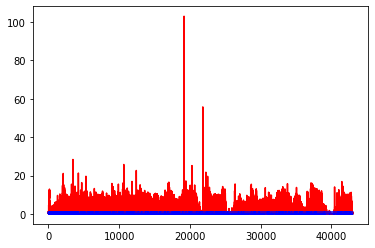

white ratio : 49.75
min : 180
max : 221


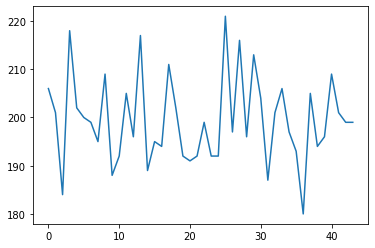

Generating interpolations...
43001 [D loss: 0.004127, acc.: 100.00%] [G loss: 0.000588, 0.012602]
43002 [D loss: 0.003018, acc.: 100.00%] [G loss: 0.011376, 0.161734]
43003 [D loss: 0.155616, acc.: 96.88%] [G loss: 0.000146, 0.000506]
43004 [D loss: 0.001070, acc.: 100.00%] [G loss: 0.010479, 0.000644]
43005 [D loss: 0.004203, acc.: 100.00%] [G loss: 0.004686, 0.023016]
43006 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.075533, 0.005766]
43007 [D loss: 0.002575, acc.: 100.00%] [G loss: 0.038505, 0.000480]
43008 [D loss: 0.000955, acc.: 100.00%] [G loss: 0.001547, 0.057632]
43009 [D loss: 0.001542, acc.: 100.00%] [G loss: 0.000304, 0.000017]
43010 [D loss: 0.005208, acc.: 100.00%] [G loss: 0.000601, 0.000364]
43011 [D loss: 0.005243, acc.: 100.00%] [G loss: 0.083694, 0.011189]
43012 [D loss: 0.001023, acc.: 100.00%] [G loss: 0.000186, 0.000108]
43013 [D loss: 0.001809, acc.: 100.00%] [G loss: 0.010336, 0.003862]
43014 [D loss: 0.005776, acc.: 100.00%] [G loss: 0.163646, 0.294119]
43015 

43120 [D loss: 0.000539, acc.: 100.00%] [G loss: 0.000017, 0.000000]
43121 [D loss: 0.001854, acc.: 100.00%] [G loss: 0.000016, 0.000010]
43122 [D loss: 0.001853, acc.: 100.00%] [G loss: 0.000023, 0.000193]
43123 [D loss: 0.001524, acc.: 100.00%] [G loss: 0.057020, 0.009483]
43124 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000003, 0.000007]
43125 [D loss: 0.000752, acc.: 100.00%] [G loss: 0.000194, 0.000018]
43126 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001638, 0.001819]
43127 [D loss: 0.006279, acc.: 100.00%] [G loss: 0.002931, 0.005907]
43128 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.001267, 0.000050]
43129 [D loss: 0.000878, acc.: 100.00%] [G loss: 0.000132, 0.000015]
43130 [D loss: 0.000942, acc.: 100.00%] [G loss: 0.016735, 0.045089]
43131 [D loss: 0.001919, acc.: 100.00%] [G loss: 0.048459, 0.030576]
43132 [D loss: 0.001477, acc.: 100.00%] [G loss: 0.000008, 0.000076]
43133 [D loss: 0.003528, acc.: 100.00%] [G loss: 0.008987, 0.010723]
43134 [D loss: 0.000143, acc.: 100

43240 [D loss: 0.000901, acc.: 100.00%] [G loss: 0.025643, 0.094554]
43241 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.003984, 0.003771]
43242 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.373048, 0.465204]
43243 [D loss: 0.008575, acc.: 100.00%] [G loss: 0.142692, 0.059954]
43244 [D loss: 0.000390, acc.: 100.00%] [G loss: 0.024580, 0.001806]
43245 [D loss: 0.000516, acc.: 100.00%] [G loss: 0.000875, 0.000033]
43246 [D loss: 0.000588, acc.: 100.00%] [G loss: 0.013934, 0.105344]
43247 [D loss: 0.002493, acc.: 100.00%] [G loss: 0.045316, 0.100245]
43248 [D loss: 0.000648, acc.: 100.00%] [G loss: 0.000116, 0.005725]
43249 [D loss: 0.003558, acc.: 100.00%] [G loss: 14.756383, 0.005082]
43250 [D loss: 0.000387, acc.: 100.00%] [G loss: 0.415007, 0.255313]
43251 [D loss: 0.000233, acc.: 100.00%] [G loss: 0.541398, 0.678598]
43252 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.251957, 0.082436]
43253 [D loss: 0.001121, acc.: 100.00%] [G loss: 0.158234, 0.060724]
43254 [D loss: 0.000042, acc.: 10

43361 [D loss: 0.000743, acc.: 100.00%] [G loss: 0.046898, 0.033547]
43362 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.046267, 0.027581]
43363 [D loss: 0.000488, acc.: 100.00%] [G loss: 0.271672, 0.215473]
43364 [D loss: 0.001803, acc.: 100.00%] [G loss: 0.005020, 0.002785]
43365 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.173545, 0.141869]
43366 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.057545, 0.079958]
43367 [D loss: 0.001572, acc.: 100.00%] [G loss: 0.020593, 0.025964]
43368 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.204293, 0.266036]
43369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011060, 0.044795]
43370 [D loss: 0.001384, acc.: 100.00%] [G loss: 0.005718, 0.014707]
43371 [D loss: 0.000302, acc.: 100.00%] [G loss: 0.188426, 0.023134]
43372 [D loss: 0.001450, acc.: 100.00%] [G loss: 0.054231, 0.015728]
43373 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.245917, 0.223801]
43374 [D loss: 0.005388, acc.: 100.00%] [G loss: 0.063069, 0.023173]
43375 [D loss: 0.000395, acc.: 100

43483 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.148161, 0.033645]
43484 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.046977, 0.009305]
43485 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.003700, 0.000592]
43486 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.044336, 0.020095]
43487 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.016067, 0.057982]
43488 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.000800, 0.005096]
43489 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.024803, 0.080790]
43490 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.081287, 0.180485]
43491 [D loss: 0.000359, acc.: 100.00%] [G loss: 0.027032, 0.006237]
43492 [D loss: 0.031075, acc.: 96.88%] [G loss: 0.184872, 0.086443]
43493 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.616392, 0.144734]
43494 [D loss: 0.000286, acc.: 100.00%] [G loss: 0.375408, 0.093486]
43495 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.006559, 0.008112]
43496 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.181508, 0.054564]
43497 [D loss: 0.044156, acc.: 96.8

43603 [D loss: 0.000439, acc.: 100.00%] [G loss: 0.002225, 0.000737]
43604 [D loss: 0.000986, acc.: 100.00%] [G loss: 0.072555, 0.009680]
43605 [D loss: 0.001561, acc.: 100.00%] [G loss: 0.030979, 0.000211]
43606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000928, 0.000118]
43607 [D loss: 0.021289, acc.: 100.00%] [G loss: 0.000571, 0.001374]
43608 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.000431, 0.000147]
43609 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.395318, 0.321102]
43610 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.007408, 0.140806]
43611 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.044347, 0.148017]
43612 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.007600, 0.041768]
43613 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.012475, 0.002940]
43614 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.894959, 0.679543]
43615 [D loss: 0.000205, acc.: 100.00%] [G loss: 0.000459, 0.066883]
43616 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.166387, 0.015363]
43617 [D loss: 0.000000, acc.: 100

43723 [D loss: 0.000591, acc.: 100.00%] [G loss: 0.004005, 0.007996]
43724 [D loss: 0.000280, acc.: 100.00%] [G loss: 0.037217, 0.057592]
43725 [D loss: 0.001657, acc.: 100.00%] [G loss: 0.012350, 0.027461]
43726 [D loss: 0.002701, acc.: 100.00%] [G loss: 0.020445, 0.085030]
43727 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.362789, 0.181359]
43728 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.000001, 0.000002]
43729 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.004293, 0.009432]
43730 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.000673, 0.047599]
43731 [D loss: 0.003211, acc.: 100.00%] [G loss: 0.050358, 0.010570]
43732 [D loss: 0.125587, acc.: 96.88%] [G loss: 0.000060, 0.000089]
43733 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.036696, 0.006621]
43734 [D loss: 0.002930, acc.: 100.00%] [G loss: 0.000001, 0.000008]
43735 [D loss: 0.009257, acc.: 100.00%] [G loss: 0.000026, 0.001340]
43736 [D loss: 0.001205, acc.: 100.00%] [G loss: 5.103812, 1.114155]
43737 [D loss: 0.000015, acc.: 100.

43842 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.003036, 0.003764]
43843 [D loss: 0.001450, acc.: 100.00%] [G loss: 0.014944, 0.028936]
43844 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.020261, 0.034322]
43845 [D loss: 0.000286, acc.: 100.00%] [G loss: 0.001702, 0.001345]
43846 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001698, 0.008895]
43847 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.010923, 0.114858]
43848 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.041526, 0.141736]
43849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.135264, 0.049343]
43850 [D loss: 0.001030, acc.: 100.00%] [G loss: 0.008679, 0.019519]
43851 [D loss: 0.002579, acc.: 100.00%] [G loss: 0.036937, 0.033768]
43852 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.142798, 0.005032]
43853 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.056962, 0.038212]
43854 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.093771, 0.021753]
43855 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.002102, 0.007355]
43856 [D loss: 0.068454, acc.: 96.

43963 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.008611, 0.004481]
43964 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.021704, 0.149377]
43965 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.105718, 0.315573]
43966 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.002254, 0.010577]
43967 [D loss: 0.001207, acc.: 100.00%] [G loss: 0.176124, 0.290907]
43968 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.066139, 0.010961]
43969 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.012558, 0.061019]
43970 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.975168, 0.193931]
43971 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.132053, 0.012482]
43972 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.015429, 0.049407]
43973 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.032620, 0.138386]
43974 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049018, 0.233895]
43975 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.305358, 0.102165]
43976 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.019227, 0.073516]
43977 [D loss: 0.000000, acc.: 100

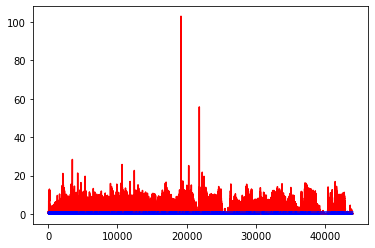

white ratio : 49.25
min : 180
max : 221


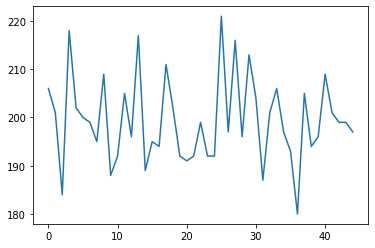

Generating interpolations...
44001 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.118736, 0.009544]
44002 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.208542, 0.019235]
44003 [D loss: 0.001212, acc.: 100.00%] [G loss: 0.039602, 0.165236]
44004 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.087252, 0.137152]
44005 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.077363, 0.040822]
44006 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.095908, 0.053184]
44007 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.141946, 0.013271]
44008 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.155727, 0.330419]
44009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.059111, 0.078614]
44010 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.025389, 0.074782]
44011 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.115620, 0.233162]
44012 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.074843, 0.033486]
44013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.043734, 0.038870]
44014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005380, 0.005176]
44015

44122 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.003651, 0.468507]
44123 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.467899, 0.464056]
44124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.464735, 0.597467]
44125 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.198189, 0.602667]
44126 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.954221, 1.011394]
44127 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.489410, 0.807430]
44128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.265732, 0.175285]
44129 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.303892, 0.237687]
44130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.234258, 0.044630]
44131 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.217152, 0.517485]
44132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.305914, 0.099607]
44133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.207205, 0.263297]
44134 [D loss: 0.000021, acc.: 100.00%] [G loss: 4.825213, 1.319460]
44135 [D loss: 0.004729, acc.: 100.00%] [G loss: 0.079435, 0.153525]
44136 [D loss: 0.000157, acc.: 100

44241 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.009839, 0.009434]
44242 [D loss: 0.005060, acc.: 100.00%] [G loss: 0.000676, 0.000375]
44243 [D loss: 0.049744, acc.: 96.88%] [G loss: 0.098301, 0.046138]
44244 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.130846, 0.283754]
44245 [D loss: 0.002085, acc.: 100.00%] [G loss: 0.393629, 0.310706]
44246 [D loss: 0.000652, acc.: 100.00%] [G loss: 0.161381, 0.132074]
44247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.222560, 0.138652]
44248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.108557, 0.048910]
44249 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.019793, 0.069818]
44250 [D loss: 0.022213, acc.: 96.88%] [G loss: 0.136479, 0.207508]
44251 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.824593, 0.257537]
44252 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.778551, 0.779307]
44253 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.268851, 0.096934]
44254 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.542479, 0.283122]
44255 [D loss: 0.089483, acc.: 96.88

44360 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.001680, 0.000637]
44361 [D loss: 0.003008, acc.: 100.00%] [G loss: 0.000118, 0.000043]
44362 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002100, 0.007690]
44363 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000001, 0.000003]
44364 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000129, 0.000028]
44365 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.034117, 0.001981]
44366 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000477, 0.000282]
44367 [D loss: 0.000709, acc.: 100.00%] [G loss: 0.001031, 0.000230]
44368 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.175867, 0.121975]
44369 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.117867, 0.012553]
44370 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000052, 0.000015]
44371 [D loss: 0.001104, acc.: 100.00%] [G loss: 0.000412, 0.000430]
44372 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.032456, 0.021070]
44373 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.005103, 0.023353]
44374 [D loss: 0.000174, acc.: 100

44482 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.072955, 0.085637]
44483 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004321, 0.001965]
44484 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.002154, 0.009964]
44485 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.014327, 0.003475]
44486 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.001337, 0.001101]
44487 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000426, 0.002767]
44488 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.004120, 0.001231]
44489 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.164049, 0.042346]
44490 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.005750, 0.002311]
44491 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000540, 0.000992]
44492 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.007495, 0.041007]
44493 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.146741, 0.153398]
44494 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.001932, 0.020785]
44495 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.087321, 0.024191]
44496 [D loss: 0.000041, acc.: 100

44601 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.033393, 0.027828]
44602 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.058414, 0.018099]
44603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.029981, 0.042214]
44604 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.127830, 0.032075]
44605 [D loss: 0.001825, acc.: 100.00%] [G loss: 0.101389, 0.136153]
44606 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.026767, 0.018667]
44607 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.081115, 0.087249]
44608 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.003404, 0.002888]
44609 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.446810, 0.201552]
44610 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000950, 0.000897]
44611 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.141590, 0.017107]
44612 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.001762, 0.003138]
44613 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.007815, 0.019475]
44614 [D loss: 0.001230, acc.: 100.00%] [G loss: 0.064778, 0.019957]
44615 [D loss: 0.000024, acc.: 100

44721 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.109552, 0.018442]
44722 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.410787, 0.683413]
44723 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.560982, 0.209899]
44724 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.289780, 0.038528]
44725 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000917, 0.003919]
44726 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.025804, 0.035140]
44727 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.002574, 0.002385]
44728 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000403, 0.000151]
44729 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.161829, 0.147243]
44730 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.072455, 0.108073]
44731 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.317835, 0.015189]
44732 [D loss: 0.000958, acc.: 100.00%] [G loss: 0.528358, 0.306225]
44733 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.128946, 0.111053]
44734 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.380570, 0.187622]
44735 [D loss: 0.000010, acc.: 100

44842 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.548211, 0.074333]
44843 [D loss: 0.000964, acc.: 100.00%] [G loss: 0.117936, 0.101058]
44844 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.009464, 0.039864]
44845 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.029477, 0.032359]
44846 [D loss: 0.001811, acc.: 100.00%] [G loss: 0.801112, 0.269837]
44847 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.207322, 0.078927]
44848 [D loss: 0.000305, acc.: 100.00%] [G loss: 40.949173, 7.777100]
44849 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.151977, 3.495790]
44850 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.793323, 3.278064]
44851 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.130017, 5.153100]
44852 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.339306, 2.311278]
44853 [D loss: 0.000040, acc.: 100.00%] [G loss: 6.797952, 6.685186]
44854 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.260474, 0.666710]
44855 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.004571, 0.000228]
44856 [D loss: 0.000139, acc.: 10

44963 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.686614, 0.917171]
44964 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.487927, 2.077792]
44965 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.325297, 3.162379]
44966 [D loss: 0.000049, acc.: 100.00%] [G loss: 2.413061, 1.890901]
44967 [D loss: 0.000047, acc.: 100.00%] [G loss: 4.728912, 4.948846]
44968 [D loss: 0.000081, acc.: 100.00%] [G loss: 4.067891, 2.641776]
44969 [D loss: 0.000140, acc.: 100.00%] [G loss: 2.968789, 2.395491]
44970 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.104471, 0.035661]
44971 [D loss: 0.000296, acc.: 100.00%] [G loss: 2.724314, 1.611688]
44972 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.181664, 0.127597]
44973 [D loss: 0.000253, acc.: 100.00%] [G loss: 1.793693, 0.563523]
44974 [D loss: 0.002700, acc.: 100.00%] [G loss: 0.001211, 0.004809]
44975 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.064332, 0.031744]
44976 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.085457, 0.107556]
44977 [D loss: 0.001425, acc.: 100

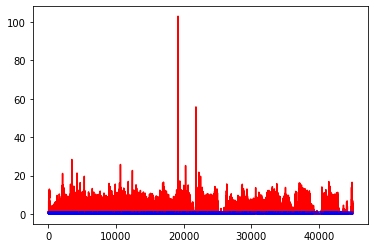

white ratio : 48.25
min : 180
max : 221


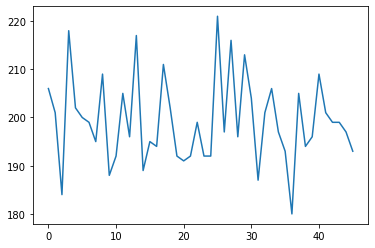

Generating interpolations...
45001 [D loss: 0.000246, acc.: 100.00%] [G loss: 1.865263, 1.564203]
45002 [D loss: 0.000547, acc.: 100.00%] [G loss: 1.365033, 0.967289]
45003 [D loss: 0.002784, acc.: 100.00%] [G loss: 0.747455, 0.213048]
45004 [D loss: 0.002960, acc.: 100.00%] [G loss: 0.570581, 0.319937]
45005 [D loss: 0.003973, acc.: 100.00%] [G loss: 4.232554, 3.900327]
45006 [D loss: 0.001941, acc.: 100.00%] [G loss: 0.771812, 0.587460]
45007 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.546193, 0.167335]
45008 [D loss: 0.002710, acc.: 100.00%] [G loss: 0.062071, 0.080661]
45009 [D loss: 0.002170, acc.: 100.00%] [G loss: 0.363644, 0.175601]
45010 [D loss: 0.004275, acc.: 100.00%] [G loss: 0.942320, 1.480975]
45011 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.068263, 0.058828]
45012 [D loss: 0.000477, acc.: 100.00%] [G loss: 4.129647, 3.099122]
45013 [D loss: 0.000101, acc.: 100.00%] [G loss: 3.332896, 5.311750]
45014 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.850881, 2.650104]
45015

45117 [D loss: 0.188887, acc.: 96.88%] [G loss: 0.985002, 0.601821]
45118 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.014008, 0.006252]
45119 [D loss: 0.016624, acc.: 100.00%] [G loss: 34.314426, 7.074308]
45120 [D loss: 0.005054, acc.: 100.00%] [G loss: 3.906883, 7.246887]
45121 [D loss: 0.000022, acc.: 100.00%] [G loss: 9.844191, 10.130695]
45122 [D loss: 0.000083, acc.: 100.00%] [G loss: 12.005695, 10.362951]
45123 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.854676, 9.770967]
45124 [D loss: 0.000013, acc.: 100.00%] [G loss: 11.488573, 9.054273]
45125 [D loss: 0.000054, acc.: 100.00%] [G loss: 8.232174, 7.793081]
45126 [D loss: 0.000136, acc.: 100.00%] [G loss: 4.087749, 2.788927]
45127 [D loss: 0.000582, acc.: 100.00%] [G loss: 7.893895, 7.555632]
45128 [D loss: 0.001032, acc.: 100.00%] [G loss: 4.718666, 4.039937]
45129 [D loss: 0.069801, acc.: 96.88%] [G loss: 5.840755, 5.183707]
45130 [D loss: 0.000037, acc.: 100.00%] [G loss: 31.273108, 9.790501]
45131 [D loss: 0.001531, acc.

45237 [D loss: 0.001098, acc.: 100.00%] [G loss: 8.336890, 4.328995]
45238 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.628586, 5.707681]
45239 [D loss: 0.000118, acc.: 100.00%] [G loss: 6.965979, 6.584705]
45240 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.735756, 9.613153]
45241 [D loss: 0.000023, acc.: 100.00%] [G loss: 10.173050, 9.458720]
45242 [D loss: 0.000022, acc.: 100.00%] [G loss: 11.156971, 10.700443]
45243 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.498857, 8.266147]
45244 [D loss: 0.000013, acc.: 100.00%] [G loss: 7.720813, 7.567557]
45245 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.310389, 9.276114]
45246 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.143476, 2.197528]
45247 [D loss: 0.000048, acc.: 100.00%] [G loss: 2.355159, 1.598909]
45248 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.756809, 0.760230]
45249 [D loss: 0.000011, acc.: 100.00%] [G loss: 13.437639, 7.805400]
45250 [D loss: 0.000027, acc.: 100.00%] [G loss: 9.255669, 7.728329]
45251 [D loss: 0.000011, acc.

45358 [D loss: 0.003294, acc.: 100.00%] [G loss: 8.188625, 5.122873]
45359 [D loss: 0.000199, acc.: 100.00%] [G loss: 5.228384, 1.648781]
45360 [D loss: 0.000176, acc.: 100.00%] [G loss: 23.356117, 3.498321]
45361 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.390912, 4.934231]
45362 [D loss: 0.000103, acc.: 100.00%] [G loss: 2.213800, 1.874755]
45363 [D loss: 0.111244, acc.: 96.88%] [G loss: 0.079734, 0.118466]
45364 [D loss: 0.000991, acc.: 100.00%] [G loss: 0.289034, 0.238485]
45365 [D loss: 0.132157, acc.: 93.75%] [G loss: 3.796391, 2.151221]
45366 [D loss: 0.000449, acc.: 100.00%] [G loss: 9.084154, 4.229080]
45367 [D loss: 0.000073, acc.: 100.00%] [G loss: 9.935957, 9.755146]
45368 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.598174, 1.644485]
45369 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.233094, 0.038884]
45370 [D loss: 0.000202, acc.: 100.00%] [G loss: 24.030615, 5.763582]
45371 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.645620, 0.356679]
45372 [D loss: 0.000823, acc.: 100

45478 [D loss: 0.001195, acc.: 100.00%] [G loss: 4.117655, 3.112022]
45479 [D loss: 0.000054, acc.: 100.00%] [G loss: 4.527818, 4.206268]
45480 [D loss: 0.000390, acc.: 100.00%] [G loss: 0.264957, 0.076294]
45481 [D loss: 0.000365, acc.: 100.00%] [G loss: 2.678821, 1.499398]
45482 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000002, 0.000002]
45483 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.358528, 1.760848]
45484 [D loss: 0.000576, acc.: 100.00%] [G loss: 1.738911, 0.833726]
45485 [D loss: 0.001312, acc.: 100.00%] [G loss: 8.375193, 6.090893]
45486 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.002941, 0.077582]
45487 [D loss: 0.000782, acc.: 100.00%] [G loss: 4.249949, 2.712101]
45488 [D loss: 0.094426, acc.: 96.88%] [G loss: 0.473054, 0.300951]
45489 [D loss: 0.015142, acc.: 100.00%] [G loss: 0.875847, 0.130554]
45490 [D loss: 0.004531, acc.: 100.00%] [G loss: 0.015311, 0.001323]
45491 [D loss: 0.001744, acc.: 100.00%] [G loss: 0.000115, 0.017672]
45492 [D loss: 0.004342, acc.: 100.

45600 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.056399, 0.029639]
45601 [D loss: 0.000100, acc.: 100.00%] [G loss: 2.873697, 2.465095]
45602 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.165920, 0.177706]
45603 [D loss: 0.000034, acc.: 100.00%] [G loss: 16.394833, 5.766258]
45604 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.905311, 0.914045]
45605 [D loss: 0.000074, acc.: 100.00%] [G loss: 4.818785, 3.639448]
45606 [D loss: 0.000078, acc.: 100.00%] [G loss: 5.731529, 3.787075]
45607 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.039551, 0.017307]
45608 [D loss: 0.002045, acc.: 100.00%] [G loss: 9.441187, 3.508477]
45609 [D loss: 0.000252, acc.: 100.00%] [G loss: 0.474781, 0.475797]
45610 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.302743, 0.275305]
45611 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.052723, 0.410678]
45612 [D loss: 0.000024, acc.: 100.00%] [G loss: 6.476043, 4.649254]
45613 [D loss: 0.000379, acc.: 100.00%] [G loss: 4.714349, 3.974228]
45614 [D loss: 0.000051, acc.: 10

45721 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.009660, 0.000854]
45722 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.147449, 0.594505]
45723 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.001518, 0.002625]
45724 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000002]
45725 [D loss: 0.000025, acc.: 100.00%] [G loss: 7.617775, 7.679126]
45726 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.560666, 8.991020]
45727 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.680593, 1.051502]
45728 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.214885, 0.084746]
45729 [D loss: 0.014687, acc.: 100.00%] [G loss: 8.388434, 8.070835]
45730 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.524536, 5.969444]
45731 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.633141, 2.537351]
45732 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.712791, 1.177311]
45733 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.184444, 0.046514]
45734 [D loss: 0.002383, acc.: 100.00%] [G loss: 0.000155, 0.001744]
45735 [D loss: 0.000189, acc.: 100

45842 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.468216, 1.520937]
45843 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000001, 0.000171]
45844 [D loss: 0.000607, acc.: 100.00%] [G loss: 7.077401, 0.200125]
45845 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.045225, 0.093808]
45846 [D loss: 0.000085, acc.: 100.00%] [G loss: 1.956325, 1.139989]
45847 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.169977, 0.257964]
45848 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.843205, 0.921553]
45849 [D loss: 0.002909, acc.: 100.00%] [G loss: 6.113027, 1.161608]
45850 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.889777, 0.676382]
45851 [D loss: 0.002055, acc.: 100.00%] [G loss: 8.612659, 1.086907]
45852 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.275914, 0.129147]
45853 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.857057, 2.277609]
45854 [D loss: 0.000132, acc.: 100.00%] [G loss: 3.400941, 1.612442]
45855 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.573860, 0.279730]
45856 [D loss: 0.000078, acc.: 100

45962 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.975579, 0.863108]
45963 [D loss: 0.000011, acc.: 100.00%] [G loss: 5.586412, 8.090491]
45964 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.579011, 8.968386]
45965 [D loss: 0.000009, acc.: 100.00%] [G loss: 5.758337, 6.822352]
45966 [D loss: 0.001164, acc.: 100.00%] [G loss: 9.780665, 9.309337]
45967 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.156078, 0.018317]
45968 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.895439, 2.689887]
45969 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.918114, 5.939260]
45970 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.831370, 0.312348]
45971 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.271765, 7.965406]
45972 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.206554, 0.081730]
45973 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.073319, 0.261677]
45974 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.067768, 0.061122]
45975 [D loss: 0.174749, acc.: 96.88%] [G loss: 0.027972, 0.002623]
45976 [D loss: 0.000223, acc.: 100.

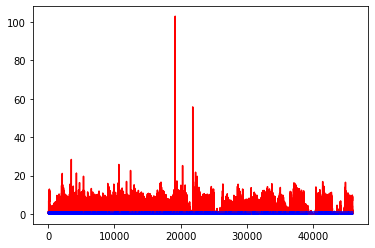

white ratio : 51.5
min : 180
max : 221


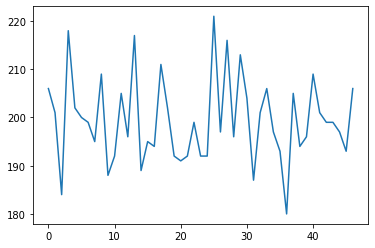

Generating interpolations...
46001 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.000161, 0.000192]
46002 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.125833, 0.379808]
46003 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.853886, 2.146198]
46004 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000348, 0.024059]
46005 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.264857, 0.288515]
46006 [D loss: 0.043415, acc.: 96.88%] [G loss: 0.010269, 0.076228]
46007 [D loss: 0.001376, acc.: 100.00%] [G loss: 0.001179, 0.003737]
46008 [D loss: 0.081226, acc.: 96.88%] [G loss: 0.040325, 0.106610]
46009 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.527822, 2.754147]
46010 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.327746, 5.935665]
46011 [D loss: 0.000122, acc.: 100.00%] [G loss: 7.979130, 5.487070]
46012 [D loss: 0.007165, acc.: 100.00%] [G loss: 4.915584, 5.669298]
46013 [D loss: 0.000029, acc.: 100.00%] [G loss: 2.032458, 1.540326]
46014 [D loss: 0.000007, acc.: 100.00%] [G loss: 7.834894, 6.861399]
46015 [

46121 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.303903, 2.201509]
46122 [D loss: 0.000029, acc.: 100.00%] [G loss: 4.391028, 4.548287]
46123 [D loss: 0.000009, acc.: 100.00%] [G loss: 8.604851, 7.925107]
46124 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.054484, 0.056797]
46125 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.907434, 6.118358]
46126 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.304380, 6.914777]
46127 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.012017, 0.003119]
46128 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000010, 0.000221]
46129 [D loss: 0.000248, acc.: 100.00%] [G loss: 17.132759, 3.984189]
46130 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000545, 0.000594]
46131 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000044, 0.000235]
46132 [D loss: 0.000141, acc.: 100.00%] [G loss: 2.081531, 2.421268]
46133 [D loss: 0.000155, acc.: 100.00%] [G loss: 7.992222, 8.565309]
46134 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.590944, 9.716766]
46135 [D loss: 0.000031, acc.: 10

46240 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.015564, 7.452707]
46241 [D loss: 0.000022, acc.: 100.00%] [G loss: 6.712630, 7.447472]
46242 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.711119, 0.638729]
46243 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.092032, 0.000115]
46244 [D loss: 0.000637, acc.: 100.00%] [G loss: 0.301388, 0.671095]
46245 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.468398, 4.373329]
46246 [D loss: 0.000085, acc.: 100.00%] [G loss: 5.432293, 4.348590]
46247 [D loss: 0.001242, acc.: 100.00%] [G loss: 3.462024, 8.174771]
46248 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.963886, 2.009185]
46249 [D loss: 0.000048, acc.: 100.00%] [G loss: 1.877642, 0.400871]
46250 [D loss: 0.088945, acc.: 96.88%] [G loss: 5.212982, 5.264004]
46251 [D loss: 0.000231, acc.: 100.00%] [G loss: 9.230925, 7.323378]
46252 [D loss: 0.002057, acc.: 100.00%] [G loss: 2.150606, 1.513130]
46253 [D loss: 0.001809, acc.: 100.00%] [G loss: 0.146744, 0.043800]
46254 [D loss: 0.000751, acc.: 100.

46361 [D loss: 0.000054, acc.: 100.00%] [G loss: 6.545597, 6.188755]
46362 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.202410, 0.973646]
46363 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.293649, 2.417834]
46364 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.886965, 7.285120]
46365 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.845860, 5.600558]
46366 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.392777, 4.366191]
46367 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.465942, 2.091704]
46368 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.378031, 1.266591]
46369 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.260391, 2.407808]
46370 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.176945, 4.200728]
46371 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.592711, 5.578630]
46372 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.054289, 5.920309]
46373 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.123795, 1.950430]
46374 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.989086, 6.509205]
46375 [D loss: 0.000005, acc.: 1

46481 [D loss: 0.000393, acc.: 100.00%] [G loss: 0.208983, 0.681681]
46482 [D loss: 0.000363, acc.: 100.00%] [G loss: 3.885774, 3.069728]
46483 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.349597, 1.107038]
46484 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.379441, 0.443654]
46485 [D loss: 0.000122, acc.: 100.00%] [G loss: 4.598239, 5.432652]
46486 [D loss: 0.000095, acc.: 100.00%] [G loss: 3.322493, 2.607425]
46487 [D loss: 0.000593, acc.: 100.00%] [G loss: 2.643131, 3.966848]
46488 [D loss: 0.000536, acc.: 100.00%] [G loss: 0.050100, 0.040073]
46489 [D loss: 0.000642, acc.: 100.00%] [G loss: 3.789696, 2.781266]
46490 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.023277, 0.062753]
46491 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000940, 0.000081]
46492 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.335519, 0.159270]
46493 [D loss: 0.000020, acc.: 100.00%] [G loss: 6.779935, 5.283745]
46494 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.016849, 0.012432]
46495 [D loss: 0.000075, acc.: 100

46602 [D loss: 0.009014, acc.: 100.00%] [G loss: 0.000000, 0.000158]
46603 [D loss: 0.000474, acc.: 100.00%] [G loss: 2.457718, 2.529621]
46604 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.120751, 0.460323]
46605 [D loss: 0.000186, acc.: 100.00%] [G loss: 3.132331, 3.166844]
46606 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.341673, 0.651150]
46607 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.686035, 3.152669]
46608 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.812667, 1.571736]
46609 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000017, 0.000081]
46610 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.461378, 0.059410]
46611 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.563937, 0.656116]
46612 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.581226, 0.684669]
46613 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.460427, 0.298153]
46614 [D loss: 0.000040, acc.: 100.00%] [G loss: 5.335582, 4.476995]
46615 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.444309, 2.501905]
46616 [D loss: 0.000044, acc.: 100

46721 [D loss: 0.000316, acc.: 100.00%] [G loss: 10.654036, 12.353910]
46722 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.803864, 3.287988]
46723 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.118026, 2.967109]
46724 [D loss: 0.027596, acc.: 100.00%] [G loss: 3.018386, 2.705681]
46725 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.531980, 1.594840]
46726 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.043473, 3.966490]
46727 [D loss: 0.000027, acc.: 100.00%] [G loss: 9.898283, 8.334916]
46728 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.381594, 0.625509]
46729 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.042894, 8.056838]
46730 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.996868, 6.669943]
46731 [D loss: 0.000040, acc.: 100.00%] [G loss: 1.354200, 0.077731]
46732 [D loss: 0.000018, acc.: 100.00%] [G loss: 4.846361, 1.627325]
46733 [D loss: 0.003805, acc.: 100.00%] [G loss: 10.171745, 8.919434]
46734 [D loss: 0.000010, acc.: 100.00%] [G loss: 7.194273, 7.924414]
46735 [D loss: 0.000007, acc.: 

46840 [D loss: 0.000034, acc.: 100.00%] [G loss: 10.575417, 8.473174]
46841 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.541833, 6.664638]
46842 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.123745, 0.989860]
46843 [D loss: 0.000039, acc.: 100.00%] [G loss: 5.602721, 6.065485]
46844 [D loss: 0.000271, acc.: 100.00%] [G loss: 4.375464, 4.275713]
46845 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.687032, 0.073950]
46846 [D loss: 0.003393, acc.: 100.00%] [G loss: 5.065179, 3.747256]
46847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.106901, 0.000129]
46848 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.305097, 0.489051]
46849 [D loss: 0.000027, acc.: 100.00%] [G loss: 5.029148, 4.702769]
46850 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001675, 0.007315]
46851 [D loss: 0.000002, acc.: 100.00%] [G loss: 49.919586, 0.086629]
46852 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.387383, 0.834395]
46853 [D loss: 0.000019, acc.: 100.00%] [G loss: 9.746473, 9.417666]
46854 [D loss: 0.000004, acc.: 1

46961 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.322700, 3.836265]
46962 [D loss: 0.000009, acc.: 100.00%] [G loss: 12.179729, 11.211743]
46963 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.997297, 3.237388]
46964 [D loss: 0.000371, acc.: 100.00%] [G loss: 9.132519, 9.499437]
46965 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.096912, 2.823065]
46966 [D loss: 0.000015, acc.: 100.00%] [G loss: 10.248539, 9.804387]
46967 [D loss: 0.000223, acc.: 100.00%] [G loss: 2.771433, 1.996167]
46968 [D loss: 0.000131, acc.: 100.00%] [G loss: 6.547075, 9.201382]
46969 [D loss: 0.000115, acc.: 100.00%] [G loss: 7.952072, 9.033260]
46970 [D loss: 0.000239, acc.: 100.00%] [G loss: 8.057341, 5.421921]
46971 [D loss: 0.000053, acc.: 100.00%] [G loss: 6.528738, 1.430310]
46972 [D loss: 0.000987, acc.: 100.00%] [G loss: 1.709177, 1.599822]
46973 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.529238, 0.620966]
46974 [D loss: 0.000125, acc.: 100.00%] [G loss: 8.550158, 9.850271]
46975 [D loss: 0.000028, acc.: 

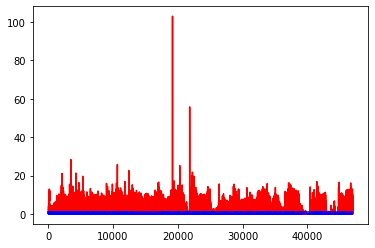

white ratio : 45.5
min : 180
max : 221


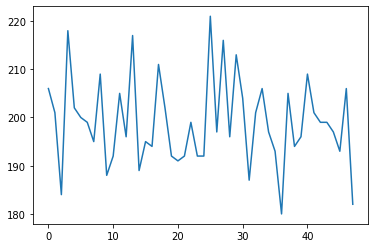

Generating interpolations...
47001 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.143846, 2.667760]
47002 [D loss: 0.000016, acc.: 100.00%] [G loss: 7.115656, 4.682045]
47003 [D loss: 0.000072, acc.: 100.00%] [G loss: 2.174250, 0.151928]
47004 [D loss: 0.000362, acc.: 100.00%] [G loss: 5.337297, 4.507335]
47005 [D loss: 0.000141, acc.: 100.00%] [G loss: 6.457946, 4.812290]
47006 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.039608, 0.155115]
47007 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.793373, 5.662817]
47008 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.046398, 0.026263]
47009 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.789154, 0.483762]
47010 [D loss: 0.000453, acc.: 100.00%] [G loss: 6.123873, 1.134872]
47011 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.982576, 6.623762]
47012 [D loss: 0.000195, acc.: 100.00%] [G loss: 5.396686, 5.279658]
47013 [D loss: 0.000191, acc.: 100.00%] [G loss: 10.004919, 6.500357]
47014 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.363842, 6.353332]
4701

47120 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.203436, 0.429804]
47121 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.330070, 10.007479]
47122 [D loss: 0.000021, acc.: 100.00%] [G loss: 9.592589, 7.643270]
47123 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.101066, 0.402586]
47124 [D loss: 0.000019, acc.: 100.00%] [G loss: 22.610279, 7.661126]
47125 [D loss: 0.000063, acc.: 100.00%] [G loss: 9.033744, 6.462403]
47126 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.350891, 1.336194]
47127 [D loss: 0.000005, acc.: 100.00%] [G loss: 13.447308, 11.727989]
47128 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.024075, 0.010645]
47129 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.592665, 11.122843]
47130 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.758664, 5.214122]
47131 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.379772, 9.892079]
47132 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.940597, 12.486632]
47133 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.071984, 0.002742]
47134 [D loss: 0.000015, 

47239 [D loss: 0.000065, acc.: 100.00%] [G loss: 6.972396, 7.522213]
47240 [D loss: 0.000082, acc.: 100.00%] [G loss: 7.533357, 7.835995]
47241 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.241512, 0.188543]
47242 [D loss: 0.000083, acc.: 100.00%] [G loss: 5.868252, 4.873509]
47243 [D loss: 0.000245, acc.: 100.00%] [G loss: 9.473005, 5.247365]
47244 [D loss: 0.000404, acc.: 100.00%] [G loss: 0.059894, 0.077232]
47245 [D loss: 0.000306, acc.: 100.00%] [G loss: 7.794159, 7.221479]
47246 [D loss: 0.000042, acc.: 100.00%] [G loss: 5.108599, 6.186221]
47247 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000005, 0.000110]
47248 [D loss: 0.000050, acc.: 100.00%] [G loss: 6.873568, 5.825650]
47249 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.091724, 1.716592]
47250 [D loss: 0.000015, acc.: 100.00%] [G loss: 4.767336, 2.801807]
47251 [D loss: 0.000010, acc.: 100.00%] [G loss: 4.605392, 4.445614]
47252 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.082726, 7.073524]
47253 [D loss: 0.000006, acc.: 100

47358 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.087702, 4.097080]
47359 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.486027, 5.613595]
47360 [D loss: 0.000009, acc.: 100.00%] [G loss: 30.340038, 15.506546]
47361 [D loss: 0.029786, acc.: 96.88%] [G loss: 11.028468, 11.223456]
47362 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.255092, 12.239985]
47363 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.496091, 1.362158]
47364 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.399724, 1.825389]
47365 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.317829, 3.161663]
47366 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.992694, 1.730054]
47367 [D loss: 0.002782, acc.: 100.00%] [G loss: 10.304293, 9.764695]
47368 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.406572, 8.708037]
47369 [D loss: 0.000007, acc.: 100.00%] [G loss: 12.158444, 10.981218]
47370 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.520557, 12.627237]
47371 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.421141, 0.806298]
47372 [D loss: 0.000004

47478 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.017149, 10.414181]
47479 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.636907, 8.016308]
47480 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.666473, 3.683219]
47481 [D loss: 0.000076, acc.: 100.00%] [G loss: 4.180703, 5.969161]
47482 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.740288, 1.680496]
47483 [D loss: 0.000563, acc.: 100.00%] [G loss: 2.900628, 0.517762]
47484 [D loss: 0.000130, acc.: 100.00%] [G loss: 7.138994, 7.015503]
47485 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.157351, 0.580230]
47486 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.248995, 0.526925]
47487 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.598888, 2.600445]
47488 [D loss: 0.000015, acc.: 100.00%] [G loss: 3.593330, 2.062773]
47489 [D loss: 0.000011, acc.: 100.00%] [G loss: 11.261022, 3.453013]
47490 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.574337, 0.475569]
47491 [D loss: 0.000006, acc.: 100.00%] [G loss: 9.320728, 8.494301]
47492 [D loss: 0.000096, acc.: 

47597 [D loss: 0.014078, acc.: 100.00%] [G loss: 5.867657, 7.077331]
47598 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.707134, 13.348742]
47599 [D loss: 0.000006, acc.: 100.00%] [G loss: 15.478393, 13.362971]
47600 [D loss: 0.000013, acc.: 100.00%] [G loss: 11.050312, 10.685604]
47601 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.794646, 11.849884]
47602 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.796551, 5.413889]
47603 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.326920, 10.304100]
47604 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.775339, 1.613577]
47605 [D loss: 0.000042, acc.: 100.00%] [G loss: 13.581998, 10.454168]
47606 [D loss: 0.000006, acc.: 100.00%] [G loss: 13.841990, 14.314331]
47607 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.437149, 11.412357]
47608 [D loss: 0.091355, acc.: 96.88%] [G loss: 3.078907, 3.545107]
47609 [D loss: 0.000082, acc.: 100.00%] [G loss: 6.223218, 6.836097]
47610 [D loss: 0.000086, acc.: 100.00%] [G loss: 10.728856, 9.744072]
47611 [D loss: 0.0

47716 [D loss: 0.000047, acc.: 100.00%] [G loss: 10.642542, 11.062561]
47717 [D loss: 0.000477, acc.: 100.00%] [G loss: 11.217119, 10.894753]
47718 [D loss: 0.000352, acc.: 100.00%] [G loss: 2.812356, 1.832666]
47719 [D loss: 0.000016, acc.: 100.00%] [G loss: 12.945137, 8.087136]
47720 [D loss: 0.001316, acc.: 100.00%] [G loss: 41.255150, 11.460121]
47721 [D loss: 0.000104, acc.: 100.00%] [G loss: 2.765294, 2.361666]
47722 [D loss: 0.000036, acc.: 100.00%] [G loss: 6.339901, 7.633268]
47723 [D loss: 0.000008, acc.: 100.00%] [G loss: 10.715349, 9.580477]
47724 [D loss: 0.000029, acc.: 100.00%] [G loss: 10.762641, 10.541630]
47725 [D loss: 0.000013, acc.: 100.00%] [G loss: 10.327793, 10.973904]
47726 [D loss: 0.000014, acc.: 100.00%] [G loss: 9.401556, 8.212359]
47727 [D loss: 0.000097, acc.: 100.00%] [G loss: 10.933594, 11.159414]
47728 [D loss: 0.000068, acc.: 100.00%] [G loss: 3.533431, 4.051839]
47729 [D loss: 0.000081, acc.: 100.00%] [G loss: 5.661469, 4.700503]
47730 [D loss: 0.000

47835 [D loss: 0.003006, acc.: 100.00%] [G loss: 3.707051, 3.210482]
47836 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.983391, 0.301827]
47837 [D loss: 0.000891, acc.: 100.00%] [G loss: 1.148800, 0.767362]
47838 [D loss: 0.002599, acc.: 100.00%] [G loss: 0.031671, 0.090518]
47839 [D loss: 0.052919, acc.: 96.88%] [G loss: 0.000824, 0.016406]
47840 [D loss: 0.000575, acc.: 100.00%] [G loss: 0.469207, 0.048539]
47841 [D loss: 0.076789, acc.: 96.88%] [G loss: 42.248161, 0.690994]
47842 [D loss: 0.001972, acc.: 100.00%] [G loss: 0.381357, 0.501171]
47843 [D loss: 0.015407, acc.: 100.00%] [G loss: 1.809506, 1.155721]
47844 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.633162, 2.027246]
47845 [D loss: 0.051390, acc.: 96.88%] [G loss: 0.761041, 0.388086]
47846 [D loss: 0.003946, acc.: 100.00%] [G loss: 3.486359, 3.275743]
47847 [D loss: 0.002934, acc.: 100.00%] [G loss: 7.114340, 5.873801]
47848 [D loss: 0.012544, acc.: 100.00%] [G loss: 14.198757, 7.577633]
47849 [D loss: 0.108814, acc.: 96.8

47956 [D loss: 0.024170, acc.: 96.88%] [G loss: 4.549963, 2.992473]
47957 [D loss: 0.000313, acc.: 100.00%] [G loss: 1.725171, 1.115441]
47958 [D loss: 0.000112, acc.: 100.00%] [G loss: 5.304261, 3.874680]
47959 [D loss: 0.000766, acc.: 100.00%] [G loss: 0.307490, 0.606315]
47960 [D loss: 0.016359, acc.: 100.00%] [G loss: 1.945281, 0.141460]
47961 [D loss: 0.003794, acc.: 100.00%] [G loss: 2.215285, 1.970251]
47962 [D loss: 0.002877, acc.: 100.00%] [G loss: 13.979506, 4.014287]
47963 [D loss: 0.000161, acc.: 100.00%] [G loss: 8.089257, 0.907980]
47964 [D loss: 0.001949, acc.: 100.00%] [G loss: 1.540066, 1.884979]
47965 [D loss: 0.000661, acc.: 100.00%] [G loss: 4.640553, 4.363486]
47966 [D loss: 0.000826, acc.: 100.00%] [G loss: 2.172680, 2.327535]
47967 [D loss: 0.000223, acc.: 100.00%] [G loss: 1.628177, 0.331596]
47968 [D loss: 0.001003, acc.: 100.00%] [G loss: 0.000644, 0.006972]
47969 [D loss: 0.007058, acc.: 100.00%] [G loss: 0.125854, 0.000981]
47970 [D loss: 0.020678, acc.: 100

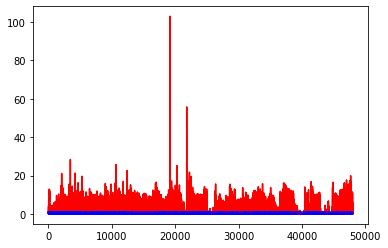

white ratio : 48.75
min : 180
max : 221


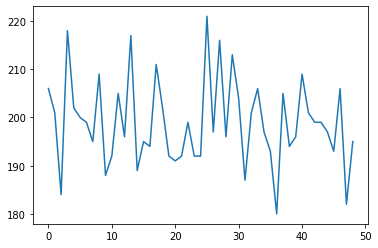

Generating interpolations...
48001 [D loss: 0.019247, acc.: 100.00%] [G loss: 0.155563, 0.226769]
48002 [D loss: 0.014299, acc.: 100.00%] [G loss: 5.913835, 5.101348]
48003 [D loss: 0.013393, acc.: 100.00%] [G loss: 5.426981, 0.507936]
48004 [D loss: 0.000089, acc.: 100.00%] [G loss: 7.654337, 8.851819]
48005 [D loss: 0.000393, acc.: 100.00%] [G loss: 7.077822, 7.716832]
48006 [D loss: 0.000854, acc.: 100.00%] [G loss: 9.500814, 0.164852]
48007 [D loss: 0.168079, acc.: 96.88%] [G loss: 1.826918, 1.868463]
48008 [D loss: 0.000239, acc.: 100.00%] [G loss: 8.015638, 7.638329]
48009 [D loss: 0.005171, acc.: 100.00%] [G loss: 0.174901, 0.153747]
48010 [D loss: 0.000936, acc.: 100.00%] [G loss: 2.111218, 0.801797]
48011 [D loss: 0.001874, acc.: 100.00%] [G loss: 0.803059, 0.518931]
48012 [D loss: 0.000352, acc.: 100.00%] [G loss: 2.214272, 0.349993]
48013 [D loss: 0.000652, acc.: 100.00%] [G loss: 1.234818, 1.863971]
48014 [D loss: 0.000586, acc.: 100.00%] [G loss: 8.207231, 1.324492]
48015 

48123 [D loss: 0.000728, acc.: 100.00%] [G loss: 1.844781, 1.287081]
48124 [D loss: 0.000100, acc.: 100.00%] [G loss: 1.650542, 0.775851]
48125 [D loss: 0.002389, acc.: 100.00%] [G loss: 0.374510, 0.359435]
48126 [D loss: 0.000655, acc.: 100.00%] [G loss: 0.241797, 0.028423]
48127 [D loss: 0.023054, acc.: 96.88%] [G loss: 0.266216, 0.001282]
48128 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.000123, 0.000202]
48129 [D loss: 0.007099, acc.: 100.00%] [G loss: 0.636789, 0.145118]
48130 [D loss: 0.062948, acc.: 96.88%] [G loss: 0.000384, 0.000348]
48131 [D loss: 0.015669, acc.: 100.00%] [G loss: 0.013743, 0.010263]
48132 [D loss: 0.058160, acc.: 96.88%] [G loss: 1.829418, 0.128581]
48133 [D loss: 0.030050, acc.: 96.88%] [G loss: 11.381745, 0.338101]
48134 [D loss: 0.000103, acc.: 100.00%] [G loss: 5.644134, 3.784978]
48135 [D loss: 0.029118, acc.: 96.88%] [G loss: 9.327600, 8.989985]
48136 [D loss: 0.000365, acc.: 100.00%] [G loss: 6.198002, 5.808067]
48137 [D loss: 0.000052, acc.: 100.00%

48245 [D loss: 0.000249, acc.: 100.00%] [G loss: 1.341301, 1.095888]
48246 [D loss: 0.013052, acc.: 100.00%] [G loss: 3.488353, 2.655007]
48247 [D loss: 0.001672, acc.: 100.00%] [G loss: 0.460388, 0.283753]
48248 [D loss: 0.018498, acc.: 100.00%] [G loss: 5.894902, 4.097177]
48249 [D loss: 0.025258, acc.: 96.88%] [G loss: 1.678058, 0.843739]
48250 [D loss: 0.000149, acc.: 100.00%] [G loss: 4.466551, 3.872353]
48251 [D loss: 0.225313, acc.: 96.88%] [G loss: 5.006083, 4.266693]
48252 [D loss: 0.002283, acc.: 100.00%] [G loss: 0.036807, 0.107117]
48253 [D loss: 0.000107, acc.: 100.00%] [G loss: 20.128870, 2.568731]
48254 [D loss: 0.001903, acc.: 100.00%] [G loss: 6.165022, 5.795633]
48255 [D loss: 0.000425, acc.: 100.00%] [G loss: 3.992294, 4.219260]
48256 [D loss: 0.000440, acc.: 100.00%] [G loss: 3.663304, 3.555982]
48257 [D loss: 0.004441, acc.: 100.00%] [G loss: 5.353921, 5.179859]
48258 [D loss: 0.001754, acc.: 100.00%] [G loss: 0.907317, 0.288093]
48259 [D loss: 0.000820, acc.: 100.

48366 [D loss: 0.000239, acc.: 100.00%] [G loss: 0.008850, 0.038398]
48367 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.714428, 0.498007]
48368 [D loss: 0.000885, acc.: 100.00%] [G loss: 0.606789, 0.381761]
48369 [D loss: 0.000786, acc.: 100.00%] [G loss: 0.077920, 0.014340]
48370 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.164746, 0.523117]
48371 [D loss: 0.003302, acc.: 100.00%] [G loss: 0.139857, 0.258462]
48372 [D loss: 0.096305, acc.: 96.88%] [G loss: 0.072067, 0.160847]
48373 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.912370, 1.058785]
48374 [D loss: 0.000272, acc.: 100.00%] [G loss: 1.728779, 1.016825]
48375 [D loss: 0.002048, acc.: 100.00%] [G loss: 0.101253, 0.058448]
48376 [D loss: 0.001244, acc.: 100.00%] [G loss: 0.038140, 0.060945]
48377 [D loss: 0.000227, acc.: 100.00%] [G loss: 3.878505, 2.501364]
48378 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.001645, 0.198982]
48379 [D loss: 0.000481, acc.: 100.00%] [G loss: 3.583784, 1.143158]
48380 [D loss: 0.034879, acc.: 96.8

48486 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.088089, 0.111121]
48487 [D loss: 0.000909, acc.: 100.00%] [G loss: 0.608484, 0.349625]
48488 [D loss: 0.017175, acc.: 100.00%] [G loss: 0.004115, 0.029431]
48489 [D loss: 0.000678, acc.: 100.00%] [G loss: 0.800162, 0.051723]
48490 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000538, 0.009032]
48491 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.078325, 0.128952]
48492 [D loss: 0.002080, acc.: 100.00%] [G loss: 0.000902, 0.009346]
48493 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.102501, 0.027819]
48494 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005469, 0.011149]
48495 [D loss: 0.000716, acc.: 100.00%] [G loss: 0.012505, 0.025980]
48496 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.597776, 0.437502]
48497 [D loss: 0.005620, acc.: 100.00%] [G loss: 0.000365, 0.000308]
48498 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.161501, 0.126981]
48499 [D loss: 0.000505, acc.: 100.00%] [G loss: 0.000692, 0.019720]
48500 [D loss: 0.000000, acc.: 100

48606 [D loss: 0.001079, acc.: 100.00%] [G loss: 0.000206, 0.037010]
48607 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.045924, 0.188568]
48608 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.024949, 0.054808]
48609 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000236, 0.001638]
48610 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.067022, 0.032029]
48611 [D loss: 0.000339, acc.: 100.00%] [G loss: 0.001417, 0.000742]
48612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006361, 0.002753]
48613 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.038412, 0.059769]
48614 [D loss: 0.005523, acc.: 100.00%] [G loss: 0.013351, 0.004832]
48615 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.064870, 0.023583]
48616 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.703326, 0.760979]
48617 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000430, 0.000828]
48618 [D loss: 0.000244, acc.: 100.00%] [G loss: 0.000009, 0.000010]
48619 [D loss: 0.000486, acc.: 100.00%] [G loss: 0.000206, 0.000324]
48620 [D loss: 0.000005, acc.: 100

48725 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.569187, 0.469336]
48726 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.700615, 1.048978]
48727 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.528458, 0.284579]
48728 [D loss: 0.001080, acc.: 100.00%] [G loss: 1.207686, 0.402800]
48729 [D loss: 0.000426, acc.: 100.00%] [G loss: 1.085966, 0.977331]
48730 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.355999, 0.826765]
48731 [D loss: 0.000335, acc.: 100.00%] [G loss: 0.472174, 0.226078]
48732 [D loss: 0.000318, acc.: 100.00%] [G loss: 0.263929, 0.180697]
48733 [D loss: 0.018302, acc.: 100.00%] [G loss: 1.542795, 1.417387]
48734 [D loss: 0.000104, acc.: 100.00%] [G loss: 1.411672, 0.966137]
48735 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.332536, 0.516796]
48736 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.821248, 0.404102]
48737 [D loss: 0.000299, acc.: 100.00%] [G loss: 8.206419, 0.755961]
48738 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.888307, 3.159080]
48739 [D loss: 0.000158, acc.: 100

48845 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.082197, 0.102942]
48846 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.625637, 0.976182]
48847 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.766849, 0.896741]
48848 [D loss: 0.000488, acc.: 100.00%] [G loss: 0.014488, 0.014473]
48849 [D loss: 0.023790, acc.: 96.88%] [G loss: 0.005411, 0.003633]
48850 [D loss: 0.000561, acc.: 100.00%] [G loss: 1.004018, 1.075978]
48851 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.064960, 0.299980]
48852 [D loss: 0.002623, acc.: 100.00%] [G loss: 0.000806, 0.008836]
48853 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.070220, 0.287140]
48854 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.138194, 0.114633]
48855 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.198328, 0.421397]
48856 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.006777, 0.057817]
48857 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.851578, 1.229471]
48858 [D loss: 0.001841, acc.: 100.00%] [G loss: 8.507931, 1.896448]
48859 [D loss: 0.000050, acc.: 100.

48965 [D loss: 0.000075, acc.: 100.00%] [G loss: 5.712562, 5.203897]
48966 [D loss: 0.110186, acc.: 96.88%] [G loss: 0.753659, 0.492069]
48967 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.296130, 0.356910]
48968 [D loss: 0.001668, acc.: 100.00%] [G loss: 1.798285, 0.124029]
48969 [D loss: 0.000565, acc.: 100.00%] [G loss: 2.279125, 1.646415]
48970 [D loss: 0.000167, acc.: 100.00%] [G loss: 2.280034, 1.439757]
48971 [D loss: 0.000587, acc.: 100.00%] [G loss: 10.905924, 3.185013]
48972 [D loss: 0.000115, acc.: 100.00%] [G loss: 4.289685, 3.817794]
48973 [D loss: 0.000066, acc.: 100.00%] [G loss: 5.844243, 5.280143]
48974 [D loss: 0.000014, acc.: 100.00%] [G loss: 4.099590, 3.732988]
48975 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.387834, 1.998734]
48976 [D loss: 0.000247, acc.: 100.00%] [G loss: 1.039764, 0.592749]
48977 [D loss: 0.000180, acc.: 100.00%] [G loss: 4.611100, 3.410009]
48978 [D loss: 0.004051, acc.: 100.00%] [G loss: 3.887927, 2.806067]
48979 [D loss: 0.000391, acc.: 100

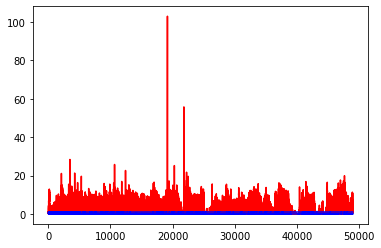

white ratio : 49.75
min : 180
max : 221


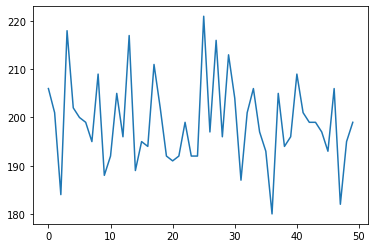

Generating interpolations...
49001 [D loss: 0.000169, acc.: 100.00%] [G loss: 4.848361, 4.483998]
49002 [D loss: 0.009680, acc.: 100.00%] [G loss: 1.638355, 1.703443]
49003 [D loss: 0.000757, acc.: 100.00%] [G loss: 0.456196, 0.165892]
49004 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.924358, 2.706449]
49005 [D loss: 0.022152, acc.: 96.88%] [G loss: 2.603275, 5.057522]
49006 [D loss: 0.000067, acc.: 100.00%] [G loss: 2.746273, 2.743911]
49007 [D loss: 0.000167, acc.: 100.00%] [G loss: 7.165712, 9.885836]
49008 [D loss: 0.002084, acc.: 100.00%] [G loss: 7.616276, 8.636595]
49009 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.633858, 4.212847]
49010 [D loss: 0.000036, acc.: 100.00%] [G loss: 5.290323, 3.373075]
49011 [D loss: 0.000062, acc.: 100.00%] [G loss: 7.938896, 4.997260]
49012 [D loss: 0.000100, acc.: 100.00%] [G loss: 2.856672, 1.754821]
49013 [D loss: 0.000028, acc.: 100.00%] [G loss: 7.006094, 6.255800]
49014 [D loss: 0.000293, acc.: 100.00%] [G loss: 2.334867, 0.381961]
49015 

49122 [D loss: 0.000029, acc.: 100.00%] [G loss: 7.150498, 7.537141]
49123 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.329058, 4.007736]
49124 [D loss: 0.000525, acc.: 100.00%] [G loss: 0.796612, 0.641667]
49125 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.641851, 8.609683]
49126 [D loss: 0.000575, acc.: 100.00%] [G loss: 0.528228, 0.275527]
49127 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.979102, 4.415783]
49128 [D loss: 0.000015, acc.: 100.00%] [G loss: 3.455320, 2.410624]
49129 [D loss: 0.000128, acc.: 100.00%] [G loss: 6.735674, 5.896748]
49130 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.715378, 0.363284]
49131 [D loss: 0.000085, acc.: 100.00%] [G loss: 1.850037, 1.934743]
49132 [D loss: 0.000123, acc.: 100.00%] [G loss: 3.334725, 2.424541]
49133 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.476518, 0.419632]
49134 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.178308, 0.045180]
49135 [D loss: 0.033506, acc.: 96.88%] [G loss: 13.942839, 1.293447]
49136 [D loss: 0.062898, acc.: 96.

49243 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.325619, 12.423622]
49244 [D loss: 0.038456, acc.: 96.88%] [G loss: 11.687484, 13.068534]
49245 [D loss: 0.000217, acc.: 100.00%] [G loss: 11.077877, 10.508843]
49246 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.976917, 9.765118]
49247 [D loss: 0.000040, acc.: 100.00%] [G loss: 11.101762, 10.573699]
49248 [D loss: 0.000011, acc.: 100.00%] [G loss: 8.664922, 6.409901]
49249 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.788119, 7.775883]
49250 [D loss: 0.062425, acc.: 96.88%] [G loss: 8.067514, 8.705082]
49251 [D loss: 0.000086, acc.: 100.00%] [G loss: 3.874181, 3.314012]
49252 [D loss: 0.000011, acc.: 100.00%] [G loss: 6.532042, 5.676812]
49253 [D loss: 0.000057, acc.: 100.00%] [G loss: 4.711386, 3.340639]
49254 [D loss: 0.000059, acc.: 100.00%] [G loss: 6.240189, 5.977281]
49255 [D loss: 0.000166, acc.: 100.00%] [G loss: 5.485942, 6.018439]
49256 [D loss: 0.000039, acc.: 100.00%] [G loss: 6.245264, 5.270606]
49257 [D loss: 0.000009, ac

49364 [D loss: 0.000606, acc.: 100.00%] [G loss: 0.282715, 0.083526]
49365 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.585004, 0.479384]
49366 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000003, 0.000001]
49367 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.487844, 0.230058]
49368 [D loss: 0.000874, acc.: 100.00%] [G loss: 1.702802, 0.922183]
49369 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.236435, 0.599908]
49370 [D loss: 0.001005, acc.: 100.00%] [G loss: 3.745131, 2.080887]
49371 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.204954, 0.018872]
49372 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.194269, 0.224794]
49373 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000031, 0.000019]
49374 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000840, 0.007786]
49375 [D loss: 0.003404, acc.: 100.00%] [G loss: 0.001428, 0.000785]
49376 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.214781, 0.225317]
49377 [D loss: 0.001289, acc.: 100.00%] [G loss: 0.674645, 0.786319]
49378 [D loss: 0.000030, acc.: 100

49486 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.002564, 0.023778]
49487 [D loss: 0.001611, acc.: 100.00%] [G loss: 0.626398, 0.699539]
49488 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.059188, 0.065868]
49489 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.371319, 0.482219]
49490 [D loss: 0.000352, acc.: 100.00%] [G loss: 0.003463, 0.000314]
49491 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.327883, 1.670765]
49492 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.000076, 0.000717]
49493 [D loss: 0.000098, acc.: 100.00%] [G loss: 8.653084, 2.151082]
49494 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.097703, 0.054219]
49495 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.816642, 2.033767]
49496 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.557544, 2.371953]
49497 [D loss: 0.001351, acc.: 100.00%] [G loss: 4.014511, 2.073523]
49498 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.935033, 2.687846]
49499 [D loss: 0.001389, acc.: 100.00%] [G loss: 0.105851, 0.032457]
49500 [D loss: 0.000003, acc.: 100

49606 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.410497, 0.064898]
49607 [D loss: 0.002465, acc.: 100.00%] [G loss: 0.003665, 0.035227]
49608 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.407773, 0.369715]
49609 [D loss: 0.000293, acc.: 100.00%] [G loss: 25.056011, 0.102537]
49610 [D loss: 0.000058, acc.: 100.00%] [G loss: 3.044483, 1.559018]
49611 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.242425, 0.039442]
49612 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.456272, 0.029511]
49613 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.818222, 3.779091]
49614 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.663679, 1.355966]
49615 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.780667, 0.310370]
49616 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.324538, 0.219801]
49617 [D loss: 0.000008, acc.: 100.00%] [G loss: 15.389687, 3.707584]
49618 [D loss: 0.000039, acc.: 100.00%] [G loss: 3.601971, 3.290810]
49619 [D loss: 0.000011, acc.: 100.00%] [G loss: 3.048772, 1.857173]
49620 [D loss: 0.000004, acc.: 1

49726 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.167744, 0.222215]
49727 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.188733, 0.164151]
49728 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.666557, 4.242119]
49729 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.293328, 1.524705]
49730 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.733578, 0.170343]
49731 [D loss: 0.000952, acc.: 100.00%] [G loss: 1.749245, 0.935407]
49732 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.287139, 0.213888]
49733 [D loss: 0.002633, acc.: 100.00%] [G loss: 1.052621, 1.297334]
49734 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.002125, 1.022562]
49735 [D loss: 0.000670, acc.: 100.00%] [G loss: 0.543002, 0.775681]
49736 [D loss: 0.000367, acc.: 100.00%] [G loss: 0.000570, 0.003220]
49737 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.435091, 0.298676]
49738 [D loss: 0.004013, acc.: 100.00%] [G loss: 0.560193, 0.367900]
49739 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.761206, 0.705425]
49740 [D loss: 0.000051, acc.: 100

49847 [D loss: 0.000047, acc.: 100.00%] [G loss: 5.092604, 3.735288]
49848 [D loss: 0.000117, acc.: 100.00%] [G loss: 1.861202, 1.404383]
49849 [D loss: 0.000080, acc.: 100.00%] [G loss: 2.823589, 2.086880]
49850 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.717301, 0.799038]
49851 [D loss: 0.000061, acc.: 100.00%] [G loss: 1.701144, 2.120215]
49852 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.511471, 0.635838]
49853 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.814572, 2.911206]
49854 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.382110, 0.388681]
49855 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.574474, 0.143364]
49856 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.167921, 0.668658]
49857 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.463627, 0.867185]
49858 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.284650, 0.436884]
49859 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.701690, 0.513225]
49860 [D loss: 0.000281, acc.: 100.00%] [G loss: 1.174152, 0.344470]
49861 [D loss: 0.000052, acc.: 100

49966 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.227892, 1.240843]
49967 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.673185, 3.907444]
49968 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.007682, 2.360102]
49969 [D loss: 0.005363, acc.: 100.00%] [G loss: 15.419004, 6.815863]
49970 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.504548, 2.003507]
49971 [D loss: 0.000260, acc.: 100.00%] [G loss: 3.673155, 2.583545]
49972 [D loss: 0.032467, acc.: 96.88%] [G loss: 1.507159, 0.576131]
49973 [D loss: 0.010096, acc.: 100.00%] [G loss: 10.805479, 4.128470]
49974 [D loss: 0.000148, acc.: 100.00%] [G loss: 3.748102, 3.929341]
49975 [D loss: 0.000116, acc.: 100.00%] [G loss: 2.050913, 1.736657]
49976 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.769867, 2.289886]
49977 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.112180, 3.341006]
49978 [D loss: 0.000256, acc.: 100.00%] [G loss: 4.150304, 4.048597]
49979 [D loss: 0.000021, acc.: 100.00%] [G loss: 8.475637, 0.097287]
49980 [D loss: 0.000143, acc.: 10

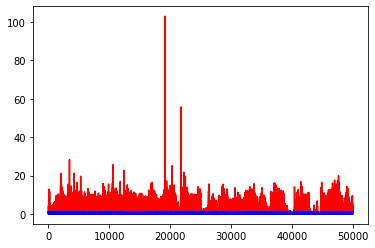

white ratio : 47.25
min : 180
max : 221


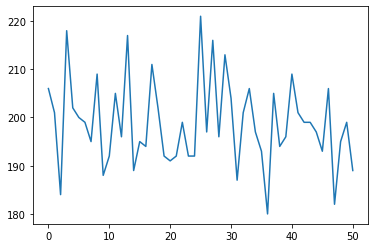

Generating interpolations...
50001 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.313122, 1.809722]
50002 [D loss: 0.000256, acc.: 100.00%] [G loss: 0.092018, 0.148643]
50003 [D loss: 0.001946, acc.: 100.00%] [G loss: 0.106883, 0.161026]
50004 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.911620, 1.249649]
50005 [D loss: 0.000175, acc.: 100.00%] [G loss: 1.235553, 2.185209]
50006 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.021978, 0.093881]
50007 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.763845, 0.815799]
50008 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.136167, 0.454667]
50009 [D loss: 0.000513, acc.: 100.00%] [G loss: 0.638632, 0.231230]
50010 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.363466, 0.002230]
50011 [D loss: 0.000051, acc.: 100.00%] [G loss: 9.126685, 0.964222]
50012 [D loss: 0.000013, acc.: 100.00%] [G loss: 9.348032, 3.101758]
50013 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.419907, 3.773906]
50014 [D loss: 0.000023, acc.: 100.00%] [G loss: 7.308334, 5.548999]
50015

50117 [D loss: 0.000398, acc.: 100.00%] [G loss: 1.380193, 2.761660]
50118 [D loss: 0.001794, acc.: 100.00%] [G loss: 1.242241, 1.013014]
50119 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.785976, 0.369451]
50120 [D loss: 0.000153, acc.: 100.00%] [G loss: 3.983567, 3.723703]
50121 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.901255, 0.898134]
50122 [D loss: 0.000072, acc.: 100.00%] [G loss: 1.246383, 0.519819]
50123 [D loss: 0.002714, acc.: 100.00%] [G loss: 1.990729, 1.350801]
50124 [D loss: 0.000200, acc.: 100.00%] [G loss: 3.217235, 2.356013]
50125 [D loss: 0.004940, acc.: 100.00%] [G loss: 3.733539, 1.851636]
50126 [D loss: 0.000080, acc.: 100.00%] [G loss: 17.784496, 3.425711]
50127 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.467362, 2.942725]
50128 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.267614, 3.609578]
50129 [D loss: 0.000174, acc.: 100.00%] [G loss: 4.912051, 4.516417]
50130 [D loss: 0.001602, acc.: 100.00%] [G loss: 2.785122, 2.251460]
50131 [D loss: 0.002044, acc.: 10

50237 [D loss: 0.003114, acc.: 100.00%] [G loss: 11.348026, 10.992854]
50238 [D loss: 0.000163, acc.: 100.00%] [G loss: 6.615673, 6.375141]
50239 [D loss: 0.000106, acc.: 100.00%] [G loss: 35.072594, 12.752842]
50240 [D loss: 0.000050, acc.: 100.00%] [G loss: 9.751358, 9.846165]
50241 [D loss: 0.000420, acc.: 100.00%] [G loss: 8.633963, 7.889961]
50242 [D loss: 0.000327, acc.: 100.00%] [G loss: 10.848980, 9.571126]
50243 [D loss: 0.000069, acc.: 100.00%] [G loss: 11.494802, 10.734680]
50244 [D loss: 0.024216, acc.: 100.00%] [G loss: 11.904884, 12.064837]
50245 [D loss: 0.000009, acc.: 100.00%] [G loss: 16.357021, 9.953076]
50246 [D loss: 0.000036, acc.: 100.00%] [G loss: 10.221100, 9.184572]
50247 [D loss: 0.000036, acc.: 100.00%] [G loss: 11.449570, 12.188232]
50248 [D loss: 0.000014, acc.: 100.00%] [G loss: 9.932034, 9.215771]
50249 [D loss: 0.000017, acc.: 100.00%] [G loss: 10.028931, 10.092943]
50250 [D loss: 0.002296, acc.: 100.00%] [G loss: 8.730852, 8.217480]
50251 [D loss: 0.00

50358 [D loss: 0.000741, acc.: 100.00%] [G loss: 9.362423, 6.791269]
50359 [D loss: 0.000262, acc.: 100.00%] [G loss: 10.294151, 10.453250]
50360 [D loss: 0.121170, acc.: 96.88%] [G loss: 2.817426, 2.716866]
50361 [D loss: 0.001318, acc.: 100.00%] [G loss: 1.355277, 1.068560]
50362 [D loss: 0.004407, acc.: 100.00%] [G loss: 3.552022, 3.579879]
50363 [D loss: 0.005191, acc.: 100.00%] [G loss: 1.020315, 0.531196]
50364 [D loss: 0.000357, acc.: 100.00%] [G loss: 11.551500, 10.723898]
50365 [D loss: 0.001196, acc.: 100.00%] [G loss: 0.884523, 0.703174]
50366 [D loss: 0.010707, acc.: 100.00%] [G loss: 15.204981, 14.305080]
50367 [D loss: 0.000082, acc.: 100.00%] [G loss: 7.573543, 9.475433]
50368 [D loss: 0.015805, acc.: 100.00%] [G loss: 9.372825, 9.892693]
50369 [D loss: 0.007899, acc.: 100.00%] [G loss: 12.717258, 13.370029]
50370 [D loss: 0.000249, acc.: 100.00%] [G loss: 7.179938, 7.211049]
50371 [D loss: 0.000190, acc.: 100.00%] [G loss: 7.900417, 7.661083]
50372 [D loss: 0.023256, ac

50477 [D loss: 0.000484, acc.: 100.00%] [G loss: 7.873914, 8.350571]
50478 [D loss: 0.000093, acc.: 100.00%] [G loss: 9.525711, 10.157055]
50479 [D loss: 0.000387, acc.: 100.00%] [G loss: 0.472081, 0.440667]
50480 [D loss: 0.000039, acc.: 100.00%] [G loss: 8.883282, 8.867632]
50481 [D loss: 0.000568, acc.: 100.00%] [G loss: 2.271895, 4.790487]
50482 [D loss: 0.000031, acc.: 100.00%] [G loss: 10.659765, 11.223425]
50483 [D loss: 0.000019, acc.: 100.00%] [G loss: 10.032246, 8.563185]
50484 [D loss: 0.000179, acc.: 100.00%] [G loss: 10.141318, 9.060048]
50485 [D loss: 0.000017, acc.: 100.00%] [G loss: 6.524013, 4.931675]
50486 [D loss: 0.000037, acc.: 100.00%] [G loss: 5.700412, 4.881260]
50487 [D loss: 0.084831, acc.: 96.88%] [G loss: 25.749582, 10.938406]
50488 [D loss: 0.001157, acc.: 100.00%] [G loss: 10.801157, 10.917982]
50489 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.973717, 14.017570]
50490 [D loss: 0.000128, acc.: 100.00%] [G loss: 12.277765, 11.761677]
50491 [D loss: 0.04326

50598 [D loss: 0.003792, acc.: 100.00%] [G loss: 8.816334, 8.455374]
50599 [D loss: 0.000027, acc.: 100.00%] [G loss: 9.961207, 10.460116]
50600 [D loss: 0.000358, acc.: 100.00%] [G loss: 7.837997, 8.150085]
50601 [D loss: 0.000092, acc.: 100.00%] [G loss: 9.881460, 9.202307]
50602 [D loss: 0.001074, acc.: 100.00%] [G loss: 6.020283, 5.775637]
50603 [D loss: 0.000182, acc.: 100.00%] [G loss: 1.685595, 1.214074]
50604 [D loss: 0.002203, acc.: 100.00%] [G loss: 3.854296, 2.913521]
50605 [D loss: 0.000199, acc.: 100.00%] [G loss: 9.072899, 8.189621]
50606 [D loss: 0.000882, acc.: 100.00%] [G loss: 2.915332, 2.051086]
50607 [D loss: 0.007764, acc.: 100.00%] [G loss: 7.312191, 7.168727]
50608 [D loss: 0.004167, acc.: 100.00%] [G loss: 8.978481, 8.601258]
50609 [D loss: 0.000193, acc.: 100.00%] [G loss: 15.667432, 6.558003]
50610 [D loss: 0.000672, acc.: 100.00%] [G loss: 9.154308, 5.362304]
50611 [D loss: 0.000687, acc.: 100.00%] [G loss: 4.703055, 3.967994]
50612 [D loss: 0.000073, acc.: 1

50717 [D loss: 0.001856, acc.: 100.00%] [G loss: 0.894089, 1.054655]
50718 [D loss: 0.000238, acc.: 100.00%] [G loss: 3.112452, 3.645114]
50719 [D loss: 0.001331, acc.: 100.00%] [G loss: 0.097272, 0.046198]
50720 [D loss: 0.003250, acc.: 100.00%] [G loss: 0.007382, 0.000404]
50721 [D loss: 0.003107, acc.: 100.00%] [G loss: 0.151716, 0.183359]
50722 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.417030, 0.145992]
50723 [D loss: 0.005436, acc.: 100.00%] [G loss: 0.336389, 0.103363]
50724 [D loss: 0.002584, acc.: 100.00%] [G loss: 0.000017, 0.000066]
50725 [D loss: 0.003114, acc.: 100.00%] [G loss: 0.390821, 0.383686]
50726 [D loss: 0.004857, acc.: 100.00%] [G loss: 2.543010, 0.048962]
50727 [D loss: 0.007438, acc.: 100.00%] [G loss: 4.503038, 4.754967]
50728 [D loss: 0.047561, acc.: 96.88%] [G loss: 0.558406, 0.327963]
50729 [D loss: 0.002805, acc.: 100.00%] [G loss: 0.263000, 0.379942]
50730 [D loss: 0.009670, acc.: 100.00%] [G loss: 0.000013, 0.000001]
50731 [D loss: 0.219897, acc.: 96.8

50838 [D loss: 0.000063, acc.: 100.00%] [G loss: 1.409226, 1.575484]
50839 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.484965, 0.228922]
50840 [D loss: 0.000237, acc.: 100.00%] [G loss: 1.337870, 0.712620]
50841 [D loss: 0.150149, acc.: 96.88%] [G loss: 0.000043, 0.000054]
50842 [D loss: 0.000405, acc.: 100.00%] [G loss: 0.190189, 0.659916]
50843 [D loss: 0.000890, acc.: 100.00%] [G loss: 0.227341, 0.106656]
50844 [D loss: 0.034772, acc.: 96.88%] [G loss: 0.241948, 0.236131]
50845 [D loss: 0.000743, acc.: 100.00%] [G loss: 0.059707, 0.034124]
50846 [D loss: 0.001113, acc.: 100.00%] [G loss: 0.372334, 0.141152]
50847 [D loss: 0.001233, acc.: 100.00%] [G loss: 0.000006, 0.000031]
50848 [D loss: 0.009586, acc.: 100.00%] [G loss: 0.640723, 0.832035]
50849 [D loss: 0.000246, acc.: 100.00%] [G loss: 4.226336, 0.161666]
50850 [D loss: 0.000087, acc.: 100.00%] [G loss: 1.215024, 1.198269]
50851 [D loss: 0.005277, acc.: 100.00%] [G loss: 1.495108, 1.269850]
50852 [D loss: 0.000396, acc.: 100.0

50960 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000032, 0.000000]
50961 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000128, 0.000180]
50962 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000757, 0.000208]
50963 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.002150, 0.015570]
50964 [D loss: 0.000098, acc.: 100.00%] [G loss: 1.206002, 0.155132]
50965 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.713963, 0.321401]
50966 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.049483, 0.047875]
50967 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.483741, 0.000058]
50968 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.259924, 0.227785]
50969 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.134742, 0.023954]
50970 [D loss: 0.000862, acc.: 100.00%] [G loss: 0.000856, 0.001946]
50971 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.418314, 0.197191]
50972 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.002410, 0.016662]
50973 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.225814, 0.170840]
50974 [D loss: 0.000012, acc.: 100

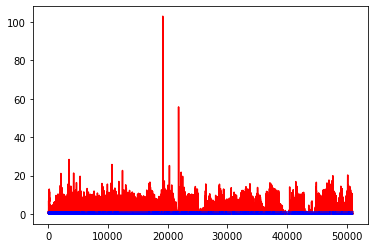

white ratio : 48.75
min : 180
max : 221


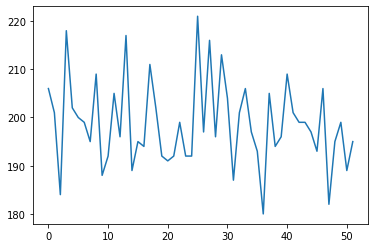

Generating interpolations...
51001 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.002414, 0.038349]
51002 [D loss: 0.009383, acc.: 100.00%] [G loss: 0.000004, 0.000005]
51003 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.017441, 0.004502]
51004 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.000864, 0.000146]
51005 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.146305, 0.012731]
51006 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.064046, 0.027649]
51007 [D loss: 0.013342, acc.: 100.00%] [G loss: 0.011475, 0.018596]
51008 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000253, 0.000000]
51009 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.151747, 0.293108]
51010 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.058402, 0.129718]
51011 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001597, 0.005250]
51012 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.053976, 0.039121]
51013 [D loss: 0.005167, acc.: 100.00%] [G loss: 0.138404, 0.070068]
51014 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.067269, 0.103828]
51015

51121 [D loss: 0.000859, acc.: 100.00%] [G loss: 0.000138, 0.017652]
51122 [D loss: 0.000538, acc.: 100.00%] [G loss: 0.001901, 0.002577]
51123 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.026739, 0.000429]
51124 [D loss: 0.000951, acc.: 100.00%] [G loss: 0.598824, 0.410496]
51125 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.027209, 0.010057]
51126 [D loss: 0.000874, acc.: 100.00%] [G loss: 0.000081, 0.000580]
51127 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.930760, 0.656881]
51128 [D loss: 0.000018, acc.: 100.00%] [G loss: 12.684619, 3.496938]
51129 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.127028, 3.429019]
51130 [D loss: 0.000565, acc.: 100.00%] [G loss: 2.761036, 2.487912]
51131 [D loss: 0.000014, acc.: 100.00%] [G loss: 3.027389, 2.607058]
51132 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.322734, 2.115397]
51133 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.473210, 0.682529]
51134 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.210187, 0.209238]
51135 [D loss: 0.000058, acc.: 10

51241 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.016493, 0.046659]
51242 [D loss: 0.000539, acc.: 100.00%] [G loss: 0.008830, 0.022456]
51243 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.023100, 0.002228]
51244 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.295102, 0.060787]
51245 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.002040, 0.000008]
51246 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.023381, 0.000224]
51247 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.001469, 0.004497]
51248 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.041689, 0.125834]
51249 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.018650, 0.002663]
51250 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.342145, 0.391704]
51251 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000120, 0.002693]
51252 [D loss: 0.000241, acc.: 100.00%] [G loss: 0.004660, 0.035182]
51253 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000393, 0.001885]
51254 [D loss: 0.000544, acc.: 100.00%] [G loss: 0.122442, 0.126559]
51255 [D loss: 0.003568, acc.: 100

51360 [D loss: 0.000368, acc.: 100.00%] [G loss: 0.000033, 0.000426]
51361 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.005453, 0.003891]
51362 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.736974, 0.351756]
51363 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.000018, 0.000000]
51364 [D loss: 0.203843, acc.: 96.88%] [G loss: 0.000000, 0.000000]
51365 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.000003, 0.000000]
51366 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.000000, 0.000000]
51367 [D loss: 0.012700, acc.: 100.00%] [G loss: 0.000000, 0.000000]
51368 [D loss: 0.007814, acc.: 100.00%] [G loss: 0.000000, 0.000000]
51369 [D loss: 0.020322, acc.: 100.00%] [G loss: 0.000084, 0.000828]
51370 [D loss: 0.003951, acc.: 100.00%] [G loss: 0.000001, 0.000039]
51371 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.007230, 0.000746]
51372 [D loss: 0.000521, acc.: 100.00%] [G loss: 0.005281, 0.001865]
51373 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.245698, 0.000001]
51374 [D loss: 0.000025, acc.: 100.

51480 [D loss: 0.001432, acc.: 100.00%] [G loss: 0.000000, 0.000000]
51481 [D loss: 0.048160, acc.: 96.88%] [G loss: 0.555638, 0.024007]
51482 [D loss: 0.004675, acc.: 100.00%] [G loss: 0.349450, 0.000009]
51483 [D loss: 0.002182, acc.: 100.00%] [G loss: 0.000004, 0.000000]
51484 [D loss: 0.064815, acc.: 96.88%] [G loss: 0.000005, 0.000014]
51485 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.078249, 0.197639]
51486 [D loss: 0.000919, acc.: 100.00%] [G loss: 0.004220, 0.002250]
51487 [D loss: 0.000671, acc.: 100.00%] [G loss: 4.785272, 4.681861]
51488 [D loss: 0.000176, acc.: 100.00%] [G loss: 2.892030, 0.546410]
51489 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.001786, 0.002545]
51490 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000128, 0.000092]
51491 [D loss: 0.004709, acc.: 100.00%] [G loss: 0.000098, 0.000250]
51492 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.000993, 0.000759]
51493 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.045180, 0.013025]
51494 [D loss: 0.000520, acc.: 100.0

51599 [D loss: 0.000466, acc.: 100.00%] [G loss: 0.003684, 0.063493]
51600 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.012438, 0.002589]
51601 [D loss: 0.003302, acc.: 100.00%] [G loss: 0.590636, 0.536426]
51602 [D loss: 0.004809, acc.: 100.00%] [G loss: 0.000006, 0.000000]
51603 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.198993, 0.315010]
51604 [D loss: 0.000526, acc.: 100.00%] [G loss: 0.007482, 0.000976]
51605 [D loss: 0.002916, acc.: 100.00%] [G loss: 0.000232, 0.000061]
51606 [D loss: 0.012379, acc.: 100.00%] [G loss: 0.000005, 0.000037]
51607 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.045604, 0.054977]
51608 [D loss: 0.004832, acc.: 100.00%] [G loss: 0.000003, 0.000006]
51609 [D loss: 0.003262, acc.: 100.00%] [G loss: 0.003228, 0.000107]
51610 [D loss: 0.000391, acc.: 100.00%] [G loss: 0.000007, 0.000017]
51611 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.001073, 0.000097]
51612 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000044, 0.000114]
51613 [D loss: 0.030471, acc.: 96.

51718 [D loss: 0.000968, acc.: 100.00%] [G loss: 0.004220, 0.000302]
51719 [D loss: 0.024222, acc.: 96.88%] [G loss: 0.047753, 0.045810]
51720 [D loss: 0.311856, acc.: 96.88%] [G loss: 0.000203, 0.000287]
51721 [D loss: 0.000797, acc.: 100.00%] [G loss: 0.000191, 0.000139]
51722 [D loss: 0.017616, acc.: 100.00%] [G loss: 0.000001, 0.000019]
51723 [D loss: 0.014141, acc.: 100.00%] [G loss: 0.000000, 0.000001]
51724 [D loss: 0.001536, acc.: 100.00%] [G loss: 15.985369, 0.000019]
51725 [D loss: 0.000424, acc.: 100.00%] [G loss: 2.176956, 2.406276]
51726 [D loss: 0.000768, acc.: 100.00%] [G loss: 1.027662, 0.813386]
51727 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.008806, 0.009483]
51728 [D loss: 0.003696, acc.: 100.00%] [G loss: 0.261798, 0.084857]
51729 [D loss: 0.002881, acc.: 100.00%] [G loss: 0.096362, 0.131815]
51730 [D loss: 0.007457, acc.: 100.00%] [G loss: 0.004324, 0.003847]
51731 [D loss: 0.006475, acc.: 100.00%] [G loss: 0.171275, 0.155599]
51732 [D loss: 0.002528, acc.: 100.

51840 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.093531, 0.000739]
51841 [D loss: 0.054043, acc.: 96.88%] [G loss: 0.000194, 0.000378]
51842 [D loss: 0.131281, acc.: 93.75%] [G loss: 0.270228, 0.115995]
51843 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.722522, 10.575577]
51844 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.038294, 8.975576]
51845 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.316352, 5.364735]
51846 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.186735, 1.303138]
51847 [D loss: 0.064313, acc.: 96.88%] [G loss: 0.000141, 0.000055]
51848 [D loss: 0.046202, acc.: 96.88%] [G loss: 0.032684, 0.059448]
51849 [D loss: 0.000242, acc.: 100.00%] [G loss: 8.787246, 6.506527]
51850 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.404761, 6.406169]
51851 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.157688, 5.539298]
51852 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.990219, 5.309175]
51853 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.397942, 1.835509]
51854 [D loss: 0.000014, acc.: 100.00

51959 [D loss: 0.000016, acc.: 100.00%] [G loss: 9.149665, 7.933550]
51960 [D loss: 0.040480, acc.: 96.88%] [G loss: 0.663893, 0.657749]
51961 [D loss: 0.000377, acc.: 100.00%] [G loss: 5.101017, 4.052452]
51962 [D loss: 0.000292, acc.: 100.00%] [G loss: 2.330523, 1.042491]
51963 [D loss: 0.010443, acc.: 100.00%] [G loss: 0.494788, 0.239347]
51964 [D loss: 0.077629, acc.: 96.88%] [G loss: 7.920795, 8.692265]
51965 [D loss: 0.000051, acc.: 100.00%] [G loss: 39.917213, 12.862711]
51966 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.022995, 16.221001]
51967 [D loss: 0.317608, acc.: 96.88%] [G loss: 14.190230, 13.794778]
51968 [D loss: 0.000029, acc.: 100.00%] [G loss: 14.327826, 12.639525]
51969 [D loss: 0.000783, acc.: 100.00%] [G loss: 14.215061, 13.336409]
51970 [D loss: 0.000031, acc.: 100.00%] [G loss: 11.516565, 9.691964]
51971 [D loss: 0.000158, acc.: 100.00%] [G loss: 12.096905, 13.106064]
51972 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.590204, 11.986971]
51973 [D loss: 0.00000

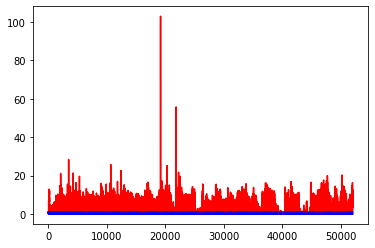

white ratio : 50.0
min : 180
max : 221


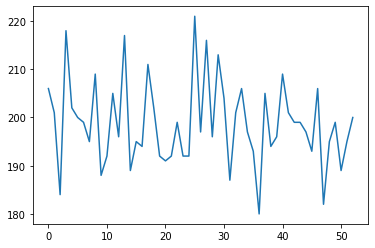

Generating interpolations...
52001 [D loss: 0.000535, acc.: 100.00%] [G loss: 11.609013, 10.360770]
52002 [D loss: 0.000201, acc.: 100.00%] [G loss: 1.537597, 0.629558]
52003 [D loss: 0.031357, acc.: 96.88%] [G loss: 7.655772, 7.460802]
52004 [D loss: 0.001490, acc.: 100.00%] [G loss: 0.109098, 0.100191]
52005 [D loss: 0.004383, acc.: 100.00%] [G loss: 1.539977, 0.818270]
52006 [D loss: 0.001663, acc.: 100.00%] [G loss: 0.969190, 0.649949]
52007 [D loss: 0.001069, acc.: 100.00%] [G loss: 1.912250, 1.612782]
52008 [D loss: 0.000597, acc.: 100.00%] [G loss: 3.892935, 3.205149]
52009 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.876228, 1.546968]
52010 [D loss: 0.006016, acc.: 100.00%] [G loss: 9.336582, 5.850893]
52011 [D loss: 0.000033, acc.: 100.00%] [G loss: 6.110023, 5.339801]
52012 [D loss: 0.000010, acc.: 100.00%] [G loss: 7.862476, 6.342671]
52013 [D loss: 0.001343, acc.: 100.00%] [G loss: 4.944186, 4.505483]
52014 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.052928, 0.055896]
5201

52122 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.860044, 7.329341]
52123 [D loss: 0.000037, acc.: 100.00%] [G loss: 6.750309, 4.975671]
52124 [D loss: 0.003451, acc.: 100.00%] [G loss: 7.522470, 5.872441]
52125 [D loss: 0.000488, acc.: 100.00%] [G loss: 15.567352, 5.442520]
52126 [D loss: 0.000060, acc.: 100.00%] [G loss: 3.978403, 3.304785]
52127 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.479686, 4.234358]
52128 [D loss: 0.000111, acc.: 100.00%] [G loss: 46.270111, 9.908843]
52129 [D loss: 0.002911, acc.: 100.00%] [G loss: 11.336193, 11.624226]
52130 [D loss: 0.000638, acc.: 100.00%] [G loss: 9.050134, 9.592730]
52131 [D loss: 0.005183, acc.: 100.00%] [G loss: 11.296497, 10.918885]
52132 [D loss: 0.003155, acc.: 100.00%] [G loss: 6.290477, 4.009288]
52133 [D loss: 0.000148, acc.: 100.00%] [G loss: 12.005230, 10.763378]
52134 [D loss: 0.000793, acc.: 100.00%] [G loss: 10.202413, 10.252115]
52135 [D loss: 0.000099, acc.: 100.00%] [G loss: 7.157768, 6.395473]
52136 [D loss: 0.000051,

52241 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.305503, 0.255944]
52242 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.336865, 0.335670]
52243 [D loss: 0.000164, acc.: 100.00%] [G loss: 1.560068, 1.658096]
52244 [D loss: 0.001904, acc.: 100.00%] [G loss: 1.162989, 1.046264]
52245 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.277048, 0.211791]
52246 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.022811, 0.015108]
52247 [D loss: 0.000280, acc.: 100.00%] [G loss: 0.175560, 0.487369]
52248 [D loss: 0.001880, acc.: 100.00%] [G loss: 0.000114, 0.000802]
52249 [D loss: 0.001345, acc.: 100.00%] [G loss: 0.586775, 0.457122]
52250 [D loss: 0.001812, acc.: 100.00%] [G loss: 0.237448, 0.482740]
52251 [D loss: 0.000750, acc.: 100.00%] [G loss: 0.022508, 0.000395]
52252 [D loss: 0.000765, acc.: 100.00%] [G loss: 1.876276, 0.909311]
52253 [D loss: 0.002027, acc.: 100.00%] [G loss: 0.140630, 0.060197]
52254 [D loss: 0.000178, acc.: 100.00%] [G loss: 1.852210, 1.138966]
52255 [D loss: 0.001410, acc.: 100

52360 [D loss: 0.001360, acc.: 100.00%] [G loss: 1.481872, 0.433007]
52361 [D loss: 0.000346, acc.: 100.00%] [G loss: 8.560625, 1.931114]
52362 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.384034, 0.248066]
52363 [D loss: 0.000175, acc.: 100.00%] [G loss: 4.121848, 3.534513]
52364 [D loss: 0.000111, acc.: 100.00%] [G loss: 6.855309, 6.272042]
52365 [D loss: 0.000027, acc.: 100.00%] [G loss: 3.039031, 3.339301]
52366 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.710491, 2.913445]
52367 [D loss: 0.000068, acc.: 100.00%] [G loss: 4.757660, 4.421805]
52368 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.021935, 1.632398]
52369 [D loss: 0.000034, acc.: 100.00%] [G loss: 1.319352, 1.238281]
52370 [D loss: 0.000640, acc.: 100.00%] [G loss: 6.177290, 5.004894]
52371 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.261322, 2.397722]
52372 [D loss: 0.000095, acc.: 100.00%] [G loss: 9.562494, 0.256713]
52373 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.169489, 1.359152]
52374 [D loss: 0.000014, acc.: 100

52480 [D loss: 0.000930, acc.: 100.00%] [G loss: 0.234639, 0.344092]
52481 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.523043, 0.214826]
52482 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.946658, 0.574302]
52483 [D loss: 0.000560, acc.: 100.00%] [G loss: 0.008328, 0.003893]
52484 [D loss: 0.000069, acc.: 100.00%] [G loss: 1.993638, 1.174943]
52485 [D loss: 0.003574, acc.: 100.00%] [G loss: 0.854063, 0.714184]
52486 [D loss: 0.000108, acc.: 100.00%] [G loss: 1.465937, 0.283571]
52487 [D loss: 0.000018, acc.: 100.00%] [G loss: 13.408260, 1.478958]
52488 [D loss: 0.001410, acc.: 100.00%] [G loss: 1.482419, 1.150319]
52489 [D loss: 0.000183, acc.: 100.00%] [G loss: 2.680651, 2.155864]
52490 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.001675, 0.185944]
52491 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.635855, 0.119726]
52492 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.512097, 0.369453]
52493 [D loss: 0.049758, acc.: 96.88%] [G loss: 1.550523, 1.214224]
52494 [D loss: 0.000013, acc.: 100

52600 [D loss: 0.000096, acc.: 100.00%] [G loss: 27.038818, 0.237062]
52601 [D loss: 0.001328, acc.: 100.00%] [G loss: 1.132610, 1.424521]
52602 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.183340, 0.402725]
52603 [D loss: 0.003553, acc.: 100.00%] [G loss: 1.997830, 2.557424]
52604 [D loss: 0.003031, acc.: 100.00%] [G loss: 0.428024, 0.826391]
52605 [D loss: 0.000781, acc.: 100.00%] [G loss: 0.426158, 0.427355]
52606 [D loss: 0.002166, acc.: 100.00%] [G loss: 1.986416, 1.685795]
52607 [D loss: 0.008261, acc.: 100.00%] [G loss: 1.531132, 1.210502]
52608 [D loss: 0.004050, acc.: 100.00%] [G loss: 4.533446, 3.298069]
52609 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.451318, 1.623439]
52610 [D loss: 0.002097, acc.: 100.00%] [G loss: 38.294895, 1.397639]
52611 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.864879, 0.628553]
52612 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.524988, 1.281684]
52613 [D loss: 0.000188, acc.: 100.00%] [G loss: 1.278244, 1.055779]
52614 [D loss: 0.000073, acc.: 1

52721 [D loss: 0.002034, acc.: 100.00%] [G loss: 4.118359, 1.320159]
52722 [D loss: 0.000593, acc.: 100.00%] [G loss: 0.538150, 1.195678]
52723 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.550224, 9.592414]
52724 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.894869, 7.486583]
52725 [D loss: 0.003953, acc.: 100.00%] [G loss: 4.772614, 4.884997]
52726 [D loss: 0.010509, acc.: 100.00%] [G loss: 8.488989, 8.106034]
52727 [D loss: 0.000238, acc.: 100.00%] [G loss: 15.349703, 8.730515]
52728 [D loss: 0.000124, acc.: 100.00%] [G loss: 10.204054, 10.349586]
52729 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.169192, 10.827519]
52730 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.316025, 11.810464]
52731 [D loss: 0.000163, acc.: 100.00%] [G loss: 7.199739, 6.447490]
52732 [D loss: 0.000015, acc.: 100.00%] [G loss: 8.292300, 8.188326]
52733 [D loss: 0.000127, acc.: 100.00%] [G loss: 4.115211, 1.795707]
52734 [D loss: 0.000351, acc.: 100.00%] [G loss: 5.249857, 3.149908]
52735 [D loss: 0.000001, ac

52840 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.879773, 0.764467]
52841 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.017540, 0.071283]
52842 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.021617, 0.022565]
52843 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.000480, 0.010705]
52844 [D loss: 0.009209, acc.: 100.00%] [G loss: 3.022227, 3.599353]
52845 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.071147, 1.015893]
52846 [D loss: 0.000227, acc.: 100.00%] [G loss: 4.199078, 2.625052]
52847 [D loss: 0.000199, acc.: 100.00%] [G loss: 0.332998, 0.460434]
52848 [D loss: 0.000006, acc.: 100.00%] [G loss: 16.667482, 0.002116]
52849 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.920268, 0.624901]
52850 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.345794, 4.593880]
52851 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.554258, 0.820751]
52852 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.725532, 1.845866]
52853 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.374190, 0.038149]
52854 [D loss: 0.000006, acc.: 10

52961 [D loss: 0.000005, acc.: 100.00%] [G loss: 35.073925, 2.546697]
52962 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.540039, 6.989639]
52963 [D loss: 0.000024, acc.: 100.00%] [G loss: 8.995919, 8.157902]
52964 [D loss: 0.000120, acc.: 100.00%] [G loss: 7.507918, 6.018101]
52965 [D loss: 0.000173, acc.: 100.00%] [G loss: 4.899895, 4.569967]
52966 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.312960, 3.736865]
52967 [D loss: 0.000050, acc.: 100.00%] [G loss: 3.402750, 3.998462]
52968 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.779889, 0.399508]
52969 [D loss: 0.000378, acc.: 100.00%] [G loss: 1.450465, 1.251284]
52970 [D loss: 0.000343, acc.: 100.00%] [G loss: 4.950856, 5.834153]
52971 [D loss: 0.000224, acc.: 100.00%] [G loss: 10.482609, 3.695335]
52972 [D loss: 0.000104, acc.: 100.00%] [G loss: 5.618020, 5.614343]
52973 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.630277, 2.554801]
52974 [D loss: 0.000007, acc.: 100.00%] [G loss: 6.997864, 6.822993]
52975 [D loss: 0.001599, acc.: 1

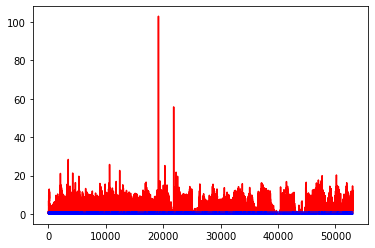

white ratio : 52.25
min : 180
max : 221


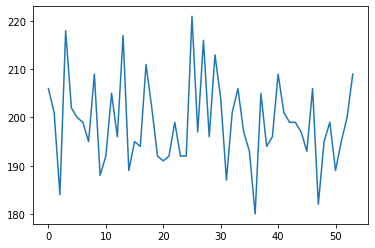

Generating interpolations...
53001 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.470936, 13.085961]
53002 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.180480, 11.968510]
53003 [D loss: 0.000007, acc.: 100.00%] [G loss: 12.222521, 12.853245]
53004 [D loss: 0.000011, acc.: 100.00%] [G loss: 10.262407, 7.714425]
53005 [D loss: 0.000032, acc.: 100.00%] [G loss: 11.700237, 12.091574]
53006 [D loss: 0.000032, acc.: 100.00%] [G loss: 11.128256, 11.242918]
53007 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.795615, 8.392710]
53008 [D loss: 0.000049, acc.: 100.00%] [G loss: 11.133546, 10.320322]
53009 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.256261, 3.980932]
53010 [D loss: 0.001963, acc.: 100.00%] [G loss: 10.109636, 11.180035]
53011 [D loss: 0.000089, acc.: 100.00%] [G loss: 21.025833, 9.586741]
53012 [D loss: 0.003785, acc.: 100.00%] [G loss: 9.173900, 8.939823]
53013 [D loss: 0.000187, acc.: 100.00%] [G loss: 11.399035, 12.557176]
53014 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.81683

53121 [D loss: 0.000026, acc.: 100.00%] [G loss: 2.625903, 3.113540]
53122 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.479360, 0.776002]
53123 [D loss: 0.000055, acc.: 100.00%] [G loss: 3.959342, 2.754889]
53124 [D loss: 0.000046, acc.: 100.00%] [G loss: 30.299587, 2.147147]
53125 [D loss: 0.000161, acc.: 100.00%] [G loss: 1.574062, 1.939977]
53126 [D loss: 0.000061, acc.: 100.00%] [G loss: 4.789345, 5.401739]
53127 [D loss: 0.000011, acc.: 100.00%] [G loss: 3.055204, 3.341856]
53128 [D loss: 0.000096, acc.: 100.00%] [G loss: 1.921875, 3.372814]
53129 [D loss: 0.000092, acc.: 100.00%] [G loss: 2.756943, 1.805810]
53130 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.640276, 1.005321]
53131 [D loss: 0.001914, acc.: 100.00%] [G loss: 19.108776, 0.748346]
53132 [D loss: 0.000018, acc.: 100.00%] [G loss: 5.421562, 6.085423]
53133 [D loss: 0.000215, acc.: 100.00%] [G loss: 5.930904, 3.261874]
53134 [D loss: 0.000714, acc.: 100.00%] [G loss: 2.048333, 2.093625]
53135 [D loss: 0.005467, acc.: 1

53242 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.870756, 2.139552]
53243 [D loss: 0.000496, acc.: 100.00%] [G loss: 7.565906, 4.977649]
53244 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.888111, 1.394449]
53245 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.877962, 0.346286]
53246 [D loss: 0.000173, acc.: 100.00%] [G loss: 1.057063, 0.977525]
53247 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.346583, 3.332073]
53248 [D loss: 0.000010, acc.: 100.00%] [G loss: 4.468524, 3.839005]
53249 [D loss: 0.000058, acc.: 100.00%] [G loss: 1.505743, 1.173965]
53250 [D loss: 0.000357, acc.: 100.00%] [G loss: 4.593246, 3.984984]
53251 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.554172, 6.285707]
53252 [D loss: 0.000158, acc.: 100.00%] [G loss: 3.874228, 3.933977]
53253 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.856077, 0.831718]
53254 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.350129, 6.320381]
53255 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.659063, 0.439826]
53256 [D loss: 0.013371, acc.: 100

53363 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.607295, 0.342779]
53364 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.017132, 0.032746]
53365 [D loss: 0.000036, acc.: 100.00%] [G loss: 1.012355, 1.251025]
53366 [D loss: 0.000047, acc.: 100.00%] [G loss: 2.268804, 0.770229]
53367 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.947554, 1.133926]
53368 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.689992, 1.306326]
53369 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.216782, 0.624522]
53370 [D loss: 0.000932, acc.: 100.00%] [G loss: 0.498634, 0.376281]
53371 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.510500, 2.492391]
53372 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.330847, 0.233878]
53373 [D loss: 0.000334, acc.: 100.00%] [G loss: 3.097705, 2.015809]
53374 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.834939, 0.826884]
53375 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.345593, 3.745942]
53376 [D loss: 0.000691, acc.: 100.00%] [G loss: 3.713377, 1.739153]
53377 [D loss: 0.000126, acc.: 100

53482 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.353651, 2.531389]
53483 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.827259, 6.996636]
53484 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.047748, 1.565301]
53485 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.187947, 0.084726]
53486 [D loss: 0.000062, acc.: 100.00%] [G loss: 2.388117, 2.474550]
53487 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.888509, 1.047480]
53488 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.791221, 1.898232]
53489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.192660, 0.400412]
53490 [D loss: 0.000155, acc.: 100.00%] [G loss: 21.964764, 6.478272]
53491 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.061445, 5.249779]
53492 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.900485, 3.997828]
53493 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.036044, 6.536205]
53494 [D loss: 0.000061, acc.: 100.00%] [G loss: 13.732306, 6.172208]
53495 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.497066, 3.050610]
53496 [D loss: 0.000020, acc.: 1

53602 [D loss: 0.000198, acc.: 100.00%] [G loss: 1.315871, 1.101100]
53603 [D loss: 0.000255, acc.: 100.00%] [G loss: 2.187194, 0.330530]
53604 [D loss: 0.000151, acc.: 100.00%] [G loss: 3.358580, 3.591364]
53605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.952640, 0.086066]
53606 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.808424, 1.876884]
53607 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.228424, 0.011599]
53608 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.977568, 1.290190]
53609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.301890, 1.201175]
53610 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.192410, 0.173344]
53611 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001870, 0.155564]
53612 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.629421, 0.136210]
53613 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.337664, 1.972566]
53614 [D loss: 0.000544, acc.: 100.00%] [G loss: 1.103761, 0.979630]
53615 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.240445, 0.011774]
53616 [D loss: 0.000000, acc.: 100

53721 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.212905, 4.004124]
53722 [D loss: 0.013774, acc.: 100.00%] [G loss: 0.008897, 0.000725]
53723 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.533988, 0.284732]
53724 [D loss: 0.001382, acc.: 100.00%] [G loss: 0.681645, 0.818005]
53725 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.121817, 0.214215]
53726 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.907969, 0.916663]
53727 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.758681, 0.574440]
53728 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.039329, 0.084020]
53729 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.693305, 0.142333]
53730 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.082027, 0.228994]
53731 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.426643, 0.438717]
53732 [D loss: 0.002987, acc.: 100.00%] [G loss: 0.948242, 0.586922]
53733 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.042145, 0.191761]
53734 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.519020, 0.717333]
53735 [D loss: 0.006181, acc.: 100

53842 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.094276, 9.460619]
53843 [D loss: 0.000041, acc.: 100.00%] [G loss: 13.255381, 11.740041]
53844 [D loss: 0.000093, acc.: 100.00%] [G loss: 12.843963, 11.445875]
53845 [D loss: 0.000089, acc.: 100.00%] [G loss: 6.849447, 13.252406]
53846 [D loss: 0.000747, acc.: 100.00%] [G loss: 8.531879, 8.836973]
53847 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.695988, 14.874352]
53848 [D loss: 0.000024, acc.: 100.00%] [G loss: 7.436214, 8.909092]
53849 [D loss: 0.000011, acc.: 100.00%] [G loss: 13.667862, 11.406025]
53850 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.458118, 4.231701]
53851 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.967928, 9.016045]
53852 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.112940, 4.871617]
53853 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.807619, 9.922930]
53854 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.711034, 8.880267]
53855 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.707257, 11.319777]
53856 [D loss: 0.0422

53962 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.051953, 1.169404]
53963 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.397086, 0.433297]
53964 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.690836, 0.817136]
53965 [D loss: 0.015370, acc.: 100.00%] [G loss: 4.618667, 1.124968]
53966 [D loss: 0.000034, acc.: 100.00%] [G loss: 7.547551, 7.390738]
53967 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.196606, 8.939384]
53968 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.384363, 2.324117]
53969 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.852607, 8.215255]
53970 [D loss: 0.000032, acc.: 100.00%] [G loss: 15.331202, 12.342996]
53971 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.276420, 2.955294]
53972 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.687439, 0.665986]
53973 [D loss: 0.025610, acc.: 96.88%] [G loss: 22.128746, 5.957469]
53974 [D loss: 0.000307, acc.: 100.00%] [G loss: 0.009503, 0.257700]
53975 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.620942, 0.189865]
53976 [D loss: 0.000669, acc.: 1

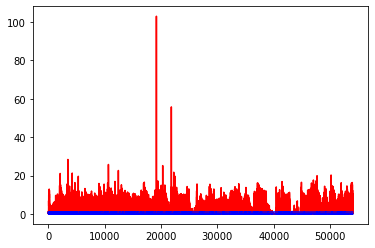

white ratio : 52.0
min : 180
max : 221


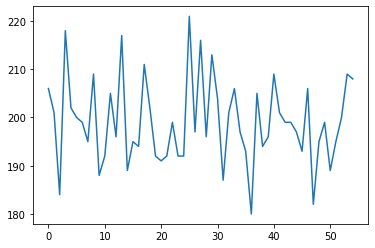

Generating interpolations...
54001 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.035252, 0.254917]
54002 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.042943, 0.036381]
54003 [D loss: 0.000988, acc.: 100.00%] [G loss: 8.791941, 0.181714]
54004 [D loss: 0.000031, acc.: 100.00%] [G loss: 7.318852, 6.375359]
54005 [D loss: 0.000030, acc.: 100.00%] [G loss: 9.219543, 6.871808]
54006 [D loss: 0.000037, acc.: 100.00%] [G loss: 7.389667, 3.643188]
54007 [D loss: 0.000056, acc.: 100.00%] [G loss: 22.671688, 6.196582]
54008 [D loss: 0.000022, acc.: 100.00%] [G loss: 6.736277, 7.304125]
54009 [D loss: 0.000060, acc.: 100.00%] [G loss: 1.847409, 1.217565]
54010 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.999314, 6.089164]
54011 [D loss: 0.000050, acc.: 100.00%] [G loss: 3.433083, 3.311326]
54012 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.764493, 1.715616]
54013 [D loss: 0.000204, acc.: 100.00%] [G loss: 5.293934, 1.815143]
54014 [D loss: 0.000866, acc.: 100.00%] [G loss: 22.319878, 9.983631]
540

54121 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.916286, 3.839056]
54122 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.194584, 3.765225]
54123 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.681582, 2.028880]
54124 [D loss: 0.000040, acc.: 100.00%] [G loss: 2.550857, 2.846574]
54125 [D loss: 0.000080, acc.: 100.00%] [G loss: 17.510256, 4.081782]
54126 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.944058, 1.549788]
54127 [D loss: 0.000027, acc.: 100.00%] [G loss: 10.276429, 10.513552]
54128 [D loss: 0.000208, acc.: 100.00%] [G loss: 4.810560, 4.578942]
54129 [D loss: 0.000053, acc.: 100.00%] [G loss: 3.121864, 1.816541]
54130 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.444164, 0.278686]
54131 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.654611, 0.677703]
54132 [D loss: 0.000089, acc.: 100.00%] [G loss: 7.865566, 1.274152]
54133 [D loss: 0.000043, acc.: 100.00%] [G loss: 10.633990, 4.678398]
54134 [D loss: 0.000009, acc.: 100.00%] [G loss: 5.453393, 4.719130]
54135 [D loss: 0.000046, acc.:

54242 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.927833, 0.858113]
54243 [D loss: 0.000123, acc.: 100.00%] [G loss: 4.354150, 3.552894]
54244 [D loss: 0.000014, acc.: 100.00%] [G loss: 23.529453, 2.012412]
54245 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.976691, 3.360550]
54246 [D loss: 0.000113, acc.: 100.00%] [G loss: 3.496655, 3.384146]
54247 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.501501, 1.864402]
54248 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.230393, 7.714192]
54249 [D loss: 0.000176, acc.: 100.00%] [G loss: 4.114039, 4.303836]
54250 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.157646, 2.003224]
54251 [D loss: 0.000001, acc.: 100.00%] [G loss: 17.581196, 8.278153]
54252 [D loss: 0.000077, acc.: 100.00%] [G loss: 5.148585, 3.903487]
54253 [D loss: 0.004832, acc.: 100.00%] [G loss: 3.438430, 2.373295]
54254 [D loss: 0.000045, acc.: 100.00%] [G loss: 2.382546, 1.187350]
54255 [D loss: 0.000003, acc.: 100.00%] [G loss: 40.925583, 4.759048]
54256 [D loss: 0.000001, acc.: 

54364 [D loss: 0.000040, acc.: 100.00%] [G loss: 4.379380, 1.562811]
54365 [D loss: 0.000064, acc.: 100.00%] [G loss: 1.645895, 1.173711]
54366 [D loss: 0.000056, acc.: 100.00%] [G loss: 13.781481, 3.199514]
54367 [D loss: 0.001831, acc.: 100.00%] [G loss: 0.969903, 1.099174]
54368 [D loss: 0.000036, acc.: 100.00%] [G loss: 5.351888, 5.912747]
54369 [D loss: 0.000040, acc.: 100.00%] [G loss: 6.815185, 7.632623]
54370 [D loss: 0.000106, acc.: 100.00%] [G loss: 4.875763, 4.163146]
54371 [D loss: 0.000456, acc.: 100.00%] [G loss: 4.779951, 2.593019]
54372 [D loss: 0.002874, acc.: 100.00%] [G loss: 6.544541, 5.752515]
54373 [D loss: 0.000339, acc.: 100.00%] [G loss: 7.371227, 6.535207]
54374 [D loss: 0.000885, acc.: 100.00%] [G loss: 2.664391, 2.093714]
54375 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.796135, 0.661156]
54376 [D loss: 0.002015, acc.: 100.00%] [G loss: 6.892506, 6.088255]
54377 [D loss: 0.000160, acc.: 100.00%] [G loss: 5.219072, 3.029510]
54378 [D loss: 0.000417, acc.: 10

54484 [D loss: 0.000109, acc.: 100.00%] [G loss: 12.972761, 12.793207]
54485 [D loss: 0.000037, acc.: 100.00%] [G loss: 6.404692, 5.386288]
54486 [D loss: 0.000043, acc.: 100.00%] [G loss: 4.143263, 4.263159]
54487 [D loss: 0.200005, acc.: 96.88%] [G loss: 1.298526, 0.794312]
54488 [D loss: 0.004854, acc.: 100.00%] [G loss: 5.185879, 4.112910]
54489 [D loss: 0.000653, acc.: 100.00%] [G loss: 1.013755, 0.129356]
54490 [D loss: 0.000096, acc.: 100.00%] [G loss: 20.668467, 0.344578]
54491 [D loss: 0.006309, acc.: 100.00%] [G loss: 1.647225, 1.698737]
54492 [D loss: 0.000085, acc.: 100.00%] [G loss: 6.194324, 6.245353]
54493 [D loss: 0.000296, acc.: 100.00%] [G loss: 1.094204, 1.466408]
54494 [D loss: 0.002621, acc.: 100.00%] [G loss: 2.836153, 4.559292]
54495 [D loss: 0.000944, acc.: 100.00%] [G loss: 2.306391, 2.460182]
54496 [D loss: 0.000700, acc.: 100.00%] [G loss: 4.921995, 5.767363]
54497 [D loss: 0.003879, acc.: 100.00%] [G loss: 8.267622, 1.317689]
54498 [D loss: 0.000299, acc.: 1

54604 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.618329, 0.400933]
54605 [D loss: 0.001185, acc.: 100.00%] [G loss: 18.671028, 0.323530]
54606 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.293687, 1.067162]
54607 [D loss: 0.000022, acc.: 100.00%] [G loss: 4.721264, 4.830548]
54608 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.978490, 4.539964]
54609 [D loss: 0.000089, acc.: 100.00%] [G loss: 5.608129, 4.612870]
54610 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.441778, 1.048304]
54611 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.890382, 1.354219]
54612 [D loss: 0.000030, acc.: 100.00%] [G loss: 7.028132, 3.806275]
54613 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.479761, 1.827421]
54614 [D loss: 0.000060, acc.: 100.00%] [G loss: 1.365152, 1.141672]
54615 [D loss: 0.000029, acc.: 100.00%] [G loss: 6.142718, 2.287699]
54616 [D loss: 0.000030, acc.: 100.00%] [G loss: 4.738020, 4.192944]
54617 [D loss: 0.000200, acc.: 100.00%] [G loss: 27.200859, 4.516092]
54618 [D loss: 0.000053, acc.: 1

54724 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.803164, 1.204667]
54725 [D loss: 0.000119, acc.: 100.00%] [G loss: 1.415753, 1.490813]
54726 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.004852, 0.205262]
54727 [D loss: 0.000008, acc.: 100.00%] [G loss: 20.796669, 2.672137]
54728 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.684028, 4.577351]
54729 [D loss: 0.000019, acc.: 100.00%] [G loss: 7.328105, 5.764318]
54730 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.659287, 1.372694]
54731 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.533639, 3.380376]
54732 [D loss: 0.000427, acc.: 100.00%] [G loss: 1.167913, 0.720853]
54733 [D loss: 0.000048, acc.: 100.00%] [G loss: 3.357064, 3.847288]
54734 [D loss: 0.000030, acc.: 100.00%] [G loss: 2.125529, 1.056087]
54735 [D loss: 0.000032, acc.: 100.00%] [G loss: 9.880816, 3.279955]
54736 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.220390, 10.612457]
54737 [D loss: 0.000018, acc.: 100.00%] [G loss: 7.282898, 7.333364]
54738 [D loss: 0.000014, acc.: 1

54843 [D loss: 0.000096, acc.: 100.00%] [G loss: 1.320264, 0.408712]
54844 [D loss: 0.000312, acc.: 100.00%] [G loss: 4.791945, 4.851506]
54845 [D loss: 0.000113, acc.: 100.00%] [G loss: 2.587889, 1.647892]
54846 [D loss: 0.000130, acc.: 100.00%] [G loss: 6.065143, 6.506960]
54847 [D loss: 0.000090, acc.: 100.00%] [G loss: 9.802019, 9.302534]
54848 [D loss: 0.000053, acc.: 100.00%] [G loss: 2.743246, 2.471168]
54849 [D loss: 0.000054, acc.: 100.00%] [G loss: 6.748383, 5.082442]
54850 [D loss: 0.000029, acc.: 100.00%] [G loss: 1.833852, 1.708812]
54851 [D loss: 0.000135, acc.: 100.00%] [G loss: 1.049650, 1.503214]
54852 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.513071, 9.765779]
54853 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.154069, 4.734589]
54854 [D loss: 0.000012, acc.: 100.00%] [G loss: 8.733616, 7.052898]
54855 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.958792, 0.813040]
54856 [D loss: 0.000089, acc.: 100.00%] [G loss: 6.811741, 5.267678]
54857 [D loss: 0.000522, acc.: 100

54963 [D loss: 0.005024, acc.: 100.00%] [G loss: 15.173553, 3.971747]
54964 [D loss: 0.001399, acc.: 100.00%] [G loss: 6.817230, 7.331361]
54965 [D loss: 0.005881, acc.: 100.00%] [G loss: 3.448502, 3.568834]
54966 [D loss: 0.001389, acc.: 100.00%] [G loss: 3.531459, 6.527640]
54967 [D loss: 0.000197, acc.: 100.00%] [G loss: 6.266754, 7.534652]
54968 [D loss: 0.000151, acc.: 100.00%] [G loss: 11.604734, 11.464621]
54969 [D loss: 0.000085, acc.: 100.00%] [G loss: 7.396257, 5.756791]
54970 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.495120, 6.521344]
54971 [D loss: 0.000019, acc.: 100.00%] [G loss: 10.400309, 8.996567]
54972 [D loss: 0.000031, acc.: 100.00%] [G loss: 16.096588, 15.585418]
54973 [D loss: 0.002029, acc.: 100.00%] [G loss: 11.519008, 11.982161]
54974 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.768744, 8.058132]
54975 [D loss: 0.000021, acc.: 100.00%] [G loss: 11.782616, 11.394387]
54976 [D loss: 0.000020, acc.: 100.00%] [G loss: 12.525216, 10.551191]
54977 [D loss: 0.00002

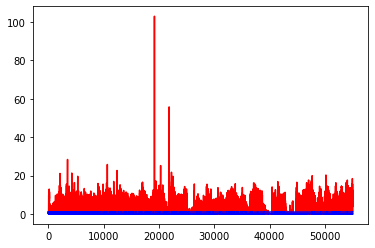

white ratio : 48.0
min : 180
max : 221


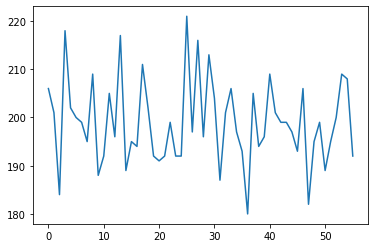

Generating interpolations...
55001 [D loss: 0.000004, acc.: 100.00%] [G loss: 10.813706, 10.960068]
55002 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.482906, 8.474203]
55003 [D loss: 0.000031, acc.: 100.00%] [G loss: 10.263288, 9.395720]
55004 [D loss: 0.000014, acc.: 100.00%] [G loss: 10.051512, 7.918002]
55005 [D loss: 0.000047, acc.: 100.00%] [G loss: 10.700459, 11.268721]
55006 [D loss: 0.000010, acc.: 100.00%] [G loss: 7.835207, 6.401727]
55007 [D loss: 0.000002, acc.: 100.00%] [G loss: 25.726383, 9.215900]
55008 [D loss: 0.000024, acc.: 100.00%] [G loss: 10.354780, 12.163944]
55009 [D loss: 0.000074, acc.: 100.00%] [G loss: 12.062349, 11.375879]
55010 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.172259, 7.006166]
55011 [D loss: 0.000541, acc.: 100.00%] [G loss: 9.562838, 9.608544]
55012 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.809294, 8.538007]
55013 [D loss: 0.000004, acc.: 100.00%] [G loss: 10.806710, 6.896866]
55014 [D loss: 0.004401, acc.: 100.00%] [G loss: 8.459299, 7.

55119 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.418681, 0.102259]
55120 [D loss: 0.000527, acc.: 100.00%] [G loss: 0.029021, 0.092888]
55121 [D loss: 0.000648, acc.: 100.00%] [G loss: 0.192815, 0.005291]
55122 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.119199, 0.050573]
55123 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.029936, 0.173328]
55124 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000304, 0.004291]
55125 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.008268, 0.014426]
55126 [D loss: 0.001136, acc.: 100.00%] [G loss: 0.103015, 0.000195]
55127 [D loss: 0.000486, acc.: 100.00%] [G loss: 0.009009, 0.001067]
55128 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000582, 0.003531]
55129 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.005741, 0.008665]
55130 [D loss: 0.000498, acc.: 100.00%] [G loss: 0.086297, 0.014073]
55131 [D loss: 0.000085, acc.: 100.00%] [G loss: 4.649921, 0.001158]
55132 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.233975, 0.090088]
55133 [D loss: 0.000077, acc.: 100

55239 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.045904, 0.027320]
55240 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.311566, 0.129745]
55241 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.174282, 0.349244]
55242 [D loss: 0.000087, acc.: 100.00%] [G loss: 3.892076, 1.067342]
55243 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.310542, 1.048318]
55244 [D loss: 0.000150, acc.: 100.00%] [G loss: 2.292295, 1.401129]
55245 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.475325, 0.694166]
55246 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.396865, 1.956250]
55247 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.265234, 0.221905]
55248 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.135052, 0.416304]
55249 [D loss: 0.000317, acc.: 100.00%] [G loss: 0.392606, 0.512715]
55250 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.704419, 0.501096]
55251 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.307591, 1.052324]
55252 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.005958, 0.701908]
55253 [D loss: 0.000032, acc.: 100

55360 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.148183, 0.075253]
55361 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.043950, 0.061220]
55362 [D loss: 0.000704, acc.: 100.00%] [G loss: 0.375667, 0.067040]
55363 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.001672, 0.010692]
55364 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.005424, 0.063568]
55365 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.061724, 0.057198]
55366 [D loss: 0.004214, acc.: 100.00%] [G loss: 0.281986, 0.005468]
55367 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.005299, 0.006730]
55368 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.001777, 0.035633]
55369 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.054575, 0.069745]
55370 [D loss: 0.000378, acc.: 100.00%] [G loss: 0.000652, 0.005231]
55371 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.016714, 0.055013]
55372 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.022300, 0.060592]
55373 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001780, 0.001620]
55374 [D loss: 0.000038, acc.: 100

55481 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.636850, 1.033684]
55482 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.988170, 0.577906]
55483 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.110639, 1.083252]
55484 [D loss: 0.086540, acc.: 96.88%] [G loss: 0.017939, 0.055055]
55485 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.073634, 0.004219]
55486 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000332, 0.011487]
55487 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.001741, 0.007706]
55488 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.000024, 0.028478]
55489 [D loss: 0.001266, acc.: 100.00%] [G loss: 1.950425, 0.000195]
55490 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.214150, 0.121497]
55491 [D loss: 0.044891, acc.: 96.88%] [G loss: 0.486363, 0.437998]
55492 [D loss: 0.000107, acc.: 100.00%] [G loss: 1.510964, 1.250540]
55493 [D loss: 0.002017, acc.: 100.00%] [G loss: 0.849655, 0.610106]
55494 [D loss: 0.004922, acc.: 100.00%] [G loss: 0.489661, 0.550654]
55495 [D loss: 0.087840, acc.: 96.88

55602 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000501, 0.000004]
55603 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.001684, 0.001725]
55604 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.001044, 0.000435]
55605 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000027, 0.000051]
55606 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000322, 0.095779]
55607 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000059, 0.000373]
55608 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000868, 0.001982]
55609 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000623, 0.040234]
55610 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000465, 0.000135]
55611 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000084, 0.001323]
55612 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.004404, 0.000845]
55613 [D loss: 0.000460, acc.: 100.00%] [G loss: 0.001369, 0.000164]
55614 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.001633, 0.000652]
55615 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000041, 0.000009]
55616 [D loss: 0.000007, acc.: 100

55722 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.005436, 0.031018]
55723 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.024383, 0.032526]
55724 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.032291, 0.000525]
55725 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.078609, 0.013701]
55726 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.007694, 0.095947]
55727 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.144586, 0.036684]
55728 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001537, 0.015106]
55729 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000371, 0.000579]
55730 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000500, 0.000201]
55731 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.139208, 0.080354]
55732 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.115218, 0.036655]
55733 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.012002, 0.008874]
55734 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.002519, 0.005830]
55735 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.187158, 0.260493]
55736 [D loss: 0.000023, acc.: 100

55841 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.282304, 0.010722]
55842 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.015768, 0.002186]
55843 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.069619, 0.026133]
55844 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.061827, 0.047717]
55845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.948941, 0.350726]
55846 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.026782, 0.067694]
55847 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.118213, 0.003305]
55848 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.026022, 0.005061]
55849 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.039510, 0.010259]
55850 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001397, 0.000280]
55851 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000571, 0.022167]
55852 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.006667, 0.001703]
55853 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.018120, 0.104671]
55854 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021560, 0.108593]
55855 [D loss: 0.000033, acc.: 100

55962 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.563966, 0.524611]
55963 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.364780, 0.146911]
55964 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.190280, 0.386325]
55965 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.315604, 0.002228]
55966 [D loss: 0.009931, acc.: 100.00%] [G loss: 0.029401, 0.122026]
55967 [D loss: 0.000388, acc.: 100.00%] [G loss: 0.116847, 0.078768]
55968 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.155595, 0.014999]
55969 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.092243, 0.411511]
55970 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.011199, 0.005303]
55971 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.034942, 0.004994]
55972 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.627546, 0.338605]
55973 [D loss: 0.000386, acc.: 100.00%] [G loss: 0.357432, 0.034238]
55974 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.342569, 0.258387]
55975 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.003934, 0.018412]
55976 [D loss: 0.000964, acc.: 100

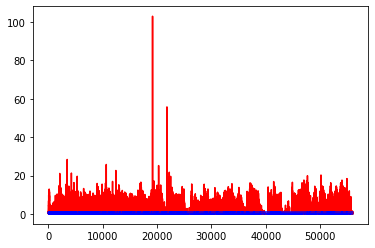

white ratio : 47.5
min : 180
max : 221


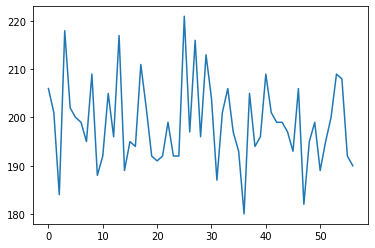

Generating interpolations...
56001 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.024228, 0.013023]
56002 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.035317, 0.241180]
56003 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.299581, 0.121525]
56004 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.130627, 0.061845]
56005 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.000287, 0.014515]
56006 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.111087, 0.001539]
56007 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.005800, 0.027726]
56008 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.015160, 0.425558]
56009 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.005021, 0.021467]
56010 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000633, 0.000328]
56011 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000168, 0.000626]
56012 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.254949, 0.022570]
56013 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.003664, 0.000493]
56014 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.331884, 0.006972]
56015

56122 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.363327, 0.351707]
56123 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.720068, 0.425562]
56124 [D loss: 0.001680, acc.: 100.00%] [G loss: 1.776223, 0.334143]
56125 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.849136, 1.967625]
56126 [D loss: 0.000121, acc.: 100.00%] [G loss: 2.371299, 1.385144]
56127 [D loss: 0.000032, acc.: 100.00%] [G loss: 2.761298, 1.247825]
56128 [D loss: 0.005388, acc.: 100.00%] [G loss: 3.566597, 2.493396]
56129 [D loss: 0.001872, acc.: 100.00%] [G loss: 49.565575, 3.731774]
56130 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.730906, 10.278639]
56131 [D loss: 0.000871, acc.: 100.00%] [G loss: 7.463487, 5.524939]
56132 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.016458, 3.528633]
56133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.900248, 0.489906]
56134 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.048531, 1.260852]
56135 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.315824, 0.377655]
56136 [D loss: 0.000000, acc.: 1

56242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003550, 0.007571]
56243 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.013255, 0.039791]
56244 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.024580, 0.000097]
56245 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.162659, 0.024295]
56246 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.002924, 0.002556]
56247 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.002184, 0.023595]
56248 [D loss: 0.001158, acc.: 100.00%] [G loss: 0.000014, 0.047893]
56249 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.002604, 0.001644]
56250 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.003385, 0.035020]
56251 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.001133, 0.000071]
56252 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000091, 0.000308]
56253 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002396, 0.004091]
56254 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.896322, 0.002592]
56255 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001558, 0.243206]
56256 [D loss: 0.000010, acc.: 100

56364 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.044322, 0.031675]
56365 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.006372, 0.007734]
56366 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.500227, 0.813211]
56367 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.008011, 0.269300]
56368 [D loss: 0.000686, acc.: 100.00%] [G loss: 0.099661, 0.065194]
56369 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.152569, 0.111754]
56370 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.143115, 0.006859]
56371 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.185266, 0.086319]
56372 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.111270, 0.196517]
56373 [D loss: 0.000019, acc.: 100.00%] [G loss: 2.378739, 0.046073]
56374 [D loss: 0.000270, acc.: 100.00%] [G loss: 0.007892, 0.163237]
56375 [D loss: 0.000409, acc.: 100.00%] [G loss: 0.075509, 0.278548]
56376 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.790516, 0.472331]
56377 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.758310, 2.465394]
56378 [D loss: 0.000161, acc.: 100

56486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.990331, 0.926577]
56487 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.500967, 2.329091]
56488 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.174308, 3.320114]
56489 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.083970, 6.208384]
56490 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.472629, 2.868647]
56491 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.928726, 1.111524]
56492 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.275077, 1.050449]
56493 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.555337, 0.987887]
56494 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.175836, 0.574320]
56495 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.287215, 0.576282]
56496 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.721484, 0.207389]
56497 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.023520, 0.010621]
56498 [D loss: 0.000000, acc.: 100.00%] [G loss: 61.486000, 4.330167]
56499 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.015542, 0.041762]
56500 [D loss: 0.000001, acc.: 10

56607 [D loss: 0.006551, acc.: 100.00%] [G loss: 1.869898, 1.951227]
56608 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000740, 0.000100]
56609 [D loss: 0.001150, acc.: 100.00%] [G loss: 0.071603, 0.004003]
56610 [D loss: 0.000551, acc.: 100.00%] [G loss: 0.825394, 0.579112]
56611 [D loss: 0.000409, acc.: 100.00%] [G loss: 0.741251, 0.705729]
56612 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.291167, 0.595612]
56613 [D loss: 0.002427, acc.: 100.00%] [G loss: 0.886800, 0.094015]
56614 [D loss: 0.006397, acc.: 100.00%] [G loss: 0.003883, 0.003837]
56615 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.001234, 0.003543]
56616 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.104897, 0.083658]
56617 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000018, 0.000008]
56618 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.067455, 0.001730]
56619 [D loss: 0.000245, acc.: 100.00%] [G loss: 1.957139, 3.451843]
56620 [D loss: 0.000818, acc.: 100.00%] [G loss: 0.781745, 0.490242]
56621 [D loss: 0.000025, acc.: 100

56726 [D loss: 0.000432, acc.: 100.00%] [G loss: 0.000100, 0.002358]
56727 [D loss: 0.000285, acc.: 100.00%] [G loss: 0.000037, 0.000001]
56728 [D loss: 0.000210, acc.: 100.00%] [G loss: 0.000000, 0.000000]
56729 [D loss: 0.003017, acc.: 100.00%] [G loss: 0.000022, 0.000006]
56730 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000003, 0.000201]
56731 [D loss: 0.001330, acc.: 100.00%] [G loss: 0.000042, 0.008059]
56732 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000001, 0.000000]
56733 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.001328, 0.000032]
56734 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.047942, 0.243320]
56735 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.021899, 0.026084]
56736 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000030, 0.000146]
56737 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.082666, 0.092543]
56738 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000035, 0.000006]
56739 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.005013, 0.000099]
56740 [D loss: 0.000113, acc.: 100

56846 [D loss: 0.000384, acc.: 100.00%] [G loss: 0.000005, 0.000048]
56847 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.000041, 0.001708]
56848 [D loss: 0.001324, acc.: 100.00%] [G loss: 0.000181, 0.000080]
56849 [D loss: 0.071599, acc.: 96.88%] [G loss: 0.030218, 0.010417]
56850 [D loss: 0.001117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
56851 [D loss: 0.001378, acc.: 100.00%] [G loss: 0.000000, 0.000009]
56852 [D loss: 0.000604, acc.: 100.00%] [G loss: 0.000004, 0.000112]
56853 [D loss: 0.000533, acc.: 100.00%] [G loss: 0.000005, 0.000006]
56854 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.000709, 0.000179]
56855 [D loss: 0.000763, acc.: 100.00%] [G loss: 0.000002, 0.000003]
56856 [D loss: 0.001198, acc.: 100.00%] [G loss: 0.000001, 0.000005]
56857 [D loss: 0.001746, acc.: 100.00%] [G loss: 0.000016, 0.004166]
56858 [D loss: 0.000436, acc.: 100.00%] [G loss: 0.000076, 0.000012]
56859 [D loss: 0.003976, acc.: 100.00%] [G loss: 0.000003, 0.000082]
56860 [D loss: 0.000172, acc.: 100.

56967 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.000023, 0.007054]
56968 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000833, 0.002515]
56969 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000599, 0.000187]
56970 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.025988, 0.003383]
56971 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000352, 0.000140]
56972 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.158758, 0.052450]
56973 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001434, 0.000149]
56974 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.042481, 0.179541]
56975 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000275, 0.007874]
56976 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.073848, 0.034022]
56977 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000090, 0.000000]
56978 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000020, 0.001031]
56979 [D loss: 0.001137, acc.: 100.00%] [G loss: 0.000026, 0.000014]
56980 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.000117, 0.013027]
56981 [D loss: 0.000089, acc.: 100

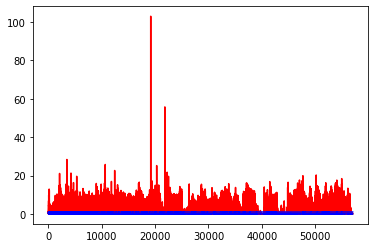

white ratio : 50.5
min : 180
max : 221


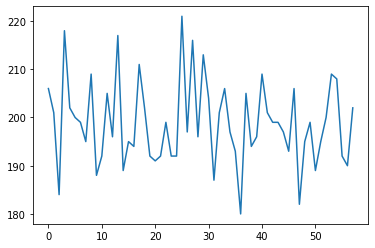

Generating interpolations...
57001 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.053543, 0.001966]
57002 [D loss: 0.000796, acc.: 100.00%] [G loss: 0.000225, 0.000003]
57003 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.000024, 0.000048]
57004 [D loss: 0.001722, acc.: 100.00%] [G loss: 0.000010, 0.002658]
57005 [D loss: 0.001684, acc.: 100.00%] [G loss: 0.049880, 0.112783]
57006 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.001741, 0.000615]
57007 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.000861, 0.003108]
57008 [D loss: 0.000260, acc.: 100.00%] [G loss: 0.000065, 0.000001]
57009 [D loss: 0.000259, acc.: 100.00%] [G loss: 0.000097, 0.000174]
57010 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000019, 0.000888]
57011 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.078737, 0.058110]
57012 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.012099, 0.000079]
57013 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57014 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009031, 0.031840]
57015

57122 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57123 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57124 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.000006, 0.000000]
57125 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.001387, 0.020959]
57126 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.671068, 0.805058]
57127 [D loss: 0.000115, acc.: 100.00%] [G loss: 3.337968, 3.125652]
57128 [D loss: 0.001513, acc.: 100.00%] [G loss: 0.452225, 0.110147]
57129 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000077, 0.000001]
57130 [D loss: 0.001441, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57131 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.000000, 0.000141]
57132 [D loss: 0.000280, acc.: 100.00%] [G loss: 0.000001, 0.000000]
57133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004951, 0.008520]
57134 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.213446, 0.196063]
57135 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000315, 0.000691]
57136 [D loss: 0.000390, acc.: 100

57244 [D loss: 0.003360, acc.: 100.00%] [G loss: 0.433723, 0.303019]
57245 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.000002, 0.000000]
57246 [D loss: 0.000636, acc.: 100.00%] [G loss: 0.000012, 0.000002]
57247 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000017, 0.000000]
57248 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000005, 0.000000]
57249 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57250 [D loss: 0.000700, acc.: 100.00%] [G loss: 0.417343, 0.300788]
57251 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.029435, 0.394097]
57252 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57253 [D loss: 0.000210, acc.: 100.00%] [G loss: 0.000001, 0.000086]
57254 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000025, 0.000004]
57255 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.014820, 0.000537]
57256 [D loss: 0.030354, acc.: 96.88%] [G loss: 0.002732, 0.031435]
57257 [D loss: 0.000047, acc.: 100.00%] [G loss: 3.005499, 3.343393]
57258 [D loss: 0.000000, acc.: 100.

57365 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57366 [D loss: 0.001024, acc.: 100.00%] [G loss: 0.038701, 0.001684]
57367 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000712, 0.001621]
57368 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000003, 0.000000]
57369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57370 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57371 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000356, 0.000459]
57372 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57373 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000205, 0.000403]
57374 [D loss: 0.003175, acc.: 100.00%] [G loss: 0.000001, 0.000032]
57375 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.002359, 0.000117]
57376 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000002, 0.000000]
57377 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000026, 0.000035]
57378 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57379 [D loss: 0.000019, acc.: 100

57486 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57487 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57488 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57489 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000002]
57490 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000001, 0.000950]
57491 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57492 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57493 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.001921, 0.000616]
57494 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57495 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.617839, 0.447852]
57496 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000274, 0.000000]
57497 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57498 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000027]
57499 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000346, 0.072155]
57500 [D loss: 0.000025, acc.: 100

57606 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000001, 0.000012]
57607 [D loss: 0.000329, acc.: 100.00%] [G loss: 0.000001, 0.000001]
57608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000009]
57609 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004354, 0.000692]
57610 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.000001, 0.000000]
57611 [D loss: 0.002695, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57612 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.007230, 0.022834]
57613 [D loss: 0.000287, acc.: 100.00%] [G loss: 0.000048, 0.000602]
57614 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000032, 0.000132]
57615 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57616 [D loss: 0.000618, acc.: 100.00%] [G loss: 0.000001, 0.000003]
57617 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57618 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000007]
57619 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.001188, 0.102503]
57620 [D loss: 0.000305, acc.: 100

57727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000566, 0.000027]
57728 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000000, 0.000059]
57729 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57730 [D loss: 0.000209, acc.: 100.00%] [G loss: 0.000231, 0.000023]
57731 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000003, 0.003217]
57732 [D loss: 0.001487, acc.: 100.00%] [G loss: 0.000001, 0.000006]
57733 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.355365, 0.066154]
57734 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000116, 0.000267]
57735 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000007, 0.000010]
57736 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000036, 0.000003]
57737 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000013, 0.000003]
57738 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000006, 0.000227]
57739 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.127311, 0.014509]
57740 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.079489, 0.189559]
57741 [D loss: 0.000786, acc.: 100

57846 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.062152, 0.002264]
57847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000065, 0.000022]
57848 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000140, 0.005350]
57850 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57851 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000002]
57852 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000407, 0.000152]
57853 [D loss: 0.010605, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57854 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.001042, 0.000026]
57855 [D loss: 0.000496, acc.: 100.00%] [G loss: 0.000001, 0.000335]
57856 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000007]
57857 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000028]
57858 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000109, 0.000215]
57859 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000116]
57860 [D loss: 0.000000, acc.: 100

57968 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57969 [D loss: 0.000295, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57970 [D loss: 0.000255, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57971 [D loss: 0.010087, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57972 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000002, 0.000000]
57973 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57974 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57975 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57976 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57977 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000009, 0.000085]
57978 [D loss: 0.003551, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57979 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000001]
57980 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000013, 0.000006]
57981 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
57982 [D loss: 0.000002, acc.: 100

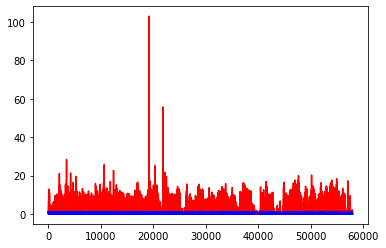

white ratio : 50.0
min : 180
max : 221


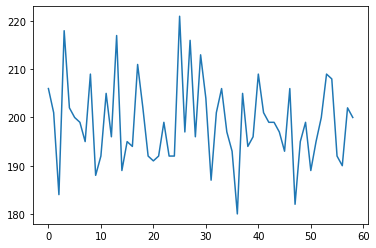

Generating interpolations...
58001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000012]
58002 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.066090, 0.000010]
58003 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000150, 0.005777]
58004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
58005 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000090, 0.020712]
58006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000151]
58007 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000493, 0.000042]
58008 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000156, 0.000003]
58009 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001169, 0.003401]
58010 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.004460, 0.001933]
58011 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000030, 0.000009]
58012 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000044, 0.000444]
58013 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000030, 0.000028]
58014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58015

58122 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000014, 0.000000]
58123 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000002]
58124 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000016, 0.000005]
58125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002828, 0.000972]
58126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000028, 0.003475]
58127 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000000, 0.000008]
58128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000658]
58129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
58131 [D loss: 0.000585, acc.: 100.00%] [G loss: 0.000484, 0.000005]
58132 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.000004, 0.000155]
58133 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000055, 0.003824]
58134 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000009]
58135 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000017]
58136 [D loss: 0.000002, acc.: 100

58242 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000005, 0.000006]
58243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000000]
58245 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000001]
58247 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.000016, 0.000050]
58248 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000036, 0.000019]
58251 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000083, 0.000137]
58252 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000006, 0.000002]
58253 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000032, 0.000145]
58254 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000009, 0.000001]
58255 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000084, 0.000011]
58256 [D loss: 0.000027, acc.: 100

58363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58364 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58366 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.019762, 0.053124]
58367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58369 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
58370 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58371 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000022, 0.000001]
58372 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58373 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58374 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58375 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58376 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58377 [D loss: 0.000013, acc.: 100

58483 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58484 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58485 [D loss: 0.000465, acc.: 100.00%] [G loss: 0.000001, 0.000000]
58486 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58487 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58488 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58491 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58492 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
58493 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58494 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000133, 0.000063]
58495 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000001]
58496 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58497 [D loss: 0.000001, acc.: 100

58602 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
58605 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000176, 0.000005]
58607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003258, 0.000108]
58608 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000002]
58609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58610 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000049, 0.000000]
58611 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58612 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58613 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000043, 0.000269]
58614 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000013, 0.000067]
58615 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.000008, 0.000156]
58616 [D loss: 0.000000, acc.: 100

58722 [D loss: 0.000451, acc.: 100.00%] [G loss: 0.048581, 0.000021]
58723 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.024661, 0.001204]
58724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.043555, 0.046380]
58725 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.174878, 0.127627]
58726 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.086368, 0.002920]
58727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.069373, 0.000014]
58728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000402, 0.003869]
58729 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000401, 0.001574]
58730 [D loss: 0.033774, acc.: 96.88%] [G loss: 0.001351, 0.000079]
58731 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000049, 0.000233]
58732 [D loss: 0.000045, acc.: 100.00%] [G loss: 2.474207, 0.000180]
58733 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000006, 0.000269]
58734 [D loss: 0.000788, acc.: 100.00%] [G loss: 0.000045, 0.000049]
58735 [D loss: 0.000090, acc.: 100.00%] [G loss: 1.135386, 0.168337]
58736 [D loss: 0.000002, acc.: 100.

58841 [D loss: 0.042357, acc.: 96.88%] [G loss: 0.000000, 0.000000]
58842 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58843 [D loss: 0.001473, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58844 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58845 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58846 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58847 [D loss: 0.252382, acc.: 96.88%] [G loss: 0.000000, 0.000000]
58848 [D loss: 0.000536, acc.: 100.00%] [G loss: 0.000018, 0.000000]
58849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
58850 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000002, 0.000001]
58851 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000002, 0.000000]
58852 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000000]
58853 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000003, 0.000000]
58854 [D loss: 0.134309, acc.: 96.88%] [G loss: 0.000000, 0.000000]
58855 [D loss: 0.000001, acc.: 100.00

58960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58961 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000495, 0.000034]
58962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58964 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58965 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58966 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58967 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58968 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000001]
58969 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58970 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58971 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58972 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.000005, 0.000071]
58973 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
58974 [D loss: 0.000762, acc.: 100

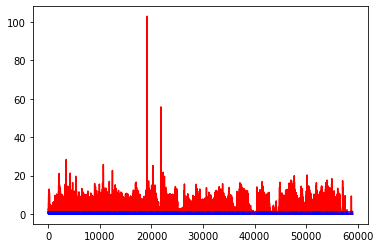

white ratio : 50.5
min : 180
max : 221


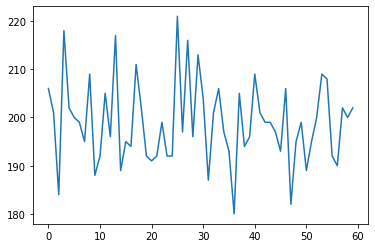

Generating interpolations...
59001 [D loss: 0.000431, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59002 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59003 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59004 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000005, 0.000000]
59005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59007 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59008 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000001]
59009 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59011 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59012 [D loss: 0.001298, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59013 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59015

59122 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59123 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000000]
59124 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59125 [D loss: 0.000573, acc.: 100.00%] [G loss: 0.000001, 0.000001]
59126 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59127 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59128 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59129 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59130 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59131 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59132 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59133 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.000000, 0.000004]
59134 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59135 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000008, 0.000000]
59136 [D loss: 0.000005, acc.: 100

59242 [D loss: 0.006005, acc.: 100.00%] [G loss: 0.385150, 0.099849]
59243 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59244 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59245 [D loss: 0.000430, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59246 [D loss: 0.000271, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59247 [D loss: 0.001742, acc.: 100.00%] [G loss: 0.000016, 0.000006]
59248 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59249 [D loss: 0.000463, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59250 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59251 [D loss: 0.000504, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59254 [D loss: 0.069617, acc.: 96.88%] [G loss: 0.000000, 0.000000]
59255 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000001, 0.000000]
59256 [D loss: 0.000001, acc.: 100.

59364 [D loss: 0.000634, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59365 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000494, 0.000289]
59366 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59367 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000004, 0.000000]
59368 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59369 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59370 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59371 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59372 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59373 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59374 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59375 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59376 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59377 [D loss: 0.001508, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59378 [D loss: 0.000002, acc.: 100

59486 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59487 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.000002, 0.000000]
59488 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.003699, 0.034529]
59489 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59490 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59491 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59492 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.512533, 0.084351]
59493 [D loss: 0.001570, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59494 [D loss: 0.033881, acc.: 96.88%] [G loss: 0.000000, 0.000000]
59495 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59496 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59497 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59498 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
59499 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000001, 0.000003]
59500 [D loss: 0.000054, acc.: 100.

59605 [D loss: 0.000931, acc.: 100.00%] [G loss: 0.127648, 0.017224]
59606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.148468, 0.046417]
59607 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.080638, 0.275849]
59608 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.003023, 0.004204]
59609 [D loss: 0.026051, acc.: 96.88%] [G loss: 0.000083, 0.000447]
59610 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.558245, 0.731384]
59611 [D loss: 0.000342, acc.: 100.00%] [G loss: 0.421531, 0.385962]
59612 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.477956, 0.470230]
59613 [D loss: 0.020773, acc.: 100.00%] [G loss: 0.000104, 0.000024]
59614 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000086, 0.000032]
59615 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000158, 0.000022]
59616 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.028735, 0.018577]
59617 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.012380, 0.019816]
59618 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.516169, 0.886493]
59619 [D loss: 0.000087, acc.: 100.

59726 [D loss: 0.000027, acc.: 100.00%] [G loss: 9.432735, 8.287979]
59727 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.021053, 4.016977]
59728 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.501254, 5.841047]
59729 [D loss: 0.097349, acc.: 96.88%] [G loss: 0.152078, 0.529110]
59730 [D loss: 0.005560, acc.: 100.00%] [G loss: 1.241060, 0.799064]
59731 [D loss: 0.001608, acc.: 100.00%] [G loss: 1.463643, 1.083419]
59732 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.679972, 5.782932]
59733 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.855124, 5.494883]
59734 [D loss: 0.000608, acc.: 100.00%] [G loss: 7.004594, 6.501461]
59735 [D loss: 0.000258, acc.: 100.00%] [G loss: 5.776875, 6.068376]
59736 [D loss: 0.000055, acc.: 100.00%] [G loss: 4.969237, 4.708986]
59737 [D loss: 0.000480, acc.: 100.00%] [G loss: 5.887014, 4.981132]
59738 [D loss: 0.000161, acc.: 100.00%] [G loss: 3.639461, 4.211242]
59739 [D loss: 0.000055, acc.: 100.00%] [G loss: 3.992840, 2.977835]
59740 [D loss: 0.005313, acc.: 100.

59847 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.521120, 10.896454]
59848 [D loss: 0.000003, acc.: 100.00%] [G loss: 16.143860, 15.154844]
59849 [D loss: 0.000046, acc.: 100.00%] [G loss: 10.245247, 9.106828]
59850 [D loss: 0.000163, acc.: 100.00%] [G loss: 9.003687, 8.597642]
59851 [D loss: 0.000650, acc.: 100.00%] [G loss: 14.088109, 12.207672]
59852 [D loss: 0.000106, acc.: 100.00%] [G loss: 11.198181, 11.163848]
59853 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.936895, 7.675316]
59854 [D loss: 0.000173, acc.: 100.00%] [G loss: 11.670550, 12.396875]
59855 [D loss: 0.000260, acc.: 100.00%] [G loss: 9.538381, 8.557951]
59856 [D loss: 0.000016, acc.: 100.00%] [G loss: 3.556355, 3.904941]
59857 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.935608, 8.358986]
59858 [D loss: 0.000037, acc.: 100.00%] [G loss: 8.011909, 6.916975]
59859 [D loss: 0.000084, acc.: 100.00%] [G loss: 12.929770, 11.706376]
59860 [D loss: 0.000022, acc.: 100.00%] [G loss: 12.796640, 13.355405]
59861 [D loss: 0.00

59967 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.450502, 0.470536]
59968 [D loss: 0.000405, acc.: 100.00%] [G loss: 0.003826, 0.013111]
59969 [D loss: 0.001369, acc.: 100.00%] [G loss: 0.037708, 0.026648]
59970 [D loss: 0.000477, acc.: 100.00%] [G loss: 5.789166, 0.201650]
59971 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.693401, 0.636961]
59972 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.738485, 0.651738]
59973 [D loss: 0.000285, acc.: 100.00%] [G loss: 1.866200, 1.376987]
59974 [D loss: 0.000310, acc.: 100.00%] [G loss: 7.393543, 4.613736]
59975 [D loss: 0.000382, acc.: 100.00%] [G loss: 0.202927, 0.076801]
59976 [D loss: 0.000467, acc.: 100.00%] [G loss: 3.097106, 2.326087]
59977 [D loss: 0.001494, acc.: 100.00%] [G loss: 0.000002, 0.000578]
59978 [D loss: 0.006982, acc.: 100.00%] [G loss: 3.790631, 2.064468]
59979 [D loss: 0.009861, acc.: 100.00%] [G loss: 1.428846, 0.000035]
59980 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000007, 0.000002]
59981 [D loss: 0.001146, acc.: 100

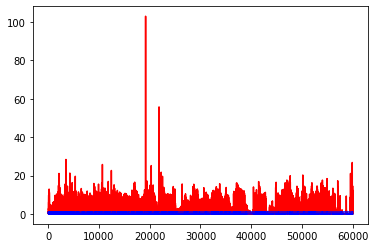

white ratio : 49.0
min : 180
max : 221


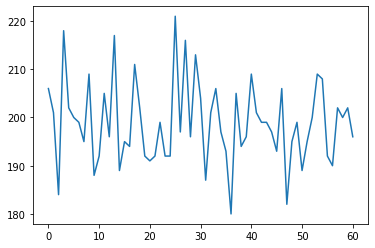

Generating interpolations...
60001 [D loss: 0.004560, acc.: 100.00%] [G loss: 0.014247, 0.028477]
60002 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.204355, 0.056842]
60003 [D loss: 0.000308, acc.: 100.00%] [G loss: 1.139042, 0.519938]
60004 [D loss: 0.000084, acc.: 100.00%] [G loss: 59.248348, 6.637099]
60005 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.773308, 16.977253]
60006 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.383428, 10.977157]
60007 [D loss: 0.000011, acc.: 100.00%] [G loss: 7.796742, 5.372317]
60008 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.805865, 6.026003]
60009 [D loss: 0.000007, acc.: 100.00%] [G loss: 8.730244, 6.102216]
60010 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.387363, 0.042282]
60011 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.531010, 4.848742]
60012 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.055893, 0.010936]
60013 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.188925, 0.146612]
60014 [D loss: 0.000888, acc.: 100.00%] [G loss: 1.034969, 0.425056]


60119 [D loss: 0.002650, acc.: 100.00%] [G loss: 0.000010, 0.000005]
60120 [D loss: 0.002040, acc.: 100.00%] [G loss: 0.000016, 0.000043]
60121 [D loss: 0.001784, acc.: 100.00%] [G loss: 0.002625, 0.006450]
60122 [D loss: 0.002360, acc.: 100.00%] [G loss: 1.779823, 0.061080]
60123 [D loss: 0.000487, acc.: 100.00%] [G loss: 0.211077, 0.282451]
60124 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.000050, 0.000012]
60125 [D loss: 0.013817, acc.: 100.00%] [G loss: 0.444896, 0.211282]
60126 [D loss: 0.047014, acc.: 96.88%] [G loss: 0.001089, 0.007302]
60127 [D loss: 0.000083, acc.: 100.00%] [G loss: 4.123548, 2.802984]
60128 [D loss: 0.001076, acc.: 100.00%] [G loss: 2.124854, 0.583785]
60129 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.796395, 0.171341]
60130 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000304, 0.000304]
60131 [D loss: 0.000048, acc.: 100.00%] [G loss: 62.072319, 0.122742]
60132 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.588415, 2.736804]
60133 [D loss: 0.000000, acc.: 100

60241 [D loss: 0.005098, acc.: 100.00%] [G loss: 0.707597, 0.643733]
60242 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.974807, 0.419946]
60243 [D loss: 0.000400, acc.: 100.00%] [G loss: 1.294031, 0.715977]
60244 [D loss: 0.024648, acc.: 96.88%] [G loss: 0.000843, 0.000338]
60245 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.003034, 0.006629]
60246 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.000001, 0.000001]
60247 [D loss: 0.177931, acc.: 96.88%] [G loss: 0.051657, 0.017402]
60248 [D loss: 0.000327, acc.: 100.00%] [G loss: 0.000014, 0.000011]
60249 [D loss: 0.004145, acc.: 100.00%] [G loss: 0.068176, 0.080349]
60250 [D loss: 0.003057, acc.: 100.00%] [G loss: 0.001273, 0.000295]
60251 [D loss: 0.001182, acc.: 100.00%] [G loss: 0.126044, 0.163471]
60252 [D loss: 0.002855, acc.: 100.00%] [G loss: 0.453472, 0.257669]
60253 [D loss: 0.002486, acc.: 100.00%] [G loss: 0.000431, 0.000229]
60254 [D loss: 0.001158, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60255 [D loss: 0.000448, acc.: 100.0

60362 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60363 [D loss: 0.001761, acc.: 100.00%] [G loss: 0.000386, 0.000498]
60364 [D loss: 0.000828, acc.: 100.00%] [G loss: 0.001144, 0.003055]
60365 [D loss: 0.002124, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60366 [D loss: 0.001352, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60367 [D loss: 0.001348, acc.: 100.00%] [G loss: 0.000022, 0.000017]
60368 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.000010, 0.000001]
60369 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60370 [D loss: 0.000639, acc.: 100.00%] [G loss: 0.000390, 0.000767]
60371 [D loss: 0.006704, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60372 [D loss: 0.000319, acc.: 100.00%] [G loss: 0.001348, 0.009415]
60373 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.165157, 0.190252]
60374 [D loss: 0.000558, acc.: 100.00%] [G loss: 0.173590, 0.175888]
60375 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.011640, 0.018349]
60376 [D loss: 0.003607, acc.: 100

60481 [D loss: 0.002090, acc.: 100.00%] [G loss: 0.052557, 0.028799]
60482 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.017198, 0.034694]
60483 [D loss: 0.000906, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60484 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60485 [D loss: 0.002866, acc.: 100.00%] [G loss: 0.018282, 0.002883]
60486 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.425058, 0.146435]
60487 [D loss: 0.000658, acc.: 100.00%] [G loss: 4.897123, 0.077930]
60488 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.004527, 0.001750]
60489 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60490 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.292828, 0.115365]
60491 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001879, 0.000206]
60492 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.017110, 0.012825]
60493 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.009774, 0.003810]
60494 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.125977, 1.604070]
60495 [D loss: 0.000062, acc.: 100

60602 [D loss: 0.000437, acc.: 100.00%] [G loss: 0.000004, 0.001286]
60603 [D loss: 0.003053, acc.: 100.00%] [G loss: 0.037706, 0.014586]
60604 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60605 [D loss: 0.001073, acc.: 100.00%] [G loss: 0.000447, 0.001634]
60606 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.010878, 0.008411]
60607 [D loss: 0.002151, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60608 [D loss: 0.000800, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60609 [D loss: 0.000554, acc.: 100.00%] [G loss: 0.000028, 0.000026]
60610 [D loss: 0.000337, acc.: 100.00%] [G loss: 0.000706, 0.000195]
60611 [D loss: 0.001333, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60612 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60613 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60614 [D loss: 0.000410, acc.: 100.00%] [G loss: 0.000740, 0.000670]
60615 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.017048, 0.019380]
60616 [D loss: 0.001217, acc.: 100

60721 [D loss: 0.000824, acc.: 100.00%] [G loss: 0.000797, 0.001838]
60722 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.018630, 0.004253]
60723 [D loss: 0.000014, acc.: 100.00%] [G loss: 2.891933, 1.776082]
60724 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60725 [D loss: 0.000104, acc.: 100.00%] [G loss: 11.241890, 0.000827]
60726 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.661469, 4.735724]
60727 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.042501, 0.249845]
60728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.593417, 0.829190]
60729 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.638869, 2.058461]
60730 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.332797, 0.234558]
60731 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000526, 0.004507]
60732 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.401947, 0.952766]
60733 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.230845, 0.378946]
60734 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.055320, 1.109420]
60735 [D loss: 0.000243, acc.: 10

60842 [D loss: 0.000351, acc.: 100.00%] [G loss: 0.001467, 0.000296]
60843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.142873, 0.068505]
60844 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000194, 0.000048]
60845 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.000015, 0.000081]
60846 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000007, 0.000000]
60847 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.000742, 0.019491]
60848 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000010, 0.000000]
60849 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000068, 0.000088]
60850 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000025, 0.000044]
60851 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000008, 0.000329]
60852 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000002, 0.000001]
60853 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.000017, 0.000017]
60854 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.001674, 0.000182]
60855 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000088]
60856 [D loss: 0.000053, acc.: 100

60961 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.397213, 0.865381]
60962 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.009351, 0.010079]
60963 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.062106, 0.056051]
60964 [D loss: 0.040948, acc.: 96.88%] [G loss: 0.017603, 0.027617]
60965 [D loss: 0.000364, acc.: 100.00%] [G loss: 0.000419, 0.000252]
60966 [D loss: 0.037954, acc.: 100.00%] [G loss: 0.000000, 0.000000]
60967 [D loss: 0.000887, acc.: 100.00%] [G loss: 0.044889, 0.004513]
60968 [D loss: 0.000346, acc.: 100.00%] [G loss: 0.002592, 0.001499]
60969 [D loss: 0.000502, acc.: 100.00%] [G loss: 0.002060, 0.000017]
60970 [D loss: 0.000373, acc.: 100.00%] [G loss: 0.330608, 0.136348]
60971 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.027514, 0.019432]
60972 [D loss: 0.003570, acc.: 100.00%] [G loss: 0.093390, 0.012435]
60973 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.753731, 0.389770]
60974 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.117538, 0.073303]
60975 [D loss: 0.000103, acc.: 100.

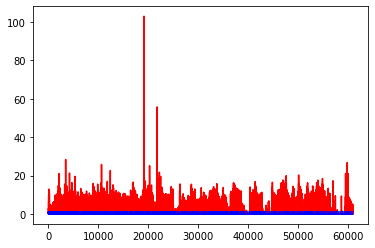

white ratio : 50.5
min : 180
max : 221


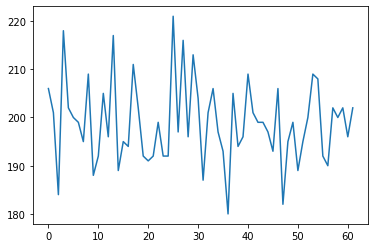

Generating interpolations...
61001 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.319171, 1.523688]
61002 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.543840, 0.748031]
61003 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.866117, 0.573838]
61004 [D loss: 0.000046, acc.: 100.00%] [G loss: 1.261484, 0.896389]
61005 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.905159, 12.836971]
61006 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.989755, 14.953330]
61007 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.355947, 14.484636]
61008 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.461302, 4.746614]
61009 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.943178, 5.166488]
61010 [D loss: 0.000640, acc.: 100.00%] [G loss: 12.071461, 9.771212]
61011 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.408103, 2.393395]
61012 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.802614, 5.831837]
61013 [D loss: 0.000461, acc.: 100.00%] [G loss: 11.403020, 11.487541]
61014 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.994403, 6.5813

61121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.128229, 0.059097]
61122 [D loss: 0.001087, acc.: 100.00%] [G loss: 3.118967, 3.437564]
61123 [D loss: 0.000047, acc.: 100.00%] [G loss: 1.779762, 1.325605]
61124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.434104, 0.422003]
61125 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.207985, 0.000226]
61126 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.190703, 4.133213]
61127 [D loss: 0.002325, acc.: 100.00%] [G loss: 3.231718, 1.640954]
61128 [D loss: 0.024365, acc.: 96.88%] [G loss: 0.441376, 0.271224]
61129 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.335537, 0.666899]
61130 [D loss: 0.000814, acc.: 100.00%] [G loss: 0.042729, 0.127949]
61131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.506180, 0.337399]
61132 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.166575, 0.237751]
61133 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.016302, 0.231592]
61134 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.042578, 0.017039]
61135 [D loss: 0.139379, acc.: 96.8

61240 [D loss: 0.114719, acc.: 96.88%] [G loss: 0.000009, 0.000790]
61241 [D loss: 0.000318, acc.: 100.00%] [G loss: 0.000001, 0.000000]
61242 [D loss: 0.025492, acc.: 96.88%] [G loss: 5.521865, 0.673082]
61243 [D loss: 0.004718, acc.: 100.00%] [G loss: 1.670801, 2.071447]
61244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001725, 0.039623]
61245 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.051059, 0.090548]
61246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.059960, 0.001046]
61247 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.413951, 0.000896]
61248 [D loss: 0.057553, acc.: 96.88%] [G loss: 0.079912, 0.006946]
61249 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.337376, 0.288529]
61250 [D loss: 0.000233, acc.: 100.00%] [G loss: 0.002142, 0.004275]
61251 [D loss: 0.002756, acc.: 100.00%] [G loss: 0.335959, 0.418660]
61252 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.534542, 0.229354]
61253 [D loss: 0.000377, acc.: 100.00%] [G loss: 4.054786, 3.137418]
61254 [D loss: 0.000278, acc.: 100.00

61362 [D loss: 0.000246, acc.: 100.00%] [G loss: 1.017952, 0.093172]
61363 [D loss: 0.004995, acc.: 100.00%] [G loss: 0.025620, 0.011574]
61364 [D loss: 0.000455, acc.: 100.00%] [G loss: 0.000000, 0.000000]
61365 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.081287, 0.011645]
61366 [D loss: 0.001979, acc.: 100.00%] [G loss: 0.046129, 0.161066]
61367 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.021217, 0.022544]
61368 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.287683, 0.000001]
61369 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.412752, 0.381712]
61370 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000974, 0.006432]
61371 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.005874, 0.027205]
61372 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.000080, 0.000001]
61373 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.207867, 0.031217]
61374 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.145436, 0.159482]
61375 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.318796, 0.565120]
61376 [D loss: 0.000023, acc.: 100

61481 [D loss: 0.001128, acc.: 100.00%] [G loss: 0.000082, 0.014655]
61482 [D loss: 0.087819, acc.: 96.88%] [G loss: 0.000125, 0.000042]
61483 [D loss: 0.009242, acc.: 100.00%] [G loss: 0.000162, 0.001044]
61484 [D loss: 0.000754, acc.: 100.00%] [G loss: 0.001027, 0.000008]
61485 [D loss: 0.005997, acc.: 100.00%] [G loss: 0.000738, 0.000729]
61486 [D loss: 0.010964, acc.: 100.00%] [G loss: 0.000023, 0.000031]
61487 [D loss: 0.001154, acc.: 100.00%] [G loss: 0.004260, 0.001116]
61488 [D loss: 0.018751, acc.: 100.00%] [G loss: 0.000893, 0.000133]
61489 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000938, 0.030649]
61490 [D loss: 0.001989, acc.: 100.00%] [G loss: 0.190745, 0.348646]
61491 [D loss: 0.003159, acc.: 100.00%] [G loss: 0.000284, 0.002665]
61492 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.364137, 0.685201]
61493 [D loss: 0.004414, acc.: 100.00%] [G loss: 0.444542, 0.048798]
61494 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000809, 0.044864]
61495 [D loss: 0.000000, acc.: 100.

61601 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.308285, 1.917146]
61602 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.564648, 7.804523]
61603 [D loss: 0.000098, acc.: 100.00%] [G loss: 5.979176, 5.369316]
61604 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.614115, 1.556237]
61605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.730610, 0.328089]
61606 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.739186, 0.231842]
61607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.518724, 0.413254]
61608 [D loss: 0.016868, acc.: 100.00%] [G loss: 0.178331, 0.114853]
61609 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.061713, 0.034042]
61610 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.078456, 0.287261]
61611 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.008022, 0.070353]
61612 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.159834, 0.149915]
61613 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.059543, 0.173904]
61614 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.061074, 0.064497]
61615 [D loss: 0.000005, acc.: 100

61723 [D loss: 0.001609, acc.: 100.00%] [G loss: 6.506016, 5.835481]
61724 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.245131, 3.460662]
61725 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.335263, 0.297173]
61726 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.058383, 0.180869]
61727 [D loss: 0.000050, acc.: 100.00%] [G loss: 1.720621, 1.030583]
61728 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.256531, 0.465999]
61729 [D loss: 0.318146, acc.: 96.88%] [G loss: 0.000055, 0.000002]
61730 [D loss: 0.002765, acc.: 100.00%] [G loss: 0.000014, 0.000034]
61731 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.026365, 0.120847]
61732 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.098709, 0.013814]
61733 [D loss: 0.054795, acc.: 96.88%] [G loss: 0.000648, 0.003942]
61734 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.001171, 0.000122]
61735 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.031702, 0.001862]
61736 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.080363, 0.003281]
61737 [D loss: 0.000018, acc.: 100.0

61844 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000006, 0.000352]
61845 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.026797, 0.022567]
61846 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.094888, 0.240571]
61847 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.024486, 0.007565]
61848 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.020231, 0.104706]
61849 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000051, 0.000044]
61850 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000003, 0.000003]
61851 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.090211, 0.449461]
61852 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.004343, 0.026346]
61853 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.001366, 0.103112]
61854 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.105933, 0.049277]
61855 [D loss: 0.000048, acc.: 100.00%] [G loss: 4.737534, 0.122016]
61856 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.205216, 2.721116]
61857 [D loss: 0.001173, acc.: 100.00%] [G loss: 3.491130, 3.773374]
61858 [D loss: 0.048995, acc.: 96.

61965 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.000024, 0.000142]
61966 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.002000, 0.002395]
61967 [D loss: 0.001284, acc.: 100.00%] [G loss: 0.000003, 0.000005]
61968 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.001147, 0.000666]
61969 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.031875, 0.004595]
61970 [D loss: 0.000392, acc.: 100.00%] [G loss: 0.013787, 0.024731]
61971 [D loss: 0.000525, acc.: 100.00%] [G loss: 0.248764, 0.042690]
61972 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.203512, 0.103102]
61973 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.000153, 0.000341]
61974 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.020528, 0.033691]
61975 [D loss: 0.010124, acc.: 100.00%] [G loss: 0.000010, 0.000000]
61976 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.411240, 0.241241]
61977 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.000854, 0.000169]
61978 [D loss: 0.165534, acc.: 93.75%] [G loss: 0.150651, 0.045921]
61979 [D loss: 0.000217, acc.: 100.

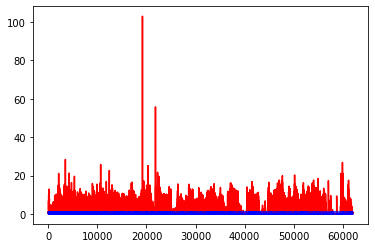

white ratio : 51.25
min : 180
max : 221


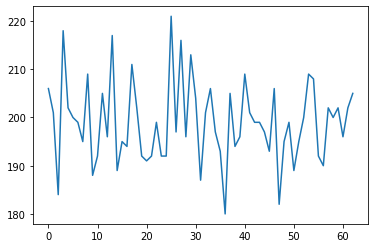

Generating interpolations...
62001 [D loss: 0.000568, acc.: 100.00%] [G loss: 0.011361, 0.142013]
62002 [D loss: 0.004589, acc.: 100.00%] [G loss: 0.054949, 0.054136]
62003 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.009737, 0.024324]
62004 [D loss: 0.020857, acc.: 100.00%] [G loss: 0.104823, 0.251870]
62005 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.003425, 0.009207]
62006 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.252356, 0.090670]
62007 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000040, 0.000058]
62008 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.041986, 0.033316]
62009 [D loss: 0.000875, acc.: 100.00%] [G loss: 0.001980, 0.035997]
62010 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000009, 0.000073]
62011 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.175311, 0.167161]
62012 [D loss: 0.000389, acc.: 100.00%] [G loss: 0.120168, 0.066985]
62013 [D loss: 0.012998, acc.: 100.00%] [G loss: 0.000001, 0.000010]
62014 [D loss: 0.001461, acc.: 100.00%] [G loss: 0.000169, 0.000139]
62015

62121 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.577783, 0.337461]
62122 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.499679, 2.215774]
62123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.568867, 0.274394]
62124 [D loss: 0.000051, acc.: 100.00%] [G loss: 1.228950, 1.014849]
62125 [D loss: 0.000194, acc.: 100.00%] [G loss: 3.335935, 2.327151]
62126 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.002824, 0.019139]
62127 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.100939, 0.011787]
62128 [D loss: 0.002032, acc.: 100.00%] [G loss: 0.017101, 0.129168]
62129 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.030828, 0.052540]
62130 [D loss: 0.004549, acc.: 100.00%] [G loss: 0.175475, 0.240137]
62131 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.252240, 0.132124]
62132 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.031152, 0.103834]
62133 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.134174, 0.083615]
62134 [D loss: 0.028432, acc.: 96.88%] [G loss: 0.162574, 0.038877]
62135 [D loss: 0.000702, acc.: 100.

62240 [D loss: 0.000813, acc.: 100.00%] [G loss: 0.011936, 0.024252]
62241 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000232, 0.000799]
62242 [D loss: 0.000451, acc.: 100.00%] [G loss: 0.074075, 0.104575]
62243 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.070069, 0.089606]
62244 [D loss: 0.008259, acc.: 100.00%] [G loss: 0.010299, 0.000635]
62245 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.347145, 0.328209]
62246 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.085538, 0.132881]
62247 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.008292, 0.048788]
62248 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.006992, 0.023678]
62249 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.057789, 0.010824]
62250 [D loss: 0.011247, acc.: 100.00%] [G loss: 0.003776, 0.001829]
62251 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.060219, 0.014063]
62252 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.002254, 0.000515]
62253 [D loss: 0.000437, acc.: 100.00%] [G loss: 0.000675, 0.139809]
62254 [D loss: 0.000360, acc.: 100

62361 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.013050, 0.049603]
62362 [D loss: 0.000188, acc.: 100.00%] [G loss: 1.197731, 0.000299]
62363 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001697, 0.014863]
62364 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.211637, 0.291711]
62365 [D loss: 0.002213, acc.: 100.00%] [G loss: 0.120527, 0.182644]
62366 [D loss: 0.036676, acc.: 96.88%] [G loss: 0.131029, 0.053870]
62367 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.005402, 0.004247]
62368 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.108587, 0.066936]
62369 [D loss: 0.001193, acc.: 100.00%] [G loss: 0.000423, 0.119431]
62370 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.000082, 0.000038]
62371 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.001937, 0.181473]
62372 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.133144, 0.027474]
62373 [D loss: 0.000751, acc.: 100.00%] [G loss: 0.003285, 0.001418]
62374 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000282, 0.004866]
62375 [D loss: 0.000030, acc.: 100.

62481 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.592587, 8.208104]
62482 [D loss: 0.000048, acc.: 100.00%] [G loss: 6.917967, 8.317076]
62483 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.733635, 4.736402]
62484 [D loss: 0.000331, acc.: 100.00%] [G loss: 5.675645, 5.913593]
62485 [D loss: 0.000031, acc.: 100.00%] [G loss: 6.294256, 6.549381]
62486 [D loss: 0.000868, acc.: 100.00%] [G loss: 3.254624, 2.039582]
62487 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.314357, 0.951143]
62488 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.182170, 0.687599]
62489 [D loss: 0.000164, acc.: 100.00%] [G loss: 17.154299, 3.644206]
62490 [D loss: 0.000104, acc.: 100.00%] [G loss: 6.736576, 5.575863]
62491 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.942281, 5.685616]
62492 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.634911, 3.354613]
62493 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.976907, 0.706161]
62494 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.686898, 4.467136]
62495 [D loss: 0.000001, acc.: 10

62600 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.813161, 1.376868]
62601 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.638788, 0.936155]
62602 [D loss: 0.003660, acc.: 100.00%] [G loss: 1.921606, 1.430714]
62603 [D loss: 0.000265, acc.: 100.00%] [G loss: 1.161129, 1.335762]
62604 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.442960, 2.135592]
62605 [D loss: 0.050993, acc.: 96.88%] [G loss: 1.740167, 0.634290]
62606 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.568080, 1.515890]
62607 [D loss: 0.089110, acc.: 96.88%] [G loss: 0.160886, 0.179032]
62608 [D loss: 0.001242, acc.: 100.00%] [G loss: 0.087100, 0.120179]
62609 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.009614, 0.008579]
62610 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.281696, 0.344605]
62611 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001846, 0.100740]
62612 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.009006, 0.019944]
62613 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.263832, 0.282539]
62614 [D loss: 0.000022, acc.: 100.0

62720 [D loss: 0.000155, acc.: 100.00%] [G loss: 1.880801, 0.817378]
62721 [D loss: 0.000011, acc.: 100.00%] [G loss: 6.393678, 3.916794]
62722 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.528511, 1.057174]
62723 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.622295, 0.901447]
62724 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.371645, 2.397514]
62725 [D loss: 0.000185, acc.: 100.00%] [G loss: 1.557440, 2.147600]
62726 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.811306, 2.498243]
62727 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.941702, 0.844698]
62728 [D loss: 0.000995, acc.: 100.00%] [G loss: 0.256721, 0.253323]
62729 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.124794, 0.835768]
62730 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.526503, 1.649946]
62731 [D loss: 0.001482, acc.: 100.00%] [G loss: 4.362497, 3.238940]
62732 [D loss: 0.001323, acc.: 100.00%] [G loss: 1.183298, 0.738415]
62733 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000087, 0.000159]
62734 [D loss: 0.000000, acc.: 10

62841 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.158578, 0.046197]
62842 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.007126, 0.002380]
62843 [D loss: 0.001370, acc.: 100.00%] [G loss: 0.005388, 0.025855]
62844 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.002586, 0.006225]
62845 [D loss: 0.001537, acc.: 100.00%] [G loss: 0.000299, 0.000558]
62846 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.030793, 0.009443]
62847 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.108892, 0.029271]
62848 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.001819, 0.010147]
62849 [D loss: 0.000574, acc.: 100.00%] [G loss: 0.097329, 0.042669]
62850 [D loss: 0.002082, acc.: 100.00%] [G loss: 0.050683, 0.000207]
62851 [D loss: 0.000502, acc.: 100.00%] [G loss: 0.006178, 0.008600]
62852 [D loss: 0.001069, acc.: 100.00%] [G loss: 0.130450, 0.004544]
62853 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.001920, 0.049919]
62854 [D loss: 0.002449, acc.: 100.00%] [G loss: 0.083325, 0.042891]
62855 [D loss: 0.023887, acc.: 100

62960 [D loss: 0.000611, acc.: 100.00%] [G loss: 0.529896, 0.031135]
62961 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000657, 0.004858]
62962 [D loss: 0.000449, acc.: 100.00%] [G loss: 0.286553, 0.134493]
62963 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.169605, 0.000313]
62964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007547, 0.070271]
62965 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.117596, 0.047717]
62966 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.229524, 0.186409]
62967 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.306691, 0.103811]
62968 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.101464, 0.187874]
62969 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.002181, 0.004116]
62970 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000004, 0.000000]
62971 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.004137, 0.004805]
62972 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.674083, 0.874965]
62973 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.081646, 0.021105]
62974 [D loss: 0.000007, acc.: 100

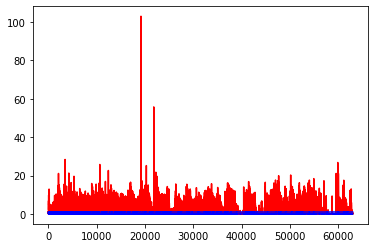

white ratio : 51.0
min : 180
max : 221


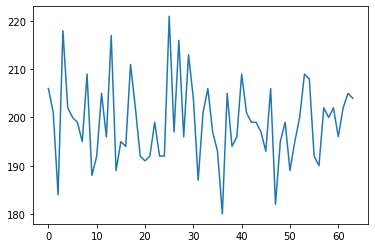

Generating interpolations...
63001 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.050365, 0.019637]
63002 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.149581, 0.013903]
63003 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.000001, 0.000002]
63004 [D loss: 0.000294, acc.: 100.00%] [G loss: 0.003668, 0.001851]
63005 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.021013, 0.005468]
63006 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.118879, 0.042004]
63007 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000001, 0.000003]
63008 [D loss: 0.000611, acc.: 100.00%] [G loss: 0.004593, 0.033774]
63009 [D loss: 0.087116, acc.: 96.88%] [G loss: 0.045025, 0.196868]
63010 [D loss: 0.000685, acc.: 100.00%] [G loss: 0.086701, 0.128027]
63011 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.118423, 0.083979]
63012 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.138174, 0.128719]
63013 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000002]
63014 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.000000, 0.000000]
63015 

63123 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.651008, 1.624994]
63124 [D loss: 0.000771, acc.: 100.00%] [G loss: 1.488166, 1.571878]
63125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.694107, 0.374510]
63126 [D loss: 0.152414, acc.: 96.88%] [G loss: 0.151640, 0.055610]
63127 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.033910, 0.134561]
63128 [D loss: 0.000233, acc.: 100.00%] [G loss: 0.042707, 0.339673]
63129 [D loss: 0.007160, acc.: 100.00%] [G loss: 0.122772, 0.075173]
63130 [D loss: 0.001789, acc.: 100.00%] [G loss: 0.082150, 0.333047]
63131 [D loss: 0.000574, acc.: 100.00%] [G loss: 0.513375, 0.248353]
63132 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.214560, 0.447796]
63133 [D loss: 0.000515, acc.: 100.00%] [G loss: 0.525051, 0.258729]
63134 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.554257, 0.487877]
63135 [D loss: 0.000076, acc.: 100.00%] [G loss: 1.155442, 0.603635]
63136 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.188305, 0.058337]
63137 [D loss: 0.000033, acc.: 100.

63245 [D loss: 0.000644, acc.: 100.00%] [G loss: 0.205299, 0.127255]
63246 [D loss: 0.000499, acc.: 100.00%] [G loss: 0.784778, 0.569966]
63247 [D loss: 0.000069, acc.: 100.00%] [G loss: 1.448794, 1.157264]
63248 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.137748, 0.027448]
63249 [D loss: 0.002677, acc.: 100.00%] [G loss: 0.006386, 0.005421]
63250 [D loss: 0.000219, acc.: 100.00%] [G loss: 0.125843, 0.437848]
63251 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000002, 0.000002]
63252 [D loss: 0.025386, acc.: 96.88%] [G loss: 0.000460, 0.001838]
63253 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000000, 0.000006]
63254 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.013015, 0.002909]
63255 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000004, 0.000000]
63256 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.033566, 0.000935]
63257 [D loss: 0.007612, acc.: 100.00%] [G loss: 0.243933, 0.000704]
63258 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.000012, 0.000008]
63259 [D loss: 0.003148, acc.: 100.

63367 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.284609, 0.162673]
63368 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000001, 0.000006]
63369 [D loss: 0.004726, acc.: 100.00%] [G loss: 0.064124, 0.618807]
63370 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000008, 0.000000]
63371 [D loss: 0.000732, acc.: 100.00%] [G loss: 0.000003, 0.000001]
63372 [D loss: 0.044689, acc.: 96.88%] [G loss: 0.219243, 0.037378]
63373 [D loss: 0.000286, acc.: 100.00%] [G loss: 16.518724, 2.682733]
63374 [D loss: 0.000057, acc.: 100.00%] [G loss: 1.019760, 1.506169]
63375 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.871526, 2.089878]
63376 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.794979, 0.657214]
63377 [D loss: 0.000068, acc.: 100.00%] [G loss: 1.510133, 1.023898]
63378 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.593752, 0.755396]
63379 [D loss: 0.000014, acc.: 100.00%] [G loss: 2.680182, 0.970355]
63380 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.349092, 1.783663]
63381 [D loss: 0.001213, acc.: 100

63488 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.116175, 0.182257]
63489 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.178817, 0.168850]
63490 [D loss: 0.001260, acc.: 100.00%] [G loss: 0.080884, 0.121089]
63491 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.024738, 0.009917]
63492 [D loss: 0.000316, acc.: 100.00%] [G loss: 0.078709, 0.156949]
63493 [D loss: 0.000013, acc.: 100.00%] [G loss: 7.505574, 2.449766]
63494 [D loss: 0.000057, acc.: 100.00%] [G loss: 4.509808, 4.000133]
63495 [D loss: 0.000118, acc.: 100.00%] [G loss: 9.467615, 0.053794]
63496 [D loss: 0.000043, acc.: 100.00%] [G loss: 7.087762, 6.513882]
63497 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.003415, 0.046768]
63498 [D loss: 0.000559, acc.: 100.00%] [G loss: 4.754580, 3.535561]
63499 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000195, 0.001610]
63500 [D loss: 0.000442, acc.: 100.00%] [G loss: 6.501323, 7.205582]
63501 [D loss: 0.000098, acc.: 100.00%] [G loss: 2.046626, 1.550728]
63502 [D loss: 0.000029, acc.: 100

63607 [D loss: 0.000990, acc.: 100.00%] [G loss: 2.139317, 1.993645]
63608 [D loss: 0.000052, acc.: 100.00%] [G loss: 1.040336, 0.454152]
63609 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.458554, 0.094773]
63610 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000137, 0.000181]
63611 [D loss: 0.000395, acc.: 100.00%] [G loss: 0.203575, 0.073966]
63612 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.312318, 0.089656]
63613 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.151579, 0.123842]
63614 [D loss: 0.001806, acc.: 100.00%] [G loss: 1.604739, 1.494028]
63615 [D loss: 0.000748, acc.: 100.00%] [G loss: 2.710654, 2.916718]
63616 [D loss: 0.004402, acc.: 100.00%] [G loss: 1.404412, 0.441470]
63617 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.066718, 0.183712]
63618 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.560953, 0.714101]
63619 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000001, 0.000000]
63620 [D loss: 0.000103, acc.: 100.00%] [G loss: 1.447175, 1.234716]
63621 [D loss: 0.098763, acc.: 96.

63728 [D loss: 0.001303, acc.: 100.00%] [G loss: 0.000003, 0.000004]
63729 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.814251, 0.636517]
63730 [D loss: 0.000422, acc.: 100.00%] [G loss: 0.000002, 0.000035]
63731 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.636734, 0.460280]
63732 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.002138, 0.000017]
63733 [D loss: 0.000702, acc.: 100.00%] [G loss: 0.000001, 0.000001]
63734 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.000000, 0.000000]
63735 [D loss: 0.000453, acc.: 100.00%] [G loss: 0.000007, 0.000072]
63736 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.360266, 0.636185]
63737 [D loss: 0.000694, acc.: 100.00%] [G loss: 0.000001, 0.000000]
63738 [D loss: 0.001317, acc.: 100.00%] [G loss: 0.078595, 0.000011]
63739 [D loss: 0.000572, acc.: 100.00%] [G loss: 0.001133, 0.000080]
63740 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.882266, 0.388461]
63741 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000668, 0.000232]
63742 [D loss: 0.000563, acc.: 100

63849 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.711920, 0.439204]
63850 [D loss: 0.000657, acc.: 100.00%] [G loss: 0.043351, 0.039630]
63851 [D loss: 0.000339, acc.: 100.00%] [G loss: 0.293041, 0.043458]
63852 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.166927, 0.216801]
63853 [D loss: 0.001070, acc.: 100.00%] [G loss: 0.441057, 0.256306]
63854 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.139889, 0.229653]
63855 [D loss: 0.000842, acc.: 100.00%] [G loss: 0.114906, 0.132670]
63856 [D loss: 0.003881, acc.: 100.00%] [G loss: 0.691336, 0.548664]
63857 [D loss: 0.000060, acc.: 100.00%] [G loss: 1.513544, 1.181579]
63858 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.065356, 0.259193]
63859 [D loss: 0.000855, acc.: 100.00%] [G loss: 0.907170, 0.502380]
63860 [D loss: 0.000452, acc.: 100.00%] [G loss: 0.395603, 0.062690]
63861 [D loss: 0.000148, acc.: 100.00%] [G loss: 1.074778, 0.725756]
63862 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.470599, 0.236350]
63863 [D loss: 0.000075, acc.: 100

63969 [D loss: 0.000036, acc.: 100.00%] [G loss: 11.295859, 6.821589]
63970 [D loss: 0.000016, acc.: 100.00%] [G loss: 5.094794, 4.698761]
63971 [D loss: 0.000100, acc.: 100.00%] [G loss: 7.538150, 6.034888]
63972 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.179730, 7.595831]
63973 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.724064, 9.085861]
63974 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.915746, 4.566568]
63975 [D loss: 0.000028, acc.: 100.00%] [G loss: 4.360777, 5.214246]
63976 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.748461, 1.763468]
63977 [D loss: 0.000252, acc.: 100.00%] [G loss: 13.132772, 8.258188]
63978 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.000019, 3.532981]
63979 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.113631, 9.514399]
63980 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.204338, 7.246942]
63981 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.248606, 9.046467]
63982 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.805672, 6.048613]
63983 [D loss: 0.000035, acc.:

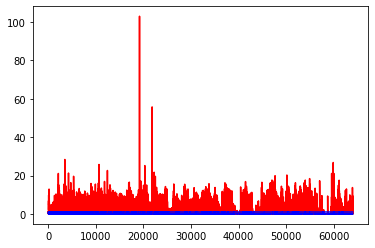

white ratio : 47.25
min : 180
max : 221


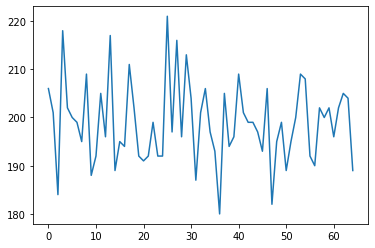

Generating interpolations...
64001 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.001383, 0.003355]
64002 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000043, 0.000009]
64003 [D loss: 0.000358, acc.: 100.00%] [G loss: 2.819144, 1.558561]
64004 [D loss: 0.000951, acc.: 100.00%] [G loss: 2.060315, 2.060914]
64005 [D loss: 0.000284, acc.: 100.00%] [G loss: 8.400949, 6.342419]
64006 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.050082, 0.110073]
64007 [D loss: 0.000646, acc.: 100.00%] [G loss: 0.110234, 0.026714]
64008 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.131930, 2.344006]
64009 [D loss: 0.000632, acc.: 100.00%] [G loss: 0.128614, 0.196980]
64010 [D loss: 0.000988, acc.: 100.00%] [G loss: 0.239912, 0.589967]
64011 [D loss: 0.000099, acc.: 100.00%] [G loss: 1.895993, 2.069220]
64012 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.211042, 0.434980]
64013 [D loss: 0.000966, acc.: 100.00%] [G loss: 2.248014, 1.223435]
64014 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.988788, 1.132866]
64015

64122 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.002068, 0.000928]
64123 [D loss: 0.004382, acc.: 100.00%] [G loss: 0.010440, 0.041801]
64124 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.018783, 0.242798]
64125 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.286161, 0.020646]
64126 [D loss: 0.000075, acc.: 100.00%] [G loss: 2.813388, 1.919178]
64127 [D loss: 0.035487, acc.: 96.88%] [G loss: 0.000024, 0.000128]
64128 [D loss: 0.000536, acc.: 100.00%] [G loss: 0.001152, 0.001562]
64129 [D loss: 0.000767, acc.: 100.00%] [G loss: 0.000022, 0.000034]
64130 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000001]
64131 [D loss: 0.000680, acc.: 100.00%] [G loss: 5.166200, 0.728837]
64132 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.003768, 0.000940]
64133 [D loss: 0.000145, acc.: 100.00%] [G loss: 1.499209, 0.958071]
64134 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.599474, 0.767823]
64135 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.531535, 0.462735]
64136 [D loss: 0.000465, acc.: 100.

64243 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.787079, 0.158416]
64244 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.002237, 0.000223]
64245 [D loss: 0.000371, acc.: 100.00%] [G loss: 0.002387, 0.001894]
64246 [D loss: 0.003809, acc.: 100.00%] [G loss: 3.345199, 2.256003]
64247 [D loss: 0.002561, acc.: 100.00%] [G loss: 0.000462, 0.000085]
64248 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.062241, 0.025247]
64249 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.002467, 0.000312]
64250 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.047733, 0.015905]
64251 [D loss: 0.000182, acc.: 100.00%] [G loss: 0.610963, 1.022103]
64252 [D loss: 0.000453, acc.: 100.00%] [G loss: 5.267829, 5.187534]
64253 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.151850, 0.327718]
64254 [D loss: 0.000088, acc.: 100.00%] [G loss: 3.178592, 2.339337]
64255 [D loss: 0.000721, acc.: 100.00%] [G loss: 2.600153, 1.952882]
64256 [D loss: 0.001413, acc.: 100.00%] [G loss: 0.009041, 0.000172]
64257 [D loss: 0.001683, acc.: 100

64364 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000013, 0.000039]
64365 [D loss: 0.002369, acc.: 100.00%] [G loss: 0.011721, 0.007217]
64366 [D loss: 0.000121, acc.: 100.00%] [G loss: 2.495950, 2.471964]
64367 [D loss: 0.000492, acc.: 100.00%] [G loss: 0.000701, 0.001677]
64368 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.887680, 0.575434]
64369 [D loss: 0.001101, acc.: 100.00%] [G loss: 0.000244, 0.000137]
64370 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.021227, 0.007542]
64371 [D loss: 0.001715, acc.: 100.00%] [G loss: 0.003237, 0.012346]
64372 [D loss: 0.000603, acc.: 100.00%] [G loss: 0.799269, 0.406855]
64373 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000075, 0.005591]
64374 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.390675, 0.099526]
64375 [D loss: 0.000047, acc.: 100.00%] [G loss: 55.108643, 6.863363]
64376 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.440533, 6.052627]
64377 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.847609, 3.898328]
64378 [D loss: 0.000006, acc.: 10

64483 [D loss: 0.002061, acc.: 100.00%] [G loss: 4.967301, 0.377695]
64484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.147032, 0.018624]
64485 [D loss: 0.009291, acc.: 100.00%] [G loss: 0.091872, 0.064082]
64486 [D loss: 0.000319, acc.: 100.00%] [G loss: 1.098909, 0.206942]
64487 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.103440, 4.479024]
64488 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.001182, 0.003199]
64489 [D loss: 0.000642, acc.: 100.00%] [G loss: 4.493718, 3.478843]
64490 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.075009, 0.022220]
64491 [D loss: 0.000002, acc.: 100.00%] [G loss: 22.184715, 0.595365]
64492 [D loss: 0.000017, acc.: 100.00%] [G loss: 7.815243, 10.355396]
64493 [D loss: 0.000647, acc.: 100.00%] [G loss: 2.829406, 3.389283]
64494 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.927239, 9.154821]
64495 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.242335, 2.498056]
64496 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.381113, 2.796529]
64497 [D loss: 0.059256, acc.: 9

64604 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64605 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.675984, 0.001379]
64606 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000001]
64607 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000679, 0.000004]
64608 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.064220, 0.698183]
64609 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.893198, 0.344404]
64610 [D loss: 0.000259, acc.: 100.00%] [G loss: 0.012459, 0.000634]
64611 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.000183, 0.000012]
64612 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.155480, 0.048700]
64613 [D loss: 0.002087, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64614 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64615 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64616 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64617 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000004, 0.000000]
64618 [D loss: 0.000181, acc.: 100

64723 [D loss: 0.000066, acc.: 100.00%] [G loss: 1.853021, 1.993481]
64724 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.055994, 0.065550]
64725 [D loss: 0.000596, acc.: 100.00%] [G loss: 0.072675, 0.115120]
64726 [D loss: 0.000596, acc.: 100.00%] [G loss: 0.000001, 0.000002]
64727 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000009, 0.000172]
64728 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000001, 0.000006]
64729 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000783, 0.007272]
64730 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.008623, 0.000329]
64731 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64732 [D loss: 0.000927, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64733 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.667889, 0.613166]
64734 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.001647, 0.000003]
64735 [D loss: 0.001200, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64736 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.110592, 0.001126]
64737 [D loss: 0.000188, acc.: 100

64843 [D loss: 0.038937, acc.: 96.88%] [G loss: 0.248022, 0.025583]
64844 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.001945, 0.102151]
64845 [D loss: 0.001415, acc.: 100.00%] [G loss: 0.000000, 0.000002]
64846 [D loss: 0.001148, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64847 [D loss: 0.000313, acc.: 100.00%] [G loss: 0.000420, 0.000007]
64848 [D loss: 0.001260, acc.: 100.00%] [G loss: 0.000474, 0.001615]
64849 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64850 [D loss: 0.000669, acc.: 100.00%] [G loss: 0.000632, 0.004945]
64851 [D loss: 0.000524, acc.: 100.00%] [G loss: 0.000007, 0.000000]
64852 [D loss: 0.000771, acc.: 100.00%] [G loss: 0.054194, 0.037918]
64853 [D loss: 0.004143, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64854 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.000000, 0.000000]
64855 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000001, 0.000000]
64856 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.004319, 0.000192]
64857 [D loss: 0.000035, acc.: 100.

64964 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.000000, 0.000002]
64965 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000055, 0.000360]
64966 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.093966, 0.005500]
64967 [D loss: 0.000324, acc.: 100.00%] [G loss: 1.118809, 0.630496]
64968 [D loss: 0.003460, acc.: 100.00%] [G loss: 0.000000, 0.000001]
64969 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.000262, 0.000003]
64970 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.507233, 0.482116]
64971 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.036539, 0.013201]
64972 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.135622, 0.049392]
64973 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.010937, 0.002340]
64974 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000064, 0.000000]
64975 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000536, 0.001608]
64976 [D loss: 0.003893, acc.: 100.00%] [G loss: 0.000054, 0.010387]
64977 [D loss: 0.000171, acc.: 100.00%] [G loss: 4.583062, 0.000381]
64978 [D loss: 0.018597, acc.: 100

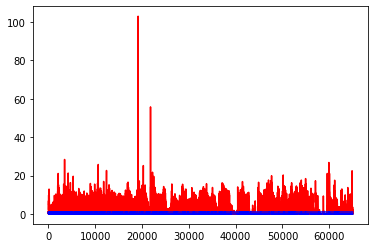

white ratio : 51.0
min : 180
max : 221


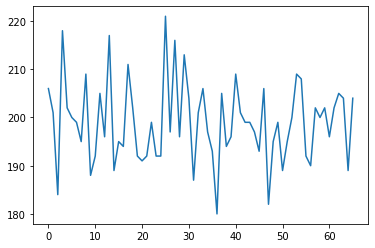

Generating interpolations...
65001 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.014505, 0.014737]
65002 [D loss: 0.000259, acc.: 100.00%] [G loss: 0.012609, 0.008157]
65003 [D loss: 0.000889, acc.: 100.00%] [G loss: 0.012247, 0.291652]
65004 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000004, 0.000524]
65005 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.017140, 0.017048]
65006 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.526566, 1.678228]
65007 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.347358, 0.929997]
65008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.020336, 0.002422]
65009 [D loss: 0.134667, acc.: 93.75%] [G loss: 0.003012, 0.017871]
65010 [D loss: 0.003071, acc.: 100.00%] [G loss: 0.006450, 0.015125]
65011 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.196622, 0.004493]
65012 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000004, 0.000021]
65013 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.001215, 0.005951]
65014 [D loss: 0.000488, acc.: 100.00%] [G loss: 0.039638, 0.000157]
65015 

65117 [D loss: 0.000396, acc.: 100.00%] [G loss: 0.449059, 0.292125]
65118 [D loss: 0.000065, acc.: 100.00%] [G loss: 1.412315, 1.678939]
65119 [D loss: 0.000892, acc.: 100.00%] [G loss: 0.000394, 0.001058]
65120 [D loss: 0.000816, acc.: 100.00%] [G loss: 0.007845, 0.000059]
65121 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.000434, 0.003373]
65122 [D loss: 0.037494, acc.: 96.88%] [G loss: 0.000005, 0.000033]
65123 [D loss: 0.004061, acc.: 100.00%] [G loss: 0.026264, 0.000280]
65124 [D loss: 0.000332, acc.: 100.00%] [G loss: 0.000334, 0.001456]
65125 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.102566, 0.223842]
65126 [D loss: 0.002132, acc.: 100.00%] [G loss: 0.039228, 0.000432]
65127 [D loss: 0.001654, acc.: 100.00%] [G loss: 0.021072, 0.010549]
65128 [D loss: 0.001184, acc.: 100.00%] [G loss: 0.000009, 0.000013]
65129 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.978748, 0.820152]
65130 [D loss: 0.007094, acc.: 100.00%] [G loss: 0.659450, 0.705884]
65131 [D loss: 0.001414, acc.: 100.

65236 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.000006, 0.000001]
65237 [D loss: 0.000571, acc.: 100.00%] [G loss: 0.000001, 0.000001]
65238 [D loss: 0.002811, acc.: 100.00%] [G loss: 0.177324, 0.247441]
65239 [D loss: 0.000378, acc.: 100.00%] [G loss: 0.001040, 0.000117]
65240 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.015021, 0.120130]
65241 [D loss: 0.002351, acc.: 100.00%] [G loss: 0.010593, 0.006294]
65242 [D loss: 0.000386, acc.: 100.00%] [G loss: 0.000460, 0.000417]
65243 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.035882, 0.007529]
65244 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65245 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000002, 0.000124]
65246 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000109, 0.000027]
65247 [D loss: 0.007755, acc.: 100.00%] [G loss: 0.000000, 0.000004]
65248 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.007254, 0.010195]
65249 [D loss: 0.000209, acc.: 100.00%] [G loss: 0.001246, 0.010656]
65250 [D loss: 0.001650, acc.: 100

65358 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65359 [D loss: 0.002243, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65360 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.004865, 0.000013]
65361 [D loss: 0.005428, acc.: 100.00%] [G loss: 0.000056, 0.000007]
65362 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000074, 0.001168]
65363 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000001, 0.000000]
65364 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.024931, 0.050895]
65365 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000152, 0.001043]
65366 [D loss: 0.000478, acc.: 100.00%] [G loss: 0.000002, 0.000273]
65367 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000489, 0.000287]
65368 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003839, 0.000638]
65369 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65370 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000003, 0.005118]
65371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000668, 0.000253]
65372 [D loss: 0.000001, acc.: 100

65477 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.446991, 4.789230]
65478 [D loss: 0.000035, acc.: 100.00%] [G loss: 7.805027, 7.992639]
65479 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.582839, 6.479795]
65480 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.714479, 4.912581]
65481 [D loss: 0.000022, acc.: 100.00%] [G loss: 5.354278, 3.345944]
65482 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.520059, 1.496141]
65483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.646019, 0.496993]
65484 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.879730, 1.052978]
65485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.232853, 0.129263]
65486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.998014, 0.327336]
65487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.399737, 0.015484]
65488 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.283818, 0.517536]
65489 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.478421, 1.152300]
65490 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.002013, 0.001409]
65491 [D loss: 0.000139, acc.: 100

65598 [D loss: 0.000468, acc.: 100.00%] [G loss: 0.207774, 0.364374]
65599 [D loss: 0.000958, acc.: 100.00%] [G loss: 0.360603, 0.704902]
65600 [D loss: 0.000511, acc.: 100.00%] [G loss: 0.000049, 0.000012]
65601 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.099544, 0.101734]
65602 [D loss: 0.037606, acc.: 96.88%] [G loss: 0.015915, 0.002645]
65603 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.576280, 1.138147]
65604 [D loss: 0.018180, acc.: 100.00%] [G loss: 0.249916, 0.070365]
65605 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001004, 0.001079]
65606 [D loss: 0.001044, acc.: 100.00%] [G loss: 0.010307, 0.001953]
65607 [D loss: 0.002929, acc.: 100.00%] [G loss: 0.000038, 0.000383]
65608 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000026, 0.000008]
65609 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.000696, 0.000013]
65610 [D loss: 0.002131, acc.: 100.00%] [G loss: 0.148538, 0.418957]
65611 [D loss: 0.000758, acc.: 100.00%] [G loss: 0.194588, 0.347040]
65612 [D loss: 0.000242, acc.: 100.

65717 [D loss: 0.006201, acc.: 100.00%] [G loss: 0.000826, 0.009694]
65718 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.053886, 0.280539]
65719 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000007, 0.000001]
65720 [D loss: 0.000750, acc.: 100.00%] [G loss: 0.000960, 0.000427]
65721 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000366, 0.000006]
65722 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000980, 0.024904]
65723 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65724 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.237297, 0.033392]
65725 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.002165, 0.000152]
65726 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000176, 0.000002]
65727 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000056, 0.000018]
65728 [D loss: 0.000492, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65729 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000123]
65730 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65731 [D loss: 0.000027, acc.: 100

65837 [D loss: 0.000350, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65838 [D loss: 0.000672, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65839 [D loss: 0.000383, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65841 [D loss: 0.000894, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65842 [D loss: 0.002603, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65843 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65844 [D loss: 0.000850, acc.: 100.00%] [G loss: 0.000000, 0.000017]
65845 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65846 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65847 [D loss: 0.012248, acc.: 100.00%] [G loss: 0.000022, 0.004513]
65848 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.244752, 0.000000]
65849 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65850 [D loss: 0.000672, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65851 [D loss: 0.000042, acc.: 100

65958 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65959 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000003]
65960 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000006, 0.000004]
65961 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65962 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.074599, 0.136817]
65963 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65964 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
65965 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.001422, 0.000002]
65966 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000366, 0.000022]
65967 [D loss: 0.000641, acc.: 100.00%] [G loss: 0.000000, 0.000001]
65968 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.000001, 0.000000]
65969 [D loss: 0.000010, acc.: 100.00%] [G loss: 5.199982, 0.137076]
65970 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000285, 0.012303]
65971 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000006, 0.011783]
65972 [D loss: 0.002240, acc.: 100

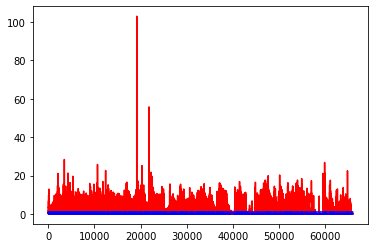

white ratio : 52.25
min : 180
max : 221


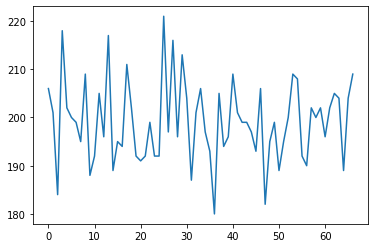

Generating interpolations...
66001 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.405818, 0.017540]
66002 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.201868, 0.253728]
66003 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000087, 0.035316]
66004 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.000975, 0.001193]
66005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.276137, 0.139581]
66006 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.119137, 0.009028]
66007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.094020, 0.069392]
66008 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000531, 0.030853]
66009 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.018677, 0.000103]
66010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001248, 0.000129]
66011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66012 [D loss: 0.000566, acc.: 100.00%] [G loss: 0.000004, 0.000007]
66013 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000335, 0.002017]
66014 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.002367, 0.000000]
66015

66121 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.032855, 0.000048]
66122 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.051683, 1.936768]
66123 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000054, 0.000000]
66124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.165449, 0.237322]
66125 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.004086, 0.000382]
66126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004257, 0.195843]
66127 [D loss: 0.000358, acc.: 100.00%] [G loss: 0.009770, 0.006628]
66128 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001861, 0.225646]
66129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.061168, 0.138482]
66130 [D loss: 0.000335, acc.: 100.00%] [G loss: 0.258915, 0.010221]
66131 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000001, 0.000005]
66132 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.017440, 0.097086]
66133 [D loss: 0.000311, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66134 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.000307, 0.010576]
66135 [D loss: 0.000367, acc.: 100

66243 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.151080, 0.015005]
66244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039884, 0.029765]
66245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000211, 0.000012]
66246 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000002, 0.000000]
66247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.060929, 0.002195]
66248 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.300501, 0.260895]
66249 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.306340, 0.551189]
66250 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.123556, 0.831934]
66251 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.329257, 0.027142]
66252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019869, 0.000027]
66253 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000010, 0.000011]
66254 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.448635, 0.203101]
66255 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.004362, 0.030620]
66256 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.003954, 0.123127]
66257 [D loss: 0.000021, acc.: 100

66365 [D loss: 0.169383, acc.: 96.88%] [G loss: 0.000003, 0.000000]
66366 [D loss: 0.001231, acc.: 100.00%] [G loss: 0.000005, 0.000009]
66367 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66368 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66369 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66370 [D loss: 0.002859, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66371 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000001, 0.000004]
66372 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000695, 0.001633]
66373 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.000096, 0.000056]
66374 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66375 [D loss: 0.000302, acc.: 100.00%] [G loss: 0.000000, 0.000076]
66376 [D loss: 0.000897, acc.: 100.00%] [G loss: 0.000003, 0.000033]
66377 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000001, 0.000001]
66378 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000009, 0.000000]
66379 [D loss: 0.000280, acc.: 100.

66484 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.000191, 0.001585]
66485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000046, 0.000265]
66486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000014, 0.000020]
66487 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.008686, 0.004161]
66488 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000004, 0.000000]
66489 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.022088, 0.055983]
66490 [D loss: 0.000352, acc.: 100.00%] [G loss: 0.000450, 0.090257]
66491 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.016792, 0.000012]
66492 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000045]
66493 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000016, 0.000003]
66494 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000230, 0.000052]
66495 [D loss: 0.001019, acc.: 100.00%] [G loss: 0.000002, 0.000051]
66496 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66497 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66498 [D loss: 0.000002, acc.: 100

66604 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66605 [D loss: 0.048576, acc.: 96.88%] [G loss: 0.000000, 0.000000]
66606 [D loss: 0.000640, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66607 [D loss: 0.005984, acc.: 100.00%] [G loss: 0.000000, 0.000056]
66608 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000013, 0.000004]
66609 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66610 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66611 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66612 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66613 [D loss: 0.000458, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66614 [D loss: 0.015490, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66615 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
66616 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000062, 0.000002]
66617 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.005006, 0.000005]
66618 [D loss: 0.000001, acc.: 100.

66723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000016, 0.000010]
66724 [D loss: 0.001440, acc.: 100.00%] [G loss: 0.000028, 0.009398]
66725 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66726 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.028697, 0.016979]
66727 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000066, 0.000027]
66728 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.023680, 0.009174]
66729 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66730 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000027, 0.000021]
66731 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000076, 0.000004]
66732 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.082095, 0.293577]
66733 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000002]
66734 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000484, 0.000229]
66735 [D loss: 0.002895, acc.: 100.00%] [G loss: 0.000001, 0.000000]
66736 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000001, 0.000000]
66737 [D loss: 0.000001, acc.: 100

66844 [D loss: 0.000656, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66845 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.359688, 0.000000]
66846 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000001, 0.000000]
66847 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000043, 0.000016]
66848 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.009088, 0.053862]
66849 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.113295, 0.000157]
66850 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.004378, 0.001805]
66851 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000220, 0.000005]
66852 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000000, 0.000001]
66853 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000024, 0.000005]
66854 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.000001]
66855 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000155]
66856 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.000031, 0.000001]
66857 [D loss: 0.000431, acc.: 100.00%] [G loss: 0.018268, 0.000611]
66858 [D loss: 0.000005, acc.: 100

66964 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66965 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66966 [D loss: 0.032833, acc.: 96.88%] [G loss: 0.000000, 0.000000]
66967 [D loss: 0.009541, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66968 [D loss: 0.001903, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66969 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66970 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66971 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66972 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66973 [D loss: 0.004780, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66974 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66975 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000088, 0.000122]
66976 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
66977 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000004, 0.000215]
66978 [D loss: 0.000019, acc.: 100.

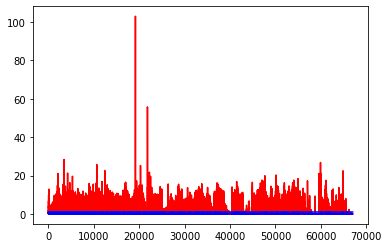

white ratio : 48.25
min : 180
max : 221


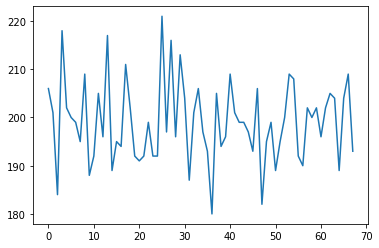

Generating interpolations...
67001 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000001, 0.000000]
67002 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67003 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.008082, 0.000002]
67005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67006 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000001, 0.000000]
67007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
67008 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000001]
67009 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.000000, 0.000001]
67010 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000002, 0.000012]
67011 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.000001, 0.000014]
67012 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67013 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67014 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67015

67122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000114]
67123 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000010, 0.000000]
67124 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67125 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67126 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000049, 0.000002]
67127 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.000035, 0.002120]
67128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67129 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000018, 0.000068]
67130 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000010, 0.000002]
67131 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000003, 0.000086]
67132 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000004, 0.000001]
67133 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67134 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
67135 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000006]
67136 [D loss: 0.000009, acc.: 100

67243 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000503, 0.000213]
67244 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.005204, 0.000000]
67245 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.011963, 0.033234]
67246 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000007, 0.000002]
67247 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67248 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67249 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67250 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000077, 0.000028]
67251 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000020, 0.000063]
67252 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000002, 0.000002]
67253 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000047, 0.000000]
67254 [D loss: 0.000749, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67255 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67256 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67257 [D loss: 0.000010, acc.: 100

67364 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67365 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67366 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67367 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000001, 0.000000]
67368 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67369 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67370 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67371 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67372 [D loss: 0.000741, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67373 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67374 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67375 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000002, 0.000002]
67376 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
67377 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67378 [D loss: 0.000029, acc.: 100

67484 [D loss: 0.168429, acc.: 93.75%] [G loss: 22.219654, 3.104905]
67485 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.579354, 7.428061]
67486 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.795067, 6.056504]
67487 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.033804, 9.978745]
67488 [D loss: 0.000197, acc.: 100.00%] [G loss: 6.156576, 4.998048]
67489 [D loss: 0.000215, acc.: 100.00%] [G loss: 15.153341, 12.263319]
67490 [D loss: 0.000042, acc.: 100.00%] [G loss: 8.994879, 7.763140]
67491 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.798267, 9.069592]
67492 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.385612, 5.739372]
67493 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.492691, 6.391551]
67494 [D loss: 0.000132, acc.: 100.00%] [G loss: 8.529819, 4.663539]
67495 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.395146, 6.026296]
67496 [D loss: 0.023039, acc.: 96.88%] [G loss: 2.832432, 1.753690]
67497 [D loss: 0.001860, acc.: 100.00%] [G loss: 0.713288, 1.074156]
67498 [D loss: 0.203418, acc.: 

67605 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.839764, 11.310795]
67606 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.265595, 10.121370]
67607 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.942776, 10.717616]
67608 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.225301, 8.415700]
67609 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.590209, 13.212236]
67610 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.439740, 6.847098]
67611 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.787095, 3.004324]
67612 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.511492, 8.578125]
67613 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.257551, 8.911494]
67614 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.205159, 2.041975]
67615 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.758643, 3.864766]
67616 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.315396, 2.228352]
67617 [D loss: 0.000029, acc.: 100.00%] [G loss: 1.864687, 1.257434]
67618 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.412632, 0.491645]
67619 [D loss: 0.001017, a

67727 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.178079, 0.000079]
67728 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000001, 0.000004]
67729 [D loss: 0.124929, acc.: 96.88%] [G loss: 0.000031, 0.000049]
67730 [D loss: 0.006601, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67731 [D loss: 0.001557, acc.: 100.00%] [G loss: 0.000000, 0.000014]
67732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.519558, 0.290037]
67733 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000002, 0.000002]
67734 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.001546, 0.010410]
67735 [D loss: 0.003985, acc.: 100.00%] [G loss: 0.009484, 0.010718]
67736 [D loss: 0.001892, acc.: 100.00%] [G loss: 0.000001, 0.000013]
67737 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.727417, 0.053091]
67738 [D loss: 0.008337, acc.: 100.00%] [G loss: 0.008152, 0.024433]
67739 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.001094, 0.002655]
67740 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.032991, 0.196272]
67741 [D loss: 0.000010, acc.: 100.

67847 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000046, 0.000211]
67848 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003312, 0.000350]
67849 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.034842, 0.001447]
67850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.644015, 0.000029]
67851 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000015, 0.002035]
67852 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.514070, 0.466832]
67853 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.960153, 0.700555]
67854 [D loss: 0.006951, acc.: 100.00%] [G loss: 0.000160, 0.000179]
67855 [D loss: 0.000727, acc.: 100.00%] [G loss: 1.244631, 0.062965]
67856 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000001]
67857 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.575540, 0.189376]
67858 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.002532, 0.002973]
67859 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.006479, 0.001252]
67860 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000003, 0.000055]
67861 [D loss: 0.000096, acc.: 100

67968 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.030415, 0.019900]
67969 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000645, 0.005439]
67970 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
67971 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005201, 0.001887]
67972 [D loss: 0.000934, acc.: 100.00%] [G loss: 0.000124, 0.000002]
67973 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000367, 0.000002]
67974 [D loss: 0.000316, acc.: 100.00%] [G loss: 0.001991, 0.000376]
67975 [D loss: 0.000013, acc.: 100.00%] [G loss: 8.464432, 2.284209]
67976 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.131961, 0.504250]
67977 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.015894, 0.074951]
67978 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.024261, 0.072676]
67979 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.140307, 0.001433]
67980 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.177549, 0.285028]
67981 [D loss: 0.000363, acc.: 100.00%] [G loss: 0.442799, 0.122933]
67982 [D loss: 0.000117, acc.: 100

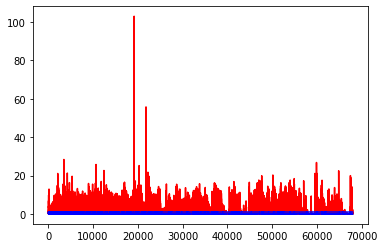

white ratio : 50.25
min : 180
max : 221


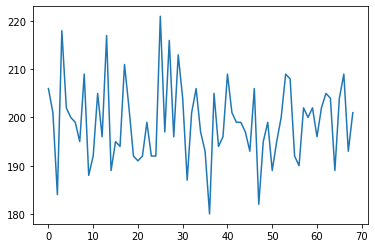

Generating interpolations...
68001 [D loss: 0.003721, acc.: 100.00%] [G loss: 0.000090, 0.000002]
68002 [D loss: 0.002193, acc.: 100.00%] [G loss: 0.000005, 0.000017]
68003 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
68004 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000001, 0.000001]
68005 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.007215, 0.023687]
68006 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000000]
68007 [D loss: 0.000446, acc.: 100.00%] [G loss: 0.000000, 0.000001]
68008 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000026, 0.000004]
68009 [D loss: 0.016390, acc.: 100.00%] [G loss: 0.000158, 0.000030]
68010 [D loss: 0.000428, acc.: 100.00%] [G loss: 0.000097, 0.000361]
68011 [D loss: 0.000335, acc.: 100.00%] [G loss: 0.042848, 0.386674]
68012 [D loss: 0.007860, acc.: 100.00%] [G loss: 0.000300, 0.000151]
68013 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.000002, 0.000001]
68014 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000001, 0.000004]
68015

68122 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.021876, 0.074059]
68123 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.063851, 0.137177]
68124 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.364032, 0.168665]
68125 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.037757, 0.111857]
68126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000007, 0.000036]
68127 [D loss: 0.000996, acc.: 100.00%] [G loss: 0.031558, 0.003491]
68128 [D loss: 0.000273, acc.: 100.00%] [G loss: 0.093306, 0.189560]
68129 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000058, 0.000060]
68130 [D loss: 0.000475, acc.: 100.00%] [G loss: 0.000944, 0.001522]
68131 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.001038, 0.000284]
68132 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.090717, 0.094726]
68133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000104]
68134 [D loss: 0.011401, acc.: 100.00%] [G loss: 6.375083, 0.000068]
68135 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.096833, 0.364034]
68136 [D loss: 0.000000, acc.: 100

68242 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000292, 0.005635]
68243 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.000029, 0.000272]
68244 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.001260, 0.000015]
68245 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.004035, 0.003550]
68246 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000686, 0.003290]
68247 [D loss: 0.004710, acc.: 100.00%] [G loss: 0.001101, 0.005386]
68248 [D loss: 0.000418, acc.: 100.00%] [G loss: 0.060765, 0.191472]
68249 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001035, 0.000011]
68250 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.008783, 0.084705]
68251 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000100, 0.000257]
68252 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.055318, 0.102630]
68253 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.001147, 0.001275]
68254 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.001317, 0.000095]
68255 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.050951, 0.008896]
68256 [D loss: 0.000008, acc.: 100

68361 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000128, 0.000030]
68362 [D loss: 0.006201, acc.: 100.00%] [G loss: 0.287380, 0.110710]
68363 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.002825, 0.004524]
68364 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.067343, 0.175876]
68365 [D loss: 0.000376, acc.: 100.00%] [G loss: 0.283065, 0.534271]
68366 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.001331, 0.000638]
68367 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.003060, 0.005682]
68368 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.086435, 0.213734]
68369 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.001947, 0.000092]
68370 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.224519, 0.005888]
68371 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.061651, 0.095278]
68372 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.018091, 0.017831]
68373 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.023258, 0.009090]
68374 [D loss: 0.001653, acc.: 100.00%] [G loss: 0.043209, 0.101368]
68375 [D loss: 0.000219, acc.: 100

68480 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.000497, 0.002872]
68481 [D loss: 0.001366, acc.: 100.00%] [G loss: 0.428776, 0.160903]
68482 [D loss: 0.001266, acc.: 100.00%] [G loss: 0.290641, 0.046112]
68483 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.001378, 0.000248]
68484 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.125731, 0.099209]
68485 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.715505, 0.900395]
68486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.467329, 0.158147]
68487 [D loss: 0.000017, acc.: 100.00%] [G loss: 7.974401, 1.329502]
68488 [D loss: 0.004856, acc.: 100.00%] [G loss: 4.334349, 3.387719]
68489 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.033259, 0.008234]
68490 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.132701, 0.013956]
68491 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.015870, 0.077890]
68492 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.072892, 0.043320]
68493 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.051296, 0.169889]
68494 [D loss: 0.000098, acc.: 100

68599 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.238148, 0.340215]
68600 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.000009, 0.000020]
68601 [D loss: 0.003033, acc.: 100.00%] [G loss: 0.000206, 0.000297]
68602 [D loss: 0.000532, acc.: 100.00%] [G loss: 0.004482, 0.019499]
68603 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.009840, 0.008840]
68604 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.076706, 0.008063]
68605 [D loss: 0.000984, acc.: 100.00%] [G loss: 0.001242, 0.021863]
68606 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.005337, 0.023818]
68607 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.385294, 0.174795]
68608 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.000747, 0.000622]
68609 [D loss: 0.000527, acc.: 100.00%] [G loss: 0.000169, 0.001915]
68610 [D loss: 0.000480, acc.: 100.00%] [G loss: 0.128398, 0.037778]
68611 [D loss: 0.001272, acc.: 100.00%] [G loss: 0.156470, 0.156425]
68612 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.004117, 0.012903]
68613 [D loss: 0.060335, acc.: 96.

68718 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.198831, 0.051062]
68719 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.980759, 0.454446]
68720 [D loss: 0.184920, acc.: 96.88%] [G loss: 0.000287, 0.110960]
68721 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.000541, 0.001590]
68722 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.000016, 0.000012]
68723 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.002596, 0.001000]
68724 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000000, 0.000000]
68725 [D loss: 0.000667, acc.: 100.00%] [G loss: 0.001199, 0.000011]
68726 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.003707, 0.044171]
68727 [D loss: 0.000169, acc.: 100.00%] [G loss: 2.285597, 0.032895]
68728 [D loss: 0.000404, acc.: 100.00%] [G loss: 0.143886, 1.095353]
68729 [D loss: 0.000146, acc.: 100.00%] [G loss: 7.279933, 6.200542]
68730 [D loss: 0.000053, acc.: 100.00%] [G loss: 1.303303, 0.801090]
68731 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.036238, 0.697123]
68732 [D loss: 0.000298, acc.: 100.

68838 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000072, 0.000010]
68839 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000019]
68840 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.007001, 0.001857]
68841 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000063, 0.000128]
68842 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
68843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
68844 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000002, 0.000000]
68845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
68846 [D loss: 0.000644, acc.: 100.00%] [G loss: 0.008096, 0.069671]
68847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
68848 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
68849 [D loss: 0.000639, acc.: 100.00%] [G loss: 0.000094, 0.002350]
68850 [D loss: 0.000611, acc.: 100.00%] [G loss: 0.000000, 0.000000]
68851 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.000001, 0.000001]
68852 [D loss: 0.000060, acc.: 100

68959 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.182000, 0.000001]
68960 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.029325, 0.000279]
68961 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000005, 0.000068]
68962 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000256, 0.050934]
68963 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.161172, 0.090708]
68964 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000608, 0.007201]
68965 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000188, 0.000758]
68966 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.020986, 0.002216]
68967 [D loss: 0.000113, acc.: 100.00%] [G loss: 9.520151, 1.874803]
68968 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.064899, 0.010853]
68969 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.501990, 0.435850]
68970 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.021166, 0.001830]
68971 [D loss: 0.095201, acc.: 96.88%] [G loss: 0.000065, 0.000002]
68972 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.018289, 0.000126]
68973 [D loss: 0.000058, acc.: 100.

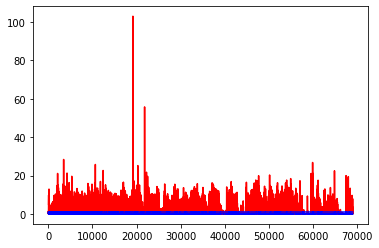

white ratio : 52.25
min : 180
max : 221


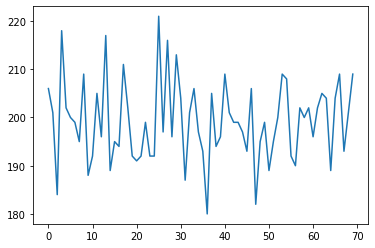

Generating interpolations...
69001 [D loss: 0.000271, acc.: 100.00%] [G loss: 3.188127, 2.497654]
69002 [D loss: 0.000027, acc.: 100.00%] [G loss: 3.837272, 2.773496]
69003 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.083002, 0.000170]
69004 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.215533, 0.030646]
69005 [D loss: 0.000222, acc.: 100.00%] [G loss: 0.394583, 0.206231]
69006 [D loss: 0.002631, acc.: 100.00%] [G loss: 0.085280, 0.023345]
69007 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.620889, 0.096859]
69008 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.043918, 0.312380]
69009 [D loss: 0.000443, acc.: 100.00%] [G loss: 1.161655, 0.557181]
69010 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.600909, 0.700645]
69011 [D loss: 0.000241, acc.: 100.00%] [G loss: 0.407391, 0.040349]
69012 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.003024, 0.001490]
69013 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000050, 0.005416]
69014 [D loss: 0.000394, acc.: 100.00%] [G loss: 0.009997, 0.000028]
69015

69121 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.002502, 0.001936]
69122 [D loss: 0.000490, acc.: 100.00%] [G loss: 1.946065, 0.991993]
69123 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.571833, 0.357242]
69124 [D loss: 0.000504, acc.: 100.00%] [G loss: 18.426785, 2.422688]
69125 [D loss: 0.000288, acc.: 100.00%] [G loss: 4.852239, 4.618727]
69126 [D loss: 0.073380, acc.: 96.88%] [G loss: 0.909820, 1.155428]
69127 [D loss: 0.000738, acc.: 100.00%] [G loss: 0.170223, 0.313609]
69128 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.510489, 3.362369]
69129 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.795885, 0.333288]
69130 [D loss: 0.000162, acc.: 100.00%] [G loss: 1.415984, 1.008992]
69131 [D loss: 0.005764, acc.: 100.00%] [G loss: 0.058384, 0.016967]
69132 [D loss: 0.003073, acc.: 100.00%] [G loss: 0.559957, 0.252766]
69133 [D loss: 0.002458, acc.: 100.00%] [G loss: 0.016306, 0.170523]
69134 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.093412, 0.130247]
69135 [D loss: 0.000217, acc.: 100

69241 [D loss: 0.002013, acc.: 100.00%] [G loss: 3.279331, 0.170700]
69242 [D loss: 0.006286, acc.: 100.00%] [G loss: 34.953026, 4.004977]
69243 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.204758, 3.782670]
69244 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.608476, 1.136609]
69245 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.982928, 2.110307]
69246 [D loss: 0.000011, acc.: 100.00%] [G loss: 3.742135, 1.670722]
69247 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.033200, 3.028310]
69248 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.038747, 2.072363]
69249 [D loss: 0.000117, acc.: 100.00%] [G loss: 1.816186, 0.258677]
69250 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.969469, 1.794919]
69251 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.930970, 8.587181]
69252 [D loss: 0.000074, acc.: 100.00%] [G loss: 3.988101, 2.637322]
69253 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.988133, 0.472598]
69254 [D loss: 0.000171, acc.: 100.00%] [G loss: 1.847435, 0.676818]
69255 [D loss: 0.000002, acc.: 10

69361 [D loss: 0.000041, acc.: 100.00%] [G loss: 12.925745, 12.856110]
69362 [D loss: 0.000004, acc.: 100.00%] [G loss: 15.389853, 15.281249]
69363 [D loss: 0.000005, acc.: 100.00%] [G loss: 11.532063, 12.157457]
69364 [D loss: 0.003078, acc.: 100.00%] [G loss: 11.597494, 10.549374]
69365 [D loss: 0.000015, acc.: 100.00%] [G loss: 15.851564, 10.308634]
69366 [D loss: 0.000051, acc.: 100.00%] [G loss: 5.327392, 5.131863]
69367 [D loss: 0.000012, acc.: 100.00%] [G loss: 8.584961, 8.301290]
69368 [D loss: 0.000009, acc.: 100.00%] [G loss: 10.881254, 10.066316]
69369 [D loss: 0.378403, acc.: 96.88%] [G loss: 3.036199, 2.028315]
69370 [D loss: 0.000104, acc.: 100.00%] [G loss: 2.778920, 2.127582]
69371 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.067958, 0.046274]
69372 [D loss: 0.000944, acc.: 100.00%] [G loss: 0.560776, 0.275185]
69373 [D loss: 0.000339, acc.: 100.00%] [G loss: 1.026093, 0.921897]
69374 [D loss: 0.000739, acc.: 100.00%] [G loss: 1.146436, 0.667930]
69375 [D loss: 0.000045

69481 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.000962, 0.009061]
69482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.041922, 0.054985]
69483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002010, 0.046375]
69484 [D loss: 0.000647, acc.: 100.00%] [G loss: 0.033624, 0.021372]
69485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002471, 0.053350]
69486 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000163, 0.000036]
69487 [D loss: 0.000865, acc.: 100.00%] [G loss: 0.000105, 0.000031]
69488 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.000153, 0.000566]
69489 [D loss: 0.002249, acc.: 100.00%] [G loss: 0.383517, 0.004634]
69490 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000026, 0.000112]
69491 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.000017, 0.000000]
69492 [D loss: 0.000139, acc.: 100.00%] [G loss: 12.996086, 2.079302]
69493 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.058419, 0.200805]
69494 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.118832, 1.776928]
69495 [D loss: 0.000010, acc.: 1

69600 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.000007, 0.000002]
69601 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.000012, 0.000001]
69602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000000]
69603 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000161, 0.000040]
69604 [D loss: 0.000171, acc.: 100.00%] [G loss: 1.473261, 0.842222]
69605 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000006, 0.000005]
69606 [D loss: 0.000255, acc.: 100.00%] [G loss: 0.000004, 0.000001]
69607 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000032, 0.000025]
69608 [D loss: 0.001436, acc.: 100.00%] [G loss: 0.000413, 0.003324]
69609 [D loss: 0.000483, acc.: 100.00%] [G loss: 0.192069, 0.003618]
69610 [D loss: 0.000134, acc.: 100.00%] [G loss: 6.289125, 6.532762]
69611 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.004491, 0.000122]
69612 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.015024, 0.096018]
69613 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006223, 0.001964]
69614 [D loss: 0.000023, acc.: 100

69722 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.089607, 0.024813]
69723 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.530481, 4.198170]
69724 [D loss: 0.151741, acc.: 96.88%] [G loss: 0.617996, 0.115495]
69725 [D loss: 0.000039, acc.: 100.00%] [G loss: 1.805957, 2.148898]
69726 [D loss: 0.001623, acc.: 100.00%] [G loss: 0.000334, 0.000024]
69727 [D loss: 0.000901, acc.: 100.00%] [G loss: 0.000007, 0.000124]
69728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
69729 [D loss: 0.004960, acc.: 100.00%] [G loss: 0.000000, 0.017043]
69730 [D loss: 0.000716, acc.: 100.00%] [G loss: 0.736278, 0.000002]
69731 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.216448, 0.041708]
69732 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000034, 0.000025]
69733 [D loss: 0.000255, acc.: 100.00%] [G loss: 0.000015, 0.000257]
69734 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000046, 0.000006]
69735 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.174624, 0.020171]
69736 [D loss: 0.000187, acc.: 100.

69841 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.252185, 0.347040]
69842 [D loss: 0.000307, acc.: 100.00%] [G loss: 6.399891, 6.708002]
69843 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.549698, 1.036814]
69844 [D loss: 0.000069, acc.: 100.00%] [G loss: 5.149867, 5.889745]
69845 [D loss: 0.000545, acc.: 100.00%] [G loss: 0.742360, 0.415876]
69846 [D loss: 0.000148, acc.: 100.00%] [G loss: 3.839452, 3.015815]
69847 [D loss: 0.000050, acc.: 100.00%] [G loss: 1.056708, 0.585533]
69848 [D loss: 0.000509, acc.: 100.00%] [G loss: 0.851710, 0.704385]
69849 [D loss: 0.000909, acc.: 100.00%] [G loss: 4.370704, 3.523495]
69850 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.150878, 0.360353]
69851 [D loss: 0.000998, acc.: 100.00%] [G loss: 0.000000, 0.000000]
69852 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.080916, 0.000206]
69853 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.277854, 0.151299]
69854 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
69855 [D loss: 0.000136, acc.: 100

69961 [D loss: 0.000194, acc.: 100.00%] [G loss: 3.050317, 3.115492]
69962 [D loss: 0.000017, acc.: 100.00%] [G loss: 6.517479, 5.520224]
69963 [D loss: 0.000051, acc.: 100.00%] [G loss: 8.400622, 8.953435]
69964 [D loss: 0.000864, acc.: 100.00%] [G loss: 6.119967, 5.612915]
69965 [D loss: 0.000047, acc.: 100.00%] [G loss: 7.635840, 7.317374]
69966 [D loss: 0.000320, acc.: 100.00%] [G loss: 8.709194, 7.302401]
69967 [D loss: 0.000181, acc.: 100.00%] [G loss: 4.634861, 5.341415]
69968 [D loss: 0.001230, acc.: 100.00%] [G loss: 0.001735, 0.147597]
69969 [D loss: 0.000852, acc.: 100.00%] [G loss: 4.488836, 4.807786]
69970 [D loss: 0.000407, acc.: 100.00%] [G loss: 0.674087, 0.023084]
69971 [D loss: 0.001803, acc.: 100.00%] [G loss: 0.183641, 0.012884]
69972 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.137902, 0.447808]
69973 [D loss: 0.000077, acc.: 100.00%] [G loss: 6.317302, 6.816044]
69974 [D loss: 0.000575, acc.: 100.00%] [G loss: 9.338764, 7.826222]
69975 [D loss: 0.000450, acc.: 100

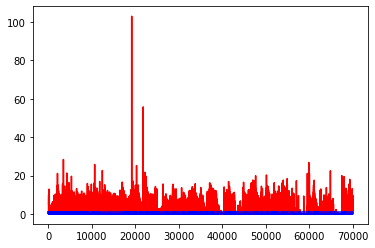

white ratio : 52.25
min : 180
max : 221


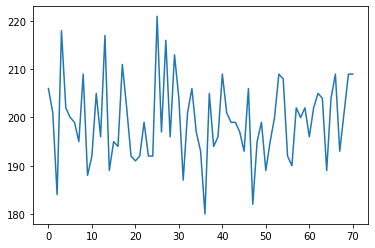

Generating interpolations...
70001 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.791968, 8.887243]
70002 [D loss: 0.000014, acc.: 100.00%] [G loss: 9.742785, 9.743050]
70003 [D loss: 0.001326, acc.: 100.00%] [G loss: 7.242020, 6.672225]
70004 [D loss: 0.000116, acc.: 100.00%] [G loss: 1.312507, 1.102143]
70005 [D loss: 0.000351, acc.: 100.00%] [G loss: 3.550053, 2.198383]
70006 [D loss: 0.000323, acc.: 100.00%] [G loss: 1.235072, 1.025859]
70007 [D loss: 0.000103, acc.: 100.00%] [G loss: 5.463155, 4.969125]
70008 [D loss: 0.000094, acc.: 100.00%] [G loss: 4.445958, 0.158561]
70009 [D loss: 0.000063, acc.: 100.00%] [G loss: 2.373262, 1.778982]
70010 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.618316, 1.978892]
70011 [D loss: 0.000018, acc.: 100.00%] [G loss: 9.001821, 7.488733]
70012 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.272327, 3.697696]
70013 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.876478, 6.028381]
70014 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.206607, 3.576875]
70015

70119 [D loss: 0.000150, acc.: 100.00%] [G loss: 37.282757, 11.738474]
70120 [D loss: 0.000075, acc.: 100.00%] [G loss: 9.192402, 12.974662]
70121 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.679390, 3.272112]
70122 [D loss: 0.000044, acc.: 100.00%] [G loss: 3.511504, 4.175205]
70123 [D loss: 0.000008, acc.: 100.00%] [G loss: 13.523287, 13.347537]
70124 [D loss: 0.000028, acc.: 100.00%] [G loss: 10.155232, 9.784719]
70125 [D loss: 0.000210, acc.: 100.00%] [G loss: 9.791299, 8.596045]
70126 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.635903, 8.584710]
70127 [D loss: 0.000002, acc.: 100.00%] [G loss: 20.107162, 8.674030]
70128 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.506627, 0.628013]
70129 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.970730, 1.653841]
70130 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.696687, 7.081283]
70131 [D loss: 0.000019, acc.: 100.00%] [G loss: 6.765277, 5.403218]
70132 [D loss: 0.128989, acc.: 96.88%] [G loss: 0.002400, 0.003599]
70133 [D loss: 0.001579, acc

70239 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.259604, 5.183012]
70240 [D loss: 0.000054, acc.: 100.00%] [G loss: 5.841737, 5.265078]
70241 [D loss: 0.003244, acc.: 100.00%] [G loss: 0.000482, 0.001107]
70242 [D loss: 0.002052, acc.: 100.00%] [G loss: 0.059919, 0.031836]
70243 [D loss: 0.000256, acc.: 100.00%] [G loss: 9.905387, 8.525567]
70244 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000443, 0.002025]
70245 [D loss: 0.000667, acc.: 100.00%] [G loss: 0.004576, 0.023615]
70246 [D loss: 0.001044, acc.: 100.00%] [G loss: 0.006818, 0.035652]
70247 [D loss: 0.003079, acc.: 100.00%] [G loss: 0.074093, 0.077950]
70248 [D loss: 0.006696, acc.: 100.00%] [G loss: 0.416468, 0.650139]
70249 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.018986, 0.003170]
70250 [D loss: 0.000023, acc.: 100.00%] [G loss: 13.308628, 12.160195]
70251 [D loss: 0.001730, acc.: 100.00%] [G loss: 8.884289, 8.783606]
70252 [D loss: 0.000008, acc.: 100.00%] [G loss: 6.208909, 5.307978]
70253 [D loss: 0.000020, acc.: 1

70359 [D loss: 0.000022, acc.: 100.00%] [G loss: 5.131447, 4.743355]
70360 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.077023, 0.413802]
70361 [D loss: 0.000280, acc.: 100.00%] [G loss: 1.495127, 1.163826]
70362 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.352230, 0.407173]
70363 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.198254, 0.009235]
70364 [D loss: 0.000882, acc.: 100.00%] [G loss: 0.863115, 0.528107]
70365 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.145929, 0.188808]
70366 [D loss: 0.000153, acc.: 100.00%] [G loss: 16.396206, 1.289173]
70367 [D loss: 0.000182, acc.: 100.00%] [G loss: 0.103943, 0.684500]
70368 [D loss: 0.000114, acc.: 100.00%] [G loss: 10.207371, 5.256550]
70369 [D loss: 0.000101, acc.: 100.00%] [G loss: 1.968898, 1.366316]
70370 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.390197, 0.066094]
70371 [D loss: 0.000920, acc.: 100.00%] [G loss: 21.066723, 1.185983]
70372 [D loss: 0.000011, acc.: 100.00%] [G loss: 4.623174, 3.923005]
70373 [D loss: 0.000270, acc.: 

70479 [D loss: 0.000550, acc.: 100.00%] [G loss: 6.994066, 8.158675]
70480 [D loss: 0.000030, acc.: 100.00%] [G loss: 2.612438, 3.208532]
70481 [D loss: 0.000032, acc.: 100.00%] [G loss: 6.019261, 4.700105]
70482 [D loss: 0.000275, acc.: 100.00%] [G loss: 1.724151, 1.336869]
70483 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.311331, 1.834056]
70484 [D loss: 0.000044, acc.: 100.00%] [G loss: 5.346189, 6.066966]
70485 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.042170, 1.683542]
70486 [D loss: 0.002347, acc.: 100.00%] [G loss: 1.688824, 1.040950]
70487 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.898649, 1.103238]
70488 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.906009, 5.406688]
70489 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.759289, 0.510433]
70490 [D loss: 0.000012, acc.: 100.00%] [G loss: 6.778593, 3.233740]
70491 [D loss: 0.000017, acc.: 100.00%] [G loss: 3.933365, 3.289023]
70492 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.999642, 1.749063]
70493 [D loss: 0.000077, acc.: 100

70598 [D loss: 0.000038, acc.: 100.00%] [G loss: 5.525990, 4.597723]
70599 [D loss: 0.000060, acc.: 100.00%] [G loss: 3.051444, 1.133554]
70600 [D loss: 0.000045, acc.: 100.00%] [G loss: 2.389338, 1.008522]
70601 [D loss: 0.000078, acc.: 100.00%] [G loss: 27.260975, 4.583367]
70602 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.869523, 0.467418]
70603 [D loss: 0.000067, acc.: 100.00%] [G loss: 3.681466, 4.219894]
70604 [D loss: 0.000038, acc.: 100.00%] [G loss: 2.670301, 2.425903]
70605 [D loss: 0.000011, acc.: 100.00%] [G loss: 15.540236, 2.890902]
70606 [D loss: 0.010781, acc.: 100.00%] [G loss: 0.041008, 0.038723]
70607 [D loss: 0.000019, acc.: 100.00%] [G loss: 2.376825, 2.222089]
70608 [D loss: 0.000428, acc.: 100.00%] [G loss: 0.257696, 0.156467]
70609 [D loss: 0.002718, acc.: 100.00%] [G loss: 3.733516, 2.192322]
70610 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.491146, 0.538451]
70611 [D loss: 0.001259, acc.: 100.00%] [G loss: 1.520320, 1.041698]
70612 [D loss: 0.000029, acc.: 1

70717 [D loss: 0.000018, acc.: 100.00%] [G loss: 4.882397, 4.624159]
70718 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.030356, 0.130537]
70719 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.201968, 0.006539]
70720 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.526455, 0.525120]
70721 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.010143, 0.013974]
70722 [D loss: 0.003056, acc.: 100.00%] [G loss: 2.169753, 0.087541]
70723 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.894048, 1.061548]
70724 [D loss: 0.001116, acc.: 100.00%] [G loss: 1.312299, 0.697010]
70725 [D loss: 0.000085, acc.: 100.00%] [G loss: 1.453469, 0.867216]
70726 [D loss: 0.000830, acc.: 100.00%] [G loss: 1.204204, 0.298436]
70727 [D loss: 0.000057, acc.: 100.00%] [G loss: 1.785417, 1.381213]
70728 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.046315, 0.256455]
70729 [D loss: 0.000028, acc.: 100.00%] [G loss: 2.076641, 0.937675]
70730 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.182063, 0.221978]
70731 [D loss: 0.000475, acc.: 100

70836 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000574, 0.000244]
70837 [D loss: 0.023502, acc.: 96.88%] [G loss: 0.082059, 0.072066]
70838 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.601006, 0.707684]
70839 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.032436, 0.010099]
70840 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.237419, 0.451132]
70841 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.818576, 0.933131]
70842 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.009347, 0.005372]
70843 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.006924, 0.002564]
70844 [D loss: 0.000576, acc.: 100.00%] [G loss: 0.005202, 0.009306]
70845 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.023115, 0.039946]
70846 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.753082, 0.301574]
70847 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.029637, 0.044140]
70848 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.001246, 0.017044]
70849 [D loss: 0.000490, acc.: 100.00%] [G loss: 0.099876, 0.039543]
70850 [D loss: 0.004876, acc.: 100.

70956 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.058464, 0.007692]
70957 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.038490, 0.022262]
70958 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.002623, 0.088384]
70959 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.145017, 0.005533]
70960 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.018076, 0.073138]
70961 [D loss: 0.007664, acc.: 100.00%] [G loss: 0.004224, 0.011834]
70962 [D loss: 0.000597, acc.: 100.00%] [G loss: 0.018645, 0.048076]
70963 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.176849, 0.132397]
70964 [D loss: 0.000731, acc.: 100.00%] [G loss: 0.004841, 0.008156]
70965 [D loss: 0.000436, acc.: 100.00%] [G loss: 0.039764, 0.115146]
70966 [D loss: 0.000052, acc.: 100.00%] [G loss: 10.728642, 0.001352]
70967 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.165141, 0.246155]
70968 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.021101, 0.025585]
70969 [D loss: 0.000113, acc.: 100.00%] [G loss: 3.928322, 3.501715]
70970 [D loss: 0.000042, acc.: 10

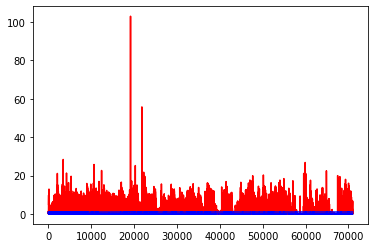

white ratio : 49.5
min : 180
max : 221


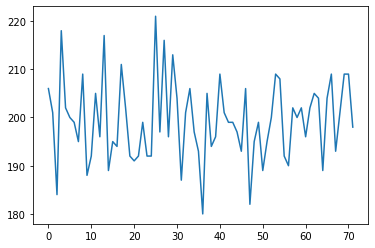

Generating interpolations...
71001 [D loss: 0.000721, acc.: 100.00%] [G loss: 0.000556, 0.013486]
71002 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.762935, 0.000008]
71003 [D loss: 0.000250, acc.: 100.00%] [G loss: 0.836583, 0.482350]
71004 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.671892, 0.282418]
71005 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.113558, 0.011172]
71006 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.052831, 0.000013]
71007 [D loss: 0.000354, acc.: 100.00%] [G loss: 0.000002, 0.000048]
71008 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.083015, 0.023993]
71009 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.003242, 0.012801]
71010 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.023135, 0.048288]
71011 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000025, 0.000002]
71012 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.016481, 0.009877]
71013 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.143584, 0.041087]
71014 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.000015, 0.000100]
71015

71121 [D loss: 0.000594, acc.: 100.00%] [G loss: 0.412647, 0.344905]
71122 [D loss: 0.001581, acc.: 100.00%] [G loss: 0.786139, 0.599336]
71123 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.001167, 0.000060]
71124 [D loss: 0.000124, acc.: 100.00%] [G loss: 7.309652, 0.005583]
71125 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.320680, 2.641553]
71126 [D loss: 0.000051, acc.: 100.00%] [G loss: 3.099919, 5.550245]
71127 [D loss: 0.005063, acc.: 100.00%] [G loss: 6.303239, 5.490323]
71128 [D loss: 0.011864, acc.: 100.00%] [G loss: 4.319751, 3.501681]
71129 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.036285, 0.019216]
71130 [D loss: 0.000055, acc.: 100.00%] [G loss: 11.459933, 13.973459]
71131 [D loss: 0.000120, acc.: 100.00%] [G loss: 6.706420, 6.115427]
71132 [D loss: 0.004890, acc.: 100.00%] [G loss: 0.801502, 1.001048]
71133 [D loss: 0.000046, acc.: 100.00%] [G loss: 3.011343, 3.178545]
71134 [D loss: 0.000012, acc.: 100.00%] [G loss: 12.211715, 10.095413]
71135 [D loss: 0.000007, acc.:

71242 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.266817, 0.320522]
71243 [D loss: 0.061771, acc.: 96.88%] [G loss: 0.998800, 0.591428]
71244 [D loss: 0.000460, acc.: 100.00%] [G loss: 0.000665, 0.048808]
71245 [D loss: 0.001406, acc.: 100.00%] [G loss: 65.637848, 0.976542]
71246 [D loss: 0.001185, acc.: 100.00%] [G loss: 4.028171, 6.817406]
71247 [D loss: 0.000123, acc.: 100.00%] [G loss: 13.699185, 5.540673]
71248 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.494414, 0.222087]
71249 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.496955, 3.972448]
71250 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.793667, 4.764598]
71251 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.001480, 0.001381]
71252 [D loss: 0.023605, acc.: 96.88%] [G loss: 0.000276, 0.002386]
71253 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.006990, 0.000108]
71254 [D loss: 0.004106, acc.: 100.00%] [G loss: 0.495817, 0.342297]
71255 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.065440, 0.011585]
71256 [D loss: 0.000797, acc.: 100

71361 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000483, 0.000074]
71362 [D loss: 0.000154, acc.: 100.00%] [G loss: 4.755594, 2.946990]
71363 [D loss: 0.000200, acc.: 100.00%] [G loss: 5.907269, 3.985468]
71364 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.006600, 0.009626]
71365 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.566890, 0.594833]
71366 [D loss: 0.000149, acc.: 100.00%] [G loss: 25.398811, 2.940332]
71367 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.221446, 0.100897]
71368 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.006612, 0.006905]
71369 [D loss: 0.144673, acc.: 96.88%] [G loss: 0.038677, 0.094590]
71370 [D loss: 0.003421, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71371 [D loss: 0.001478, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71372 [D loss: 0.000692, acc.: 100.00%] [G loss: 0.000814, 0.004039]
71373 [D loss: 0.011175, acc.: 100.00%] [G loss: 0.000067, 0.000008]
71374 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000001, 0.068973]
71375 [D loss: 0.000296, acc.: 100

71482 [D loss: 0.001255, acc.: 100.00%] [G loss: 0.000380, 0.000221]
71483 [D loss: 0.001669, acc.: 100.00%] [G loss: 24.196457, 0.705073]
71484 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71485 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.685689, 0.562485]
71486 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.718088, 0.433839]
71487 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.002695, 0.001756]
71488 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.867207, 0.790748]
71489 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.015046, 0.040825]
71490 [D loss: 0.000576, acc.: 100.00%] [G loss: 3.299519, 1.265293]
71491 [D loss: 0.001582, acc.: 100.00%] [G loss: 1.399586, 1.438560]
71492 [D loss: 0.000428, acc.: 100.00%] [G loss: 1.939955, 1.353338]
71493 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000018, 0.000004]
71494 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.090968, 0.630346]
71495 [D loss: 0.000361, acc.: 100.00%] [G loss: 0.705065, 0.210991]
71496 [D loss: 0.000121, acc.: 10

71602 [D loss: 0.002179, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71603 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71604 [D loss: 0.000364, acc.: 100.00%] [G loss: 1.346386, 1.287624]
71605 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71606 [D loss: 0.186859, acc.: 96.88%] [G loss: 0.000000, 0.000000]
71607 [D loss: 0.085186, acc.: 93.75%] [G loss: 0.000000, 0.000000]
71608 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000433, 0.000000]
71609 [D loss: 0.000333, acc.: 100.00%] [G loss: 1.263107, 5.387538]
71610 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.157845, 5.402793]
71611 [D loss: 0.000069, acc.: 100.00%] [G loss: 2.649768, 2.055040]
71612 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71613 [D loss: 0.000298, acc.: 100.00%] [G loss: 15.065523, 3.532253]
71614 [D loss: 0.010525, acc.: 100.00%] [G loss: 5.528539, 5.745916]
71615 [D loss: 0.000153, acc.: 100.00%] [G loss: 7.672097, 6.658645]
71616 [D loss: 0.000043, acc.: 100.

71722 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71723 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71724 [D loss: 0.000150, acc.: 100.00%] [G loss: 3.882124, 3.119435]
71725 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.087078, 5.376787]
71726 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71727 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.001271, 0.000048]
71728 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000001, 0.000001]
71729 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000012, 0.000000]
71730 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.073880, 0.961893]
71731 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.923655, 1.516429]
71732 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000001, 0.000000]
71733 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71734 [D loss: 0.000053, acc.: 100.00%] [G loss: 9.555410, 8.319609]
71735 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71736 [D loss: 0.000013, acc.: 100

71842 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71843 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71844 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71845 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.715771, 0.261470]
71846 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71847 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71848 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.467862, 0.331975]
71849 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71850 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.094737, 0.093475]
71851 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.174197, 0.088394]
71852 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71853 [D loss: 0.000371, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71854 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71855 [D loss: 0.000410, acc.: 100.00%] [G loss: 0.000001, 0.000001]
71856 [D loss: 0.000110, acc.: 100

71963 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000001, 0.000007]
71964 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71965 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71966 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71967 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71968 [D loss: 0.000084, acc.: 100.00%] [G loss: 3.078028, 1.938638]
71969 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.202823, 0.468223]
71970 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71971 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71972 [D loss: 0.000417, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71973 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71974 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71975 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
71976 [D loss: 0.000005, acc.: 100.00%] [G loss: 11.288685, 0.000002]
71977 [D loss: 0.000024, acc.: 10

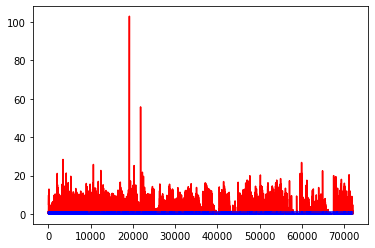

white ratio : 55.25
min : 180
max : 221


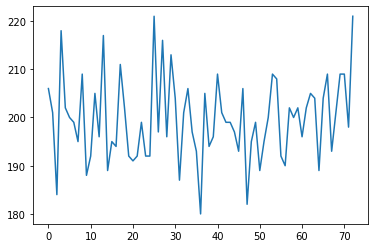

Generating interpolations...
72001 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.945024, 9.275318]
72002 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72003 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.017048, 0.002056]
72004 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72005 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.001935, 0.000309]
72006 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.002689, 0.000003]
72007 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000244, 0.000115]
72008 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.002267, 0.000580]
72009 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72010 [D loss: 0.067226, acc.: 96.88%] [G loss: 0.000000, 0.000000]
72011 [D loss: 0.000917, acc.: 100.00%] [G loss: 0.237553, 0.167142]
72012 [D loss: 0.001723, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72013 [D loss: 0.001860, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72014 [D loss: 0.002745, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72015 

72120 [D loss: 0.003322, acc.: 100.00%] [G loss: 0.000002, 0.000317]
72121 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.208513, 0.113573]
72122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
72123 [D loss: 0.000461, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72124 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72125 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000002, 0.000000]
72126 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72127 [D loss: 0.000701, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72128 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.000000, 0.000001]
72129 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000550, 0.049854]
72130 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72131 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72132 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72133 [D loss: 0.001022, acc.: 100.00%] [G loss: 0.000041, 0.000029]
72134 [D loss: 0.000235, acc.: 100

72239 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72240 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.016424, 0.598535]
72241 [D loss: 0.000969, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72242 [D loss: 0.004028, acc.: 100.00%] [G loss: 0.078692, 0.193664]
72243 [D loss: 0.001635, acc.: 100.00%] [G loss: 0.000061, 0.000133]
72244 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72245 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72246 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72247 [D loss: 0.000663, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72248 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000001, 0.000013]
72249 [D loss: 0.002451, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72250 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72251 [D loss: 0.000152, acc.: 100.00%] [G loss: 2.246360, 1.930700]
72252 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72253 [D loss: 0.000311, acc.: 100

72361 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.279664, 0.024651]
72362 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000052, 0.000105]
72363 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.016533, 0.038159]
72364 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.101424, 0.056051]
72365 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72366 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.033979, 0.032611]
72367 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.141954, 0.047229]
72368 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000003, 0.000001]
72369 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000932, 0.001471]
72370 [D loss: 0.000400, acc.: 100.00%] [G loss: 0.000110, 0.003875]
72371 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000112, 0.000064]
72372 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72373 [D loss: 0.161616, acc.: 96.88%] [G loss: 0.000001, 0.000007]
72374 [D loss: 0.002009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72375 [D loss: 0.000138, acc.: 100.

72481 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.068107, 0.001323]
72482 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000597, 0.000007]
72484 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.100914, 0.072812]
72485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.056011, 0.139876]
72486 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.007199, 0.049497]
72487 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000002]
72488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72489 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.028976, 0.033333]
72490 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.901516, 0.075168]
72491 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.010290, 0.022070]
72492 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004243, 0.001340]
72493 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.034926, 0.132419]
72494 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002578, 0.000634]
72495 [D loss: 0.000045, acc.: 100

72603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72604 [D loss: 0.000502, acc.: 100.00%] [G loss: 0.000012, 0.000046]
72605 [D loss: 0.001047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72606 [D loss: 0.000260, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72607 [D loss: 0.002518, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72608 [D loss: 0.001208, acc.: 100.00%] [G loss: 0.076031, 0.005706]
72609 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72610 [D loss: 0.000733, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72611 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72612 [D loss: 0.001559, acc.: 100.00%] [G loss: 0.000000, 0.000001]
72613 [D loss: 0.001700, acc.: 100.00%] [G loss: 0.797594, 2.134984]
72614 [D loss: 0.011112, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72615 [D loss: 0.001221, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72616 [D loss: 0.000582, acc.: 100.00%] [G loss: 0.169333, 0.059548]
72617 [D loss: 0.000168, acc.: 100

72724 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.256653, 0.377003]
72725 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72726 [D loss: 0.001000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72727 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72728 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72730 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.081895, 0.021492]
72731 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.115140, 0.194847]
72732 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000044, 0.000061]
72733 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72734 [D loss: 0.032667, acc.: 96.88%] [G loss: 0.000000, 0.000000]
72735 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72736 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.001558, 0.000294]
72737 [D loss: 0.054347, acc.: 96.88%] [G loss: 0.000000, 0.000000]
72738 [D loss: 0.038598, acc.: 96.88

72844 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72845 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.001531, 0.000598]
72846 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72847 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.000380, 0.000489]
72848 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72849 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000077, 0.000025]
72850 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72851 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72852 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.182009, 0.100449]
72853 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72854 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.221164, 0.467989]
72855 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.607586, 0.532313]
72856 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72857 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.533568, 0.561689]
72858 [D loss: 0.000010, acc.: 100

72963 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72964 [D loss: 0.007464, acc.: 100.00%] [G loss: 0.000018, 0.000008]
72965 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72966 [D loss: 0.001431, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72967 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000045, 0.000069]
72968 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72969 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72970 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.003975, 0.002206]
72971 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.006345, 0.000490]
72972 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72973 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72974 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72975 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72976 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
72977 [D loss: 0.000001, acc.: 100

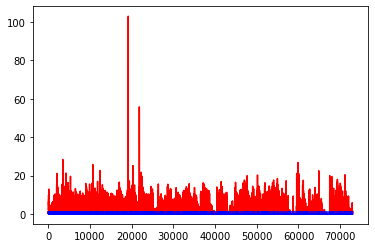

white ratio : 53.0
min : 180
max : 221


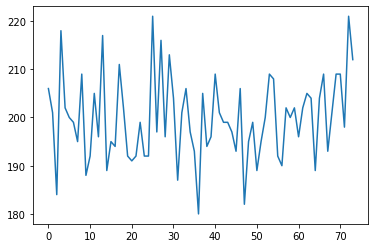

Generating interpolations...
73001 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73002 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73003 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73004 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73005 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.104266, 0.000018]
73006 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73007 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.001733, 0.005758]
73008 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000023, 0.000091]
73009 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.000922, 0.000476]
73010 [D loss: 0.000890, acc.: 100.00%] [G loss: 0.003501, 0.051179]
73011 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73012 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73013 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73014 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73015

73122 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.079337, 0.095800]
73123 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73124 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000809, 0.000139]
73125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012960, 0.000702]
73126 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.002819, 0.045073]
73127 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73128 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000006]
73129 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73132 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73133 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73134 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73135 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73136 [D loss: 0.000002, acc.: 100

73242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73243 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.001478, 0.008827]
73244 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73245 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003720, 0.001522]
73246 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73247 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73248 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000003, 0.000006]
73249 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000001, 0.000002]
73250 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73251 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73252 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73253 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73254 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.054901, 0.000313]
73255 [D loss: 0.000511, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73256 [D loss: 0.000000, acc.: 100

73361 [D loss: 0.016868, acc.: 100.00%] [G loss: 0.030645, 0.004679]
73362 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000000]
73364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008022, 0.011897]
73365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.034102, 0.009967]
73366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73369 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.003714, 0.050524]
73370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.054919, 0.003855]
73371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.073810, 0.031813]
73372 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000613, 0.008664]
73373 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.369512, 0.355502]
73374 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002525, 0.000031]
73375 [D loss: 0.000000, acc.: 100

73481 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000140, 0.000008]
73482 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73483 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000186, 0.000012]
73485 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.555849, 0.383061]
73486 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000165, 0.000171]
73487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73488 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73489 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73491 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73492 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73493 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.923931, 1.132424]
73494 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73495 [D loss: 0.000013, acc.: 100

73600 [D loss: 0.000440, acc.: 100.00%] [G loss: 0.000000, 0.000001]
73601 [D loss: 0.000294, acc.: 100.00%] [G loss: 3.433775, 2.988489]
73602 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73604 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73605 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.010131, 0.000807]
73606 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.002120, 0.000075]
73607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
73608 [D loss: 0.003767, acc.: 100.00%] [G loss: 0.000003, 0.000031]
73609 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.003676, 0.000738]
73610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73611 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73612 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.076058, 0.000183]
73613 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.000006, 0.000002]
73614 [D loss: 0.000053, acc.: 100

73720 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000191, 0.005356]
73721 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000147, 0.000074]
73722 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.082956, 0.136776]
73723 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.919121, 0.731333]
73724 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73725 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000147, 0.008440]
73726 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000023, 0.003329]
73727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000327, 0.000136]
73728 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.105397, 0.129354]
73729 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000049, 0.000027]
73730 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000075, 0.000248]
73731 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.197130, 0.005957]
73732 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000394, 0.005677]
73733 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000473, 0.000063]
73734 [D loss: 0.000043, acc.: 100

73839 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73840 [D loss: 0.001396, acc.: 100.00%] [G loss: 0.000009, 0.000003]
73841 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000030, 0.000011]
73842 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.016837, 0.000059]
73843 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.005663, 0.000431]
73844 [D loss: 0.001214, acc.: 100.00%] [G loss: 2.192460, 1.467390]
73845 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000115, 0.001878]
73846 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000001, 0.000084]
73847 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.018564, 0.115004]
73848 [D loss: 0.000274, acc.: 100.00%] [G loss: 0.000009, 0.000176]
73849 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.004507, 0.003404]
73850 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.022380, 0.293748]
73851 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.048171, 0.133899]
73852 [D loss: 0.000702, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73853 [D loss: 0.000036, acc.: 100

73958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.422306, 0.117141]
73959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.723147, 0.652789]
73960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.783553, 0.512026]
73961 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.360233, 1.194520]
73962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.309410, 1.191170]
73963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000001]
73964 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.094575, 3.496157]
73965 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.920154, 2.136802]
73966 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000133, 0.000006]
73967 [D loss: 0.079835, acc.: 96.88%] [G loss: 0.000000, 0.000000]
73968 [D loss: 0.001718, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73969 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000000, 0.000000]
73970 [D loss: 0.009818, acc.: 100.00%] [G loss: 0.000252, 0.000060]
73971 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.082822, 0.128854]
73972 [D loss: 0.000031, acc.: 100.

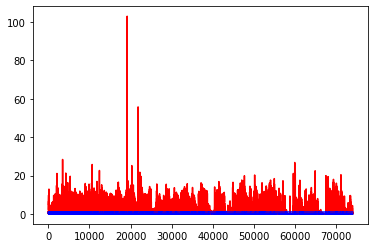

white ratio : 48.75
min : 180
max : 221


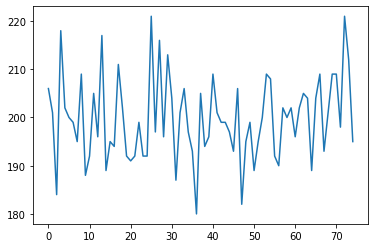

Generating interpolations...
74001 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74002 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.152777, 0.844267]
74003 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000078, 0.000000]
74004 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.249759, 0.114926]
74005 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74006 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.529456, 0.488802]
74007 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.597556, 0.209251]
74008 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.003785, 0.008423]
74009 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74010 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.121429, 0.057166]
74011 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.388674, 0.412814]
74012 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.118937, 0.800322]
74013 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.024690, 0.004903]
74014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.444598, 0.272911]
74015

74122 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.807869, 2.677215]
74123 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.046926, 0.000720]
74124 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.308166, 0.018560]
74125 [D loss: 0.000061, acc.: 100.00%] [G loss: 1.095400, 0.654652]
74126 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.092433, 0.128631]
74127 [D loss: 0.000336, acc.: 100.00%] [G loss: 3.050564, 2.920408]
74128 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.853689, 0.848637]
74129 [D loss: 0.001786, acc.: 100.00%] [G loss: 0.006248, 0.084567]
74130 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.057358, 1.112371]
74131 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.015590, 0.092310]
74132 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.401258, 0.978913]
74133 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.192191, 1.358604]
74134 [D loss: 0.000203, acc.: 100.00%] [G loss: 2.296688, 1.378518]
74135 [D loss: 0.000124, acc.: 100.00%] [G loss: 2.147680, 1.461686]
74136 [D loss: 0.003785, acc.: 100

74241 [D loss: 0.180927, acc.: 96.88%] [G loss: 9.890738, 7.295314]
74242 [D loss: 0.000589, acc.: 100.00%] [G loss: 3.086314, 1.305476]
74243 [D loss: 0.000477, acc.: 100.00%] [G loss: 11.404911, 9.726571]
74244 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.007670, 0.000546]
74245 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.174696, 0.235998]
74246 [D loss: 0.031747, acc.: 96.88%] [G loss: 8.336255, 7.996171]
74247 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.970102, 2.303303]
74248 [D loss: 0.001314, acc.: 100.00%] [G loss: 1.505239, 1.530492]
74249 [D loss: 0.124081, acc.: 96.88%] [G loss: 27.021994, 5.262958]
74250 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.509346, 13.226665]
74251 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.068140, 10.837021]
74252 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.751379, 11.954727]
74253 [D loss: 0.000308, acc.: 100.00%] [G loss: 39.914139, 10.156879]
74254 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.088921, 11.597265]
74255 [D loss: 0.000000, 

74361 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.001357, 3.211759]
74362 [D loss: 0.018749, acc.: 100.00%] [G loss: 0.399495, 0.199117]
74363 [D loss: 0.000136, acc.: 100.00%] [G loss: 21.222904, 7.357704]
74364 [D loss: 0.020450, acc.: 100.00%] [G loss: 8.602488, 4.079734]
74365 [D loss: 0.000180, acc.: 100.00%] [G loss: 6.602528, 7.437422]
74366 [D loss: 0.000028, acc.: 100.00%] [G loss: 4.990672, 3.661999]
74367 [D loss: 0.000457, acc.: 100.00%] [G loss: 3.636433, 2.956495]
74368 [D loss: 0.024326, acc.: 96.88%] [G loss: 3.407073, 4.305615]
74369 [D loss: 0.000510, acc.: 100.00%] [G loss: 11.345207, 10.141989]
74370 [D loss: 0.031835, acc.: 96.88%] [G loss: 0.189005, 0.203331]
74371 [D loss: 0.000642, acc.: 100.00%] [G loss: 0.031950, 0.018700]
74372 [D loss: 0.014221, acc.: 100.00%] [G loss: 2.597004, 0.965428]
74373 [D loss: 0.001586, acc.: 100.00%] [G loss: 0.185868, 0.011838]
74374 [D loss: 0.002477, acc.: 100.00%] [G loss: 10.892732, 0.087009]
74375 [D loss: 0.022825, acc.: 9

74480 [D loss: 0.010190, acc.: 100.00%] [G loss: 0.170544, 0.007894]
74481 [D loss: 0.000274, acc.: 100.00%] [G loss: 5.112723, 4.500365]
74482 [D loss: 0.000117, acc.: 100.00%] [G loss: 14.462734, 1.250530]
74483 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.847941, 0.205100]
74484 [D loss: 0.001724, acc.: 100.00%] [G loss: 0.022627, 0.000023]
74485 [D loss: 0.023923, acc.: 96.88%] [G loss: 0.002833, 0.001084]
74486 [D loss: 0.001117, acc.: 100.00%] [G loss: 1.091804, 1.501551]
74487 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.000000, 0.000085]
74488 [D loss: 0.006249, acc.: 100.00%] [G loss: 1.999691, 1.724576]
74489 [D loss: 0.000237, acc.: 100.00%] [G loss: 1.834018, 1.308132]
74490 [D loss: 0.013263, acc.: 100.00%] [G loss: 0.001036, 0.000156]
74491 [D loss: 0.012068, acc.: 100.00%] [G loss: 8.173742, 3.004781]
74492 [D loss: 0.000579, acc.: 100.00%] [G loss: 4.112975, 2.224654]
74493 [D loss: 0.010908, acc.: 100.00%] [G loss: 0.431490, 0.685958]
74494 [D loss: 0.016378, acc.: 100

74599 [D loss: 0.000115, acc.: 100.00%] [G loss: 7.017663, 6.937187]
74600 [D loss: 0.000556, acc.: 100.00%] [G loss: 0.881844, 1.134567]
74601 [D loss: 0.000014, acc.: 100.00%] [G loss: 4.722045, 3.513588]
74602 [D loss: 0.000471, acc.: 100.00%] [G loss: 5.169955, 4.027258]
74603 [D loss: 0.010344, acc.: 100.00%] [G loss: 8.059603, 3.039238]
74604 [D loss: 0.038182, acc.: 96.88%] [G loss: 7.163268, 6.514769]
74605 [D loss: 0.000965, acc.: 100.00%] [G loss: 0.003506, 0.000572]
74606 [D loss: 0.002979, acc.: 100.00%] [G loss: 6.142755, 4.895188]
74607 [D loss: 0.000659, acc.: 100.00%] [G loss: 1.652695, 0.823969]
74608 [D loss: 0.086390, acc.: 96.88%] [G loss: 2.231665, 1.476167]
74609 [D loss: 0.000989, acc.: 100.00%] [G loss: 0.000415, 0.020116]
74610 [D loss: 0.006449, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74611 [D loss: 0.009335, acc.: 100.00%] [G loss: 0.252624, 0.007425]
74612 [D loss: 0.011101, acc.: 100.00%] [G loss: 0.000903, 0.000005]
74613 [D loss: 0.000342, acc.: 100.0

74720 [D loss: 0.002451, acc.: 100.00%] [G loss: 0.083124, 0.052818]
74721 [D loss: 0.000076, acc.: 100.00%] [G loss: 3.372067, 2.949013]
74722 [D loss: 0.001049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74723 [D loss: 0.000393, acc.: 100.00%] [G loss: 0.000915, 0.000539]
74724 [D loss: 0.000110, acc.: 100.00%] [G loss: 1.514469, 0.787479]
74725 [D loss: 0.000544, acc.: 100.00%] [G loss: 0.000171, 0.000015]
74726 [D loss: 0.000332, acc.: 100.00%] [G loss: 0.088031, 0.136205]
74727 [D loss: 0.009765, acc.: 100.00%] [G loss: 5.428064, 6.379695]
74728 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.730342, 8.500012]
74729 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.000016, 0.000542]
74730 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.000025, 0.000194]
74731 [D loss: 0.000013, acc.: 100.00%] [G loss: 7.074923, 5.664075]
74732 [D loss: 0.000009, acc.: 100.00%] [G loss: 6.462125, 5.890530]
74733 [D loss: 0.000577, acc.: 100.00%] [G loss: 5.881432, 5.953570]
74734 [D loss: 0.204957, acc.: 96.

74839 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74840 [D loss: 0.004925, acc.: 100.00%] [G loss: 0.088499, 0.028430]
74841 [D loss: 0.000548, acc.: 100.00%] [G loss: 1.320282, 1.404674]
74842 [D loss: 0.083264, acc.: 96.88%] [G loss: 35.195602, 2.594382]
74843 [D loss: 0.002096, acc.: 100.00%] [G loss: 0.058529, 0.070316]
74844 [D loss: 0.002730, acc.: 100.00%] [G loss: 0.001202, 0.001690]
74845 [D loss: 0.001179, acc.: 100.00%] [G loss: 18.327253, 2.431548]
74846 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74847 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.001133, 0.000862]
74848 [D loss: 0.000098, acc.: 100.00%] [G loss: 7.187799, 7.204808]
74849 [D loss: 0.002051, acc.: 100.00%] [G loss: 9.681864, 8.998682]
74850 [D loss: 0.000060, acc.: 100.00%] [G loss: 5.830819, 5.493052]
74851 [D loss: 0.000251, acc.: 100.00%] [G loss: 1.302894, 0.862516]
74852 [D loss: 0.002099, acc.: 100.00%] [G loss: 0.611092, 0.815795]
74853 [D loss: 0.000052, acc.: 10

74959 [D loss: 0.000136, acc.: 100.00%] [G loss: 2.915911, 2.488944]
74960 [D loss: 0.000410, acc.: 100.00%] [G loss: 0.000020, 0.000004]
74961 [D loss: 0.000294, acc.: 100.00%] [G loss: 0.051825, 0.057468]
74962 [D loss: 0.001776, acc.: 100.00%] [G loss: 0.467077, 0.571492]
74963 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.892638, 0.503985]
74964 [D loss: 0.000621, acc.: 100.00%] [G loss: 0.664613, 0.459605]
74965 [D loss: 0.001483, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74966 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.583193, 0.000005]
74967 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000819, 0.000814]
74968 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.000000, 0.000000]
74969 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.328954, 0.416252]
74970 [D loss: 0.020906, acc.: 100.00%] [G loss: 0.002343, 0.036156]
74971 [D loss: 0.000087, acc.: 100.00%] [G loss: 1.450813, 0.784026]
74972 [D loss: 0.000447, acc.: 100.00%] [G loss: 1.823700, 1.170202]
74973 [D loss: 0.000330, acc.: 100

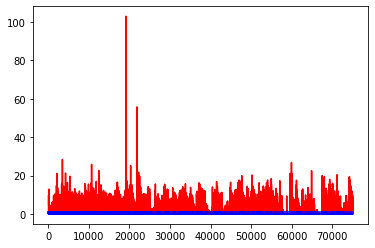

white ratio : 54.5
min : 180
max : 221


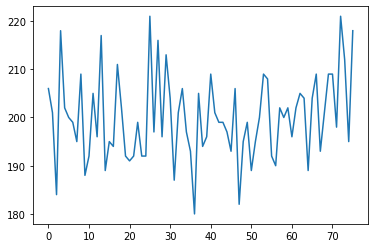

Generating interpolations...
75001 [D loss: 0.001745, acc.: 100.00%] [G loss: 1.195217, 0.897908]
75002 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75003 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.009686, 0.150297]
75004 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000007, 0.000000]
75005 [D loss: 0.000560, acc.: 100.00%] [G loss: 2.081062, 0.733226]
75006 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.000005, 0.000209]
75007 [D loss: 0.000305, acc.: 100.00%] [G loss: 10.208995, 0.075545]
75008 [D loss: 0.013217, acc.: 100.00%] [G loss: 9.572086, 5.694123]
75009 [D loss: 0.000219, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75010 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.505256, 0.766594]
75011 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.514512, 3.225601]
75012 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000037, 0.000002]
75013 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.853490, 0.000018]
75014 [D loss: 0.000177, acc.: 100.00%] [G loss: 5.032262, 4.047486]
7501

75118 [D loss: 0.000124, acc.: 100.00%] [G loss: 6.366377, 5.538041]
75119 [D loss: 0.000114, acc.: 100.00%] [G loss: 5.999507, 5.221140]
75120 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75121 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.390191, 0.421583]
75122 [D loss: 0.000067, acc.: 100.00%] [G loss: 7.050212, 5.842353]
75123 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.049801, 0.077482]
75124 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.017751, 0.046462]
75125 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.006441, 0.000637]
75126 [D loss: 0.000413, acc.: 100.00%] [G loss: 0.199527, 0.044723]
75127 [D loss: 0.000404, acc.: 100.00%] [G loss: 0.216200, 0.116566]
75128 [D loss: 0.001111, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75129 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75130 [D loss: 0.002098, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75131 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.179566, 0.101628]
75132 [D loss: 0.000497, acc.: 100

75238 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.032938, 0.081275]
75239 [D loss: 0.001022, acc.: 100.00%] [G loss: 5.655579, 0.983965]
75240 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000001, 0.000001]
75241 [D loss: 0.000161, acc.: 100.00%] [G loss: 6.065821, 5.745824]
75242 [D loss: 0.000038, acc.: 100.00%] [G loss: 8.246640, 8.325912]
75243 [D loss: 0.000143, acc.: 100.00%] [G loss: 8.937578, 8.115900]
75244 [D loss: 0.000110, acc.: 100.00%] [G loss: 4.686340, 3.849112]
75245 [D loss: 0.000086, acc.: 100.00%] [G loss: 8.597491, 4.607359]
75246 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75247 [D loss: 0.000388, acc.: 100.00%] [G loss: 4.200227, 4.994781]
75248 [D loss: 0.000030, acc.: 100.00%] [G loss: 7.222121, 0.457131]
75249 [D loss: 0.000299, acc.: 100.00%] [G loss: 2.082266, 0.854650]
75250 [D loss: 0.000260, acc.: 100.00%] [G loss: 10.955758, 0.760624]
75251 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.123753, 0.086795]
75252 [D loss: 0.000044, acc.: 10

75357 [D loss: 0.005768, acc.: 100.00%] [G loss: 0.010888, 0.000003]
75358 [D loss: 0.031956, acc.: 96.88%] [G loss: 0.122763, 0.223295]
75359 [D loss: 0.000144, acc.: 100.00%] [G loss: 8.880804, 0.000000]
75360 [D loss: 0.000057, acc.: 100.00%] [G loss: 9.750055, 10.323069]
75361 [D loss: 0.000109, acc.: 100.00%] [G loss: 3.932949, 4.023283]
75362 [D loss: 0.144082, acc.: 96.88%] [G loss: 0.000120, 0.000033]
75363 [D loss: 0.000312, acc.: 100.00%] [G loss: 9.712399, 9.700083]
75364 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75365 [D loss: 0.000498, acc.: 100.00%] [G loss: 7.487417, 6.804584]
75366 [D loss: 0.000713, acc.: 100.00%] [G loss: 12.087215, 12.006304]
75367 [D loss: 0.002298, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75368 [D loss: 0.003754, acc.: 100.00%] [G loss: 4.852072, 5.291019]
75369 [D loss: 0.046247, acc.: 96.88%] [G loss: 7.479783, 6.626236]
75370 [D loss: 0.000296, acc.: 100.00%] [G loss: 7.817830, 8.098338]
75371 [D loss: 0.000508, acc.: 100

75476 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.709577, 2.235651]
75477 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.423191, 0.336085]
75478 [D loss: 0.006292, acc.: 100.00%] [G loss: 1.292462, 2.025962]
75479 [D loss: 0.001369, acc.: 100.00%] [G loss: 0.000062, 0.009443]
75480 [D loss: 0.000379, acc.: 100.00%] [G loss: 0.000018, 0.000000]
75481 [D loss: 0.000438, acc.: 100.00%] [G loss: 0.000001, 0.000000]
75482 [D loss: 0.000062, acc.: 100.00%] [G loss: 60.379326, 4.092757]
75483 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.001131, 0.000495]
75484 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75485 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75486 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.002777, 0.003087]
75487 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.981422, 8.845907]
75488 [D loss: 0.000016, acc.: 100.00%] [G loss: 10.317366, 9.923193]
75489 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75490 [D loss: 0.000096, acc.: 1

75597 [D loss: 0.000564, acc.: 100.00%] [G loss: 5.299489, 0.000000]
75598 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.490786, 9.073406]
75599 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.813347, 4.883825]
75600 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75601 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.063057, 0.112405]
75602 [D loss: 0.043086, acc.: 96.88%] [G loss: 3.892097, 4.325001]
75603 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.026237, 0.001209]
75604 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.031063, 0.003797]
75605 [D loss: 0.096116, acc.: 96.88%] [G loss: 0.000001, 0.000010]
75606 [D loss: 0.001238, acc.: 100.00%] [G loss: 18.466377, 0.382623]
75607 [D loss: 0.000354, acc.: 100.00%] [G loss: 0.000061, 0.000010]
75608 [D loss: 0.001124, acc.: 100.00%] [G loss: 1.598450, 1.514312]
75609 [D loss: 0.002274, acc.: 100.00%] [G loss: 0.532697, 0.546289]
75610 [D loss: 0.000457, acc.: 100.00%] [G loss: 0.185651, 0.011487]
75611 [D loss: 0.001074, acc.: 100.

75716 [D loss: 0.001015, acc.: 100.00%] [G loss: 9.818851, 0.003245]
75717 [D loss: 0.001078, acc.: 100.00%] [G loss: 2.378028, 2.849751]
75718 [D loss: 0.000428, acc.: 100.00%] [G loss: 1.430172, 1.878279]
75719 [D loss: 0.000638, acc.: 100.00%] [G loss: 0.002534, 0.001965]
75720 [D loss: 0.001061, acc.: 100.00%] [G loss: 0.000003, 0.000000]
75721 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.085115, 0.000521]
75722 [D loss: 0.000822, acc.: 100.00%] [G loss: 0.004769, 0.017422]
75723 [D loss: 0.002398, acc.: 100.00%] [G loss: 0.000466, 0.006689]
75724 [D loss: 0.000866, acc.: 100.00%] [G loss: 0.516524, 0.480723]
75725 [D loss: 0.000379, acc.: 100.00%] [G loss: 2.487571, 1.598434]
75726 [D loss: 0.000140, acc.: 100.00%] [G loss: 28.732388, 2.508060]
75727 [D loss: 0.000487, acc.: 100.00%] [G loss: 6.020350, 5.401993]
75728 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.169562, 0.338072]
75729 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75730 [D loss: 0.000989, acc.: 10

75837 [D loss: 0.000007, acc.: 100.00%] [G loss: 7.088525, 4.479398]
75838 [D loss: 0.000066, acc.: 100.00%] [G loss: 7.532162, 6.786023]
75839 [D loss: 0.000034, acc.: 100.00%] [G loss: 3.699417, 5.681748]
75840 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.006804, 0.009234]
75841 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.872499, 0.649659]
75842 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.169161, 3.353325]
75843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.135421, 0.001039]
75844 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.330981, 0.332113]
75845 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001769, 0.001195]
75846 [D loss: 0.000037, acc.: 100.00%] [G loss: 3.968001, 0.676472]
75847 [D loss: 0.050900, acc.: 96.88%] [G loss: 8.591141, 8.133249]
75848 [D loss: 0.000119, acc.: 100.00%] [G loss: 10.556731, 10.029888]
75849 [D loss: 0.000025, acc.: 100.00%] [G loss: 9.163195, 9.763430]
75850 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000368, 0.000030]
75851 [D loss: 0.000129, acc.: 10

75957 [D loss: 0.000405, acc.: 100.00%] [G loss: 9.372502, 8.587301]
75958 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75959 [D loss: 0.000400, acc.: 100.00%] [G loss: 0.966050, 0.505753]
75960 [D loss: 0.000243, acc.: 100.00%] [G loss: 0.589566, 0.246307]
75961 [D loss: 0.003099, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75962 [D loss: 0.001121, acc.: 100.00%] [G loss: 0.084206, 0.001347]
75963 [D loss: 0.000141, acc.: 100.00%] [G loss: 9.765508, 9.535653]
75964 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.006558, 0.202141]
75965 [D loss: 0.001687, acc.: 100.00%] [G loss: 1.299727, 0.519814]
75966 [D loss: 0.000408, acc.: 100.00%] [G loss: 0.013882, 0.000056]
75967 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.762233, 0.598627]
75968 [D loss: 0.000278, acc.: 100.00%] [G loss: 2.073726, 0.157477]
75969 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.069139, 0.045203]
75970 [D loss: 0.000456, acc.: 100.00%] [G loss: 0.000000, 0.000000]
75971 [D loss: 0.000061, acc.: 100

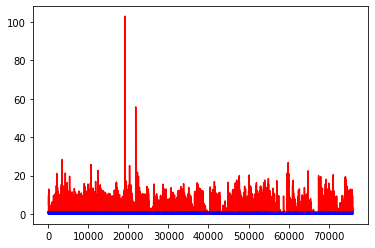

white ratio : 51.75
min : 180
max : 221


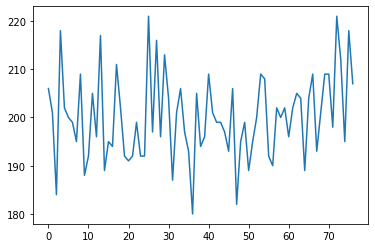

Generating interpolations...
76001 [D loss: 0.000674, acc.: 100.00%] [G loss: 0.230821, 0.294283]
76002 [D loss: 0.001247, acc.: 100.00%] [G loss: 0.370549, 0.457471]
76003 [D loss: 0.001214, acc.: 100.00%] [G loss: 0.001821, 0.000054]
76004 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.000003, 0.000024]
76005 [D loss: 0.001261, acc.: 100.00%] [G loss: 0.000000, 0.000015]
76006 [D loss: 0.000438, acc.: 100.00%] [G loss: 0.000002, 0.000000]
76007 [D loss: 0.000356, acc.: 100.00%] [G loss: 0.000001, 0.004237]
76008 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000003, 0.000296]
76009 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000036, 0.000071]
76010 [D loss: 0.001171, acc.: 100.00%] [G loss: 0.000002, 0.000459]
76011 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.256056, 0.338854]
76012 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.000063, 0.000196]
76013 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.125636, 0.108499]
76014 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000012, 0.000019]
76015

76123 [D loss: 0.000260, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76124 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000004, 0.000944]
76125 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000482, 0.033128]
76126 [D loss: 0.000482, acc.: 100.00%] [G loss: 0.142113, 0.048799]
76127 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.002712, 0.000002]
76128 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.001200, 0.000344]
76129 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76130 [D loss: 0.001913, acc.: 100.00%] [G loss: 0.000048, 0.000003]
76131 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.000069, 0.000015]
76132 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76133 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000058, 0.000002]
76134 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000135, 0.000046]
76135 [D loss: 0.000610, acc.: 100.00%] [G loss: 0.987013, 0.073459]
76136 [D loss: 0.000070, acc.: 100.00%] [G loss: 1.813357, 1.400543]
76137 [D loss: 0.000067, acc.: 100

76244 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.003738, 0.000067]
76245 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000015, 0.000120]
76246 [D loss: 0.000287, acc.: 100.00%] [G loss: 2.846594, 2.012321]
76247 [D loss: 0.000513, acc.: 100.00%] [G loss: 9.403653, 0.122015]
76248 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000005]
76249 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.064004, 0.014060]
76250 [D loss: 0.001104, acc.: 100.00%] [G loss: 0.298881, 0.297604]
76251 [D loss: 0.000079, acc.: 100.00%] [G loss: 1.887357, 1.172092]
76252 [D loss: 0.005716, acc.: 100.00%] [G loss: 0.009179, 0.069218]
76253 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.456927, 0.332529]
76254 [D loss: 0.000029, acc.: 100.00%] [G loss: 12.066872, 0.076110]
76255 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.134040, 0.223857]
76256 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001022, 0.001164]
76257 [D loss: 0.000108, acc.: 100.00%] [G loss: 1.100759, 1.030483]
76258 [D loss: 0.000015, acc.: 10

76366 [D loss: 0.000052, acc.: 100.00%] [G loss: 6.027005, 6.490705]
76367 [D loss: 0.000758, acc.: 100.00%] [G loss: 0.028187, 0.011164]
76368 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.979265, 2.134896]
76369 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.316945, 1.780151]
76370 [D loss: 0.000044, acc.: 100.00%] [G loss: 2.810965, 2.723642]
76371 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.001291]
76372 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76373 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.518786, 0.257487]
76374 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.000031, 0.067027]
76375 [D loss: 0.000578, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76376 [D loss: 0.081015, acc.: 96.88%] [G loss: 0.753460, 0.593399]
76377 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76378 [D loss: 0.000870, acc.: 100.00%] [G loss: 0.010588, 0.117464]
76379 [D loss: 0.000694, acc.: 100.00%] [G loss: 0.120851, 0.011915]
76380 [D loss: 0.001193, acc.: 100.

76486 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.004860, 0.000502]
76487 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76488 [D loss: 0.000013, acc.: 100.00%] [G loss: 18.272520, 3.234073]
76489 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000284, 0.021442]
76490 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76491 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.047701, 2.997930]
76492 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.208668, 0.011685]
76493 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76494 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76495 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76496 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.010664, 0.076902]
76497 [D loss: 0.009320, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76498 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76499 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000058, 0.000975]
76500 [D loss: 0.000017, acc.: 10

76605 [D loss: 0.034608, acc.: 96.88%] [G loss: 0.000000, 0.000000]
76606 [D loss: 0.000791, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76607 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.074465, 0.000037]
76608 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000035, 0.000807]
76609 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000098, 0.000330]
76610 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.005709, 0.000011]
76611 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.006763, 0.000181]
76612 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76613 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76614 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.055433, 0.002821]
76615 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76616 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.262378, 0.099873]
76617 [D loss: 0.000433, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76618 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000000, 0.000001]
76619 [D loss: 0.000103, acc.: 100.

76727 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
76728 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.237091, 10.520075]
76729 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.425330, 0.300110]
76730 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.004717, 11.545422]
76731 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.343223, 0.105531]
76732 [D loss: 0.000543, acc.: 100.00%] [G loss: 0.000044, 0.000000]
76733 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76734 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000389, 0.071127]
76735 [D loss: 0.000057, acc.: 100.00%] [G loss: 3.847219, 2.817429]
76736 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76737 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.309982, 0.253663]
76738 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000467, 0.026889]
76739 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.164434, 0.045220]
76740 [D loss: 0.010472, acc.: 100.00%] [G loss: 0.021500, 0.048485]
76741 [D loss: 0.000078, acc.:

76847 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.173915, 0.000000]
76848 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76849 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76850 [D loss: 0.000014, acc.: 100.00%] [G loss: 11.067719, 9.189901]
76851 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76852 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76853 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76854 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76855 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.872600, 1.135002]
76856 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76857 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.276054, 1.120830]
76858 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76859 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76860 [D loss: 0.002069, acc.: 100.00%] [G loss: 1.739205, 0.856513]
76861 [D loss: 0.000103, acc.: 10

76968 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.000612, 0.251298]
76969 [D loss: 0.000370, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76970 [D loss: 0.000798, acc.: 100.00%] [G loss: 0.000022, 0.000000]
76971 [D loss: 0.000691, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76972 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76973 [D loss: 0.001176, acc.: 100.00%] [G loss: 0.002300, 0.000003]
76974 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76975 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.000003, 0.000017]
76976 [D loss: 0.000447, acc.: 100.00%] [G loss: 0.021853, 0.060268]
76977 [D loss: 0.000696, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76978 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.000317, 0.019923]
76979 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76980 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.000000, 0.000052]
76981 [D loss: 0.001445, acc.: 100.00%] [G loss: 0.000000, 0.000000]
76982 [D loss: 0.000427, acc.: 100

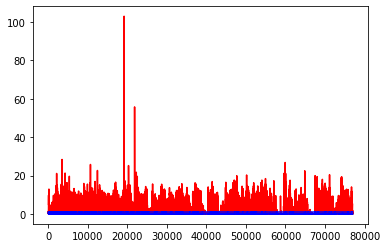

white ratio : 48.75
min : 180
max : 221


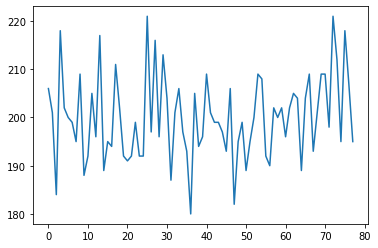

Generating interpolations...
77001 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.098662, 0.115398]
77002 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.102051, 0.091004]
77003 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.528587, 0.129016]
77004 [D loss: 0.000456, acc.: 100.00%] [G loss: 0.693196, 0.630618]
77005 [D loss: 0.000953, acc.: 100.00%] [G loss: 0.193805, 0.224776]
77006 [D loss: 0.012394, acc.: 100.00%] [G loss: 0.000240, 0.000030]
77007 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.797097, 0.251603]
77008 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.762442, 1.398098]
77009 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.353859, 1.541495]
77010 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.198213, 0.048791]
77011 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000366, 0.000941]
77012 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000002]
77013 [D loss: 0.000085, acc.: 100.00%] [G loss: 1.152533, 1.507468]
77014 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.440495, 0.158117]
77015

77121 [D loss: 0.001181, acc.: 100.00%] [G loss: 0.001749, 0.001205]
77122 [D loss: 0.001213, acc.: 100.00%] [G loss: 0.024775, 0.001363]
77123 [D loss: 0.000622, acc.: 100.00%] [G loss: 0.000252, 0.002311]
77124 [D loss: 0.000199, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77125 [D loss: 0.001845, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77126 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.022046, 0.004914]
77127 [D loss: 0.003609, acc.: 100.00%] [G loss: 0.000356, 0.002578]
77128 [D loss: 0.000434, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77129 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.368429, 0.002531]
77130 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.001112, 0.000106]
77131 [D loss: 0.000274, acc.: 100.00%] [G loss: 0.046257, 0.018596]
77132 [D loss: 0.001247, acc.: 100.00%] [G loss: 0.000009, 0.000003]
77133 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.002503, 0.071957]
77134 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77135 [D loss: 0.000195, acc.: 100

77241 [D loss: 0.000456, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77242 [D loss: 0.009582, acc.: 100.00%] [G loss: 0.000311, 0.000038]
77243 [D loss: 0.089723, acc.: 96.88%] [G loss: 0.000000, 0.000000]
77244 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.472099, 1.188352]
77245 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001987, 0.000128]
77246 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.034423, 0.033866]
77247 [D loss: 0.034157, acc.: 96.88%] [G loss: 1.393804, 1.366473]
77248 [D loss: 0.000022, acc.: 100.00%] [G loss: 2.779182, 1.666239]
77249 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77250 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.543548, 0.444796]
77251 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000752, 0.211032]
77252 [D loss: 0.000464, acc.: 100.00%] [G loss: 1.137307, 1.131444]
77253 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.746907, 0.823999]
77254 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.201275, 0.570084]
77255 [D loss: 0.000612, acc.: 100.0

77360 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.004975, 0.003223]
77361 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000007, 0.000096]
77362 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77363 [D loss: 0.000872, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77364 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.000289, 0.004969]
77365 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77366 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77367 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000106, 0.011951]
77368 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.102925, 0.003738]
77369 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.019582, 0.152911]
77370 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.001625, 0.048783]
77371 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77372 [D loss: 0.000634, acc.: 100.00%] [G loss: 0.000577, 0.000001]
77373 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77374 [D loss: 0.000398, acc.: 100

77479 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.000332, 0.000325]
77480 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.028909, 0.078552]
77481 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.070137, 0.102087]
77482 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.013082, 0.134815]
77483 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77484 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77485 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.016202, 0.086589]
77486 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000005, 0.000001]
77487 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.043283, 0.178012]
77488 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.018116, 0.003390]
77489 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000001]
77490 [D loss: 0.002223, acc.: 100.00%] [G loss: 0.000977, 0.078187]
77491 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77492 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.007297, 0.189751]
77493 [D loss: 0.000114, acc.: 100

77599 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.107102, 0.106611]
77600 [D loss: 0.000663, acc.: 100.00%] [G loss: 0.000000, 0.000005]
77601 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.003076, 0.004546]
77602 [D loss: 0.059628, acc.: 96.88%] [G loss: 0.000000, 0.000000]
77603 [D loss: 0.001245, acc.: 100.00%] [G loss: 0.001606, 0.002216]
77604 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77605 [D loss: 0.000481, acc.: 100.00%] [G loss: 0.003071, 0.000104]
77606 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.000126, 0.000025]
77607 [D loss: 0.013993, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77608 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77609 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000002]
77610 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.007841, 0.000067]
77611 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77612 [D loss: 0.000310, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77613 [D loss: 0.000017, acc.: 100.

77720 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77721 [D loss: 0.000594, acc.: 100.00%] [G loss: 0.016378, 0.010404]
77722 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.000554, 0.000001]
77723 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.000015, 0.197370]
77724 [D loss: 0.000299, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77725 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77726 [D loss: 0.062791, acc.: 96.88%] [G loss: 0.000000, 0.000000]
77727 [D loss: 0.000352, acc.: 100.00%] [G loss: 0.000001, 0.000002]
77728 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.001028, 0.004711]
77729 [D loss: 0.022486, acc.: 100.00%] [G loss: 0.000166, 0.000004]
77730 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.398961, 0.093681]
77731 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.042816, 0.004836]
77732 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.072699, 0.001529]
77733 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.749496, 1.012927]
77734 [D loss: 0.000010, acc.: 100.

77840 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.512709, 0.269069]
77841 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000019, 0.033470]
77842 [D loss: 0.000379, acc.: 100.00%] [G loss: 5.331271, 8.633061]
77843 [D loss: 0.000246, acc.: 100.00%] [G loss: 5.140991, 6.392440]
77844 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.718394, 5.010391]
77845 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.167148, 0.217590]
77846 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.023317, 8.737438]
77847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.205185, 0.207653]
77848 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.157168, 2.355783]
77849 [D loss: 0.003136, acc.: 100.00%] [G loss: 0.917213, 1.918257]
77850 [D loss: 0.001728, acc.: 100.00%] [G loss: 3.503243, 1.405643]
77851 [D loss: 0.000021, acc.: 100.00%] [G loss: 6.116620, 7.930354]
77852 [D loss: 0.000127, acc.: 100.00%] [G loss: 6.238221, 8.364704]
77853 [D loss: 0.000035, acc.: 100.00%] [G loss: 6.470291, 4.762736]
77854 [D loss: 0.000085, acc.: 100

77959 [D loss: 0.015400, acc.: 100.00%] [G loss: 0.910882, 0.580002]
77960 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.708927, 0.015042]
77961 [D loss: 0.550397, acc.: 96.88%] [G loss: 3.131795, 1.671798]
77962 [D loss: 0.000538, acc.: 100.00%] [G loss: 0.206430, 0.076698]
77963 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77964 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.022411, 0.000074]
77965 [D loss: 0.017152, acc.: 100.00%] [G loss: 0.000328, 0.006158]
77966 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000000, 0.000000]
77967 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.302838, 1.284277]
77968 [D loss: 0.000391, acc.: 100.00%] [G loss: 0.000069, 0.000496]
77969 [D loss: 0.000032, acc.: 100.00%] [G loss: 5.172281, 4.410355]
77970 [D loss: 0.000084, acc.: 100.00%] [G loss: 5.367979, 5.751771]
77971 [D loss: 0.000171, acc.: 100.00%] [G loss: 1.439099, 0.496197]
77972 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.822682, 5.279204]
77973 [D loss: 0.000004, acc.: 100.

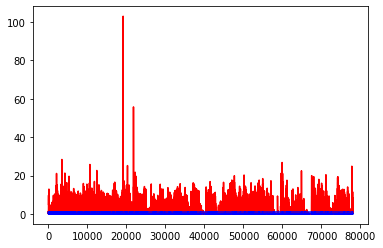

white ratio : 45.0
min : 180
max : 221


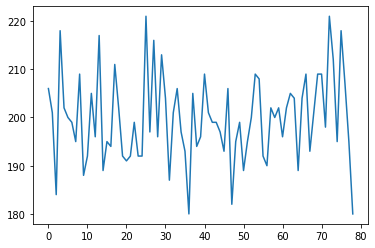

Generating interpolations...
78001 [D loss: 0.026750, acc.: 96.88%] [G loss: 0.940247, 1.109665]
78002 [D loss: 0.000032, acc.: 100.00%] [G loss: 6.156183, 6.435579]
78003 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.248885, 3.488158]
78004 [D loss: 0.000806, acc.: 100.00%] [G loss: 0.061396, 0.055533]
78005 [D loss: 0.000600, acc.: 100.00%] [G loss: 9.763544, 9.166389]
78006 [D loss: 0.000049, acc.: 100.00%] [G loss: 6.910189, 0.067772]
78007 [D loss: 0.000048, acc.: 100.00%] [G loss: 3.750483, 3.402452]
78008 [D loss: 0.000188, acc.: 100.00%] [G loss: 6.477063, 4.323190]
78009 [D loss: 0.000448, acc.: 100.00%] [G loss: 2.538062, 1.777429]
78010 [D loss: 0.001607, acc.: 100.00%] [G loss: 0.197457, 0.237970]
78011 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000006, 0.000015]
78012 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.454604, 0.282922]
78013 [D loss: 0.000239, acc.: 100.00%] [G loss: 2.868251, 2.814236]
78014 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.427731, 0.177453]
78015 

78120 [D loss: 0.000517, acc.: 100.00%] [G loss: 9.269603, 8.120466]
78121 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.055968, 0.569232]
78122 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.003402, 0.096828]
78123 [D loss: 0.000057, acc.: 100.00%] [G loss: 4.369545, 4.557831]
78124 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.945943, 4.083027]
78125 [D loss: 0.000105, acc.: 100.00%] [G loss: 5.716904, 4.966500]
78126 [D loss: 0.000037, acc.: 100.00%] [G loss: 1.296484, 1.488809]
78127 [D loss: 0.026358, acc.: 96.88%] [G loss: 0.000518, 0.001477]
78128 [D loss: 0.000057, acc.: 100.00%] [G loss: 2.933752, 3.053994]
78129 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.037579, 0.000270]
78130 [D loss: 0.001383, acc.: 100.00%] [G loss: 2.403820, 2.179122]
78131 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.371983, 0.281650]
78132 [D loss: 0.014760, acc.: 100.00%] [G loss: 0.516587, 0.191208]
78133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000136]
78134 [D loss: 0.000069, acc.: 100.

78241 [D loss: 0.228112, acc.: 96.88%] [G loss: 3.612119, 3.014386]
78242 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.122949, 4.748159]
78243 [D loss: 0.000228, acc.: 100.00%] [G loss: 6.869043, 4.873712]
78244 [D loss: 0.000011, acc.: 100.00%] [G loss: 5.308610, 3.192478]
78245 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.068621, 3.020196]
78246 [D loss: 0.000166, acc.: 100.00%] [G loss: 1.958181, 2.103937]
78247 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.814399, 4.340941]
78248 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.409963, 1.287861]
78249 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.096382, 0.644544]
78250 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.340184, 0.119660]
78251 [D loss: 0.000009, acc.: 100.00%] [G loss: 14.020985, 8.091372]
78252 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.723991, 4.308147]
78253 [D loss: 0.012530, acc.: 100.00%] [G loss: 10.048606, 9.107442]
78254 [D loss: 0.002192, acc.: 100.00%] [G loss: 9.161189, 8.994841]
78255 [D loss: 0.000095, acc.: 10

78363 [D loss: 0.004382, acc.: 100.00%] [G loss: 0.167196, 0.071002]
78364 [D loss: 0.000748, acc.: 100.00%] [G loss: 0.009967, 0.075867]
78365 [D loss: 0.000840, acc.: 100.00%] [G loss: 1.372144, 0.041033]
78366 [D loss: 0.001927, acc.: 100.00%] [G loss: 0.000001, 0.000000]
78367 [D loss: 0.045016, acc.: 96.88%] [G loss: 0.058166, 0.000288]
78368 [D loss: 0.004861, acc.: 100.00%] [G loss: 0.000017, 0.000021]
78369 [D loss: 0.003900, acc.: 100.00%] [G loss: 0.003381, 0.040553]
78370 [D loss: 0.003405, acc.: 100.00%] [G loss: 0.185908, 0.504427]
78371 [D loss: 0.000862, acc.: 100.00%] [G loss: 0.203825, 0.325036]
78372 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.035890, 0.027986]
78373 [D loss: 0.000866, acc.: 100.00%] [G loss: 0.027688, 0.088383]
78374 [D loss: 0.002609, acc.: 100.00%] [G loss: 0.335912, 0.149970]
78375 [D loss: 0.005081, acc.: 100.00%] [G loss: 0.013500, 0.015220]
78376 [D loss: 0.197157, acc.: 96.88%] [G loss: 0.000757, 0.004327]
78377 [D loss: 0.000098, acc.: 100.0

78482 [D loss: 0.003896, acc.: 100.00%] [G loss: 0.155033, 0.304731]
78483 [D loss: 0.000578, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78484 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.242992, 0.080235]
78485 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.225745, 0.345258]
78486 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78487 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.356359, 0.233852]
78488 [D loss: 0.000082, acc.: 100.00%] [G loss: 1.644232, 1.830349]
78489 [D loss: 0.000975, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78490 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.207838, 0.198395]
78491 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.160806, 0.029062]
78492 [D loss: 0.000205, acc.: 100.00%] [G loss: 0.014415, 0.165913]
78493 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.028393, 0.039171]
78494 [D loss: 0.000889, acc.: 100.00%] [G loss: 2.567621, 0.010355]
78495 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.020608, 0.228227]
78496 [D loss: 0.000063, acc.: 100

78604 [D loss: 0.001680, acc.: 100.00%] [G loss: 3.207963, 0.875157]
78605 [D loss: 0.000346, acc.: 100.00%] [G loss: 0.000034, 0.000026]
78606 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.002416, 0.012099]
78607 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.301152, 0.007494]
78608 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.000131, 0.000134]
78609 [D loss: 0.000186, acc.: 100.00%] [G loss: 2.797138, 2.116904]
78610 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.808720, 0.622107]
78611 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.292843, 0.417275]
78612 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.345908, 0.157665]
78613 [D loss: 0.249122, acc.: 96.88%] [G loss: 0.021503, 0.025648]
78614 [D loss: 0.057739, acc.: 96.88%] [G loss: 61.621311, 0.705461]
78615 [D loss: 0.000105, acc.: 100.00%] [G loss: 4.877574, 4.356581]
78616 [D loss: 0.000037, acc.: 100.00%] [G loss: 4.595513, 5.259030]
78617 [D loss: 0.000013, acc.: 100.00%] [G loss: 4.887942, 3.413639]
78618 [D loss: 0.020789, acc.: 100.

78725 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.239061, 0.184093]
78726 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.008145, 0.003981]
78727 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.003551, 0.000049]
78728 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.314497, 0.789503]
78729 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.248224, 0.043970]
78730 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000026, 0.000000]
78731 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.715530, 0.685632]
78732 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.484859, 0.533369]
78733 [D loss: 0.004293, acc.: 100.00%] [G loss: 0.232073, 0.398466]
78734 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.449946, 0.156273]
78735 [D loss: 0.000454, acc.: 100.00%] [G loss: 2.660211, 0.000583]
78736 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.023893, 0.168391]
78737 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.002868, 0.051952]
78738 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.191574, 0.009347]
78739 [D loss: 0.000058, acc.: 100

78845 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003320, 0.001735]
78846 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.045657, 0.001794]
78847 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.585001, 0.451555]
78848 [D loss: 0.000544, acc.: 100.00%] [G loss: 0.030262, 0.001843]
78849 [D loss: 0.087692, acc.: 96.88%] [G loss: 0.000000, 0.000000]
78850 [D loss: 0.000427, acc.: 100.00%] [G loss: 0.000791, 0.000423]
78851 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.078421, 0.007705]
78852 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.112931, 0.037823]
78853 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.001516, 0.007099]
78854 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78855 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78856 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.006459, 0.057109]
78857 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78858 [D loss: 0.000427, acc.: 100.00%] [G loss: 0.057946, 0.009033]
78859 [D loss: 0.000466, acc.: 100.

78966 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.002640, 0.036147]
78967 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.049212, 0.013072]
78968 [D loss: 0.001176, acc.: 100.00%] [G loss: 0.077854, 0.006949]
78969 [D loss: 0.003474, acc.: 100.00%] [G loss: 0.055335, 0.002205]
78970 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.399583, 0.645776]
78971 [D loss: 0.000318, acc.: 100.00%] [G loss: 0.000000, 0.000009]
78972 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78973 [D loss: 0.001419, acc.: 100.00%] [G loss: 0.054943, 0.017603]
78974 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000036, 0.000478]
78975 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.000000, 0.000002]
78976 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78977 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000024, 0.019295]
78978 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.037649, 0.000341]
78979 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.000000, 0.000000]
78980 [D loss: 0.000111, acc.: 100

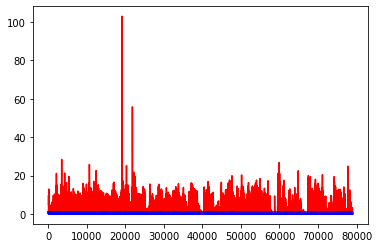

white ratio : 55.75
min : 180
max : 223


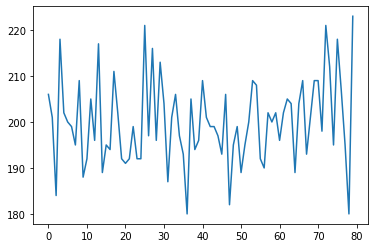

Generating interpolations...
79001 [D loss: 0.001225, acc.: 100.00%] [G loss: 0.012381, 0.007339]
79002 [D loss: 0.002190, acc.: 100.00%] [G loss: 0.013882, 0.002050]
79003 [D loss: 0.000764, acc.: 100.00%] [G loss: 0.001615, 0.000613]
79004 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000065, 0.094508]
79005 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.001089, 0.003277]
79006 [D loss: 0.000863, acc.: 100.00%] [G loss: 0.000136, 0.022078]
79007 [D loss: 0.039455, acc.: 96.88%] [G loss: 0.000000, 0.000000]
79008 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.136649, 0.106869]
79009 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
79010 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.528576, 1.284858]
79011 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.057883, 0.232298]
79012 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.260286, 0.000095]
79013 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.046620, 0.487441]
79014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.419446, 0.777245]
79015 

79122 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.010607, 0.007264]
79123 [D loss: 0.000423, acc.: 100.00%] [G loss: 0.053666, 0.029608]
79124 [D loss: 0.000071, acc.: 100.00%] [G loss: 2.270503, 1.837420]
79125 [D loss: 0.000093, acc.: 100.00%] [G loss: 1.102171, 1.171681]
79126 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000496, 0.045857]
79127 [D loss: 0.060502, acc.: 96.88%] [G loss: 0.723554, 0.894839]
79128 [D loss: 0.053589, acc.: 96.88%] [G loss: 0.049453, 0.060370]
79129 [D loss: 0.001457, acc.: 100.00%] [G loss: 0.000000, 0.000000]
79130 [D loss: 0.000423, acc.: 100.00%] [G loss: 0.024595, 0.016388]
79131 [D loss: 0.003671, acc.: 100.00%] [G loss: 0.159587, 0.007717]
79132 [D loss: 0.001477, acc.: 100.00%] [G loss: 0.018833, 0.001760]
79133 [D loss: 0.002241, acc.: 100.00%] [G loss: 0.000000, 0.000036]
79134 [D loss: 0.001077, acc.: 100.00%] [G loss: 0.000000, 0.000001]
79135 [D loss: 0.000346, acc.: 100.00%] [G loss: 0.000002, 0.000000]
79136 [D loss: 0.001192, acc.: 100.0

79242 [D loss: 0.001833, acc.: 100.00%] [G loss: 0.000000, 0.000246]
79243 [D loss: 0.004380, acc.: 100.00%] [G loss: 0.000000, 0.000000]
79244 [D loss: 0.048451, acc.: 96.88%] [G loss: 0.000015, 0.000198]
79245 [D loss: 0.000871, acc.: 100.00%] [G loss: 0.000015, 0.000138]
79246 [D loss: 0.000504, acc.: 100.00%] [G loss: 0.008287, 0.030068]
79247 [D loss: 0.040909, acc.: 96.88%] [G loss: 0.000508, 0.000016]
79248 [D loss: 0.113880, acc.: 96.88%] [G loss: 0.980528, 0.783148]
79249 [D loss: 0.000387, acc.: 100.00%] [G loss: 2.402471, 0.105998]
79250 [D loss: 0.000064, acc.: 100.00%] [G loss: 1.473866, 1.296726]
79251 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000203, 0.006628]
79252 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.733372, 0.617517]
79253 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.743050, 0.735803]
79254 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.129007, 1.829003]
79255 [D loss: 0.000291, acc.: 100.00%] [G loss: 11.801586, 0.166912]
79256 [D loss: 0.000026, acc.: 100.0

79361 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000514, 0.000617]
79362 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.095539, 0.337256]
79363 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.052851, 0.135150]
79364 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.121755, 0.001907]
79365 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.178148, 0.227713]
79366 [D loss: 0.000540, acc.: 100.00%] [G loss: 0.774975, 0.453577]
79367 [D loss: 0.000429, acc.: 100.00%] [G loss: 0.199060, 0.014720]
79368 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.312840, 0.190639]
79369 [D loss: 0.002838, acc.: 100.00%] [G loss: 10.518288, 1.177278]
79370 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.357566, 0.369254]
79371 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.397548, 0.917062]
79372 [D loss: 0.000823, acc.: 100.00%] [G loss: 1.831527, 0.921436]
79373 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.295964, 0.078960]
79374 [D loss: 0.001340, acc.: 100.00%] [G loss: 0.135586, 0.322652]
79375 [D loss: 0.000333, acc.: 10

79482 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.002927, 0.000182]
79483 [D loss: 0.000192, acc.: 100.00%] [G loss: 8.182283, 0.396038]
79484 [D loss: 0.001226, acc.: 100.00%] [G loss: 0.226455, 0.177229]
79485 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.298659, 0.427959]
79486 [D loss: 0.000436, acc.: 100.00%] [G loss: 0.545673, 0.265120]
79487 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.240369, 0.003505]
79488 [D loss: 0.000910, acc.: 100.00%] [G loss: 0.001069, 0.002230]
79489 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.602008, 1.254631]
79490 [D loss: 0.001191, acc.: 100.00%] [G loss: 0.000014, 0.000010]
79491 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.487381, 0.185151]
79492 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.242435, 1.053346]
79493 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000062, 0.000099]
79494 [D loss: 0.001468, acc.: 100.00%] [G loss: 0.744569, 0.516242]
79495 [D loss: 0.000680, acc.: 100.00%] [G loss: 0.241168, 0.033799]
79496 [D loss: 0.003195, acc.: 100

79601 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.018490, 0.000639]
79602 [D loss: 0.005624, acc.: 100.00%] [G loss: 0.918419, 0.432242]
79603 [D loss: 0.000824, acc.: 100.00%] [G loss: 0.692762, 0.706690]
79604 [D loss: 0.000621, acc.: 100.00%] [G loss: 0.059511, 0.023127]
79605 [D loss: 0.002600, acc.: 100.00%] [G loss: 0.000167, 0.000170]
79606 [D loss: 0.001293, acc.: 100.00%] [G loss: 0.774812, 0.388322]
79607 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.147497, 0.334699]
79608 [D loss: 0.002568, acc.: 100.00%] [G loss: 0.112925, 0.030569]
79609 [D loss: 0.000794, acc.: 100.00%] [G loss: 0.012803, 0.005572]
79610 [D loss: 0.001076, acc.: 100.00%] [G loss: 0.453476, 0.666487]
79611 [D loss: 0.002155, acc.: 100.00%] [G loss: 0.294491, 0.191850]
79612 [D loss: 0.033331, acc.: 96.88%] [G loss: 0.699534, 0.297035]
79613 [D loss: 0.000509, acc.: 100.00%] [G loss: 3.662745, 2.959989]
79614 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.928836, 0.324129]
79615 [D loss: 0.177356, acc.: 96.8

79721 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.242009, 0.470856]
79722 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.356065, 0.043419]
79723 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.454562, 0.672457]
79724 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.559973, 0.070750]
79725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.171429, 0.352013]
79726 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.015964, 0.246392]
79727 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.343249, 0.382588]
79728 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.233616, 1.038654]
79729 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.265176, 0.217208]
79730 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.469184, 0.162958]
79731 [D loss: 0.000260, acc.: 100.00%] [G loss: 0.000013, 0.000000]
79732 [D loss: 0.000005, acc.: 100.00%] [G loss: 7.206581, 0.840935]
79733 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.018054, 0.438456]
79734 [D loss: 0.000069, acc.: 100.00%] [G loss: 1.710777, 1.731383]
79735 [D loss: 0.000006, acc.: 100

79840 [D loss: 0.000753, acc.: 100.00%] [G loss: 0.413142, 0.303161]
79841 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.088047, 0.500944]
79842 [D loss: 0.000307, acc.: 100.00%] [G loss: 14.548863, 0.197587]
79843 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.355706, 3.596164]
79844 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.299191, 0.628740]
79845 [D loss: 0.000345, acc.: 100.00%] [G loss: 3.177773, 3.325310]
79846 [D loss: 0.000078, acc.: 100.00%] [G loss: 1.058549, 2.719132]
79847 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.191390, 0.377080]
79848 [D loss: 0.000063, acc.: 100.00%] [G loss: 1.528328, 1.046384]
79849 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.630411, 0.461263]
79850 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.035602, 0.190938]
79851 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.117500, 1.838291]
79852 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.191526, 0.045770]
79853 [D loss: 0.049257, acc.: 96.88%] [G loss: 0.237067, 0.076272]
79854 [D loss: 0.000214, acc.: 100

79960 [D loss: 0.003082, acc.: 100.00%] [G loss: 0.315125, 0.329168]
79961 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.602950, 1.588755]
79962 [D loss: 0.049722, acc.: 96.88%] [G loss: 0.156091, 0.320910]
79963 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.759172, 0.357600]
79964 [D loss: 0.005570, acc.: 100.00%] [G loss: 1.282532, 4.101324]
79965 [D loss: 0.000123, acc.: 100.00%] [G loss: 9.460512, 3.929657]
79966 [D loss: 0.005940, acc.: 100.00%] [G loss: 0.031709, 0.111734]
79967 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.282262, 0.152607]
79968 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.303297, 2.221223]
79969 [D loss: 0.000797, acc.: 100.00%] [G loss: 45.961723, 4.513281]
79970 [D loss: 0.000222, acc.: 100.00%] [G loss: 3.450760, 3.316438]
79971 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.066025, 0.190641]
79972 [D loss: 0.000033, acc.: 100.00%] [G loss: 2.622631, 3.174233]
79973 [D loss: 0.009867, acc.: 100.00%] [G loss: 0.002678, 0.000451]
79974 [D loss: 0.000021, acc.: 100

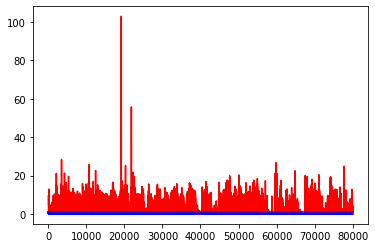

white ratio : 46.75
min : 180
max : 223


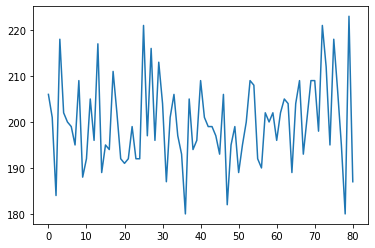

Generating interpolations...
80001 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.237683, 0.131963]
80002 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.165109, 0.127801]
80003 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.131582, 0.330650]
80004 [D loss: 0.023551, acc.: 96.88%] [G loss: 0.559581, 0.419902]
80005 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.435412, 0.435271]
80006 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.039767, 0.431926]
80007 [D loss: 0.000108, acc.: 100.00%] [G loss: 1.103366, 0.586219]
80008 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.009121, 0.001791]
80009 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.235416, 0.296870]
80010 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000058, 0.000005]
80011 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.412206, 1.368406]
80012 [D loss: 0.000502, acc.: 100.00%] [G loss: 0.006955, 0.068136]
80013 [D loss: 0.000524, acc.: 100.00%] [G loss: 2.378282, 1.650277]
80014 [D loss: 0.000750, acc.: 100.00%] [G loss: 0.751846, 0.600131]
80015 

80118 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000794, 0.000031]
80119 [D loss: 0.001085, acc.: 100.00%] [G loss: 0.399693, 0.403111]
80120 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.013374, 0.006399]
80121 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.398483, 0.228932]
80122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.087818, 0.033879]
80123 [D loss: 0.000307, acc.: 100.00%] [G loss: 1.267965, 0.948703]
80124 [D loss: 0.002656, acc.: 100.00%] [G loss: 1.003405, 0.443309]
80125 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.567095, 1.138435]
80126 [D loss: 0.007286, acc.: 100.00%] [G loss: 0.201530, 0.442236]
80127 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.015610, 0.004388]
80128 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.001227, 0.000596]
80129 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.308988, 0.104844]
80130 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001160, 0.000008]
80131 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.334025, 0.604558]
80132 [D loss: 0.000001, acc.: 100

80240 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.999779, 0.728531]
80241 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000352, 0.000036]
80242 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.094398, 0.203951]
80243 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.292852, 1.030489]
80244 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.638262, 0.676917]
80245 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.026584, 0.004308]
80246 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.490992, 0.426862]
80247 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.272307, 0.021110]
80248 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.036876, 0.004124]
80249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.804478, 0.663083]
80250 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000662, 0.000114]
80251 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000389, 0.002730]
80252 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.208988, 0.242913]
80253 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.038311, 0.505508]
80254 [D loss: 0.000012, acc.: 100

80361 [D loss: 0.064811, acc.: 96.88%] [G loss: 0.008237, 0.163763]
80362 [D loss: 0.001437, acc.: 100.00%] [G loss: 0.001117, 0.010589]
80363 [D loss: 0.000981, acc.: 100.00%] [G loss: 0.154489, 0.308309]
80364 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.146119, 0.639569]
80365 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.001831, 0.004582]
80366 [D loss: 0.000449, acc.: 100.00%] [G loss: 0.672926, 0.508718]
80367 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.010109, 0.001979]
80368 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.000022, 0.000031]
80369 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.067265, 0.000343]
80370 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.029254, 0.051445]
80371 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.319948, 0.441037]
80372 [D loss: 0.000039, acc.: 100.00%] [G loss: 8.036238, 1.024059]
80373 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.567959, 0.418208]
80374 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.319759, 0.361803]
80375 [D loss: 0.000556, acc.: 100.

80482 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.540674, 0.560183]
80483 [D loss: 0.002567, acc.: 100.00%] [G loss: 2.542958, 3.015587]
80484 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.178684, 0.188646]
80485 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.670072, 0.468435]
80486 [D loss: 0.005250, acc.: 100.00%] [G loss: 4.030666, 2.943314]
80487 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.049522, 2.591604]
80488 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.254786, 4.127693]
80489 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.016601, 0.279515]
80490 [D loss: 0.025145, acc.: 96.88%] [G loss: 5.797450, 0.195888]
80491 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.126177, 13.485680]
80492 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.544087, 3.282199]
80493 [D loss: 0.003793, acc.: 100.00%] [G loss: 10.539189, 8.978783]
80494 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.343339, 4.400307]
80495 [D loss: 0.000001, acc.: 100.00%] [G loss: 35.502731, 9.054482]
80496 [D loss: 0.000000, acc.: 

80602 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.896476, 0.829796]
80603 [D loss: 0.004062, acc.: 100.00%] [G loss: 0.607757, 0.301030]
80604 [D loss: 0.004437, acc.: 100.00%] [G loss: 3.176712, 2.155844]
80605 [D loss: 0.000586, acc.: 100.00%] [G loss: 5.139246, 4.707829]
80606 [D loss: 0.000181, acc.: 100.00%] [G loss: 19.410648, 0.176683]
80607 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.988393, 1.171192]
80608 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.334356, 0.396216]
80609 [D loss: 0.000029, acc.: 100.00%] [G loss: 2.400351, 3.087296]
80610 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.864060, 4.764125]
80611 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.166574, 0.482147]
80612 [D loss: 0.007644, acc.: 100.00%] [G loss: 1.548509, 1.062886]
80613 [D loss: 0.000058, acc.: 100.00%] [G loss: 2.089374, 1.495554]
80614 [D loss: 0.143528, acc.: 96.88%] [G loss: 1.614399, 0.842636]
80615 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.240562, 0.531777]
80616 [D loss: 0.000034, acc.: 100

80722 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.629122, 1.044235]
80723 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.212927, 0.421074]
80724 [D loss: 0.000005, acc.: 100.00%] [G loss: 14.068863, 5.903069]
80725 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.948315, 0.379071]
80726 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.563680, 0.461321]
80727 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.417767, 0.738429]
80728 [D loss: 0.000486, acc.: 100.00%] [G loss: 5.398826, 7.189389]
80729 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.067806, 3.990835]
80730 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.288906, 2.765564]
80731 [D loss: 0.007245, acc.: 100.00%] [G loss: 11.350460, 11.832100]
80732 [D loss: 0.000184, acc.: 100.00%] [G loss: 1.397086, 0.612263]
80733 [D loss: 0.007693, acc.: 100.00%] [G loss: 8.093008, 7.495528]
80734 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.487864, 2.777068]
80735 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.974417, 2.315620]
80736 [D loss: 0.000014, acc.: 

80843 [D loss: 0.000934, acc.: 100.00%] [G loss: 8.049858, 6.303164]
80844 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.722540, 4.391945]
80845 [D loss: 0.006314, acc.: 100.00%] [G loss: 1.018699, 1.532129]
80846 [D loss: 0.000094, acc.: 100.00%] [G loss: 2.634641, 3.525548]
80847 [D loss: 0.000025, acc.: 100.00%] [G loss: 4.730702, 0.655007]
80848 [D loss: 0.002659, acc.: 100.00%] [G loss: 3.939223, 3.117954]
80849 [D loss: 0.295169, acc.: 96.88%] [G loss: 0.121786, 0.073699]
80850 [D loss: 0.126212, acc.: 96.88%] [G loss: 4.334373, 3.150928]
80851 [D loss: 0.008450, acc.: 100.00%] [G loss: 3.833479, 2.036175]
80852 [D loss: 0.000262, acc.: 100.00%] [G loss: 0.992706, 0.639571]
80853 [D loss: 0.000115, acc.: 100.00%] [G loss: 42.318913, 5.701015]
80854 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.227293, 2.204700]
80855 [D loss: 0.012215, acc.: 100.00%] [G loss: 3.862644, 4.527285]
80856 [D loss: 0.026734, acc.: 96.88%] [G loss: 5.975453, 3.543279]
80857 [D loss: 0.000031, acc.: 100.0

80963 [D loss: 0.004565, acc.: 100.00%] [G loss: 0.014541, 0.001893]
80964 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.157143, 0.011102]
80965 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.374917, 0.847391]
80966 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.134392, 1.365356]
80967 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.004273, 0.130544]
80968 [D loss: 0.001001, acc.: 100.00%] [G loss: 1.975165, 1.511319]
80969 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.302751, 0.177380]
80970 [D loss: 0.002813, acc.: 100.00%] [G loss: 0.007616, 0.003161]
80971 [D loss: 0.005910, acc.: 100.00%] [G loss: 0.044392, 0.002171]
80972 [D loss: 0.007838, acc.: 100.00%] [G loss: 0.006801, 0.026086]
80973 [D loss: 0.000669, acc.: 100.00%] [G loss: 0.385154, 0.731217]
80974 [D loss: 0.014302, acc.: 100.00%] [G loss: 2.731583, 1.344578]
80975 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.049921, 0.000224]
80976 [D loss: 0.015781, acc.: 100.00%] [G loss: 0.345870, 0.131413]
80977 [D loss: 0.000055, acc.: 100

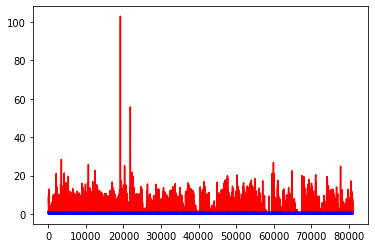

white ratio : 48.0
min : 180
max : 223


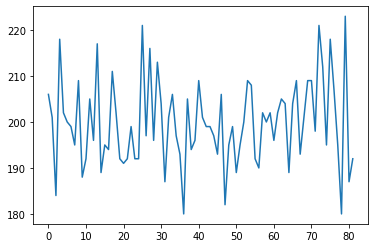

Generating interpolations...
81001 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.476418, 0.047931]
81002 [D loss: 0.003394, acc.: 100.00%] [G loss: 0.000005, 0.000012]
81003 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.042100, 0.195685]
81004 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.796801, 1.770507]
81005 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.005767, 0.001605]
81006 [D loss: 0.007806, acc.: 100.00%] [G loss: 0.157744, 0.164637]
81007 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.157869, 0.188295]
81008 [D loss: 0.000298, acc.: 100.00%] [G loss: 5.403486, 0.223752]
81009 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.491575, 0.704730]
81010 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.010579, 0.013295]
81011 [D loss: 0.002292, acc.: 100.00%] [G loss: 2.846160, 2.317508]
81012 [D loss: 0.000870, acc.: 100.00%] [G loss: 0.284151, 0.266534]
81013 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.663519, 4.033723]
81014 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.585760, 2.205354]
81015

81121 [D loss: 0.004915, acc.: 100.00%] [G loss: 0.000009, 0.000054]
81122 [D loss: 0.001081, acc.: 100.00%] [G loss: 0.002126, 0.002381]
81123 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000000, 0.000000]
81124 [D loss: 0.009406, acc.: 100.00%] [G loss: 0.000001, 0.000001]
81125 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.005207, 0.000557]
81126 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.027705, 0.016376]
81127 [D loss: 0.011797, acc.: 100.00%] [G loss: 0.020063, 0.011543]
81128 [D loss: 0.000457, acc.: 100.00%] [G loss: 0.000280, 0.003153]
81129 [D loss: 0.006951, acc.: 100.00%] [G loss: 0.000054, 0.000003]
81130 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.003652, 0.000841]
81131 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.023245, 0.014791]
81132 [D loss: 0.007248, acc.: 100.00%] [G loss: 0.071716, 0.218987]
81133 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000278, 0.012976]
81134 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000005, 0.000254]
81135 [D loss: 0.000060, acc.: 100

81241 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.315345, 0.983283]
81242 [D loss: 0.122110, acc.: 96.88%] [G loss: 0.121899, 0.019098]
81243 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.554991, 0.708053]
81244 [D loss: 0.000282, acc.: 100.00%] [G loss: 9.654024, 9.283651]
81245 [D loss: 0.000476, acc.: 100.00%] [G loss: 27.581758, 0.327458]
81246 [D loss: 0.000859, acc.: 100.00%] [G loss: 9.458256, 8.738691]
81247 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.118723, 0.071798]
81248 [D loss: 0.000109, acc.: 100.00%] [G loss: 1.379049, 0.370477]
81249 [D loss: 0.109286, acc.: 96.88%] [G loss: 2.350107, 2.013126]
81250 [D loss: 0.002242, acc.: 100.00%] [G loss: 0.015676, 0.009743]
81251 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.204136, 0.036790]
81252 [D loss: 0.001368, acc.: 100.00%] [G loss: 0.170588, 0.090204]
81253 [D loss: 0.087228, acc.: 96.88%] [G loss: 0.001980, 0.000001]
81254 [D loss: 0.003552, acc.: 100.00%] [G loss: 0.064406, 0.028865]
81255 [D loss: 0.041801, acc.: 96.88

81361 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.928756, 0.626508]
81362 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.044730, 0.193865]
81363 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001938, 0.000010]
81364 [D loss: 0.038144, acc.: 96.88%] [G loss: 0.089044, 0.220237]
81365 [D loss: 0.000094, acc.: 100.00%] [G loss: 1.022610, 0.467858]
81366 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.041642, 0.190182]
81367 [D loss: 0.000014, acc.: 100.00%] [G loss: 2.310264, 2.650728]
81368 [D loss: 0.000208, acc.: 100.00%] [G loss: 13.263107, 5.667603]
81369 [D loss: 0.001454, acc.: 100.00%] [G loss: 1.438323, 0.960555]
81370 [D loss: 0.005495, acc.: 100.00%] [G loss: 0.915413, 0.373180]
81371 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.390285, 0.172086]
81372 [D loss: 0.000773, acc.: 100.00%] [G loss: 0.062945, 0.302335]
81373 [D loss: 0.000018, acc.: 100.00%] [G loss: 5.502178, 3.979269]
81374 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.383907, 0.712460]
81375 [D loss: 0.000091, acc.: 100

81481 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.466681, 0.731266]
81482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.084145, 0.012182]
81483 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.415218, 0.610804]
81484 [D loss: 0.003972, acc.: 100.00%] [G loss: 0.451812, 1.230766]
81485 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.616317, 0.709763]
81486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.034436, 0.007844]
81487 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.303643, 1.148520]
81488 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.015318, 0.022352]
81489 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.586728, 1.951563]
81490 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000346, 0.006346]
81491 [D loss: 0.000127, acc.: 100.00%] [G loss: 2.961421, 0.092691]
81492 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.251466, 0.075415]
81493 [D loss: 0.000024, acc.: 100.00%] [G loss: 3.545668, 2.290497]
81494 [D loss: 0.000029, acc.: 100.00%] [G loss: 3.393959, 2.469215]
81495 [D loss: 0.000003, acc.: 100

81600 [D loss: 0.027543, acc.: 100.00%] [G loss: 17.476244, 3.375453]
81601 [D loss: 0.007764, acc.: 100.00%] [G loss: 4.173752, 3.801804]
81602 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.121881, 0.000525]
81603 [D loss: 0.000277, acc.: 100.00%] [G loss: 0.435733, 0.355079]
81604 [D loss: 0.005425, acc.: 100.00%] [G loss: 1.846102, 0.630652]
81605 [D loss: 0.000927, acc.: 100.00%] [G loss: 1.321480, 0.922903]
81606 [D loss: 0.002408, acc.: 100.00%] [G loss: 4.229023, 3.508274]
81607 [D loss: 0.000533, acc.: 100.00%] [G loss: 2.054264, 1.368880]
81608 [D loss: 0.003006, acc.: 100.00%] [G loss: 96.749664, 3.327543]
81609 [D loss: 0.000563, acc.: 100.00%] [G loss: 3.654768, 4.598063]
81610 [D loss: 0.025562, acc.: 96.88%] [G loss: 4.936216, 4.242065]
81611 [D loss: 0.000709, acc.: 100.00%] [G loss: 2.196504, 2.094100]
81612 [D loss: 0.000997, acc.: 100.00%] [G loss: 0.330031, 0.027390]
81613 [D loss: 0.002329, acc.: 100.00%] [G loss: 6.257115, 5.438539]
81614 [D loss: 0.000234, acc.: 10

81721 [D loss: 0.000412, acc.: 100.00%] [G loss: 23.264820, 8.571144]
81722 [D loss: 0.002174, acc.: 100.00%] [G loss: 0.000098, 0.149785]
81723 [D loss: 0.001080, acc.: 100.00%] [G loss: 8.233479, 9.154450]
81724 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.377904, 2.064269]
81725 [D loss: 0.000630, acc.: 100.00%] [G loss: 8.556836, 9.650312]
81726 [D loss: 0.000889, acc.: 100.00%] [G loss: 17.163576, 12.133770]
81727 [D loss: 0.000316, acc.: 100.00%] [G loss: 1.661591, 1.902852]
81728 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.079096, 15.966806]
81729 [D loss: 0.000018, acc.: 100.00%] [G loss: 15.226950, 14.830170]
81730 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.589733, 4.627627]
81731 [D loss: 0.000016, acc.: 100.00%] [G loss: 8.952559, 10.982575]
81732 [D loss: 0.000017, acc.: 100.00%] [G loss: 9.672955, 7.894999]
81733 [D loss: 0.000043, acc.: 100.00%] [G loss: 11.342908, 8.650548]
81734 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.979017, 0.265260]
81735 [D loss: 0.000054, 

81842 [D loss: 0.000128, acc.: 100.00%] [G loss: 8.429474, 6.889177]
81843 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.071885, 0.035219]
81844 [D loss: 0.000037, acc.: 100.00%] [G loss: 9.290374, 8.155374]
81845 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.163989, 0.436562]
81846 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001161, 0.055063]
81847 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.415318, 10.231606]
81848 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.554596, 5.918109]
81849 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.348631, 0.540222]
81850 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.402698, 2.507311]
81851 [D loss: 0.000262, acc.: 100.00%] [G loss: 0.953895, 0.411800]
81852 [D loss: 0.000258, acc.: 100.00%] [G loss: 21.297989, 4.224164]
81853 [D loss: 0.005767, acc.: 100.00%] [G loss: 2.521534, 3.555671]
81854 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.794641, 9.998025]
81855 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.051576, 4.844633]
81856 [D loss: 0.000132, acc.: 

81960 [D loss: 0.000085, acc.: 100.00%] [G loss: 5.972921, 5.518753]
81961 [D loss: 0.000120, acc.: 100.00%] [G loss: 9.823658, 9.082785]
81962 [D loss: 0.000002, acc.: 100.00%] [G loss: 17.406452, 17.467628]
81963 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.831495, 6.132646]
81964 [D loss: 0.000001, acc.: 100.00%] [G loss: 15.179802, 14.300154]
81965 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.745894, 5.514830]
81966 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.136195, 3.646327]
81967 [D loss: 0.000034, acc.: 100.00%] [G loss: 13.939805, 16.092655]
81968 [D loss: 0.000839, acc.: 100.00%] [G loss: 1.228423, 3.557307]
81969 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.262986, 0.467927]
81970 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.667232, 3.788070]
81971 [D loss: 0.002090, acc.: 100.00%] [G loss: 13.337950, 10.966347]
81972 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.841693, 0.569277]
81973 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.850365, 2.652915]
81974 [D loss: 0.000044, a

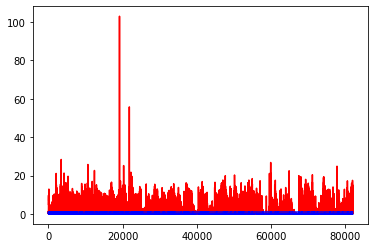

white ratio : 50.5
min : 180
max : 223


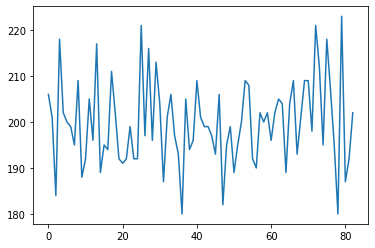

Generating interpolations...
82001 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.274862, 1.154126]
82002 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.094746, 7.076359]
82003 [D loss: 0.000020, acc.: 100.00%] [G loss: 9.886859, 10.736311]
82004 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.833803, 11.506996]
82005 [D loss: 0.000041, acc.: 100.00%] [G loss: 11.572872, 8.149157]
82006 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.792649, 0.524805]
82007 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.976927, 10.274925]
82008 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.042300, 0.145325]
82009 [D loss: 0.000003, acc.: 100.00%] [G loss: 15.003328, 7.859826]
82010 [D loss: 0.000013, acc.: 100.00%] [G loss: 38.057652, 14.293396]
82011 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.496550, 16.759205]
82012 [D loss: 0.000043, acc.: 100.00%] [G loss: 16.505932, 16.369705]
82013 [D loss: 0.002220, acc.: 100.00%] [G loss: 14.915624, 13.109663]
82014 [D loss: 0.000010, acc.: 100.00%] [G loss: 14.229626,

82121 [D loss: 0.000394, acc.: 100.00%] [G loss: 1.529394, 1.734679]
82122 [D loss: 0.000785, acc.: 100.00%] [G loss: 0.372964, 0.167620]
82123 [D loss: 0.004179, acc.: 100.00%] [G loss: 7.164524, 5.624501]
82124 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.097959, 0.030307]
82125 [D loss: 0.000023, acc.: 100.00%] [G loss: 4.713910, 2.443316]
82126 [D loss: 0.000879, acc.: 100.00%] [G loss: 1.221885, 2.556774]
82127 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.989722, 0.431820]
82128 [D loss: 0.001822, acc.: 100.00%] [G loss: 1.090027, 3.283136]
82129 [D loss: 0.000286, acc.: 100.00%] [G loss: 15.886612, 13.715095]
82130 [D loss: 0.000062, acc.: 100.00%] [G loss: 3.137529, 3.641604]
82131 [D loss: 0.000010, acc.: 100.00%] [G loss: 5.571848, 3.256371]
82132 [D loss: 0.009191, acc.: 100.00%] [G loss: 12.874950, 1.082984]
82133 [D loss: 0.000079, acc.: 100.00%] [G loss: 12.611897, 8.974108]
82134 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.299180, 0.384177]
82135 [D loss: 0.000061, acc.:

82242 [D loss: 0.000252, acc.: 100.00%] [G loss: 6.228802, 5.429305]
82243 [D loss: 0.000027, acc.: 100.00%] [G loss: 13.815370, 5.859038]
82244 [D loss: 0.010171, acc.: 100.00%] [G loss: 0.008375, 0.002309]
82245 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.373526, 10.056533]
82246 [D loss: 0.000014, acc.: 100.00%] [G loss: 6.049635, 2.360429]
82247 [D loss: 0.039570, acc.: 96.88%] [G loss: 9.653000, 8.341730]
82248 [D loss: 0.000086, acc.: 100.00%] [G loss: 14.857551, 12.675703]
82249 [D loss: 0.000018, acc.: 100.00%] [G loss: 18.113369, 15.954472]
82250 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.380649, 6.388021]
82251 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.911798, 1.697717]
82252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.726937, 1.068790]
82253 [D loss: 0.000042, acc.: 100.00%] [G loss: 13.963915, 17.748360]
82254 [D loss: 0.000129, acc.: 100.00%] [G loss: 5.625101, 8.892004]
82255 [D loss: 0.000001, acc.: 100.00%] [G loss: 16.081263, 15.141029]
82256 [D loss: 0.000001

82361 [D loss: 0.000106, acc.: 100.00%] [G loss: 4.399346, 2.402157]
82362 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.250530, 9.850862]
82363 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.816250, 16.517147]
82364 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.267115, 3.678865]
82365 [D loss: 0.000151, acc.: 100.00%] [G loss: 15.220171, 13.559908]
82366 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.155689, 3.779933]
82367 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.729564, 6.504738]
82368 [D loss: 0.000483, acc.: 100.00%] [G loss: 15.928506, 16.436766]
82369 [D loss: 0.001396, acc.: 100.00%] [G loss: 16.437288, 15.641233]
82370 [D loss: 0.000007, acc.: 100.00%] [G loss: 8.917366, 9.748350]
82371 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.150108, 5.257346]
82372 [D loss: 0.000047, acc.: 100.00%] [G loss: 10.259884, 10.034897]
82373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.207156, 0.262291]
82374 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.890661, 3.478048]
82375 [D loss: 0.000048,

82481 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.273672, 1.378659]
82482 [D loss: 0.000008, acc.: 100.00%] [G loss: 13.650875, 13.267315]
82483 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.181920, 9.859929]
82484 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.511841, 13.173916]
82485 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.477257, 4.339891]
82486 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.221801, 4.345889]
82487 [D loss: 0.078472, acc.: 96.88%] [G loss: 9.883307, 3.386576]
82488 [D loss: 0.000739, acc.: 100.00%] [G loss: 5.821786, 6.606573]
82489 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.246154, 0.376971]
82490 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.069863, 0.034722]
82491 [D loss: 0.000590, acc.: 100.00%] [G loss: 0.371769, 0.598857]
82492 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.239721, 0.006510]
82493 [D loss: 0.002335, acc.: 100.00%] [G loss: 0.020258, 0.177547]
82494 [D loss: 0.000017, acc.: 100.00%] [G loss: 5.990805, 4.305857]
82495 [D loss: 0.000019, acc.:

82600 [D loss: 0.000001, acc.: 100.00%] [G loss: 19.370275, 18.305763]
82601 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.018255, 13.292118]
82602 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.443880, 9.948305]
82603 [D loss: 0.000000, acc.: 100.00%] [G loss: 18.367008, 16.979965]
82604 [D loss: 0.000001, acc.: 100.00%] [G loss: 19.622734, 19.038458]
82605 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.924082, 0.909317]
82606 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.400539, 19.070633]
82607 [D loss: 0.000001, acc.: 100.00%] [G loss: 17.658478, 19.070547]
82608 [D loss: 0.000006, acc.: 100.00%] [G loss: 16.902170, 15.725513]
82609 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.182316, 6.934203]
82610 [D loss: 0.000014, acc.: 100.00%] [G loss: 16.223635, 15.860367]
82611 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.335452, 0.739316]
82612 [D loss: 0.000045, acc.: 100.00%] [G loss: 8.823524, 9.173721]
82613 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.546373, 0.260637]
82614 [D loss: 0.0

82719 [D loss: 0.000105, acc.: 100.00%] [G loss: 12.624643, 11.229574]
82720 [D loss: 0.000064, acc.: 100.00%] [G loss: 14.784838, 14.368901]
82721 [D loss: 0.000105, acc.: 100.00%] [G loss: 11.496529, 10.473957]
82722 [D loss: 0.000009, acc.: 100.00%] [G loss: 11.979713, 9.720604]
82723 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.848036, 0.022221]
82724 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.547205, 11.803384]
82725 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.104759, 0.214758]
82726 [D loss: 0.000727, acc.: 100.00%] [G loss: 11.088579, 10.020010]
82727 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.101666, 0.040630]
82728 [D loss: 0.000011, acc.: 100.00%] [G loss: 15.307444, 14.182074]
82729 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.699495, 1.045142]
82730 [D loss: 0.000853, acc.: 100.00%] [G loss: 0.022364, 0.307553]
82731 [D loss: 0.000018, acc.: 100.00%] [G loss: 15.655695, 13.914279]
82732 [D loss: 0.000010, acc.: 100.00%] [G loss: 11.108469, 9.251144]
82733 [D loss: 0.

82837 [D loss: 0.000259, acc.: 100.00%] [G loss: 0.003518, 0.074597]
82838 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.775788, 1.129266]
82839 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.062978, 0.611298]
82840 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.270342, 0.268677]
82841 [D loss: 0.000712, acc.: 100.00%] [G loss: 6.142624, 4.190427]
82842 [D loss: 0.000038, acc.: 100.00%] [G loss: 21.041443, 9.532863]
82843 [D loss: 0.000031, acc.: 100.00%] [G loss: 8.563810, 7.163054]
82844 [D loss: 0.000332, acc.: 100.00%] [G loss: 0.298179, 0.223841]
82845 [D loss: 0.000241, acc.: 100.00%] [G loss: 2.317056, 2.086993]
82846 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.385147, 4.961860]
82847 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.448796, 0.184700]
82848 [D loss: 0.000368, acc.: 100.00%] [G loss: 5.562951, 5.311155]
82849 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.849352, 4.538635]
82850 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.009890, 0.000798]
82851 [D loss: 0.025145, acc.: 96

82957 [D loss: 0.002009, acc.: 100.00%] [G loss: 0.319986, 0.619211]
82958 [D loss: 0.000022, acc.: 100.00%] [G loss: 7.185246, 7.109760]
82959 [D loss: 0.004377, acc.: 100.00%] [G loss: 15.828542, 11.478305]
82960 [D loss: 0.000026, acc.: 100.00%] [G loss: 13.095882, 11.057644]
82961 [D loss: 0.000023, acc.: 100.00%] [G loss: 8.826750, 8.397076]
82962 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.090908, 0.083722]
82963 [D loss: 0.000044, acc.: 100.00%] [G loss: 9.150537, 8.846649]
82964 [D loss: 0.001285, acc.: 100.00%] [G loss: 7.054960, 6.398240]
82965 [D loss: 0.000044, acc.: 100.00%] [G loss: 13.897251, 10.314211]
82966 [D loss: 0.000152, acc.: 100.00%] [G loss: 9.844048, 9.898897]
82967 [D loss: 0.000019, acc.: 100.00%] [G loss: 11.898162, 10.282871]
82968 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.002257, 4.579399]
82969 [D loss: 0.000021, acc.: 100.00%] [G loss: 22.275555, 9.912491]
82970 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.324649, 0.733740]
82971 [D loss: 0.000084, 

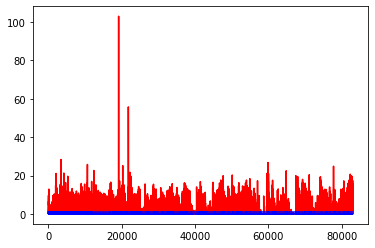

white ratio : 47.5
min : 180
max : 223


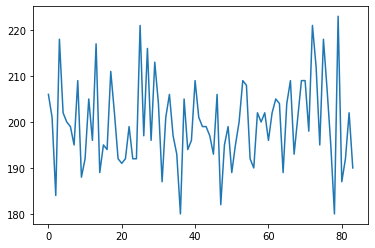

Generating interpolations...
83001 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.325635, 9.527449]
83002 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.729121, 2.856782]
83003 [D loss: 0.000550, acc.: 100.00%] [G loss: 10.030310, 8.297750]
83004 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.811661, 0.200807]
83005 [D loss: 0.000231, acc.: 100.00%] [G loss: 14.914022, 13.591633]
83006 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.693884, 6.436999]
83007 [D loss: 0.000077, acc.: 100.00%] [G loss: 11.527370, 11.035754]
83008 [D loss: 0.001654, acc.: 100.00%] [G loss: 15.194931, 6.382303]
83009 [D loss: 0.000022, acc.: 100.00%] [G loss: 4.642594, 5.551552]
83010 [D loss: 0.001017, acc.: 100.00%] [G loss: 10.239186, 8.077274]
83011 [D loss: 0.000040, acc.: 100.00%] [G loss: 11.427108, 10.353209]
83012 [D loss: 0.000192, acc.: 100.00%] [G loss: 14.082966, 9.270843]
83013 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.366603, 4.736773]
83014 [D loss: 0.000539, acc.: 100.00%] [G loss: 15.050683, 14.2

83121 [D loss: 0.000007, acc.: 100.00%] [G loss: 11.187157, 9.726242]
83122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.453166, 0.318622]
83123 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.188206, 0.178489]
83124 [D loss: 0.000003, acc.: 100.00%] [G loss: 21.989225, 13.572955]
83125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.221447, 0.458287]
83126 [D loss: 0.000001, acc.: 100.00%] [G loss: 17.730904, 15.531540]
83127 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.765009, 12.767973]
83128 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.512842, 0.914078]
83129 [D loss: 0.000003, acc.: 100.00%] [G loss: 14.552536, 14.857105]
83130 [D loss: 0.028327, acc.: 96.88%] [G loss: 11.975272, 5.400079]
83131 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.005858, 0.013438]
83132 [D loss: 0.000293, acc.: 100.00%] [G loss: 12.898638, 11.464115]
83133 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.210881, 0.007243]
83134 [D loss: 0.000026, acc.: 100.00%] [G loss: 13.877792, 11.952252]
83135 [D loss: 0.0000

83240 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.585792, 0.471476]
83241 [D loss: 0.000169, acc.: 100.00%] [G loss: 2.627564, 1.179291]
83242 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.091883, 0.061462]
83243 [D loss: 0.000302, acc.: 100.00%] [G loss: 15.123888, 10.408789]
83244 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.395313, 7.373097]
83245 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.982679, 1.076682]
83246 [D loss: 0.000694, acc.: 100.00%] [G loss: 0.438836, 0.247664]
83247 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.031642, 0.098035]
83248 [D loss: 0.000662, acc.: 100.00%] [G loss: 0.365578, 0.012324]
83249 [D loss: 0.007679, acc.: 100.00%] [G loss: 0.282644, 0.099802]
83250 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.128560, 0.165799]
83251 [D loss: 0.000631, acc.: 100.00%] [G loss: 0.095816, 0.063368]
83252 [D loss: 0.000022, acc.: 100.00%] [G loss: 11.042656, 9.665545]
83253 [D loss: 0.000093, acc.: 100.00%] [G loss: 10.780138, 9.390188]
83254 [D loss: 0.001855, acc.

83360 [D loss: 0.000015, acc.: 100.00%] [G loss: 16.165688, 14.192866]
83361 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.171349, 0.278197]
83362 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.490160, 8.689891]
83363 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.220139, 4.776933]
83364 [D loss: 0.003524, acc.: 100.00%] [G loss: 8.073512, 8.058617]
83365 [D loss: 0.000185, acc.: 100.00%] [G loss: 8.865882, 9.501438]
83366 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.275070, 0.184134]
83367 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.650276, 5.086839]
83368 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.373900, 0.038612]
83369 [D loss: 0.002337, acc.: 100.00%] [G loss: 8.989742, 6.431215]
83370 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.183324, 0.553049]
83371 [D loss: 0.005220, acc.: 100.00%] [G loss: 0.164477, 0.262045]
83372 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.167721, 0.299315]
83373 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.789538, 2.784431]
83374 [D loss: 0.006545, acc.:

83480 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.434526, 0.493402]
83481 [D loss: 0.000140, acc.: 100.00%] [G loss: 1.779884, 0.998260]
83482 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.071323, 0.433220]
83483 [D loss: 0.000161, acc.: 100.00%] [G loss: 10.031135, 11.446236]
83484 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.348232, 0.584765]
83485 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.220843, 0.236621]
83486 [D loss: 0.000226, acc.: 100.00%] [G loss: 1.391045, 1.118582]
83487 [D loss: 0.000951, acc.: 100.00%] [G loss: 0.387569, 0.528095]
83488 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.253569, 0.336209]
83489 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.518009, 0.648332]
83490 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.365355, 0.869266]
83491 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.310169, 0.254729]
83492 [D loss: 0.000647, acc.: 100.00%] [G loss: 12.610970, 11.853161]
83493 [D loss: 0.000410, acc.: 100.00%] [G loss: 0.355990, 0.334593]
83494 [D loss: 0.000078, acc.:

83598 [D loss: 0.000779, acc.: 100.00%] [G loss: 0.236925, 0.170215]
83599 [D loss: 0.007050, acc.: 100.00%] [G loss: 0.013523, 0.006363]
83600 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.081384, 0.057384]
83601 [D loss: 0.057261, acc.: 96.88%] [G loss: 0.056939, 0.099658]
83602 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.113798, 0.013935]
83603 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.156184, 0.262598]
83604 [D loss: 0.000030, acc.: 100.00%] [G loss: 5.526072, 4.112275]
83605 [D loss: 0.000473, acc.: 100.00%] [G loss: 0.000002, 0.027777]
83606 [D loss: 0.002835, acc.: 100.00%] [G loss: 0.000056, 0.000003]
83607 [D loss: 0.008860, acc.: 100.00%] [G loss: 0.023097, 0.070190]
83608 [D loss: 0.001088, acc.: 100.00%] [G loss: 0.005393, 0.005728]
83609 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.032244, 0.015730]
83610 [D loss: 0.001228, acc.: 100.00%] [G loss: 0.010306, 0.123920]
83611 [D loss: 0.000680, acc.: 100.00%] [G loss: 0.059574, 0.000005]
83612 [D loss: 0.000029, acc.: 100.

83717 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.006171, 0.007549]
83718 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000732, 0.022029]
83719 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.379306, 2.390871]
83720 [D loss: 0.001967, acc.: 100.00%] [G loss: 0.735069, 0.004209]
83721 [D loss: 0.010067, acc.: 100.00%] [G loss: 0.226022, 0.287555]
83722 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.471206, 0.025534]
83723 [D loss: 0.000446, acc.: 100.00%] [G loss: 8.032381, 9.497957]
83724 [D loss: 0.001632, acc.: 100.00%] [G loss: 5.738959, 6.186121]
83725 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.268078, 0.167144]
83726 [D loss: 0.004504, acc.: 100.00%] [G loss: 8.943390, 7.073240]
83727 [D loss: 0.001139, acc.: 100.00%] [G loss: 0.120684, 0.125268]
83728 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.186122, 0.008084]
83729 [D loss: 0.000019, acc.: 100.00%] [G loss: 18.626305, 9.431864]
83730 [D loss: 0.103409, acc.: 93.75%] [G loss: 3.388564, 2.089638]
83731 [D loss: 0.007706, acc.: 100

83837 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.295010, 0.556391]
83838 [D loss: 0.003838, acc.: 100.00%] [G loss: 6.517189, 3.518568]
83839 [D loss: 0.000027, acc.: 100.00%] [G loss: 3.149311, 0.001557]
83840 [D loss: 0.004235, acc.: 100.00%] [G loss: 4.327617, 5.174284]
83841 [D loss: 0.000040, acc.: 100.00%] [G loss: 3.803333, 2.973468]
83842 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.597044, 0.156837]
83843 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000053, 0.035558]
83844 [D loss: 0.008017, acc.: 100.00%] [G loss: 0.344772, 0.289760]
83845 [D loss: 0.083255, acc.: 96.88%] [G loss: 0.008377, 0.157647]
83846 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.072390, 0.063156]
83847 [D loss: 0.050984, acc.: 96.88%] [G loss: 10.223806, 7.862091]
83848 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.854854, 0.455481]
83849 [D loss: 0.003239, acc.: 100.00%] [G loss: 6.225854, 5.285696]
83850 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000343, 0.000039]
83851 [D loss: 0.000056, acc.: 100.

83957 [D loss: 0.000075, acc.: 100.00%] [G loss: 1.066033, 1.175695]
83958 [D loss: 0.002483, acc.: 100.00%] [G loss: 4.873969, 2.983591]
83959 [D loss: 0.000443, acc.: 100.00%] [G loss: 0.792623, 0.028719]
83960 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.357705, 0.100802]
83961 [D loss: 0.001106, acc.: 100.00%] [G loss: 0.000004, 0.000030]
83962 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000127, 0.000070]
83963 [D loss: 0.075135, acc.: 96.88%] [G loss: 0.001906, 0.000136]
83964 [D loss: 0.022546, acc.: 100.00%] [G loss: 0.071154, 0.086085]
83965 [D loss: 0.111323, acc.: 93.75%] [G loss: 7.301822, 7.304222]
83966 [D loss: 0.000309, acc.: 100.00%] [G loss: 10.983419, 10.844988]
83967 [D loss: 0.118912, acc.: 96.88%] [G loss: 4.005491, 5.192126]
83968 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.204690, 0.101777]
83969 [D loss: 0.018728, acc.: 100.00%] [G loss: 0.000000, 0.000005]
83970 [D loss: 0.002255, acc.: 100.00%] [G loss: 3.851353, 4.119234]
83971 [D loss: 0.000927, acc.: 100.

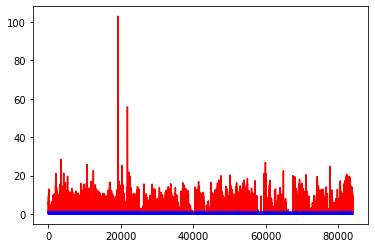

white ratio : 57.0
min : 180
max : 228


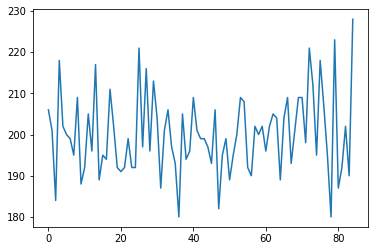

Generating interpolations...
84001 [D loss: 0.000059, acc.: 100.00%] [G loss: 5.738973, 3.907719]
84002 [D loss: 0.000031, acc.: 100.00%] [G loss: 6.707267, 4.554433]
84003 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.012003, 0.000819]
84004 [D loss: 0.000597, acc.: 100.00%] [G loss: 0.193308, 0.001812]
84005 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.064107, 0.590544]
84006 [D loss: 0.006681, acc.: 100.00%] [G loss: 3.847048, 4.196839]
84007 [D loss: 0.003008, acc.: 100.00%] [G loss: 0.005282, 0.000101]
84008 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84009 [D loss: 0.003007, acc.: 100.00%] [G loss: 2.777447, 0.461821]
84010 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.001288, 0.001491]
84011 [D loss: 0.000649, acc.: 100.00%] [G loss: 5.055592, 3.719392]
84012 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.034781, 0.154794]
84013 [D loss: 0.004227, acc.: 100.00%] [G loss: 0.002501, 0.001286]
84014 [D loss: 0.000350, acc.: 100.00%] [G loss: 0.000148, 0.000077]
84015

84122 [D loss: 0.000533, acc.: 100.00%] [G loss: 0.019330, 0.001073]
84123 [D loss: 0.001867, acc.: 100.00%] [G loss: 0.051778, 0.154551]
84124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.011702, 0.165622]
84125 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000142, 0.002757]
84126 [D loss: 0.000132, acc.: 100.00%] [G loss: 4.705850, 4.003070]
84127 [D loss: 0.000047, acc.: 100.00%] [G loss: 4.373620, 2.535751]
84128 [D loss: 0.000316, acc.: 100.00%] [G loss: 5.329830, 5.435202]
84129 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.022289, 0.060856]
84130 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.233304, 0.700263]
84131 [D loss: 0.000359, acc.: 100.00%] [G loss: 0.426408, 0.019820]
84132 [D loss: 0.002512, acc.: 100.00%] [G loss: 0.000189, 0.000013]
84133 [D loss: 0.000032, acc.: 100.00%] [G loss: 4.888754, 0.715752]
84134 [D loss: 0.000469, acc.: 100.00%] [G loss: 0.000003, 0.000000]
84135 [D loss: 0.000218, acc.: 100.00%] [G loss: 13.718762, 0.488388]
84136 [D loss: 0.000052, acc.: 10

84244 [D loss: 0.000182, acc.: 100.00%] [G loss: 4.511690, 4.427489]
84245 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.052989, 0.032755]
84246 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.101005, 0.439193]
84247 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.006283, 0.003632]
84248 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000005, 0.000002]
84249 [D loss: 0.026030, acc.: 96.88%] [G loss: 0.159874, 0.068841]
84250 [D loss: 0.004331, acc.: 100.00%] [G loss: 0.007432, 0.000107]
84251 [D loss: 0.012554, acc.: 100.00%] [G loss: 5.557585, 4.078417]
84252 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.177213, 2.684693]
84253 [D loss: 0.000035, acc.: 100.00%] [G loss: 5.947957, 4.038665]
84254 [D loss: 0.000524, acc.: 100.00%] [G loss: 1.182812, 0.226266]
84255 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.017310, 0.000227]
84256 [D loss: 0.007004, acc.: 100.00%] [G loss: 6.071098, 5.555655]
84257 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.033838, 0.025345]
84258 [D loss: 0.000736, acc.: 100.

84365 [D loss: 0.000125, acc.: 100.00%] [G loss: 5.073550, 5.968652]
84366 [D loss: 0.006680, acc.: 100.00%] [G loss: 4.625640, 5.391962]
84367 [D loss: 0.000070, acc.: 100.00%] [G loss: 4.175034, 5.268320]
84368 [D loss: 0.001151, acc.: 100.00%] [G loss: 5.615006, 0.856550]
84369 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000345, 0.000382]
84370 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84371 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.037127, 0.174672]
84372 [D loss: 0.000428, acc.: 100.00%] [G loss: 0.000000, 0.000002]
84373 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.085886, 1.859155]
84374 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000004, 0.000026]
84375 [D loss: 0.001118, acc.: 100.00%] [G loss: 5.828137, 7.404773]
84376 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.752098, 0.608086]
84377 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.006245, 0.007443]
84378 [D loss: 0.000105, acc.: 100.00%] [G loss: 3.548882, 4.114328]
84379 [D loss: 0.000187, acc.: 100

84485 [D loss: 0.001691, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84486 [D loss: 0.011067, acc.: 100.00%] [G loss: 0.004128, 0.205157]
84487 [D loss: 0.000096, acc.: 100.00%] [G loss: 2.946180, 2.874113]
84488 [D loss: 0.050741, acc.: 96.88%] [G loss: 0.000000, 0.000000]
84489 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.822504, 0.324346]
84490 [D loss: 0.008071, acc.: 100.00%] [G loss: 0.048463, 0.000054]
84491 [D loss: 0.000071, acc.: 100.00%] [G loss: 2.014795, 2.706612]
84492 [D loss: 0.002778, acc.: 100.00%] [G loss: 0.009049, 0.173589]
84493 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84494 [D loss: 0.002961, acc.: 100.00%] [G loss: 0.276524, 0.000954]
84495 [D loss: 0.000066, acc.: 100.00%] [G loss: 1.373746, 0.776145]
84496 [D loss: 0.000385, acc.: 100.00%] [G loss: 2.018117, 1.617605]
84497 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84498 [D loss: 0.004338, acc.: 100.00%] [G loss: 0.087200, 0.516424]
84499 [D loss: 0.000476, acc.: 100.

84604 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.084252, 0.258607]
84605 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000004, 0.000002]
84606 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.295209, 0.071119]
84607 [D loss: 0.007954, acc.: 100.00%] [G loss: 2.716035, 1.922751]
84608 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.129921, 0.481031]
84609 [D loss: 0.000203, acc.: 100.00%] [G loss: 1.342055, 0.617109]
84610 [D loss: 0.000361, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84611 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.239993, 1.961887]
84612 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000004, 0.000000]
84613 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.002845, 0.007687]
84614 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84615 [D loss: 0.001135, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84616 [D loss: 0.000675, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84617 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.249569, 0.125969]
84618 [D loss: 0.000026, acc.: 100

84725 [D loss: 0.000548, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84726 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.003499, 0.094201]
84727 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.001573, 0.000163]
84728 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84729 [D loss: 0.000532, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84730 [D loss: 0.000544, acc.: 100.00%] [G loss: 0.505762, 0.547625]
84731 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.763376, 0.905158]
84732 [D loss: 0.001441, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84733 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000007, 0.000000]
84734 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000009, 0.000002]
84735 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84736 [D loss: 0.000339, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84737 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84738 [D loss: 0.000653, acc.: 100.00%] [G loss: 0.217128, 0.217016]
84739 [D loss: 0.000088, acc.: 100

84844 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.043191, 0.066201]
84845 [D loss: 0.000859, acc.: 100.00%] [G loss: 0.000017, 0.000003]
84846 [D loss: 0.000531, acc.: 100.00%] [G loss: 0.795547, 1.031895]
84847 [D loss: 0.022903, acc.: 96.88%] [G loss: 0.126955, 0.115012]
84848 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.175092, 0.101855]
84849 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.251105, 0.226772]
84850 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.115458, 0.265363]
84851 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.083848, 0.005476]
84852 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000001, 0.000000]
84853 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.096273, 0.078181]
84854 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.191219, 0.087476]
84855 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.117813, 0.311247]
84856 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000000, 0.000000]
84857 [D loss: 0.001595, acc.: 100.00%] [G loss: 0.732036, 0.354906]
84858 [D loss: 0.000005, acc.: 100.

84966 [D loss: 0.001052, acc.: 100.00%] [G loss: 0.000000, 0.000001]
84967 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.324666, 1.456840]
84968 [D loss: 0.000097, acc.: 100.00%] [G loss: 1.129188, 1.236693]
84969 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.019074, 0.000035]
84970 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000013]
84971 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.095823, 0.249220]
84972 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.163686, 0.642699]
84973 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.040261, 1.720438]
84974 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000000, 0.000001]
84975 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.004416, 0.003780]
84976 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000013, 0.000000]
84977 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.532100, 1.398173]
84978 [D loss: 0.000653, acc.: 100.00%] [G loss: 0.190436, 0.200445]
84979 [D loss: 0.000745, acc.: 100.00%] [G loss: 2.241381, 1.491974]
84980 [D loss: 0.000863, acc.: 100

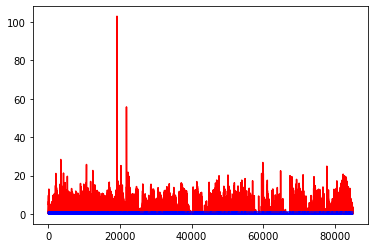

white ratio : 51.25
min : 180
max : 228


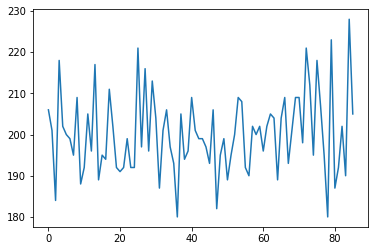

Generating interpolations...
85001 [D loss: 0.000561, acc.: 100.00%] [G loss: 0.002248, 0.000207]
85002 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.462790, 4.594705]
85003 [D loss: 0.003094, acc.: 100.00%] [G loss: 0.162148, 0.072874]
85004 [D loss: 0.001866, acc.: 100.00%] [G loss: 0.125273, 0.195030]
85005 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.126205, 0.000021]
85006 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.000001, 0.000000]
85007 [D loss: 0.000488, acc.: 100.00%] [G loss: 9.292679, 6.738227]
85008 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.866040, 6.436094]
85009 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000443, 0.005385]
85010 [D loss: 0.000144, acc.: 100.00%] [G loss: 4.242663, 2.723357]
85011 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000018, 0.000049]
85012 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.045740, 1.980904]
85013 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.234148, 1.305799]
85014 [D loss: 0.000209, acc.: 100.00%] [G loss: 2.561358, 2.097852]
85015

85117 [D loss: 0.052757, acc.: 96.88%] [G loss: 0.001751, 0.000840]
85118 [D loss: 0.000540, acc.: 100.00%] [G loss: 0.000004, 0.000021]
85119 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.000000, 0.000000]
85120 [D loss: 0.000382, acc.: 100.00%] [G loss: 0.049962, 0.001336]
85121 [D loss: 0.000564, acc.: 100.00%] [G loss: 0.009934, 0.057275]
85122 [D loss: 0.000294, acc.: 100.00%] [G loss: 0.001924, 0.000209]
85123 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000001, 0.000000]
85124 [D loss: 0.000957, acc.: 100.00%] [G loss: 0.002298, 0.013800]
85125 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
85126 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.019793, 0.026781]
85127 [D loss: 0.001689, acc.: 100.00%] [G loss: 0.001120, 0.021787]
85128 [D loss: 0.000472, acc.: 100.00%] [G loss: 0.000001, 0.000000]
85129 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.000015, 0.000001]
85130 [D loss: 0.001773, acc.: 100.00%] [G loss: 0.008292, 0.052204]
85131 [D loss: 0.000034, acc.: 100.

85238 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.599264, 1.608790]
85239 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.103894, 0.042595]
85240 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.760594, 0.398211]
85241 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.085750, 0.058648]
85242 [D loss: 0.001808, acc.: 100.00%] [G loss: 1.898670, 1.139030]
85243 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.244660, 0.184636]
85244 [D loss: 0.000008, acc.: 100.00%] [G loss: 12.466101, 4.916568]
85245 [D loss: 0.000023, acc.: 100.00%] [G loss: 7.205997, 7.775950]
85246 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.835843, 0.456036]
85247 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.625301, 0.618229]
85248 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.679708, 1.397727]
85249 [D loss: 0.001493, acc.: 100.00%] [G loss: 8.010602, 5.456023]
85250 [D loss: 0.000005, acc.: 100.00%] [G loss: 7.959140, 6.186934]
85251 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.584607, 8.145783]
85252 [D loss: 0.004789, acc.: 10

85359 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.336275, 13.211660]
85360 [D loss: 0.000015, acc.: 100.00%] [G loss: 11.323047, 10.682323]
85361 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.646263, 11.313242]
85362 [D loss: 0.000025, acc.: 100.00%] [G loss: 11.772371, 10.849216]
85363 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.539274, 10.656498]
85364 [D loss: 0.000021, acc.: 100.00%] [G loss: 7.210457, 5.749600]
85365 [D loss: 0.001025, acc.: 100.00%] [G loss: 11.124266, 10.147074]
85366 [D loss: 0.032456, acc.: 96.88%] [G loss: 6.001272, 5.522615]
85367 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.205420, 4.347396]
85368 [D loss: 0.000013, acc.: 100.00%] [G loss: 8.433580, 8.844004]
85369 [D loss: 0.000061, acc.: 100.00%] [G loss: 3.218761, 3.119070]
85370 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.603741, 3.814468]
85371 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.051356, 3.960466]
85372 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.561629, 1.340135]
85373 [D loss: 0.000001

85479 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.678816, 0.854960]
85480 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.852107, 0.693207]
85481 [D loss: 0.006383, acc.: 100.00%] [G loss: 0.364885, 0.115961]
85482 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.119522, 1.985701]
85483 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.074773, 0.070749]
85484 [D loss: 0.003203, acc.: 100.00%] [G loss: 1.408615, 0.158683]
85485 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.221356, 0.746115]
85486 [D loss: 0.000269, acc.: 100.00%] [G loss: 0.506448, 0.365157]
85487 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.774968, 0.349875]
85488 [D loss: 0.082574, acc.: 96.88%] [G loss: 6.380200, 4.330989]
85489 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.024817, 0.137341]
85490 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.016080, 0.026656]
85491 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.305589, 1.741204]
85492 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.007685, 0.001567]
85493 [D loss: 0.000012, acc.: 100.

85599 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.699695, 0.196484]
85600 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.080880, 2.245017]
85601 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.066649, 0.502655]
85602 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.056934, 0.199189]
85603 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.181952, 0.427412]
85604 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.119998, 1.201660]
85605 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.162910, 0.298002]
85606 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.139776, 0.032350]
85607 [D loss: 0.010575, acc.: 100.00%] [G loss: 0.022948, 0.040687]
85608 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.834630, 0.865515]
85609 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.235926, 0.046541]
85610 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.013091, 0.000933]
85611 [D loss: 0.000088, acc.: 100.00%] [G loss: 3.564779, 0.964467]
85612 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.009254, 0.024040]
85613 [D loss: 0.000007, acc.: 100

85719 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.173591, 0.351416]
85720 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.089903, 0.076778]
85721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.183930, 0.023748]
85722 [D loss: 0.005462, acc.: 100.00%] [G loss: 0.005654, 0.057890]
85723 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000016, 0.000342]
85724 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.095211, 0.302485]
85725 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000372, 0.009038]
85726 [D loss: 0.005445, acc.: 100.00%] [G loss: 0.035457, 0.029326]
85727 [D loss: 0.002406, acc.: 100.00%] [G loss: 0.000727, 0.000026]
85728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.511729, 0.050964]
85729 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001077, 0.019539]
85730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004337, 0.020922]
85731 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.463559, 0.571115]
85732 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.784838, 0.335336]
85733 [D loss: 0.000001, acc.: 100

85841 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.195285, 0.208649]
85842 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.000018, 0.000090]
85843 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.047480, 0.113908]
85844 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.160793, 0.081039]
85845 [D loss: 0.000005, acc.: 100.00%] [G loss: 16.698719, 0.002026]
85846 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.011993, 0.016162]
85847 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000697, 0.000503]
85848 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.100117, 0.367633]
85849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.587415, 0.608691]
85850 [D loss: 0.000394, acc.: 100.00%] [G loss: 0.347164, 0.433426]
85851 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.266129, 0.292090]
85852 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.133453, 0.130193]
85853 [D loss: 0.000222, acc.: 100.00%] [G loss: 0.150975, 0.020625]
85854 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.242371, 0.043678]
85855 [D loss: 0.000000, acc.: 10

85963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000008]
85964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013167, 0.015593]
85965 [D loss: 0.000308, acc.: 100.00%] [G loss: 0.001371, 0.000655]
85966 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000001, 0.000027]
85967 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.325594, 0.000003]
85968 [D loss: 0.001168, acc.: 100.00%] [G loss: 0.040680, 0.000607]
85969 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.010487, 0.000958]
85970 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.021145, 0.042136]
85971 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.000085, 0.000019]
85972 [D loss: 0.036667, acc.: 96.88%] [G loss: 0.000001, 0.000003]
85973 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000785, 0.000031]
85974 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003046, 0.020112]
85975 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006819, 0.000903]
85976 [D loss: 0.004973, acc.: 100.00%] [G loss: 0.006607, 0.041487]
85977 [D loss: 0.011978, acc.: 100.

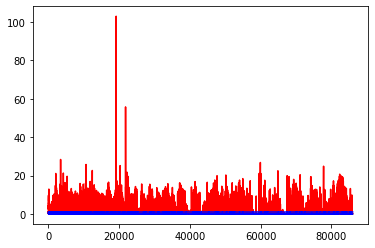

white ratio : 51.25
min : 180
max : 228


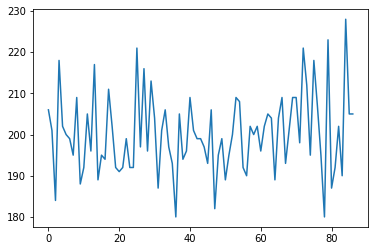

Generating interpolations...
86001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86002 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86003 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86004 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000116, 0.001325]
86005 [D loss: 0.000522, acc.: 100.00%] [G loss: 0.000000, 0.000001]
86006 [D loss: 0.000318, acc.: 100.00%] [G loss: 0.000039, 0.000347]
86007 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86008 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86009 [D loss: 0.000805, acc.: 100.00%] [G loss: 0.000006, 0.000005]
86010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003151, 0.000625]
86011 [D loss: 0.000472, acc.: 100.00%] [G loss: 0.000034, 0.000001]
86012 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000002, 0.000000]
86013 [D loss: 0.002470, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86014 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.000060, 0.000168]
86015

86120 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000004, 0.000261]
86121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.011032, 0.037377]
86122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002101, 0.003518]
86123 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.027413, 0.023249]
86124 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.003827, 0.002305]
86125 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000215, 0.004561]
86126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001567, 0.000220]
86127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86128 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.001704, 0.000728]
86129 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.000001]
86130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
86131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000001]
86132 [D loss: 0.026472, acc.: 100.00%] [G loss: 0.002356, 0.013716]
86133 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000094, 0.000372]
86134 [D loss: 0.000000, acc.: 100

86240 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000065, 0.000010]
86241 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000005, 0.000294]
86242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000006]
86243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000104, 0.000008]
86244 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000017, 0.000001]
86245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000012, 0.000212]
86246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
86247 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000698, 0.008497]
86248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000021, 0.007477]
86249 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000585, 0.000041]
86250 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000000, 0.000002]
86251 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.003821, 0.000056]
86252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000035, 0.000056]
86253 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000002, 0.000039]
86254 [D loss: 0.000015, acc.: 100

86361 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.031341, 0.001666]
86362 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.133820, 0.213136]
86363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.139954, 0.099027]
86364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.183116, 0.225724]
86365 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.054154, 0.106100]
86366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.138854, 0.040907]
86367 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.028784, 0.297689]
86368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.063036, 0.136380]
86369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.051377, 0.164917]
86370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.101952, 0.346421]
86371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000068, 0.000994]
86372 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.125500, 0.156423]
86373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.060360, 0.099420]
86374 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.030760, 0.236409]
86375 [D loss: 0.000000, acc.: 100

86481 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.001207, 0.004718]
86482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000001]
86483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000999, 0.000075]
86484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000162]
86485 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000001, 0.000000]
86486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000081]
86487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
86488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000001]
86489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000753, 0.002607]
86490 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000135, 0.000074]
86491 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000016, 0.000033]
86492 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.457051, 0.031797]
86493 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000109, 0.000157]
86494 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002074, 0.000554]
86495 [D loss: 0.000000, acc.: 100

86602 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.000016, 0.000054]
86603 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000818, 0.000097]
86604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000043]
86605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000633]
86606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000004]
86607 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000554, 0.000064]
86608 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86609 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000001, 0.000000]
86610 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000007]
86611 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000018]
86613 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000145, 0.006836]
86614 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86615 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000215, 0.000031]
86616 [D loss: 0.000001, acc.: 100

86721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001700, 0.000446]
86722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000228, 0.001531]
86723 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000009]
86724 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.023855, 0.000283]
86725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000447, 0.000227]
86726 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000010, 0.000000]
86727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000000]
86728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000003]
86729 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.000151, 0.002504]
86730 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002752, 0.012295]
86731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000235, 0.000849]
86732 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000000, 0.000001]
86733 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000003, 0.000075]
86734 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000023, 0.000043]
86735 [D loss: 0.000609, acc.: 100

86843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000040, 0.000109]
86844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000407, 0.000021]
86847 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000265]
86848 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000810, 0.018746]
86849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000003]
86850 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000079, 0.000012]
86852 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000000]
86853 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86854 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000017]
86855 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000002]
86856 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000046, 0.000037]
86857 [D loss: 0.000040, acc.: 100

86963 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000003, 0.000000]
86964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
86965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000012, 0.000104]
86966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000052, 0.000014]
86967 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000006]
86968 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000810, 0.000148]
86969 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000023, 0.000210]
86970 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.003337, 0.000548]
86971 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000081, 0.000004]
86972 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001285, 0.000136]
86973 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000006]
86974 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000085]
86975 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000013, 0.000014]
86976 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003557, 0.008861]
86977 [D loss: 0.000000, acc.: 100

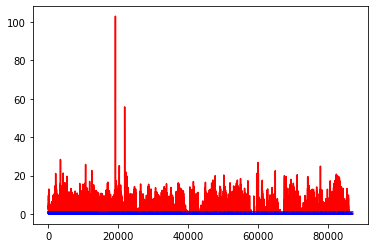

white ratio : 48.25
min : 180
max : 228


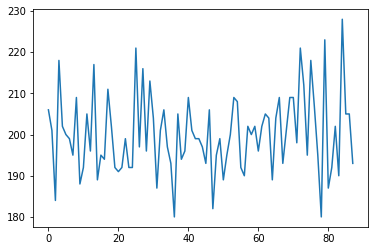

Generating interpolations...
87001 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000009, 0.000001]
87002 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000015, 0.000006]
87003 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000022, 0.000001]
87004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000095]
87005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
87006 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000015, 0.000004]
87007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
87008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
87009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
87010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
87011 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000055, 0.000014]
87012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.016891, 0.006554]
87013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000019, 0.000001]
87014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
87015

87120 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.007203, 0.015832]
87121 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000000, 0.000104]
87122 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000044, 0.000000]
87123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027081, 0.010097]
87124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000125, 0.000022]
87125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000134, 0.000635]
87126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000207, 0.000003]
87127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.128782, 0.140327]
87128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000015]
87129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001822, 0.058234]
87130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
87131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002449, 0.000004]
87132 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001333, 0.001492]
87133 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.811478, 0.063033]
87134 [D loss: 0.000000, acc.: 100

87242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.287295, 0.148912]
87243 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.786569, 0.929076]
87244 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.010780, 0.003246]
87245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.048312, 0.051745]
87246 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.157428, 0.432512]
87247 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.092131, 0.027726]
87248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001813, 0.037339]
87249 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.241806, 0.080365]
87250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.029343, 0.005753]
87251 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.238599, 0.239176]
87252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013114, 0.012552]
87253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008996, 0.002269]
87254 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021187, 0.009757]
87255 [D loss: 0.000445, acc.: 100.00%] [G loss: 0.007467, 0.065234]
87256 [D loss: 0.000000, acc.: 100

87362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012276, 0.001931]
87363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000091, 0.000083]
87364 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000440, 0.000299]
87365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000405, 0.000622]
87366 [D loss: 0.000350, acc.: 100.00%] [G loss: 0.000429, 0.000526]
87367 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000019, 0.000031]
87368 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.001154, 0.001130]
87369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.109928, 0.003369]
87370 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.000000, 0.000000]
87371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
87372 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039310, 0.021660]
87373 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001204, 0.000172]
87374 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000015, 0.000008]
87375 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000078, 0.000036]
87376 [D loss: 0.000001, acc.: 100

87482 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.001230, 0.001981]
87483 [D loss: 0.001017, acc.: 100.00%] [G loss: 0.039716, 0.001841]
87484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000351, 0.001104]
87485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001779, 0.008357]
87486 [D loss: 0.000575, acc.: 100.00%] [G loss: 0.001177, 0.000616]
87487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010715, 0.026230]
87488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.072282, 0.024449]
87489 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.000094, 0.000038]
87490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002825, 0.003513]
87491 [D loss: 0.000363, acc.: 100.00%] [G loss: 0.034940, 0.006691]
87492 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000022, 0.000460]
87493 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001435, 0.000175]
87494 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000294, 0.000436]
87495 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.005242, 0.034782]
87496 [D loss: 0.000000, acc.: 100

87601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000007]
87602 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000019, 0.000005]
87603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000086, 0.000903]
87604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.059356, 0.093255]
87605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.069639, 0.068521]
87606 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.046680, 0.055238]
87607 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.124166, 0.034365]
87608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000375, 0.049128]
87609 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.128464, 0.050708]
87610 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.330959, 0.100214]
87611 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.098658, 0.179535]
87612 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.322347, 0.036310]
87613 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.011900, 0.150452]
87614 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.091479, 0.150883]
87615 [D loss: 0.000000, acc.: 100

87720 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.013711, 0.001344]
87721 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.602548, 0.059846]
87722 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.299061, 0.141603]
87723 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.001362, 0.000090]
87724 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.006354, 0.024652]
87725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008582, 0.031309]
87726 [D loss: 0.000651, acc.: 100.00%] [G loss: 0.006117, 0.008873]
87727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039217, 0.094979]
87728 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.035886, 0.071769]
87729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007381, 0.010572]
87730 [D loss: 0.001214, acc.: 100.00%] [G loss: 0.011881, 0.072177]
87731 [D loss: 0.002678, acc.: 100.00%] [G loss: 0.325938, 0.193836]
87732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001262, 0.000424]
87733 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.003555, 0.006342]
87734 [D loss: 0.001730, acc.: 100

87839 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000151, 0.000005]
87840 [D loss: 0.000316, acc.: 100.00%] [G loss: 0.000902, 0.002317]
87841 [D loss: 0.002098, acc.: 100.00%] [G loss: 0.000000, 0.000000]
87842 [D loss: 0.000243, acc.: 100.00%] [G loss: 0.005470, 0.026700]
87843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002600, 0.009586]
87844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000299, 0.004152]
87845 [D loss: 0.001033, acc.: 100.00%] [G loss: 0.000105, 0.000114]
87846 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.006231, 0.001140]
87847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.487296, 0.092421]
87848 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.713051, 1.062929]
87849 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.160649, 0.070659]
87850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000040, 0.000252]
87851 [D loss: 0.005888, acc.: 100.00%] [G loss: 0.062731, 0.223120]
87852 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.980692, 0.222243]
87853 [D loss: 0.000000, acc.: 100

87958 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.361310, 0.478151]
87959 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.137454, 0.152816]
87960 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.114105, 0.034469]
87961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.411446, 0.325057]
87962 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.207619, 0.081546]
87963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.057427, 0.193791]
87964 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.510910, 0.400569]
87965 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.208117, 0.203712]
87966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.050179, 0.092125]
87967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.118378, 0.242489]
87968 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.013173, 0.065201]
87969 [D loss: 0.003690, acc.: 100.00%] [G loss: 0.364251, 0.188507]
87970 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.345056, 0.500733]
87971 [D loss: 0.002574, acc.: 100.00%] [G loss: 1.208537, 0.440937]
87972 [D loss: 0.000016, acc.: 100

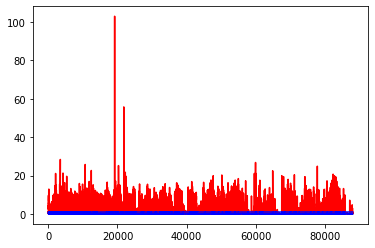

white ratio : 49.0
min : 180
max : 228


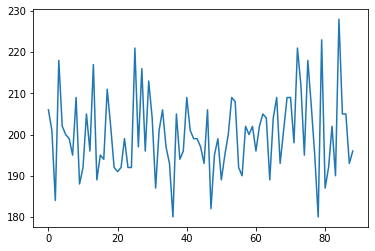

Generating interpolations...
88001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.043394, 0.178947]
88002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.155356, 0.055347]
88003 [D loss: 0.001966, acc.: 100.00%] [G loss: 0.121146, 0.171395]
88004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.852152, 0.447096]
88005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.191515, 0.124930]
88006 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.441213, 0.464574]
88007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.609490, 0.140431]
88008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.638595, 0.765873]
88009 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.009092, 0.002304]
88010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.042057, 0.058175]
88011 [D loss: 0.000985, acc.: 100.00%] [G loss: 0.475541, 0.473732]
88012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.524549, 0.704508]
88013 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.081367, 1.190406]
88014 [D loss: 0.000452, acc.: 100.00%] [G loss: 0.312043, 0.463241]
88015

88121 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000128, 0.000010]
88122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.080870, 0.002360]
88123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000074, 0.000019]
88124 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.031862, 0.003736]
88125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000073, 0.000114]
88126 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.004458, 0.023721]
88127 [D loss: 0.000743, acc.: 100.00%] [G loss: 0.000005, 0.000009]
88128 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
88129 [D loss: 0.000454, acc.: 100.00%] [G loss: 0.000044, 0.000012]
88130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000026]
88131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001322, 0.001155]
88132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025694, 0.003374]
88133 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.066248, 0.007953]
88134 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
88135 [D loss: 0.000020, acc.: 100

88242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002173, 0.000834]
88243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001155, 0.000668]
88244 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000798, 0.045782]
88245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000005, 0.000005]
88246 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000004, 0.000143]
88247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.008118, 0.001175]
88248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000015, 0.000011]
88249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000233, 0.003378]
88250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000033, 0.000497]
88251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010264, 0.000211]
88252 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.000183, 0.001351]
88253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019261, 0.000036]
88254 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000049]
88255 [D loss: 0.000901, acc.: 100.00%] [G loss: 0.000016, 0.000006]
88256 [D loss: 0.000000, acc.: 100

88362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000333, 0.000074]
88363 [D loss: 0.001347, acc.: 100.00%] [G loss: 0.048302, 0.000383]
88364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000350, 0.001123]
88365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001606, 0.030567]
88366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000395, 0.024971]
88367 [D loss: 0.059233, acc.: 96.88%] [G loss: 0.002685, 0.004720]
88368 [D loss: 0.001056, acc.: 100.00%] [G loss: 0.000010, 0.000001]
88369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
88370 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000002, 0.000006]
88371 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000030, 0.000001]
88372 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.000044, 0.000021]
88373 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000631, 0.000006]
88374 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000001]
88375 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000215]
88376 [D loss: 0.000093, acc.: 100.

88484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000040, 0.000001]
88485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013865, 0.001592]
88486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001386, 0.001175]
88487 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.279908, 0.111658]
88488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.044090, 0.033806]
88489 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.055912, 0.324816]
88490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.038615, 0.015888]
88491 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000018, 0.000017]
88492 [D loss: 0.002019, acc.: 100.00%] [G loss: 0.001371, 0.008377]
88493 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000856, 0.000111]
88494 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.076605, 0.008943]
88495 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000092, 0.005841]
88496 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.009288, 0.016525]
88497 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000427, 0.000084]
88498 [D loss: 0.000000, acc.: 100

88606 [D loss: 0.003735, acc.: 100.00%] [G loss: 5.934637, 0.359784]
88607 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.795852, 2.007977]
88608 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.404478, 2.506323]
88609 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.455984, 6.245964]
88610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.124647, 0.215729]
88611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.253807, 0.208395]
88612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000122, 0.000243]
88613 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.032060, 0.043489]
88614 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.785709, 0.147996]
88615 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.765687, 3.264364]
88616 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.635442, 0.611141]
88617 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.909398, 1.100279]
88618 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.157864, 2.770573]
88619 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.802384, 1.907995]
88620 [D loss: 0.000000, acc.: 100

88726 [D loss: 0.001884, acc.: 100.00%] [G loss: 0.000012, 0.000014]
88727 [D loss: 0.001030, acc.: 100.00%] [G loss: 0.000036, 0.000005]
88728 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000000, 0.000000]
88729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000013, 0.000003]
88730 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000001, 0.000000]
88731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000003]
88732 [D loss: 0.003121, acc.: 100.00%] [G loss: 0.007796, 0.000371]
88733 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000032, 0.000582]
88734 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000016]
88735 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000002]
88736 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000005, 0.000396]
88737 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003253, 0.000562]
88738 [D loss: 0.003249, acc.: 100.00%] [G loss: 0.000015, 0.000051]
88739 [D loss: 0.002319, acc.: 100.00%] [G loss: 0.000004, 0.000001]
88740 [D loss: 0.000000, acc.: 100

88848 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.033105, 0.027759]
88849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.035001, 0.014010]
88850 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.058298, 0.023146]
88851 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000043, 0.000080]
88852 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012044, 0.103971]
88853 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.274300, 0.680564]
88854 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.132765, 0.093583]
88855 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.422182, 0.831318]
88856 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.216154, 0.246018]
88857 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001737, 0.000117]
88858 [D loss: 0.001592, acc.: 100.00%] [G loss: 0.052604, 0.062886]
88859 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.027053, 0.079133]
88860 [D loss: 0.001186, acc.: 100.00%] [G loss: 0.000010, 0.000012]
88861 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009622, 0.081641]
88862 [D loss: 0.000001, acc.: 100

88970 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.063973, 0.073837]
88971 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.366400, 4.672038]
88972 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.024830, 2.663752]
88973 [D loss: 0.000040, acc.: 100.00%] [G loss: 14.221925, 5.579215]
88974 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.375611, 8.312198]
88975 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.663133, 6.834361]
88976 [D loss: 0.000136, acc.: 100.00%] [G loss: 8.351048, 7.768563]
88977 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.226647, 7.878343]
88978 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.499645, 6.552630]
88979 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.494020, 2.869292]
88980 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.326269, 1.646999]
88981 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.195470, 2.771595]
88982 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.665622, 1.199768]
88983 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.371509, 2.201261]
88984 [D loss: 0.000036, acc.: 10

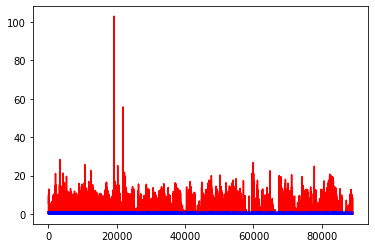

white ratio : 44.25
model saved!!!!!!!!!!!!!!!!!
min : 177
max : 228


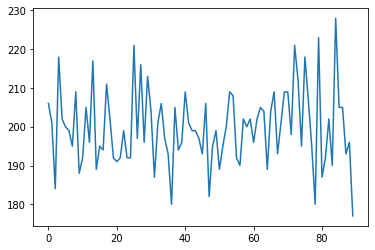

Generating interpolations...
89001 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.000253, 0.000471]
89002 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.204038, 0.209118]
89003 [D loss: 0.000608, acc.: 100.00%] [G loss: 0.299561, 0.206943]
89004 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.000382, 0.000661]
89005 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.001362, 0.005185]
89006 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000145, 0.000132]
89007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000098, 0.000050]
89008 [D loss: 0.000493, acc.: 100.00%] [G loss: 0.000464, 0.012078]
89009 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.247600, 0.165333]
89010 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.091320, 0.011755]
89011 [D loss: 0.001053, acc.: 100.00%] [G loss: 0.027923, 0.035706]
89012 [D loss: 0.000424, acc.: 100.00%] [G loss: 0.003371, 0.004943]
89013 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.093630, 0.199572]
89014 [D loss: 0.003619, acc.: 100.00%] [G loss: 0.004521, 0.000414]
89015

89121 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.398253, 2.844939]
89122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.444573, 0.299546]
89123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.909997, 1.281345]
89124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.929648, 0.514546]
89125 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.450894, 1.597656]
89126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.459610, 0.043086]
89127 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.266749, 0.752695]
89128 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.104223, 0.055707]
89129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009571, 0.081493]
89130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.238854, 0.309615]
89131 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.051535, 0.002012]
89132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000052, 0.000000]
89133 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.009596, 0.011781]
89134 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.192938, 0.037218]
89135 [D loss: 0.000000, acc.: 100

89242 [D loss: 0.002479, acc.: 100.00%] [G loss: 0.000448, 0.005074]
89243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.051672, 0.015099]
89244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.100589, 0.126534]
89245 [D loss: 0.001546, acc.: 100.00%] [G loss: 0.054736, 0.056100]
89246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002004, 0.000644]
89247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000807, 0.000841]
89248 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.857143, 0.347665]
89249 [D loss: 0.001250, acc.: 100.00%] [G loss: 0.013710, 0.025514]
89250 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.004088, 0.009045]
89251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000201, 0.000071]
89252 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.346528, 0.121885]
89253 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.030597, 0.152490]
89254 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.762550, 0.167928]
89255 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.007739, 0.005918]
89256 [D loss: 0.000000, acc.: 100

89364 [D loss: 0.000524, acc.: 100.00%] [G loss: 0.001454, 0.001941]
89365 [D loss: 0.000271, acc.: 100.00%] [G loss: 0.035888, 0.092866]
89366 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000233, 0.001468]
89367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001901, 0.008468]
89368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.088522, 0.043134]
89369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.442872, 0.000121]
89370 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.286747, 0.361403]
89371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004105, 0.012155]
89372 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.013791, 0.187093]
89373 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000499, 0.000531]
89374 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.068443, 0.057699]
89375 [D loss: 0.000487, acc.: 100.00%] [G loss: 0.200812, 0.047772]
89376 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.057263, 0.001885]
89377 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.000013, 0.001726]
89378 [D loss: 0.000147, acc.: 100

89486 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.162748, 0.025278]
89487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001960, 0.000793]
89488 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000517, 0.000630]
89489 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.001789, 0.000755]
89490 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.041427, 0.000786]
89491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.112737, 0.055577]
89492 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.001647, 0.001853]
89493 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005459, 0.029529]
89494 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.008585, 0.071543]
89495 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004613, 0.001869]
89496 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.054312, 0.000687]
89497 [D loss: 0.001004, acc.: 100.00%] [G loss: 0.027514, 0.098141]
89498 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.045970, 0.004465]
89499 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.024805, 0.019425]
89500 [D loss: 0.000000, acc.: 100

89606 [D loss: 0.062725, acc.: 96.88%] [G loss: 0.000000, 0.000000]
89607 [D loss: 0.007967, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89608 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89609 [D loss: 0.004559, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
89612 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89613 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89614 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89615 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89616 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89617 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89618 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89619 [D loss: 0.000321, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89620 [D loss: 0.000000, acc.: 100.

89725 [D loss: 0.004278, acc.: 100.00%] [G loss: 0.000001, 0.000597]
89726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000000]
89727 [D loss: 0.000389, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89728 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.016659]
89730 [D loss: 0.000703, acc.: 100.00%] [G loss: 0.000263, 0.036081]
89731 [D loss: 0.001927, acc.: 100.00%] [G loss: 0.000252, 0.000012]
89732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89733 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000001, 0.000018]
89734 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000116, 0.002235]
89735 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.000011, 0.000019]
89736 [D loss: 0.001300, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89737 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.000034, 0.000015]
89738 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000006, 0.000002]
89739 [D loss: 0.000151, acc.: 100

89844 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000630, 0.001455]
89845 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000073, 0.000032]
89846 [D loss: 0.001002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89847 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000197, 0.000710]
89848 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.031893, 0.089095]
89849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.263703, 0.052745]
89850 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000125, 0.000000]
89851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039974, 0.047134]
89852 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89853 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89854 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000061, 0.000139]
89855 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
89856 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
89857 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.078208]
89858 [D loss: 0.000015, acc.: 100

89966 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000079, 0.005059]
89967 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.001700, 0.000240]
89968 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000148, 0.002908]
89969 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000000]
89970 [D loss: 0.020279, acc.: 100.00%] [G loss: 0.013878, 0.000473]
89971 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.518716, 0.003941]
89972 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.772136, 0.483508]
89973 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.271731, 0.032475]
89974 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011917, 0.000126]
89975 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001010, 0.001283]
89976 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.003435, 0.118753]
89977 [D loss: 0.011691, acc.: 100.00%] [G loss: 0.000000, 0.000062]
89978 [D loss: 0.000373, acc.: 100.00%] [G loss: 0.010232, 0.033638]
89979 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000001, 0.000000]
89980 [D loss: 0.002630, acc.: 100

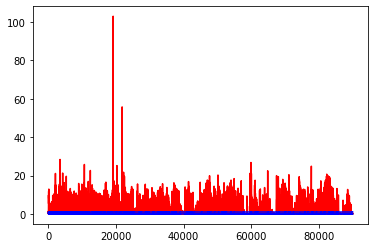

white ratio : 49.5
min : 177
max : 228


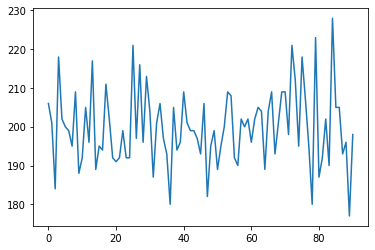

Generating interpolations...
90001 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.006368, 0.001908]
90002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011229, 0.000008]
90003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000009]
90004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000116]
90005 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000337, 0.000008]
90006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000376, 0.001083]
90007 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000000, 0.000003]
90008 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000569, 0.000356]
90009 [D loss: 0.000376, acc.: 100.00%] [G loss: 0.003738, 0.031337]
90010 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001168, 0.001150]
90011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000014]
90012 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000005, 0.000002]
90013 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000727, 0.002741]
90014 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000001, 0.000003]
90015

90119 [D loss: 0.000614, acc.: 100.00%] [G loss: 0.000000, 0.000001]
90120 [D loss: 0.003141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90122 [D loss: 0.000469, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90123 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000001, 0.000000]
90124 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90125 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90126 [D loss: 0.001466, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90127 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90128 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90129 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000013]
90131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90133 [D loss: 0.000000, acc.: 100

90238 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90239 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.000003, 0.000000]
90240 [D loss: 0.000507, acc.: 100.00%] [G loss: 0.000016, 0.000019]
90241 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000132, 0.000008]
90243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000022]
90245 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000004, 0.000159]
90246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000028, 0.000001]
90247 [D loss: 0.011590, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90248 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000000, 0.000001]
90249 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90250 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90251 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90252 [D loss: 0.000143, acc.: 100

90358 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.000001, 0.000000]
90359 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90360 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90361 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000014, 0.000000]
90362 [D loss: 0.001051, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90363 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90365 [D loss: 0.004434, acc.: 100.00%] [G loss: 0.000000, 0.000002]
90366 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000001]
90367 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90368 [D loss: 0.001409, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90369 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90370 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000002, 0.000000]
90371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90372 [D loss: 0.007677, acc.: 100

90479 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000003, 0.000005]
90480 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000012, 0.000003]
90481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90483 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000472, 0.009564]
90485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90486 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000002, 0.000265]
90487 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000001, 0.000001]
90488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
90490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
90491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000001]
90492 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000038]
90493 [D loss: 0.000013, acc.: 100

90600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.034537]
90601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000069]
90602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000002]
90603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023909, 0.054864]
90604 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000013, 0.000000]
90605 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.006717, 0.004218]
90606 [D loss: 0.000517, acc.: 100.00%] [G loss: 0.000011, 0.019225]
90607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000324, 0.002300]
90608 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000046, 0.000171]
90609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000109]
90610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000265, 0.000318]
90611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000193, 0.000026]
90612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021049, 0.000000]
90613 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.000004, 0.000131]
90614 [D loss: 0.000000, acc.: 100

90721 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000013]
90722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000142, 0.000356]
90723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.030855, 0.002133]
90724 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.125264, 0.000714]
90725 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000052, 0.000056]
90726 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001699, 0.008689]
90727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.107560, 0.000121]
90728 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000404, 0.000095]
90729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.121045, 0.001620]
90730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000022, 0.000088]
90731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000080, 0.000016]
90732 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000023, 0.000175]
90733 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000042, 0.047413]
90734 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000104]
90735 [D loss: 0.000006, acc.: 100

90842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000227, 0.000003]
90843 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001755, 0.000756]
90844 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000116, 0.001249]
90845 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.007705, 0.001606]
90846 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.042092, 0.001013]
90847 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.007166, 0.000289]
90848 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.011591, 0.001298]
90849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001133, 0.000941]
90850 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.105819, 0.005522]
90851 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.019354, 0.000545]
90852 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.011975, 0.157228]
90853 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000101, 0.002510]
90854 [D loss: 0.000542, acc.: 100.00%] [G loss: 0.001075, 0.000189]
90855 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000939, 0.000001]
90856 [D loss: 0.000045, acc.: 100

90964 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.762108, 2.743258]
90965 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.114433, 0.005570]
90966 [D loss: 0.000000, acc.: 100.00%] [G loss: 18.046526, 0.044051]
90967 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.513786, 2.438044]
90968 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.513916, 0.768440]
90969 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.076797, 0.202889]
90970 [D loss: 0.000040, acc.: 100.00%] [G loss: 1.338574, 0.802202]
90971 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.425546, 0.579337]
90972 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.355725, 0.608722]
90973 [D loss: 0.000030, acc.: 100.00%] [G loss: 3.017341, 2.779356]
90974 [D loss: 0.000916, acc.: 100.00%] [G loss: 0.482523, 0.519620]
90975 [D loss: 0.000396, acc.: 100.00%] [G loss: 0.135753, 0.071406]
90976 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.012743, 0.000246]
90977 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000693, 0.070962]
90978 [D loss: 0.000196, acc.: 10

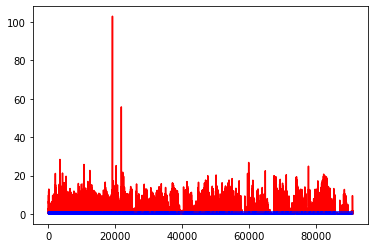

white ratio : 50.75
min : 177
max : 228


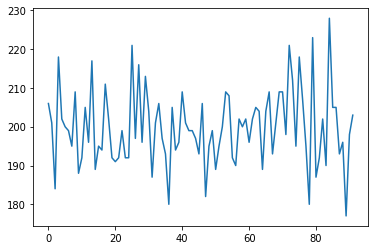

Generating interpolations...
91001 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.025056, 0.084301]
91002 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.001052, 0.055015]
91003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.127813, 0.007034]
91004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.514416, 0.156376]
91005 [D loss: 0.000774, acc.: 100.00%] [G loss: 0.036697, 0.031122]
91006 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.047572, 0.068889]
91007 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.829784, 0.771113]
91008 [D loss: 0.000327, acc.: 100.00%] [G loss: 0.022732, 0.085456]
91009 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.090928, 0.186508]
91010 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.125144, 0.262511]
91011 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.502505, 1.055486]
91012 [D loss: 0.000075, acc.: 100.00%] [G loss: 1.864457, 5.980721]
91013 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.425376, 2.629256]
91014 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.177576, 0.016618]
91015

91121 [D loss: 0.000516, acc.: 100.00%] [G loss: 10.536634, 10.106660]
91122 [D loss: 0.000281, acc.: 100.00%] [G loss: 6.498353, 5.861521]
91123 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.266595, 2.768041]
91124 [D loss: 0.000020, acc.: 100.00%] [G loss: 5.217204, 3.475515]
91125 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.431431, 0.497049]
91126 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.853884, 1.190742]
91127 [D loss: 0.189026, acc.: 96.88%] [G loss: 0.930096, 0.446017]
91128 [D loss: 0.000814, acc.: 100.00%] [G loss: 0.114484, 0.015757]
91129 [D loss: 0.011522, acc.: 100.00%] [G loss: 3.861994, 1.152853]
91130 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.246182, 0.328029]
91131 [D loss: 0.001248, acc.: 100.00%] [G loss: 2.281586, 1.569366]
91132 [D loss: 0.216377, acc.: 96.88%] [G loss: 0.710324, 0.690643]
91133 [D loss: 0.001012, acc.: 100.00%] [G loss: 0.051919, 0.003914]
91134 [D loss: 0.011423, acc.: 100.00%] [G loss: 1.035406, 2.042017]
91135 [D loss: 0.001144, acc.: 100

91242 [D loss: 0.006510, acc.: 100.00%] [G loss: 0.012001, 0.000002]
91243 [D loss: 0.001162, acc.: 100.00%] [G loss: 18.464777, 1.279141]
91244 [D loss: 0.001352, acc.: 100.00%] [G loss: 0.935411, 1.100038]
91245 [D loss: 0.000191, acc.: 100.00%] [G loss: 2.871108, 0.172245]
91246 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.542353, 0.374242]
91247 [D loss: 0.219147, acc.: 96.88%] [G loss: 1.703631, 0.920937]
91248 [D loss: 0.107803, acc.: 96.88%] [G loss: 0.580887, 0.126425]
91249 [D loss: 0.000219, acc.: 100.00%] [G loss: 0.010688, 0.012325]
91250 [D loss: 0.001295, acc.: 100.00%] [G loss: 0.849243, 0.639529]
91251 [D loss: 0.000744, acc.: 100.00%] [G loss: 0.161950, 0.236912]
91252 [D loss: 0.000534, acc.: 100.00%] [G loss: 4.394414, 0.003768]
91253 [D loss: 0.000878, acc.: 100.00%] [G loss: 1.961831, 0.670046]
91254 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.166891, 0.063543]
91255 [D loss: 0.007653, acc.: 100.00%] [G loss: 0.022959, 0.059480]
91256 [D loss: 0.003008, acc.: 100.

91362 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.204820, 0.297557]
91363 [D loss: 0.000697, acc.: 100.00%] [G loss: 0.182645, 0.134631]
91364 [D loss: 0.063485, acc.: 96.88%] [G loss: 0.280822, 0.254652]
91365 [D loss: 0.000952, acc.: 100.00%] [G loss: 0.000003, 0.000017]
91366 [D loss: 0.001009, acc.: 100.00%] [G loss: 0.320932, 0.184833]
91367 [D loss: 0.001641, acc.: 100.00%] [G loss: 0.028019, 0.003746]
91368 [D loss: 0.003418, acc.: 100.00%] [G loss: 0.165381, 0.291537]
91369 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.017717, 0.008439]
91370 [D loss: 0.009674, acc.: 100.00%] [G loss: 0.100811, 0.057428]
91371 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.091494, 0.000485]
91372 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003716, 0.021865]
91373 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.009540, 0.089102]
91374 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.504228, 0.756358]
91375 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.042449, 0.009703]
91376 [D loss: 0.000002, acc.: 100.

91483 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.003371, 0.000965]
91484 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.002587, 0.019043]
91485 [D loss: 0.000435, acc.: 100.00%] [G loss: 0.001116, 0.000399]
91486 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.010333, 0.000752]
91487 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.003646, 0.009482]
91488 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000251, 0.000623]
91489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000066, 0.000325]
91490 [D loss: 0.002458, acc.: 100.00%] [G loss: 0.107770, 0.030182]
91491 [D loss: 0.003855, acc.: 100.00%] [G loss: 0.295721, 0.160505]
91492 [D loss: 0.000613, acc.: 100.00%] [G loss: 0.001228, 0.090483]
91493 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.005177, 0.000397]
91494 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.117920, 0.124298]
91495 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.065401, 0.034007]
91496 [D loss: 0.001622, acc.: 100.00%] [G loss: 0.332534, 0.165578]
91497 [D loss: 0.103909, acc.: 96.

91605 [D loss: 0.002646, acc.: 100.00%] [G loss: 0.003549, 0.000578]
91606 [D loss: 0.002742, acc.: 100.00%] [G loss: 0.000003, 0.000003]
91607 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.000013, 0.000022]
91608 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.000002, 0.000002]
91609 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91610 [D loss: 0.004110, acc.: 100.00%] [G loss: 0.000435, 0.000065]
91611 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.000006, 0.000004]
91612 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000001, 0.000010]
91613 [D loss: 0.029293, acc.: 96.88%] [G loss: 0.000001, 0.000002]
91614 [D loss: 0.000633, acc.: 100.00%] [G loss: 0.000001, 0.000000]
91615 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000001, 0.000002]
91616 [D loss: 0.001588, acc.: 100.00%] [G loss: 0.000158, 0.000228]
91617 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.000000, 0.000004]
91618 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000140, 0.000194]
91619 [D loss: 0.007428, acc.: 100.

91726 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.000068, 0.000058]
91727 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000004, 0.000037]
91728 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000028, 0.000000]
91729 [D loss: 0.000837, acc.: 100.00%] [G loss: 0.000171, 0.000021]
91730 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000013, 0.000222]
91731 [D loss: 0.000294, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91732 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000001]
91733 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000003, 0.000002]
91734 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.000911, 0.000289]
91735 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91736 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.000388, 0.000048]
91737 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
91738 [D loss: 0.007805, acc.: 100.00%] [G loss: 0.000126, 0.000003]
91739 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000032, 0.000004]
91740 [D loss: 0.000230, acc.: 100

91847 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000004, 0.000000]
91848 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000007, 0.000001]
91849 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91850 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91851 [D loss: 0.001207, acc.: 100.00%] [G loss: 0.001855, 0.000006]
91852 [D loss: 0.008320, acc.: 100.00%] [G loss: 0.000001, 0.000002]
91853 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000001, 0.000091]
91854 [D loss: 0.004483, acc.: 100.00%] [G loss: 0.000025, 0.000021]
91855 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91856 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000003, 0.000000]
91857 [D loss: 0.000464, acc.: 100.00%] [G loss: 0.000004, 0.000009]
91858 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91859 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.000033, 0.000001]
91860 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
91861 [D loss: 0.000536, acc.: 100

91968 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000036, 0.001081]
91969 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000002, 0.000057]
91970 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.035680, 0.024812]
91971 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000003]
91972 [D loss: 0.000401, acc.: 100.00%] [G loss: 0.000004, 0.000029]
91973 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.029540, 0.001960]
91974 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000015, 0.000122]
91975 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91976 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.013982]
91977 [D loss: 0.000783, acc.: 100.00%] [G loss: 0.000002, 0.000001]
91978 [D loss: 0.002487, acc.: 100.00%] [G loss: 0.000000, 0.000000]
91979 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000001]
91980 [D loss: 0.000537, acc.: 100.00%] [G loss: 0.013201, 0.003806]
91981 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.118945, 0.107421]
91982 [D loss: 0.004121, acc.: 100

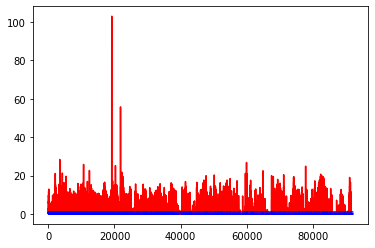

white ratio : 48.25
min : 177
max : 228


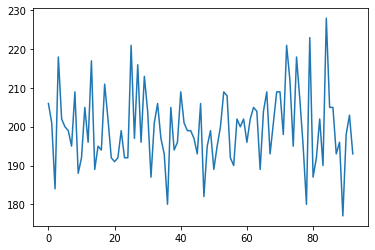

Generating interpolations...
92001 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.006174, 0.000145]
92002 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000001]
92003 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000371, 0.000386]
92004 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.034350, 0.025687]
92005 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000041, 0.000006]
92006 [D loss: 0.006895, acc.: 100.00%] [G loss: 0.026048, 0.003749]
92007 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000124, 0.000046]
92008 [D loss: 0.018078, acc.: 100.00%] [G loss: 0.015188, 0.086891]
92009 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.491878, 0.296241]
92010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000342, 0.000004]
92011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000127, 0.000159]
92012 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.052749, 0.080468]
92013 [D loss: 0.018367, acc.: 100.00%] [G loss: 0.020125, 0.000095]
92014 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.269356, 0.033369]
92015

92120 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001005, 0.000161]
92121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000070, 0.000071]
92123 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000001]
92124 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000049, 0.000009]
92125 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.000007, 0.000032]
92126 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.000560, 0.000912]
92127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000035, 0.000511]
92128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000015]
92129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000151, 0.000000]
92130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000003]
92131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000003]
92132 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000009, 0.003214]
92133 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
92134 [D loss: 0.000015, acc.: 100

92241 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000002, 0.000001]
92242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
92243 [D loss: 0.000926, acc.: 100.00%] [G loss: 0.000000, 0.000001]
92244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92245 [D loss: 0.001270, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92246 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.000008, 0.000101]
92247 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92248 [D loss: 0.002399, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92249 [D loss: 0.053967, acc.: 96.88%] [G loss: 0.000005, 0.000006]
92250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000038, 0.000056]
92251 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000004, 0.000003]
92252 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92253 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000021, 0.000016]
92254 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000024, 0.000000]
92255 [D loss: 0.000004, acc.: 100.

92362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.837234, 0.398143]
92363 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.043890, 0.098144]
92364 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.190004, 0.007341]
92365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.230854, 0.013850]
92366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.127960, 0.005177]
92367 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.105071, 0.097773]
92368 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.004715, 0.002958]
92369 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.005128, 0.000183]
92370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.236825, 0.029827]
92371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000640, 0.000625]
92372 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.002073, 0.006977]
92373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005774, 0.000946]
92374 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000142, 0.000028]
92375 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.075901, 0.283810]
92376 [D loss: 0.000000, acc.: 100

92483 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.000060, 0.000144]
92484 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.004563, 0.000289]
92485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000092, 0.015811]
92486 [D loss: 0.125793, acc.: 96.88%] [G loss: 0.000017, 0.000000]
92487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000042]
92488 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000043, 0.000008]
92489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003359, 0.007711]
92490 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000002, 0.000002]
92491 [D loss: 0.000635, acc.: 100.00%] [G loss: 0.000003, 0.000088]
92492 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.000411, 0.013636]
92493 [D loss: 0.000402, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92494 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000002]
92495 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
92496 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000008, 0.000000]
92497 [D loss: 0.000049, acc.: 100.

92603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.093434, 0.026761]
92604 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.084548, 0.032967]
92605 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.077523, 0.268447]
92606 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.004462, 0.000012]
92607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.018773, 0.003281]
92608 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.017885, 0.045331]
92609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.092002, 0.143046]
92610 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.064391, 0.008334]
92611 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.100285, 0.004475]
92612 [D loss: 0.024625, acc.: 96.88%] [G loss: 0.041170, 0.000279]
92613 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.057363, 0.104031]
92614 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001131, 0.000007]
92615 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.010955, 0.060423]
92616 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000012, 0.000083]
92617 [D loss: 0.000001, acc.: 100.

92724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.053735, 0.939891]
92725 [D loss: 0.000134, acc.: 100.00%] [G loss: 2.262084, 0.685414]
92726 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.175853, 0.269208]
92727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.143731, 0.169334]
92728 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002807, 0.035463]
92729 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.097658, 0.164268]
92730 [D loss: 0.000871, acc.: 100.00%] [G loss: 0.039458, 0.012309]
92731 [D loss: 0.001534, acc.: 100.00%] [G loss: 1.150915, 1.153760]
92732 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.160537, 0.269590]
92733 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.038281, 0.199426]
92734 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.751445, 0.278546]
92735 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.490228, 0.300089]
92736 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.017054, 0.024713]
92737 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.098491, 0.014755]
92738 [D loss: 0.000002, acc.: 100

92843 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.412105, 0.050911]
92844 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.266460, 0.119310]
92845 [D loss: 0.000774, acc.: 100.00%] [G loss: 0.128589, 0.007990]
92846 [D loss: 0.000323, acc.: 100.00%] [G loss: 0.005050, 0.004269]
92847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.157908, 0.036664]
92848 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.549139, 0.192992]
92849 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.177367, 0.012699]
92850 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.002527, 0.007458]
92851 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.002220, 0.044234]
92852 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.082860, 0.000688]
92853 [D loss: 0.140885, acc.: 96.88%] [G loss: 0.000019, 0.000046]
92854 [D loss: 0.002206, acc.: 100.00%] [G loss: 0.000837, 0.000011]
92855 [D loss: 0.072087, acc.: 96.88%] [G loss: 4.920068, 3.924412]
92856 [D loss: 0.000000, acc.: 100.00%] [G loss: 27.071968, 22.519051]
92857 [D loss: 0.002242, acc.: 100

92962 [D loss: 0.000059, acc.: 100.00%] [G loss: 2.114677, 3.659072]
92963 [D loss: 0.000893, acc.: 100.00%] [G loss: 1.834023, 1.574583]
92964 [D loss: 0.000552, acc.: 100.00%] [G loss: 2.811030, 2.410056]
92965 [D loss: 0.000367, acc.: 100.00%] [G loss: 4.199657, 4.082345]
92966 [D loss: 0.002282, acc.: 100.00%] [G loss: 3.502220, 1.920804]
92967 [D loss: 0.000199, acc.: 100.00%] [G loss: 22.476213, 5.016365]
92968 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.247499, 1.014180]
92969 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.415693, 0.499961]
92970 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.251709, 0.376625]
92971 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.968023, 1.312339]
92972 [D loss: 0.000300, acc.: 100.00%] [G loss: 3.232759, 3.100538]
92973 [D loss: 0.000037, acc.: 100.00%] [G loss: 3.724770, 2.856662]
92974 [D loss: 0.005333, acc.: 100.00%] [G loss: 1.623437, 0.812490]
92975 [D loss: 0.000022, acc.: 100.00%] [G loss: 34.225269, 3.288629]
92976 [D loss: 0.000010, acc.: 1

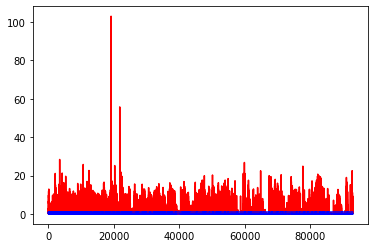

white ratio : 48.75
min : 177
max : 228


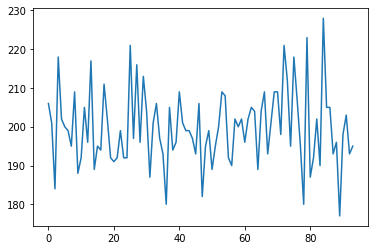

Generating interpolations...
93001 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.289186, 0.277702]
93002 [D loss: 0.000127, acc.: 100.00%] [G loss: 10.987722, 1.859269]
93003 [D loss: 0.000071, acc.: 100.00%] [G loss: 2.352168, 2.041141]
93004 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.513020, 0.650557]
93005 [D loss: 0.000035, acc.: 100.00%] [G loss: 56.731842, 5.216089]
93006 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.029602, 10.727640]
93007 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.499917, 11.451077]
93008 [D loss: 0.000158, acc.: 100.00%] [G loss: 10.260098, 7.962467]
93009 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.689229, 6.895535]
93010 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.970631, 7.669375]
93011 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.318228, 9.018195]
93012 [D loss: 0.000035, acc.: 100.00%] [G loss: 6.985317, 5.833169]
93013 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.508054, 5.473954]
93014 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.706599, 5.552341

93122 [D loss: 0.000046, acc.: 100.00%] [G loss: 2.634394, 1.201448]
93123 [D loss: 0.174397, acc.: 96.88%] [G loss: 2.086992, 1.325802]
93124 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.082451, 0.008978]
93125 [D loss: 0.012780, acc.: 100.00%] [G loss: 4.675128, 1.591062]
93126 [D loss: 0.000382, acc.: 100.00%] [G loss: 16.237797, 3.777192]
93127 [D loss: 0.000012, acc.: 100.00%] [G loss: 6.993227, 6.468796]
93128 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.996745, 3.701311]
93129 [D loss: 0.002067, acc.: 100.00%] [G loss: 3.623655, 3.290715]
93130 [D loss: 0.000710, acc.: 100.00%] [G loss: 0.254662, 0.377114]
93131 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.530354, 0.433697]
93132 [D loss: 0.000313, acc.: 100.00%] [G loss: 3.135395, 2.142524]
93133 [D loss: 0.000147, acc.: 100.00%] [G loss: 1.541156, 1.257653]
93134 [D loss: 0.001085, acc.: 100.00%] [G loss: 0.354287, 0.257228]
93135 [D loss: 0.006136, acc.: 100.00%] [G loss: 1.380819, 1.885688]
93136 [D loss: 0.000258, acc.: 100

93242 [D loss: 0.013264, acc.: 100.00%] [G loss: 5.670062, 5.430098]
93243 [D loss: 0.008374, acc.: 100.00%] [G loss: 1.364675, 1.018129]
93244 [D loss: 0.000120, acc.: 100.00%] [G loss: 4.613445, 0.074630]
93245 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.142997, 0.423855]
93246 [D loss: 0.034718, acc.: 96.88%] [G loss: 1.166399, 1.988387]
93247 [D loss: 0.000775, acc.: 100.00%] [G loss: 0.054178, 0.002942]
93248 [D loss: 0.014672, acc.: 100.00%] [G loss: 0.248895, 0.267159]
93249 [D loss: 0.000407, acc.: 100.00%] [G loss: 2.324212, 1.670935]
93250 [D loss: 0.003484, acc.: 100.00%] [G loss: 0.774171, 0.859152]
93251 [D loss: 0.003588, acc.: 100.00%] [G loss: 0.448391, 0.144045]
93252 [D loss: 0.000313, acc.: 100.00%] [G loss: 3.248341, 2.242338]
93253 [D loss: 0.019679, acc.: 100.00%] [G loss: 3.454198, 1.551736]
93254 [D loss: 0.000981, acc.: 100.00%] [G loss: 2.423648, 2.228593]
93255 [D loss: 0.000101, acc.: 100.00%] [G loss: 8.345970, 7.992750]
93256 [D loss: 0.006831, acc.: 100.

93362 [D loss: 0.005204, acc.: 100.00%] [G loss: 2.050247, 1.364778]
93363 [D loss: 0.026012, acc.: 96.88%] [G loss: 1.843573, 2.488873]
93364 [D loss: 0.001111, acc.: 100.00%] [G loss: 0.068727, 0.310678]
93365 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.037885, 0.059350]
93366 [D loss: 0.000259, acc.: 100.00%] [G loss: 1.163809, 1.275980]
93367 [D loss: 0.001816, acc.: 100.00%] [G loss: 18.145039, 0.616367]
93368 [D loss: 0.000017, acc.: 100.00%] [G loss: 10.046751, 7.654446]
93369 [D loss: 0.000102, acc.: 100.00%] [G loss: 4.310860, 0.941955]
93370 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.955263, 0.926977]
93371 [D loss: 0.000263, acc.: 100.00%] [G loss: 7.563039, 6.623712]
93372 [D loss: 0.000175, acc.: 100.00%] [G loss: 1.425643, 1.358026]
93373 [D loss: 0.000027, acc.: 100.00%] [G loss: 6.090790, 6.316085]
93374 [D loss: 0.002725, acc.: 100.00%] [G loss: 5.379903, 4.871853]
93375 [D loss: 0.000017, acc.: 100.00%] [G loss: 5.692784, 4.960244]
93376 [D loss: 0.000040, acc.: 10

93483 [D loss: 0.112223, acc.: 96.88%] [G loss: 0.090496, 0.110559]
93484 [D loss: 0.050702, acc.: 100.00%] [G loss: 10.216630, 0.638140]
93485 [D loss: 0.000009, acc.: 100.00%] [G loss: 5.580574, 5.472945]
93486 [D loss: 0.000029, acc.: 100.00%] [G loss: 5.107512, 5.515868]
93487 [D loss: 0.000735, acc.: 100.00%] [G loss: 4.630844, 2.717538]
93488 [D loss: 0.001067, acc.: 100.00%] [G loss: 3.715462, 3.063321]
93489 [D loss: 0.000177, acc.: 100.00%] [G loss: 1.364368, 1.529420]
93490 [D loss: 0.000102, acc.: 100.00%] [G loss: 2.002890, 1.292202]
93491 [D loss: 0.000412, acc.: 100.00%] [G loss: 3.998373, 2.867300]
93492 [D loss: 0.000476, acc.: 100.00%] [G loss: 0.334062, 0.018502]
93493 [D loss: 0.041569, acc.: 96.88%] [G loss: 2.384687, 0.751458]
93494 [D loss: 0.000356, acc.: 100.00%] [G loss: 1.133858, 0.718822]
93495 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.427026, 0.307553]
93496 [D loss: 0.004285, acc.: 100.00%] [G loss: 3.031065, 2.673188]
93497 [D loss: 0.000418, acc.: 100.

93602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.603356, 0.105718]
93603 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.748443, 0.600271]
93604 [D loss: 0.000474, acc.: 100.00%] [G loss: 0.772584, 0.555907]
93605 [D loss: 0.000112, acc.: 100.00%] [G loss: 1.151739, 1.177075]
93606 [D loss: 0.000584, acc.: 100.00%] [G loss: 0.181033, 0.200091]
93607 [D loss: 0.011906, acc.: 100.00%] [G loss: 0.323413, 0.101525]
93608 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.345258, 0.590864]
93609 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.005037, 0.021496]
93610 [D loss: 0.001086, acc.: 100.00%] [G loss: 0.370803, 0.617988]
93611 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.479279, 0.798551]
93612 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.594615, 0.187375]
93613 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.035047, 0.000814]
93614 [D loss: 0.000051, acc.: 100.00%] [G loss: 1.714295, 0.594236]
93615 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.000364, 0.000021]
93616 [D loss: 0.006786, acc.: 100

93723 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.111587, 0.108912]
93724 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000002]
93725 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.030077, 0.200611]
93726 [D loss: 0.000311, acc.: 100.00%] [G loss: 0.016109, 0.087226]
93727 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.119444, 0.193413]
93728 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000150, 0.000827]
93729 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.874152, 0.574454]
93730 [D loss: 0.000422, acc.: 100.00%] [G loss: 0.286753, 0.331977]
93731 [D loss: 0.000624, acc.: 100.00%] [G loss: 0.000014, 0.000548]
93732 [D loss: 0.000495, acc.: 100.00%] [G loss: 0.643953, 0.288352]
93733 [D loss: 0.000436, acc.: 100.00%] [G loss: 0.063334, 0.046941]
93734 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.509704, 0.867677]
93735 [D loss: 0.094906, acc.: 96.88%] [G loss: 2.037198, 0.945108]
93736 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.001299, 0.026374]
93737 [D loss: 0.016460, acc.: 100.

93842 [D loss: 0.000238, acc.: 100.00%] [G loss: 19.888771, 0.616288]
93843 [D loss: 0.000981, acc.: 100.00%] [G loss: 1.049393, 1.260122]
93844 [D loss: 0.001380, acc.: 100.00%] [G loss: 0.251721, 0.052406]
93845 [D loss: 0.001027, acc.: 100.00%] [G loss: 2.071970, 2.321004]
93846 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.020760, 1.737506]
93847 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.062259, 0.005793]
93848 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.001533, 0.000111]
93849 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000017, 0.000013]
93850 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.034080, 0.030738]
93851 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.020061, 0.001001]
93852 [D loss: 0.000354, acc.: 100.00%] [G loss: 0.000004, 0.000175]
93853 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.499477, 0.619834]
93854 [D loss: 0.000855, acc.: 100.00%] [G loss: 0.772814, 0.404163]
93855 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.683676, 0.734354]
93856 [D loss: 0.000578, acc.: 10

93963 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.538031, 0.242447]
93964 [D loss: 0.010433, acc.: 100.00%] [G loss: 0.346782, 0.198871]
93965 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.070948, 0.021009]
93966 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.420769, 0.195576]
93967 [D loss: 0.002217, acc.: 100.00%] [G loss: 0.248812, 0.240167]
93968 [D loss: 0.000606, acc.: 100.00%] [G loss: 0.000015, 0.000071]
93969 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.020847, 0.005020]
93970 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.132269, 0.184629]
93971 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.003585, 0.000003]
93972 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.076835, 0.049220]
93973 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.020823, 0.005497]
93974 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000012, 0.000118]
93975 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.001218, 0.002330]
93976 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.172015, 0.237993]
93977 [D loss: 0.000005, acc.: 100

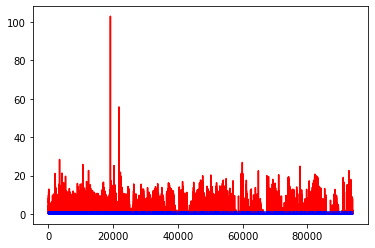

white ratio : 47.25
min : 177
max : 228


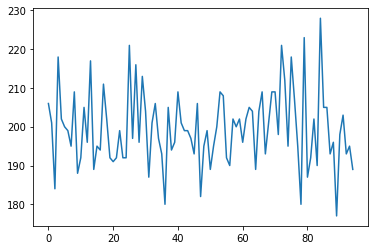

Generating interpolations...
94001 [D loss: 0.000437, acc.: 100.00%] [G loss: 0.237525, 0.159415]
94002 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.130286, 0.195754]
94003 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.189275, 0.096877]
94004 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.338125, 0.127659]
94005 [D loss: 0.000132, acc.: 100.00%] [G loss: 10.094507, 0.931970]
94006 [D loss: 0.038877, acc.: 96.88%] [G loss: 1.433359, 0.760778]
94007 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.002189, 0.000110]
94008 [D loss: 0.004535, acc.: 100.00%] [G loss: 1.538939, 1.474853]
94009 [D loss: 0.001140, acc.: 100.00%] [G loss: 0.108388, 0.058543]
94010 [D loss: 0.000149, acc.: 100.00%] [G loss: 1.187705, 0.872105]
94011 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.907841, 0.185455]
94012 [D loss: 0.000030, acc.: 100.00%] [G loss: 2.394381, 2.273668]
94013 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.007463, 0.000232]
94014 [D loss: 0.004094, acc.: 100.00%] [G loss: 0.108180, 0.000157]
94015

94122 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.222876, 0.115921]
94123 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.000193, 0.004194]
94124 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.075592, 0.012969]
94125 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.000235, 0.000162]
94126 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.424747, 0.142214]
94127 [D loss: 0.001330, acc.: 100.00%] [G loss: 0.094597, 0.003759]
94128 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.034142, 0.001994]
94129 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.029690, 0.011159]
94130 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.210982, 0.076563]
94131 [D loss: 0.000592, acc.: 100.00%] [G loss: 0.033586, 0.001036]
94132 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.124167, 0.134224]
94133 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.000002, 0.000001]
94134 [D loss: 0.000717, acc.: 100.00%] [G loss: 0.017641, 0.001973]
94135 [D loss: 0.000274, acc.: 100.00%] [G loss: 0.004869, 0.000009]
94136 [D loss: 0.000460, acc.: 100

94244 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.848941, 0.179025]
94245 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.001123, 0.012019]
94246 [D loss: 0.000564, acc.: 100.00%] [G loss: 1.281890, 0.867813]
94247 [D loss: 0.034438, acc.: 96.88%] [G loss: 0.000038, 0.000004]
94248 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000004, 0.000002]
94249 [D loss: 0.018887, acc.: 100.00%] [G loss: 0.033402, 0.014105]
94250 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.021451, 0.059392]
94251 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.112888, 3.448347]
94252 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.821581, 0.423364]
94253 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.467093, 1.472972]
94254 [D loss: 0.000004, acc.: 100.00%] [G loss: 35.151367, 1.696512]
94255 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.035220, 4.357617]
94256 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.917622, 3.022908]
94257 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.576005, 1.735807]
94258 [D loss: 0.000297, acc.: 100

94365 [D loss: 0.000003, acc.: 100.00%] [G loss: 25.673609, 0.281815]
94366 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.524985, 0.263206]
94367 [D loss: 0.000028, acc.: 100.00%] [G loss: 3.607299, 2.354157]
94368 [D loss: 0.000024, acc.: 100.00%] [G loss: 6.114417, 4.870078]
94369 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.310602, 2.174641]
94370 [D loss: 0.001064, acc.: 100.00%] [G loss: 0.973922, 1.083629]
94371 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.508489, 3.129184]
94372 [D loss: 0.000146, acc.: 100.00%] [G loss: 1.079799, 1.041362]
94373 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.333579, 1.946844]
94374 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.872303, 1.198919]
94375 [D loss: 0.001926, acc.: 100.00%] [G loss: 6.705466, 5.182038]
94376 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.611160, 7.625226]
94377 [D loss: 0.014494, acc.: 100.00%] [G loss: 6.136357, 3.890819]
94378 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.773752, 1.527170]
94379 [D loss: 0.000133, acc.: 10

94486 [D loss: 0.000136, acc.: 100.00%] [G loss: 3.853981, 1.739350]
94487 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.971582, 1.873533]
94488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.491834, 1.166903]
94489 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.504254, 1.337766]
94490 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.639669, 1.146261]
94491 [D loss: 0.000310, acc.: 100.00%] [G loss: 1.716489, 1.568931]
94492 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.425320, 0.709986]
94493 [D loss: 0.000060, acc.: 100.00%] [G loss: 1.197482, 1.241567]
94494 [D loss: 0.003346, acc.: 100.00%] [G loss: 7.419878, 0.128476]
94495 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.434447, 0.524143]
94496 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.391826, 0.796002]
94497 [D loss: 0.000085, acc.: 100.00%] [G loss: 5.205889, 7.615685]
94498 [D loss: 0.000003, acc.: 100.00%] [G loss: 25.351704, 5.795035]
94499 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.287054, 7.022983]
94500 [D loss: 0.000002, acc.: 10

94606 [D loss: 0.001494, acc.: 100.00%] [G loss: 5.142966, 4.368385]
94607 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.354126, 1.741685]
94608 [D loss: 0.003192, acc.: 100.00%] [G loss: 1.504980, 1.572157]
94609 [D loss: 0.000001, acc.: 100.00%] [G loss: 72.547989, 8.332787]
94610 [D loss: 0.000003, acc.: 100.00%] [G loss: 16.017370, 13.884344]
94611 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.451377, 11.708887]
94612 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.364130, 10.219138]
94613 [D loss: 0.000010, acc.: 100.00%] [G loss: 5.296010, 4.381380]
94614 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.776209, 6.113131]
94615 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.751020, 11.512959]
94616 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.447714, 10.654097]
94617 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.715585, 3.102812]
94618 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.788985, 0.678368]
94619 [D loss: 0.000006, acc.: 100.00%] [G loss: 9.297859, 7.829208]
94620 [D loss: 0.000002

94725 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.718826, 0.236404]
94726 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.414162, 10.210722]
94727 [D loss: 0.000179, acc.: 100.00%] [G loss: 4.284198, 2.637612]
94728 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.981867, 11.647592]
94729 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.020647, 0.124803]
94730 [D loss: 0.030191, acc.: 96.88%] [G loss: 2.844553, 2.608174]
94731 [D loss: 0.000440, acc.: 100.00%] [G loss: 0.000000, 0.000000]
94732 [D loss: 0.505779, acc.: 87.50%] [G loss: 4.154653, 3.453405]
94733 [D loss: 0.000344, acc.: 100.00%] [G loss: 10.901470, 8.558819]
94734 [D loss: 0.000143, acc.: 100.00%] [G loss: 10.965658, 11.793547]
94735 [D loss: 0.000021, acc.: 100.00%] [G loss: 19.251289, 13.105206]
94736 [D loss: 0.000015, acc.: 100.00%] [G loss: 13.095303, 12.710591]
94737 [D loss: 0.009247, acc.: 100.00%] [G loss: 18.106770, 13.525611]
94738 [D loss: 0.000169, acc.: 100.00%] [G loss: 14.189938, 13.094896]
94739 [D loss: 0.0004

94844 [D loss: 0.000568, acc.: 100.00%] [G loss: 6.654548, 5.122918]
94845 [D loss: 0.001512, acc.: 100.00%] [G loss: 3.478890, 4.132272]
94846 [D loss: 0.003514, acc.: 100.00%] [G loss: 6.548273, 4.806899]
94847 [D loss: 0.000877, acc.: 100.00%] [G loss: 0.000084, 0.000000]
94848 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000001, 0.000008]
94849 [D loss: 0.007107, acc.: 100.00%] [G loss: 0.045608, 0.000146]
94850 [D loss: 0.003048, acc.: 100.00%] [G loss: 7.260945, 7.442091]
94851 [D loss: 0.000273, acc.: 100.00%] [G loss: 7.956605, 4.665524]
94852 [D loss: 0.000230, acc.: 100.00%] [G loss: 31.386539, 6.168614]
94853 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.568459, 0.608095]
94854 [D loss: 0.000747, acc.: 100.00%] [G loss: 11.608559, 11.748060]
94855 [D loss: 0.000067, acc.: 100.00%] [G loss: 2.459528, 1.058892]
94856 [D loss: 0.000092, acc.: 100.00%] [G loss: 1.411707, 0.787749]
94857 [D loss: 0.000268, acc.: 100.00%] [G loss: 10.848745, 10.558922]
94858 [D loss: 0.000061, acc.

94963 [D loss: 0.000037, acc.: 100.00%] [G loss: 7.484860, 4.903085]
94964 [D loss: 0.001843, acc.: 100.00%] [G loss: 1.363983, 1.727029]
94965 [D loss: 0.001082, acc.: 100.00%] [G loss: 3.239850, 3.125300]
94966 [D loss: 0.000057, acc.: 100.00%] [G loss: 5.605610, 4.148402]
94967 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.304259, 0.554121]
94968 [D loss: 0.000317, acc.: 100.00%] [G loss: 4.973497, 6.320615]
94969 [D loss: 0.000633, acc.: 100.00%] [G loss: 10.071051, 9.802517]
94970 [D loss: 0.000273, acc.: 100.00%] [G loss: 4.479012, 4.058725]
94971 [D loss: 0.000036, acc.: 100.00%] [G loss: 6.820032, 6.489767]
94972 [D loss: 0.000438, acc.: 100.00%] [G loss: 8.239836, 6.450307]
94973 [D loss: 0.051276, acc.: 96.88%] [G loss: 6.832456, 6.153794]
94974 [D loss: 0.000136, acc.: 100.00%] [G loss: 7.845660, 7.293997]
94975 [D loss: 0.004873, acc.: 100.00%] [G loss: 4.044113, 2.330812]
94976 [D loss: 0.001037, acc.: 100.00%] [G loss: 0.000000, 0.000001]
94977 [D loss: 0.000602, acc.: 100

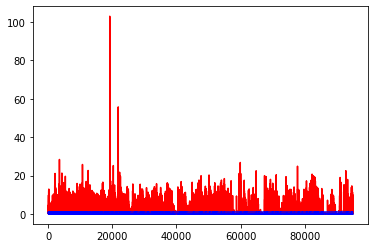

white ratio : 48.25
min : 177
max : 228


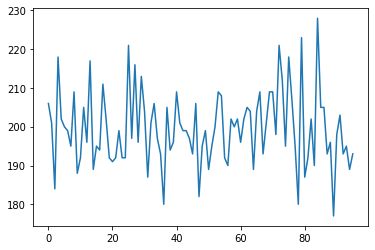

Generating interpolations...
95001 [D loss: 0.002534, acc.: 100.00%] [G loss: 3.288575, 2.488491]
95002 [D loss: 0.001411, acc.: 100.00%] [G loss: 0.000001, 0.000528]
95003 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.048802, 5.781933]
95004 [D loss: 0.000479, acc.: 100.00%] [G loss: 0.000324, 0.000415]
95005 [D loss: 0.001971, acc.: 100.00%] [G loss: 0.000002, 0.000001]
95006 [D loss: 0.000298, acc.: 100.00%] [G loss: 0.000349, 0.000020]
95007 [D loss: 0.001068, acc.: 100.00%] [G loss: 2.348777, 3.031574]
95008 [D loss: 0.003763, acc.: 100.00%] [G loss: 0.183937, 0.003011]
95009 [D loss: 0.000382, acc.: 100.00%] [G loss: 0.100115, 0.091708]
95010 [D loss: 0.000187, acc.: 100.00%] [G loss: 4.098900, 3.856649]
95011 [D loss: 0.000493, acc.: 100.00%] [G loss: 0.328395, 0.219337]
95012 [D loss: 0.000694, acc.: 100.00%] [G loss: 3.333255, 2.064443]
95013 [D loss: 0.009677, acc.: 100.00%] [G loss: 4.711332, 3.486692]
95014 [D loss: 0.000351, acc.: 100.00%] [G loss: 0.606616, 0.326997]
95015

95117 [D loss: 0.000235, acc.: 100.00%] [G loss: 16.766893, 8.369810]
95118 [D loss: 0.000340, acc.: 100.00%] [G loss: 9.367855, 7.707644]
95119 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95120 [D loss: 0.000304, acc.: 100.00%] [G loss: 8.573771, 7.392816]
95121 [D loss: 0.000119, acc.: 100.00%] [G loss: 10.072455, 9.169258]
95122 [D loss: 0.002979, acc.: 100.00%] [G loss: 13.326464, 9.167588]
95123 [D loss: 0.000487, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95124 [D loss: 0.001392, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95125 [D loss: 0.000933, acc.: 100.00%] [G loss: 0.000045, 0.000001]
95126 [D loss: 0.000108, acc.: 100.00%] [G loss: 1.021504, 1.906271]
95127 [D loss: 0.065601, acc.: 96.88%] [G loss: 1.845125, 2.498507]
95128 [D loss: 0.010288, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95129 [D loss: 0.008188, acc.: 100.00%] [G loss: 5.306448, 5.114306]
95130 [D loss: 0.001031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95131 [D loss: 0.001443, acc.: 1

95239 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.117207, 0.213324]
95240 [D loss: 0.198583, acc.: 96.88%] [G loss: 0.000000, 0.000000]
95241 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.001254, 0.006423]
95242 [D loss: 0.000491, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95243 [D loss: 0.000757, acc.: 100.00%] [G loss: 5.069736, 3.313354]
95244 [D loss: 0.000466, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95245 [D loss: 0.001565, acc.: 100.00%] [G loss: 1.312822, 2.050528]
95246 [D loss: 0.001085, acc.: 100.00%] [G loss: 6.018001, 4.371006]
95247 [D loss: 0.000271, acc.: 100.00%] [G loss: 19.942581, 0.051730]
95248 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.460004, 1.391322]
95249 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000003, 0.000056]
95250 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.155954, 0.064035]
95251 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.010406, 0.035961]
95252 [D loss: 0.000803, acc.: 100.00%] [G loss: 11.902248, 11.668325]
95253 [D loss: 0.000108, acc.: 1

95361 [D loss: 0.002240, acc.: 100.00%] [G loss: 0.223607, 0.350359]
95362 [D loss: 0.000585, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95363 [D loss: 0.007090, acc.: 100.00%] [G loss: 6.700146, 6.993315]
95364 [D loss: 0.000108, acc.: 100.00%] [G loss: 8.371477, 6.096475]
95365 [D loss: 0.000323, acc.: 100.00%] [G loss: 0.000012, 0.000001]
95366 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95367 [D loss: 0.000160, acc.: 100.00%] [G loss: 6.780329, 3.933182]
95368 [D loss: 0.000344, acc.: 100.00%] [G loss: 1.480631, 0.205681]
95369 [D loss: 0.000464, acc.: 100.00%] [G loss: 9.577399, 7.291980]
95370 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95371 [D loss: 0.000763, acc.: 100.00%] [G loss: 5.133009, 5.320202]
95372 [D loss: 0.000017, acc.: 100.00%] [G loss: 10.499364, 9.582115]
95373 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.673824, 10.214021]
95374 [D loss: 0.000039, acc.: 100.00%] [G loss: 18.945904, 10.080389]
95375 [D loss: 0.000037, acc.

95481 [D loss: 0.000045, acc.: 100.00%] [G loss: 3.234326, 2.475544]
95482 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95483 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000002, 0.000077]
95484 [D loss: 0.001294, acc.: 100.00%] [G loss: 16.152838, 2.803277]
95485 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.507704, 2.099546]
95486 [D loss: 0.000202, acc.: 100.00%] [G loss: 1.169504, 2.237705]
95487 [D loss: 0.000088, acc.: 100.00%] [G loss: 2.647229, 3.097728]
95488 [D loss: 0.000442, acc.: 100.00%] [G loss: 3.717475, 2.664210]
95489 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.000000, 0.000001]
95490 [D loss: 0.000399, acc.: 100.00%] [G loss: 0.001275, 0.000800]
95491 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95492 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.144464, 0.038091]
95493 [D loss: 0.000109, acc.: 100.00%] [G loss: 1.415358, 3.573095]
95494 [D loss: 0.009539, acc.: 100.00%] [G loss: 10.319126, 4.347779]
95495 [D loss: 0.000165, acc.: 1

95602 [D loss: 0.000726, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95603 [D loss: 0.001741, acc.: 100.00%] [G loss: 0.941923, 2.392972]
95604 [D loss: 0.000970, acc.: 100.00%] [G loss: 1.909039, 1.118440]
95605 [D loss: 0.002506, acc.: 100.00%] [G loss: 0.000722, 0.013447]
95606 [D loss: 0.000876, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95607 [D loss: 0.002035, acc.: 100.00%] [G loss: 0.583166, 0.000000]
95608 [D loss: 0.001606, acc.: 100.00%] [G loss: 0.000086, 0.000006]
95609 [D loss: 0.000185, acc.: 100.00%] [G loss: 1.961357, 3.516807]
95610 [D loss: 0.002516, acc.: 100.00%] [G loss: 2.864003, 4.423319]
95611 [D loss: 0.000776, acc.: 100.00%] [G loss: 2.010258, 2.875548]
95612 [D loss: 0.000962, acc.: 100.00%] [G loss: 0.000004, 0.000000]
95613 [D loss: 0.000948, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95614 [D loss: 0.000179, acc.: 100.00%] [G loss: 13.613343, 0.000114]
95615 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000003, 0.000007]
95616 [D loss: 0.000106, acc.: 10

95722 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.002793, 0.000013]
95723 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.255580, 0.013574]
95724 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.037203, 0.008576]
95725 [D loss: 0.000106, acc.: 100.00%] [G loss: 11.132739, 10.960421]
95726 [D loss: 0.007041, acc.: 100.00%] [G loss: 10.190215, 10.018900]
95727 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000001, 0.000000]
95728 [D loss: 0.000183, acc.: 100.00%] [G loss: 6.611598, 5.704317]
95729 [D loss: 0.000340, acc.: 100.00%] [G loss: 0.000033, 0.000283]
95730 [D loss: 0.000083, acc.: 100.00%] [G loss: 5.015314, 5.428188]
95731 [D loss: 0.000094, acc.: 100.00%] [G loss: 6.985227, 5.589561]
95732 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95733 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.005852, 0.000045]
95734 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.035609, 0.282307]
95735 [D loss: 0.006339, acc.: 100.00%] [G loss: 0.000538, 0.000019]
95736 [D loss: 0.002404, acc.:

95842 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000059, 0.000331]
95843 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.015327, 0.000281]
95844 [D loss: 0.000344, acc.: 100.00%] [G loss: 6.035235, 6.331404]
95845 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.026459, 0.004393]
95846 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.016168, 0.006242]
95847 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.812982, 3.347531]
95848 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000000, 0.000000]
95849 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.097837, 5.123076]
95850 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.005978, 0.001011]
95851 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000230, 0.000077]
95852 [D loss: 0.000282, acc.: 100.00%] [G loss: 9.292982, 9.301289]
95853 [D loss: 0.000549, acc.: 100.00%] [G loss: 4.148565, 4.069637]
95854 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.003940, 0.020217]
95855 [D loss: 0.000379, acc.: 100.00%] [G loss: 4.760364, 2.686439]
95856 [D loss: 0.000010, acc.: 100

95961 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.845388, 1.261631]
95962 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.454982, 0.000165]
95963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000129, 0.000021]
95964 [D loss: 0.055452, acc.: 96.88%] [G loss: 2.289514, 2.811557]
95965 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.312828, 6.707198]
95966 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.854599, 2.824847]
95967 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.265200, 0.017303]
95968 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000002, 0.003051]
95969 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.016618, 0.093159]
95970 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.000001, 0.000001]
95971 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.588881, 0.015705]
95972 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.018329, 0.003910]
95973 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000001, 0.000011]
95974 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003777, 0.023211]
95975 [D loss: 0.000014, acc.: 100.

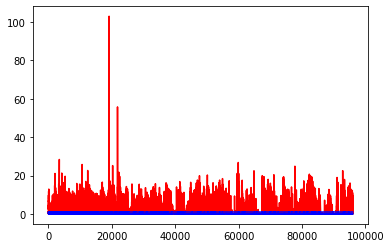

white ratio : 50.5
min : 177
max : 228


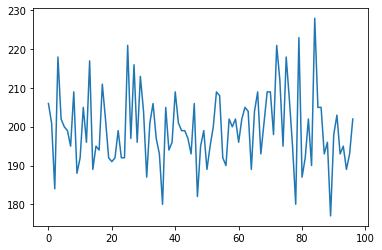

Generating interpolations...
96001 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000001, 0.000000]
96002 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96003 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96004 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000001, 0.000000]
96005 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000732, 0.055597]
96006 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.087014, 0.000386]
96007 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.017093, 0.000000]
96008 [D loss: 0.000898, acc.: 100.00%] [G loss: 0.085288, 0.088554]
96009 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000546]
96010 [D loss: 0.054099, acc.: 96.88%] [G loss: 4.368023, 1.775984]
96011 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96012 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.003564, 0.000003]
96013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96014 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96015 

96122 [D loss: 0.000002, acc.: 100.00%] [G loss: 27.226948, 0.000004]
96123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001267, 0.002464]
96124 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000027, 0.000020]
96125 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.824805, 5.977006]
96126 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.499679, 5.362339]
96127 [D loss: 0.000047, acc.: 100.00%] [G loss: 8.102143, 6.848964]
96128 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000137]
96129 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000048, 0.005257]
96130 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000094, 0.086113]
96131 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.093049, 3.752435]
96132 [D loss: 0.000448, acc.: 100.00%] [G loss: 0.002792, 0.000150]
96133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96134 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.085608, 4.310871]
96135 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000001, 0.000000]
96136 [D loss: 0.000002, acc.: 10

96241 [D loss: 0.065552, acc.: 96.88%] [G loss: 6.662578, 6.952216]
96242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
96243 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002812, 0.000010]
96244 [D loss: 0.000015, acc.: 100.00%] [G loss: 4.902362, 4.568490]
96245 [D loss: 0.000107, acc.: 100.00%] [G loss: 6.214499, 4.981356]
96246 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.159307, 3.366238]
96247 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96248 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.005817, 0.000009]
96249 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96250 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.000000, 0.000010]
96251 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000321, 0.000000]
96252 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96253 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000013]
96254 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96255 [D loss: 0.000191, acc.: 100.

96362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000203, 0.000264]
96363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000001]
96364 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000019, 0.000065]
96365 [D loss: 0.000031, acc.: 100.00%] [G loss: 4.748226, 7.701179]
96366 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.012611, 0.167454]
96367 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.495422, 4.138465]
96368 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.512176, 3.355838]
96369 [D loss: 0.076107, acc.: 96.88%] [G loss: 0.000000, 0.000000]
96370 [D loss: 0.001833, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96371 [D loss: 0.000004, acc.: 100.00%] [G loss: 20.617905, 0.000000]
96372 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000006, 0.000001]
96373 [D loss: 0.000541, acc.: 100.00%] [G loss: 0.000001, 0.000005]
96374 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000039, 0.127720]
96375 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.567636, 3.912977]
96376 [D loss: 0.000028, acc.: 100

96481 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000074]
96482 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000049, 0.000007]
96483 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000004]
96484 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.001071, 0.000002]
96485 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000009, 0.000001]
96486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000018]
96487 [D loss: 0.000518, acc.: 100.00%] [G loss: 0.000002, 0.000001]
96488 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.615518, 2.598063]
96489 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001163, 0.000000]
96490 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.953049, 1.998298]
96491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000006]
96492 [D loss: 0.000678, acc.: 100.00%] [G loss: 0.000010, 0.000001]
96493 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000940, 0.000002]
96494 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
96495 [D loss: 0.000388, acc.: 100

96600 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000098, 0.000001]
96601 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000375, 0.000042]
96602 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96603 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96604 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000305, 0.000062]
96605 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.001160, 0.000003]
96606 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.000060, 0.000026]
96607 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000034, 0.000001]
96608 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.000002, 0.000044]
96609 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.000003, 0.000000]
96610 [D loss: 0.000800, acc.: 100.00%] [G loss: 0.004463, 0.000077]
96611 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000039, 0.004204]
96612 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000003, 0.000002]
96613 [D loss: 0.002787, acc.: 100.00%] [G loss: 0.000005, 0.000036]
96614 [D loss: 0.000113, acc.: 100

96720 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000419, 0.000000]
96721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000042, 0.000011]
96722 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000045, 0.000001]
96723 [D loss: 0.003237, acc.: 100.00%] [G loss: 0.020963, 0.000198]
96724 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001087, 0.013050]
96725 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.002350]
96726 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000068, 0.000856]
96727 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.038904, 0.001311]
96728 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000052, 0.000004]
96729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000048, 0.000000]
96730 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.009694, 0.000107]
96731 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000001, 0.000001]
96732 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000007, 0.000001]
96733 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.012553, 0.000027]
96734 [D loss: 0.000004, acc.: 100

96839 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96840 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96841 [D loss: 0.001155, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96842 [D loss: 0.000529, acc.: 100.00%] [G loss: 0.000001, 0.000000]
96843 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96844 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000000]
96845 [D loss: 0.003114, acc.: 100.00%] [G loss: 0.000000, 0.000002]
96846 [D loss: 0.000669, acc.: 100.00%] [G loss: 0.000001, 0.000049]
96847 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96848 [D loss: 0.001614, acc.: 100.00%] [G loss: 0.000001, 0.000024]
96849 [D loss: 0.000324, acc.: 100.00%] [G loss: 0.000004, 0.000003]
96850 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
96851 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000047, 0.000001]
96852 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000030, 0.000040]
96853 [D loss: 0.000082, acc.: 100

96961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.120909, 0.023479]
96962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002992, 0.001511]
96963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.034260, 0.390589]
96964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.000063]
96965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.122421, 0.501050]
96966 [D loss: 0.032009, acc.: 96.88%] [G loss: 0.000185, 0.000085]
96967 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000006]
96968 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.000029, 0.000009]
96969 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.020561, 0.019207]
96970 [D loss: 0.000658, acc.: 100.00%] [G loss: 0.000359, 0.000000]
96971 [D loss: 0.000495, acc.: 100.00%] [G loss: 0.005799, 0.000014]
96972 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
96973 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000003, 0.000007]
96974 [D loss: 0.002735, acc.: 100.00%] [G loss: 0.000248, 0.000235]
96975 [D loss: 0.000255, acc.: 100.

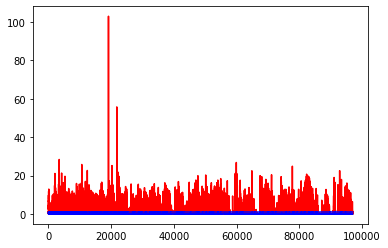

white ratio : 49.5
min : 177
max : 228


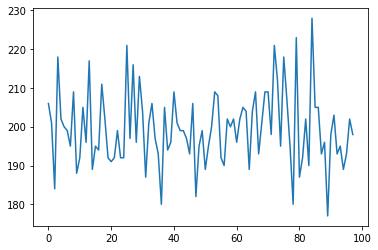

Generating interpolations...
97001 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.077181, 0.000023]
97002 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.005705, 0.000415]
97003 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.826713, 2.615787]
97004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000116, 0.000101]
97005 [D loss: 0.000376, acc.: 100.00%] [G loss: 1.863730, 1.783846]
97006 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000508, 0.001569]
97007 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.001886, 0.001862]
97008 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.017860, 0.001500]
97009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000051, 0.000011]
97010 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000121, 0.000004]
97011 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000465, 0.000919]
97012 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000169, 0.000226]
97013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001032, 0.000182]
97014 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.852239, 0.000598]
97015

97120 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.022847, 0.005013]
97121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.161220, 0.124100]
97122 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.012886, 0.003142]
97123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003025, 0.024011]
97124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.005751, 0.026103]
97125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000096]
97126 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.064203, 0.004692]
97127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013729, 0.099733]
97128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000660, 0.000157]
97129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000894, 0.112608]
97130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.030050, 0.000074]
97131 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.017477, 0.012452]
97132 [D loss: 0.002298, acc.: 100.00%] [G loss: 0.231531, 0.004494]
97133 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.248068, 0.159023]
97134 [D loss: 0.000000, acc.: 100

97239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000010]
97240 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000040, 0.000004]
97241 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000027, 0.000002]
97242 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000009, 0.002650]
97243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001316, 0.041891]
97244 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000835, 0.014294]
97245 [D loss: 0.004473, acc.: 100.00%] [G loss: 0.000000, 0.000002]
97246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.030691, 0.002137]
97247 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000005, 0.000001]
97248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.131681, 0.318143]
97249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.004207]
97250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007704, 0.052025]
97251 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000009, 0.000593]
97252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004894, 0.149076]
97253 [D loss: 0.000001, acc.: 100

97359 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000065, 0.000082]
97360 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.069010, 0.003830]
97361 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002164, 0.000076]
97362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000404, 0.000103]
97363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004555, 0.000840]
97364 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002674, 0.027667]
97365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036017, 0.201663]
97366 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.001020, 0.001401]
97367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.146996, 0.104186]
97368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003441, 0.000133]
97369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.026914, 0.000292]
97370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000115, 0.000020]
97371 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000654, 0.012122]
97372 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.001108, 0.000168]
97373 [D loss: 0.000013, acc.: 100

97481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.001772]
97482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004500, 0.003944]
97483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000017, 0.000159]
97484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000827, 0.000214]
97485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000052, 0.000000]
97486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000271, 0.000073]
97487 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000006, 0.000000]
97488 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000010, 0.000001]
97489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.818441, 0.000116]
97490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000250, 0.000171]
97491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
97492 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.017075, 0.001039]
97493 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000540, 0.000721]
97494 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001566, 0.000020]
97495 [D loss: 0.000001, acc.: 100

97600 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000000]
97601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97602 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97603 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97605 [D loss: 0.001726, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97606 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
97607 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000001, 0.000074]
97608 [D loss: 0.095510, acc.: 96.88%] [G loss: 0.000005, 0.085158]
97609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025536, 0.013113]
97610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000383, 0.093384]
97611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.111004, 0.177058]
97612 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.154638, 6.219847]
97613 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.393469, 0.020978]
97614 [D loss: 0.000009, acc.: 100.

97719 [D loss: 0.002939, acc.: 100.00%] [G loss: 0.012996, 0.005904]
97720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000051, 0.044428]
97721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000258, 0.001017]
97722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000446, 0.000185]
97723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.022790, 0.007114]
97724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001650, 0.000248]
97725 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.066812, 0.002022]
97726 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.004883, 0.003974]
97727 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.206408, 0.024282]
97728 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.821253, 0.014195]
97729 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000020, 0.004736]
97730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000052, 0.000181]
97731 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.000007, 0.000440]
97732 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001470, 0.000038]
97733 [D loss: 0.000001, acc.: 100

97838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.279174, 0.012680]
97839 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.912180, 2.974560]
97840 [D loss: 0.003678, acc.: 100.00%] [G loss: 4.967099, 3.422017]
97841 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.010959, 0.000684]
97842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.452594, 0.372885]
97843 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.314371, 1.433110]
97844 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.484165, 7.611784]
97845 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.530677, 6.459613]
97846 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.573682, 3.398288]
97847 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.147108, 7.717618]
97848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.335304, 0.141348]
97849 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.609615, 4.059459]
97850 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.132027, 1.800465]
97851 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.547009, 2.003657]
97852 [D loss: 0.000192, acc.: 100

97957 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.723517, 3.881566]
97958 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.670373, 6.193480]
97959 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.008140, 4.662623]
97960 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.938288, 1.647733]
97961 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.108471, 4.738375]
97962 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.175581, 0.501372]
97963 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.091252, 2.156350]
97964 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.065214, 0.009505]
97965 [D loss: 0.000412, acc.: 100.00%] [G loss: 0.445289, 0.605505]
97966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.264790, 0.192608]
97967 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.436992, 1.870731]
97968 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.397856, 2.849899]
97969 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.553924, 1.310577]
97970 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.276521, 1.741370]
97971 [D loss: 0.000000, acc.: 100

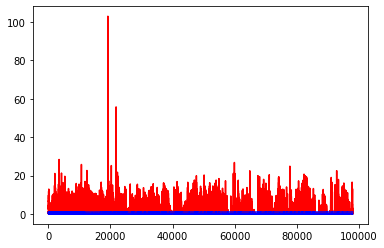

white ratio : 53.0
min : 177
max : 228


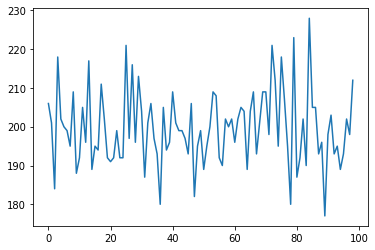

Generating interpolations...
98001 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.819505, 2.543180]
98002 [D loss: 0.018940, acc.: 100.00%] [G loss: 0.017531, 0.127267]
98003 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.550928, 3.655211]
98004 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.340733, 0.806679]
98005 [D loss: 0.151554, acc.: 96.88%] [G loss: 0.079494, 0.039985]
98006 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.003362, 0.010461]
98007 [D loss: 0.000700, acc.: 100.00%] [G loss: 0.000000, 0.000000]
98008 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.060134, 0.244813]
98009 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000001, 0.000018]
98010 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.020971, 0.074975]
98011 [D loss: 0.003011, acc.: 100.00%] [G loss: 2.006902, 0.945243]
98012 [D loss: 0.007777, acc.: 100.00%] [G loss: 0.029818, 0.405854]
98013 [D loss: 0.020448, acc.: 100.00%] [G loss: 0.009559, 0.001488]
98014 [D loss: 0.001252, acc.: 100.00%] [G loss: 0.433440, 0.445041]
98015 

98122 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.295957, 3.028555]
98123 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.170532, 1.517596]
98124 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.626744, 0.970255]
98125 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.880554, 1.416426]
98126 [D loss: 0.000064, acc.: 100.00%] [G loss: 1.060241, 1.258228]
98127 [D loss: 0.122275, acc.: 96.88%] [G loss: 0.485651, 0.234712]
98128 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.003174, 0.002033]
98129 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000007, 0.002722]
98130 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.311202, 0.189252]
98131 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.002555, 0.002635]
98132 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.111077, 0.237573]
98133 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.185254, 0.218513]
98134 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000012, 0.000021]
98135 [D loss: 0.002908, acc.: 100.00%] [G loss: 0.018963, 0.005608]
98136 [D loss: 0.000033, acc.: 100.

98243 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000005, 0.000001]
98244 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.037909, 0.006928]
98245 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.563457, 0.562572]
98246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.064982, 0.001145]
98247 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.093859, 0.039702]
98248 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.012095, 0.039430]
98249 [D loss: 0.001500, acc.: 100.00%] [G loss: 3.612727, 2.925386]
98250 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000075, 0.066418]
98251 [D loss: 0.000098, acc.: 100.00%] [G loss: 12.402088, 0.015924]
98252 [D loss: 0.003309, acc.: 100.00%] [G loss: 2.356503, 2.556301]
98253 [D loss: 0.000128, acc.: 100.00%] [G loss: 5.552542, 4.616986]
98254 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.001785, 0.000285]
98255 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.299705, 4.248599]
98256 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000017, 0.003081]
98257 [D loss: 0.000749, acc.: 10

98363 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.085526, 5.839437]
98364 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.226288, 7.295897]
98365 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.915699, 3.116840]
98366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.028519, 0.059425]
98367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000301, 0.125860]
98368 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.318995, 0.219679]
98369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000261, 0.006505]
98370 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.472353, 1.732615]
98371 [D loss: 0.000608, acc.: 100.00%] [G loss: 0.732881, 0.807967]
98372 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.547550, 0.259691]
98373 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.337775, 0.098435]
98374 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.270691, 2.143898]
98375 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.245974, 0.056996]
98376 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.473301, 8.347012]
98377 [D loss: 0.000000, acc.: 100

98484 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000330, 0.000130]
98485 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.933191, 2.810038]
98486 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.012370, 0.003024]
98487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008287, 0.037021]
98488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.067334, 0.047678]
98489 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.829533, 1.054221]
98490 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.002283, 0.101899]
98491 [D loss: 0.000053, acc.: 100.00%] [G loss: 63.218063, 2.190373]
98492 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.133856, 2.732627]
98493 [D loss: 0.000641, acc.: 100.00%] [G loss: 0.880388, 0.916688]
98494 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.412106, 2.771140]
98495 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.705629, 4.209707]
98496 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.782565, 1.446228]
98497 [D loss: 0.000048, acc.: 100.00%] [G loss: 2.091061, 2.111865]
98498 [D loss: 0.000034, acc.: 10

98604 [D loss: 0.000037, acc.: 100.00%] [G loss: 5.077724, 0.144614]
98605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007463, 0.114261]
98606 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.111411, 0.384930]
98607 [D loss: 0.000251, acc.: 100.00%] [G loss: 2.182261, 0.381925]
98608 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.515288, 0.242169]
98609 [D loss: 0.002977, acc.: 100.00%] [G loss: 0.528870, 0.167695]
98610 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000131, 0.000461]
98611 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.803803, 0.686939]
98612 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000081, 0.006816]
98613 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.067590, 0.014936]
98614 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000005, 0.000028]
98615 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.236073, 0.122189]
98616 [D loss: 0.000017, acc.: 100.00%] [G loss: 3.986955, 2.094575]
98617 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.041965, 0.000854]
98618 [D loss: 0.001781, acc.: 100

98723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000016]
98724 [D loss: 0.003588, acc.: 100.00%] [G loss: 0.396550, 0.128513]
98725 [D loss: 0.000918, acc.: 100.00%] [G loss: 0.006116, 0.000031]
98726 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.002290, 0.000917]
98727 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.007575, 0.002375]
98728 [D loss: 0.009922, acc.: 100.00%] [G loss: 0.000002, 0.000015]
98729 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.807617, 0.012871]
98730 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.050069, 0.114371]
98731 [D loss: 0.000576, acc.: 100.00%] [G loss: 0.718094, 0.271596]
98732 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.845841, 0.006013]
98733 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.001261]
98734 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.236424, 0.167829]
98735 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.267854, 0.280285]
98736 [D loss: 0.000404, acc.: 100.00%] [G loss: 0.131769, 0.159953]
98737 [D loss: 0.000002, acc.: 100

98845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.290049, 0.493417]
98846 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.232685, 0.133890]
98847 [D loss: 0.002317, acc.: 100.00%] [G loss: 1.547368, 1.520290]
98848 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.115670, 0.249526]
98849 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000006, 0.000411]
98850 [D loss: 0.001764, acc.: 100.00%] [G loss: 35.440235, 3.576564]
98851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.915939, 0.493537]
98852 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.745360, 0.995659]
98853 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.915397, 3.685502]
98854 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000475, 0.000847]
98855 [D loss: 0.000005, acc.: 100.00%] [G loss: 7.026062, 5.890625]
98856 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.256140, 0.467354]
98857 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003080, 0.000639]
98858 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.420879, 0.231733]
98859 [D loss: 0.000026, acc.: 10

98964 [D loss: 0.004439, acc.: 100.00%] [G loss: 0.000000, 0.000000]
98965 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.017673, 0.124434]
98966 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.379372, 1.046058]
98967 [D loss: 0.003375, acc.: 100.00%] [G loss: 0.874981, 0.292382]
98968 [D loss: 0.000051, acc.: 100.00%] [G loss: 1.748551, 1.566407]
98969 [D loss: 0.000518, acc.: 100.00%] [G loss: 0.000238, 0.000278]
98970 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.000027, 0.000060]
98971 [D loss: 0.012535, acc.: 100.00%] [G loss: 0.000002, 0.000000]
98972 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.000000, 0.000000]
98973 [D loss: 0.001934, acc.: 100.00%] [G loss: 0.000212, 0.000131]
98974 [D loss: 0.000817, acc.: 100.00%] [G loss: 0.098601, 0.337946]
98975 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.023055, 0.005473]
98976 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000396, 0.000154]
98977 [D loss: 0.001458, acc.: 100.00%] [G loss: 0.000000, 0.000000]
98978 [D loss: 0.000114, acc.: 100

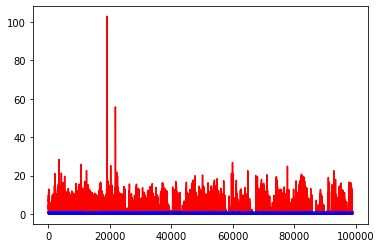

white ratio : 48.75
min : 177
max : 228


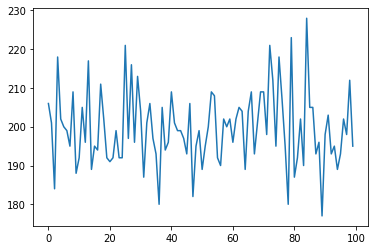

Generating interpolations...
99001 [D loss: 0.000825, acc.: 100.00%] [G loss: 0.000296, 0.000135]
99002 [D loss: 0.000781, acc.: 100.00%] [G loss: 0.087453, 0.015102]
99003 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.052782, 0.003857]
99004 [D loss: 0.002709, acc.: 100.00%] [G loss: 0.001751, 0.028981]
99005 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.000448, 0.003110]
99006 [D loss: 0.000033, acc.: 100.00%] [G loss: 14.659933, 0.009495]
99007 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000020, 0.000001]
99008 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.350058, 0.162971]
99009 [D loss: 0.000017, acc.: 100.00%] [G loss: 5.922927, 4.366499]
99010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
99011 [D loss: 0.040313, acc.: 96.88%] [G loss: 0.000752, 0.042588]
99012 [D loss: 0.000008, acc.: 100.00%] [G loss: 22.603844, 12.782359]
99013 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.632884, 4.282779]
99014 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.518635, 3.722003]
990

99122 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000018, 0.000003]
99123 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.000000, 0.000006]
99124 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000005, 0.000002]
99125 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000002, 0.000019]
99126 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.035256, 0.000080]
99127 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000004, 0.000276]
99128 [D loss: 0.000489, acc.: 100.00%] [G loss: 0.056793, 0.026141]
99129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
99130 [D loss: 0.002414, acc.: 100.00%] [G loss: 0.000026, 0.003063]
99131 [D loss: 0.026782, acc.: 96.88%] [G loss: 0.000040, 0.000615]
99132 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000144, 0.000031]
99133 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000119, 0.001464]
99134 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
99135 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000949, 0.000132]
99136 [D loss: 0.024647, acc.: 96.8

99242 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000001]
99243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
99244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000756, 0.006827]
99245 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.000019, 0.000014]
99246 [D loss: 0.001267, acc.: 100.00%] [G loss: 0.000000, 0.000000]
99247 [D loss: 0.000675, acc.: 100.00%] [G loss: 0.000001, 0.000000]
99248 [D loss: 0.000567, acc.: 100.00%] [G loss: 0.000000, 0.000000]
99249 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000295, 0.000281]
99250 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000009, 0.000009]
99251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000189, 0.001470]
99252 [D loss: 0.000016, acc.: 100.00%] [G loss: 18.300865, 0.009841]
99253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023266, 0.366469]
99254 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.221485, 0.348473]
99255 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.774409, 0.411223]
99256 [D loss: 0.000053, acc.: 10

99363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.194801, 0.133106]
99364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000513, 0.000321]
99365 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000036, 0.000104]
99366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.061277, 0.310387]
99367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.158979, 0.114878]
99368 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001921, 0.012557]
99369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000096]
99370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025329, 0.026865]
99371 [D loss: 0.002272, acc.: 100.00%] [G loss: 0.001593, 0.000014]
99372 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012433, 0.005501]
99373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007498, 0.000079]
99374 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.120856, 0.331599]
99375 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.177703, 0.003681]
99376 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.005645, 0.000113]
99377 [D loss: 0.000001, acc.: 100

99484 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.009064, 0.004577]
99485 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.120467, 0.018230]
99486 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.665570, 0.100942]
99487 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.859322, 0.326436]
99488 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.018252, 0.008926]
99489 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.409409, 0.192787]
99490 [D loss: 0.047150, acc.: 96.88%] [G loss: 2.619222, 1.337523]
99491 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.969360, 0.627124]
99492 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.005826, 0.000196]
99493 [D loss: 0.044326, acc.: 96.88%] [G loss: 0.187377, 0.281716]
99494 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.204161, 0.185169]
99495 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.071941, 0.116408]
99496 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.175641, 0.204185]
99497 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.014765, 0.082659]
99498 [D loss: 0.000418, acc.: 100.0

99606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000097, 0.002100]
99607 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.002118, 0.016556]
99608 [D loss: 0.045843, acc.: 96.88%] [G loss: 0.022711, 0.024584]
99609 [D loss: 0.000209, acc.: 100.00%] [G loss: 0.203908, 0.107975]
99610 [D loss: 0.000044, acc.: 100.00%] [G loss: 1.396836, 1.450944]
99611 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.841110, 0.520915]
99612 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.055993, 2.168523]
99613 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.250516, 1.412218]
99614 [D loss: 0.043636, acc.: 96.88%] [G loss: 5.031274, 3.408921]
99615 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.030619, 0.000802]
99616 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019777, 0.017932]
99617 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.066632, 0.763170]
99618 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.038826, 0.000084]
99619 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.805542, 0.662998]
99620 [D loss: 0.000574, acc.: 100.0

99728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.069774, 0.175893]
99729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.611838, 0.661425]
99730 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002410, 0.097591]
99731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023409, 0.007047]
99732 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.092335, 0.002642]
99733 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.234961, 0.190503]
99734 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.262994, 0.256669]
99735 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.103486, 0.021964]
99736 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.174776, 0.280780]
99737 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.160239, 0.011664]
99738 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.030730, 0.011276]
99739 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000129, 0.001581]
99740 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.137938, 0.040183]
99741 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.472462, 0.379024]
99742 [D loss: 0.000012, acc.: 100

99847 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.002145, 0.000001]
99848 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.006519, 0.001312]
99849 [D loss: 0.000548, acc.: 100.00%] [G loss: 0.000795, 0.010109]
99850 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000082, 0.003592]
99851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000017, 0.000149]
99852 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.054583, 0.096469]
99853 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010961, 0.002200]
99854 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.194333, 0.211535]
99855 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000416, 0.003512]
99856 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002972, 0.004140]
99857 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000673, 0.007101]
99858 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.001140, 0.001172]
99859 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005133, 0.001388]
99860 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.008383, 0.002718]
99861 [D loss: 0.000004, acc.: 100

99968 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.170170, 1.347389]
99969 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.008476, 0.023962]
99970 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.679292, 0.603811]
99971 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.080186, 0.183917]
99972 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.432583, 0.655734]
99973 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.006424, 0.011591]
99974 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.315246, 0.312630]
99975 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.191888, 0.002569]
99976 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.001407, 0.000415]
99977 [D loss: 0.000519, acc.: 100.00%] [G loss: 0.000009, 0.000234]
99978 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.143609, 0.176978]
99979 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.747502, 1.212006]
99980 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.911154, 6.731231]
99981 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.149147, 12.620233]
99982 [D loss: 0.000000, acc.: 

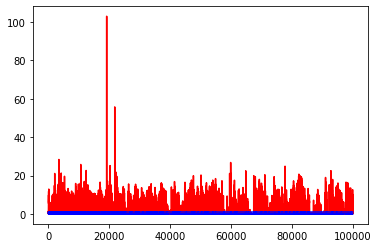

white ratio : 44.5
min : 177
max : 228


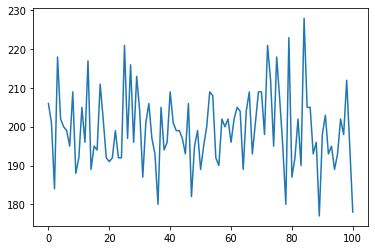

Generating interpolations...
100001 [D loss: 0.000329, acc.: 100.00%] [G loss: 0.067733, 0.004268]
100002 [D loss: 0.209729, acc.: 96.88%] [G loss: 0.124248, 0.042771]
100003 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.989609, 3.741875]
100004 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.293360, 5.039596]
100005 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.993372, 17.329897]
100006 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.206839, 9.820455]
100007 [D loss: 0.000019, acc.: 100.00%] [G loss: 14.448442, 11.927658]
100008 [D loss: 0.000419, acc.: 100.00%] [G loss: 9.386548, 7.845250]
100009 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.805932, 9.499136]
100010 [D loss: 0.000126, acc.: 100.00%] [G loss: 9.441238, 8.555455]
100011 [D loss: 0.006879, acc.: 100.00%] [G loss: 5.840116, 4.899199]
100012 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.688668, 3.421942]
100013 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.690072, 5.442915]
100014 [D loss: 0.000017, acc.: 100.00%] [G loss: 2.357792

100117 [D loss: 0.017614, acc.: 100.00%] [G loss: 0.462340, 0.210348]
100118 [D loss: 0.015419, acc.: 100.00%] [G loss: 0.005881, 0.101446]
100119 [D loss: 0.010410, acc.: 100.00%] [G loss: 0.318398, 0.620272]
100120 [D loss: 0.000049, acc.: 100.00%] [G loss: 3.222513, 1.385077]
100121 [D loss: 0.304390, acc.: 96.88%] [G loss: 0.006505, 0.109552]
100122 [D loss: 0.000919, acc.: 100.00%] [G loss: 0.003369, 0.000073]
100123 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000226, 0.000109]
100124 [D loss: 0.021954, acc.: 100.00%] [G loss: 0.044455, 0.103498]
100125 [D loss: 0.000250, acc.: 100.00%] [G loss: 0.009954, 0.021884]
100126 [D loss: 0.004973, acc.: 100.00%] [G loss: 0.033020, 0.004783]
100127 [D loss: 0.000542, acc.: 100.00%] [G loss: 1.010328, 0.036092]
100128 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.669597, 0.732263]
100129 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.805106, 0.675983]
100130 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.577243, 0.922679]
100131 [D loss: 0.000

100235 [D loss: 0.005702, acc.: 100.00%] [G loss: 1.011372, 0.979986]
100236 [D loss: 0.000390, acc.: 100.00%] [G loss: 0.041575, 0.287844]
100237 [D loss: 0.000096, acc.: 100.00%] [G loss: 2.361143, 2.275823]
100238 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.059123, 0.003921]
100239 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.097440, 0.008638]
100240 [D loss: 0.000507, acc.: 100.00%] [G loss: 1.060160, 0.839483]
100241 [D loss: 0.001389, acc.: 100.00%] [G loss: 1.527134, 0.565612]
100242 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.401185, 0.534394]
100243 [D loss: 0.000165, acc.: 100.00%] [G loss: 1.760189, 1.083814]
100244 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.117355, 0.062853]
100245 [D loss: 0.000399, acc.: 100.00%] [G loss: 0.002924, 0.005648]
100246 [D loss: 0.040227, acc.: 96.88%] [G loss: 0.011631, 0.362530]
100247 [D loss: 0.033591, acc.: 96.88%] [G loss: 0.000006, 0.000028]
100248 [D loss: 0.011604, acc.: 100.00%] [G loss: 0.545408, 0.173637]
100249 [D loss: 0.0005

100354 [D loss: 0.000446, acc.: 100.00%] [G loss: 0.000229, 0.000343]
100355 [D loss: 0.001232, acc.: 100.00%] [G loss: 0.046171, 0.063783]
100356 [D loss: 0.000393, acc.: 100.00%] [G loss: 0.001171, 0.000477]
100357 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.015572, 0.005595]
100358 [D loss: 0.000337, acc.: 100.00%] [G loss: 0.156471, 0.424492]
100359 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.029113, 0.032261]
100360 [D loss: 0.000836, acc.: 100.00%] [G loss: 0.295981, 0.161574]
100361 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000003, 0.000023]
100362 [D loss: 0.000364, acc.: 100.00%] [G loss: 0.710636, 0.395542]
100363 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.000032, 0.000006]
100364 [D loss: 0.000598, acc.: 100.00%] [G loss: 0.000527, 0.000038]
100365 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000082, 0.006708]
100366 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.000779, 0.000020]
100367 [D loss: 0.001073, acc.: 100.00%] [G loss: 0.033086, 0.123770]
100368 [D loss: 0.00

100473 [D loss: 0.001357, acc.: 100.00%] [G loss: 0.111609, 0.023574]
100474 [D loss: 0.000329, acc.: 100.00%] [G loss: 0.000032, 0.000003]
100475 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000002, 0.000010]
100476 [D loss: 0.002098, acc.: 100.00%] [G loss: 0.000210, 0.000003]
100477 [D loss: 0.000440, acc.: 100.00%] [G loss: 0.000000, 0.000002]
100478 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.006520, 0.085251]
100479 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.018701, 0.145257]
100480 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.360874, 0.306208]
100481 [D loss: 0.000412, acc.: 100.00%] [G loss: 0.019371, 0.098958]
100482 [D loss: 0.002671, acc.: 100.00%] [G loss: 0.124399, 0.196025]
100483 [D loss: 0.000697, acc.: 100.00%] [G loss: 0.177575, 0.252792]
100484 [D loss: 0.000525, acc.: 100.00%] [G loss: 0.263738, 0.032829]
100485 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.012490, 0.001691]
100486 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100487 [D loss: 0.00

100593 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.001351, 0.000262]
100594 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.001598, 0.009253]
100595 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000050, 0.000811]
100596 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.010419, 0.001422]
100597 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000001, 0.000002]
100598 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000184]
100599 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.046064, 0.007071]
100600 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.012746, 0.009645]
100601 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000002]
100602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
100603 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.006311, 0.041517]
100604 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.140660, 0.141341]
100605 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.003098, 0.013313]
100606 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.020829, 0.004904]
100607 [D loss: 0.00

100713 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000597, 0.000068]
100714 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100715 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.000500, 0.000865]
100716 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100717 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100718 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000600, 0.000827]
100719 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100720 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100721 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100722 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.000941, 0.001170]
100723 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.148057, 0.053299]
100724 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001369, 0.000048]
100725 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100726 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.001391, 0.001114]
100727 [D loss: 0.00

100833 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100834 [D loss: 0.000536, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100835 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100836 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100837 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100838 [D loss: 0.000438, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100839 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100840 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.000554, 0.001120]
100841 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100842 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.000001, 0.000000]
100843 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100844 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.000006, 0.000002]
100845 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100846 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.004524, 0.000691]
100847 [D loss: 0.00

100952 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100953 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.015745, 0.042793]
100954 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.078842, 0.050881]
100955 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100957 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.006239, 0.004798]
100958 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
100959 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.006489, 0.068429]
100960 [D loss: 0.001792, acc.: 100.00%] [G loss: 0.000000, 0.000025]
100961 [D loss: 0.008149, acc.: 100.00%] [G loss: 0.003556, 0.000208]
100962 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001071, 0.008754]
100963 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.098885, 0.051232]
100964 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.199204, 0.517923]
100965 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000535, 0.010735]
100966 [D loss: 0.00

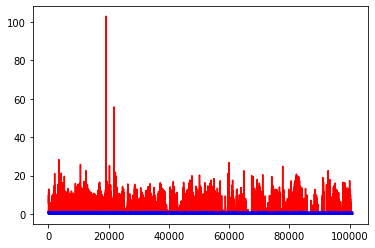

white ratio : 54.0
min : 177
max : 228


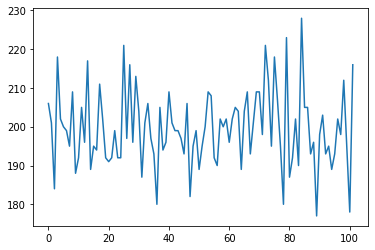

Generating interpolations...
101001 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000005, 0.000000]
101002 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101003 [D loss: 0.000012, acc.: 100.00%] [G loss: 18.548794, 3.858346]
101004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.044377, 0.112467]
101005 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.029885, 0.107689]
101006 [D loss: 0.000345, acc.: 100.00%] [G loss: 10.101477, 8.050606]
101007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.575820, 0.192019]
101008 [D loss: 0.000459, acc.: 100.00%] [G loss: 7.878060, 7.824209]
101009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.208689, 0.264124]
101010 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.615651, 6.680648]
101011 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.096162, 0.005867]
101012 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.000086, 0.000052]
101013 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.102900, 0.000681]
101014 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.560739,

101119 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.066320, 0.010235]
101120 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.008409, 0.009396]
101121 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.116978, 0.914844]
101122 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000021, 0.000000]
101123 [D loss: 0.001069, acc.: 100.00%] [G loss: 0.262911, 0.514120]
101124 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.001834, 0.000143]
101125 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.001403, 0.000779]
101126 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.000012, 0.000048]
101127 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000001, 0.000000]
101128 [D loss: 0.035581, acc.: 96.88%] [G loss: 0.000000, 0.000000]
101129 [D loss: 0.000680, acc.: 100.00%] [G loss: 0.487335, 0.101821]
101130 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000001, 0.000007]
101131 [D loss: 0.000286, acc.: 100.00%] [G loss: 0.000021, 0.000014]
101132 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.016902, 0.025477]
101133 [D loss: 0.000

101237 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000034, 0.000345]
101238 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.005838, 0.000001]
101239 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.025897, 0.013878]
101240 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000001, 0.000061]
101241 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101242 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000011]
101243 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000587, 0.001888]
101244 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000001, 0.000000]
101245 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.000000, 0.000004]
101246 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000465, 0.000251]
101247 [D loss: 0.000654, acc.: 100.00%] [G loss: 0.000024, 0.000125]
101248 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000028, 0.000056]
101249 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000018, 0.000389]
101250 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000005, 0.010170]
101251 [D loss: 0.00

101356 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101357 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101358 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.000001, 0.000000]
101359 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101360 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101361 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000002, 0.000002]
101362 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101363 [D loss: 0.006743, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101364 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000196, 0.000097]
101365 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000008]
101366 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101367 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000000]
101368 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101369 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000000, 0.000007]
101370 [D loss: 0.00

101477 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000562, 0.000016]
101478 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101479 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101480 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000810, 0.081962]
101481 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.002403]
101482 [D loss: 0.024036, acc.: 100.00%] [G loss: 0.000014, 0.000002]
101483 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101484 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101485 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101486 [D loss: 0.014131, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101487 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101488 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.053298, 0.010456]
101489 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101490 [D loss: 0.005648, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101491 [D loss: 0.00

101596 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000044]
101597 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000006]
101598 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101599 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.003987, 0.000104]
101600 [D loss: 0.006439, acc.: 100.00%] [G loss: 0.001007, 0.000074]
101601 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101602 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000020, 0.000002]
101603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101604 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000028, 0.000022]
101605 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101606 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101607 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.000001, 0.000043]
101608 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.015534, 0.028116]
101609 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101610 [D loss: 0.00

101717 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.004418, 0.000112]
101718 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101719 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000000]
101720 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.020827, 0.098152]
101721 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101722 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000002, 0.000009]
101723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000041, 0.000007]
101724 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101725 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000129, 0.000011]
101726 [D loss: 0.000464, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101727 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000091, 0.000000]
101728 [D loss: 0.000582, acc.: 100.00%] [G loss: 0.000029, 0.001016]
101729 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000002, 0.000000]
101730 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000314, 0.000021]
101731 [D loss: 0.00

101837 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000016, 0.003593]
101838 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000001]
101839 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101840 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000006, 0.000259]
101841 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000000]
101842 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.021917, 0.078223]
101843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000005, 0.000002]
101844 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007114, 0.000025]
101846 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101847 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101848 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000008, 0.000036]
101849 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000079, 0.001388]
101850 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000077, 0.000008]
101851 [D loss: 0.00

101957 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101958 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.080447, 0.000520]
101959 [D loss: 0.100081, acc.: 96.88%] [G loss: 0.000070, 0.000012]
101960 [D loss: 0.006377, acc.: 100.00%] [G loss: 0.000021, 0.000002]
101961 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000012, 0.000096]
101962 [D loss: 0.004213, acc.: 100.00%] [G loss: 0.000000, 0.000090]
101963 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000060, 0.000292]
101964 [D loss: 0.000392, acc.: 100.00%] [G loss: 0.016631, 0.000185]
101965 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000131, 0.000014]
101966 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.194549, 0.085881]
101967 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.022466, 0.264586]
101968 [D loss: 0.000362, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101969 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.014808, 0.000000]
101970 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
101971 [D loss: 0.000

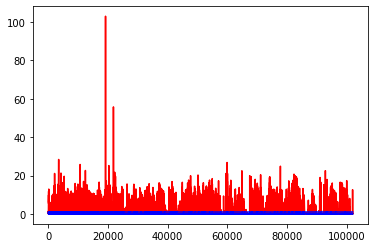

white ratio : 51.0
min : 177
max : 228


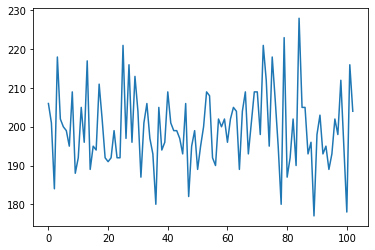

Generating interpolations...
102001 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.146175, 0.111861]
102002 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.178108, 0.355073]
102003 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.170151, 0.339609]
102004 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.007121, 0.000332]
102005 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.008094, 0.000274]
102006 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000006, 0.000026]
102007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.149422, 0.135424]
102008 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000096, 0.001233]
102009 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.006119, 0.061642]
102010 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.001489, 0.003027]
102011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001388, 0.000000]
102012 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000065, 0.004742]
102013 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000794, 0.000203]
102014 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.031251, 0

102119 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.163350, 0.030379]
102120 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.044631, 0.013635]
102121 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.018778, 0.046762]
102122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033762, 0.018151]
102123 [D loss: 0.002582, acc.: 100.00%] [G loss: 0.017406, 0.001229]
102124 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000388, 0.000067]
102125 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.057904, 0.338362]
102126 [D loss: 0.000336, acc.: 100.00%] [G loss: 0.441253, 0.126552]
102127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.083817, 0.081147]
102128 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.002702, 0.006065]
102129 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.002465, 0.001532]
102130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000596, 0.000074]
102131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.117843, 0.080279]
102132 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.008503, 0.034625]
102133 [D loss: 0.00

102238 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.165993, 0.004630]
102239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000583, 0.004830]
102240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.919109, 0.494295]
102241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003025, 0.001048]
102242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.144263, 0.029958]
102243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007010, 0.003614]
102244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.338183, 1.077389]
102245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.359392, 0.266367]
102246 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.003328, 0.132829]
102247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.085157, 0.096099]
102248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.076244, 0.156810]
102249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000515, 0.046082]
102250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002737, 0.007607]
102251 [D loss: 0.002835, acc.: 100.00%] [G loss: 0.216754, 0.008092]
102252 [D loss: 0.00

102357 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.075831, 0.017862]
102358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.061967, 0.029597]
102359 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.062363, 0.000257]
102360 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.032741, 0.223470]
102361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.229895, 0.135695]
102362 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.165647, 0.143452]
102363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.033373, 0.014953]
102364 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.001565, 0.078222]
102365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.051690, 0.000546]
102366 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.063999, 0.000574]
102367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000429, 0.000113]
102368 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.060326, 0.002615]
102369 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.102258, 0.121002]
102370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001696, 0.000660]
102371 [D loss: 0.00

102475 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.004563, 0.889350]
102476 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.347038, 0.620920]
102477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.153684, 0.511209]
102478 [D loss: 0.002286, acc.: 100.00%] [G loss: 0.057971, 0.052935]
102479 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.717363, 0.765737]
102480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010394, 0.008941]
102481 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.845912, 0.861142]
102482 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.014180, 0.798862]
102483 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.544120, 0.545187]
102484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002120, 0.035249]
102485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.312408, 0.134985]
102486 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.093025, 0.000794]
102487 [D loss: 0.001792, acc.: 100.00%] [G loss: 0.313144, 0.722089]
102488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.785463, 0.496100]
102489 [D loss: 0.00

102594 [D loss: 0.000636, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102595 [D loss: 0.007223, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102596 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000138, 0.000000]
102597 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102598 [D loss: 0.027051, acc.: 96.88%] [G loss: 0.000000, 0.000009]
102599 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000293, 0.000001]
102600 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.000108, 0.000003]
102601 [D loss: 0.006780, acc.: 100.00%] [G loss: 0.000065, 0.000074]
102602 [D loss: 0.000308, acc.: 100.00%] [G loss: 0.000000, 0.000019]
102603 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000000, 0.000026]
102604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000043, 0.000000]
102605 [D loss: 0.006168, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102606 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102607 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102608 [D loss: 0.000

102714 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000017]
102715 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102716 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000009]
102718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000064, 0.000011]
102719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001747, 0.005137]
102720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000240]
102721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000000]
102722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000108]
102723 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000003, 0.000005]
102724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000003]
102725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000005, 0.016358]
102726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033027, 0.000097]
102727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
102728 [D loss: 0.00

102832 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102833 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102834 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102835 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102836 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.000000, 0.000015]
102837 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102838 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102839 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000002, 0.000000]
102840 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102841 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000001, 0.000000]
102842 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102843 [D loss: 0.010031, acc.: 100.00%] [G loss: 0.000017, 0.000002]
102844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000018]
102845 [D loss: 0.000591, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102846 [D loss: 0.00

102952 [D loss: 0.000503, acc.: 100.00%] [G loss: 0.003286, 0.000466]
102953 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000001]
102954 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.028941, 0.004662]
102955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
102956 [D loss: 0.000167, acc.: 100.00%] [G loss: 0.000484, 0.000000]
102957 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000004, 0.000000]
102958 [D loss: 0.001065, acc.: 100.00%] [G loss: 0.018464, 0.000004]
102959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000000]
102960 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000496, 0.000035]
102961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000076, 0.000428]
102962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000001]
102963 [D loss: 0.000872, acc.: 100.00%] [G loss: 0.014966, 0.000061]
102964 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000002, 0.000001]
102965 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.012251, 0.000066]
102966 [D loss: 0.00

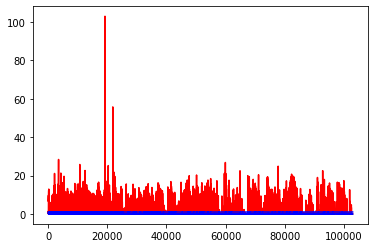

white ratio : 52.5
min : 177
max : 228


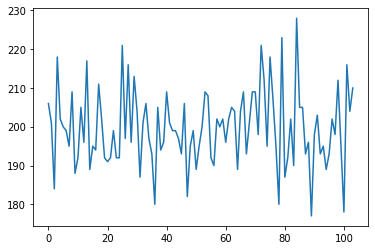

Generating interpolations...
103001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000048, 0.000333]
103002 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103004 [D loss: 0.000340, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103005 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000001]
103006 [D loss: 0.000848, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103007 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000002, 0.000002]
103008 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103009 [D loss: 0.034611, acc.: 96.88%] [G loss: 0.000001, 0.000001]
103010 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000001, 0.000000]
103011 [D loss: 0.000182, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103012 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103013 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.

103119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001109, 0.000004]
103120 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.028291, 0.000002]
103121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000012, 0.000005]
103122 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000000]
103123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.000001]
103124 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000013, 0.000000]
103125 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.000057]
103127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005328, 0.000034]
103128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000058]
103130 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000002, 0.000016]
103131 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000007, 0.000003]
103132 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103133 [D loss: 0.00

103238 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000010, 0.000000]
103239 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000030, 0.000005]
103240 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103241 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000000]
103243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000044, 0.000044]
103244 [D loss: 0.000233, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103245 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000024, 0.000010]
103246 [D loss: 0.000299, acc.: 100.00%] [G loss: 0.000004, 0.000000]
103247 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103249 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000048, 0.000001]
103250 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000010, 0.000015]
103251 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000007, 0.000004]
103252 [D loss: 0.00

103359 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000005, 0.000000]
103360 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000001, 0.000004]
103361 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103362 [D loss: 0.000499, acc.: 100.00%] [G loss: 0.000025, 0.000039]
103363 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000011, 0.000186]
103364 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103365 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.000002]
103366 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000024, 0.000012]
103367 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000066, 0.000058]
103368 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000060, 0.000078]
103369 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000027, 0.000026]
103370 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103371 [D loss: 0.000809, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103372 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000861, 0.000004]
103373 [D loss: 0.00

103477 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103478 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103479 [D loss: 0.001012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103480 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103481 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
103482 [D loss: 0.000319, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103483 [D loss: 0.004188, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103484 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103485 [D loss: 0.006599, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103486 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103487 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103488 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000003, 0.000000]
103489 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103490 [D loss: 0.000430, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103491 [D loss: 0.00

103596 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103597 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000008]
103598 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103599 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000020, 0.000003]
103600 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103601 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103602 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000000, 0.000001]
103603 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.000001, 0.000003]
103604 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103606 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103607 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103608 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000003, 0.000000]
103609 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103610 [D loss: 0.00

103717 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000003]
103718 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000210, 0.000003]
103719 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
103721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000004]
103722 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103723 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103724 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000005, 0.000001]
103725 [D loss: 0.000512, acc.: 100.00%] [G loss: 0.000014, 0.000000]
103726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103728 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000009]
103729 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000000]
103730 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000014]
103731 [D loss: 0.00

103835 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103836 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103837 [D loss: 0.000706, acc.: 100.00%] [G loss: 0.000003, 0.000000]
103838 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103839 [D loss: 0.000832, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103840 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103841 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103842 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103843 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103844 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103845 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103846 [D loss: 0.000807, acc.: 100.00%] [G loss: 0.000001, 0.000000]
103847 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000005]
103848 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103849 [D loss: 0.00

103953 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000212, 0.000065]
103954 [D loss: 0.000536, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000104, 0.001404]
103956 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000001]
103957 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000442, 0.141983]
103958 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000284, 0.001361]
103960 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000063, 0.000003]
103961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000474, 0.000006]
103962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
103963 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000891, 0.001837]
103964 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000001, 0.000187]
103965 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.000569, 0.000558]
103966 [D loss: 0.014937, acc.: 100.00%] [G loss: 0.000015, 0.000001]
103967 [D loss: 0.00

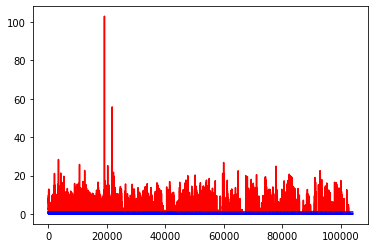

white ratio : 52.75
min : 177
max : 228


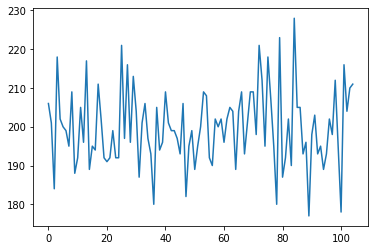

Generating interpolations...
104001 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104002 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000000, 0.000001]
104003 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000405, 0.025144]
104004 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000009, 0.000001]
104005 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000000]
104006 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104007 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.002905, 0.000078]
104008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104010 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104011 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000012]
104012 [D loss: 0.001465, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104013 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.000016, 0.000078]
104014 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000000, 0

104120 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104121 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000003, 0.000003]
104122 [D loss: 0.000435, acc.: 100.00%] [G loss: 0.000099, 0.000001]
104123 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104124 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104125 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104126 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104127 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104128 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104129 [D loss: 0.000907, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104130 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000003]
104131 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000004, 0.000005]
104132 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104133 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104134 [D loss: 0.00

104240 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
104242 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000593, 0.000000]
104243 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104244 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104245 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104248 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104249 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104250 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104251 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000003, 0.000112]
104252 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104253 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000002, 0.000000]
104254 [D loss: 0.00

104359 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104360 [D loss: 0.000202, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104361 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104362 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104363 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104364 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000002, 0.000001]
104365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104366 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104367 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.000000, 0.000002]
104368 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.000000, 0.000001]
104369 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104370 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104371 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104372 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000002, 0.000000]
104373 [D loss: 0.00

104477 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104478 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000054, 0.000000]
104480 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104481 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104482 [D loss: 0.000339, acc.: 100.00%] [G loss: 0.000001, 0.000000]
104483 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104484 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104485 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104486 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.000011, 0.000321]
104487 [D loss: 0.001552, acc.: 100.00%] [G loss: 0.000065, 0.000000]
104488 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104489 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104490 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000003, 0.000001]
104491 [D loss: 0.00

104595 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104596 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104597 [D loss: 0.000503, acc.: 100.00%] [G loss: 0.000009, 0.000000]
104598 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104600 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104601 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000000]
104602 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104603 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000290]
104604 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000001]
104606 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.026725, 0.000001]
104607 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000008, 0.000004]
104608 [D loss: 0.010977, acc.: 100.00%] [G loss: 0.000000, 0.000001]
104609 [D loss: 0.00

104713 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104714 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104715 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000032]
104716 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104717 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000008, 0.000003]
104718 [D loss: 0.002414, acc.: 100.00%] [G loss: 0.000193, 0.000000]
104719 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104721 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000102]
104722 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104723 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.000000, 0.000002]
104724 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104725 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000002, 0.000001]
104726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000019]
104727 [D loss: 0.00

104832 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104833 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000001, 0.000000]
104834 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104835 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000013]
104836 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000004]
104837 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104838 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104839 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000002, 0.000000]
104840 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000001]
104841 [D loss: 0.000535, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104842 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104843 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.000007, 0.000000]
104844 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104845 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104846 [D loss: 0.00

104951 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104952 [D loss: 0.000239, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104953 [D loss: 0.004602, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104954 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104955 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104956 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104957 [D loss: 0.001870, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104958 [D loss: 0.000487, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104959 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104960 [D loss: 0.019724, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104961 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104962 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104963 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104964 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
104965 [D loss: 0.00

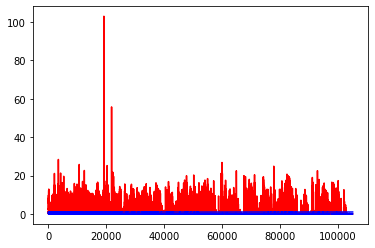

white ratio : 47.5
min : 177
max : 228


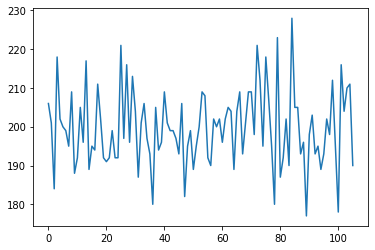

Generating interpolations...
105001 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105002 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105003 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
105005 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105006 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000010, 0.000000]
105007 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105008 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105009 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000000]
105010 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105011 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000021, 0.000000]
105012 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105013 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105014 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0

105118 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000224, 0.000000]
105119 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105120 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105121 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
105123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105124 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105125 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105128 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105130 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
105131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105132 [D loss: 0.00

105239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105240 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105241 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105242 [D loss: 0.018078, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105243 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105244 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000011]
105246 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105247 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000002, 0.000000]
105248 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105249 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105250 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105251 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105252 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105253 [D loss: 0.00

105359 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
105360 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105361 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105362 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
105364 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105365 [D loss: 0.002466, acc.: 100.00%] [G loss: 0.000004, 0.000001]
105366 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000001]
105367 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000004, 0.000002]
105370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105372 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
105373 [D loss: 0.00

105479 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.841382, 1.320064]
105480 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.730110, 0.421027]
105481 [D loss: 0.000956, acc.: 100.00%] [G loss: 0.949361, 0.710850]
105482 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.336726, 0.437553]
105483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.950410, 0.305709]
105484 [D loss: 0.001394, acc.: 100.00%] [G loss: 0.184564, 0.155142]
105485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.487398, 0.286310]
105486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.374774, 0.297535]
105487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.388271, 0.309264]
105488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.705643, 0.639539]
105489 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.375094, 0.305368]
105490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.115887, 0.220767]
105491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.760016, 0.679911]
105492 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.111803, 0.592488]
105493 [D loss: 0.00

105599 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.245579, 9.555366]
105600 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.033300, 12.191765]
105601 [D loss: 0.078712, acc.: 96.88%] [G loss: 0.151020, 0.073347]
105602 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.117916, 0.080006]
105603 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.008394, 0.000088]
105604 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.004696, 0.000012]
105605 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001727, 0.002332]
105606 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.045336, 0.035386]
105607 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000090, 0.000459]
105608 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.000028, 0.000129]
105609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.112675, 0.000681]
105610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000043, 0.000022]
105611 [D loss: 0.009593, acc.: 100.00%] [G loss: 0.030314, 0.224339]
105612 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.017683, 0.049666]
105613 [D loss: 0.

105719 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000015, 0.000004]
105720 [D loss: 0.212207, acc.: 96.88%] [G loss: 0.423195, 0.497174]
105721 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.234560, 4.525376]
105722 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.781813, 5.315383]
105723 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.697332, 4.623095]
105724 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.727344, 3.645646]
105725 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.915137, 3.504293]
105726 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.080501, 2.988437]
105727 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.052232, 1.420602]
105728 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.470190, 1.208803]
105729 [D loss: 0.090439, acc.: 96.88%] [G loss: 0.865460, 0.952837]
105730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.133189, 0.009088]
105731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004152, 0.037834]
105732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.138932, 0.448176]
105733 [D loss: 0.0000

105837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.050202, 0.153021]
105838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.044078, 0.016361]
105839 [D loss: 0.007293, acc.: 100.00%] [G loss: 0.003582, 0.000963]
105840 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001460, 0.224273]
105841 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.000668, 0.009490]
105842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001020, 0.004215]
105843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000360, 0.000021]
105844 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.002134, 0.000028]
105845 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.023347, 0.001449]
105846 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000239, 0.007018]
105847 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.334241, 0.246903]
105848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000030, 0.002915]
105849 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.009615, 0.000119]
105850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.002803]
105851 [D loss: 0.00

105956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.265894, 0.065173]
105957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.276686, 0.113722]
105958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.481103, 0.042600]
105959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.057943, 0.428300]
105960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.110630, 0.204844]
105961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003372, 0.008007]
105962 [D loss: 0.001570, acc.: 100.00%] [G loss: 0.033199, 0.000166]
105963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007766, 0.095515]
105964 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.073608, 0.013206]
105965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001319, 0.000388]
105966 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.023928, 0.013684]
105967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021127, 0.001802]
105968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.328154, 0.029077]
105969 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.116471, 0.008860]
105970 [D loss: 0.00

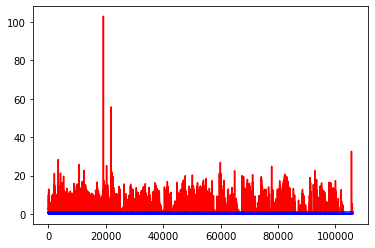

white ratio : 52.0
min : 177
max : 228


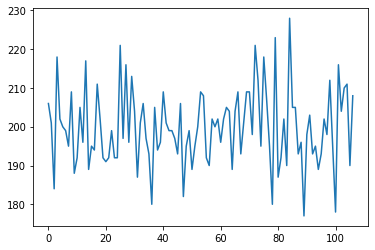

Generating interpolations...
106001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000496, 0.001040]
106002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000931, 0.007935]
106003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000865, 0.004102]
106004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.011895, 0.013918]
106005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000050]
106006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284985, 0.196652]
106007 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.002172, 0.049110]
106008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001830, 0.044222]
106009 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009839, 0.000117]
106010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005341, 0.043620]
106011 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000408, 0.000199]
106012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001873, 0.002126]
106013 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000001, 0.000002]
106014 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0

106120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000605, 0.000672]
106121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.079507, 0.086357]
106122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017236, 0.007845]
106123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002125, 0.000951]
106124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000081, 0.009379]
106125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.000007]
106126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000482, 0.000372]
106127 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.053539, 0.037914]
106128 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.005225, 0.000468]
106129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000164]
106130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000758, 0.009647]
106131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001515, 0.011721]
106132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001819, 0.000031]
106133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005384, 0.111977]
106134 [D loss: 0.00

106240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010341, 0.002202]
106241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.255645, 0.026298]
106242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000057, 0.052630]
106243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.189367, 0.013738]
106244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.123074, 0.007948]
106245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.002955]
106246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003386, 0.027863]
106247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000002]
106248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049248, 0.157645]
106249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001264, 0.000447]
106250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023529, 0.020022]
106251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000026, 0.000001]
106252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012659, 0.000477]
106253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003512, 0.000366]
106254 [D loss: 0.00

106360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001707, 0.000025]
106361 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000010, 0.000034]
106362 [D loss: 0.000392, acc.: 100.00%] [G loss: 0.000015, 0.000002]
106363 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000231, 0.000054]
106364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.050887, 0.000089]
106365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.136645, 0.000042]
106366 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000011, 0.000002]
106367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000242, 0.000049]
106368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000019, 0.000040]
106369 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000203, 0.000437]
106370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000038, 0.000212]
106371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000022, 0.000006]
106372 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
106373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004862, 0.008086]
106374 [D loss: 0.00

106480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
106481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.012122, 0.087984]
106482 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.001044, 0.085310]
106483 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.156355, 0.001145]
106484 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000113, 0.000116]
106485 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.015786, 0.001023]
106486 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000713, 0.006601]
106487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001266, 0.002522]
106488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000060, 0.000009]
106489 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.011383, 0.052192]
106490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007883, 0.000000]
106491 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.011317, 0.000441]
106492 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004870, 0.000693]
106493 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000017, 0.000523]
106494 [D loss: 0.00

106598 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.388253, 0.561551]
106599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.109879, 0.303608]
106600 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.257514, 0.439807]
106601 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.178186, 0.254812]
106602 [D loss: 0.001508, acc.: 100.00%] [G loss: 0.075633, 0.113701]
106603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.055243, 0.000727]
106604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.057043, 0.111693]
106605 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.103444, 0.120807]
106606 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.017211, 0.008535]
106607 [D loss: 0.066727, acc.: 96.88%] [G loss: 45.922401, 6.169119]
106608 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.155269, 11.177574]
106609 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.484984, 12.263733]
106610 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.875740, 12.712301]
106611 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.199392, 9.598356]
106612 [D los

106717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.099841, 0.074326]
106718 [D loss: 0.000299, acc.: 100.00%] [G loss: 0.141540, 0.015417]
106719 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.000136, 0.008669]
106720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.046736, 0.033487]
106721 [D loss: 0.000088, acc.: 100.00%] [G loss: 1.352655, 1.524766]
106722 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.031945, 0.056904]
106723 [D loss: 0.003929, acc.: 100.00%] [G loss: 0.431295, 0.588545]
106724 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000859, 0.036854]
106725 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001001, 0.143155]
106726 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.068015, 0.272478]
106727 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.837678, 0.585721]
106728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002101, 0.000446]
106729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000164, 0.000013]
106730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.094501, 0.007367]
106731 [D loss: 0.00

106836 [D loss: 0.000255, acc.: 100.00%] [G loss: 0.087654, 0.159644]
106837 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.062931, 0.182620]
106838 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.061243, 0.138722]
106839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.022773, 0.052648]
106840 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000005, 0.000001]
106841 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.002004, 0.000743]
106842 [D loss: 0.035431, acc.: 96.88%] [G loss: 0.000042, 0.008582]
106843 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.496530, 2.132823]
106844 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.342887, 2.969784]
106845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.174284, 0.045419]
106846 [D loss: 0.000610, acc.: 100.00%] [G loss: 0.322078, 0.085636]
106847 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.523155, 1.812441]
106848 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.029069, 0.000280]
106849 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000327, 0.000813]
106850 [D loss: 0.000

106954 [D loss: 0.000424, acc.: 100.00%] [G loss: 0.000311, 0.000060]
106955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002373, 0.002553]
106956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.072374, 0.001663]
106957 [D loss: 0.002240, acc.: 100.00%] [G loss: 0.000011, 0.000206]
106958 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000086, 0.000068]
106959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000209, 0.088367]
106960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003128, 0.031608]
106961 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.000031, 0.000069]
106962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000147, 0.000399]
106963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000000]
106964 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000110, 0.000013]
106965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000702, 0.000253]
106966 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000237, 0.000044]
106967 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.006720, 0.000123]
106968 [D loss: 0.00

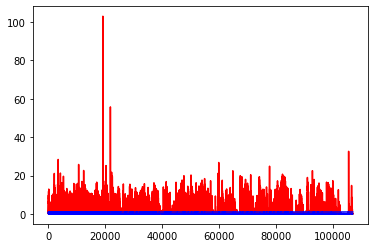

white ratio : 51.0
min : 177
max : 228


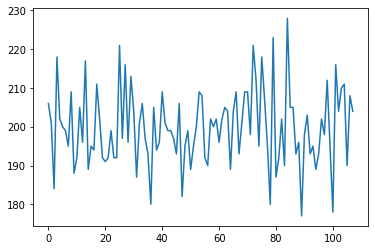

Generating interpolations...
107001 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000040, 0.000018]
107002 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.000000, 0.000001]
107003 [D loss: 0.001545, acc.: 100.00%] [G loss: 0.000010, 0.000008]
107004 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000011, 0.000021]
107005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000019, 0.000254]
107006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001033, 0.000009]
107007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000010]
107008 [D loss: 0.001073, acc.: 100.00%] [G loss: 0.000027, 0.000022]
107009 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.000006, 0.000187]
107010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000137, 0.002475]
107011 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000000, 0.000004]
107012 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000020, 0.000000]
107013 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000006, 0.000020]
107014 [D loss: 0.054806, acc.: 96.88%] [G loss: 0.000000, 0.

107121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000013, 0.000000]
107122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000013, 0.000007]
107123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000002]
107124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000005, 0.000039]
107125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.000057]
107126 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000000]
107128 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000005, 0.000000]
107129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000003]
107130 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000003, 0.000000]
107131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
107132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107133 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000010, 0.000002]
107134 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000001, 0.000034]
107135 [D loss: 0.00

107239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000342, 0.018216]
107240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.052712, 0.226419]
107241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.440300, 0.004725]
107242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.028677, 0.012405]
107243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.488311, 0.256798]
107244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.107230, 0.074585]
107245 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.122451, 0.100604]
107246 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001763, 0.010872]
107247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001366, 0.007995]
107248 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.342836, 0.056309]
107249 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000091, 0.000381]
107250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000203, 0.005501]
107251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006372, 0.003156]
107252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.672505, 0.184758]
107253 [D loss: 0.00

107359 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000859, 0.000330]
107360 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000018, 0.000522]
107361 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001237, 0.001293]
107362 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.001794, 0.000085]
107363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001849, 0.000700]
107364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000015]
107365 [D loss: 0.001448, acc.: 100.00%] [G loss: 0.000001, 0.000048]
107366 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.018701, 0.064547]
107367 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001147, 0.000010]
107368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000034]
107369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001492, 0.000019]
107370 [D loss: 0.005110, acc.: 100.00%] [G loss: 0.000003, 0.000011]
107371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000390, 0.000202]
107372 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000005, 0.000014]
107373 [D loss: 0.00

107480 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003350, 0.072145]
107481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
107482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
107483 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000008, 0.000004]
107484 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.007949, 0.001019]
107485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000014, 0.000001]
107486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000017, 0.000001]
107487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000197, 0.000290]
107488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000332, 0.001340]
107489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000090, 0.000011]
107490 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000034, 0.000000]
107491 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000089, 0.000203]
107492 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.010662, 0.121117]
107493 [D loss: 0.011147, acc.: 100.00%] [G loss: 0.000018, 0.000019]
107494 [D loss: 0.00

107599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000971, 0.000078]
107600 [D loss: 0.001845, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000003]
107602 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107603 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
107605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.007942]
107606 [D loss: 0.000161, acc.: 100.00%] [G loss: 0.000004, 0.000049]
107607 [D loss: 0.000626, acc.: 100.00%] [G loss: 0.000051, 0.000029]
107608 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000019, 0.000028]
107609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107610 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000005, 0.000001]
107611 [D loss: 0.002929, acc.: 100.00%] [G loss: 0.000101, 0.000054]
107612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000117]
107613 [D loss: 0.00

107717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.030736, 0.027381]
107718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000098, 0.001513]
107719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015766, 0.000368]
107720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001642, 0.050693]
107721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002304, 0.004799]
107722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.103074, 0.053236]
107723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000068, 0.002613]
107724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.123129, 0.066401]
107725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006535, 0.000476]
107726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008049, 0.003934]
107727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011803, 0.072364]
107728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000117, 0.000016]
107729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000177, 0.060141]
107730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.065875, 0.001405]
107731 [D loss: 0.00

107835 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107836 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107838 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000000]
107839 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000002]
107840 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000020, 0.000000]
107843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107844 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107845 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107846 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107847 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107849 [D loss: 0.00

107953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000005]
107954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
107955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107958 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107959 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000001, 0.000022]
107960 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107961 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107962 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000015, 0.000186]
107963 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107964 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000001, 0.000001]
107965 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
107966 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000007]
107967 [D loss: 0.00

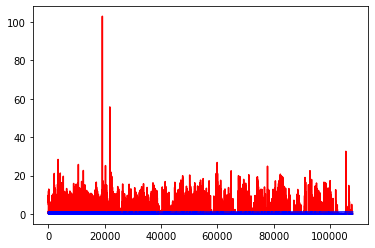

white ratio : 55.25
min : 177
max : 228


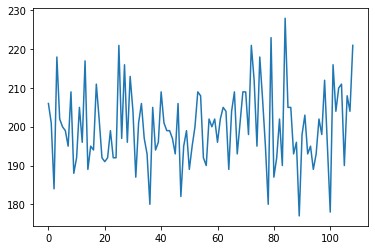

Generating interpolations...
108001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000014]
108002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000009]
108003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000001]
108004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108007 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000116]
108008 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000010, 0.000000]
108009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108010 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000034, 0.000000]
108011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108012 [D loss: 0.008932, acc.: 100.00%] [G loss: 0.000002, 0.000000]
108013 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000001]
108014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0

108119 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000596, 0.000000]
108121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108122 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108123 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000005, 0.000000]
108124 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000004, 0.000000]
108125 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108127 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000023, 0.000000]
108128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
108129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000001]
108130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.000000]
108131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108132 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108133 [D loss: 0.00

108239 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000002]
108240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
108242 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000001, 0.000000]
108243 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000009, 0.000000]
108244 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000003, 0.000000]
108245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000064, 0.000000]
108247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108248 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108250 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108251 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108253 [D loss: 0.00

108358 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108359 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108360 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108361 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108362 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108363 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108364 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108365 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108367 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108368 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108369 [D loss: 0.001253, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108370 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108371 [D loss: 0.000298, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108372 [D loss: 0.00

108479 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108482 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108485 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108486 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108487 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
108489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108490 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108491 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108492 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108493 [D loss: 0.00

108600 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108605 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000203]
108606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108607 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108608 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108610 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108611 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108612 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108613 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108614 [D loss: 0.00

108718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000006]
108723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
108724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108726 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000001]
108727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
108731 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000002, 0.000000]
108732 [D loss: 0.00

108837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108838 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000002]
108839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000008, 0.000035]
108840 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000069, 0.000000]
108841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000002]
108842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
108845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000048]
108846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000318, 0.000000]
108848 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000005, 0.000027]
108849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000000]
108851 [D loss: 0.00

108955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108956 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000003, 0.000000]
108957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
108958 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108959 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108961 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108962 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108965 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
108968 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
108969 [D loss: 0.00

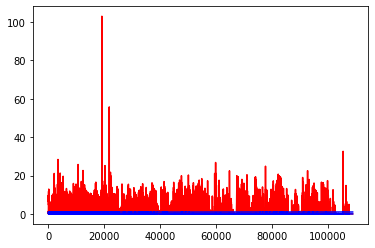

white ratio : 50.75
min : 177
max : 228


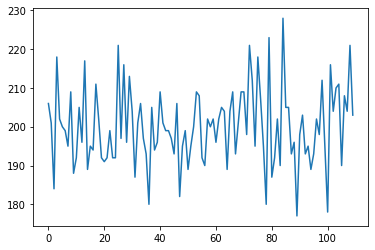

Generating interpolations...
109001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000019]
109004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109005 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000001]
109006 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000006]
109008 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000001, 0.000009]
109009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000011]
109010 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
109011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109012 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0

109120 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
109123 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000003, 0.000000]
109124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000977, 0.000004]
109125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
109126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000000]
109127 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000009, 0.017709]
109129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109130 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109132 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000000]
109133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000016]
109134 [D loss: 0.00

109239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
109240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109242 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109243 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000005]
109244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
109245 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000032, 0.000000]
109247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
109248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
109250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
109251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000005]
109252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
109253 [D loss: 0.00

109357 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.050717]
109358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000147, 0.000018]
109359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000056]
109360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000024, 0.001555]
109361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000045, 0.000009]
109362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000037, 0.000010]
109363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001112, 0.003473]
109364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000353, 0.000031]
109365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000079]
109366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000973, 0.000000]
109367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002726, 0.000001]
109368 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000001, 0.000000]
109369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003123, 0.001030]
109370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000011]
109371 [D loss: 0.00

109478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.083889, 0.028059]
109479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032063, 0.068122]
109480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.029487, 0.159582]
109481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.029392, 0.015463]
109482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.117531, 0.130426]
109483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003522, 0.279585]
109484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.061097, 0.374732]
109485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.206583, 0.000345]
109486 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.003300, 0.001536]
109487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017185, 0.110606]
109488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.180131, 0.017312]
109489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014676, 0.031637]
109490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015943, 0.281637]
109491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001036, 0.001407]
109492 [D loss: 0.00

109598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.239820, 0.033688]
109599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021305, 0.000046]
109600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015837, 0.101512]
109601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.133679, 0.023401]
109602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.169689, 0.050598]
109603 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.078824, 0.045210]
109604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.028854, 0.002458]
109605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.016690, 0.211806]
109606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021899, 0.000926]
109607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033973, 0.053021]
109608 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.026823, 0.000996]
109609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.080693, 0.156087]
109610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.134905, 0.203936]
109611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.207431, 0.119548]
109612 [D loss: 0.00

109717 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.254497, 0.531729]
109718 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.126044, 0.132820]
109719 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.011417, 0.315399]
109720 [D loss: 0.006163, acc.: 100.00%] [G loss: 0.650581, 0.505752]
109721 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.995239, 0.543469]
109722 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.778007, 0.853951]
109723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.905900, 0.309827]
109724 [D loss: 0.000930, acc.: 100.00%] [G loss: 1.510449, 0.382099]
109725 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.748850, 0.440019]
109726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.262552, 0.161007]
109727 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.216223, 0.008443]
109728 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.743762, 0.561084]
109729 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.331547, 0.092209]
109730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.316651, 0.169923]
109731 [D loss: 0.00

109837 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.558280, 1.160092]
109838 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.588898, 0.744914]
109839 [D loss: 0.000066, acc.: 100.00%] [G loss: 2.271033, 2.506088]
109840 [D loss: 0.000020, acc.: 100.00%] [G loss: 5.495359, 5.922778]
109841 [D loss: 0.027482, acc.: 96.88%] [G loss: 5.846783, 4.902442]
109842 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.285832, 3.186018]
109843 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.062919, 2.801531]
109844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.794912, 1.505429]
109845 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.434952, 2.126884]
109846 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.744366, 4.828742]
109847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.570129, 0.152130]
109848 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.019801, 1.256964]
109849 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.392075, 1.596542]
109850 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.808547, 1.585327]
109851 [D loss: 0.00

109956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.599272, 0.016804]
109957 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.001688, 1.696541]
109958 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.255684, 0.410881]
109959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.254475, 0.000345]
109960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.789748, 0.716471]
109961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.192784, 0.772072]
109962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.171635, 0.104351]
109963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.234879, 0.026943]
109964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.106632, 1.565656]
109965 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.410390, 0.512364]
109966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.985622, 1.241262]
109967 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.150604, 0.348292]
109968 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.705229, 0.956626]
109969 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.820106, 1.293247]
109970 [D loss: 0.00

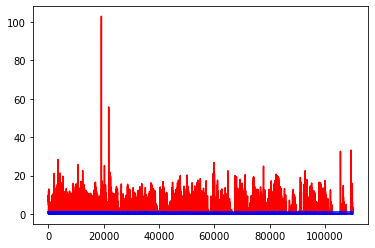

white ratio : 51.0
min : 177
max : 228


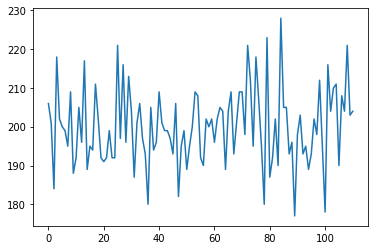

Generating interpolations...
110001 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.350238, 0.010714]
110002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025807, 0.374411]
110003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.209675, 0.683615]
110004 [D loss: 0.000970, acc.: 100.00%] [G loss: 0.056144, 0.098306]
110005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.157981, 0.330069]
110006 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.664576, 0.234515]
110007 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.141916, 0.517234]
110008 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.554914, 0.735692]
110009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.973980, 0.865389]
110010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.162699, 0.526886]
110011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.520945, 0.064040]
110012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.089566, 0.409448]
110013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.845587, 0.677520]
110014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.286122, 0

110116 [D loss: 0.000081, acc.: 100.00%] [G loss: 15.364336, 1.278245]
110117 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.896600, 3.135059]
110118 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.532663, 1.364380]
110119 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.621889, 1.038389]
110120 [D loss: 0.008646, acc.: 100.00%] [G loss: 3.597419, 3.207577]
110121 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.989860, 1.134706]
110122 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.452049, 1.571767]
110123 [D loss: 0.002331, acc.: 100.00%] [G loss: 0.239281, 0.283844]
110124 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.541530, 0.101008]
110125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.654396, 0.047487]
110126 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.697777, 0.921438]
110127 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.843029, 1.575320]
110128 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.302231, 0.494078]
110129 [D loss: 0.000092, acc.: 100.00%] [G loss: 1.587300, 1.043122]
110130 [D loss: 0.0

110236 [D loss: 0.000821, acc.: 100.00%] [G loss: 0.797834, 0.910989]
110237 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.007668, 0.073446]
110238 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.280379, 0.090184]
110239 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.061361, 0.007116]
110240 [D loss: 0.000009, acc.: 100.00%] [G loss: 79.149780, 9.957010]
110241 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.761012, 15.532666]
110242 [D loss: 0.001375, acc.: 100.00%] [G loss: 11.902555, 7.536551]
110243 [D loss: 0.000019, acc.: 100.00%] [G loss: 7.159098, 8.207274]
110244 [D loss: 0.000035, acc.: 100.00%] [G loss: 9.759545, 9.546803]
110245 [D loss: 0.000061, acc.: 100.00%] [G loss: 9.012876, 8.413024]
110246 [D loss: 0.000030, acc.: 100.00%] [G loss: 7.681342, 6.201476]
110247 [D loss: 0.005794, acc.: 100.00%] [G loss: 8.428492, 9.580399]
110248 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.607763, 7.090903]
110249 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.401404, 3.868210]
110250 [D loss: 

110354 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.089123, 1.150549]
110355 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.409019, 3.332935]
110356 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.715040, 0.662569]
110357 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.252031, 0.150350]
110358 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.952090, 0.869740]
110359 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.219741, 0.417689]
110360 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.415255, 0.797803]
110361 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.526296, 0.667795]
110362 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.080081, 1.209422]
110363 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.031535, 0.001651]
110364 [D loss: 0.000027, acc.: 100.00%] [G loss: 1.034755, 1.033144]
110365 [D loss: 0.000277, acc.: 100.00%] [G loss: 0.056366, 0.019406]
110366 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.282826, 0.465516]
110367 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.245912, 0.791830]
110368 [D loss: 0.00

110473 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.024839, 13.275307]
110474 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.541857, 9.612988]
110475 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.444489, 13.547840]
110476 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.291843, 10.195523]
110477 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.222608, 5.211539]
110478 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.512079, 3.439095]
110479 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.691170, 5.561760]
110480 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.636188, 4.649030]
110481 [D loss: 0.000034, acc.: 100.00%] [G loss: 6.410914, 5.167480]
110482 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.999731, 5.304549]
110483 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.421686, 1.979820]
110484 [D loss: 0.000003, acc.: 100.00%] [G loss: 15.127977, 13.594378]
110485 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.977957, 15.551240]
110486 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.942984, 10.878736]
110487 [

110590 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.591752, 10.510096]
110591 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.375197, 8.599663]
110592 [D loss: 0.180190, acc.: 96.88%] [G loss: 4.548920, 5.209867]
110593 [D loss: 0.000684, acc.: 100.00%] [G loss: 0.917933, 1.973845]
110594 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.487113, 3.284142]
110595 [D loss: 0.000686, acc.: 100.00%] [G loss: 3.741088, 3.524945]
110596 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.327282, 2.182201]
110597 [D loss: 0.001362, acc.: 100.00%] [G loss: 3.434309, 4.315463]
110598 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.429299, 0.501446]
110599 [D loss: 0.000088, acc.: 100.00%] [G loss: 2.754056, 3.432126]
110600 [D loss: 0.000086, acc.: 100.00%] [G loss: 4.126726, 2.554867]
110601 [D loss: 0.006696, acc.: 100.00%] [G loss: 1.874959, 2.401837]
110602 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.496446, 0.197959]
110603 [D loss: 0.001053, acc.: 100.00%] [G loss: 1.638191, 0.658372]
110604 [D loss: 0.00

110710 [D loss: 0.000093, acc.: 100.00%] [G loss: 7.853593, 5.165648]
110711 [D loss: 0.000022, acc.: 100.00%] [G loss: 17.257729, 14.947531]
110712 [D loss: 0.000202, acc.: 100.00%] [G loss: 42.447132, 7.585148]
110713 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.883804, 9.100293]
110714 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.852892, 12.249983]
110715 [D loss: 0.000801, acc.: 100.00%] [G loss: 6.038577, 3.797735]
110716 [D loss: 0.000024, acc.: 100.00%] [G loss: 10.486023, 8.829920]
110717 [D loss: 0.000064, acc.: 100.00%] [G loss: 40.182098, 7.920514]
110718 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.047746, 7.755382]
110719 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.679465, 9.547766]
110720 [D loss: 0.000440, acc.: 100.00%] [G loss: 3.039775, 1.993814]
110721 [D loss: 0.000359, acc.: 100.00%] [G loss: 8.248856, 8.161932]
110722 [D loss: 0.000185, acc.: 100.00%] [G loss: 9.458460, 8.103687]
110723 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.952838, 0.812933]
110724 [D lo

110830 [D loss: 0.001123, acc.: 100.00%] [G loss: 1.986250, 1.072244]
110831 [D loss: 0.003313, acc.: 100.00%] [G loss: 0.758207, 0.000002]
110832 [D loss: 0.001242, acc.: 100.00%] [G loss: 3.560730, 3.024062]
110833 [D loss: 0.005079, acc.: 100.00%] [G loss: 1.770494, 1.453638]
110834 [D loss: 0.001505, acc.: 100.00%] [G loss: 2.519635, 2.951279]
110835 [D loss: 0.001582, acc.: 100.00%] [G loss: 0.000031, 0.000113]
110836 [D loss: 0.034165, acc.: 96.88%] [G loss: 9.715083, 1.905013]
110837 [D loss: 0.000012, acc.: 100.00%] [G loss: 11.006121, 10.818400]
110838 [D loss: 0.000006, acc.: 100.00%] [G loss: 13.279542, 13.402647]
110839 [D loss: 0.000681, acc.: 100.00%] [G loss: 10.280315, 11.129564]
110840 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.618131, 7.674828]
110841 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.612199, 7.840964]
110842 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.297171, 8.753186]
110843 [D loss: 0.000088, acc.: 100.00%] [G loss: 7.919564, 7.243597]
110844 [D loss:

110947 [D loss: 0.000027, acc.: 100.00%] [G loss: 1.794492, 2.696343]
110948 [D loss: 0.000031, acc.: 100.00%] [G loss: 4.930424, 4.771728]
110949 [D loss: 0.000449, acc.: 100.00%] [G loss: 3.686687, 2.454374]
110950 [D loss: 0.001713, acc.: 100.00%] [G loss: 2.587727, 3.094661]
110951 [D loss: 0.000104, acc.: 100.00%] [G loss: 11.481424, 2.971194]
110952 [D loss: 0.000491, acc.: 100.00%] [G loss: 4.081921, 2.750108]
110953 [D loss: 0.000528, acc.: 100.00%] [G loss: 0.209586, 0.374411]
110954 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.036115, 0.143065]
110955 [D loss: 0.000312, acc.: 100.00%] [G loss: 2.542493, 2.610858]
110956 [D loss: 0.000058, acc.: 100.00%] [G loss: 8.571334, 0.161341]
110957 [D loss: 0.000397, acc.: 100.00%] [G loss: 7.512248, 6.852468]
110958 [D loss: 0.000679, acc.: 100.00%] [G loss: 0.088680, 0.006535]
110959 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.905392, 0.562735]
110960 [D loss: 0.007761, acc.: 100.00%] [G loss: 0.207948, 0.029420]
110961 [D loss: 0.0

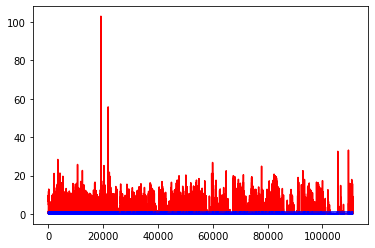

white ratio : 50.75
min : 177
max : 228


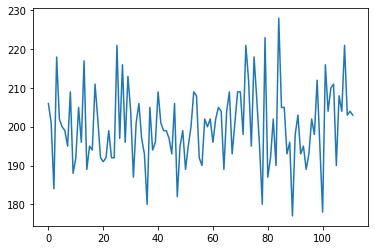

Generating interpolations...
111001 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.830622, 0.671027]
111002 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.772727, 0.167826]
111003 [D loss: 0.000422, acc.: 100.00%] [G loss: 2.152871, 2.384593]
111004 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.231089, 0.588028]
111005 [D loss: 0.001506, acc.: 100.00%] [G loss: 0.609487, 0.858212]
111006 [D loss: 0.063310, acc.: 96.88%] [G loss: 0.020381, 0.027702]
111007 [D loss: 0.001011, acc.: 100.00%] [G loss: 0.004490, 0.015936]
111008 [D loss: 0.000923, acc.: 100.00%] [G loss: 2.605597, 2.572169]
111009 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.013055, 0.004394]
111010 [D loss: 0.000187, acc.: 100.00%] [G loss: 3.237477, 2.098484]
111011 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.176584, 0.003546]
111012 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.015174, 0.016968]
111013 [D loss: 0.001348, acc.: 100.00%] [G loss: 21.899958, 4.491853]
111014 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.259001, 

111121 [D loss: 0.001655, acc.: 100.00%] [G loss: 0.072836, 0.040963]
111122 [D loss: 0.000335, acc.: 100.00%] [G loss: 2.838298, 0.045461]
111123 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.164828, 2.510694]
111124 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.306216, 0.243043]
111125 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.251577, 0.271129]
111126 [D loss: 0.000151, acc.: 100.00%] [G loss: 1.106442, 0.606578]
111127 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.965321, 1.880521]
111128 [D loss: 0.000053, acc.: 100.00%] [G loss: 4.264387, 4.108202]
111129 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.294156, 0.442607]
111130 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.069233, 0.005565]
111131 [D loss: 0.000100, acc.: 100.00%] [G loss: 2.159697, 2.427568]
111132 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.305705, 0.275616]
111133 [D loss: 0.002952, acc.: 100.00%] [G loss: 0.138127, 0.145301]
111134 [D loss: 0.000531, acc.: 100.00%] [G loss: 0.147613, 0.139430]
111135 [D loss: 0.00

111242 [D loss: 0.000053, acc.: 100.00%] [G loss: 8.716209, 9.267210]
111243 [D loss: 0.000008, acc.: 100.00%] [G loss: 8.600381, 8.655628]
111244 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.736139, 1.075827]
111245 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.217922, 0.405971]
111246 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.675455, 8.858971]
111247 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.465083, 3.774608]
111248 [D loss: 0.000654, acc.: 100.00%] [G loss: 2.282038, 1.469126]
111249 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.100944, 4.009733]
111250 [D loss: 0.000286, acc.: 100.00%] [G loss: 3.684856, 3.880203]
111251 [D loss: 0.000028, acc.: 100.00%] [G loss: 4.515732, 3.644666]
111252 [D loss: 0.000121, acc.: 100.00%] [G loss: 3.858534, 3.303279]
111253 [D loss: 0.000021, acc.: 100.00%] [G loss: 2.878345, 2.072241]
111254 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.034811, 0.000289]
111255 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000643, 0.007718]
111256 [D loss: 0.00

111360 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.916027, 3.009308]
111361 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.012684, 0.000114]
111362 [D loss: 0.000020, acc.: 100.00%] [G loss: 3.294135, 3.800123]
111363 [D loss: 0.000097, acc.: 100.00%] [G loss: 5.872498, 5.941648]
111364 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.026533, 0.803133]
111365 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000027, 0.000002]
111366 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.057557, 0.001774]
111367 [D loss: 0.001102, acc.: 100.00%] [G loss: 0.000435, 0.000047]
111368 [D loss: 0.000436, acc.: 100.00%] [G loss: 3.348824, 3.347048]
111369 [D loss: 0.000051, acc.: 100.00%] [G loss: 1.254107, 1.201094]
111370 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000223, 0.000703]
111371 [D loss: 0.000020, acc.: 100.00%] [G loss: 4.519701, 2.099110]
111372 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.454851, 3.474901]
111373 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000548, 0.000174]
111374 [D loss: 0.00

111477 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000200, 0.002226]
111478 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.900447, 3.219321]
111479 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.388470, 3.869066]
111480 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.127612, 0.000470]
111481 [D loss: 0.000068, acc.: 100.00%] [G loss: 4.791891, 5.249434]
111482 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000657, 0.009454]
111483 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.330429, 1.183382]
111484 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.000305, 0.000491]
111485 [D loss: 0.000342, acc.: 100.00%] [G loss: 0.000219, 0.014245]
111486 [D loss: 0.001558, acc.: 100.00%] [G loss: 0.899812, 0.470747]
111487 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000875, 0.000134]
111488 [D loss: 0.000018, acc.: 100.00%] [G loss: 27.966682, 12.742661]
111489 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.243786, 12.559846]
111490 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.485594, 10.807185]
111491 [D loss

111597 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.243224, 0.000084]
111598 [D loss: 0.000018, acc.: 100.00%] [G loss: 7.854502, 7.724284]
111599 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000091, 0.000024]
111600 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000026, 0.000012]
111601 [D loss: 0.003975, acc.: 100.00%] [G loss: 0.000002, 0.000012]
111602 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.095318, 7.069788]
111603 [D loss: 0.000150, acc.: 100.00%] [G loss: 42.700867, 14.740965]
111604 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.672943, 17.447828]
111605 [D loss: 0.000506, acc.: 100.00%] [G loss: 19.703526, 19.517616]
111606 [D loss: 0.027319, acc.: 96.88%] [G loss: 17.263729, 16.976738]
111607 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.113148, 17.017735]
111608 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.268085, 16.559587]
111609 [D loss: 0.000032, acc.: 100.00%] [G loss: 13.368000, 15.382305]
111610 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.532150, 10.091894]
111611

111716 [D loss: 0.008452, acc.: 100.00%] [G loss: 0.634970, 0.425122]
111717 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.474677, 0.400150]
111718 [D loss: 0.033735, acc.: 96.88%] [G loss: 0.000018, 0.001130]
111719 [D loss: 0.004692, acc.: 100.00%] [G loss: 4.748360, 2.600070]
111720 [D loss: 0.001510, acc.: 100.00%] [G loss: 4.205846, 6.728116]
111721 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.977005, 12.063709]
111722 [D loss: 0.016042, acc.: 100.00%] [G loss: 5.910007, 4.617131]
111723 [D loss: 0.000047, acc.: 100.00%] [G loss: 3.903931, 2.209885]
111724 [D loss: 0.000898, acc.: 100.00%] [G loss: 6.978069, 5.594794]
111725 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.080743, 1.427581]
111726 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.059314, 4.797442]
111727 [D loss: 0.000032, acc.: 100.00%] [G loss: 3.219967, 2.107871]
111728 [D loss: 0.072781, acc.: 93.75%] [G loss: 5.282780, 3.911036]
111729 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.550364, 0.200859]
111730 [D loss: 0.000

111835 [D loss: 0.008036, acc.: 100.00%] [G loss: 1.445148, 0.269754]
111836 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.873676, 10.102984]
111837 [D loss: 0.051468, acc.: 96.88%] [G loss: 5.921597, 3.839850]
111838 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.820992, 4.884155]
111839 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.478857, 1.618631]
111840 [D loss: 0.003320, acc.: 100.00%] [G loss: 1.488275, 1.503007]
111841 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.202908, 1.390616]
111842 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.578263, 2.289855]
111843 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.318438, 3.455648]
111844 [D loss: 0.000262, acc.: 100.00%] [G loss: 32.359550, 1.173658]
111845 [D loss: 0.000570, acc.: 100.00%] [G loss: 5.836671, 6.015806]
111846 [D loss: 0.000025, acc.: 100.00%] [G loss: 4.032106, 3.239581]
111847 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.416219, 0.334326]
111848 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.702251, 0.607515]
111849 [D loss: 0.

111954 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.015708, 0.000323]
111955 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000332, 0.000860]
111956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.117952, 0.012895]
111957 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.000000, 0.000001]
111958 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.960754, 0.507476]
111959 [D loss: 0.014505, acc.: 100.00%] [G loss: 0.002128, 0.000003]
111960 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.000020, 0.000211]
111961 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.000761, 0.001975]
111962 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.918068, 0.004569]
111963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.633478, 0.181961]
111964 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.130189, 0.028767]
111965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.053190, 0.011179]
111966 [D loss: 0.002285, acc.: 100.00%] [G loss: 0.000153, 0.014770]
111967 [D loss: 0.020274, acc.: 100.00%] [G loss: 5.068526, 0.031557]
111968 [D loss: 0.00

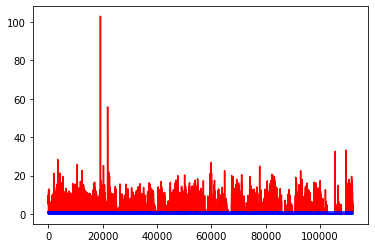

white ratio : 53.0
min : 177
max : 228


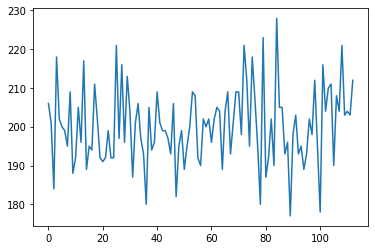

Generating interpolations...
112001 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.787021, 0.397614]
112002 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.804242, 2.108401]
112003 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.812157, 0.434155]
112004 [D loss: 0.110702, acc.: 96.88%] [G loss: 0.012519, 0.000197]
112005 [D loss: 0.000991, acc.: 100.00%] [G loss: 0.235673, 0.343736]
112006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.018195, 0.002809]
112007 [D loss: 0.017854, acc.: 100.00%] [G loss: 0.002897, 0.001281]
112008 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.038678, 0.461969]
112009 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.000013, 0.000091]
112010 [D loss: 0.001626, acc.: 100.00%] [G loss: 0.983407, 0.391010]
112011 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.117229, 0.444751]
112012 [D loss: 0.001179, acc.: 100.00%] [G loss: 0.014674, 0.003674]
112013 [D loss: 0.000914, acc.: 100.00%] [G loss: 1.296340, 0.817252]
112014 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.210244, 0.

112118 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.719003, 0.689313]
112119 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.481922, 0.650147]
112120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036066, 0.007097]
112121 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.281248, 0.645490]
112122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.610174, 0.600037]
112123 [D loss: 0.000657, acc.: 100.00%] [G loss: 0.492326, 0.502397]
112124 [D loss: 0.002435, acc.: 100.00%] [G loss: 0.165650, 0.518963]
112125 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.491041, 0.265427]
112126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.132828, 0.488904]
112127 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000275, 0.002959]
112128 [D loss: 0.000241, acc.: 100.00%] [G loss: 0.143993, 0.182620]
112129 [D loss: 0.006965, acc.: 100.00%] [G loss: 0.128737, 0.463989]
112130 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.088179, 0.180656]
112131 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000378, 0.000377]
112132 [D loss: 0.00

112237 [D loss: 0.003835, acc.: 100.00%] [G loss: 0.933804, 1.403450]
112238 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.938965, 0.639085]
112239 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.670230, 4.279202]
112240 [D loss: 0.002366, acc.: 100.00%] [G loss: 0.821474, 1.162112]
112241 [D loss: 0.001848, acc.: 100.00%] [G loss: 9.580690, 1.795475]
112242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.740774, 0.583396]
112243 [D loss: 0.000866, acc.: 100.00%] [G loss: 0.000044, 0.110540]
112244 [D loss: 0.026950, acc.: 96.88%] [G loss: 0.000290, 0.000067]
112245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.958872, 0.581270]
112246 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000448, 0.000152]
112247 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.018712, 0.005452]
112248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.953170, 1.160813]
112249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.441603, 0.125487]
112250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.182913, 0.320412]
112251 [D loss: 0.000

112357 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.020937, 0.204898]
112358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.214932, 0.007253]
112359 [D loss: 0.000244, acc.: 100.00%] [G loss: 2.728340, 0.124274]
112360 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.027171, 0.052389]
112361 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.000245, 0.000867]
112362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.456243, 0.034706]
112363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000411, 0.003884]
112364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013184, 0.024719]
112365 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.325996, 0.214716]
112366 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.109658, 0.177468]
112367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.370571, 1.149595]
112368 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004518, 0.031206]
112369 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.041984, 0.289159]
112370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.417545, 0.248909]
112371 [D loss: 0.00

112475 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011256, 0.007017]
112476 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.002473, 0.000072]
112477 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.057070, 0.584088]
112478 [D loss: 0.004421, acc.: 100.00%] [G loss: 1.608333, 0.076969]
112479 [D loss: 0.001249, acc.: 100.00%] [G loss: 0.172451, 0.359096]
112480 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.534123, 1.136957]
112481 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.889106, 0.322008]
112482 [D loss: 0.000980, acc.: 100.00%] [G loss: 0.026959, 0.067851]
112483 [D loss: 0.027733, acc.: 96.88%] [G loss: 0.077273, 0.046067]
112484 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.212328, 0.000000]
112485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002243, 0.000051]
112486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000047, 0.000205]
112487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004373, 0.009462]
112488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002605, 0.002201]
112489 [D loss: 0.000

112593 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.075800, 0.141570]
112594 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.253246, 0.731046]
112595 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.118972, 0.230242]
112596 [D loss: 0.000256, acc.: 100.00%] [G loss: 0.441305, 1.093422]
112597 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.040211, 0.178839]
112598 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001199, 0.023491]
112599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.280058, 0.086563]
112600 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.187361, 0.230046]
112601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003973, 0.123446]
112602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.869173, 0.466157]
112603 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.349522, 0.815350]
112604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284074, 0.350969]
112605 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.041188, 1.296738]
112606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.370837, 0.137110]
112607 [D loss: 0.00

112714 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000019, 0.000006]
112715 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.007889, 0.001558]
112716 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000040]
112717 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000100, 0.000108]
112718 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.038984, 0.503743]
112719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000227, 0.000347]
112720 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000253, 0.000158]
112721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.297173, 0.178166]
112722 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000038, 0.000107]
112723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000479, 0.000006]
112724 [D loss: 0.001629, acc.: 100.00%] [G loss: 0.009932, 0.000033]
112725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000388, 0.000075]
112726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000031, 0.000056]
112727 [D loss: 0.014235, acc.: 100.00%] [G loss: 0.000012, 0.000011]
112728 [D loss: 0.00

112832 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112833 [D loss: 0.000593, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112834 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112835 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112836 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112837 [D loss: 0.001467, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112838 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112839 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000001, 0.020234]
112840 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112841 [D loss: 0.000497, acc.: 100.00%] [G loss: 0.000001, 0.000000]
112842 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
112844 [D loss: 0.017829, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112845 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
112846 [D loss: 0.00

112950 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000019, 0.005415]
112951 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000128, 0.000003]
112952 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.000013]
112953 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.007176]
112954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000085, 0.000015]
112955 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000001, 0.000002]
112956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000709, 0.000035]
112957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005593, 0.000133]
112958 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000052, 0.000003]
112959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000054]
112960 [D loss: 0.015652, acc.: 100.00%] [G loss: 0.003916, 0.043620]
112961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000005]
112962 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.000005, 0.000156]
112963 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002400, 0.000038]
112964 [D loss: 0.00

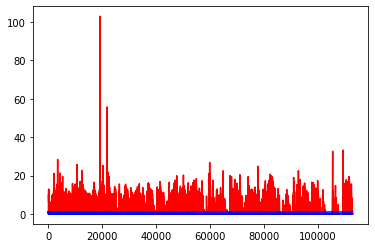

white ratio : 49.25
min : 177
max : 228


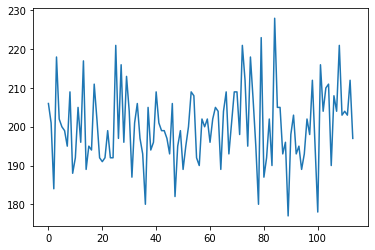

Generating interpolations...
113001 [D loss: 0.000940, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113002 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113003 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000000, 0.000019]
113004 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113005 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000008, 0.000011]
113006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000095]
113007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000096, 0.000191]
113008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
113009 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000009, 0.000000]
113010 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000009]
113011 [D loss: 0.000384, acc.: 100.00%] [G loss: 0.000002, 0.000000]
113012 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.224697, 0.205198]
113013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113014 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.001156, 0

113119 [D loss: 0.000496, acc.: 100.00%] [G loss: 0.000028, 0.002557]
113120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113121 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000153, 0.001718]
113122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.004579, 0.000045]
113123 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
113124 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.001211, 0.000002]
113125 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001826, 0.015873]
113126 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000001]
113127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000253, 0.000003]
113128 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000060, 0.000002]
113129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000141]
113130 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000216, 0.000004]
113131 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000023, 0.000032]
113132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000036]
113133 [D loss: 0.00

113239 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000003, 0.000086]
113240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000284]
113241 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113242 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001335, 0.000004]
113243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000054, 0.000001]
113244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
113245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000003]
113246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000004]
113247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113248 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000038]
113249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.021218]
113250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113251 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000004, 0.000002]
113252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
113253 [D loss: 0.00

113357 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000059, 0.000004]
113358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000097, 0.000009]
113359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000277]
113360 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000002, 0.064190]
113361 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000010, 0.000000]
113362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000199, 0.000035]
113363 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.210733, 1.287637]
113364 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000468, 0.000116]
113365 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002226, 0.001013]
113367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000028, 0.000000]
113368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002291, 0.000048]
113369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000007]
113371 [D loss: 0.00

113477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000063, 0.034168]
113478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113479 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000051, 0.001526]
113480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113483 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000427, 0.000977]
113484 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000002, 0.000000]
113485 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000001]
113487 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000026, 0.000000]
113488 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000012]
113491 [D loss: 0.00

113597 [D loss: 0.001005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000229, 0.000000]
113599 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113600 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000238, 0.000000]
113601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113602 [D loss: 0.003399, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113603 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113604 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113605 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113606 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000086, 0.000010]
113608 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113609 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113610 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113611 [D loss: 0.00

113716 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
113718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113719 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
113721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113722 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
113724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113727 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113728 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113730 [D loss: 0.00

113835 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113837 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113840 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113841 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113842 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113843 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113844 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113845 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.000316, 0.000000]
113846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
113848 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000621, 0.000350]
113849 [D loss: 0.00

113953 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.004257, 0.000025]
113954 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000000]
113955 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000205, 0.000000]
113956 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.000000, 0.000001]
113957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.002198]
113958 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000201, 0.000004]
113959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
113960 [D loss: 0.016563, acc.: 100.00%] [G loss: 0.089912, 0.003749]
113961 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.219746, 1.876699]
113962 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.166015, 1.465747]
113963 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.286208, 1.328331]
113964 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.194834, 2.240164]
113965 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.332141, 0.654656]
113966 [D loss: 0.000115, acc.: 100.00%] [G loss: 10.935909, 10.096117]
113967 [D loss: 0.

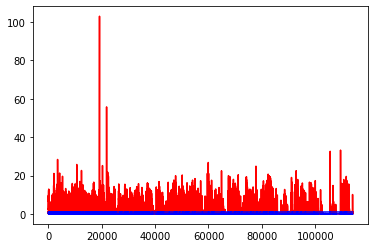

white ratio : 50.25
min : 177
max : 228


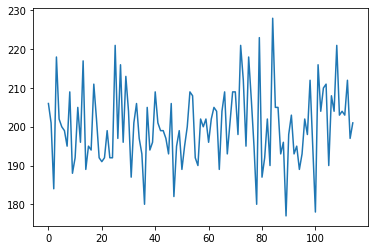

Generating interpolations...
114001 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.799102, 1.286631]
114002 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.088080, 1.295717]
114003 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.594892, 2.373255]
114004 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.365427, 0.260180]
114005 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.553040, 0.224204]
114006 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.583986, 0.042817]
114007 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.048418, 0.207092]
114008 [D loss: 0.002831, acc.: 100.00%] [G loss: 0.530302, 0.539269]
114009 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.616465, 0.271778]
114010 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.301583, 0.227854]
114011 [D loss: 0.000473, acc.: 100.00%] [G loss: 0.187571, 0.504178]
114012 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.445484, 0.370763]
114013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.058802, 0.017748]
114014 [D loss: 0.000001, acc.: 100.00%] [G loss: 21.327583, 

114116 [D loss: 0.000427, acc.: 100.00%] [G loss: 10.595871, 9.285395]
114117 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.631907, 14.832608]
114118 [D loss: 0.000047, acc.: 100.00%] [G loss: 54.886116, 16.690815]
114119 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.256262, 11.314955]
114120 [D loss: 0.000149, acc.: 100.00%] [G loss: 15.301107, 14.909160]
114121 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.945839, 11.395618]
114122 [D loss: 0.000016, acc.: 100.00%] [G loss: 7.767550, 5.195421]
114123 [D loss: 0.032999, acc.: 96.88%] [G loss: 22.501690, 9.588744]
114124 [D loss: 0.001257, acc.: 100.00%] [G loss: 5.840046, 6.001647]
114125 [D loss: 0.006504, acc.: 100.00%] [G loss: 16.122622, 12.455763]
114126 [D loss: 0.002055, acc.: 100.00%] [G loss: 2.457417, 0.536167]
114127 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.712906, 0.609995]
114128 [D loss: 0.006679, acc.: 100.00%] [G loss: 11.757953, 11.010801]
114129 [D loss: 0.000079, acc.: 100.00%] [G loss: 3.947972, 0.882516]
11413

114233 [D loss: 0.000008, acc.: 100.00%] [G loss: 16.004412, 15.606453]
114234 [D loss: 0.035824, acc.: 96.88%] [G loss: 15.282513, 14.757921]
114235 [D loss: 0.000950, acc.: 100.00%] [G loss: 4.388806, 1.948811]
114236 [D loss: 0.001960, acc.: 100.00%] [G loss: 1.910295, 1.503651]
114237 [D loss: 0.012858, acc.: 100.00%] [G loss: 11.857250, 11.289803]
114238 [D loss: 0.000323, acc.: 100.00%] [G loss: 8.916376, 7.089006]
114239 [D loss: 0.002666, acc.: 100.00%] [G loss: 230.462402, 5.329777]
114240 [D loss: 0.000560, acc.: 100.00%] [G loss: 7.009004, 8.534616]
114241 [D loss: 0.000063, acc.: 100.00%] [G loss: 11.318405, 11.242148]
114242 [D loss: 0.000030, acc.: 100.00%] [G loss: 9.558344, 9.978309]
114243 [D loss: 0.120887, acc.: 96.88%] [G loss: 12.866020, 13.078955]
114244 [D loss: 0.000555, acc.: 100.00%] [G loss: 10.001762, 9.834881]
114245 [D loss: 0.001975, acc.: 100.00%] [G loss: 2.187819, 2.039970]
114246 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.808068, 8.706220]
114247 [D

114352 [D loss: 0.002093, acc.: 100.00%] [G loss: 26.242579, 11.507695]
114353 [D loss: 0.182679, acc.: 96.88%] [G loss: 2.751167, 1.526124]
114354 [D loss: 0.196547, acc.: 96.88%] [G loss: 2.999959, 2.669307]
114355 [D loss: 0.400507, acc.: 93.75%] [G loss: 4.032494, 2.073985]
114356 [D loss: 0.000023, acc.: 100.00%] [G loss: 10.726992, 11.551293]
114357 [D loss: 0.010406, acc.: 100.00%] [G loss: 8.831611, 7.454938]
114358 [D loss: 0.040814, acc.: 96.88%] [G loss: 10.730049, 4.942778]
114359 [D loss: 0.001962, acc.: 100.00%] [G loss: 1.538052, 1.145003]
114360 [D loss: 0.000207, acc.: 100.00%] [G loss: 5.969657, 6.421992]
114361 [D loss: 0.029550, acc.: 100.00%] [G loss: 6.311915, 5.344417]
114362 [D loss: 0.000291, acc.: 100.00%] [G loss: 8.356119, 8.532793]
114363 [D loss: 0.012446, acc.: 100.00%] [G loss: 2.189542, 1.398951]
114364 [D loss: 0.001028, acc.: 100.00%] [G loss: 5.673725, 4.846170]
114365 [D loss: 0.088169, acc.: 96.88%] [G loss: 0.538953, 0.298964]
114366 [D loss: 0.00

114473 [D loss: 0.005555, acc.: 100.00%] [G loss: 23.839516, 0.340494]
114474 [D loss: 0.004543, acc.: 100.00%] [G loss: 0.214632, 0.583135]
114475 [D loss: 0.001133, acc.: 100.00%] [G loss: 5.842001, 4.651469]
114476 [D loss: 0.000068, acc.: 100.00%] [G loss: 6.603035, 6.440434]
114477 [D loss: 0.000043, acc.: 100.00%] [G loss: 11.713436, 5.782297]
114478 [D loss: 0.000151, acc.: 100.00%] [G loss: 7.527241, 8.155746]
114479 [D loss: 0.000240, acc.: 100.00%] [G loss: 5.127998, 4.101788]
114480 [D loss: 0.022242, acc.: 100.00%] [G loss: 6.282384, 6.122626]
114481 [D loss: 0.000293, acc.: 100.00%] [G loss: 2.981866, 2.044639]
114482 [D loss: 0.237906, acc.: 93.75%] [G loss: 3.896886, 1.802662]
114483 [D loss: 0.001113, acc.: 100.00%] [G loss: 2.819758, 2.730628]
114484 [D loss: 0.003300, acc.: 100.00%] [G loss: 19.745937, 6.080032]
114485 [D loss: 0.001682, acc.: 100.00%] [G loss: 2.230051, 2.036561]
114486 [D loss: 0.003950, acc.: 100.00%] [G loss: 24.221230, 4.377683]
114487 [D loss: 0

114591 [D loss: 0.000119, acc.: 100.00%] [G loss: 8.853703, 3.460157]
114592 [D loss: 0.000348, acc.: 100.00%] [G loss: 4.333701, 3.829964]
114593 [D loss: 0.004230, acc.: 100.00%] [G loss: 3.214608, 2.606075]
114594 [D loss: 0.000005, acc.: 100.00%] [G loss: 7.290411, 6.756369]
114595 [D loss: 0.015964, acc.: 100.00%] [G loss: 0.752415, 0.405912]
114596 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.178615, 2.273905]
114597 [D loss: 0.141541, acc.: 96.88%] [G loss: 2.473223, 1.872308]
114598 [D loss: 0.039686, acc.: 96.88%] [G loss: 2.927177, 1.980288]
114599 [D loss: 0.001299, acc.: 100.00%] [G loss: 2.221016, 1.563507]
114600 [D loss: 0.063064, acc.: 93.75%] [G loss: 3.419591, 2.590593]
114601 [D loss: 0.152806, acc.: 96.88%] [G loss: 3.796899, 3.886719]
114602 [D loss: 0.001755, acc.: 100.00%] [G loss: 2.728154, 1.700248]
114603 [D loss: 0.005424, acc.: 100.00%] [G loss: 4.719635, 3.364042]
114604 [D loss: 0.147851, acc.: 96.88%] [G loss: 1.221951, 0.467344]
114605 [D loss: 0.022006,

114712 [D loss: 0.006709, acc.: 100.00%] [G loss: 2.457258, 1.716449]
114713 [D loss: 0.001122, acc.: 100.00%] [G loss: 0.336733, 0.145920]
114714 [D loss: 0.035438, acc.: 96.88%] [G loss: 1.734816, 2.131515]
114715 [D loss: 0.039394, acc.: 96.88%] [G loss: 4.181011, 3.580744]
114716 [D loss: 0.000787, acc.: 100.00%] [G loss: 0.408190, 0.379066]
114717 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.162520, 0.529728]
114718 [D loss: 0.004678, acc.: 100.00%] [G loss: 0.171879, 0.144575]
114719 [D loss: 0.003765, acc.: 100.00%] [G loss: 0.058905, 0.178841]
114720 [D loss: 0.006436, acc.: 100.00%] [G loss: 1.963659, 2.092117]
114721 [D loss: 0.001466, acc.: 100.00%] [G loss: 0.003048, 0.005837]
114722 [D loss: 0.010158, acc.: 100.00%] [G loss: 2.839796, 2.717987]
114723 [D loss: 0.004204, acc.: 100.00%] [G loss: 0.690438, 0.275733]
114724 [D loss: 0.049198, acc.: 96.88%] [G loss: 0.022244, 0.024771]
114725 [D loss: 0.027027, acc.: 96.88%] [G loss: 0.034214, 0.007848]
114726 [D loss: 0.004530

114830 [D loss: 0.012880, acc.: 100.00%] [G loss: 0.098971, 0.030105]
114831 [D loss: 0.003566, acc.: 100.00%] [G loss: 0.942169, 0.443548]
114832 [D loss: 0.077461, acc.: 96.88%] [G loss: 0.000351, 0.041889]
114833 [D loss: 0.002591, acc.: 100.00%] [G loss: 0.131094, 0.144451]
114834 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.773488, 0.500792]
114835 [D loss: 0.061143, acc.: 96.88%] [G loss: 0.198708, 0.072642]
114836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.093432, 0.007847]
114837 [D loss: 0.007503, acc.: 100.00%] [G loss: 0.547147, 0.897630]
114838 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.085373, 0.007081]
114839 [D loss: 0.002829, acc.: 100.00%] [G loss: 1.775370, 1.060449]
114840 [D loss: 0.000946, acc.: 100.00%] [G loss: 1.330231, 0.747860]
114841 [D loss: 0.005614, acc.: 100.00%] [G loss: 29.600805, 1.758560]
114842 [D loss: 0.000258, acc.: 100.00%] [G loss: 2.079677, 0.704729]
114843 [D loss: 0.000109, acc.: 100.00%] [G loss: 4.311660, 3.969369]
114844 [D loss: 0.000

114951 [D loss: 0.001151, acc.: 100.00%] [G loss: 5.446145, 6.309952]
114952 [D loss: 0.000936, acc.: 100.00%] [G loss: 0.266747, 0.654719]
114953 [D loss: 0.020344, acc.: 100.00%] [G loss: 0.750962, 0.316435]
114954 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.256278, 0.214653]
114955 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.202698, 0.291166]
114956 [D loss: 0.008381, acc.: 100.00%] [G loss: 3.388623, 3.793524]
114957 [D loss: 0.009342, acc.: 100.00%] [G loss: 1.726632, 0.698247]
114958 [D loss: 0.000451, acc.: 100.00%] [G loss: 0.157098, 0.150479]
114959 [D loss: 0.005842, acc.: 100.00%] [G loss: 3.741112, 1.761991]
114960 [D loss: 0.000664, acc.: 100.00%] [G loss: 1.856934, 2.883777]
114961 [D loss: 0.000246, acc.: 100.00%] [G loss: 8.643522, 4.132051]
114962 [D loss: 0.000465, acc.: 100.00%] [G loss: 3.164823, 3.076630]
114963 [D loss: 0.000895, acc.: 100.00%] [G loss: 1.193699, 1.474982]
114964 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.574169, 0.682060]
114965 [D loss: 0.00

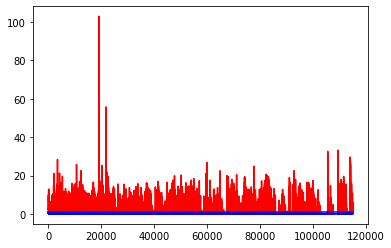

white ratio : 46.0
min : 177
max : 228


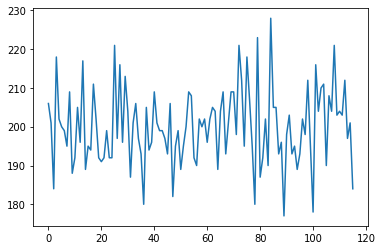

Generating interpolations...
115001 [D loss: 0.000349, acc.: 100.00%] [G loss: 8.710877, 8.547693]
115002 [D loss: 0.000710, acc.: 100.00%] [G loss: 8.531164, 7.537411]
115003 [D loss: 0.000051, acc.: 100.00%] [G loss: 2.864550, 2.261226]
115004 [D loss: 0.002093, acc.: 100.00%] [G loss: 2.550604, 1.159739]
115005 [D loss: 0.000109, acc.: 100.00%] [G loss: 8.202550, 9.112002]
115006 [D loss: 0.001910, acc.: 100.00%] [G loss: 1.886270, 1.880669]
115007 [D loss: 0.000109, acc.: 100.00%] [G loss: 5.636759, 5.272774]
115008 [D loss: 0.001249, acc.: 100.00%] [G loss: 4.052567, 2.955754]
115009 [D loss: 0.000478, acc.: 100.00%] [G loss: 0.439921, 0.607162]
115010 [D loss: 0.007939, acc.: 100.00%] [G loss: 0.692409, 0.606339]
115011 [D loss: 0.000341, acc.: 100.00%] [G loss: 3.027711, 2.064675]
115012 [D loss: 0.001475, acc.: 100.00%] [G loss: 1.456841, 0.830012]
115013 [D loss: 0.023466, acc.: 100.00%] [G loss: 0.077727, 0.096761]
115014 [D loss: 0.007515, acc.: 100.00%] [G loss: 5.468897, 5

115117 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.025668, 0.108089]
115118 [D loss: 0.000991, acc.: 100.00%] [G loss: 0.148522, 0.052094]
115119 [D loss: 0.002298, acc.: 100.00%] [G loss: 1.841474, 2.255707]
115120 [D loss: 0.000211, acc.: 100.00%] [G loss: 1.110356, 1.764856]
115121 [D loss: 0.001318, acc.: 100.00%] [G loss: 0.485474, 0.221362]
115122 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.480850, 0.181671]
115123 [D loss: 0.001894, acc.: 100.00%] [G loss: 4.449108, 3.836822]
115124 [D loss: 0.012030, acc.: 100.00%] [G loss: 0.119164, 0.231322]
115125 [D loss: 0.001685, acc.: 100.00%] [G loss: 0.797507, 0.015402]
115126 [D loss: 0.000874, acc.: 100.00%] [G loss: 0.121722, 0.015363]
115127 [D loss: 0.004306, acc.: 100.00%] [G loss: 0.246812, 0.022259]
115128 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.018175, 0.003930]
115129 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.279098, 0.187417]
115130 [D loss: 0.000415, acc.: 100.00%] [G loss: 0.106367, 0.092792]
115131 [D loss: 0.00

115235 [D loss: 0.001441, acc.: 100.00%] [G loss: 0.208923, 0.112763]
115236 [D loss: 0.002070, acc.: 100.00%] [G loss: 1.006856, 1.325464]
115237 [D loss: 0.000013, acc.: 100.00%] [G loss: 9.519097, 2.218451]
115238 [D loss: 0.004936, acc.: 100.00%] [G loss: 4.827835, 4.524848]
115239 [D loss: 0.013906, acc.: 100.00%] [G loss: 3.946174, 2.911444]
115240 [D loss: 0.084581, acc.: 96.88%] [G loss: 0.546178, 1.042463]
115241 [D loss: 0.008798, acc.: 100.00%] [G loss: 4.165643, 3.058321]
115242 [D loss: 0.001873, acc.: 100.00%] [G loss: 2.043105, 2.848165]
115243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.892211, 1.082251]
115244 [D loss: 0.015124, acc.: 100.00%] [G loss: 1.509270, 0.999755]
115245 [D loss: 0.000324, acc.: 100.00%] [G loss: 0.492914, 0.300056]
115246 [D loss: 0.003564, acc.: 100.00%] [G loss: 0.527996, 0.597650]
115247 [D loss: 0.013247, acc.: 100.00%] [G loss: 0.712933, 0.185672]
115248 [D loss: 0.021293, acc.: 100.00%] [G loss: 1.334198, 0.996845]
115249 [D loss: 0.001

115352 [D loss: 0.124350, acc.: 96.88%] [G loss: 0.456512, 0.091384]
115353 [D loss: 0.048796, acc.: 96.88%] [G loss: 1.074102, 0.020190]
115354 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.224069, 0.233061]
115355 [D loss: 0.000319, acc.: 100.00%] [G loss: 6.856815, 6.166113]
115356 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.249568, 0.158438]
115357 [D loss: 0.019976, acc.: 100.00%] [G loss: 2.439305, 2.276582]
115358 [D loss: 0.000438, acc.: 100.00%] [G loss: 0.212943, 0.102651]
115359 [D loss: 0.000232, acc.: 100.00%] [G loss: 7.053058, 6.560440]
115360 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.001476, 0.000777]
115361 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.908723, 0.188289]
115362 [D loss: 0.001610, acc.: 100.00%] [G loss: 0.267952, 0.273153]
115363 [D loss: 0.001893, acc.: 100.00%] [G loss: 0.068786, 0.061216]
115364 [D loss: 0.001504, acc.: 100.00%] [G loss: 9.016510, 0.493887]
115365 [D loss: 0.000505, acc.: 100.00%] [G loss: 0.170178, 0.146756]
115366 [D loss: 0.0002

115472 [D loss: 0.001115, acc.: 100.00%] [G loss: 0.041950, 0.050966]
115473 [D loss: 0.000817, acc.: 100.00%] [G loss: 0.414195, 0.445240]
115474 [D loss: 0.004305, acc.: 100.00%] [G loss: 0.066969, 0.106240]
115475 [D loss: 0.000320, acc.: 100.00%] [G loss: 0.012243, 0.000297]
115476 [D loss: 0.003867, acc.: 100.00%] [G loss: 1.201160, 0.101845]
115477 [D loss: 0.006599, acc.: 100.00%] [G loss: 0.016441, 0.181033]
115478 [D loss: 0.000051, acc.: 100.00%] [G loss: 5.146801, 0.123581]
115479 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.299599, 0.568685]
115480 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.000527, 0.000001]
115481 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.469986, 3.669714]
115482 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.563140, 0.270237]
115483 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.013234, 0.000161]
115484 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.620613, 5.032624]
115485 [D loss: 0.000037, acc.: 100.00%] [G loss: 4.797177, 3.707808]
115486 [D loss: 0.00

115589 [D loss: 0.073269, acc.: 96.88%] [G loss: 44.451565, 11.575340]
115590 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.009600, 12.770545]
115591 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.491460, 15.111932]
115592 [D loss: 0.000107, acc.: 100.00%] [G loss: 9.478274, 7.769194]
115593 [D loss: 0.004990, acc.: 100.00%] [G loss: 12.321035, 12.579417]
115594 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.180114, 8.795584]
115595 [D loss: 0.000863, acc.: 100.00%] [G loss: 13.199742, 12.700006]
115596 [D loss: 0.000015, acc.: 100.00%] [G loss: 12.044555, 11.372462]
115597 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.761098, 0.860219]
115598 [D loss: 0.000139, acc.: 100.00%] [G loss: 5.853131, 4.147841]
115599 [D loss: 0.000688, acc.: 100.00%] [G loss: 6.812953, 9.977922]
115600 [D loss: 0.000055, acc.: 100.00%] [G loss: 7.168751, 9.111120]
115601 [D loss: 0.002205, acc.: 100.00%] [G loss: 22.534832, 9.112545]
115602 [D loss: 0.000258, acc.: 100.00%] [G loss: 13.012052, 13.252577]
11560

115705 [D loss: 0.000016, acc.: 100.00%] [G loss: 5.963755, 4.740039]
115706 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.553974, 9.120165]
115707 [D loss: 0.000574, acc.: 100.00%] [G loss: 2.631920, 2.630309]
115708 [D loss: 0.029321, acc.: 96.88%] [G loss: 1.574413, 2.015466]
115709 [D loss: 0.000225, acc.: 100.00%] [G loss: 3.809089, 2.924551]
115710 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.763506, 1.404385]
115711 [D loss: 0.000007, acc.: 100.00%] [G loss: 30.594393, 2.056705]
115712 [D loss: 0.000713, acc.: 100.00%] [G loss: 1.904472, 2.823806]
115713 [D loss: 0.123889, acc.: 96.88%] [G loss: 2.221983, 1.653679]
115714 [D loss: 0.000157, acc.: 100.00%] [G loss: 15.867423, 15.960558]
115715 [D loss: 0.000371, acc.: 100.00%] [G loss: 8.028146, 7.853270]
115716 [D loss: 0.012144, acc.: 100.00%] [G loss: 10.466767, 9.447090]
115717 [D loss: 0.007197, acc.: 100.00%] [G loss: 9.292125, 8.000101]
115718 [D loss: 0.000327, acc.: 100.00%] [G loss: 4.017582, 3.430588]
115719 [D loss: 0.

115823 [D loss: 0.000070, acc.: 100.00%] [G loss: 48.187683, 1.321729]
115824 [D loss: 0.003255, acc.: 100.00%] [G loss: 2.999177, 2.020239]
115825 [D loss: 0.000654, acc.: 100.00%] [G loss: 3.769003, 5.076669]
115826 [D loss: 0.001545, acc.: 100.00%] [G loss: 10.359772, 9.104944]
115827 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.703729, 6.616932]
115828 [D loss: 0.001775, acc.: 100.00%] [G loss: 9.029526, 2.135705]
115829 [D loss: 0.015007, acc.: 100.00%] [G loss: 3.663335, 3.850576]
115830 [D loss: 0.011280, acc.: 100.00%] [G loss: 5.321348, 5.097552]
115831 [D loss: 0.102033, acc.: 96.88%] [G loss: 8.750051, 7.957829]
115832 [D loss: 0.000028, acc.: 100.00%] [G loss: 9.197105, 8.982471]
115833 [D loss: 0.000026, acc.: 100.00%] [G loss: 14.277935, 12.223225]
115834 [D loss: 0.000869, acc.: 100.00%] [G loss: 14.924963, 9.618088]
115835 [D loss: 0.021344, acc.: 100.00%] [G loss: 9.922972, 8.463230]
115836 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.396423, 7.640233]
115837 [D loss: 

115942 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.519874, 0.326051]
115943 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.483998, 2.266162]
115944 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.012119, 0.020463]
115945 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.067118, 0.052252]
115946 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.850858, 0.194310]
115947 [D loss: 0.001029, acc.: 100.00%] [G loss: 0.180011, 0.428208]
115948 [D loss: 0.001135, acc.: 100.00%] [G loss: 0.055551, 0.001488]
115949 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.292079, 0.026991]
115950 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.730031, 1.085779]
115951 [D loss: 0.000588, acc.: 100.00%] [G loss: 0.019121, 0.097845]
115952 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.075361, 0.027553]
115953 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001351, 0.000135]
115954 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.017569, 0.001345]
115955 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.995361, 0.583968]
115956 [D loss: 0.00

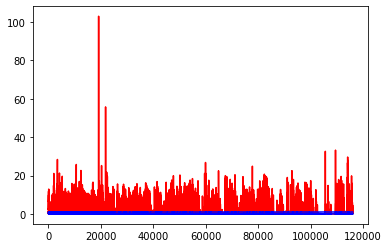

white ratio : 50.75
min : 177
max : 228


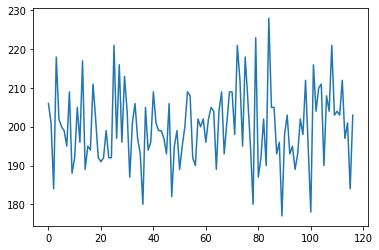

Generating interpolations...
116001 [D loss: 0.002453, acc.: 100.00%] [G loss: 0.274166, 0.300376]
116002 [D loss: 0.001201, acc.: 100.00%] [G loss: 0.386776, 0.312072]
116003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.252284, 0.250761]
116004 [D loss: 0.002447, acc.: 100.00%] [G loss: 1.301511, 0.824556]
116005 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.472187, 0.471775]
116006 [D loss: 0.000909, acc.: 100.00%] [G loss: 0.801446, 0.958195]
116007 [D loss: 0.000184, acc.: 100.00%] [G loss: 1.409892, 1.468594]
116008 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.298926, 0.017693]
116009 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.282337, 0.075860]
116010 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.101972, 0.080915]
116011 [D loss: 0.006041, acc.: 100.00%] [G loss: 0.609400, 0.400651]
116012 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.313235, 0.210488]
116013 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.061363, 0.110702]
116014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.430720, 0

116119 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.003236, 0.014174]
116120 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.015347, 0.092246]
116121 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.031712, 0.292470]
116122 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.298968, 0.215052]
116123 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.251714, 0.156397]
116124 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.019734, 0.005886]
116125 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.254448, 0.271600]
116126 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.030568, 0.038679]
116127 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.002573, 0.001799]
116128 [D loss: 0.017415, acc.: 100.00%] [G loss: 0.363166, 0.110251]
116129 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.054288, 0.010400]
116130 [D loss: 0.000736, acc.: 100.00%] [G loss: 0.014410, 0.114652]
116131 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.535698, 0.944863]
116132 [D loss: 0.123642, acc.: 96.88%] [G loss: 0.083303, 0.081931]
116133 [D loss: 0.000

116240 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.264725, 0.014957]
116241 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.070360, 0.076064]
116242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000294, 0.014010]
116243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003388, 0.000682]
116244 [D loss: 0.000018, acc.: 100.00%] [G loss: 4.002321, 3.126332]
116245 [D loss: 0.000242, acc.: 100.00%] [G loss: 0.015049, 0.030691]
116246 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.019619, 0.063064]
116247 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.852967, 0.151605]
116248 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.051377, 0.065683]
116249 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.001284, 0.003165]
116250 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.058672, 0.519730]
116251 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.015366, 0.165057]
116252 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000137, 0.025819]
116253 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.358907, 0.235330]
116254 [D loss: 0.00

116358 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.029070, 0.106304]
116359 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.367339, 0.317950]
116360 [D loss: 0.000320, acc.: 100.00%] [G loss: 1.004889, 0.419814]
116361 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000033, 0.001444]
116362 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.713791, 0.138541]
116363 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.166229, 0.351889]
116364 [D loss: 0.001278, acc.: 100.00%] [G loss: 0.017267, 0.207244]
116365 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.016460, 0.000095]
116366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.024822, 0.263751]
116367 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.536725, 0.172618]
116368 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.011283, 0.007983]
116369 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.039327, 0.004466]
116370 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.090860, 0.017487]
116371 [D loss: 0.000618, acc.: 100.00%] [G loss: 0.301828, 0.003826]
116372 [D loss: 0.00

116478 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.495405, 0.017376]
116479 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.016674, 0.056744]
116480 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.004722, 0.024798]
116481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008494, 0.098909]
116482 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.003680, 0.035065]
116483 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.177661, 0.079362]
116484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.297248, 0.198492]
116485 [D loss: 0.000558, acc.: 100.00%] [G loss: 0.335677, 0.086578]
116486 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.247117, 0.702065]
116487 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.120666, 0.000921]
116488 [D loss: 0.005978, acc.: 100.00%] [G loss: 0.321280, 0.100934]
116489 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.094556, 0.020046]
116490 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.302868, 1.532157]
116491 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.130313, 0.348272]
116492 [D loss: 0.00

116598 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.802008, 0.049916]
116599 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.153162, 4.448422]
116600 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.204430, 2.545654]
116601 [D loss: 0.000398, acc.: 100.00%] [G loss: 0.154125, 0.238453]
116602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001256, 0.003221]
116603 [D loss: 0.022493, acc.: 96.88%] [G loss: 0.049944, 0.114278]
116604 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.174589, 0.182681]
116605 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.111050, 0.147311]
116606 [D loss: 0.000134, acc.: 100.00%] [G loss: 1.729176, 1.853660]
116607 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.229751, 0.020583]
116608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.636837, 0.734441]
116609 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.602539, 0.659301]
116610 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.326008, 0.631545]
116611 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.615622, 0.472525]
116612 [D loss: 0.000

116717 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.034590, 0.137335]
116718 [D loss: 0.000500, acc.: 100.00%] [G loss: 0.025452, 0.005811]
116719 [D loss: 0.004103, acc.: 100.00%] [G loss: 0.163158, 0.240995]
116720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.124126, 0.102675]
116721 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.156829, 0.044495]
116722 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000031, 0.000207]
116723 [D loss: 0.000682, acc.: 100.00%] [G loss: 0.499960, 0.137131]
116724 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000899, 0.086165]
116725 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.193127, 0.230636]
116726 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.237146, 0.330334]
116727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.182594, 0.286188]
116728 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.452717, 1.319673]
116729 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.054043, 3.616998]
116730 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.994233, 1.056530]
116731 [D loss: 0.00

116835 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000043, 0.000004]
116836 [D loss: 0.001204, acc.: 100.00%] [G loss: 0.000015, 0.000056]
116837 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.485071, 0.398824]
116838 [D loss: 0.069158, acc.: 96.88%] [G loss: 0.004157, 0.054046]
116839 [D loss: 0.001378, acc.: 100.00%] [G loss: 0.000000, 0.000039]
116840 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.020939, 0.029185]
116841 [D loss: 0.009072, acc.: 100.00%] [G loss: 0.136780, 0.114818]
116842 [D loss: 0.002851, acc.: 100.00%] [G loss: 0.192077, 0.267341]
116843 [D loss: 0.004728, acc.: 100.00%] [G loss: 0.008646, 0.003702]
116844 [D loss: 0.000501, acc.: 100.00%] [G loss: 0.007298, 0.007978]
116845 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.071573, 0.026493]
116846 [D loss: 0.001197, acc.: 100.00%] [G loss: 0.094434, 0.005319]
116847 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000001, 0.000003]
116848 [D loss: 0.000268, acc.: 100.00%] [G loss: 1.173055, 1.511691]
116849 [D loss: 0.000

116956 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.052386, 0.050825]
116957 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000003, 0.000005]
116958 [D loss: 0.012659, acc.: 100.00%] [G loss: 0.124522, 0.108072]
116959 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000005, 0.000022]
116960 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.000000, 0.000001]
116961 [D loss: 0.000252, acc.: 100.00%] [G loss: 0.004332, 0.003399]
116962 [D loss: 0.000732, acc.: 100.00%] [G loss: 0.000000, 0.000022]
116963 [D loss: 0.001023, acc.: 100.00%] [G loss: 0.096462, 0.026802]
116964 [D loss: 0.000459, acc.: 100.00%] [G loss: 0.019054, 0.004360]
116965 [D loss: 0.001009, acc.: 100.00%] [G loss: 0.000005, 0.000334]
116966 [D loss: 0.004088, acc.: 100.00%] [G loss: 0.011128, 0.000623]
116967 [D loss: 0.001823, acc.: 100.00%] [G loss: 0.000000, 0.000007]
116968 [D loss: 0.001302, acc.: 100.00%] [G loss: 0.085831, 0.252268]
116969 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.324630, 0.110469]
116970 [D loss: 0.00

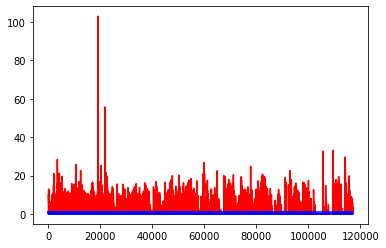

white ratio : 53.0
min : 177
max : 228


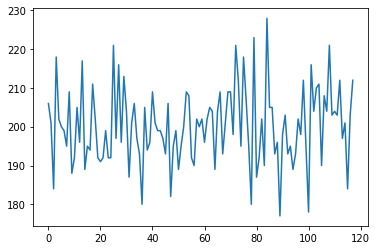

Generating interpolations...
117001 [D loss: 0.000435, acc.: 100.00%] [G loss: 0.000001, 0.000018]
117002 [D loss: 0.009252, acc.: 100.00%] [G loss: 0.075216, 0.003564]
117003 [D loss: 0.001443, acc.: 100.00%] [G loss: 0.698004, 0.683911]
117004 [D loss: 0.000708, acc.: 100.00%] [G loss: 0.000020, 0.000031]
117005 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.000148, 0.000043]
117006 [D loss: 0.001163, acc.: 100.00%] [G loss: 0.023153, 0.106492]
117007 [D loss: 0.000547, acc.: 100.00%] [G loss: 0.000094, 0.001569]
117008 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.000030, 0.000060]
117009 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.059732, 0.007257]
117010 [D loss: 0.002245, acc.: 100.00%] [G loss: 0.000222, 0.017777]
117011 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.160946, 0.572041]
117012 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.946077, 2.443532]
117013 [D loss: 0.000094, acc.: 100.00%] [G loss: 1.163985, 1.831452]
117014 [D loss: 0.014858, acc.: 100.00%] [G loss: 0.000181, 0

117119 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.012818, 0.000681]
117120 [D loss: 0.000244, acc.: 100.00%] [G loss: 0.000010, 0.000211]
117121 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000016, 0.000004]
117122 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.002306, 0.107889]
117123 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000001]
117124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117125 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.000115, 0.001083]
117126 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.109349, 0.007681]
117127 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000080, 0.000037]
117128 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.000106, 0.000532]
117129 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000092, 0.000007]
117130 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.002034, 0.016146]
117131 [D loss: 0.000714, acc.: 100.00%] [G loss: 0.557744, 0.604473]
117132 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.086635, 0.026364]
117133 [D loss: 0.00

117239 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117240 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117241 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000339, 0.009539]
117242 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000012, 0.000645]
117243 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000003, 0.000002]
117244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001035, 0.001310]
117245 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.000029, 0.000209]
117246 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000012, 0.000053]
117247 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000012]
117249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000118, 0.001333]
117250 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000036]
117251 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.000024, 0.015084]
117252 [D loss: 0.123377, acc.: 96.88%] [G loss: 0.000000, 0.000000]
117253 [D loss: 0.002

117357 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.061028, 0.091820]
117358 [D loss: 0.000398, acc.: 100.00%] [G loss: 0.010812, 0.000420]
117359 [D loss: 0.000470, acc.: 100.00%] [G loss: 0.000048, 0.001050]
117360 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.117022, 0.009086]
117361 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000003, 0.000000]
117362 [D loss: 0.000446, acc.: 100.00%] [G loss: 0.001129, 0.000004]
117363 [D loss: 0.011976, acc.: 100.00%] [G loss: 0.000335, 0.007790]
117364 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.002903, 0.000000]
117365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000529, 0.000060]
117366 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000421, 0.000000]
117367 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000005, 0.000016]
117368 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000008, 0.000056]
117369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000100, 0.000156]
117370 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000915, 0.000007]
117371 [D loss: 0.00

117475 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000000, 0.000027]
117476 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000160, 0.000189]
117477 [D loss: 0.017156, acc.: 100.00%] [G loss: 0.019337, 0.001659]
117478 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004697, 0.008587]
117479 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.007015, 0.015383]
117480 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000302, 0.022801]
117481 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003368, 0.000076]
117482 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000997, 0.001452]
117483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021760, 0.301881]
117484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000004]
117485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.219840, 0.329211]
117486 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.031296, 0.001939]
117487 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002566, 0.214198]
117488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.232148, 0.081731]
117489 [D loss: 0.00

117595 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.263556, 0.201564]
117596 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000403, 0.000007]
117597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000125, 0.000063]
117598 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.000007, 0.000004]
117599 [D loss: 0.001196, acc.: 100.00%] [G loss: 0.003523, 0.014461]
117600 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.287008, 0.558534]
117601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001738, 0.000060]
117602 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000006, 0.000080]
117603 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117604 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.019862, 0.000063]
117605 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.176911, 0.165589]
117606 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.002266, 0.002270]
117607 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.000000, 0.000000]
117608 [D loss: 0.001957, acc.: 100.00%] [G loss: 0.000062, 0.000202]
117609 [D loss: 0.00

117714 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.001694, 0.066776]
117715 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.589221, 0.422714]
117716 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.029377, 0.080045]
117717 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002539, 0.051650]
117718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.047763, 0.328239]
117719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.065641]
117720 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.003287, 0.007823]
117721 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.144991, 0.034316]
117722 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.184358, 0.006882]
117723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.013890, 0.002506]
117724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000131, 0.000011]
117725 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.027800, 0.000177]
117726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.084932, 0.288421]
117727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002996, 0.005703]
117728 [D loss: 0.00

117834 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.187493, 0.043805]
117835 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.000886, 0.039953]
117836 [D loss: 0.000020, acc.: 100.00%] [G loss: 9.581470, 0.442232]
117837 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.248259, 0.706330]
117838 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.027504, 0.191361]
117839 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.277707, 0.028799]
117840 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000496, 0.000414]
117841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.250163, 0.379671]
117842 [D loss: 0.001987, acc.: 100.00%] [G loss: 0.111562, 0.111341]
117843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.150980, 0.048453]
117844 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.251408, 0.113676]
117845 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.368036, 0.451144]
117846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004797, 0.009512]
117847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004398, 0.026039]
117848 [D loss: 0.02

117952 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000273, 0.000715]
117953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.038424, 0.393301]
117954 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.003469, 0.311376]
117955 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000007, 0.000156]
117956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000025, 0.000566]
117957 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.007998, 0.016250]
117958 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001006, 0.023886]
117959 [D loss: 0.000235, acc.: 100.00%] [G loss: 0.067411, 0.015591]
117960 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000987, 0.004291]
117961 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.012645, 0.013833]
117962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.064045, 0.010352]
117963 [D loss: 0.000409, acc.: 100.00%] [G loss: 0.031301, 0.136736]
117964 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.035074, 0.142473]
117965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.158368, 0.101399]
117966 [D loss: 0.00

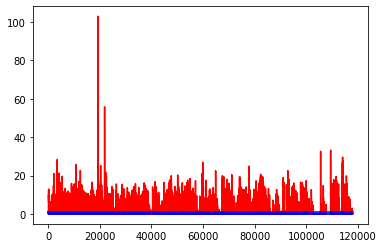

white ratio : 54.5
min : 177
max : 228


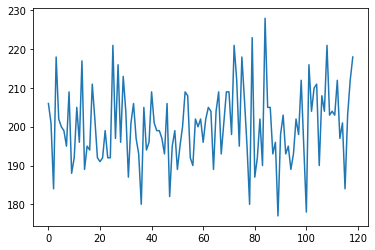

Generating interpolations...
118001 [D loss: 0.007453, acc.: 100.00%] [G loss: 0.003214, 0.000308]
118002 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.000086, 0.002908]
118003 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.030041, 0.033201]
118004 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000009, 0.000129]
118005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003489, 0.005383]
118006 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.002199, 0.000093]
118007 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.000014, 0.000000]
118008 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.017728, 0.006210]
118009 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000004, 0.000001]
118010 [D loss: 0.004689, acc.: 100.00%] [G loss: 0.000011, 0.034541]
118011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004888, 0.028171]
118012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002387, 0.004172]
118013 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.024429, 0.014991]
118014 [D loss: 0.000382, acc.: 100.00%] [G loss: 0.006082, 0

118119 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000265, 0.001955]
118120 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.195592, 0.002151]
118121 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000004, 0.000009]
118122 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000096, 0.001574]
118123 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.090258, 0.000000]
118124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.074637, 0.001346]
118125 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000002]
118126 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.009209, 0.157595]
118127 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.014595, 0.018324]
118128 [D loss: 0.000178, acc.: 100.00%] [G loss: 0.004348, 0.005586]
118129 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000004, 0.000224]
118130 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000014, 0.000874]
118131 [D loss: 0.000303, acc.: 100.00%] [G loss: 0.000021, 0.000101]
118132 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.059596, 0.000132]
118133 [D loss: 0.00

118237 [D loss: 0.000383, acc.: 100.00%] [G loss: 0.020040, 0.335450]
118238 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.024272, 0.000998]
118239 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.016363, 0.061712]
118240 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000294, 0.000625]
118241 [D loss: 0.000891, acc.: 100.00%] [G loss: 0.001435, 0.000257]
118242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036794, 0.001275]
118243 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.012805, 0.005304]
118244 [D loss: 0.001185, acc.: 100.00%] [G loss: 0.071831, 0.011961]
118245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.073213, 0.035499]
118246 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000005, 0.000044]
118247 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.010664, 0.243205]
118248 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.103272, 0.158963]
118249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006855, 0.145690]
118250 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000004, 0.000008]
118251 [D loss: 0.00

118358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.294216, 0.051681]
118359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003318, 0.033747]
118360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.068539, 0.215579]
118361 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.204218, 0.083125]
118362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.325362, 0.148654]
118363 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.261042, 0.297981]
118364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.188994, 0.128488]
118365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.713695, 0.126707]
118366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.239757, 0.099197]
118367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005744, 0.162466]
118368 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.082198, 0.005345]
118369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.018653, 0.007928]
118370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.050962, 0.442213]
118371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.060453, 0.096109]
118372 [D loss: 0.00

118478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284259, 0.139108]
118479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.204243, 0.453999]
118480 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.127049, 0.224790]
118481 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.865996, 1.736777]
118482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.431808, 0.188573]
118483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.532401, 0.363673]
118484 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.002400, 0.095727]
118485 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000881, 0.017341]
118486 [D loss: 0.000684, acc.: 100.00%] [G loss: 0.194176, 0.200596]
118487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.107089, 0.102036]
118488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.308296, 0.161673]
118489 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.280487, 0.737470]
118490 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.162694, 0.001916]
118491 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.823937, 0.306420]
118492 [D loss: 0.00

118596 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.819122, 0.387714]
118597 [D loss: 0.000063, acc.: 100.00%] [G loss: 1.430877, 0.288141]
118598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.212515, 0.150204]
118599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.161057, 0.137619]
118600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.396823, 0.314168]
118601 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.355323, 0.354620]
118602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.975928, 0.464869]
118603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.465269, 0.761038]
118604 [D loss: 0.012739, acc.: 100.00%] [G loss: 0.000347, 0.038826]
118605 [D loss: 0.000755, acc.: 100.00%] [G loss: 0.033759, 0.051014]
118606 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.720070, 0.553785]
118607 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.340530, 0.000496]
118608 [D loss: 0.000307, acc.: 100.00%] [G loss: 0.001425, 0.006011]
118609 [D loss: 0.000522, acc.: 100.00%] [G loss: 0.157930, 0.000294]
118610 [D loss: 0.00

118714 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.940742, 0.915184]
118715 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.208460, 0.063656]
118716 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.470300, 1.411571]
118717 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.872902, 1.361096]
118718 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.732737, 0.384855]
118719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.125484, 0.037106]
118720 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.305902, 0.595273]
118721 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.239221, 0.122479]
118722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.480409, 0.471055]
118723 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.465569, 0.199368]
118724 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.585400, 3.338493]
118725 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.164952, 1.272256]
118726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.486760, 0.310381]
118727 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.833052, 0.997861]
118728 [D loss: 0.00

118834 [D loss: 0.000064, acc.: 100.00%] [G loss: 4.204206, 1.756155]
118835 [D loss: 0.000535, acc.: 100.00%] [G loss: 3.467473, 2.259384]
118836 [D loss: 0.005318, acc.: 100.00%] [G loss: 1.331075, 1.171221]
118837 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.482479, 3.410669]
118838 [D loss: 0.000049, acc.: 100.00%] [G loss: 1.735249, 1.231886]
118839 [D loss: 0.000011, acc.: 100.00%] [G loss: 10.945938, 32.631672]
118840 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.083639, 3.685746]
118841 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.650515, 8.870111]
118842 [D loss: 0.000014, acc.: 100.00%] [G loss: 5.497684, 3.404873]
118843 [D loss: 0.000417, acc.: 100.00%] [G loss: 4.999896, 2.654700]
118844 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.421455, 6.162842]
118845 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.451441, 0.419018]
118846 [D loss: 0.000295, acc.: 100.00%] [G loss: 3.482806, 1.973453]
118847 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.023662, 0.761115]
118848 [D loss: 0.

118953 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.647361, 2.126247]
118954 [D loss: 0.009654, acc.: 100.00%] [G loss: 3.701846, 3.227799]
118955 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.505027, 1.661090]
118956 [D loss: 0.016521, acc.: 100.00%] [G loss: 3.628219, 2.921808]
118957 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.532642, 1.408551]
118958 [D loss: 0.000087, acc.: 100.00%] [G loss: 4.192368, 3.934615]
118959 [D loss: 0.000015, acc.: 100.00%] [G loss: 31.052147, 6.488636]
118960 [D loss: 0.010596, acc.: 100.00%] [G loss: 5.287130, 4.830507]
118961 [D loss: 0.000563, acc.: 100.00%] [G loss: 1.352756, 0.839721]
118962 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.916556, 0.988967]
118963 [D loss: 0.000863, acc.: 100.00%] [G loss: 1.154891, 1.004150]
118964 [D loss: 0.001109, acc.: 100.00%] [G loss: 1.387328, 1.656822]
118965 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.731506, 0.391066]
118966 [D loss: 0.018888, acc.: 100.00%] [G loss: 15.014162, 3.299538]
118967 [D loss: 0

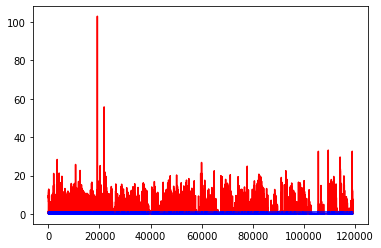

white ratio : 51.25
min : 177
max : 228


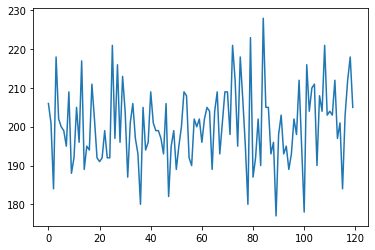

Generating interpolations...
119001 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.661159, 0.882072]
119002 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.677776, 0.109724]
119003 [D loss: 0.000467, acc.: 100.00%] [G loss: 0.411083, 0.369808]
119004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.126596, 0.208348]
119005 [D loss: 0.001351, acc.: 100.00%] [G loss: 1.100312, 0.982729]
119006 [D loss: 0.001680, acc.: 100.00%] [G loss: 0.436494, 0.345018]
119007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.059121, 0.160584]
119008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.156899, 0.003835]
119009 [D loss: 0.006578, acc.: 100.00%] [G loss: 0.556023, 0.695497]
119010 [D loss: 0.000781, acc.: 100.00%] [G loss: 0.179620, 0.255751]
119011 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.246965, 0.050261]
119012 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.192552, 0.685676]
119013 [D loss: 0.001418, acc.: 100.00%] [G loss: 9.927444, 2.217342]
119014 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.386439, 0

119120 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.082663, 0.016598]
119121 [D loss: 0.003967, acc.: 100.00%] [G loss: 2.811169, 2.730072]
119122 [D loss: 0.001362, acc.: 100.00%] [G loss: 0.054269, 0.212246]
119123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007530, 0.011215]
119124 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.280740, 0.204474]
119125 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.274220, 0.115665]
119126 [D loss: 0.000663, acc.: 100.00%] [G loss: 3.892134, 1.647820]
119127 [D loss: 0.166115, acc.: 96.88%] [G loss: 0.002327, 0.020244]
119128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036754, 0.000146]
119129 [D loss: 0.177968, acc.: 93.75%] [G loss: 0.070527, 0.038445]
119130 [D loss: 0.034035, acc.: 100.00%] [G loss: 2.082149, 2.947894]
119131 [D loss: 0.006434, acc.: 100.00%] [G loss: 4.779857, 2.116145]
119132 [D loss: 0.000038, acc.: 100.00%] [G loss: 1.471779, 0.723640]
119133 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.052708, 0.541113]
119134 [D loss: 0.0000

119238 [D loss: 0.000011, acc.: 100.00%] [G loss: 4.331048, 3.165667]
119239 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.962839, 11.795573]
119240 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.468395, 9.871905]
119241 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.856039, 11.479597]
119242 [D loss: 0.002521, acc.: 100.00%] [G loss: 11.993208, 10.966396]
119243 [D loss: 0.003374, acc.: 100.00%] [G loss: 1.752021, 0.631750]
119244 [D loss: 0.003786, acc.: 100.00%] [G loss: 10.497948, 8.825914]
119245 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009479, 0.014118]
119246 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.509075, 0.389588]
119247 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.116763, 0.216384]
119248 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.291762, 0.295967]
119249 [D loss: 0.000030, acc.: 100.00%] [G loss: 6.539150, 6.847260]
119250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.025617, 0.008874]
119251 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.018274, 0.109624]
119252 [D lo

119358 [D loss: 0.000213, acc.: 100.00%] [G loss: 5.016207, 4.600206]
119359 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.436944, 3.349299]
119360 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.044258, 0.141072]
119361 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.946874, 3.401253]
119362 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.172936, 0.112700]
119363 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.318693, 0.358616]
119364 [D loss: 0.001815, acc.: 100.00%] [G loss: 2.702422, 2.104035]
119365 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.571644, 0.219298]
119366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000029, 0.000800]
119367 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.135185, 0.201836]
119368 [D loss: 0.000072, acc.: 100.00%] [G loss: 2.235306, 2.498921]
119369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001341, 0.001127]
119370 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.496383, 0.331963]
119371 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.212198, 0.060234]
119372 [D loss: 0.0

119478 [D loss: 0.005121, acc.: 100.00%] [G loss: 0.000001, 0.000000]
119479 [D loss: 0.133819, acc.: 96.88%] [G loss: 0.000000, 0.000000]
119480 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001229, 0.011348]
119481 [D loss: 0.000519, acc.: 100.00%] [G loss: 0.000005, 0.000000]
119482 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.271670, 0.338062]
119483 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119484 [D loss: 0.001707, acc.: 100.00%] [G loss: 0.000000, 0.000007]
119485 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119486 [D loss: 0.015578, acc.: 100.00%] [G loss: 0.005201, 0.000005]
119487 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119488 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.249995, 0.122456]
119489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.016173, 0.000123]
119490 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.002333, 0.021743]
119491 [D loss: 0.000309, acc.: 100.00%] [G loss: 0.006556, 0.080602]
119492 [D loss: 0.000

119596 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.000018, 0.000004]
119597 [D loss: 0.000106, acc.: 100.00%] [G loss: 7.219491, 0.120755]
119598 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.775884, 1.464999]
119599 [D loss: 0.000166, acc.: 100.00%] [G loss: 1.195437, 0.627826]
119600 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.777504, 2.351350]
119601 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.442938, 0.342587]
119603 [D loss: 0.010117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119604 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000016, 0.000000]
119605 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.612776, 0.404077]
119606 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.221537, 0.139225]
119607 [D loss: 0.073028, acc.: 96.88%] [G loss: 0.000025, 0.000002]
119608 [D loss: 0.007146, acc.: 100.00%] [G loss: 0.000026, 0.000014]
119609 [D loss: 0.040740, acc.: 96.88%] [G loss: 0.000002, 0.000001]
119610 [D loss: 0.0008

119715 [D loss: 0.015650, acc.: 100.00%] [G loss: 0.000008, 0.000006]
119716 [D loss: 0.001167, acc.: 100.00%] [G loss: 0.008142, 0.002364]
119717 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119718 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000725, 0.002098]
119719 [D loss: 0.002257, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119720 [D loss: 0.001906, acc.: 100.00%] [G loss: 0.000101, 0.000370]
119721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000035]
119722 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000354]
119723 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.000249, 0.000008]
119724 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119725 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.056858, 0.001684]
119726 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000105, 0.000054]
119727 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.051413, 0.228933]
119728 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119729 [D loss: 0.00

119833 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.868711, 0.010823]
119834 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000017, 0.001183]
119835 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000027, 0.003534]
119836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.523854, 0.194681]
119837 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.389958, 0.102183]
119838 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.001764, 0.013059]
119839 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001534, 0.043026]
119840 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.810889, 1.117021]
119841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.149245, 0.325560]
119842 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.585805, 1.838837]
119843 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.074518, 0.121679]
119844 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.874913, 0.509844]
119845 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.002173, 0.001477]
119846 [D loss: 0.010628, acc.: 100.00%] [G loss: 0.019399, 0.014252]
119847 [D loss: 0.00

119953 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.000007, 0.000184]
119954 [D loss: 0.001046, acc.: 100.00%] [G loss: 0.000202, 0.001583]
119955 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119956 [D loss: 0.000727, acc.: 100.00%] [G loss: 0.000412, 0.000004]
119957 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119959 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
119962 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.022184, 0.030546]
119963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000780, 0.000009]
119964 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119965 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000000, 0.000000]
119966 [D loss: 0.001281, acc.: 100.00%] [G loss: 0.000085, 0.000139]
119967 [D loss: 0.00

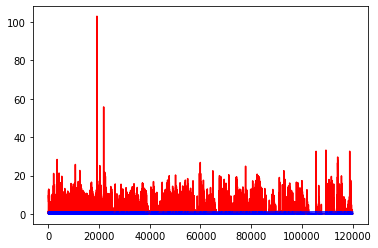

white ratio : 53.75
min : 177
max : 228


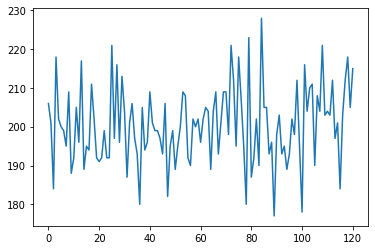

Generating interpolations...
120001 [D loss: 0.000983, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120002 [D loss: 0.004790, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120004 [D loss: 0.004775, acc.: 100.00%] [G loss: 0.000009, 0.000003]
120005 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000007, 0.000001]
120006 [D loss: 0.000210, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120007 [D loss: 0.001067, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120009 [D loss: 0.000608, acc.: 100.00%] [G loss: 0.000003, 0.000022]
120010 [D loss: 0.008926, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120011 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000000, 0.000001]
120012 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120013 [D loss: 0.000672, acc.: 100.00%] [G loss: 0.000002, 0.000068]
120014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0

120116 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000015]
120117 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.000004, 0.000319]
120118 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000001, 0.000000]
120119 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120120 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.070130, 0.006795]
120121 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.001202, 0.000190]
120122 [D loss: 0.001120, acc.: 100.00%] [G loss: 0.004099, 0.044046]
120123 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000037, 0.000035]
120124 [D loss: 0.001701, acc.: 100.00%] [G loss: 0.002759, 0.000158]
120125 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120126 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120128 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120129 [D loss: 0.026799, acc.: 96.88%] [G loss: 0.036135, 0.000493]
120130 [D loss: 0.000

120234 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000394, 0.000000]
120235 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.016775, 0.030328]
120236 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.007800, 0.055366]
120237 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.695434, 0.747995]
120238 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000015, 0.000009]
120240 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000025, 0.000004]
120241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120242 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000008, 0.000001]
120243 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.046643, 0.008380]
120244 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.038907, 0.049026]
120245 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.006324, 0.082915]
120246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001894, 0.000620]
120247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000449, 0.000003]
120248 [D loss: 0.00

120352 [D loss: 0.002219, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120353 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002516, 0.002095]
120354 [D loss: 0.007004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120355 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000001]
120356 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120357 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000076, 0.000063]
120358 [D loss: 0.000648, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120359 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000017, 0.000005]
120360 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120361 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.000120, 0.000065]
120362 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120363 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120364 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120365 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000000, 0.000002]
120366 [D loss: 0.00

120470 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004251, 0.000408]
120471 [D loss: 0.000773, acc.: 100.00%] [G loss: 7.290680, 6.296916]
120472 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.810925, 0.849316]
120473 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.801934, 4.137102]
120474 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.712662, 0.296354]
120475 [D loss: 0.000453, acc.: 100.00%] [G loss: 3.479136, 3.778082]
120476 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.228216, 0.299382]
120477 [D loss: 0.000857, acc.: 100.00%] [G loss: 3.090305, 2.415548]
120478 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001662, 0.026034]
120479 [D loss: 0.002673, acc.: 100.00%] [G loss: 3.704585, 2.333227]
120480 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.056680, 1.173094]
120481 [D loss: 0.004124, acc.: 100.00%] [G loss: 0.275347, 0.533463]
120482 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.820060, 1.275153]
120483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000044, 0.000092]
120484 [D loss: 0.00

120591 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000172, 0.038083]
120592 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.002718, 0.008838]
120593 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120594 [D loss: 0.000976, acc.: 100.00%] [G loss: 0.020353, 0.034563]
120595 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.004602, 0.008207]
120596 [D loss: 0.000083, acc.: 100.00%] [G loss: 2.290476, 2.881163]
120597 [D loss: 0.000485, acc.: 100.00%] [G loss: 0.937854, 0.786496]
120598 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.063863, 0.786483]
120599 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.000122, 0.000018]
120600 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.039667, 0.104825]
120601 [D loss: 0.001131, acc.: 100.00%] [G loss: 0.196932, 0.395729]
120602 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000208, 0.000309]
120603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120604 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.000001, 0.000000]
120605 [D loss: 0.00

120711 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.253221, 0.119586]
120712 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.234899, 2.196478]
120713 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.084997, 1.606383]
120714 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.285616, 0.002985]
120715 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.221880, 0.385061]
120716 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.149255, 0.008783]
120717 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.228551, 0.956756]
120718 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.133923, 0.217975]
120719 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000003]
120720 [D loss: 0.000710, acc.: 100.00%] [G loss: 0.158342, 0.219836]
120721 [D loss: 0.000000, acc.: 100.00%] [G loss: 26.322834, 3.190154]
120722 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.553571, 0.553370]
120723 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.955687, 0.908479]
120724 [D loss: 0.000047, acc.: 100.00%] [G loss: 2.919924, 1.402034]
120725 [D loss: 0.0

120829 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.007281, 0.003513]
120830 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.001256, 0.000173]
120831 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.000417, 0.000026]
120832 [D loss: 0.001240, acc.: 100.00%] [G loss: 0.000002, 0.000000]
120833 [D loss: 0.001251, acc.: 100.00%] [G loss: 0.111134, 0.278433]
120834 [D loss: 0.000342, acc.: 100.00%] [G loss: 0.206018, 0.119723]
120835 [D loss: 0.000271, acc.: 100.00%] [G loss: 0.000692, 0.007257]
120836 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.080180, 0.217623]
120837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.088337, 0.058517]
120838 [D loss: 0.000455, acc.: 100.00%] [G loss: 0.000003, 0.000007]
120839 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.033088, 0.004173]
120840 [D loss: 0.000074, acc.: 100.00%] [G loss: 6.901162, 0.417589]
120841 [D loss: 0.001162, acc.: 100.00%] [G loss: 0.002706, 0.041157]
120842 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.062761, 0.035388]
120843 [D loss: 0.00

120950 [D loss: 0.002420, acc.: 100.00%] [G loss: 0.249300, 0.443980]
120951 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000003, 0.000002]
120952 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.172513, 0.000000]
120953 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000000, 0.000001]
120954 [D loss: 0.000445, acc.: 100.00%] [G loss: 0.000013, 0.000081]
120955 [D loss: 0.000332, acc.: 100.00%] [G loss: 0.004058, 0.007859]
120956 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.010442, 0.003022]
120957 [D loss: 0.007412, acc.: 100.00%] [G loss: 0.000042, 0.000000]
120958 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.000008, 0.000003]
120959 [D loss: 0.000667, acc.: 100.00%] [G loss: 0.010934, 0.000546]
120960 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.000000, 0.000000]
120961 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000366, 0.000342]
120962 [D loss: 0.000426, acc.: 100.00%] [G loss: 0.000174, 0.000160]
120963 [D loss: 0.001861, acc.: 100.00%] [G loss: 0.373597, 0.013039]
120964 [D loss: 0.00

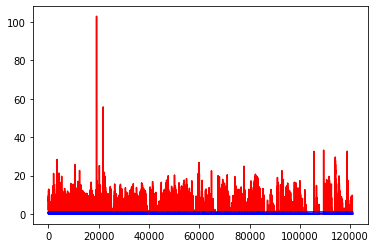

white ratio : 50.25
min : 177
max : 228


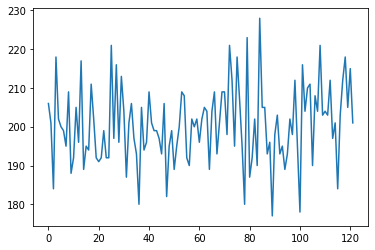

Generating interpolations...
121001 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.622320, 0.001322]
121002 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.032289, 0.090674]
121003 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003132, 0.002953]
121005 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.187278, 0.126270]
121006 [D loss: 0.298415, acc.: 96.88%] [G loss: 0.000006, 0.000000]
121007 [D loss: 0.001318, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121008 [D loss: 0.000270, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121010 [D loss: 0.006801, acc.: 100.00%] [G loss: 0.001065, 0.000282]
121011 [D loss: 0.002619, acc.: 100.00%] [G loss: 0.007409, 0.017348]
121012 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121013 [D loss: 0.000304, acc.: 100.00%] [G loss: 0.000421, 0.000890]
121014 [D loss: 0.000610, acc.: 100.00%] [G loss: 0.000000, 0.

121119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.317763, 0.379673]
121120 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.139054, 0.221945]
121121 [D loss: 0.000015, acc.: 100.00%] [G loss: 2.417870, 0.054373]
121122 [D loss: 0.001318, acc.: 100.00%] [G loss: 1.186945, 0.940879]
121123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000430, 0.000149]
121124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002792, 0.039405]
121125 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.189910, 1.586511]
121126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000087, 0.000016]
121127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000312, 0.000148]
121128 [D loss: 0.065556, acc.: 96.88%] [G loss: 0.000207, 0.000011]
121129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000301, 0.003792]
121130 [D loss: 0.084570, acc.: 96.88%] [G loss: 0.000168, 0.000008]
121131 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000070, 0.000261]
121132 [D loss: 0.001181, acc.: 100.00%] [G loss: 0.000016, 0.000049]
121133 [D loss: 0.0000

121239 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.392942, 0.139806]
121240 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.005775, 0.022996]
121241 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000072, 0.000112]
121242 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000017, 0.000000]
121243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121244 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.004557, 0.093522]
121245 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.000373, 0.001816]
121246 [D loss: 0.003869, acc.: 100.00%] [G loss: 0.000004, 0.000001]
121247 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.716440, 0.176124]
121248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000014, 0.000235]
121249 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.019439, 0.000004]
121250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001190, 0.000059]
121251 [D loss: 0.000499, acc.: 100.00%] [G loss: 0.000136, 0.000111]
121252 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000014, 0.000012]
121253 [D loss: 0.00

121357 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000982, 0.002048]
121358 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.000009, 0.000021]
121359 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000658, 0.000473]
121360 [D loss: 0.010182, acc.: 100.00%] [G loss: 0.000000, 0.000001]
121361 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000628, 0.003351]
121362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003334, 0.000084]
121363 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000108, 0.000044]
121364 [D loss: 0.027657, acc.: 96.88%] [G loss: 0.040801, 0.000390]
121365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121368 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000001, 0.000000]
121369 [D loss: 0.000532, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121370 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000001, 0.000000]
121371 [D loss: 0.000

121477 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121478 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000027, 0.000021]
121479 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.007050, 0.043760]
121480 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000084, 0.024353]
121481 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000833, 0.000137]
121482 [D loss: 0.000587, acc.: 100.00%] [G loss: 0.001799, 0.000301]
121483 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.000036, 0.000008]
121484 [D loss: 0.000689, acc.: 100.00%] [G loss: 0.000004, 0.000012]
121485 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000005, 0.000004]
121486 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.004994, 0.000137]
121487 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121488 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.006530, 0.052730]
121489 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000001]
121490 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121491 [D loss: 0.00

121596 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000096, 0.004137]
121597 [D loss: 0.005252, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121598 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000073, 0.000000]
121600 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121601 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.023970, 0.006930]
121602 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
121604 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121606 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.014416, 0.002455]
121607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121608 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000006]
121610 [D loss: 0.00

121717 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.008983, 0.001308]
121718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001036, 0.000300]
121719 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000002]
121720 [D loss: 0.002334, acc.: 100.00%] [G loss: 0.000001, 0.000005]
121721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000054, 0.000818]
121722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000000]
121723 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000142, 0.000000]
121724 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000000, 0.000292]
121725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000015, 0.000003]
121726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000000]
121728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000000]
121729 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000002, 0.000000]
121730 [D loss: 0.004316, acc.: 100.00%] [G loss: 0.000615, 0.000004]
121731 [D loss: 0.00

121836 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000008, 0.000001]
121837 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000006, 0.000000]
121838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000096, 0.001991]
121839 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.034430, 0.009468]
121840 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001499, 0.001871]
121841 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000066, 0.001045]
121842 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000001, 0.000002]
121843 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000107]
121844 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000005, 0.000000]
121845 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121846 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000374, 0.000020]
121847 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000011, 0.000033]
121848 [D loss: 0.000626, acc.: 100.00%] [G loss: 0.000016, 0.001186]
121849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000000]
121850 [D loss: 0.00

121954 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000053, 0.000006]
121955 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000008, 0.082159]
121956 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000049, 0.000034]
121957 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000006, 0.000001]
121958 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000008]
121959 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121960 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121961 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121963 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000002, 0.000002]
121964 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000006, 0.000004]
121965 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000003]
121966 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
121967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
121968 [D loss: 0.00

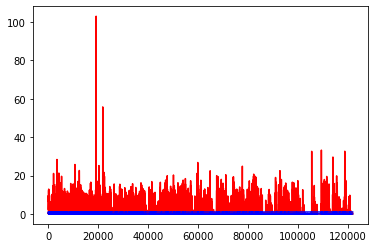

white ratio : 47.25
min : 177
max : 228


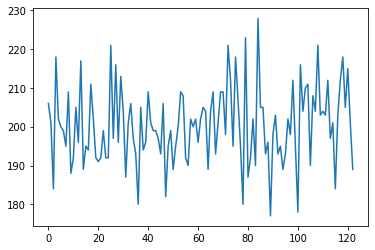

Generating interpolations...
122001 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000004]
122003 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122004 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122008 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122009 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000019, 0.000003]
122010 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000101, 0.000000]
122012 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000013, 0.000000]
122013 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122014 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000000, 0

122119 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122120 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122121 [D loss: 0.000270, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122122 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122123 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000720, 0.003195]
122125 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122127 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122128 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000002]
122129 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000005, 0.000120]
122130 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122132 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.002218, 0.002088]
122133 [D loss: 0.00

122239 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000024, 0.000000]
122240 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000001]
122242 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000000, 0.000110]
122243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005463, 0.001014]
122244 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122245 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000001, 0.000007]
122246 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000001, 0.000000]
122247 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000780, 0.000140]
122248 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122249 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122250 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122251 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122252 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000025, 0.000003]
122253 [D loss: 0.00

122359 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.102635, 0.089825]
122360 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.016988, 0.028838]
122361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.222556, 0.020832]
122362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.070434, 0.064539]
122363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.090805, 0.162973]
122364 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.289785, 2.963539]
122365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.322860, 0.142784]
122366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025829, 0.092596]
122367 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.045777, 4.218706]
122368 [D loss: 0.000581, acc.: 100.00%] [G loss: 0.147114, 0.010846]
122369 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.108904, 0.008457]
122370 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.010348, 0.054992]
122371 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.880809, 5.253904]
122372 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.004590, 0.029599]
122373 [D loss: 0.00

122478 [D loss: 0.000770, acc.: 100.00%] [G loss: 0.000047, 0.000026]
122479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000005]
122480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000655]
122482 [D loss: 0.027379, acc.: 96.88%] [G loss: 0.000478, 0.027106]
122483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.202304, 0.030895]
122484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000418, 0.000614]
122485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000075, 0.000057]
122486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001206, 0.023541]
122487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000060, 0.002483]
122488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000781, 0.000684]
122489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.076289, 0.094256]
122490 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.009680, 0.117616]
122491 [D loss: 0.002508, acc.: 100.00%] [G loss: 0.000004, 0.000026]
122492 [D loss: 0.000

122598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000002]
122599 [D loss: 0.004597, acc.: 100.00%] [G loss: 0.000002, 0.000000]
122600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000003]
122601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009337, 0.000061]
122602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.258434, 0.713716]
122603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000000]
122604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.321652, 0.058915]
122605 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000016]
122606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000162, 0.000104]
122607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.324723, 0.493713]
122608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
122609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000038]
122610 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.513008, 0.123978]
122611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
122612 [D loss: 0.00

122716 [D loss: 0.063638, acc.: 96.88%] [G loss: 0.000012, 0.000018]
122717 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122719 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122720 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122721 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000045, 0.000005]
122722 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122723 [D loss: 0.001248, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122724 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122725 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000000]
122726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122727 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122728 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122729 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122730 [D loss: 0.000

122836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010896, 0.000006]
122837 [D loss: 0.001619, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122838 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122839 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122840 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122842 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
122843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122844 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122845 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000003, 0.000002]
122846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122848 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000336]
122849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122850 [D loss: 0.00

122956 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000813, 0.000000]
122957 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000006, 0.000019]
122958 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122959 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122960 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122961 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122962 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122963 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122964 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000004, 0.000001]
122965 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000003]
122966 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000000]
122967 [D loss: 0.025384, acc.: 96.88%] [G loss: 0.000000, 0.000000]
122968 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122969 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
122970 [D loss: 0.000

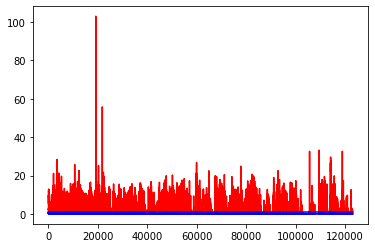

white ratio : 49.25
min : 177
max : 228


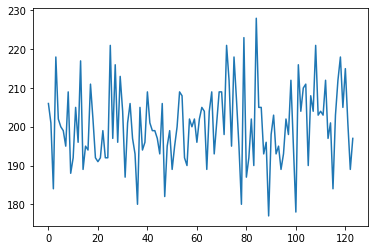

Generating interpolations...
123001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123002 [D loss: 0.000976, acc.: 100.00%] [G loss: 0.000001, 0.000000]
123003 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000181, 0.000604]
123004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123005 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123007 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000001]
123008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000089, 0.001297]
123009 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123010 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123011 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000004]
123012 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000019, 0.000003]
123013 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123014 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0

123119 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123120 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123121 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000038, 0.000001]
123122 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.225212, 0.000038]
123123 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123125 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.000053]
123126 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123127 [D loss: 0.004672, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000010, 0.000004]
123130 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123131 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000591, 0.000009]
123132 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000002, 0.000000]
123133 [D loss: 0.00

123240 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000006, 0.000009]
123241 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000001]
123242 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000108]
123243 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123244 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.000151, 0.000000]
123245 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000014, 0.001113]
123247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000006, 0.000000]
123249 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123251 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123252 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123253 [D loss: 0.000639, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123254 [D loss: 0.00

123360 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.000059, 0.000024]
123361 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123362 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000001, 0.000001]
123363 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123364 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000144]
123365 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123366 [D loss: 0.000786, acc.: 100.00%] [G loss: 0.000002, 0.000004]
123367 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123368 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001510, 0.000001]
123369 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123370 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000001, 0.000000]
123371 [D loss: 0.000529, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123372 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123373 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123374 [D loss: 0.00

123480 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123481 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123482 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000003]
123483 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.001398, 0.002214]
123484 [D loss: 0.018941, acc.: 100.00%] [G loss: 0.001437, 0.000006]
123485 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123486 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000265, 0.011197]
123487 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000057, 0.001076]
123488 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123489 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.000072, 0.057463]
123490 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123491 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123492 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000001]
123493 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123494 [D loss: 0.00

123600 [D loss: 0.000899, acc.: 100.00%] [G loss: 0.000026, 0.000687]
123601 [D loss: 0.000335, acc.: 100.00%] [G loss: 0.000569, 0.000140]
123602 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000001, 0.000000]
123603 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.013734, 0.000055]
123604 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000024]
123605 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.003058, 0.116246]
123606 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123607 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001199, 0.000046]
123608 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123609 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000001, 0.000472]
123610 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123611 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.193410, 0.063253]
123612 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.070673, 0.009221]
123613 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.081391, 0.000338]
123614 [D loss: 0.00

123718 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000164, 0.002383]
123719 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000161, 0.000077]
123720 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123721 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123722 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123723 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.000533, 0.000048]
123724 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123725 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000003, 0.000000]
123726 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123727 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123728 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123729 [D loss: 0.000957, acc.: 100.00%] [G loss: 0.000000, 0.000000]
123730 [D loss: 0.021086, acc.: 100.00%] [G loss: 0.039752, 0.002082]
123731 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000798, 0.000014]
123732 [D loss: 0.00

123836 [D loss: 0.000031, acc.: 100.00%] [G loss: 11.450578, 11.352067]
123837 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.616073, 12.093330]
123838 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.059591, 10.958227]
123839 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.581228, 8.797785]
123840 [D loss: 0.000000, acc.: 100.00%] [G loss: 20.763393, 10.622355]
123841 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.066147, 10.811668]
123842 [D loss: 0.000527, acc.: 100.00%] [G loss: 11.468161, 10.898249]
123843 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.731608, 8.875416]
123844 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.934599, 12.193832]
123845 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.789650, 0.732520]
123846 [D loss: 0.016831, acc.: 100.00%] [G loss: 1.920474, 1.518147]
123847 [D loss: 0.000086, acc.: 100.00%] [G loss: 2.484497, 2.406446]
123848 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.846045, 0.618941]
123849 [D loss: 0.000009, acc.: 100.00%] [G loss: 37.218880, 5.509696]
1238

123953 [D loss: 0.000228, acc.: 100.00%] [G loss: 1.014720, 0.526540]
123954 [D loss: 0.001047, acc.: 100.00%] [G loss: 3.144271, 1.307216]
123955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.932113, 0.228050]
123956 [D loss: 0.000486, acc.: 100.00%] [G loss: 0.110731, 0.114294]
123957 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000829, 0.002571]
123958 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.085368, 0.009497]
123959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001347, 0.080002]
123960 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.550486, 0.158557]
123961 [D loss: 0.001545, acc.: 100.00%] [G loss: 0.144022, 0.218789]
123962 [D loss: 0.000440, acc.: 100.00%] [G loss: 0.000346, 0.000267]
123963 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.221632, 0.125810]
123964 [D loss: 0.001173, acc.: 100.00%] [G loss: 0.000075, 0.000236]
123965 [D loss: 0.000633, acc.: 100.00%] [G loss: 0.001920, 0.023688]
123966 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000011, 0.000181]
123967 [D loss: 0.00

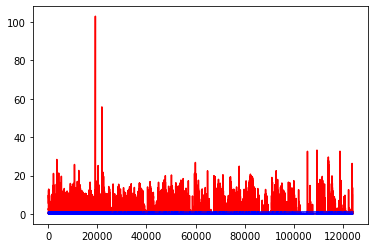

white ratio : 48.25
min : 177
max : 228


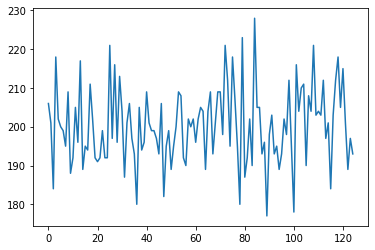

Generating interpolations...
124001 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000175, 0.000001]
124002 [D loss: 0.004191, acc.: 100.00%] [G loss: 0.000000, 0.000002]
124003 [D loss: 0.001901, acc.: 100.00%] [G loss: 0.000003, 0.000000]
124004 [D loss: 0.000701, acc.: 100.00%] [G loss: 0.017461, 0.001523]
124005 [D loss: 0.000326, acc.: 100.00%] [G loss: 1.645161, 2.015332]
124006 [D loss: 0.011079, acc.: 100.00%] [G loss: 0.045983, 0.001848]
124007 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.001168, 0.000010]
124008 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.001693, 0.003301]
124009 [D loss: 0.000619, acc.: 100.00%] [G loss: 0.000427, 0.000366]
124010 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.017458, 0.028853]
124011 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000000, 0.000000]
124012 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.094917, 0.116682]
124013 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.152667, 0.020914]
124014 [D loss: 0.000593, acc.: 100.00%] [G loss: 0.004503, 0

124121 [D loss: 0.000243, acc.: 100.00%] [G loss: 52.027374, 3.584700]
124122 [D loss: 0.000126, acc.: 100.00%] [G loss: 5.041174, 5.524509]
124123 [D loss: 0.003069, acc.: 100.00%] [G loss: 6.138861, 5.060213]
124124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.324822, 0.084672]
124125 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.751311, 1.505503]
124126 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.812004, 0.586148]
124127 [D loss: 0.022790, acc.: 96.88%] [G loss: 0.729059, 0.174120]
124128 [D loss: 0.002523, acc.: 100.00%] [G loss: 0.167081, 0.475721]
124129 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.946910, 0.643821]
124130 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.515004, 0.133850]
124131 [D loss: 0.003388, acc.: 100.00%] [G loss: 0.183424, 0.006417]
124132 [D loss: 0.000499, acc.: 100.00%] [G loss: 0.024726, 0.000452]
124133 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.660486, 0.691162]
124134 [D loss: 0.002571, acc.: 100.00%] [G loss: 0.293218, 0.225658]
124135 [D loss: 0.00

124239 [D loss: 0.000032, acc.: 100.00%] [G loss: 2.582391, 1.720805]
124240 [D loss: 0.000394, acc.: 100.00%] [G loss: 0.058598, 0.027399]
124241 [D loss: 0.000576, acc.: 100.00%] [G loss: 0.212571, 0.238004]
124242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.051261, 0.194534]
124243 [D loss: 0.005007, acc.: 100.00%] [G loss: 12.883059, 2.663078]
124244 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.839478, 6.417467]
124245 [D loss: 0.000176, acc.: 100.00%] [G loss: 4.788987, 5.246863]
124246 [D loss: 0.000153, acc.: 100.00%] [G loss: 6.055887, 4.485686]
124247 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.928900, 1.344270]
124248 [D loss: 0.000800, acc.: 100.00%] [G loss: 0.379934, 0.555759]
124249 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.843578, 0.718764]
124250 [D loss: 0.000806, acc.: 100.00%] [G loss: 3.066066, 1.407200]
124251 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.841012, 1.117904]
124252 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.989205, 0.827290]
124253 [D loss: 0.0

124356 [D loss: 0.040262, acc.: 96.88%] [G loss: 10.000354, 9.137323]
124357 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.953539, 11.237696]
124358 [D loss: 0.000313, acc.: 100.00%] [G loss: 8.290619, 8.501252]
124359 [D loss: 0.010088, acc.: 100.00%] [G loss: 7.188143, 6.662324]
124360 [D loss: 0.000048, acc.: 100.00%] [G loss: 3.344283, 3.144589]
124361 [D loss: 0.000149, acc.: 100.00%] [G loss: 5.183981, 4.241907]
124362 [D loss: 0.063838, acc.: 96.88%] [G loss: 1.606269, 0.616453]
124363 [D loss: 0.000228, acc.: 100.00%] [G loss: 1.010078, 1.275381]
124364 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.298615, 4.071290]
124365 [D loss: 0.010414, acc.: 100.00%] [G loss: 8.164640, 10.595671]
124366 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.775188, 7.176146]
124367 [D loss: 0.005962, acc.: 100.00%] [G loss: 26.331093, 4.089386]
124368 [D loss: 0.001563, acc.: 100.00%] [G loss: 6.539686, 5.215358]
124369 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.444502, 9.138386]
124370 [D loss: 

124474 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.766012, 0.977744]
124475 [D loss: 0.000074, acc.: 100.00%] [G loss: 3.881236, 5.717881]
124476 [D loss: 0.000342, acc.: 100.00%] [G loss: 8.266303, 9.572106]
124477 [D loss: 0.000537, acc.: 100.00%] [G loss: 8.859983, 9.330858]
124478 [D loss: 0.001161, acc.: 100.00%] [G loss: 3.899348, 2.562503]
124479 [D loss: 0.001051, acc.: 100.00%] [G loss: 1.084037, 0.992609]
124480 [D loss: 0.000194, acc.: 100.00%] [G loss: 4.265026, 3.519129]
124481 [D loss: 0.000589, acc.: 100.00%] [G loss: 0.429753, 0.251300]
124482 [D loss: 0.000204, acc.: 100.00%] [G loss: 3.832615, 2.998080]
124483 [D loss: 0.000609, acc.: 100.00%] [G loss: 5.295015, 4.258945]
124484 [D loss: 0.000832, acc.: 100.00%] [G loss: 23.606215, 7.831659]
124485 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.658718, 10.431026]
124486 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.193732, 8.152659]
124487 [D loss: 0.039445, acc.: 96.88%] [G loss: 6.173512, 5.675007]
124488 [D loss: 0.

124591 [D loss: 0.000088, acc.: 100.00%] [G loss: 5.889813, 6.751776]
124592 [D loss: 0.000467, acc.: 100.00%] [G loss: 13.852638, 12.402124]
124593 [D loss: 0.000100, acc.: 100.00%] [G loss: 6.179198, 5.748534]
124594 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.479082, 1.495506]
124595 [D loss: 0.000042, acc.: 100.00%] [G loss: 4.056662, 2.821913]
124596 [D loss: 0.000541, acc.: 100.00%] [G loss: 0.001251, 0.000551]
124597 [D loss: 0.004043, acc.: 100.00%] [G loss: 12.573317, 3.376249]
124598 [D loss: 0.015999, acc.: 100.00%] [G loss: 0.518867, 0.812027]
124599 [D loss: 0.004945, acc.: 100.00%] [G loss: 4.744951, 3.596534]
124600 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.428560, 1.500510]
124601 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.271557, 1.126884]
124602 [D loss: 0.001453, acc.: 100.00%] [G loss: 0.009806, 0.122301]
124603 [D loss: 0.001367, acc.: 100.00%] [G loss: 3.154714, 3.912199]
124604 [D loss: 0.003337, acc.: 100.00%] [G loss: 0.582542, 0.015135]
124605 [D loss: 0

124709 [D loss: 0.001261, acc.: 100.00%] [G loss: 0.255396, 0.290975]
124710 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.554994, 0.456994]
124711 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.774313, 2.758728]
124712 [D loss: 0.000043, acc.: 100.00%] [G loss: 4.853127, 3.776721]
124713 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.928708, 0.640320]
124714 [D loss: 0.000428, acc.: 100.00%] [G loss: 3.407090, 9.900194]
124715 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.121103, 9.020000]
124716 [D loss: 0.002909, acc.: 100.00%] [G loss: 8.468536, 7.955976]
124717 [D loss: 0.000013, acc.: 100.00%] [G loss: 12.551123, 9.489200]
124718 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.443129, 7.196417]
124719 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.832779, 3.265892]
124720 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.303336, 4.749662]
124721 [D loss: 0.053255, acc.: 96.88%] [G loss: 0.485154, 0.045276]
124722 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.983390, 0.253168]
124723 [D loss: 0.00

124828 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.685111, 1.255368]
124829 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.063877, 0.393293]
124830 [D loss: 0.003136, acc.: 100.00%] [G loss: 3.908171, 2.634459]
124831 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.127494, 0.043350]
124832 [D loss: 0.000182, acc.: 100.00%] [G loss: 0.625548, 0.338482]
124833 [D loss: 0.000779, acc.: 100.00%] [G loss: 0.705447, 0.893679]
124834 [D loss: 0.000232, acc.: 100.00%] [G loss: 7.245193, 1.348992]
124835 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000065, 0.000129]
124836 [D loss: 0.058943, acc.: 96.88%] [G loss: 1.960279, 1.354079]
124837 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.006118, 0.014136]
124838 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.727855, 0.262175]
124839 [D loss: 0.005057, acc.: 100.00%] [G loss: 2.570121, 1.278506]
124840 [D loss: 0.002576, acc.: 100.00%] [G loss: 0.026800, 0.097141]
124841 [D loss: 0.006041, acc.: 100.00%] [G loss: 0.244448, 0.076668]
124842 [D loss: 0.000

124948 [D loss: 0.062317, acc.: 96.88%] [G loss: 2.657590, 3.089931]
124949 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.035842, 2.337522]
124950 [D loss: 0.001624, acc.: 100.00%] [G loss: 6.051370, 5.692995]
124951 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.235971, 9.328488]
124952 [D loss: 0.000049, acc.: 100.00%] [G loss: 27.362713, 2.915967]
124953 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.995090, 1.980101]
124954 [D loss: 0.000967, acc.: 100.00%] [G loss: 27.972794, 11.204341]
124955 [D loss: 0.000007, acc.: 100.00%] [G loss: 15.199618, 9.632003]
124956 [D loss: 0.012050, acc.: 100.00%] [G loss: 13.057367, 11.724683]
124957 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.071370, 6.560868]
124958 [D loss: 0.013464, acc.: 100.00%] [G loss: 6.397008, 4.292049]
124959 [D loss: 0.000008, acc.: 100.00%] [G loss: 10.553405, 11.313023]
124960 [D loss: 0.000115, acc.: 100.00%] [G loss: 3.824911, 2.409429]
124961 [D loss: 0.000032, acc.: 100.00%] [G loss: 12.784859, 6.195780]
124962 [D lo

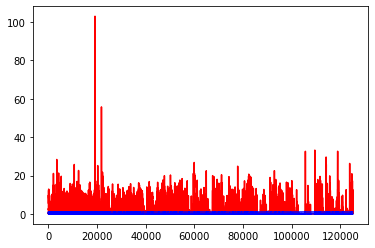

white ratio : 50.5
min : 177
max : 228


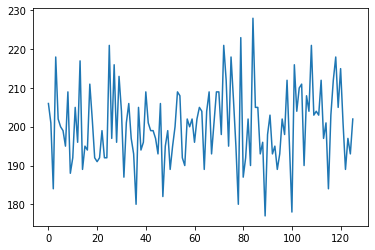

Generating interpolations...
125001 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.484917, 2.512899]
125002 [D loss: 0.000053, acc.: 100.00%] [G loss: 2.375432, 0.689656]
125003 [D loss: 0.000301, acc.: 100.00%] [G loss: 1.990902, 3.087390]
125004 [D loss: 0.000031, acc.: 100.00%] [G loss: 2.383457, 2.505463]
125005 [D loss: 0.009492, acc.: 100.00%] [G loss: 0.288092, 0.081322]
125006 [D loss: 0.000006, acc.: 100.00%] [G loss: 32.110474, 2.124021]
125007 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.496113, 0.526532]
125008 [D loss: 0.001716, acc.: 100.00%] [G loss: 1.208386, 0.437507]
125009 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.778983, 0.473321]
125010 [D loss: 0.000003, acc.: 100.00%] [G loss: 24.439041, 1.937879]
125011 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.688911, 2.254906]
125012 [D loss: 0.009955, acc.: 100.00%] [G loss: 7.966596, 5.598601]
125013 [D loss: 0.000318, acc.: 100.00%] [G loss: 2.386131, 3.659117]
125014 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.181531,

125115 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.002780, 0.034619]
125116 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.388240, 0.093311]
125117 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.070642, 0.009821]
125118 [D loss: 0.016718, acc.: 100.00%] [G loss: 0.665406, 1.150968]
125119 [D loss: 0.000170, acc.: 100.00%] [G loss: 2.252276, 2.311174]
125120 [D loss: 0.000090, acc.: 100.00%] [G loss: 1.162727, 0.188581]
125121 [D loss: 0.000481, acc.: 100.00%] [G loss: 0.520568, 0.284673]
125122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.515512, 0.319670]
125123 [D loss: 0.000369, acc.: 100.00%] [G loss: 0.733505, 0.502424]
125124 [D loss: 0.005722, acc.: 100.00%] [G loss: 0.170979, 0.001187]
125125 [D loss: 0.000356, acc.: 100.00%] [G loss: 2.548713, 1.446813]
125126 [D loss: 0.000046, acc.: 100.00%] [G loss: 9.105257, 0.199304]
125127 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.792805, 1.015036]
125128 [D loss: 0.000345, acc.: 100.00%] [G loss: 1.955352, 1.551018]
125129 [D loss: 0.00

125234 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.998903, 5.350087]
125235 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.025325, 6.471155]
125236 [D loss: 0.000339, acc.: 100.00%] [G loss: 7.855259, 6.568198]
125237 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.594158, 10.057108]
125238 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.269714, 6.044415]
125239 [D loss: 0.000055, acc.: 100.00%] [G loss: 9.301082, 9.089992]
125240 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.016833, 6.641965]
125241 [D loss: 0.000191, acc.: 100.00%] [G loss: 2.565562, 2.072438]
125242 [D loss: 0.006184, acc.: 100.00%] [G loss: 5.021535, 4.298664]
125243 [D loss: 0.007151, acc.: 100.00%] [G loss: 3.398133, 3.320922]
125244 [D loss: 0.000227, acc.: 100.00%] [G loss: 3.345942, 2.505324]
125245 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.330051, 2.391056]
125246 [D loss: 0.009388, acc.: 100.00%] [G loss: 11.789597, 4.458873]
125247 [D loss: 0.079331, acc.: 96.88%] [G loss: 9.796291, 10.934540]
125248 [D loss: 0

125351 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.566297, 4.146570]
125352 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.792726, 9.790058]
125353 [D loss: 0.000020, acc.: 100.00%] [G loss: 8.064270, 7.292764]
125354 [D loss: 0.000025, acc.: 100.00%] [G loss: 4.631282, 4.851756]
125355 [D loss: 0.000014, acc.: 100.00%] [G loss: 8.590033, 7.616070]
125356 [D loss: 0.000015, acc.: 100.00%] [G loss: 11.018991, 8.769175]
125357 [D loss: 0.000016, acc.: 100.00%] [G loss: 6.720487, 5.458611]
125358 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.568489, 2.598789]
125359 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.701800, 0.520151]
125360 [D loss: 0.000050, acc.: 100.00%] [G loss: 4.981718, 1.557791]
125361 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.403113, 5.218350]
125362 [D loss: 0.000089, acc.: 100.00%] [G loss: 10.555883, 10.565801]
125363 [D loss: 0.033485, acc.: 96.88%] [G loss: 7.368959, 6.362532]
125364 [D loss: 0.000453, acc.: 100.00%] [G loss: 5.490701, 5.313944]
125365 [D loss: 0.

125469 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.193278, 5.474388]
125470 [D loss: 0.000327, acc.: 100.00%] [G loss: 5.486001, 4.760217]
125471 [D loss: 0.000012, acc.: 100.00%] [G loss: 9.387932, 7.844671]
125472 [D loss: 0.000129, acc.: 100.00%] [G loss: 8.019915, 7.253684]
125473 [D loss: 0.001029, acc.: 100.00%] [G loss: 0.854577, 0.961180]
125474 [D loss: 0.000015, acc.: 100.00%] [G loss: 6.799281, 6.689778]
125475 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.814134, 2.962426]
125476 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.323827, 0.158140]
125477 [D loss: 0.000032, acc.: 100.00%] [G loss: 28.999084, 4.738752]
125478 [D loss: 0.003169, acc.: 100.00%] [G loss: 0.788929, 0.925137]
125479 [D loss: 0.000149, acc.: 100.00%] [G loss: 11.729716, 9.558405]
125480 [D loss: 0.000002, acc.: 100.00%] [G loss: 15.794981, 16.409733]
125481 [D loss: 0.000026, acc.: 100.00%] [G loss: 14.296046, 13.653293]
125482 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.618631, 6.683610]
125483 [D loss

125587 [D loss: 0.000035, acc.: 100.00%] [G loss: 8.057141, 5.572103]
125588 [D loss: 0.000005, acc.: 100.00%] [G loss: 22.504976, 13.073885]
125589 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.528221, 4.138512]
125590 [D loss: 0.000006, acc.: 100.00%] [G loss: 22.003531, 4.717965]
125591 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.204980, 7.082539]
125592 [D loss: 0.000323, acc.: 100.00%] [G loss: 5.299525, 4.471297]
125593 [D loss: 0.000063, acc.: 100.00%] [G loss: 6.905929, 5.804869]
125594 [D loss: 0.000316, acc.: 100.00%] [G loss: 7.385280, 5.504426]
125595 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.147078, 4.870011]
125596 [D loss: 0.000101, acc.: 100.00%] [G loss: 3.332935, 3.917362]
125597 [D loss: 0.000009, acc.: 100.00%] [G loss: 6.598822, 5.482498]
125598 [D loss: 0.000090, acc.: 100.00%] [G loss: 1.295702, 3.002661]
125599 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.351680, 7.347771]
125600 [D loss: 0.000143, acc.: 100.00%] [G loss: 4.873221, 5.305611]
125601 [D loss: 0

125706 [D loss: 0.000002, acc.: 100.00%] [G loss: 16.221975, 3.224242]
125707 [D loss: 0.000018, acc.: 100.00%] [G loss: 7.512892, 7.703175]
125708 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.246286, 0.919828]
125709 [D loss: 0.000924, acc.: 100.00%] [G loss: 7.823481, 3.968259]
125710 [D loss: 0.000011, acc.: 100.00%] [G loss: 43.197407, 5.271726]
125711 [D loss: 0.000005, acc.: 100.00%] [G loss: 10.259035, 7.893087]
125712 [D loss: 0.000002, acc.: 100.00%] [G loss: 14.122930, 12.835613]
125713 [D loss: 0.000048, acc.: 100.00%] [G loss: 4.727434, 3.810360]
125714 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.880444, 5.047106]
125715 [D loss: 0.000024, acc.: 100.00%] [G loss: 5.776284, 3.536084]
125716 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.662940, 3.330392]
125717 [D loss: 0.000028, acc.: 100.00%] [G loss: 2.480259, 2.297056]
125718 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.015974, 2.943970]
125719 [D loss: 0.000189, acc.: 100.00%] [G loss: 8.524254, 6.286147]
125720 [D loss

125824 [D loss: 0.001412, acc.: 100.00%] [G loss: 6.167912, 5.401122]
125825 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.740663, 5.076060]
125826 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.707585, 3.626477]
125827 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.758945, 6.334823]
125828 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.339388, 11.310261]
125829 [D loss: 0.000000, acc.: 100.00%] [G loss: 24.440516, 8.694826]
125830 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.831566, 6.371159]
125831 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.139404, 7.923789]
125832 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.715546, 7.703448]
125833 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.044054, 9.767842]
125834 [D loss: 0.000382, acc.: 100.00%] [G loss: 6.752312, 6.735340]
125835 [D loss: 0.000018, acc.: 100.00%] [G loss: 12.504184, 12.869507]
125836 [D loss: 0.000013, acc.: 100.00%] [G loss: 11.599879, 10.157076]
125837 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.393492, 9.868182]
125838 [D los

125944 [D loss: 0.000043, acc.: 100.00%] [G loss: 37.109493, 7.175529]
125945 [D loss: 0.000002, acc.: 100.00%] [G loss: 17.496487, 18.082922]
125946 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.589447, 9.116123]
125947 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.051702, 4.543431]
125948 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.811303, 8.859322]
125949 [D loss: 0.000342, acc.: 100.00%] [G loss: 7.100149, 7.958990]
125950 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.248956, 5.431009]
125951 [D loss: 0.000089, acc.: 100.00%] [G loss: 4.959536, 4.155285]
125952 [D loss: 0.000543, acc.: 100.00%] [G loss: 6.127099, 5.042991]
125953 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.092136, 7.620314]
125954 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.180319, 5.633628]
125955 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.115638, 14.729095]
125956 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.476105, 7.404861]
125957 [D loss: 0.000149, acc.: 100.00%] [G loss: 7.224891, 7.286654]
125958 [D loss

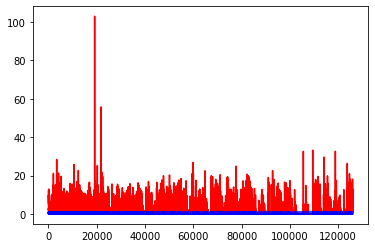

white ratio : 46.5
min : 177
max : 228


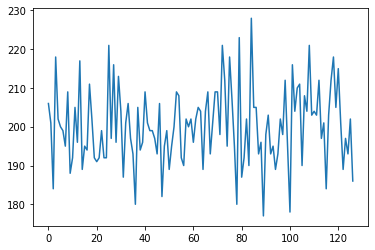

Generating interpolations...
126001 [D loss: 0.010902, acc.: 100.00%] [G loss: 0.978385, 0.168198]
126002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.176897, 0.077732]
126003 [D loss: 0.000378, acc.: 100.00%] [G loss: 0.716414, 0.620582]
126004 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.471640, 1.196729]
126005 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.762418, 0.638368]
126006 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.350649, 0.044153]
126007 [D loss: 0.000629, acc.: 100.00%] [G loss: 1.068490, 1.332142]
126008 [D loss: 0.001007, acc.: 100.00%] [G loss: 0.771196, 1.043833]
126009 [D loss: 0.005410, acc.: 100.00%] [G loss: 0.565923, 0.328407]
126010 [D loss: 0.000184, acc.: 100.00%] [G loss: 5.636039, 1.971754]
126011 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.591396, 1.917665]
126012 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.339087, 1.496929]
126013 [D loss: 0.000020, acc.: 100.00%] [G loss: 15.773589, 2.760473]
126014 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.539973, 

126119 [D loss: 0.000094, acc.: 100.00%] [G loss: 2.823377, 2.233927]
126120 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.979742, 3.288130]
126121 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.282129, 0.994866]
126122 [D loss: 0.000035, acc.: 100.00%] [G loss: 10.038964, 2.139099]
126123 [D loss: 0.000039, acc.: 100.00%] [G loss: 4.162440, 4.848418]
126124 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.907558, 1.318440]
126125 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.754298, 1.700484]
126126 [D loss: 0.000048, acc.: 100.00%] [G loss: 10.335492, 9.406558]
126127 [D loss: 0.000216, acc.: 100.00%] [G loss: 2.733290, 3.153856]
126128 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.642369, 0.387763]
126129 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.932013, 0.244824]
126130 [D loss: 0.000038, acc.: 100.00%] [G loss: 2.134745, 1.169896]
126131 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.604049, 3.372833]
126132 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.637520, 1.787153]
126133 [D loss: 0.

126238 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.993114, 12.765287]
126239 [D loss: 0.000257, acc.: 100.00%] [G loss: 5.378970, 4.718092]
126240 [D loss: 0.000010, acc.: 100.00%] [G loss: 13.368672, 13.533859]
126241 [D loss: 0.001690, acc.: 100.00%] [G loss: 10.930572, 10.723419]
126242 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.311549, 9.644391]
126243 [D loss: 0.000031, acc.: 100.00%] [G loss: 11.323329, 12.277878]
126244 [D loss: 0.000045, acc.: 100.00%] [G loss: 10.912737, 11.837086]
126245 [D loss: 0.000037, acc.: 100.00%] [G loss: 9.941852, 10.781996]
126246 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.644573, 8.756497]
126247 [D loss: 0.000021, acc.: 100.00%] [G loss: 10.275786, 10.072132]
126248 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.650527, 7.076784]
126249 [D loss: 0.000023, acc.: 100.00%] [G loss: 7.899724, 6.143460]
126250 [D loss: 0.000011, acc.: 100.00%] [G loss: 5.839149, 4.733705]
126251 [D loss: 0.000003, acc.: 100.00%] [G loss: 34.451385, 8.513338]
126252

126357 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.184607, 6.578999]
126358 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.871779, 5.625753]
126359 [D loss: 0.000057, acc.: 100.00%] [G loss: 5.260948, 4.320228]
126360 [D loss: 0.000112, acc.: 100.00%] [G loss: 5.163677, 5.284950]
126361 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.244053, 5.895850]
126362 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.147774, 9.960137]
126363 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.052430, 4.331856]
126364 [D loss: 0.000009, acc.: 100.00%] [G loss: 29.096157, 5.100950]
126365 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.141007, 11.339420]
126366 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.402246, 8.945358]
126367 [D loss: 0.000024, acc.: 100.00%] [G loss: 10.447260, 9.509802]
126368 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.054486, 9.083961]
126369 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.951838, 9.868071]
126370 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.903443, 7.044985]
126371 [D loss:

126476 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.756374, 6.553695]
126477 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.769246, 6.694235]
126478 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.432652, 14.119199]
126479 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.869358, 8.538789]
126480 [D loss: 0.000010, acc.: 100.00%] [G loss: 9.062304, 9.266907]
126481 [D loss: 0.000004, acc.: 100.00%] [G loss: 12.101034, 7.380197]
126482 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.154915, 8.346502]
126483 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.083066, 5.070673]
126484 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.719967, 7.719279]
126485 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.173044, 11.681900]
126486 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.922745, 9.676368]
126487 [D loss: 0.020567, acc.: 100.00%] [G loss: 1.484489, 2.057474]
126488 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.922119, 6.784807]
126489 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.893224, 2.106387]
126490 [D los

126596 [D loss: 0.000449, acc.: 100.00%] [G loss: 14.259480, 15.864447]
126597 [D loss: 0.000019, acc.: 100.00%] [G loss: 15.953261, 14.290939]
126598 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.382491, 13.150887]
126599 [D loss: 0.000134, acc.: 100.00%] [G loss: 16.499268, 15.860098]
126600 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.954411, 13.625097]
126601 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.017697, 13.094268]
126602 [D loss: 0.000011, acc.: 100.00%] [G loss: 15.266521, 9.919017]
126603 [D loss: 0.000452, acc.: 100.00%] [G loss: 9.563027, 9.920734]
126604 [D loss: 0.000081, acc.: 100.00%] [G loss: 6.510089, 11.182169]
126605 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.883691, 8.026928]
126606 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.313085, 6.146367]
126607 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.213113, 6.370941]
126608 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.660656, 4.390047]
126609 [D loss: 0.000012, acc.: 100.00%] [G loss: 33.836998, 11.183142]
1266

126713 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.431997, 1.515649]
126714 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.264594, 4.998720]
126715 [D loss: 0.000063, acc.: 100.00%] [G loss: 14.073473, 4.277795]
126716 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.619941, 6.806992]
126717 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.002965, 5.828979]
126718 [D loss: 0.000031, acc.: 100.00%] [G loss: 8.290512, 7.467803]
126719 [D loss: 0.000034, acc.: 100.00%] [G loss: 2.967299, 1.585805]
126720 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.163808, 6.889269]
126721 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.293577, 5.420466]
126722 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.357829, 6.194006]
126723 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.553748, 3.460783]
126724 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.633158, 1.844237]
126725 [D loss: 0.000005, acc.: 100.00%] [G loss: 10.520417, 5.755418]
126726 [D loss: 0.000009, acc.: 100.00%] [G loss: 14.559906, 7.340638]
126727 [D loss: 

126830 [D loss: 0.000000, acc.: 100.00%] [G loss: 28.015665, 7.335056]
126831 [D loss: 0.000185, acc.: 100.00%] [G loss: 8.662523, 10.636537]
126832 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.031458, 8.441092]
126833 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.386923, 9.413992]
126834 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.537312, 10.515232]
126835 [D loss: 0.000030, acc.: 100.00%] [G loss: 5.919776, 7.527086]
126836 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.863342, 6.064818]
126837 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.111460, 5.771320]
126838 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.824756, 6.913730]
126839 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.990212, 4.529270]
126840 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.005088, 3.422506]
126841 [D loss: 0.000021, acc.: 100.00%] [G loss: 2.654303, 2.841255]
126842 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.379478, 2.196841]
126843 [D loss: 0.000964, acc.: 100.00%] [G loss: 3.086246, 1.889236]
126844 [D loss: 0

126950 [D loss: 0.002873, acc.: 100.00%] [G loss: 4.084782, 2.881428]
126951 [D loss: 0.000461, acc.: 100.00%] [G loss: 2.835536, 3.676538]
126952 [D loss: 0.000015, acc.: 100.00%] [G loss: 7.400337, 8.912769]
126953 [D loss: 0.000062, acc.: 100.00%] [G loss: 1.401363, 1.840167]
126954 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.609617, 4.490939]
126955 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.624062, 2.503491]
126956 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.586862, 0.795625]
126957 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.822115, 3.021441]
126958 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.122527, 3.119640]
126959 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.597355, 0.916318]
126960 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.945898, 1.281864]
126961 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.223264, 2.661924]
126962 [D loss: 0.000574, acc.: 100.00%] [G loss: 4.264068, 4.230297]
126963 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.458170, 4.962476]
126964 [D loss: 0.00

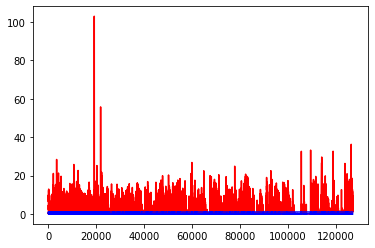

white ratio : 52.0
min : 177
max : 228


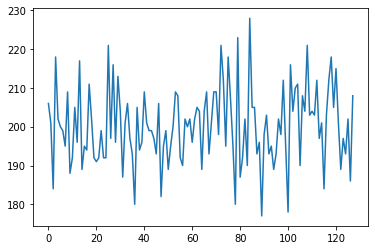

Generating interpolations...
127001 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.694380, 6.592062]
127002 [D loss: 0.000011, acc.: 100.00%] [G loss: 9.472491, 9.654524]
127003 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.628665, 10.512888]
127004 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.372920, 6.362903]
127005 [D loss: 0.000064, acc.: 100.00%] [G loss: 8.434844, 7.316007]
127006 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.316176, 5.107156]
127007 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.920870, 5.953097]
127008 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.398232, 5.760359]
127009 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.975571, 3.493806]
127010 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.965693, 2.691453]
127011 [D loss: 0.000111, acc.: 100.00%] [G loss: 3.103609, 3.634384]
127012 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.047186, 1.387683]
127013 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.278812, 11.960712]
127014 [D loss: 0.000044, acc.: 100.00%] [G loss: 8.143827

127119 [D loss: 0.000009, acc.: 100.00%] [G loss: 12.401252, 5.811028]
127120 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.050831, 6.689635]
127121 [D loss: 0.000044, acc.: 100.00%] [G loss: 4.190177, 4.728504]
127122 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.377775, 1.979307]
127123 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.513550, 2.099265]
127124 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.573709, 7.439545]
127125 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.965757, 9.406549]
127126 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.219107, 8.468716]
127127 [D loss: 0.000153, acc.: 100.00%] [G loss: 10.342189, 11.030838]
127128 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.001507, 11.259918]
127129 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.602721, 9.580795]
127130 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.250904, 7.340734]
127131 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.015027, 5.995057]
127132 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.093327, 12.934240]
127133 [D 

127237 [D loss: 0.000067, acc.: 100.00%] [G loss: 6.307725, 5.234345]
127238 [D loss: 0.000029, acc.: 100.00%] [G loss: 9.899281, 7.066567]
127239 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.270980, 8.873865]
127240 [D loss: 0.000232, acc.: 100.00%] [G loss: 11.275118, 9.696066]
127241 [D loss: 0.000393, acc.: 100.00%] [G loss: 8.835891, 8.571543]
127242 [D loss: 0.000179, acc.: 100.00%] [G loss: 6.895947, 7.963923]
127243 [D loss: 0.001113, acc.: 100.00%] [G loss: 7.407367, 7.510691]
127244 [D loss: 0.000016, acc.: 100.00%] [G loss: 7.719318, 5.203631]
127245 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.436786, 5.653997]
127246 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.526320, 5.695796]
127247 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.308564, 2.417800]
127248 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.928704, 5.858831]
127249 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.332652, 5.270817]
127250 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.627268, 3.755786]
127251 [D loss: 0.

127354 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.432714, 11.499836]
127355 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.133010, 2.453454]
127356 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.760686, 7.254776]
127357 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.255417, 6.486939]
127358 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.605731, 7.972799]
127359 [D loss: 0.000000, acc.: 100.00%] [G loss: 32.975746, 8.214688]
127360 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.404053, 6.221170]
127361 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.877107, 8.359518]
127362 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.843277, 7.005797]
127363 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.192793, 4.635058]
127364 [D loss: 0.000017, acc.: 100.00%] [G loss: 6.033957, 5.783328]
127365 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.969166, 4.327464]
127366 [D loss: 0.000001, acc.: 100.00%] [G loss: 29.821129, 10.059217]
127367 [D loss: 0.000011, acc.: 100.00%] [G loss: 12.407958, 13.529306]
127368 [D lo

127470 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.093562, 6.026240]
127471 [D loss: 0.000095, acc.: 100.00%] [G loss: 8.930801, 7.952028]
127472 [D loss: 0.000000, acc.: 100.00%] [G loss: 20.016088, 10.567602]
127473 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.227585, 6.724842]
127474 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.727342, 8.592155]
127475 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.997668, 10.410007]
127476 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.328793, 6.984314]
127477 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.847555, 6.912340]
127478 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.160725, 7.046735]
127479 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.243208, 5.915749]
127480 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.039259, 8.041668]
127481 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.198011, 9.286792]
127482 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.028310, 11.165077]
127483 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.954656, 3.318830]
127484 [D loss:

127590 [D loss: 0.000009, acc.: 100.00%] [G loss: 10.435940, 3.861780]
127591 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.261493, 1.743612]
127592 [D loss: 0.000024, acc.: 100.00%] [G loss: 6.613701, 6.350416]
127593 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.114849, 8.064447]
127594 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.087420, 10.705488]
127595 [D loss: 0.000036, acc.: 100.00%] [G loss: 5.773030, 6.440333]
127596 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.288670, 6.078635]
127597 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.934853, 13.844973]
127598 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.127286, 3.374851]
127599 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.728265, 10.060638]
127600 [D loss: 0.000018, acc.: 100.00%] [G loss: 9.206833, 5.128139]
127601 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.596736, 6.201293]
127602 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.243492, 8.133062]
127603 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.897026, 10.199872]
127604 [D l

127710 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.783721, 9.984657]
127711 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.733147, 4.569547]
127712 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.839972, 13.030111]
127713 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.081465, 6.101525]
127714 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.485956, 6.162695]
127715 [D loss: 0.000000, acc.: 100.00%] [G loss: 24.870695, 5.873516]
127716 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.492154, 5.127125]
127717 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.153376, 11.298828]
127718 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.826591, 3.997826]
127719 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.341668, 10.862020]
127720 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.616138, 5.473255]
127721 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.988171, 15.590747]
127722 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.356257, 10.435412]
127723 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.817935, 6.068258]
127724 [D

127829 [D loss: 0.000014, acc.: 100.00%] [G loss: 5.358491, 2.177672]
127830 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.803178, 0.830148]
127831 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.980156, 3.007051]
127832 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.546952, 3.890059]
127833 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.699439, 3.662610]
127834 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.544530, 3.750051]
127835 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.276213, 7.075201]
127836 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.126855, 3.253746]
127837 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.802169, 0.482639]
127838 [D loss: 0.000038, acc.: 100.00%] [G loss: 3.624429, 4.596619]
127839 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.517681, 4.555016]
127840 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.067802, 7.207348]
127841 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.353688, 6.213760]
127842 [D loss: 0.000086, acc.: 100.00%] [G loss: 3.557638, 2.664124]
127843 [D loss: 0.0

127947 [D loss: 0.000032, acc.: 100.00%] [G loss: 5.320991, 6.887514]
127948 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.165773, 9.764940]
127949 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.138752, 7.627716]
127950 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.026391, 1.651372]
127951 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.064957, 5.193090]
127952 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.618519, 7.065039]
127953 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.880739, 4.259218]
127954 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.046682, 1.703607]
127955 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.569658, 4.709967]
127956 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.597740, 2.830031]
127957 [D loss: 0.000001, acc.: 100.00%] [G loss: 19.406792, 4.741045]
127958 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.115024, 4.968440]
127959 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.688628, 5.691009]
127960 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.022704, 2.371980]
127961 [D loss: 0.

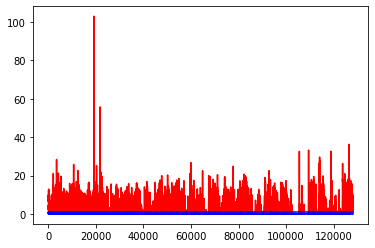

white ratio : 49.25
min : 177
max : 228


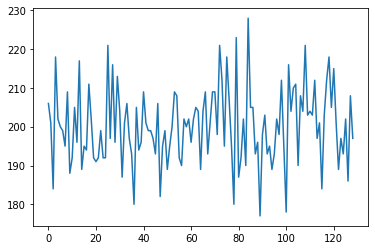

Generating interpolations...
128001 [D loss: 0.067982, acc.: 96.88%] [G loss: 38.534698, 1.256102]
128002 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.116351, 2.735004]
128003 [D loss: 0.002435, acc.: 100.00%] [G loss: 2.374249, 1.848389]
128004 [D loss: 0.002419, acc.: 100.00%] [G loss: 3.942347, 2.008386]
128005 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.968880, 3.144629]
128006 [D loss: 0.000059, acc.: 100.00%] [G loss: 7.841930, 9.897717]
128007 [D loss: 0.000049, acc.: 100.00%] [G loss: 2.424343, 1.731083]
128008 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.743139, 4.511924]
128009 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.713886, 3.073618]
128010 [D loss: 0.000277, acc.: 100.00%] [G loss: 5.737104, 5.157913]
128011 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.102484, 3.772963]
128012 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.474224, 3.504297]
128013 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.636293, 0.313077]
128014 [D loss: 0.000034, acc.: 100.00%] [G loss: 3.481323, 1

128119 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.644655, 1.255249]
128120 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.938351, 3.090940]
128121 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.112591, 3.183218]
128122 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.466277, 8.770751]
128123 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.623765, 1.680233]
128124 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.484652, 5.910756]
128125 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.317269, 5.094941]
128126 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.407067, 6.044746]
128127 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.937824, 3.590301]
128128 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.639055, 3.988924]
128129 [D loss: 0.000013, acc.: 100.00%] [G loss: 6.937705, 7.080574]
128130 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.553786, 2.112538]
128131 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.443778, 4.121075]
128132 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.313133, 3.857222]
128133 [D loss: 0.0

128236 [D loss: 0.000017, acc.: 100.00%] [G loss: 5.044708, 4.513759]
128237 [D loss: 0.000249, acc.: 100.00%] [G loss: 3.753272, 3.505798]
128238 [D loss: 0.000011, acc.: 100.00%] [G loss: 9.325508, 8.524699]
128239 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.349403, 2.358835]
128240 [D loss: 0.002187, acc.: 100.00%] [G loss: 4.662313, 4.004029]
128241 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.861143, 9.393370]
128242 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.326650, 6.369591]
128243 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.328103, 1.992446]
128244 [D loss: 0.001596, acc.: 100.00%] [G loss: 2.611814, 2.625893]
128245 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.551032, 7.097338]
128246 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.391454, 1.860269]
128247 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.607439, 5.444167]
128248 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.231448, 5.402158]
128249 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.524818, 5.906147]
128250 [D loss: 0.0

128354 [D loss: 0.000006, acc.: 100.00%] [G loss: 24.079222, 7.119273]
128355 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.245609, 3.508116]
128356 [D loss: 0.000597, acc.: 100.00%] [G loss: 3.690197, 4.970547]
128357 [D loss: 0.000012, acc.: 100.00%] [G loss: 10.987342, 9.372202]
128358 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.513461, 7.818483]
128359 [D loss: 0.000044, acc.: 100.00%] [G loss: 5.708433, 8.412760]
128360 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.107983, 6.405114]
128361 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.714615, 9.477696]
128362 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.177972, 6.375180]
128363 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.552646, 4.819234]
128364 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.366355, 7.724764]
128365 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.744685, 4.444346]
128366 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.522873, 3.774671]
128367 [D loss: 0.007794, acc.: 100.00%] [G loss: 3.073451, 4.168911]
128368 [D loss: 0.

128471 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.111641, 2.034807]
128472 [D loss: 0.000780, acc.: 100.00%] [G loss: 1.257033, 0.909788]
128473 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.085104, 1.235103]
128474 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.269709, 5.343043]
128475 [D loss: 0.000016, acc.: 100.00%] [G loss: 3.104525, 2.604357]
128476 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.320167, 1.911295]
128477 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.712056, 1.442657]
128478 [D loss: 0.000034, acc.: 100.00%] [G loss: 9.322805, 4.167844]
128479 [D loss: 0.000016, acc.: 100.00%] [G loss: 5.164903, 5.938462]
128480 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.741675, 2.893982]
128481 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.725395, 3.711549]
128482 [D loss: 0.000052, acc.: 100.00%] [G loss: 2.065380, 1.835779]
128483 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.535056, 3.008787]
128484 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.896664, 3.437023]
128485 [D loss: 0.00

128590 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.286100, 3.351995]
128591 [D loss: 0.000357, acc.: 100.00%] [G loss: 2.590124, 3.052239]
128592 [D loss: 0.000262, acc.: 100.00%] [G loss: 2.910417, 2.792940]
128593 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.200864, 3.385595]
128594 [D loss: 0.000043, acc.: 100.00%] [G loss: 7.920053, 4.469356]
128595 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.058265, 3.710604]
128596 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.292329, 3.084630]
128597 [D loss: 0.000033, acc.: 100.00%] [G loss: 3.112938, 1.794104]
128598 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.507456, 2.982092]
128599 [D loss: 0.000112, acc.: 100.00%] [G loss: 1.547969, 1.474106]
128600 [D loss: 0.000109, acc.: 100.00%] [G loss: 5.471363, 3.261186]
128601 [D loss: 0.000034, acc.: 100.00%] [G loss: 3.119021, 2.184355]
128602 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.331354, 2.482945]
128603 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.506242, 1.261489]
128604 [D loss: 0.00

128708 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.154691, 1.100155]
128709 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.300162, 2.810560]
128710 [D loss: 0.000103, acc.: 100.00%] [G loss: 3.755299, 3.197962]
128711 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.043604, 3.126023]
128712 [D loss: 0.009306, acc.: 100.00%] [G loss: 0.567278, 0.866744]
128713 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.873491, 2.267835]
128714 [D loss: 0.000127, acc.: 100.00%] [G loss: 1.877250, 0.448069]
128715 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.233653, 2.277714]
128716 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.007257, 0.944949]
128717 [D loss: 0.000033, acc.: 100.00%] [G loss: 4.273370, 1.448893]
128718 [D loss: 0.000119, acc.: 100.00%] [G loss: 3.119016, 3.077212]
128719 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.065929, 1.953430]
128720 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.160681, 0.795333]
128721 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.361369, 1.554730]
128722 [D loss: 0.00

128826 [D loss: 0.000090, acc.: 100.00%] [G loss: 1.358358, 1.263114]
128827 [D loss: 0.000044, acc.: 100.00%] [G loss: 1.046576, 1.293110]
128828 [D loss: 0.000391, acc.: 100.00%] [G loss: 1.135525, 0.475675]
128829 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.824908, 1.275724]
128830 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.286178, 1.050526]
128831 [D loss: 0.000002, acc.: 100.00%] [G loss: 47.385143, 2.001288]
128832 [D loss: 0.000097, acc.: 100.00%] [G loss: 5.290693, 5.027511]
128833 [D loss: 0.000092, acc.: 100.00%] [G loss: 6.453851, 8.130003]
128834 [D loss: 0.000085, acc.: 100.00%] [G loss: 5.520599, 5.600966]
128835 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.778088, 4.090302]
128836 [D loss: 0.000005, acc.: 100.00%] [G loss: 7.985132, 6.745248]
128837 [D loss: 0.004952, acc.: 100.00%] [G loss: 0.741654, 1.151687]
128838 [D loss: 0.000044, acc.: 100.00%] [G loss: 3.390971, 4.481815]
128839 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.698595, 3.314535]
128840 [D loss: 0.0

128944 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.382757, 1.489764]
128945 [D loss: 0.000039, acc.: 100.00%] [G loss: 3.181015, 4.451162]
128946 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.143424, 2.840086]
128947 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.625168, 2.162368]
128948 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.584318, 2.066288]
128949 [D loss: 0.000975, acc.: 100.00%] [G loss: 1.689738, 1.500725]
128950 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.170251, 1.580689]
128951 [D loss: 0.000062, acc.: 100.00%] [G loss: 5.291280, 4.601312]
128952 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.532132, 2.455569]
128953 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.940696, 2.079149]
128954 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.670943, 2.009250]
128955 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.253392, 1.337722]
128956 [D loss: 0.000170, acc.: 100.00%] [G loss: 5.405015, 1.863912]
128957 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.807230, 4.390365]
128958 [D loss: 0.00

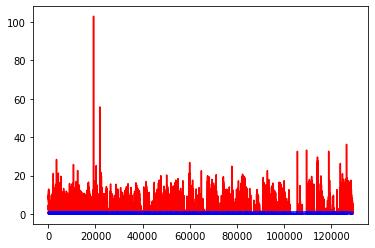

white ratio : 49.25
min : 177
max : 228


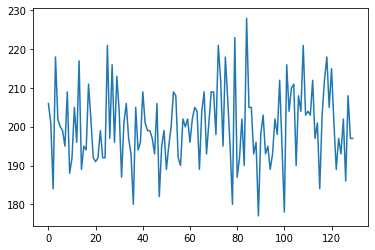

Generating interpolations...
129001 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.893118, 3.924071]
129002 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.166535, 1.592287]
129003 [D loss: 0.068693, acc.: 96.88%] [G loss: 1.095052, 0.353780]
129004 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.436198, 2.477689]
129005 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.711996, 0.341412]
129006 [D loss: 0.000001, acc.: 100.00%] [G loss: 30.269005, 3.211768]
129007 [D loss: 0.000246, acc.: 100.00%] [G loss: 2.374087, 3.487349]
129008 [D loss: 0.000094, acc.: 100.00%] [G loss: 1.267453, 2.145634]
129009 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.634165, 2.388590]
129010 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.468126, 3.455710]
129011 [D loss: 0.000051, acc.: 100.00%] [G loss: 2.530511, 1.523756]
129012 [D loss: 0.000048, acc.: 100.00%] [G loss: 3.589235, 2.485422]
129013 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.669862, 1.406592]
129014 [D loss: 0.005094, acc.: 100.00%] [G loss: 2.231536, 1

129121 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.810301, 5.390029]
129122 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.060511, 7.692793]
129123 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.137975, 5.657968]
129124 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.986098, 8.518068]
129125 [D loss: 0.000067, acc.: 100.00%] [G loss: 6.347259, 4.798666]
129126 [D loss: 0.000057, acc.: 100.00%] [G loss: 4.667407, 5.502661]
129127 [D loss: 0.000030, acc.: 100.00%] [G loss: 6.723076, 5.195407]
129128 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.338351, 5.223547]
129129 [D loss: 0.000046, acc.: 100.00%] [G loss: 2.786793, 2.406440]
129130 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.990268, 3.599821]
129131 [D loss: 0.000014, acc.: 100.00%] [G loss: 5.381133, 3.789578]
129132 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.483658, 1.833600]
129133 [D loss: 0.000354, acc.: 100.00%] [G loss: 3.210286, 3.520936]
129134 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.653461, 5.175830]
129135 [D loss: 0.0

129239 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.023960, 7.449012]
129240 [D loss: 0.068023, acc.: 96.88%] [G loss: 2.937500, 1.814100]
129241 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.134324, 0.335992]
129242 [D loss: 0.010470, acc.: 100.00%] [G loss: 0.765806, 0.103702]
129243 [D loss: 0.000728, acc.: 100.00%] [G loss: 0.600705, 0.518906]
129244 [D loss: 0.000395, acc.: 100.00%] [G loss: 2.550375, 1.578802]
129245 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.468528, 0.172247]
129246 [D loss: 0.000355, acc.: 100.00%] [G loss: 1.440861, 1.497228]
129247 [D loss: 0.000047, acc.: 100.00%] [G loss: 1.917053, 1.529539]
129248 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.981623, 1.320176]
129249 [D loss: 0.000160, acc.: 100.00%] [G loss: 3.826880, 4.834879]
129250 [D loss: 0.000199, acc.: 100.00%] [G loss: 1.317136, 1.546007]
129251 [D loss: 0.000097, acc.: 100.00%] [G loss: 2.264802, 0.921384]
129252 [D loss: 0.001004, acc.: 100.00%] [G loss: 4.070076, 1.060013]
129253 [D loss: 0.003

129360 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.627854, 1.576797]
129361 [D loss: 0.000016, acc.: 100.00%] [G loss: 3.968956, 3.200334]
129362 [D loss: 0.000264, acc.: 100.00%] [G loss: 1.612811, 1.622178]
129363 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.026968, 1.375677]
129364 [D loss: 0.001385, acc.: 100.00%] [G loss: 1.604111, 1.864145]
129365 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.365666, 2.346096]
129366 [D loss: 0.000026, acc.: 100.00%] [G loss: 2.144731, 0.861003]
129367 [D loss: 0.001662, acc.: 100.00%] [G loss: 2.801534, 2.624627]
129368 [D loss: 0.000054, acc.: 100.00%] [G loss: 1.890977, 1.966094]
129369 [D loss: 0.000109, acc.: 100.00%] [G loss: 4.374671, 4.695764]
129370 [D loss: 0.002162, acc.: 100.00%] [G loss: 0.910120, 1.215083]
129371 [D loss: 0.000106, acc.: 100.00%] [G loss: 4.274390, 0.811837]
129372 [D loss: 0.000383, acc.: 100.00%] [G loss: 1.522988, 1.501185]
129373 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.882982, 0.593649]
129374 [D loss: 0.00

129480 [D loss: 0.000023, acc.: 100.00%] [G loss: 4.162585, 2.454238]
129481 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.433340, 3.608570]
129482 [D loss: 0.000061, acc.: 100.00%] [G loss: 3.576493, 1.737738]
129483 [D loss: 0.008081, acc.: 100.00%] [G loss: 0.650726, 1.195083]
129484 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.079205, 1.472207]
129485 [D loss: 0.000066, acc.: 100.00%] [G loss: 4.284057, 2.921711]
129486 [D loss: 0.000034, acc.: 100.00%] [G loss: 7.977919, 3.387849]
129487 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.727042, 4.194147]
129488 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.518539, 1.632048]
129489 [D loss: 0.000018, acc.: 100.00%] [G loss: 6.417359, 3.305458]
129490 [D loss: 0.000110, acc.: 100.00%] [G loss: 1.851129, 1.234230]
129491 [D loss: 0.000260, acc.: 100.00%] [G loss: 1.183751, 1.367223]
129492 [D loss: 0.005106, acc.: 100.00%] [G loss: 1.917026, 1.269406]
129493 [D loss: 0.000050, acc.: 100.00%] [G loss: 3.163405, 3.948383]
129494 [D loss: 0.00

129598 [D loss: 0.000143, acc.: 100.00%] [G loss: 1.025657, 1.046617]
129599 [D loss: 0.000043, acc.: 100.00%] [G loss: 3.079294, 2.203109]
129600 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.771769, 1.084861]
129601 [D loss: 0.124254, acc.: 96.88%] [G loss: 0.130785, 0.552995]
129602 [D loss: 0.005969, acc.: 100.00%] [G loss: 0.461194, 0.309520]
129603 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.776374, 0.312562]
129604 [D loss: 0.005917, acc.: 100.00%] [G loss: 0.964982, 1.502935]
129605 [D loss: 0.007128, acc.: 100.00%] [G loss: 5.441843, 5.832862]
129606 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.705914, 0.523297]
129607 [D loss: 0.000111, acc.: 100.00%] [G loss: 1.126856, 1.131373]
129608 [D loss: 0.065236, acc.: 96.88%] [G loss: 2.686509, 3.657946]
129609 [D loss: 0.000026, acc.: 100.00%] [G loss: 19.380131, 16.579611]
129610 [D loss: 0.000015, acc.: 100.00%] [G loss: 12.724820, 8.846415]
129611 [D loss: 0.000008, acc.: 100.00%] [G loss: 6.852060, 15.091948]
129612 [D loss: 0.

129715 [D loss: 0.000022, acc.: 100.00%] [G loss: 11.459740, 11.489639]
129716 [D loss: 0.000201, acc.: 100.00%] [G loss: 6.686291, 7.781798]
129717 [D loss: 0.000117, acc.: 100.00%] [G loss: 7.725819, 9.849209]
129718 [D loss: 0.000216, acc.: 100.00%] [G loss: 6.995343, 8.391352]
129719 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.746550, 6.967683]
129720 [D loss: 0.000041, acc.: 100.00%] [G loss: 6.984318, 6.206341]
129721 [D loss: 0.000022, acc.: 100.00%] [G loss: 6.856293, 5.058805]
129722 [D loss: 0.000074, acc.: 100.00%] [G loss: 5.780275, 5.949301]
129723 [D loss: 0.000002, acc.: 100.00%] [G loss: 15.060440, 3.288600]
129724 [D loss: 0.029602, acc.: 96.88%] [G loss: 12.329633, 4.966539]
129725 [D loss: 0.000223, acc.: 100.00%] [G loss: 1.775019, 2.051753]
129726 [D loss: 0.000041, acc.: 100.00%] [G loss: 3.219769, 2.937547]
129727 [D loss: 0.007352, acc.: 100.00%] [G loss: 2.981959, 1.673903]
129728 [D loss: 0.004247, acc.: 100.00%] [G loss: 2.045888, 1.332105]
129729 [D loss: 0

129832 [D loss: 0.000545, acc.: 100.00%] [G loss: 2.824492, 2.788864]
129833 [D loss: 0.000053, acc.: 100.00%] [G loss: 1.388634, 1.009606]
129834 [D loss: 0.000012, acc.: 100.00%] [G loss: 11.794398, 6.504456]
129835 [D loss: 0.001684, acc.: 100.00%] [G loss: 13.653015, 2.441269]
129836 [D loss: 0.055129, acc.: 96.88%] [G loss: 1.431781, 0.522156]
129837 [D loss: 0.001845, acc.: 100.00%] [G loss: 18.552692, 3.697588]
129838 [D loss: 0.000191, acc.: 100.00%] [G loss: 2.423057, 1.598917]
129839 [D loss: 0.000441, acc.: 100.00%] [G loss: 3.869496, 3.837377]
129840 [D loss: 0.000431, acc.: 100.00%] [G loss: 1.394571, 3.139024]
129841 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.411666, 1.448384]
129842 [D loss: 0.000498, acc.: 100.00%] [G loss: 1.152788, 0.742492]
129843 [D loss: 0.002322, acc.: 100.00%] [G loss: 2.368296, 1.543996]
129844 [D loss: 0.003398, acc.: 100.00%] [G loss: 1.169698, 1.510803]
129845 [D loss: 0.000083, acc.: 100.00%] [G loss: 2.481113, 1.909433]
129846 [D loss: 0.

129951 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.524588, 2.562619]
129952 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.078406, 1.931591]
129953 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.576018, 5.940471]
129954 [D loss: 0.000019, acc.: 100.00%] [G loss: 8.984938, 2.036381]
129955 [D loss: 0.000061, acc.: 100.00%] [G loss: 6.913213, 6.939870]
129956 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.977744, 2.136944]
129957 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.551075, 2.125643]
129958 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.188108, 2.595012]
129959 [D loss: 0.000173, acc.: 100.00%] [G loss: 7.094564, 6.509167]
129960 [D loss: 0.002318, acc.: 100.00%] [G loss: 1.249133, 1.618574]
129961 [D loss: 0.000137, acc.: 100.00%] [G loss: 4.169462, 3.845738]
129962 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.271407, 1.954791]
129963 [D loss: 0.010423, acc.: 100.00%] [G loss: 0.765551, 1.646475]
129964 [D loss: 0.000029, acc.: 100.00%] [G loss: 7.146453, 0.964084]
129965 [D loss: 0.00

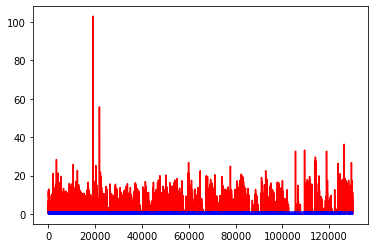

white ratio : 48.0
min : 177
max : 228


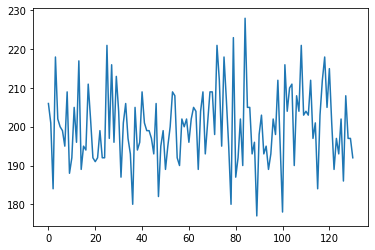

Generating interpolations...
130001 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.313957, 1.037327]
130002 [D loss: 0.000344, acc.: 100.00%] [G loss: 5.374824, 1.222436]
130003 [D loss: 0.000169, acc.: 100.00%] [G loss: 4.693806, 4.299515]
130004 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.846667, 0.899700]
130005 [D loss: 0.004883, acc.: 100.00%] [G loss: 1.949021, 1.848444]
130006 [D loss: 0.000157, acc.: 100.00%] [G loss: 13.240957, 4.666676]
130007 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.385036, 1.236290]
130008 [D loss: 0.000046, acc.: 100.00%] [G loss: 2.249098, 2.046543]
130009 [D loss: 0.000936, acc.: 100.00%] [G loss: 1.373039, 0.627928]
130010 [D loss: 0.000017, acc.: 100.00%] [G loss: 2.602427, 2.026068]
130011 [D loss: 0.001596, acc.: 100.00%] [G loss: 5.134498, 5.283073]
130012 [D loss: 0.000045, acc.: 100.00%] [G loss: 2.517928, 2.379886]
130013 [D loss: 0.052040, acc.: 96.88%] [G loss: 1.646952, 1.602510]
130014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001299, 0

130118 [D loss: 0.000035, acc.: 100.00%] [G loss: 2.608768, 2.132322]
130119 [D loss: 0.000336, acc.: 100.00%] [G loss: 0.228420, 0.043660]
130120 [D loss: 0.000047, acc.: 100.00%] [G loss: 16.089493, 0.528992]
130121 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.682535, 0.838368]
130122 [D loss: 0.000067, acc.: 100.00%] [G loss: 3.519289, 4.520792]
130123 [D loss: 0.022366, acc.: 96.88%] [G loss: 4.089888, 3.606156]
130124 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.329995, 2.474824]
130125 [D loss: 0.002756, acc.: 100.00%] [G loss: 3.501510, 2.703262]
130126 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.307767, 1.066216]
130127 [D loss: 0.000034, acc.: 100.00%] [G loss: 3.069263, 2.344419]
130128 [D loss: 0.000332, acc.: 100.00%] [G loss: 2.264621, 2.230538]
130129 [D loss: 0.000033, acc.: 100.00%] [G loss: 3.660602, 1.814651]
130130 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.843421, 1.083876]
130131 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.088828, 1.580377]
130132 [D loss: 0.00

130237 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.084782, 1.083639]
130238 [D loss: 0.000298, acc.: 100.00%] [G loss: 1.152000, 0.435084]
130239 [D loss: 0.002176, acc.: 100.00%] [G loss: 0.673964, 0.519575]
130240 [D loss: 0.037388, acc.: 96.88%] [G loss: 0.859809, 0.471855]
130241 [D loss: 0.000040, acc.: 100.00%] [G loss: 7.654257, 7.909697]
130242 [D loss: 0.000382, acc.: 100.00%] [G loss: 13.350048, 8.710423]
130243 [D loss: 0.000359, acc.: 100.00%] [G loss: 5.340393, 5.269056]
130244 [D loss: 0.000019, acc.: 100.00%] [G loss: 9.621998, 9.268084]
130245 [D loss: 0.000040, acc.: 100.00%] [G loss: 20.999546, 10.481310]
130246 [D loss: 0.000809, acc.: 100.00%] [G loss: 11.947416, 12.032739]
130247 [D loss: 0.131942, acc.: 96.88%] [G loss: 7.360885, 7.575583]
130248 [D loss: 0.007732, acc.: 100.00%] [G loss: 1.645148, 0.850546]
130249 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.445404, 2.134242]
130250 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.879560, 5.964241]
130251 [D loss: 

130354 [D loss: 0.003439, acc.: 100.00%] [G loss: 0.566068, 0.553133]
130355 [D loss: 0.000252, acc.: 100.00%] [G loss: 3.211061, 2.967600]
130356 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.038134, 0.429659]
130357 [D loss: 0.000441, acc.: 100.00%] [G loss: 0.227267, 0.065251]
130358 [D loss: 0.001102, acc.: 100.00%] [G loss: 1.500798, 1.410280]
130359 [D loss: 0.004753, acc.: 100.00%] [G loss: 0.239078, 0.403604]
130360 [D loss: 0.000432, acc.: 100.00%] [G loss: 0.500143, 0.223397]
130361 [D loss: 0.000118, acc.: 100.00%] [G loss: 0.012619, 0.006118]
130362 [D loss: 0.000315, acc.: 100.00%] [G loss: 1.372294, 1.030157]
130363 [D loss: 0.000500, acc.: 100.00%] [G loss: 1.352210, 1.337179]
130364 [D loss: 0.000051, acc.: 100.00%] [G loss: 39.669735, 1.826934]
130365 [D loss: 0.025536, acc.: 96.88%] [G loss: 2.098668, 2.252452]
130366 [D loss: 0.000243, acc.: 100.00%] [G loss: 1.213767, 0.801437]
130367 [D loss: 0.000516, acc.: 100.00%] [G loss: 3.141044, 2.173020]
130368 [D loss: 0.00

130474 [D loss: 0.000047, acc.: 100.00%] [G loss: 5.501694, 5.933880]
130475 [D loss: 0.000049, acc.: 100.00%] [G loss: 5.240458, 5.707434]
130476 [D loss: 0.000033, acc.: 100.00%] [G loss: 9.112901, 4.099797]
130477 [D loss: 0.000766, acc.: 100.00%] [G loss: 3.172635, 2.046038]
130478 [D loss: 0.000030, acc.: 100.00%] [G loss: 10.736056, 5.696849]
130479 [D loss: 0.000741, acc.: 100.00%] [G loss: 7.786413, 9.350561]
130480 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.611780, 3.263725]
130481 [D loss: 0.000297, acc.: 100.00%] [G loss: 4.452068, 2.885216]
130482 [D loss: 0.000011, acc.: 100.00%] [G loss: 3.249206, 4.018407]
130483 [D loss: 0.000292, acc.: 100.00%] [G loss: 6.421380, 6.054750]
130484 [D loss: 0.001482, acc.: 100.00%] [G loss: 9.018965, 6.863530]
130485 [D loss: 0.000083, acc.: 100.00%] [G loss: 8.931948, 7.651486]
130486 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.961651, 3.064289]
130487 [D loss: 0.000141, acc.: 100.00%] [G loss: 1.258271, 2.250985]
130488 [D loss: 0.0

130592 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.135637, 8.326303]
130593 [D loss: 0.000017, acc.: 100.00%] [G loss: 21.616722, 10.809814]
130594 [D loss: 0.000023, acc.: 100.00%] [G loss: 8.235816, 6.938997]
130595 [D loss: 0.000011, acc.: 100.00%] [G loss: 5.848033, 6.981277]
130596 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.832402, 6.064285]
130597 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.487184, 6.203905]
130598 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.032091, 7.859517]
130599 [D loss: 0.000176, acc.: 100.00%] [G loss: 7.889580, 6.482411]
130600 [D loss: 0.000006, acc.: 100.00%] [G loss: 11.494681, 8.568996]
130601 [D loss: 0.013365, acc.: 100.00%] [G loss: 5.230071, 5.514543]
130602 [D loss: 0.000038, acc.: 100.00%] [G loss: 10.252069, 5.709232]
130603 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.660143, 4.186602]
130604 [D loss: 0.000071, acc.: 100.00%] [G loss: 7.346443, 4.205549]
130605 [D loss: 0.000030, acc.: 100.00%] [G loss: 8.241246, 4.449660]
130606 [D loss: 

130712 [D loss: 0.000048, acc.: 100.00%] [G loss: 4.024414, 2.100235]
130713 [D loss: 0.005361, acc.: 100.00%] [G loss: 1.975441, 3.042919]
130714 [D loss: 0.000229, acc.: 100.00%] [G loss: 3.621159, 1.871288]
130715 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.842931, 2.855227]
130716 [D loss: 0.000008, acc.: 100.00%] [G loss: 28.070728, 3.258371]
130717 [D loss: 0.000111, acc.: 100.00%] [G loss: 1.014942, 1.935723]
130718 [D loss: 0.072968, acc.: 96.88%] [G loss: 0.767966, 0.545605]
130719 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.283443, 8.836452]
130720 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.358952, 1.611670]
130721 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.561952, 6.582295]
130722 [D loss: 0.000253, acc.: 100.00%] [G loss: 7.999823, 8.650721]
130723 [D loss: 0.000640, acc.: 100.00%] [G loss: 7.680097, 9.124853]
130724 [D loss: 0.000038, acc.: 100.00%] [G loss: 10.108842, 11.014782]
130725 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.531513, 3.229165]
130726 [D loss: 0.

130829 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.709264, 1.324791]
130830 [D loss: 0.082009, acc.: 93.75%] [G loss: 0.174254, 0.149208]
130831 [D loss: 0.014399, acc.: 100.00%] [G loss: 0.195474, 0.069892]
130832 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.269801, 0.060076]
130833 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.366275, 0.215523]
130834 [D loss: 0.000061, acc.: 100.00%] [G loss: 1.386698, 0.599845]
130835 [D loss: 0.000167, acc.: 100.00%] [G loss: 1.354842, 1.428768]
130836 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.832914, 1.543597]
130837 [D loss: 0.001741, acc.: 100.00%] [G loss: 1.525778, 0.377856]
130838 [D loss: 0.049260, acc.: 96.88%] [G loss: 0.125847, 0.065320]
130839 [D loss: 0.011460, acc.: 100.00%] [G loss: 0.130059, 0.059161]
130840 [D loss: 0.000641, acc.: 100.00%] [G loss: 0.166238, 0.067925]
130841 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.002730, 0.012119]
130842 [D loss: 0.000041, acc.: 100.00%] [G loss: 2.038152, 1.609971]
130843 [D loss: 0.0001

130946 [D loss: 0.000916, acc.: 100.00%] [G loss: 4.532898, 3.919764]
130947 [D loss: 0.000083, acc.: 100.00%] [G loss: 10.472209, 8.827059]
130948 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.696824, 2.809226]
130949 [D loss: 0.000014, acc.: 100.00%] [G loss: 3.742896, 0.665280]
130950 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.152762, 0.647661]
130951 [D loss: 0.000249, acc.: 100.00%] [G loss: 5.043265, 4.782087]
130952 [D loss: 0.000211, acc.: 100.00%] [G loss: 7.324568, 6.223713]
130953 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.553524, 0.975728]
130954 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.776251, 6.905517]
130955 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.544603, 4.443779]
130956 [D loss: 0.000064, acc.: 100.00%] [G loss: 4.202797, 4.926194]
130957 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.563935, 0.615265]
130958 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.207179, 5.501566]
130959 [D loss: 0.000003, acc.: 100.00%] [G loss: 16.196083, 4.745409]
130960 [D loss: 0.

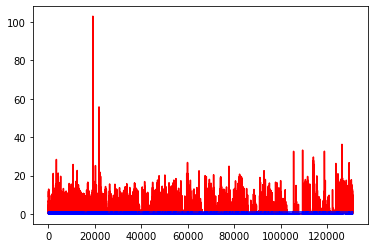

white ratio : 51.0
min : 177
max : 228


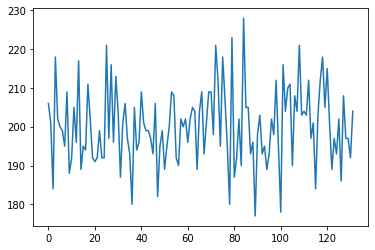

Generating interpolations...
131001 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.676019, 1.760205]
131002 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.284265, 7.042639]
131003 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.109290, 1.199605]
131004 [D loss: 0.000281, acc.: 100.00%] [G loss: 6.451928, 6.966238]
131005 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.411536, 4.602702]
131006 [D loss: 0.000025, acc.: 100.00%] [G loss: 6.869124, 5.856955]
131007 [D loss: 0.001278, acc.: 100.00%] [G loss: 6.139361, 7.686539]
131008 [D loss: 0.000043, acc.: 100.00%] [G loss: 6.477640, 7.613691]
131009 [D loss: 0.000850, acc.: 100.00%] [G loss: 7.671441, 6.341493]
131010 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.353438, 2.337908]
131011 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.747504, 4.196166]
131012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.325967, 0.265234]
131013 [D loss: 0.000063, acc.: 100.00%] [G loss: 4.159404, 3.393492]
131014 [D loss: 0.000039, acc.: 100.00%] [G loss: 5.896539, 6

131118 [D loss: 0.002494, acc.: 100.00%] [G loss: 4.625499, 4.519249]
131119 [D loss: 0.000267, acc.: 100.00%] [G loss: 0.852055, 0.532928]
131120 [D loss: 0.019113, acc.: 100.00%] [G loss: 6.062089, 5.049790]
131121 [D loss: 0.000163, acc.: 100.00%] [G loss: 1.263000, 0.809464]
131122 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.491669, 3.964397]
131123 [D loss: 0.000011, acc.: 100.00%] [G loss: 4.183578, 4.040785]
131124 [D loss: 0.000018, acc.: 100.00%] [G loss: 6.416243, 4.140829]
131125 [D loss: 0.000007, acc.: 100.00%] [G loss: 50.251308, 4.102260]
131126 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.858227, 4.550263]
131127 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.721232, 2.696801]
131128 [D loss: 0.000014, acc.: 100.00%] [G loss: 11.532471, 7.410016]
131129 [D loss: 0.000243, acc.: 100.00%] [G loss: 10.427906, 11.106421]
131130 [D loss: 0.000028, acc.: 100.00%] [G loss: 10.922085, 8.426556]
131131 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.475697, 9.370935]
131132 [D loss

131238 [D loss: 0.000234, acc.: 100.00%] [G loss: 5.441968, 2.135007]
131239 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.986135, 4.220948]
131240 [D loss: 0.026016, acc.: 96.88%] [G loss: 6.269716, 7.052802]
131241 [D loss: 0.000268, acc.: 100.00%] [G loss: 1.487804, 1.087088]
131242 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.043436, 1.893166]
131243 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.905090, 1.306071]
131244 [D loss: 0.000228, acc.: 100.00%] [G loss: 4.440779, 5.027077]
131245 [D loss: 0.002294, acc.: 100.00%] [G loss: 0.560206, 0.514935]
131246 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.299799, 3.533190]
131247 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.838546, 0.749324]
131248 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.647349, 0.238614]
131249 [D loss: 0.000742, acc.: 100.00%] [G loss: 3.818907, 3.810625]
131250 [D loss: 0.000096, acc.: 100.00%] [G loss: 2.958757, 3.712364]
131251 [D loss: 0.000198, acc.: 100.00%] [G loss: 1.466199, 1.022259]
131252 [D loss: 0.000

131356 [D loss: 0.000091, acc.: 100.00%] [G loss: 2.942991, 2.299612]
131357 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.056635, 4.047909]
131358 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.671712, 1.109950]
131359 [D loss: 0.000014, acc.: 100.00%] [G loss: 29.107491, 6.823964]
131360 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.401827, 1.148819]
131361 [D loss: 0.007963, acc.: 100.00%] [G loss: 0.901603, 1.365894]
131362 [D loss: 0.000049, acc.: 100.00%] [G loss: 1.676216, 1.978697]
131363 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.219172, 1.897918]
131364 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.748671, 1.295150]
131365 [D loss: 0.003249, acc.: 100.00%] [G loss: 0.585391, 1.158738]
131366 [D loss: 0.030545, acc.: 96.88%] [G loss: 2.247777, 2.391743]
131367 [D loss: 0.000547, acc.: 100.00%] [G loss: 1.117345, 0.573058]
131368 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.068033, 0.010473]
131369 [D loss: 0.002680, acc.: 100.00%] [G loss: 0.234088, 0.412378]
131370 [D loss: 0.00

131476 [D loss: 0.000613, acc.: 100.00%] [G loss: 2.629252, 3.414226]
131477 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.383905, 1.177604]
131478 [D loss: 0.001253, acc.: 100.00%] [G loss: 1.793519, 2.893525]
131479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016892, 0.111033]
131480 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.993897, 1.304423]
131481 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.273494, 3.268022]
131482 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.825352, 5.129902]
131483 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.170760, 2.179677]
131484 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.284291, 2.595483]
131485 [D loss: 0.040842, acc.: 96.88%] [G loss: 7.855355, 6.970737]
131486 [D loss: 0.000007, acc.: 100.00%] [G loss: 17.684177, 16.755363]
131487 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.428719, 16.444675]
131488 [D loss: 0.000003, acc.: 100.00%] [G loss: 17.564665, 17.945759]
131489 [D loss: 0.000981, acc.: 100.00%] [G loss: 6.893765, 6.647974]
131490 [D loss:

131595 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.585207, 0.366053]
131596 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.884868, 0.430184]
131597 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.364077, 0.593127]
131598 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.135856, 1.405230]
131599 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.182659, 4.392529]
131600 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.714933, 5.957948]
131601 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.766788, 0.373348]
131602 [D loss: 0.000015, acc.: 100.00%] [G loss: 7.068772, 4.818009]
131603 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.988160, 7.190963]
131604 [D loss: 0.001695, acc.: 100.00%] [G loss: 0.751361, 0.966703]
131605 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.487088, 3.766081]
131606 [D loss: 0.000062, acc.: 100.00%] [G loss: 3.762809, 3.461469]
131607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.135335, 0.179299]
131608 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.558133, 0.629894]
131609 [D loss: 0.00

131714 [D loss: 0.000246, acc.: 100.00%] [G loss: 8.253139, 8.111597]
131715 [D loss: 0.028015, acc.: 96.88%] [G loss: 13.187975, 14.253193]
131716 [D loss: 0.000006, acc.: 100.00%] [G loss: 20.293236, 6.323243]
131717 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.036923, 6.087254]
131718 [D loss: 0.016547, acc.: 100.00%] [G loss: 6.297181, 4.393857]
131719 [D loss: 0.000257, acc.: 100.00%] [G loss: 7.953442, 6.418498]
131720 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.887004, 3.693076]
131721 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.011314, 12.281310]
131722 [D loss: 0.000091, acc.: 100.00%] [G loss: 3.771786, 4.247855]
131723 [D loss: 0.075208, acc.: 96.88%] [G loss: 0.426620, 0.074086]
131724 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.127800, 0.146204]
131725 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.053411, 0.156305]
131726 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.701651, 0.763397]
131727 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.068515, 1.401426]
131728 [D loss: 0

131834 [D loss: 0.002543, acc.: 100.00%] [G loss: 2.834935, 1.911022]
131835 [D loss: 0.002570, acc.: 100.00%] [G loss: 2.710184, 1.842202]
131836 [D loss: 0.000042, acc.: 100.00%] [G loss: 1.189253, 0.598415]
131837 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.581061, 0.588068]
131838 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.872173, 0.745607]
131839 [D loss: 0.000022, acc.: 100.00%] [G loss: 3.915716, 3.591487]
131840 [D loss: 0.000036, acc.: 100.00%] [G loss: 6.202359, 6.667793]
131841 [D loss: 0.000068, acc.: 100.00%] [G loss: 2.578762, 1.696278]
131842 [D loss: 0.000010, acc.: 100.00%] [G loss: 10.044107, 6.210766]
131843 [D loss: 0.000078, acc.: 100.00%] [G loss: 9.390998, 7.995139]
131844 [D loss: 0.000468, acc.: 100.00%] [G loss: 0.902502, 1.217587]
131845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.420022, 0.379679]
131846 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.010324, 0.177540]
131847 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.941230, 4.090223]
131848 [D loss: 0.0

131953 [D loss: 0.000091, acc.: 100.00%] [G loss: 3.306411, 2.879083]
131954 [D loss: 0.000014, acc.: 100.00%] [G loss: 4.648898, 3.452806]
131955 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.957347, 4.492483]
131956 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.112746, 2.868106]
131957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.299498, 0.305322]
131958 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.331202, 0.206935]
131959 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.002053, 0.053672]
131960 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.307687, 2.433975]
131961 [D loss: 0.000074, acc.: 100.00%] [G loss: 3.446598, 2.601568]
131962 [D loss: 0.000113, acc.: 100.00%] [G loss: 1.207413, 1.569055]
131963 [D loss: 0.000137, acc.: 100.00%] [G loss: 1.203243, 1.714552]
131964 [D loss: 0.001226, acc.: 100.00%] [G loss: 0.011084, 0.137434]
131965 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.312239, 0.330627]
131966 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.215041, 0.251786]
131967 [D loss: 0.00

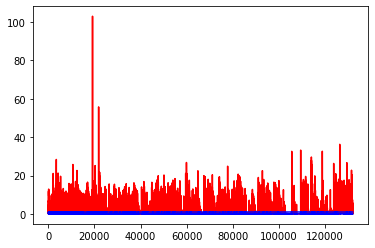

white ratio : 48.25
min : 177
max : 228


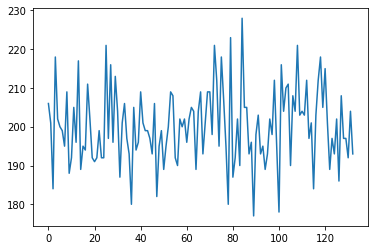

Generating interpolations...
132001 [D loss: 0.000124, acc.: 100.00%] [G loss: 2.643821, 3.357979]
132002 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.883952, 7.973087]
132003 [D loss: 0.000067, acc.: 100.00%] [G loss: 7.581964, 0.600914]
132004 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.055018, 0.007505]
132005 [D loss: 0.000476, acc.: 100.00%] [G loss: 1.991143, 1.310530]
132006 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.020205, 2.517635]
132007 [D loss: 0.000042, acc.: 100.00%] [G loss: 4.093408, 6.551477]
132008 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.760644, 0.130636]
132009 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.315521, 1.870445]
132010 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.678111, 2.311064]
132011 [D loss: 0.001557, acc.: 100.00%] [G loss: 3.069125, 2.272461]
132012 [D loss: 0.000166, acc.: 100.00%] [G loss: 6.418883, 3.784918]
132013 [D loss: 0.000033, acc.: 100.00%] [G loss: 3.335104, 3.675670]
132014 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.901576, 1

132118 [D loss: 0.354977, acc.: 96.88%] [G loss: 0.077033, 0.001055]
132119 [D loss: 0.003516, acc.: 100.00%] [G loss: 3.590109, 3.486567]
132120 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.950276, 1.327849]
132121 [D loss: 0.000070, acc.: 100.00%] [G loss: 3.318082, 2.754948]
132122 [D loss: 0.002706, acc.: 100.00%] [G loss: 3.298970, 2.338641]
132123 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.130309, 0.002519]
132124 [D loss: 0.001409, acc.: 100.00%] [G loss: 4.214702, 3.829106]
132125 [D loss: 0.000482, acc.: 100.00%] [G loss: 1.636971, 1.420697]
132126 [D loss: 0.000225, acc.: 100.00%] [G loss: 3.279002, 0.862339]
132127 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.925635, 1.503704]
132128 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.961332, 3.085607]
132129 [D loss: 0.004540, acc.: 100.00%] [G loss: 2.972166, 3.333089]
132130 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000094, 0.000244]
132131 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.217233, 1.007870]
132132 [D loss: 0.000

132235 [D loss: 0.000194, acc.: 100.00%] [G loss: 1.549738, 1.113176]
132236 [D loss: 0.014065, acc.: 100.00%] [G loss: 2.454014, 4.212237]
132237 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.681035, 3.773459]
132238 [D loss: 0.000960, acc.: 100.00%] [G loss: 6.796752, 4.895251]
132239 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.347789, 0.363239]
132240 [D loss: 0.001126, acc.: 100.00%] [G loss: 0.533787, 0.359939]
132241 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.144501, 7.395613]
132242 [D loss: 0.000021, acc.: 100.00%] [G loss: 6.990258, 5.430580]
132243 [D loss: 0.005157, acc.: 100.00%] [G loss: 4.359922, 5.898817]
132244 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.726112, 1.075081]
132245 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.981421, 9.749780]
132246 [D loss: 0.000159, acc.: 100.00%] [G loss: 1.343803, 1.413162]
132247 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.304726, 10.450523]
132248 [D loss: 0.000004, acc.: 100.00%] [G loss: 12.492823, 8.973375]
132249 [D loss: 0

132354 [D loss: 0.003241, acc.: 100.00%] [G loss: 8.538072, 5.195457]
132355 [D loss: 0.000763, acc.: 100.00%] [G loss: 4.898990, 4.080439]
132356 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.870214, 4.244162]
132357 [D loss: 0.001495, acc.: 100.00%] [G loss: 8.575949, 7.956287]
132358 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.343735, 1.283189]
132359 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.412115, 0.958673]
132360 [D loss: 0.000040, acc.: 100.00%] [G loss: 6.017979, 5.091630]
132361 [D loss: 0.029499, acc.: 96.88%] [G loss: 6.855921, 7.113340]
132362 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.917571, 7.927554]
132363 [D loss: 0.000580, acc.: 100.00%] [G loss: 0.603303, 0.977176]
132364 [D loss: 0.027623, acc.: 96.88%] [G loss: 8.941240, 7.196084]
132365 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.068893, 8.968742]
132366 [D loss: 0.000027, acc.: 100.00%] [G loss: 1.974830, 1.394841]
132367 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.454292, 10.189735]
132368 [D loss: 0.0

132472 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.940920, 4.760157]
132473 [D loss: 0.000061, acc.: 100.00%] [G loss: 4.438818, 3.796916]
132474 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.942027, 2.915541]
132475 [D loss: 0.003071, acc.: 100.00%] [G loss: 0.294561, 0.299846]
132476 [D loss: 0.028280, acc.: 96.88%] [G loss: 7.646467, 6.729539]
132477 [D loss: 0.000001, acc.: 100.00%] [G loss: 15.756966, 15.057024]
132478 [D loss: 0.000007, acc.: 100.00%] [G loss: 12.405424, 12.325013]
132479 [D loss: 0.057556, acc.: 96.88%] [G loss: 3.160933, 3.392444]
132480 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.236848, 1.034884]
132481 [D loss: 0.000165, acc.: 100.00%] [G loss: 10.899448, 5.769503]
132482 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.758889, 11.969811]
132483 [D loss: 0.000016, acc.: 100.00%] [G loss: 15.010210, 1.608128]
132484 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.719638, 6.202700]
132485 [D loss: 0.000020, acc.: 100.00%] [G loss: 3.227832, 2.289119]
132486 [D loss

132590 [D loss: 0.000020, acc.: 100.00%] [G loss: 8.347593, 5.574752]
132591 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.234415, 1.973120]
132592 [D loss: 0.000072, acc.: 100.00%] [G loss: 2.560396, 3.394111]
132593 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.760546, 1.364265]
132594 [D loss: 0.000064, acc.: 100.00%] [G loss: 27.424871, 4.750913]
132595 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.943568, 4.127144]
132596 [D loss: 0.000007, acc.: 100.00%] [G loss: 7.865955, 5.859705]
132597 [D loss: 0.000005, acc.: 100.00%] [G loss: 17.063015, 14.068289]
132598 [D loss: 0.000006, acc.: 100.00%] [G loss: 9.565037, 9.164186]
132599 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.931414, 7.180326]
132600 [D loss: 0.000041, acc.: 100.00%] [G loss: 10.099906, 7.885547]
132601 [D loss: 0.000023, acc.: 100.00%] [G loss: 10.044252, 6.334960]
132602 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.529154, 7.836018]
132603 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.726591, 1.847947]
132604 [D loss:

132707 [D loss: 0.000512, acc.: 100.00%] [G loss: 8.315535, 7.633482]
132708 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.874250, 4.775827]
132709 [D loss: 0.003270, acc.: 100.00%] [G loss: 5.424571, 3.805405]
132710 [D loss: 0.002165, acc.: 100.00%] [G loss: 41.411789, 9.270891]
132711 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.259184, 3.341122]
132712 [D loss: 0.000036, acc.: 100.00%] [G loss: 10.416165, 9.909396]
132713 [D loss: 0.000018, acc.: 100.00%] [G loss: 8.190055, 7.062136]
132714 [D loss: 0.000128, acc.: 100.00%] [G loss: 5.548898, 7.235982]
132715 [D loss: 0.006481, acc.: 100.00%] [G loss: 2.554848, 1.254410]
132716 [D loss: 0.000029, acc.: 100.00%] [G loss: 4.789315, 6.510104]
132717 [D loss: 0.000186, acc.: 100.00%] [G loss: 7.293446, 3.556212]
132718 [D loss: 0.000111, acc.: 100.00%] [G loss: 6.911736, 6.225026]
132719 [D loss: 0.000400, acc.: 100.00%] [G loss: 7.426859, 8.104043]
132720 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.519128, 0.019973]
132721 [D loss: 0.

132825 [D loss: 0.000275, acc.: 100.00%] [G loss: 3.684732, 4.729142]
132826 [D loss: 0.000540, acc.: 100.00%] [G loss: 4.348576, 4.051954]
132827 [D loss: 0.000324, acc.: 100.00%] [G loss: 2.920219, 1.937883]
132828 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.498438, 0.235993]
132829 [D loss: 0.001936, acc.: 100.00%] [G loss: 2.096402, 2.062648]
132830 [D loss: 0.003455, acc.: 100.00%] [G loss: 40.593643, 2.262898]
132831 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.316150, 2.402414]
132832 [D loss: 0.000113, acc.: 100.00%] [G loss: 6.352282, 6.270320]
132833 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.631400, 0.241532]
132834 [D loss: 0.000021, acc.: 100.00%] [G loss: 2.151402, 1.928001]
132835 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.148413, 1.557366]
132836 [D loss: 0.002384, acc.: 100.00%] [G loss: 0.017656, 0.006510]
132837 [D loss: 0.000098, acc.: 100.00%] [G loss: 2.841680, 2.619892]
132838 [D loss: 0.002370, acc.: 100.00%] [G loss: 2.818314, 3.955742]
132839 [D loss: 0.0

132945 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.218438, 1.895087]
132946 [D loss: 0.000010, acc.: 100.00%] [G loss: 4.653687, 4.884295]
132947 [D loss: 0.000731, acc.: 100.00%] [G loss: 0.122969, 0.365288]
132948 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.039057, 0.001588]
132949 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.116909, 4.630866]
132950 [D loss: 0.000007, acc.: 100.00%] [G loss: 6.510572, 5.070760]
132951 [D loss: 0.009566, acc.: 100.00%] [G loss: 12.034483, 10.274563]
132952 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.942725, 2.762616]
132953 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.992172, 4.300107]
132954 [D loss: 0.006848, acc.: 100.00%] [G loss: 3.365458, 3.818385]
132955 [D loss: 0.004765, acc.: 100.00%] [G loss: 3.153037, 3.025811]
132956 [D loss: 0.000061, acc.: 100.00%] [G loss: 5.729411, 5.499533]
132957 [D loss: 0.003120, acc.: 100.00%] [G loss: 3.810977, 2.338460]
132958 [D loss: 0.000023, acc.: 100.00%] [G loss: 3.427097, 3.006844]
132959 [D loss: 0

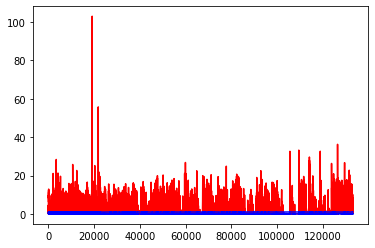

white ratio : 50.25
min : 177
max : 228


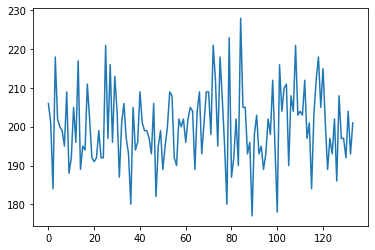

Generating interpolations...
133001 [D loss: 0.020585, acc.: 100.00%] [G loss: 0.767534, 0.834369]
133002 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.694304, 1.239389]
133003 [D loss: 0.005482, acc.: 100.00%] [G loss: 1.055521, 0.743167]
133004 [D loss: 0.004622, acc.: 100.00%] [G loss: 0.146546, 0.524833]
133005 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.173033, 0.147119]
133006 [D loss: 0.000060, acc.: 100.00%] [G loss: 2.022053, 1.472782]
133007 [D loss: 0.052408, acc.: 96.88%] [G loss: 0.987876, 1.160947]
133008 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.176202, 0.254158]
133009 [D loss: 0.000282, acc.: 100.00%] [G loss: 3.111244, 2.141804]
133010 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.083912, 3.116686]
133011 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.013899, 0.069282]
133012 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.275917, 0.047295]
133013 [D loss: 0.000899, acc.: 100.00%] [G loss: 0.358038, 0.909269]
133014 [D loss: 0.001306, acc.: 100.00%] [G loss: 4.107612, 5.

133121 [D loss: 0.001260, acc.: 100.00%] [G loss: 10.031690, 10.210899]
133122 [D loss: 0.002080, acc.: 100.00%] [G loss: 7.571343, 8.023293]
133123 [D loss: 0.157491, acc.: 96.88%] [G loss: 0.605310, 0.433932]
133124 [D loss: 0.049172, acc.: 96.88%] [G loss: 0.507047, 0.634682]
133125 [D loss: 0.083967, acc.: 96.88%] [G loss: 0.921637, 1.299759]
133126 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.193471, 3.830305]
133127 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.127783, 3.027133]
133128 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.692407, 1.118093]
133129 [D loss: 0.002461, acc.: 100.00%] [G loss: 3.064587, 3.122675]
133130 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.402247, 1.090804]
133131 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.094435, 0.455112]
133132 [D loss: 0.001764, acc.: 100.00%] [G loss: 0.536396, 1.295024]
133133 [D loss: 0.000082, acc.: 100.00%] [G loss: 1.110776, 1.111457]
133134 [D loss: 0.001526, acc.: 100.00%] [G loss: 7.873828, 0.129228]
133135 [D loss: 0.000

133239 [D loss: 0.000039, acc.: 100.00%] [G loss: 5.341461, 4.860211]
133240 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.066585, 0.049074]
133241 [D loss: 0.001020, acc.: 100.00%] [G loss: 4.816893, 1.796674]
133242 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.086550, 0.130481]
133243 [D loss: 0.022034, acc.: 96.88%] [G loss: 0.420943, 0.608501]
133244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.640658, 0.405065]
133245 [D loss: 0.000006, acc.: 100.00%] [G loss: 13.709380, 0.508596]
133246 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.343819, 1.009717]
133247 [D loss: 0.001792, acc.: 100.00%] [G loss: 1.429117, 1.643431]
133248 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.304456, 1.675783]
133249 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.832448, 0.920108]
133250 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.147017, 0.069928]
133251 [D loss: 0.061992, acc.: 96.88%] [G loss: 1.279828, 1.071413]
133252 [D loss: 0.000266, acc.: 100.00%] [G loss: 0.210376, 0.007324]
133253 [D loss: 0.011

133358 [D loss: 0.041479, acc.: 96.88%] [G loss: 0.239453, 0.472288]
133359 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.554156, 0.298594]
133360 [D loss: 0.002744, acc.: 100.00%] [G loss: 0.062140, 0.051894]
133361 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.110018, 0.070890]
133362 [D loss: 0.004795, acc.: 100.00%] [G loss: 0.359321, 0.104599]
133363 [D loss: 0.003370, acc.: 100.00%] [G loss: 0.398579, 0.307014]
133364 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.005075, 0.076667]
133365 [D loss: 0.000749, acc.: 100.00%] [G loss: 0.511457, 0.041071]
133366 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000356, 0.005862]
133367 [D loss: 0.105061, acc.: 96.88%] [G loss: 0.009523, 0.022962]
133368 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000363, 0.036744]
133369 [D loss: 0.001303, acc.: 100.00%] [G loss: 0.000072, 0.000193]
133370 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.000471, 0.003879]
133371 [D loss: 0.000743, acc.: 100.00%] [G loss: 0.003044, 0.014785]
133372 [D loss: 0.0027

133475 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.035094, 0.000743]
133476 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.323408, 0.445129]
133477 [D loss: 0.000289, acc.: 100.00%] [G loss: 11.167773, 6.338531]
133478 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.995587, 1.233420]
133479 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.191276, 0.031665]
133480 [D loss: 0.001087, acc.: 100.00%] [G loss: 0.973834, 0.700978]
133481 [D loss: 0.000069, acc.: 100.00%] [G loss: 2.008104, 0.668609]
133482 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.778467, 1.409813]
133483 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.027972, 0.029244]
133484 [D loss: 0.000041, acc.: 100.00%] [G loss: 2.271341, 4.332098]
133485 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.814291, 1.161256]
133486 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.032154, 0.016878]
133487 [D loss: 0.003855, acc.: 100.00%] [G loss: 3.780543, 0.098934]
133488 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.402926, 6.178306]
133489 [D loss: 0.0

133596 [D loss: 0.001059, acc.: 100.00%] [G loss: 0.282303, 0.014172]
133597 [D loss: 0.000010, acc.: 100.00%] [G loss: 9.216396, 1.482659]
133598 [D loss: 0.000911, acc.: 100.00%] [G loss: 2.598228, 1.575002]
133599 [D loss: 0.006045, acc.: 100.00%] [G loss: 0.253277, 0.158184]
133600 [D loss: 0.000637, acc.: 100.00%] [G loss: 0.388525, 0.345607]
133601 [D loss: 0.006833, acc.: 100.00%] [G loss: 1.183319, 1.700513]
133602 [D loss: 0.000273, acc.: 100.00%] [G loss: 0.471384, 0.156292]
133603 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.320858, 0.580454]
133604 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.085364, 0.000000]
133605 [D loss: 0.004996, acc.: 100.00%] [G loss: 2.331492, 1.935267]
133606 [D loss: 0.002455, acc.: 100.00%] [G loss: 0.000064, 0.000013]
133607 [D loss: 0.000401, acc.: 100.00%] [G loss: 1.699761, 1.253930]
133608 [D loss: 0.000758, acc.: 100.00%] [G loss: 0.000917, 0.003340]
133609 [D loss: 0.002374, acc.: 100.00%] [G loss: 0.543415, 0.374515]
133610 [D loss: 0.00

133714 [D loss: 0.000012, acc.: 100.00%] [G loss: 3.970489, 3.670548]
133715 [D loss: 0.029178, acc.: 96.88%] [G loss: 0.002210, 0.000764]
133716 [D loss: 0.004042, acc.: 100.00%] [G loss: 3.991992, 3.543352]
133717 [D loss: 0.002955, acc.: 100.00%] [G loss: 0.689454, 0.728973]
133718 [D loss: 0.000138, acc.: 100.00%] [G loss: 3.200121, 4.675037]
133719 [D loss: 0.000327, acc.: 100.00%] [G loss: 6.480737, 6.729632]
133720 [D loss: 0.000569, acc.: 100.00%] [G loss: 10.485750, 5.025394]
133721 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.000102, 0.000003]
133722 [D loss: 0.000181, acc.: 100.00%] [G loss: 1.332551, 5.143593]
133723 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.090388, 0.172716]
133724 [D loss: 0.001044, acc.: 100.00%] [G loss: 0.005819, 0.000629]
133725 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.005701, 0.000656]
133726 [D loss: 0.046113, acc.: 96.88%] [G loss: 1.411732, 0.795585]
133727 [D loss: 0.000028, acc.: 100.00%] [G loss: 6.234945, 5.560008]
133728 [D loss: 0.002

133832 [D loss: 0.013278, acc.: 100.00%] [G loss: 3.303852, 1.873338]
133833 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.884213, 0.521641]
133834 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.431150, 0.713706]
133835 [D loss: 0.000516, acc.: 100.00%] [G loss: 0.000438, 0.043692]
133836 [D loss: 0.000009, acc.: 100.00%] [G loss: 7.893150, 5.749071]
133837 [D loss: 0.000870, acc.: 100.00%] [G loss: 0.319863, 1.545973]
133838 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.255607, 2.143972]
133839 [D loss: 0.000282, acc.: 100.00%] [G loss: 1.794747, 1.404417]
133840 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.194538, 2.757876]
133841 [D loss: 0.000093, acc.: 100.00%] [G loss: 3.317467, 2.679472]
133842 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.151863, 1.113411]
133843 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.057624, 4.367044]
133844 [D loss: 0.000095, acc.: 100.00%] [G loss: 3.144871, 4.419464]
133845 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.515522, 6.132707]
133846 [D loss: 0.00

133951 [D loss: 0.000284, acc.: 100.00%] [G loss: 2.061148, 1.989981]
133952 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.037508, 3.314952]
133953 [D loss: 0.000099, acc.: 100.00%] [G loss: 5.028374, 4.676430]
133954 [D loss: 0.000270, acc.: 100.00%] [G loss: 4.003326, 3.151155]
133955 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.727418, 4.668450]
133956 [D loss: 0.000519, acc.: 100.00%] [G loss: 1.017555, 1.059148]
133957 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.584292, 4.928250]
133958 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.000975, 0.084594]
133959 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.488221, 2.246608]
133960 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.134921, 0.252696]
133961 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.842000, 0.332647]
133962 [D loss: 0.000120, acc.: 100.00%] [G loss: 9.103571, 5.774082]
133963 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.957584, 4.560352]
133964 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.706417, 0.481937]
133965 [D loss: 0.00

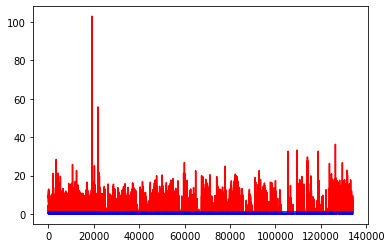

white ratio : 49.75
min : 177
max : 228


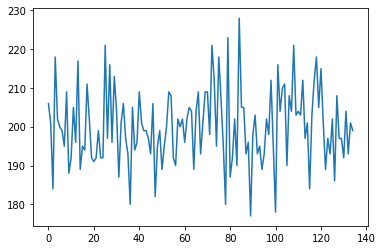

Generating interpolations...
134001 [D loss: 0.000104, acc.: 100.00%] [G loss: 4.407377, 3.525522]
134002 [D loss: 0.000099, acc.: 100.00%] [G loss: 6.330071, 7.004557]
134003 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.000441, 0.001408]
134004 [D loss: 0.000066, acc.: 100.00%] [G loss: 6.393605, 5.105496]
134005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000789, 0.024672]
134006 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.047279, 0.043416]
134007 [D loss: 0.001466, acc.: 100.00%] [G loss: 1.168510, 0.617863]
134008 [D loss: 0.000578, acc.: 100.00%] [G loss: 0.035861, 0.007240]
134009 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.002771, 0.001547]
134010 [D loss: 0.000055, acc.: 100.00%] [G loss: 5.929052, 5.835722]
134011 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.948041, 5.398057]
134012 [D loss: 0.000029, acc.: 100.00%] [G loss: 3.741284, 2.689661]
134013 [D loss: 0.000000, acc.: 100.00%] [G loss: 24.182777, 0.169583]
134014 [D loss: 0.000068, acc.: 100.00%] [G loss: 8.651300, 

134120 [D loss: 0.000073, acc.: 100.00%] [G loss: 2.131462, 0.079687]
134121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.116609, 0.195343]
134122 [D loss: 0.000078, acc.: 100.00%] [G loss: 2.779445, 1.841230]
134123 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.404235, 0.993470]
134124 [D loss: 0.001520, acc.: 100.00%] [G loss: 0.975512, 1.579876]
134125 [D loss: 0.001138, acc.: 100.00%] [G loss: 0.772151, 1.037816]
134126 [D loss: 0.000197, acc.: 100.00%] [G loss: 5.392635, 2.863026]
134127 [D loss: 0.000447, acc.: 100.00%] [G loss: 5.015746, 7.073256]
134128 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.645217, 5.644256]
134129 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.035903, 0.002779]
134130 [D loss: 0.038820, acc.: 96.88%] [G loss: 2.825299, 2.868040]
134131 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.281432, 0.114739]
134132 [D loss: 0.000810, acc.: 100.00%] [G loss: 0.076037, 0.152454]
134133 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.006104, 0.060792]
134134 [D loss: 0.000

134239 [D loss: 0.000049, acc.: 100.00%] [G loss: 1.166139, 1.928395]
134240 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.301759, 1.560520]
134241 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000143, 0.199301]
134242 [D loss: 0.000911, acc.: 100.00%] [G loss: 3.214786, 2.728220]
134243 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.383775, 1.127349]
134244 [D loss: 0.000007, acc.: 100.00%] [G loss: 16.029478, 4.732765]
134245 [D loss: 0.000411, acc.: 100.00%] [G loss: 0.174845, 0.007622]
134246 [D loss: 0.014373, acc.: 100.00%] [G loss: 0.002452, 0.017143]
134247 [D loss: 0.002834, acc.: 100.00%] [G loss: 2.773182, 2.414403]
134248 [D loss: 0.000771, acc.: 100.00%] [G loss: 0.018445, 0.000121]
134249 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.575179, 2.207805]
134250 [D loss: 0.000068, acc.: 100.00%] [G loss: 1.169191, 1.676354]
134251 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.478503, 0.581790]
134252 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.007424, 0.000020]
134253 [D loss: 0.0

134358 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000072, 0.028033]
134359 [D loss: 0.000377, acc.: 100.00%] [G loss: 2.771947, 1.269730]
134360 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000965, 0.000000]
134361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.210959, 0.245716]
134362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.215721, 0.101461]
134363 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.835208, 1.425689]
134364 [D loss: 0.000653, acc.: 100.00%] [G loss: 0.000047, 0.002474]
134365 [D loss: 0.000325, acc.: 100.00%] [G loss: 1.275976, 0.393390]
134366 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.001675, 0.000673]
134367 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.125976, 0.658775]
134368 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.473289, 0.264477]
134369 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001066, 0.145416]
134370 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.010008, 0.000091]
134371 [D loss: 0.000423, acc.: 100.00%] [G loss: 0.000005, 0.000429]
134372 [D loss: 0.00

134477 [D loss: 0.000573, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134478 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134479 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.000370, 0.040005]
134480 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134481 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.038811, 0.013811]
134482 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.028647, 0.450996]
134483 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134484 [D loss: 0.003170, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134485 [D loss: 0.002371, acc.: 100.00%] [G loss: 0.000000, 0.000001]
134486 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.089972, 0.314956]
134487 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134488 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000017]
134489 [D loss: 0.000184, acc.: 100.00%] [G loss: 0.051728, 0.007924]
134490 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.010566, 0.000140]
134491 [D loss: 0.00

134598 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134599 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.166665, 0.000048]
134600 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134601 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.340167, 0.320373]
134602 [D loss: 0.000722, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134603 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000694, 0.003525]
134604 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.120198, 0.172518]
134605 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000342, 0.000333]
134606 [D loss: 0.000289, acc.: 100.00%] [G loss: 0.004603, 0.020330]
134607 [D loss: 0.001610, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134608 [D loss: 0.000485, acc.: 100.00%] [G loss: 0.008092, 0.005831]
134609 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134610 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.000009, 0.003064]
134611 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000035, 0.009297]
134612 [D loss: 0.00

134716 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000002, 0.000000]
134717 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.352966, 0.125643]
134718 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.299425, 0.394522]
134719 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002487, 0.156416]
134720 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.159386, 0.156153]
134721 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.004855, 0.000488]
134722 [D loss: 0.002456, acc.: 100.00%] [G loss: 0.254628, 0.158979]
134723 [D loss: 0.006738, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134724 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.023467, 0.088010]
134725 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000000, 0.000011]
134726 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.141844, 0.115444]
134727 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.141168, 0.061256]
134728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134729 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134730 [D loss: 0.00

134834 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.122229, 0.452128]
134835 [D loss: 0.000063, acc.: 100.00%] [G loss: 1.121156, 1.132975]
134836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.071003, 0.468175]
134837 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.257998, 7.824160]
134838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049714, 0.051392]
134839 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.891133, 1.921947]
134840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000079, 0.000084]
134841 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.012647, 0.103712]
134842 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.053882, 0.230649]
134843 [D loss: 0.205561, acc.: 96.88%] [G loss: 0.001645, 0.003183]
134844 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.011977, 0.000007]
134845 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.056679, 0.694723]
134846 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.712593, 1.090696]
134847 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.029596, 0.161629]
134848 [D loss: 0.000

134953 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.142884, 0.000733]
134954 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.359814, 0.369889]
134955 [D loss: 0.113429, acc.: 96.88%] [G loss: 0.087491, 0.022798]
134956 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.000001, 0.000000]
134957 [D loss: 0.001875, acc.: 100.00%] [G loss: 0.015283, 0.002298]
134958 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.000468, 0.011163]
134959 [D loss: 0.002486, acc.: 100.00%] [G loss: 0.000001, 0.000003]
134960 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.001715, 0.000004]
134961 [D loss: 0.000961, acc.: 100.00%] [G loss: 0.000000, 0.000000]
134962 [D loss: 0.003672, acc.: 100.00%] [G loss: 0.000518, 0.008345]
134963 [D loss: 0.000686, acc.: 100.00%] [G loss: 0.000002, 0.000002]
134964 [D loss: 0.000384, acc.: 100.00%] [G loss: 0.001322, 0.000218]
134965 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000002, 0.000000]
134966 [D loss: 0.001945, acc.: 100.00%] [G loss: 0.000052, 0.000386]
134967 [D loss: 0.000

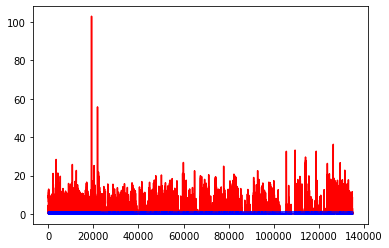

white ratio : 48.25
min : 177
max : 228


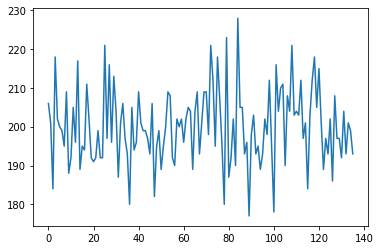

Generating interpolations...
135001 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.001068, 0.000000]
135002 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000008, 0.000002]
135003 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000000, 0.000032]
135004 [D loss: 0.000511, acc.: 100.00%] [G loss: 0.000662, 0.000003]
135005 [D loss: 0.000385, acc.: 100.00%] [G loss: 0.035373, 0.004090]
135006 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.399785, 0.079942]
135007 [D loss: 0.044161, acc.: 96.88%] [G loss: 0.000007, 0.000056]
135008 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.089929, 0.212719]
135009 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.021553, 0.010446]
135010 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.003068, 0.042239]
135011 [D loss: 0.002792, acc.: 100.00%] [G loss: 0.000055, 0.000001]
135012 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.000000, 0.000001]
135013 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000162]
135014 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.011747, 0.

135118 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.045460, 0.085613]
135119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.024892, 0.059692]
135120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021819, 0.022151]
135121 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.024974, 0.420246]
135122 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.000147, 0.008529]
135123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010916, 0.350153]
135124 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.070695, 0.296868]
135125 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.197159, 0.519951]
135126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000094, 0.132629]
135127 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.427121, 0.664071]
135128 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.308440, 0.202092]
135129 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.535543, 0.195864]
135130 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.967015, 1.017448]
135131 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.110496, 0.116696]
135132 [D loss: 0.00

135235 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.894243, 3.918423]
135236 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.358126, 0.504435]
135237 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.268538, 3.335333]
135238 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000422, 0.214810]
135239 [D loss: 0.000700, acc.: 100.00%] [G loss: 0.570552, 0.102276]
135240 [D loss: 0.000103, acc.: 100.00%] [G loss: 5.741190, 6.141920]
135241 [D loss: 0.000139, acc.: 100.00%] [G loss: 2.890450, 1.661388]
135242 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.218515, 1.048971]
135243 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.014093, 0.103777]
135244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039780, 0.167531]
135245 [D loss: 0.000012, acc.: 100.00%] [G loss: 2.759949, 0.835421]
135246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004851, 0.297360]
135247 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.151746, 0.001110]
135248 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.001385, 0.028402]
135249 [D loss: 0.00

135355 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.521087, 0.337668]
135356 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000379, 0.000002]
135357 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135358 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000020, 0.001756]
135359 [D loss: 0.000676, acc.: 100.00%] [G loss: 0.002491, 0.014652]
135360 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.216823, 0.054153]
135361 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000577, 0.001069]
135362 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000149, 0.049923]
135363 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.207509, 0.110742]
135364 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.083753, 0.117987]
135365 [D loss: 0.041401, acc.: 96.88%] [G loss: 0.000060, 0.000007]
135366 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000002, 0.000001]
135367 [D loss: 0.000554, acc.: 100.00%] [G loss: 0.000115, 0.000250]
135368 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135369 [D loss: 0.000

135476 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000003, 0.082523]
135477 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.097608, 0.092049]
135478 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.129998, 0.005242]
135479 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000001]
135480 [D loss: 0.000505, acc.: 100.00%] [G loss: 0.003156, 0.000416]
135481 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135482 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135483 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000002, 0.000024]
135484 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000124, 0.000170]
135485 [D loss: 0.000051, acc.: 100.00%] [G loss: 1.490979, 0.000000]
135486 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.073144, 0.057694]
135487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001548, 0.004408]
135489 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
135490 [D loss: 0.00

135595 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.125656, 0.409073]
135596 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.133520, 0.238531]
135597 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.155417, 0.230776]
135598 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.255558, 0.541312]
135599 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.021996, 0.000026]
135600 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.587018, 0.217913]
135601 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.018025, 0.153433]
135602 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003738, 0.000758]
135603 [D loss: 0.000185, acc.: 100.00%] [G loss: 10.667225, 0.627323]
135604 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.935161, 3.353340]
135605 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.846945, 6.412330]
135606 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.881312, 0.451211]
135607 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.001730, 0.120605]
135608 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.349217, 0.513802]
135609 [D loss: 0.0

135715 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.035784, 0.064943]
135716 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.260033, 0.127946]
135717 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.902660, 0.513286]
135718 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.183196, 0.444863]
135719 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.519202, 1.283962]
135720 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.431917, 0.771985]
135721 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.769305, 2.972693]
135722 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.002584, 0.000014]
135723 [D loss: 0.000323, acc.: 100.00%] [G loss: 2.751763, 2.303128]
135724 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.137090, 0.006591]
135725 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.169634, 0.028682]
135726 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.187290, 0.500132]
135727 [D loss: 0.000065, acc.: 100.00%] [G loss: 1.020486, 1.330366]
135728 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.006054, 0.000009]
135729 [D loss: 0.00

135833 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.117849, 0.000011]
135834 [D loss: 0.007464, acc.: 100.00%] [G loss: 0.086071, 0.143694]
135835 [D loss: 0.000014, acc.: 100.00%] [G loss: 2.412788, 0.179502]
135836 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.023119, 0.006118]
135837 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.742192, 1.194136]
135838 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.196208, 2.645806]
135839 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.170021, 0.843048]
135840 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.004267, 0.456794]
135841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.037282, 0.097438]
135842 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.094017, 0.011889]
135843 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.102834, 0.685849]
135844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.992175, 2.153900]
135845 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.069547, 0.440486]
135846 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.921892, 0.821618]
135847 [D loss: 0.00

135952 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001210, 0.009459]
135953 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.217835, 0.010810]
135954 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.112612, 0.017000]
135955 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.230165, 0.017085]
135956 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.890531, 6.042618]
135957 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.750360, 4.126899]
135958 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.322214, 3.296413]
135959 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.072862, 2.281690]
135960 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.162572, 0.159843]
135961 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.455973, 0.861420]
135962 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.271693, 0.259045]
135963 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.254968, 0.025781]
135964 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.016212, 0.132490]
135965 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.939152, 0.546064]
135966 [D loss: 0.00

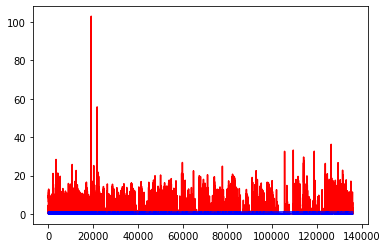

white ratio : 50.0
min : 177
max : 228


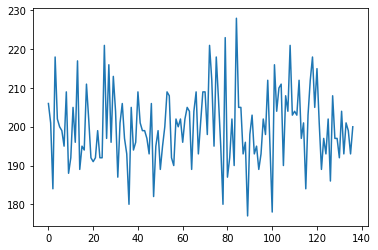

Generating interpolations...
136001 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000058, 0.002149]
136002 [D loss: 0.000499, acc.: 100.00%] [G loss: 0.000000, 0.000045]
136003 [D loss: 0.000244, acc.: 100.00%] [G loss: 0.000001, 0.000027]
136004 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.520846, 0.008237]
136005 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.618199, 0.254972]
136006 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.201572, 0.003656]
136007 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.268000, 0.295575]
136008 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.486912, 0.754806]
136009 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.287291, 0.208343]
136010 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.498061, 0.590866]
136011 [D loss: 0.008866, acc.: 100.00%] [G loss: 0.861209, 1.016175]
136012 [D loss: 0.000112, acc.: 100.00%] [G loss: 22.004025, 8.106581]
136013 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.043458, 4.259179]
136014 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.079162, 

136120 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.006110, 0.145724]
136121 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000115, 0.000023]
136122 [D loss: 0.000081, acc.: 100.00%] [G loss: 1.792767, 1.527235]
136123 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.759482, 1.812273]
136124 [D loss: 0.000174, acc.: 100.00%] [G loss: 3.718400, 3.537885]
136125 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.204138, 0.089050]
136126 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.261316, 0.528628]
136127 [D loss: 0.002156, acc.: 100.00%] [G loss: 3.226724, 3.058540]
136128 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.045818, 0.084620]
136129 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.600007, 0.528257]
136130 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000125, 0.000778]
136131 [D loss: 0.000357, acc.: 100.00%] [G loss: 0.018342, 0.126090]
136132 [D loss: 0.000103, acc.: 100.00%] [G loss: 4.822203, 4.470632]
136133 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.818979, 0.761670]
136134 [D loss: 0.00

136240 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.631415, 0.014473]
136241 [D loss: 0.019180, acc.: 100.00%] [G loss: 0.946797, 1.339041]
136242 [D loss: 0.002693, acc.: 100.00%] [G loss: 1.843108, 2.381832]
136243 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.348198, 7.987049]
136244 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.777297, 2.328270]
136245 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.731635, 1.147026]
136246 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.623956, 0.581631]
136247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.926059, 1.844593]
136248 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.474145, 2.893234]
136249 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.136548, 3.998143]
136250 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.869887, 10.781356]
136251 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.925325, 7.508083]
136252 [D loss: 0.000001, acc.: 100.00%] [G loss: 15.109653, 3.858329]
136253 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.338298, 0.744892]
136254 [D loss: 

136358 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.000001, 0.000022]
136359 [D loss: 0.000304, acc.: 100.00%] [G loss: 0.000001, 0.000063]
136360 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.720654, 2.112858]
136361 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.016372, 0.024279]
136362 [D loss: 0.000685, acc.: 100.00%] [G loss: 9.502489, 0.275516]
136363 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.437984, 1.551228]
136364 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.797560, 3.219208]
136365 [D loss: 0.000017, acc.: 100.00%] [G loss: 4.412216, 3.305644]
136366 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.824951, 1.557594]
136367 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.142715, 0.048281]
136368 [D loss: 0.000105, acc.: 100.00%] [G loss: 5.816168, 9.178182]
136369 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.883004, 2.679801]
136370 [D loss: 0.000051, acc.: 100.00%] [G loss: 4.615046, 4.618022]
136371 [D loss: 0.000483, acc.: 100.00%] [G loss: 0.121234, 0.253199]
136372 [D loss: 0.00

136479 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.007072, 0.025474]
136480 [D loss: 0.000242, acc.: 100.00%] [G loss: 0.000002, 0.002982]
136481 [D loss: 0.000024, acc.: 100.00%] [G loss: 12.029573, 0.440775]
136482 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.001304, 0.001111]
136483 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.481767, 0.101216]
136484 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.476366, 1.372672]
136485 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.561470, 4.264453]
136486 [D loss: 0.000205, acc.: 100.00%] [G loss: 3.045435, 2.209224]
136487 [D loss: 0.000292, acc.: 100.00%] [G loss: 2.440824, 1.026262]
136488 [D loss: 0.000364, acc.: 100.00%] [G loss: 0.767200, 0.694798]
136489 [D loss: 0.000337, acc.: 100.00%] [G loss: 0.986234, 0.373350]
136490 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.114858, 0.080707]
136491 [D loss: 0.000822, acc.: 100.00%] [G loss: 0.009558, 0.000003]
136492 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.064088, 0.115312]
136493 [D loss: 0.0

136600 [D loss: 0.000047, acc.: 100.00%] [G loss: 3.740044, 2.904860]
136601 [D loss: 0.000050, acc.: 100.00%] [G loss: 5.714029, 6.078630]
136602 [D loss: 0.000080, acc.: 100.00%] [G loss: 4.443245, 3.765046]
136603 [D loss: 0.000037, acc.: 100.00%] [G loss: 6.263581, 4.334374]
136604 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.126443, 0.099698]
136605 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.063520, 0.058520]
136606 [D loss: 0.000049, acc.: 100.00%] [G loss: 5.270279, 4.279336]
136607 [D loss: 0.000987, acc.: 100.00%] [G loss: 0.094676, 0.002468]
136608 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.609184, 1.664574]
136609 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.249043, 1.439698]
136610 [D loss: 0.000048, acc.: 100.00%] [G loss: 2.809612, 2.150503]
136611 [D loss: 0.005716, acc.: 100.00%] [G loss: 6.398856, 5.503129]
136612 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.232526, 0.744574]
136613 [D loss: 0.000526, acc.: 100.00%] [G loss: 6.216440, 4.940016]
136614 [D loss: 0.09

136717 [D loss: 0.000032, acc.: 100.00%] [G loss: 3.078968, 7.425698]
136718 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.252196, 4.758101]
136719 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.780567, 9.157010]
136720 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.139310, 9.579266]
136721 [D loss: 0.000014, acc.: 100.00%] [G loss: 17.463047, 6.808184]
136722 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.014559, 7.052421]
136723 [D loss: 0.005412, acc.: 100.00%] [G loss: 4.795859, 4.041551]
136724 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.924403, 5.650512]
136725 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.690443, 5.405184]
136726 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.396649, 1.280220]
136727 [D loss: 0.000056, acc.: 100.00%] [G loss: 2.243809, 1.374371]
136728 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.622180, 0.670130]
136729 [D loss: 0.000087, acc.: 100.00%] [G loss: 2.019072, 0.507889]
136730 [D loss: 0.000025, acc.: 100.00%] [G loss: 32.506386, 0.487865]
136731 [D loss: 0.

136837 [D loss: 0.002442, acc.: 100.00%] [G loss: 1.121046, 0.136049]
136838 [D loss: 0.000447, acc.: 100.00%] [G loss: 0.408712, 0.203028]
136839 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.831976, 0.323929]
136840 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.145626, 0.462590]
136841 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.838295, 0.570932]
136842 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.652759, 0.616823]
136843 [D loss: 0.001939, acc.: 100.00%] [G loss: 0.043054, 0.058052]
136844 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.276048, 0.196219]
136845 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.091378, 0.325233]
136846 [D loss: 0.160422, acc.: 96.88%] [G loss: 0.014348, 0.001685]
136847 [D loss: 0.003338, acc.: 100.00%] [G loss: 0.000294, 0.000695]
136848 [D loss: 0.002248, acc.: 100.00%] [G loss: 0.041340, 0.093397]
136849 [D loss: 0.000924, acc.: 100.00%] [G loss: 0.031925, 0.000029]
136850 [D loss: 0.002453, acc.: 100.00%] [G loss: 0.000066, 0.000038]
136851 [D loss: 0.000

136957 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.518658, 0.281007]
136958 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.792626, 0.097030]
136959 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.600206, 2.877171]
136960 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.415779, 0.174056]
136961 [D loss: 0.000657, acc.: 100.00%] [G loss: 0.383113, 0.744371]
136962 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.145470, 0.007660]
136963 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.010658, 0.081112]
136964 [D loss: 0.061690, acc.: 96.88%] [G loss: 1.039719, 0.757749]
136965 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.386892, 0.861450]
136966 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.606564, 0.454998]
136967 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.011375, 0.308092]
136968 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.994516, 0.185654]
136969 [D loss: 0.000506, acc.: 100.00%] [G loss: 0.786839, 0.626740]
136970 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.433511, 0.461328]
136971 [D loss: 0.000

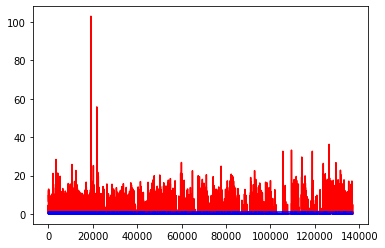

white ratio : 52.75
min : 177
max : 228


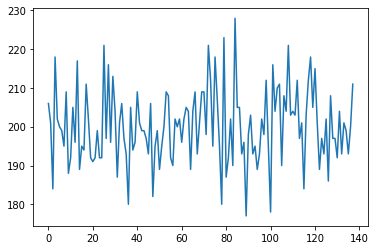

Generating interpolations...
137001 [D loss: 0.000010, acc.: 100.00%] [G loss: 12.023302, 0.513280]
137002 [D loss: 0.000022, acc.: 100.00%] [G loss: 1.101401, 0.970229]
137003 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.736684, 1.136654]
137004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.761442, 1.252984]
137005 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.824344, 2.534976]
137006 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.587273, 0.972372]
137007 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.404642, 0.575207]
137008 [D loss: 0.078886, acc.: 96.88%] [G loss: 1.734400, 0.541173]
137009 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.493597, 7.522303]
137010 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.515017, 2.036491]
137011 [D loss: 0.000062, acc.: 100.00%] [G loss: 1.273306, 1.277491]
137012 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.405155, 1.208999]
137013 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.277647, 1.269060]
137014 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.614434, 1

137119 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.536210, 0.962244]
137120 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.989931, 1.447417]
137121 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.362965, 0.470295]
137122 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.891424, 0.418448]
137123 [D loss: 0.008580, acc.: 100.00%] [G loss: 0.326655, 0.132754]
137124 [D loss: 0.000075, acc.: 100.00%] [G loss: 1.577258, 2.154830]
137125 [D loss: 0.000388, acc.: 100.00%] [G loss: 0.531912, 0.467399]
137126 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.058147, 0.077265]
137127 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.620898, 3.068927]
137128 [D loss: 0.000059, acc.: 100.00%] [G loss: 2.818671, 0.101249]
137129 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.088036, 0.048266]
137130 [D loss: 0.000267, acc.: 100.00%] [G loss: 0.141779, 0.123325]
137131 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.743329, 0.487261]
137132 [D loss: 0.000806, acc.: 100.00%] [G loss: 0.007274, 0.348684]
137133 [D loss: 0.00

137238 [D loss: 0.057471, acc.: 96.88%] [G loss: 0.657746, 1.015227]
137239 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.334175, 0.172947]
137240 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.063710, 0.261332]
137241 [D loss: 0.000350, acc.: 100.00%] [G loss: 0.121595, 0.004900]
137242 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.004743, 0.000012]
137243 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.420951, 0.187574]
137244 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000967, 0.013290]
137245 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000853, 0.008042]
137246 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.013309, 0.536027]
137247 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.654264, 0.643612]
137248 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.080354, 0.070784]
137249 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.196172, 0.270109]
137250 [D loss: 0.000693, acc.: 100.00%] [G loss: 8.946964, 1.542529]
137251 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.168314, 1.532642]
137252 [D loss: 0.000

137359 [D loss: 0.001534, acc.: 100.00%] [G loss: 0.178025, 0.006176]
137360 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.005455, 0.019027]
137361 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.066924, 0.027644]
137362 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.015556, 0.004458]
137363 [D loss: 0.000214, acc.: 100.00%] [G loss: 0.326345, 0.116798]
137364 [D loss: 0.000381, acc.: 100.00%] [G loss: 1.836752, 0.057102]
137365 [D loss: 0.000410, acc.: 100.00%] [G loss: 0.027011, 0.196224]
137366 [D loss: 0.000481, acc.: 100.00%] [G loss: 0.402571, 0.619598]
137367 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.172812, 0.133167]
137368 [D loss: 0.005126, acc.: 100.00%] [G loss: 0.245044, 0.380020]
137369 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.870835, 0.173174]
137370 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.518611, 0.709404]
137371 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.097876, 0.752855]
137372 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.583239, 0.000693]
137373 [D loss: 0.00

137479 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.599543, 1.970210]
137480 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.163015, 0.075471]
137481 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.930421, 1.260249]
137482 [D loss: 0.000069, acc.: 100.00%] [G loss: 1.120431, 0.659152]
137483 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.939455, 2.378449]
137484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.274649, 0.081523]
137485 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.792189, 1.195597]
137486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.055438, 0.048139]
137487 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.636658, 0.531124]
137488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.549388, 0.314258]
137489 [D loss: 0.226641, acc.: 96.88%] [G loss: 0.000063, 0.000125]
137490 [D loss: 0.000418, acc.: 100.00%] [G loss: 0.715520, 0.007193]
137491 [D loss: 0.074409, acc.: 96.88%] [G loss: 2.130527, 0.003840]
137492 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.994246, 1.179576]
137493 [D loss: 0.0000

137596 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000036, 0.011743]
137597 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.181875, 0.212379]
137598 [D loss: 0.024843, acc.: 96.88%] [G loss: 0.060461, 0.360756]
137599 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.657551, 0.157714]
137600 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.034495, 0.215154]
137601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.092682, 0.033582]
137602 [D loss: 0.001186, acc.: 100.00%] [G loss: 0.018510, 0.003885]
137603 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.468016, 0.042756]
137604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.162549, 0.167608]
137605 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000458, 0.000190]
137606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.045276, 0.121825]
137607 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.152532, 0.022207]
137608 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.011199, 0.022878]
137609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000189, 0.000726]
137610 [D loss: 0.000

137714 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.513012, 8.372417]
137715 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.163770, 1.644884]
137716 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.526628, 4.900943]
137717 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.107728, 0.075154]
137718 [D loss: 0.000002, acc.: 100.00%] [G loss: 52.085377, 5.756258]
137719 [D loss: 0.000018, acc.: 100.00%] [G loss: 3.068697, 3.168662]
137720 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.814054, 2.864983]
137721 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.833002, 4.391135]
137722 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.698626, 3.801898]
137723 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.561105, 2.486445]
137724 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.625471, 0.458899]
137725 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.655370, 2.824983]
137726 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.498270, 2.004319]
137727 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.359689, 1.448224]
137728 [D loss: 0.0

137833 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.117992, 0.028793]
137834 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.366813, 0.330869]
137835 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.049842, 0.462758]
137836 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.607140, 0.434141]
137837 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.203395, 0.170036]
137838 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.262783, 0.557031]
137839 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000213, 0.123436]
137840 [D loss: 0.007097, acc.: 100.00%] [G loss: 0.676367, 0.515758]
137841 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.006272, 0.000750]
137842 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.002809, 0.000001]
137843 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.558587, 0.595579]
137844 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000105, 0.000401]
137845 [D loss: 0.002758, acc.: 100.00%] [G loss: 0.121436, 0.063358]
137846 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.918346, 0.000080]
137847 [D loss: 0.00

137953 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000003, 0.000235]
137954 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.170766, 0.000097]
137955 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.230475, 0.013101]
137956 [D loss: 0.001479, acc.: 100.00%] [G loss: 0.000049, 0.001575]
137957 [D loss: 0.004492, acc.: 100.00%] [G loss: 0.106422, 0.092878]
137958 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000100, 0.008484]
137959 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.982352, 1.151122]
137960 [D loss: 0.008950, acc.: 100.00%] [G loss: 0.088949, 0.140253]
137961 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.004115, 0.067657]
137962 [D loss: 0.000780, acc.: 100.00%] [G loss: 0.000614, 0.017805]
137963 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000003]
137964 [D loss: 0.000506, acc.: 100.00%] [G loss: 0.045803, 0.123941]
137965 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000059, 0.000809]
137966 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000007, 0.010376]
137967 [D loss: 0.00

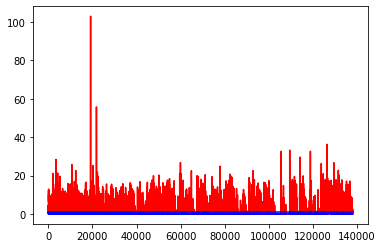

white ratio : 51.5
min : 177
max : 228


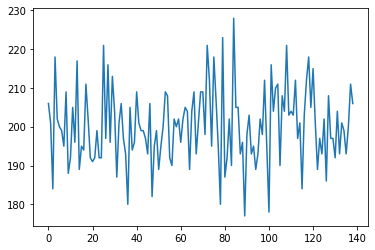

Generating interpolations...
138001 [D loss: 0.000813, acc.: 100.00%] [G loss: 0.000000, 0.000000]
138002 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.052349, 0.044783]
138003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000178, 0.069882]
138004 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.001781, 0.002572]
138005 [D loss: 0.010107, acc.: 100.00%] [G loss: 0.004525, 0.001776]
138006 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.107785, 0.002434]
138007 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.030802, 0.015668]
138008 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.149580, 0.515556]
138009 [D loss: 0.000380, acc.: 100.00%] [G loss: 0.001552, 0.287105]
138010 [D loss: 0.001186, acc.: 100.00%] [G loss: 0.059271, 0.004285]
138011 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000546, 0.000460]
138012 [D loss: 0.001233, acc.: 100.00%] [G loss: 0.221452, 0.372175]
138013 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000191, 0.066981]
138014 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000804, 0

138120 [D loss: 0.000792, acc.: 100.00%] [G loss: 4.012712, 1.473311]
138121 [D loss: 0.000438, acc.: 100.00%] [G loss: 11.453650, 1.007516]
138122 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.690090, 3.578888]
138123 [D loss: 0.001307, acc.: 100.00%] [G loss: 6.048375, 4.450417]
138124 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.256313, 5.946060]
138125 [D loss: 0.000013, acc.: 100.00%] [G loss: 5.933496, 3.560371]
138126 [D loss: 0.089422, acc.: 96.88%] [G loss: 4.052103, 2.523081]
138127 [D loss: 0.000491, acc.: 100.00%] [G loss: 1.305076, 0.669737]
138128 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.055153, 0.382141]
138129 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.339152, 0.454720]
138130 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.430808, 0.044081]
138131 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.062893, 0.008913]
138132 [D loss: 0.000190, acc.: 100.00%] [G loss: 1.167510, 0.466466]
138133 [D loss: 0.000227, acc.: 100.00%] [G loss: 0.034467, 0.008899]
138134 [D loss: 0.00

138239 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.185670, 2.052224]
138240 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.897783, 1.002180]
138241 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.176678, 1.101519]
138242 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.904026, 1.047502]
138243 [D loss: 0.012155, acc.: 100.00%] [G loss: 2.317883, 1.574643]
138244 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.580784, 2.938391]
138245 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.521891, 6.968750]
138246 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.520844, 3.467999]
138247 [D loss: 0.000026, acc.: 100.00%] [G loss: 5.271132, 3.306668]
138248 [D loss: 0.000016, acc.: 100.00%] [G loss: 8.868283, 5.873033]
138249 [D loss: 0.000076, acc.: 100.00%] [G loss: 4.861319, 3.049855]
138250 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.155222, 3.203777]
138251 [D loss: 0.002552, acc.: 100.00%] [G loss: 0.935970, 2.974213]
138252 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.922287, 0.878157]
138253 [D loss: 0.0

138357 [D loss: 0.000007, acc.: 100.00%] [G loss: 8.771797, 3.585232]
138358 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.459895, 4.583395]
138359 [D loss: 0.000013, acc.: 100.00%] [G loss: 7.211843, 7.236147]
138360 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.394605, 0.315477]
138361 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.867055, 1.920741]
138362 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.879618, 5.317646]
138363 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.713779, 6.455174]
138364 [D loss: 0.000047, acc.: 100.00%] [G loss: 7.165627, 5.516826]
138365 [D loss: 0.006023, acc.: 100.00%] [G loss: 18.333393, 1.754671]
138366 [D loss: 0.000104, acc.: 100.00%] [G loss: 6.900873, 5.652551]
138367 [D loss: 0.000047, acc.: 100.00%] [G loss: 2.285227, 1.989568]
138368 [D loss: 0.000022, acc.: 100.00%] [G loss: 2.344797, 0.914365]
138369 [D loss: 0.000022, acc.: 100.00%] [G loss: 4.056487, 3.967067]
138370 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.486706, 1.178941]
138371 [D loss: 0.0

138475 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.374791, 1.271627]
138476 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.459424, 10.516329]
138477 [D loss: 0.081309, acc.: 96.88%] [G loss: 0.667881, 0.878252]
138478 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.741963, 1.832099]
138479 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.237950, 0.785655]
138480 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.967865, 1.229622]
138481 [D loss: 0.000010, acc.: 100.00%] [G loss: 26.727184, 3.193026]
138482 [D loss: 0.000038, acc.: 100.00%] [G loss: 8.370525, 8.597758]
138483 [D loss: 0.000062, acc.: 100.00%] [G loss: 9.981165, 8.926728]
138484 [D loss: 0.000050, acc.: 100.00%] [G loss: 7.215665, 8.082668]
138485 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.268345, 7.656040]
138486 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.678353, 4.149265]
138487 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.107521, 7.204516]
138488 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.014486, 2.819793]
138489 [D loss: 0

138593 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.004304, 0.000149]
138594 [D loss: 0.016166, acc.: 100.00%] [G loss: 0.243154, 0.490161]
138595 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.219625, 0.291526]
138596 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.060211, 0.562934]
138597 [D loss: 0.000807, acc.: 100.00%] [G loss: 0.520370, 0.087230]
138598 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.356901, 0.163374]
138599 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.054628, 0.697757]
138600 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.001675, 0.033858]
138601 [D loss: 0.000827, acc.: 100.00%] [G loss: 2.278242, 0.010161]
138602 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.307833, 1.265327]
138603 [D loss: 0.073876, acc.: 96.88%] [G loss: 0.108008, 0.003299]
138604 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.221611, 0.168371]
138605 [D loss: 0.000235, acc.: 100.00%] [G loss: 1.869688, 1.366811]
138606 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.082924, 0.000093]
138607 [D loss: 0.000

138713 [D loss: 0.020645, acc.: 100.00%] [G loss: 2.618083, 0.972736]
138714 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.170729, 0.513482]
138715 [D loss: 0.010560, acc.: 100.00%] [G loss: 0.070615, 0.001385]
138716 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.805287, 0.778750]
138717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.213023, 0.316729]
138718 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.482989, 0.296883]
138719 [D loss: 0.000279, acc.: 100.00%] [G loss: 0.282920, 0.078373]
138720 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.004086, 0.004324]
138721 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.387452, 0.528416]
138722 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.002439, 0.022481]
138723 [D loss: 0.042936, acc.: 96.88%] [G loss: 1.006939, 0.530478]
138724 [D loss: 0.000429, acc.: 100.00%] [G loss: 0.960025, 0.692036]
138725 [D loss: 0.001364, acc.: 100.00%] [G loss: 2.979425, 1.102441]
138726 [D loss: 0.000698, acc.: 100.00%] [G loss: 1.082395, 0.773608]
138727 [D loss: 0.000

138833 [D loss: 0.000308, acc.: 100.00%] [G loss: 0.866461, 0.991857]
138834 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.036838, 0.097912]
138835 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.025447, 0.022090]
138836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.048382, 0.118113]
138837 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.394565, 0.096611]
138838 [D loss: 0.013068, acc.: 100.00%] [G loss: 0.210914, 0.148121]
138839 [D loss: 0.000091, acc.: 100.00%] [G loss: 6.443804, 0.652575]
138840 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.209245, 0.974068]
138841 [D loss: 0.000039, acc.: 100.00%] [G loss: 2.869145, 1.945647]
138842 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.048559, 0.375572]
138843 [D loss: 0.000016, acc.: 100.00%] [G loss: 2.253186, 0.809353]
138844 [D loss: 0.009623, acc.: 100.00%] [G loss: 17.091316, 1.394821]
138845 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.701335, 4.960181]
138846 [D loss: 0.000029, acc.: 100.00%] [G loss: 1.271747, 1.260740]
138847 [D loss: 0.0

138952 [D loss: 0.000738, acc.: 100.00%] [G loss: 0.255605, 0.927218]
138953 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.318110, 0.067647]
138954 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.355014, 2.593553]
138955 [D loss: 0.000208, acc.: 100.00%] [G loss: 1.116595, 1.128555]
138956 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.825478, 1.010885]
138957 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.138559, 0.300314]
138958 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.193489, 0.480134]
138959 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.713233, 0.250108]
138960 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.682387, 1.219545]
138961 [D loss: 0.000314, acc.: 100.00%] [G loss: 0.002643, 0.000124]
138962 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.005183, 0.010677]
138963 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000230, 0.000020]
138964 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.124439, 1.106309]
138965 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.987664, 0.782647]
138966 [D loss: 0.00

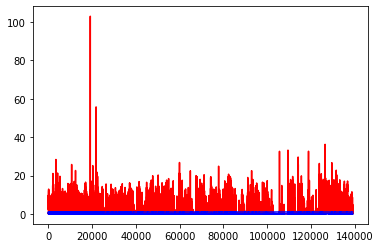

white ratio : 50.0
min : 177
max : 228


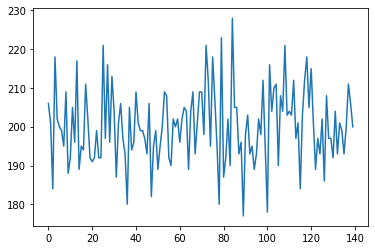

Generating interpolations...
139001 [D loss: 0.000258, acc.: 100.00%] [G loss: 4.960571, 1.445757]
139002 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.136973, 0.122220]
139003 [D loss: 0.001758, acc.: 100.00%] [G loss: 0.015357, 0.201222]
139004 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.476985, 0.262998]
139005 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.375344, 0.442877]
139006 [D loss: 0.000277, acc.: 100.00%] [G loss: 2.038805, 2.261732]
139007 [D loss: 0.001696, acc.: 100.00%] [G loss: 3.228373, 2.409277]
139008 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.059471, 0.001533]
139009 [D loss: 0.003395, acc.: 100.00%] [G loss: 0.035203, 0.114551]
139010 [D loss: 0.000188, acc.: 100.00%] [G loss: 3.309412, 0.705617]
139011 [D loss: 0.000023, acc.: 100.00%] [G loss: 2.223146, 1.685105]
139012 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.206162, 0.787033]
139013 [D loss: 0.000189, acc.: 100.00%] [G loss: 1.280981, 1.827223]
139014 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.956059, 1

139120 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.300051, 0.138654]
139121 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000085, 0.046635]
139122 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.107226, 0.057263]
139123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.155848, 0.432041]
139124 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.001441, 0.008061]
139125 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.103964, 0.085117]
139126 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.038009, 0.034597]
139127 [D loss: 0.000152, acc.: 100.00%] [G loss: 7.104161, 0.640132]
139128 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.648443, 0.649459]
139129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.004127, 0.069808]
139130 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.875814, 1.405846]
139131 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.756756, 0.250652]
139132 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000344, 0.000969]
139133 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.731799, 2.135933]
139134 [D loss: 0.00

139238 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.131805, 0.213319]
139239 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.245398, 0.309159]
139240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.261648, 0.037945]
139241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.289695, 0.122625]
139242 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.371389, 0.107388]
139243 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.546055, 0.872057]
139244 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.708536, 0.527512]
139245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.178293, 0.016913]
139246 [D loss: 0.000489, acc.: 100.00%] [G loss: 0.010980, 0.022785]
139247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004794, 0.038814]
139248 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.018664, 0.006984]
139249 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.005999, 0.015290]
139250 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.596689, 0.865683]
139251 [D loss: 0.000692, acc.: 100.00%] [G loss: 1.250488, 2.225940]
139252 [D loss: 0.00

139358 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.071329, 0.119836]
139359 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.053130, 0.603593]
139360 [D loss: 0.000045, acc.: 100.00%] [G loss: 1.126934, 0.740397]
139361 [D loss: 0.000529, acc.: 100.00%] [G loss: 0.159754, 0.285281]
139362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.240156, 0.588274]
139363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.654220, 0.532691]
139364 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.054118, 0.138840]
139365 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.911121, 0.585653]
139366 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.408932, 0.960235]
139367 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.290370, 0.643261]
139368 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.311805, 0.350839]
139369 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.279102, 0.198989]
139370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.062852, 0.072597]
139371 [D loss: 0.075633, acc.: 96.88%] [G loss: 0.004167, 0.004779]
139372 [D loss: 0.000

139477 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001748, 0.058093]
139478 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.220445, 0.000539]
139479 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.196937, 0.330736]
139480 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.057315, 0.218197]
139481 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.817218, 0.594627]
139482 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.318563, 0.803740]
139483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.167763, 0.180146]
139484 [D loss: 0.000733, acc.: 100.00%] [G loss: 0.230128, 0.229246]
139485 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.007736, 0.223124]
139486 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.166993, 0.056834]
139487 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.128811, 0.422640]
139488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.041729, 0.013203]
139489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.239602, 0.166419]
139490 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.521396, 0.335063]
139491 [D loss: 0.00

139596 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.942972, 0.359454]
139597 [D loss: 0.000004, acc.: 100.00%] [G loss: 19.127098, 0.452471]
139598 [D loss: 0.000004, acc.: 100.00%] [G loss: 28.721832, 2.942933]
139599 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.249961, 2.512022]
139600 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.615667, 2.216966]
139601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.089079, 0.133039]
139602 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.060995, 0.039631]
139603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.899201, 0.912783]
139604 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.257015, 2.366572]
139605 [D loss: 0.000316, acc.: 100.00%] [G loss: 1.281250, 1.468699]
139606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.171996, 1.151021]
139607 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.186579, 0.011927]
139608 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.889822, 0.728398]
139609 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.148856, 0.166390]
139610 [D loss: 0.

139717 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.184715, 0.455992]
139718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.627528, 1.078953]
139719 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.265484, 0.733622]
139720 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009221, 0.047004]
139721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.607183, 0.142579]
139722 [D loss: 0.001245, acc.: 100.00%] [G loss: 0.742041, 0.534613]
139723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000517, 0.026881]
139724 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.207995, 0.066995]
139725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000054]
139726 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.829682, 0.797636]
139727 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.516197, 0.156125]
139728 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.015806, 0.020747]
139729 [D loss: 0.003242, acc.: 100.00%] [G loss: 0.881055, 0.447804]
139730 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.020834, 0.050352]
139731 [D loss: 0.00

139837 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.451911, 1.089523]
139838 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.980088, 0.704921]
139839 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.247375, 1.906643]
139840 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.622483, 0.122700]
139841 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.933884, 1.195111]
139842 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.202148, 0.663043]
139843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.083038, 0.046874]
139844 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.605962, 0.015000]
139845 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.199017, 2.483844]
139846 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.230926, 1.982989]
139847 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.818590, 2.317220]
139848 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.155516, 0.253241]
139849 [D loss: 0.000028, acc.: 100.00%] [G loss: 1.386451, 0.525123]
139850 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.656228, 1.455506]
139851 [D loss: 0.00

139954 [D loss: 0.001183, acc.: 100.00%] [G loss: 3.396760, 3.398305]
139955 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.415932, 1.289596]
139956 [D loss: 0.049246, acc.: 96.88%] [G loss: 0.526483, 0.283974]
139957 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000065, 0.000016]
139958 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.082434, 0.205879]
139959 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000016, 0.000007]
139960 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000001]
139961 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000617, 0.000009]
139962 [D loss: 0.009798, acc.: 100.00%] [G loss: 0.043719, 0.011414]
139963 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.041687, 0.221636]
139964 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.584357, 0.605915]
139965 [D loss: 0.000535, acc.: 100.00%] [G loss: 1.520298, 0.538388]
139966 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.006663, 0.042021]
139967 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.950752, 0.813067]
139968 [D loss: 0.000

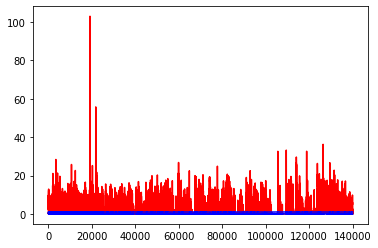

white ratio : 53.25
min : 177
max : 228


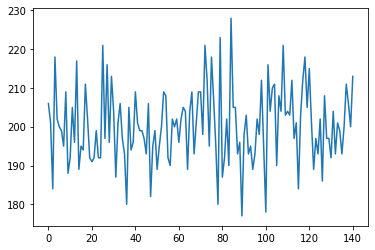

Generating interpolations...
140001 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000033, 0.000394]
140002 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.292193, 0.196731]
140003 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.262867, 0.308754]
140004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003357, 0.000002]
140005 [D loss: 0.000156, acc.: 100.00%] [G loss: 0.700323, 1.356096]
140006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.224732, 0.157471]
140007 [D loss: 0.059699, acc.: 96.88%] [G loss: 0.398230, 0.915041]
140008 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.279025, 0.004231]
140009 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000250, 0.000000]
140010 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.368757, 0.067528]
140011 [D loss: 0.000099, acc.: 100.00%] [G loss: 1.106722, 1.130614]
140012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.995271, 0.577938]
140013 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.003156, 0.062907]
140014 [D loss: 0.000001, acc.: 100.00%] [G loss: 19.422274, 0

140118 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.418999, 0.834076]
140119 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.846279, 0.360530]
140120 [D loss: 0.001392, acc.: 100.00%] [G loss: 0.000058, 0.000343]
140121 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.005173, 0.001516]
140122 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.127179, 0.876581]
140123 [D loss: 0.000437, acc.: 100.00%] [G loss: 0.720251, 0.294605]
140124 [D loss: 0.001677, acc.: 100.00%] [G loss: 1.619201, 1.748960]
140125 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.641921, 0.005408]
140126 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.877157, 1.498992]
140127 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.104759, 0.018467]
140128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.740238, 0.098392]
140129 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.273061, 0.664917]
140130 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.025988, 0.000329]
140131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.355579, 0.061234]
140132 [D loss: 0.00

140236 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.243139, 0.201492]
140237 [D loss: 0.000470, acc.: 100.00%] [G loss: 0.094766, 0.171337]
140238 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.572515, 0.818914]
140239 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.540408, 1.321257]
140240 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.713286, 0.761610]
140241 [D loss: 0.000857, acc.: 100.00%] [G loss: 0.185212, 0.026471]
140242 [D loss: 0.001385, acc.: 100.00%] [G loss: 0.180072, 0.290088]
140243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.838440, 0.172801]
140244 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.526572, 0.330903]
140245 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.537676, 0.920531]
140246 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.454247, 1.661798]
140247 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.378915, 0.223546]
140248 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.103487, 0.343924]
140249 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.537230, 0.388469]
140250 [D loss: 0.00

140355 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.691044, 0.998793]
140356 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.747989, 0.969103]
140357 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.731020, 0.428641]
140358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.356801, 0.088419]
140359 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.558853, 0.037662]
140360 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.408813, 0.332827]
140361 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.004436, 1.240538]
140362 [D loss: 0.000149, acc.: 100.00%] [G loss: 0.942721, 1.096426]
140363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.511666, 0.264701]
140364 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.004472, 0.071149]
140365 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.590732, 0.620788]
140366 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.617940, 0.682688]
140367 [D loss: 0.267723, acc.: 93.75%] [G loss: 0.000000, 0.000002]
140368 [D loss: 0.000325, acc.: 100.00%] [G loss: 0.000000, 0.000000]
140369 [D loss: 0.040

140476 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001558, 0.001627]
140477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.247953, 0.006310]
140478 [D loss: 0.000581, acc.: 100.00%] [G loss: 0.079721, 0.063744]
140479 [D loss: 0.000443, acc.: 100.00%] [G loss: 0.000497, 0.000379]
140480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000037, 0.000068]
140481 [D loss: 0.005592, acc.: 100.00%] [G loss: 0.000012, 0.000229]
140482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005798, 0.000163]
140483 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000155, 0.000081]
140484 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.015974, 0.001970]
140485 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.334025, 0.319299]
140486 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.064612, 0.087760]
140487 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000170, 0.014516]
140488 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.167315, 0.103365]
140489 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.056557, 0.009865]
140490 [D loss: 0.00

140595 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.051717, 1.371660]
140596 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.006194, 0.000091]
140597 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.080942, 0.076881]
140598 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.120717, 1.751243]
140599 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000527, 0.049509]
140600 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000865, 0.000000]
140601 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.070286, 0.002398]
140602 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.599916, 0.846223]
140603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000793, 0.022648]
140604 [D loss: 0.000434, acc.: 100.00%] [G loss: 0.000035, 0.000063]
140605 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000395, 0.000000]
140606 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.060980, 0.154756]
140607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003033, 0.002124]
140608 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000007, 0.000012]
140609 [D loss: 0.00

140713 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.060166, 0.165381]
140714 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.321950, 0.493972]
140715 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.444685, 0.246603]
140716 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.834414, 2.009545]
140717 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.097218, 0.256712]
140718 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.158770, 0.249891]
140719 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.771312, 0.826105]
140720 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.818700, 1.379396]
140721 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.454143, 0.693908]
140722 [D loss: 0.000070, acc.: 100.00%] [G loss: 1.390689, 1.293674]
140723 [D loss: 0.000085, acc.: 100.00%] [G loss: 2.722253, 1.859455]
140724 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.465394, 0.975305]
140725 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.609221, 1.137958]
140726 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.563770, 1.518377]
140727 [D loss: 0.0

140832 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.243647, 0.031959]
140833 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.128406, 0.232980]
140834 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.053910, 0.095371]
140835 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.163165, 0.041944]
140836 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000611, 0.013028]
140837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.087358, 0.056481]
140838 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.265657, 0.064033]
140839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.252692, 0.023271]
140840 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.014641, 0.000955]
140841 [D loss: 0.003267, acc.: 100.00%] [G loss: 0.116736, 0.385705]
140842 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.191388, 0.245684]
140843 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.114644, 0.283394]
140844 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.386798, 0.269134]
140845 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.006577, 0.041554]
140846 [D loss: 0.00

140951 [D loss: 0.008905, acc.: 100.00%] [G loss: 0.000253, 0.000034]
140952 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.026810, 0.210391]
140953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.996213, 0.314047]
140954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.050452, 0.001460]
140955 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.167155, 0.470806]
140956 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.042408, 0.053828]
140957 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.007134, 0.334508]
140958 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.205030, 0.092310]
140959 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.661021, 0.127832]
140960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001420, 0.006213]
140961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.164765, 0.111339]
140962 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.308699, 0.381958]
140963 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.074845, 0.040809]
140964 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003499, 0.258768]
140965 [D loss: 0.00

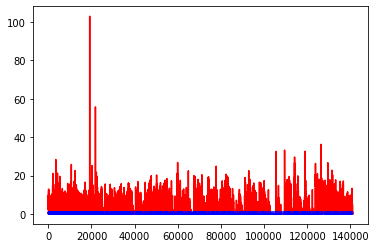

white ratio : 49.25
min : 177
max : 228


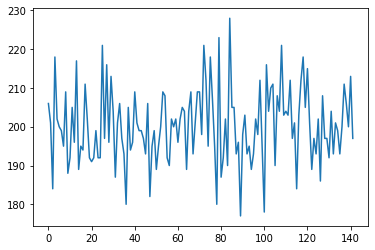

Generating interpolations...
141001 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.049075, 0.086684]
141002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011313, 0.060926]
141003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001505, 0.021059]
141004 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.080337, 0.033690]
141005 [D loss: 0.000342, acc.: 100.00%] [G loss: 0.015244, 0.171876]
141006 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.013765, 0.024252]
141007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.012783, 0.002896]
141008 [D loss: 0.000238, acc.: 100.00%] [G loss: 0.488301, 0.423100]
141009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003435, 0.053902]
141010 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000755, 0.001302]
141011 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.010173, 0.045121]
141012 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000827, 0.003609]
141013 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.095141, 0.073335]
141014 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.274616, 0

141119 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.104211, 0.076315]
141120 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.005074, 0.033247]
141121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.176205, 0.498597]
141122 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001206, 0.009333]
141123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.090761, 0.015906]
141124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016342, 0.259424]
141125 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.006562, 0.026320]
141126 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.235404, 0.513995]
141127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.035856, 0.025019]
141128 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.023086, 0.150190]
141129 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.092511, 0.000151]
141130 [D loss: 0.000250, acc.: 100.00%] [G loss: 0.112046, 0.002073]
141131 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.022414, 0.065805]
141132 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000290, 0.048667]
141133 [D loss: 0.00

141238 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.136101, 0.357121]
141239 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.878269, 1.489736]
141240 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.516688, 0.539915]
141241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023052, 0.059469]
141242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.589157, 0.388145]
141243 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000477, 0.073152]
141244 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.044438, 0.002987]
141245 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000032, 0.000536]
141246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002529, 0.016716]
141247 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.007823, 0.003200]
141248 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.977340, 0.895099]
141249 [D loss: 0.000057, acc.: 100.00%] [G loss: 7.094189, 0.298728]
141250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.158712, 0.111023]
141251 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.347822, 0.214665]
141252 [D loss: 0.00

141356 [D loss: 0.000212, acc.: 100.00%] [G loss: 1.877884, 1.175517]
141357 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.535249, 1.012247]
141358 [D loss: 0.000610, acc.: 100.00%] [G loss: 3.439096, 3.357671]
141359 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.059249, 0.163356]
141360 [D loss: 0.000309, acc.: 100.00%] [G loss: 1.407414, 2.116950]
141361 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.016396, 1.258450]
141362 [D loss: 0.000329, acc.: 100.00%] [G loss: 1.259708, 1.331620]
141363 [D loss: 0.021114, acc.: 100.00%] [G loss: 0.031798, 0.013831]
141364 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.099070, 0.117050]
141365 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.010755, 0.007250]
141366 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.175062, 0.177864]
141367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.531053, 0.270178]
141368 [D loss: 0.000803, acc.: 100.00%] [G loss: 0.210719, 0.093498]
141369 [D loss: 0.000273, acc.: 100.00%] [G loss: 0.010743, 0.003620]
141370 [D loss: 0.00

141474 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.379402, 0.841746]
141475 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.427409, 0.426911]
141476 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.050371, 0.142788]
141477 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.059940, 0.251419]
141478 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.397651, 0.598745]
141479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.087220, 0.075939]
141480 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.172895, 0.253775]
141481 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.748308, 0.346481]
141482 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.546692, 0.002070]
141483 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.417680, 0.947395]
141484 [D loss: 0.000138, acc.: 100.00%] [G loss: 1.514949, 1.271380]
141485 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.092805, 0.080432]
141486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.756726, 0.632986]
141487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.076419, 0.005317]
141488 [D loss: 0.00

141593 [D loss: 0.000501, acc.: 100.00%] [G loss: 3.470446, 3.235229]
141594 [D loss: 0.000029, acc.: 100.00%] [G loss: 1.171371, 0.762213]
141595 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.583347, 0.393641]
141596 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.463530, 3.905317]
141597 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.060046, 0.003826]
141598 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.280477, 0.277786]
141599 [D loss: 0.034490, acc.: 96.88%] [G loss: 6.578908, 2.125360]
141600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.455779, 0.356707]
141601 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.145718, 0.122339]
141602 [D loss: 0.000351, acc.: 100.00%] [G loss: 0.007377, 0.007607]
141603 [D loss: 0.001320, acc.: 100.00%] [G loss: 0.046102, 0.015924]
141604 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.313477, 0.099734]
141605 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.350839, 0.193372]
141606 [D loss: 0.000321, acc.: 100.00%] [G loss: 3.389344, 2.528199]
141607 [D loss: 0.002

141713 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.946218, 1.913245]
141714 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.673401, 0.295423]
141715 [D loss: 0.005093, acc.: 100.00%] [G loss: 0.305439, 0.761018]
141716 [D loss: 0.000066, acc.: 100.00%] [G loss: 1.086266, 0.445655]
141717 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.033581, 1.317797]
141718 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.675902, 0.603693]
141719 [D loss: 0.000058, acc.: 100.00%] [G loss: 1.034656, 0.959873]
141720 [D loss: 0.000052, acc.: 100.00%] [G loss: 1.087732, 0.691733]
141721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.300404, 0.289860]
141722 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.599185, 0.929581]
141723 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.009755, 0.063516]
141724 [D loss: 0.000351, acc.: 100.00%] [G loss: 9.744555, 1.174186]
141725 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.623304, 2.045504]
141726 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.939834, 0.479800]
141727 [D loss: 0.00

141832 [D loss: 0.000038, acc.: 100.00%] [G loss: 7.107245, 8.231738]
141833 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.591634, 13.825048]
141834 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.648975, 7.356147]
141835 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.454825, 6.694880]
141836 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.775395, 6.251484]
141837 [D loss: 0.000067, acc.: 100.00%] [G loss: 10.584593, 11.506382]
141838 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.460269, 8.531361]
141839 [D loss: 0.088621, acc.: 96.88%] [G loss: 0.837955, 1.422772]
141840 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.530529, 2.903244]
141841 [D loss: 0.000074, acc.: 100.00%] [G loss: 7.468604, 7.549242]
141842 [D loss: 0.000557, acc.: 100.00%] [G loss: 2.231484, 1.675491]
141843 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.791811, 2.046387]
141844 [D loss: 0.000731, acc.: 100.00%] [G loss: 2.485210, 2.132461]
141845 [D loss: 0.000153, acc.: 100.00%] [G loss: 3.188894, 1.408443]
141846 [D loss: 0

141949 [D loss: 0.000270, acc.: 100.00%] [G loss: 2.054387, 1.182620]
141950 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.332217, 0.112325]
141951 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.085644, 1.637748]
141952 [D loss: 0.000311, acc.: 100.00%] [G loss: 3.475101, 3.860225]
141953 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.179436, 1.106465]
141954 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.271290, 1.813977]
141955 [D loss: 0.248455, acc.: 96.88%] [G loss: 0.669246, 1.025728]
141956 [D loss: 0.000199, acc.: 100.00%] [G loss: 14.600889, 2.018740]
141957 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.063790, 1.207435]
141958 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.635642, 1.279414]
141959 [D loss: 0.000327, acc.: 100.00%] [G loss: 1.409492, 1.127048]
141960 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.976920, 1.847465]
141961 [D loss: 0.000021, acc.: 100.00%] [G loss: 2.091234, 1.581795]
141962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.608562, 0.491330]
141963 [D loss: 0.0

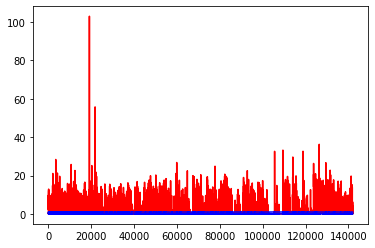

white ratio : 49.0
min : 177
max : 228


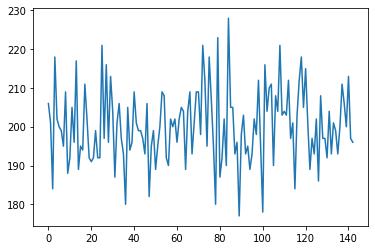

Generating interpolations...
142001 [D loss: 0.004436, acc.: 100.00%] [G loss: 0.014147, 0.003384]
142002 [D loss: 0.032023, acc.: 96.88%] [G loss: 0.002578, 0.002037]
142003 [D loss: 0.001474, acc.: 100.00%] [G loss: 0.002279, 0.002079]
142004 [D loss: 0.001372, acc.: 100.00%] [G loss: 0.156050, 0.265982]
142005 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.166860, 0.041527]
142006 [D loss: 0.000759, acc.: 100.00%] [G loss: 0.000917, 0.035852]
142007 [D loss: 0.000784, acc.: 100.00%] [G loss: 1.437811, 0.079320]
142008 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.040632, 0.046920]
142009 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.125386, 0.025857]
142010 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.125028, 0.110514]
142011 [D loss: 0.000394, acc.: 100.00%] [G loss: 0.073197, 0.158796]
142012 [D loss: 0.000395, acc.: 100.00%] [G loss: 0.001969, 0.001133]
142013 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.822740, 0.072913]
142014 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.465352, 0.

142121 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.014482, 0.029751]
142122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.018121, 0.061983]
142123 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.075556, 0.138355]
142124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.031739, 0.004027]
142125 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.175449, 0.122615]
142126 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.008702, 0.001764]
142127 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.438647, 0.507382]
142128 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000373, 0.000430]
142129 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.049907, 0.047016]
142130 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.585656, 1.289111]
142131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.083855, 0.031637]
142132 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.079067, 0.076121]
142133 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002863, 0.028391]
142134 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.005211, 0.005827]
142135 [D loss: 0.00

142242 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.051187, 0.013969]
142243 [D loss: 0.000356, acc.: 100.00%] [G loss: 0.000397, 0.002119]
142244 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.005182, 0.000108]
142245 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.000126, 0.000670]
142246 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000102]
142247 [D loss: 0.035536, acc.: 96.88%] [G loss: 0.000043, 0.000000]
142248 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000000, 0.000001]
142249 [D loss: 0.000844, acc.: 100.00%] [G loss: 0.000019, 0.000019]
142250 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.000207, 0.000085]
142251 [D loss: 0.000432, acc.: 100.00%] [G loss: 0.046913, 0.003525]
142252 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000304, 0.000045]
142253 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000001, 0.000013]
142254 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000007, 0.000001]
142255 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000003, 0.000001]
142256 [D loss: 0.000

142361 [D loss: 0.000285, acc.: 100.00%] [G loss: 0.066568, 0.030188]
142362 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.043966, 0.000943]
142363 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000142, 0.000002]
142364 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.112550, 0.165857]
142365 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.011891, 0.146728]
142366 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.018396, 0.040452]
142367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000504, 0.000008]
142368 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.003609, 0.000177]
142369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003947, 0.000376]
142370 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.071326, 0.024769]
142371 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000191, 0.000263]
142372 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.426355, 0.384212]
142373 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000027, 0.022113]
142374 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000382, 0.001463]
142375 [D loss: 0.00

142481 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000683, 0.000006]
142482 [D loss: 0.000624, acc.: 100.00%] [G loss: 0.000182, 0.000095]
142483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000032, 0.000002]
142484 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.074693, 0.000233]
142485 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000001, 0.000000]
142486 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000669, 0.000019]
142487 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000325, 0.000019]
142488 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000010, 0.000000]
142489 [D loss: 0.033107, acc.: 96.88%] [G loss: 0.179311, 0.138826]
142490 [D loss: 0.000035, acc.: 100.00%] [G loss: 32.877167, 0.412627]
142491 [D loss: 0.000095, acc.: 100.00%] [G loss: 4.537961, 2.478033]
142492 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.795949, 2.447794]
142493 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.979133, 2.975873]
142494 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.303090, 2.484865]
142495 [D loss: 0.00

142600 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.198490, 0.747001]
142601 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.052519, 0.299876]
142602 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.111845, 0.190110]
142603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.005077, 0.058401]
142604 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.009120, 0.190366]
142605 [D loss: 0.000573, acc.: 100.00%] [G loss: 0.373051, 0.027637]
142606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.546724, 0.129411]
142607 [D loss: 0.003534, acc.: 100.00%] [G loss: 0.188511, 0.355812]
142608 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.453364, 0.921448]
142609 [D loss: 0.000038, acc.: 100.00%] [G loss: 1.358294, 1.478337]
142610 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.734392, 0.403192]
142611 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.071428, 0.268681]
142612 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.063070, 0.661501]
142613 [D loss: 0.000661, acc.: 100.00%] [G loss: 0.090623, 0.161490]
142614 [D loss: 0.08

142720 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.631089, 10.993923]
142721 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.784863, 13.483200]
142722 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.445948, 10.590998]
142723 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.628896, 15.960061]
142724 [D loss: 0.000006, acc.: 100.00%] [G loss: 27.229630, 15.489645]
142725 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.942636, 17.114586]
142726 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.698301, 13.891900]
142727 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.834574, 11.522659]
142728 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.435795, 13.417553]
142729 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.918753, 10.295229]
142730 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.655099, 14.495192]
142731 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.761689, 14.322096]
142732 [D loss: 0.000001, acc.: 100.00%] [G loss: 15.819057, 15.353800]
142733 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.706980, 9.32

142838 [D loss: 0.008529, acc.: 100.00%] [G loss: 1.057566, 0.334819]
142839 [D loss: 0.000180, acc.: 100.00%] [G loss: 1.872734, 1.683571]
142840 [D loss: 0.000019, acc.: 100.00%] [G loss: 2.139280, 2.331390]
142841 [D loss: 0.000337, acc.: 100.00%] [G loss: 2.721247, 1.833596]
142842 [D loss: 0.000019, acc.: 100.00%] [G loss: 9.602728, 1.824518]
142843 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.407787, 0.340070]
142844 [D loss: 0.009776, acc.: 100.00%] [G loss: 3.892691, 2.405987]
142845 [D loss: 0.000087, acc.: 100.00%] [G loss: 7.766620, 8.203707]
142846 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.087020, 0.918037]
142847 [D loss: 0.000074, acc.: 100.00%] [G loss: 5.044743, 3.990635]
142848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.440537, 0.359581]
142849 [D loss: 0.000002, acc.: 100.00%] [G loss: 33.088490, 3.888150]
142850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.644473, 1.177270]
142851 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.341477, 4.949811]
142852 [D loss: 0.0

142957 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.628217, 3.327779]
142958 [D loss: 0.164085, acc.: 96.88%] [G loss: 1.386387, 1.509115]
142959 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.825718, 0.405541]
142960 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.561007, 1.839186]
142961 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.990991, 1.967185]
142962 [D loss: 0.000047, acc.: 100.00%] [G loss: 5.093822, 1.388723]
142963 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.946486, 2.050266]
142964 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.879382, 1.202802]
142965 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.684333, 0.253446]
142966 [D loss: 0.000013, acc.: 100.00%] [G loss: 8.580677, 0.452453]
142967 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.958671, 1.533762]
142968 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.769557, 1.229789]
142969 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.696889, 1.288196]
142970 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.561678, 2.733104]
142971 [D loss: 0.000

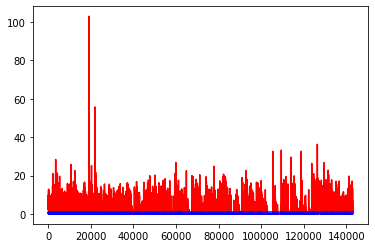

white ratio : 51.5
min : 177
max : 228


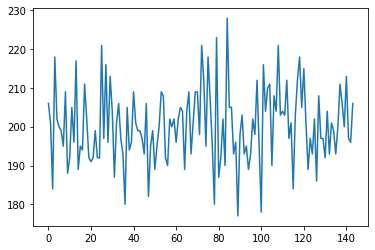

Generating interpolations...
143001 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.388108, 0.425766]
143002 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.122216, 0.223887]
143003 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.300919, 0.552693]
143004 [D loss: 0.000011, acc.: 100.00%] [G loss: 6.026484, 0.327513]
143005 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.730863, 1.071820]
143006 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.537090, 1.628623]
143007 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.869093, 3.675855]
143008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.464542, 0.281809]
143009 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.331520, 0.026770]
143010 [D loss: 0.011588, acc.: 100.00%] [G loss: 3.701202, 2.523241]
143011 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.144484, 1.595292]
143012 [D loss: 0.000001, acc.: 100.00%] [G loss: 18.479828, 3.113267]
143013 [D loss: 0.047460, acc.: 96.88%] [G loss: 0.547565, 0.765112]
143014 [D loss: 0.000328, acc.: 100.00%] [G loss: 2.305267, 2

143119 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.726679, 2.014805]
143120 [D loss: 0.000745, acc.: 100.00%] [G loss: 0.688558, 0.349744]
143121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.655242, 0.340460]
143122 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.648399, 2.456431]
143123 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.142526, 0.244232]
143124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.303898, 0.483862]
143125 [D loss: 0.000267, acc.: 100.00%] [G loss: 1.100030, 0.219949]
143126 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.899490, 1.082878]
143127 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.219963, 0.293940]
143128 [D loss: 0.000111, acc.: 100.00%] [G loss: 7.555278, 4.011633]
143129 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.700268, 1.539582]
143130 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.884484, 0.287685]
143131 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.269544, 0.100825]
143132 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.130567, 0.086985]
143133 [D loss: 0.00

143237 [D loss: 0.002218, acc.: 100.00%] [G loss: 0.253935, 0.681831]
143238 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.779925, 1.085173]
143239 [D loss: 0.000767, acc.: 100.00%] [G loss: 1.754947, 1.867520]
143240 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.345700, 0.963688]
143241 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.559144, 0.842991]
143242 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.530769, 0.646694]
143243 [D loss: 0.000326, acc.: 100.00%] [G loss: 0.795575, 0.268160]
143244 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.076317, 1.020931]
143245 [D loss: 0.000175, acc.: 100.00%] [G loss: 2.580563, 1.204696]
143246 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.292462, 0.364715]
143247 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.848269, 1.817419]
143248 [D loss: 0.065821, acc.: 96.88%] [G loss: 0.045906, 0.014373]
143249 [D loss: 0.002539, acc.: 100.00%] [G loss: 0.275273, 0.595493]
143250 [D loss: 0.000958, acc.: 100.00%] [G loss: 0.131896, 0.008355]
143251 [D loss: 0.000

143357 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.288882, 0.108656]
143358 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.002819, 0.042505]
143359 [D loss: 0.001115, acc.: 100.00%] [G loss: 0.181703, 0.160600]
143360 [D loss: 0.000163, acc.: 100.00%] [G loss: 0.003426, 0.047760]
143361 [D loss: 0.001842, acc.: 100.00%] [G loss: 0.572892, 0.915436]
143362 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.877457, 0.489581]
143363 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.102624, 0.530403]
143364 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.514703, 0.050885]
143365 [D loss: 0.000452, acc.: 100.00%] [G loss: 0.201941, 0.601591]
143366 [D loss: 0.001007, acc.: 100.00%] [G loss: 0.011345, 0.035801]
143367 [D loss: 0.000130, acc.: 100.00%] [G loss: 0.228630, 0.144039]
143368 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.026477, 0.020184]
143369 [D loss: 0.000617, acc.: 100.00%] [G loss: 0.066013, 0.018715]
143370 [D loss: 0.000384, acc.: 100.00%] [G loss: 0.111995, 0.041255]
143371 [D loss: 0.00

143474 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.047517, 0.264037]
143475 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.582762, 0.397554]
143476 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.573736, 0.395981]
143477 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.409570, 0.242566]
143478 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.300649, 0.212188]
143479 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.269044, 0.286783]
143480 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.052057, 0.037774]
143481 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.089935, 0.063682]
143482 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.249504, 0.093761]
143483 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.051989, 0.233300]
143484 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.362373, 0.284645]
143485 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.038298, 0.192348]
143486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023039, 0.010167]
143487 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.224136, 0.088650]
143488 [D loss: 0.00

143593 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.009858, 0.214030]
143594 [D loss: 0.000566, acc.: 100.00%] [G loss: 0.010352, 0.012375]
143595 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.036309, 0.008826]
143596 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.000846, 0.000323]
143597 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000422, 0.066779]
143598 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.011196, 0.022997]
143599 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.105875, 0.004964]
143600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003924, 0.045421]
143601 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.017357, 0.038488]
143602 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000533, 0.002729]
143603 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.008948, 0.006927]
143604 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.011810, 0.016646]
143605 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000042, 0.000122]
143606 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000257, 0.000364]
143607 [D loss: 0.00

143712 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.033571, 0.005207]
143713 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.189200, 0.257124]
143714 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.028973, 0.044728]
143715 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.201179, 0.116742]
143716 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.077665, 0.029237]
143717 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.042108, 0.116001]
143718 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.063799, 0.028648]
143719 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002606, 0.069084]
143720 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.143508, 0.303392]
143721 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.074234, 0.011372]
143722 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.050671, 0.021743]
143723 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.023019, 0.054834]
143724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.011668, 0.011772]
143725 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.145662, 0.112182]
143726 [D loss: 0.00

143832 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.010587, 0.000656]
143833 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000318, 0.000455]
143834 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.004132, 0.000018]
143835 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.018513, 0.001709]
143836 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000022, 0.000222]
143837 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000476, 0.001023]
143838 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.045025, 0.001907]
143839 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001495, 0.008094]
143840 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.021538, 0.339681]
143841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007416, 0.002527]
143842 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000211, 0.000176]
143843 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.005433, 0.000141]
143844 [D loss: 0.000209, acc.: 100.00%] [G loss: 0.000564, 0.000118]
143845 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000093, 0.000067]
143846 [D loss: 0.00

143952 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000288, 0.000010]
143953 [D loss: 0.001157, acc.: 100.00%] [G loss: 0.000008, 0.000036]
143954 [D loss: 0.003991, acc.: 100.00%] [G loss: 0.000001, 0.000002]
143955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000053, 0.000012]
143956 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000202, 0.000005]
143957 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.004423, 0.001476]
143958 [D loss: 0.000235, acc.: 100.00%] [G loss: 0.001377, 0.002291]
143959 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.015910, 0.005612]
143960 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.009968, 0.044142]
143961 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000380, 0.000604]
143962 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.113741, 0.001860]
143963 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000028, 0.000007]
143964 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.000879, 0.000546]
143965 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000029, 0.000642]
143966 [D loss: 0.00

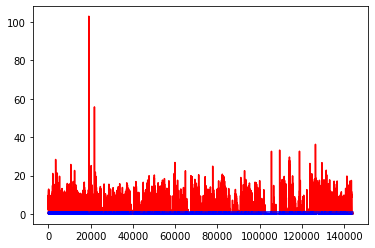

white ratio : 53.0
min : 177
max : 228


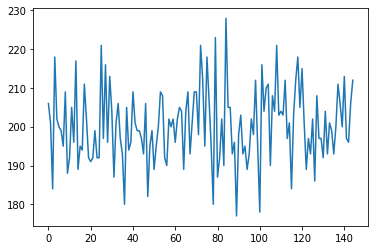

Generating interpolations...
144001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000224, 0.000177]
144002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014850, 0.023520]
144003 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001815, 0.000094]
144004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.009684, 0.000218]
144005 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.000615, 0.000961]
144006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010306, 0.019380]
144007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000034, 0.000081]
144008 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.003770, 0.000546]
144009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000107, 0.086997]
144010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000110, 0.000484]
144011 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.010124, 0.000321]
144012 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000097, 0.000805]
144013 [D loss: 0.000422, acc.: 100.00%] [G loss: 0.000380, 0.002410]
144014 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000288, 0

144120 [D loss: 0.000396, acc.: 100.00%] [G loss: 0.000553, 0.003129]
144121 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.006757, 0.000079]
144122 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000833, 0.000114]
144123 [D loss: 0.010069, acc.: 100.00%] [G loss: 0.000000, 0.000010]
144124 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.022891, 0.043701]
144125 [D loss: 0.001481, acc.: 100.00%] [G loss: 0.000029, 0.000001]
144126 [D loss: 0.000530, acc.: 100.00%] [G loss: 0.000088, 0.007392]
144127 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
144128 [D loss: 0.000273, acc.: 100.00%] [G loss: 0.000001, 0.000000]
144129 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.000314, 0.000028]
144130 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000023, 0.000006]
144131 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000002, 0.000001]
144132 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000822, 0.000048]
144133 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000004, 0.000024]
144134 [D loss: 0.00

144239 [D loss: 0.000001, acc.: 100.00%] [G loss: 18.659168, 18.762312]
144240 [D loss: 0.000026, acc.: 100.00%] [G loss: 17.734402, 16.841537]
144241 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.425056, 19.843067]
144242 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.921217, 16.975872]
144243 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.305880, 19.211889]
144244 [D loss: 0.000180, acc.: 100.00%] [G loss: 20.246098, 21.102190]
144245 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.691124, 17.000729]
144246 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.084719, 18.341805]
144247 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.591164, 17.919792]
144248 [D loss: 0.000000, acc.: 100.00%] [G loss: 18.698360, 17.704538]
144249 [D loss: 0.066030, acc.: 96.88%] [G loss: 13.652642, 13.305625]
144250 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.324852, 10.866110]
144251 [D loss: 0.122659, acc.: 96.88%] [G loss: 9.512191, 12.625965]
144252 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.290285, 10.936

144356 [D loss: 0.000062, acc.: 100.00%] [G loss: 1.779497, 2.477479]
144357 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.496611, 0.548416]
144358 [D loss: 0.000001, acc.: 100.00%] [G loss: 15.703672, 1.357869]
144359 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.781689, 2.156221]
144360 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.360464, 2.856936]
144361 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.106746, 2.146785]
144362 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.416895, 0.782943]
144363 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.890248, 5.274468]
144364 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.619819, 6.051485]
144365 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.903558, 7.426465]
144366 [D loss: 0.000223, acc.: 100.00%] [G loss: 6.374883, 5.273709]
144367 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.866102, 1.572532]
144368 [D loss: 0.000900, acc.: 100.00%] [G loss: 3.797668, 3.657270]
144369 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.866215, 2.463746]
144370 [D loss: 0.0

144473 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.176455, 0.220828]
144474 [D loss: 0.000030, acc.: 100.00%] [G loss: 3.157668, 2.496871]
144475 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.809257, 0.441563]
144476 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.004097, 0.342479]
144477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.309599, 0.114640]
144478 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.032962, 0.060564]
144479 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.481128, 0.605200]
144480 [D loss: 0.003249, acc.: 100.00%] [G loss: 0.188131, 0.017448]
144481 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.078103, 0.071105]
144482 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.597604, 0.449340]
144483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.735321, 0.305402]
144484 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.507235, 0.473907]
144485 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.426556, 0.332583]
144486 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.219134, 0.236668]
144487 [D loss: 0.00

144592 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.020822, 0.020264]
144593 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.470144, 0.334024]
144594 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.862083, 1.498808]
144595 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.573434, 0.620050]
144596 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.342176, 0.844934]
144597 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.598698, 1.021515]
144598 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.601086, 0.230108]
144599 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.729463, 0.688613]
144600 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.980959, 0.746159]
144601 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.038813, 1.503566]
144602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.378063, 0.275021]
144603 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.018303, 0.130752]
144604 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.011677, 0.244700]
144605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.246174, 0.025320]
144606 [D loss: 0.00

144710 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.173221, 7.127225]
144711 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.571926, 4.851772]
144712 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.534989, 7.129006]
144713 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.987128, 6.295780]
144714 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.882836, 5.628447]
144715 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.440497, 3.745175]
144716 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.213179, 3.816432]
144717 [D loss: 0.000036, acc.: 100.00%] [G loss: 12.026821, 5.829514]
144718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.823631, 0.691646]
144719 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.749708, 4.331393]
144720 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.854074, 6.536283]
144721 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.970641, 6.278593]
144722 [D loss: 0.000510, acc.: 100.00%] [G loss: 5.120633, 5.612449]
144723 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.004043, 4.961399]
144724 [D loss: 0.0

144828 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.021100, 8.861784]
144829 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.893041, 9.635979]
144830 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.545646, 6.421816]
144831 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.489201, 7.750307]
144832 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.392844, 7.853172]
144833 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.538312, 4.957063]
144834 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.123795, 7.361604]
144835 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.826687, 0.867218]
144836 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.368429, 7.819324]
144837 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.267918, 6.706616]
144838 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.152217, 1.649705]
144839 [D loss: 0.000000, acc.: 100.00%] [G loss: 27.639091, 6.104720]
144840 [D loss: 0.000019, acc.: 100.00%] [G loss: 3.736263, 3.930276]
144841 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.499779, 5.531766]
144842 [D loss: 0.0

144945 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.442542, 1.457503]
144946 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.049314, 1.126949]
144947 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.303894, 3.058558]
144948 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.153006, 3.616224]
144949 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.865070, 1.919403]
144950 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.203219, 3.302970]
144951 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.140276, 2.652151]
144952 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.546848, 2.373503]
144953 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.074343, 2.380976]
144954 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.846022, 1.352041]
144955 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.800298, 1.506477]
144956 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.921073, 1.174735]
144957 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.669994, 4.224549]
144958 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.215212, 0.243103]
144959 [D loss: 0.00

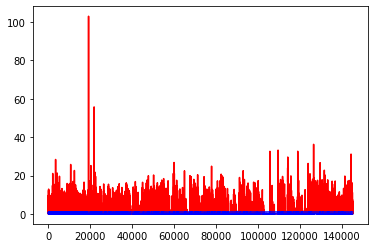

white ratio : 51.75
min : 177
max : 228


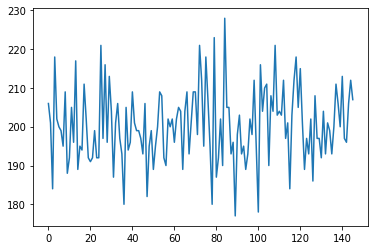

Generating interpolations...
145001 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.698894, 0.068076]
145002 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.948981, 0.793182]
145003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.421004, 0.196368]
145004 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.172604, 0.431396]
145005 [D loss: 0.001166, acc.: 100.00%] [G loss: 0.698411, 0.307620]
145006 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.405894, 2.289018]
145007 [D loss: 0.000019, acc.: 100.00%] [G loss: 1.606730, 0.989079]
145008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.387164, 0.273505]
145009 [D loss: 0.000015, acc.: 100.00%] [G loss: 10.018353, 2.457234]
145010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.189435, 0.085855]
145011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.228375, 0.266901]
145012 [D loss: 0.001844, acc.: 100.00%] [G loss: 1.573087, 2.027748]
145013 [D loss: 0.000147, acc.: 100.00%] [G loss: 1.587023, 0.594675]
145014 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.166878, 

145116 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.243474, 2.356404]
145117 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.667608, 5.834472]
145118 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.497789, 2.554630]
145119 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.057467, 4.205338]
145120 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.053305, 0.773228]
145121 [D loss: 0.000113, acc.: 100.00%] [G loss: 1.641214, 2.540833]
145122 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.317543, 3.191951]
145123 [D loss: 0.000083, acc.: 100.00%] [G loss: 1.691887, 1.731593]
145124 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.216665, 0.127724]
145125 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.953474, 0.736732]
145126 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.427663, 0.530788]
145127 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.214823, 2.464770]
145128 [D loss: 0.046249, acc.: 96.88%] [G loss: 1.392427, 0.664654]
145129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.636148, 0.053868]
145130 [D loss: 0.0

145233 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.490349, 12.670609]
145234 [D loss: 0.000000, acc.: 100.00%] [G loss: 27.125067, 11.949153]
145235 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.474575, 12.824591]
145236 [D loss: 0.000331, acc.: 100.00%] [G loss: 10.429955, 10.217143]
145237 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.421700, 12.467409]
145238 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.991860, 9.345982]
145239 [D loss: 0.000010, acc.: 100.00%] [G loss: 15.550075, 12.530951]
145240 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.888405, 10.086866]
145241 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.808949, 7.851996]
145242 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.107777, 10.465227]
145243 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.886405, 4.548977]
145244 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.773493, 10.743084]
145245 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.233485, 5.461004]
145246 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.392605, 7.906346]
14

145350 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.894054, 0.109522]
145351 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.548092, 0.041829]
145352 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036776, 0.024482]
145353 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.339392, 0.555393]
145354 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.044879, 0.150327]
145355 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.354789, 0.331656]
145356 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.500420, 0.312773]
145357 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.056730, 0.010528]
145358 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.494374, 0.204133]
145359 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.417810, 0.052406]
145360 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.163626, 0.189813]
145361 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.414164, 1.185705]
145362 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.100301, 0.069195]
145363 [D loss: 0.000008, acc.: 100.00%] [G loss: 24.878450, 0.938122]
145364 [D loss: 0.0

145467 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.440024, 0.871942]
145468 [D loss: 0.000294, acc.: 100.00%] [G loss: 26.884325, 0.653454]
145469 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.399721, 1.939289]
145470 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.761997, 3.189342]
145471 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.831576, 1.208180]
145472 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.319926, 2.211899]
145473 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.672870, 0.720355]
145474 [D loss: 0.000016, acc.: 100.00%] [G loss: 2.235198, 2.282599]
145475 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.825247, 1.734293]
145476 [D loss: 0.000152, acc.: 100.00%] [G loss: 1.049129, 0.902627]
145477 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.550051, 2.459090]
145478 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.044590, 1.597818]
145479 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.746307, 0.811329]
145480 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.238507, 0.637912]
145481 [D loss: 0.0

145585 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.141657, 0.087037]
145586 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.163462, 0.212045]
145587 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.683351, 0.666639]
145588 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.002374, 0.001114]
145589 [D loss: 0.003577, acc.: 100.00%] [G loss: 0.286750, 0.582003]
145590 [D loss: 0.000414, acc.: 100.00%] [G loss: 0.197959, 0.088031]
145591 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.390746, 0.047046]
145592 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.228442, 0.655017]
145593 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.189633, 0.463582]
145594 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.320697, 0.489725]
145595 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.261676, 0.168941]
145596 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.017329, 0.015747]
145597 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.411965, 0.617702]
145598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.055995, 0.374353]
145599 [D loss: 0.00

145703 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.328733, 0.622535]
145704 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.264745, 0.076818]
145705 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.425374, 0.406072]
145706 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.175650, 0.441306]
145707 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.440941, 0.230800]
145708 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.058071, 0.118092]
145709 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.124826, 0.213663]
145710 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.195041, 0.106810]
145711 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.539727, 0.928465]
145712 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.856652, 0.682135]
145713 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.580017, 0.456302]
145714 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.002063, 0.035705]
145715 [D loss: 0.006990, acc.: 100.00%] [G loss: 0.158875, 0.319840]
145716 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.308254, 0.194502]
145717 [D loss: 0.00

145822 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.268153, 0.645625]
145823 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.338292, 0.984366]
145824 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.969278, 0.349516]
145825 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.502099, 0.593366]
145826 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.596448, 0.724483]
145827 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.613147, 0.941321]
145828 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.894319, 0.475778]
145829 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.445467, 1.984760]
145830 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.375217, 2.346963]
145831 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.583959, 2.121502]
145832 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.272493, 0.969658]
145833 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.823806, 0.572801]
145834 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.597720, 1.421176]
145835 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.446867, 0.963152]
145836 [D loss: 0.00

145940 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.555805, 1.492110]
145941 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.587267, 0.890111]
145942 [D loss: 0.000030, acc.: 100.00%] [G loss: 10.759085, 3.293572]
145943 [D loss: 0.000149, acc.: 100.00%] [G loss: 5.094753, 5.341349]
145944 [D loss: 0.000100, acc.: 100.00%] [G loss: 5.014559, 4.183626]
145945 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.104494, 4.157544]
145946 [D loss: 0.000014, acc.: 100.00%] [G loss: 3.757177, 3.648923]
145947 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.333605, 4.202928]
145948 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.327950, 2.701091]
145949 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.461145, 2.379744]
145950 [D loss: 0.000077, acc.: 100.00%] [G loss: 4.684690, 2.249955]
145951 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.474197, 3.590066]
145952 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.642359, 4.220458]
145953 [D loss: 0.000038, acc.: 100.00%] [G loss: 3.689404, 2.679582]
145954 [D loss: 0.0

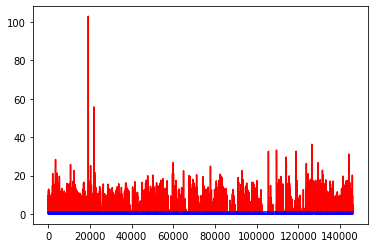

white ratio : 49.0
min : 177
max : 228


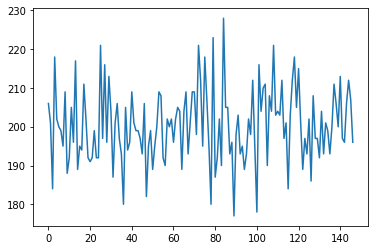

Generating interpolations...
146001 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.771268, 0.654153]
146002 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.540482, 0.591284]
146003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.781297, 0.343821]
146004 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.939476, 1.726604]
146005 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.367942, 0.397535]
146006 [D loss: 0.000068, acc.: 100.00%] [G loss: 1.498867, 1.146787]
146007 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.494429, 0.716039]
146008 [D loss: 0.000106, acc.: 100.00%] [G loss: 2.139903, 1.243629]
146009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.201740, 0.239531]
146010 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.277895, 0.599061]
146011 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.523332, 0.616709]
146012 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.474071, 0.189530]
146013 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.824836, 0.557470]
146014 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.894679, 0

146119 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.172924, 4.093207]
146120 [D loss: 0.000024, acc.: 100.00%] [G loss: 3.089078, 4.168749]
146121 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.724070, 5.423277]
146122 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.973292, 4.437321]
146123 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.331678, 2.980401]
146124 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.878716, 4.294312]
146125 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.639201, 3.300045]
146126 [D loss: 0.000030, acc.: 100.00%] [G loss: 6.412859, 5.170467]
146127 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.210886, 5.660031]
146128 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.071440, 4.299083]
146129 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.806767, 6.144784]
146130 [D loss: 0.000010, acc.: 100.00%] [G loss: 6.454599, 6.534399]
146131 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.002543, 10.411130]
146132 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.876642, 9.920931]
146133 [D loss: 0.

146238 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.014128, 3.078928]
146239 [D loss: 0.000013, acc.: 100.00%] [G loss: 8.660609, 2.020780]
146240 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.089666, 4.649992]
146241 [D loss: 0.000467, acc.: 100.00%] [G loss: 4.377845, 2.677013]
146242 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.842176, 4.889130]
146243 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.950042, 2.032792]
146244 [D loss: 0.002678, acc.: 100.00%] [G loss: 5.133181, 5.204524]
146245 [D loss: 0.001804, acc.: 100.00%] [G loss: 5.063050, 5.441326]
146246 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.031576, 2.329280]
146247 [D loss: 0.000360, acc.: 100.00%] [G loss: 2.306563, 2.846661]
146248 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.718302, 4.008324]
146249 [D loss: 0.003291, acc.: 100.00%] [G loss: 2.022764, 1.218306]
146250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.971292, 1.246066]
146251 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.959679, 1.942813]
146252 [D loss: 0.05

146356 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.449574, 8.167164]
146357 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.676534, 8.704852]
146358 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.871155, 5.106750]
146359 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.394774, 6.267679]
146360 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.454575, 8.225943]
146361 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.521755, 3.914761]
146362 [D loss: 0.002376, acc.: 100.00%] [G loss: 5.209047, 5.344029]
146363 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.193624, 4.379956]
146364 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.387760, 2.682728]
146365 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.590879, 3.467258]
146366 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.133490, 2.342013]
146367 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.369402, 2.563447]
146368 [D loss: 0.000009, acc.: 100.00%] [G loss: 2.636135, 2.519462]
146369 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.972952, 2.339188]
146370 [D loss: 0.00

146475 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.618193, 1.507293]
146476 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.881252, 3.686522]
146477 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.189500, 4.353418]
146478 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.391465, 3.444323]
146479 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.579233, 3.355194]
146480 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.684470, 3.701950]
146481 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.263245, 1.387913]
146482 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.595546, 1.617206]
146483 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.509297, 1.377469]
146484 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.843706, 1.590343]
146485 [D loss: 0.000011, acc.: 100.00%] [G loss: 4.197837, 3.786315]
146486 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.757230, 4.451294]
146487 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.486162, 4.287506]
146488 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.786484, 3.329926]
146489 [D loss: 0.00

146595 [D loss: 0.000038, acc.: 100.00%] [G loss: 5.593288, 4.532022]
146596 [D loss: 0.000035, acc.: 100.00%] [G loss: 2.601958, 1.814090]
146597 [D loss: 0.000044, acc.: 100.00%] [G loss: 5.191976, 3.122077]
146598 [D loss: 0.026971, acc.: 96.88%] [G loss: 1.339196, 1.307536]
146599 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.733597, 2.162109]
146600 [D loss: 0.000596, acc.: 100.00%] [G loss: 2.234523, 2.017805]
146601 [D loss: 0.000498, acc.: 100.00%] [G loss: 1.614889, 1.676901]
146602 [D loss: 0.000031, acc.: 100.00%] [G loss: 2.601596, 3.259533]
146603 [D loss: 0.000045, acc.: 100.00%] [G loss: 13.287298, 2.426806]
146604 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.579544, 2.626541]
146605 [D loss: 0.000029, acc.: 100.00%] [G loss: 2.655463, 3.673287]
146606 [D loss: 0.000138, acc.: 100.00%] [G loss: 3.142783, 4.522851]
146607 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.451968, 3.437536]
146608 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.708822, 3.228505]
146609 [D loss: 0.00

146715 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.153733, 4.550601]
146716 [D loss: 0.000070, acc.: 100.00%] [G loss: 2.539015, 1.739343]
146717 [D loss: 0.000072, acc.: 100.00%] [G loss: 4.573057, 4.079627]
146718 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.931804, 2.269120]
146719 [D loss: 0.003841, acc.: 100.00%] [G loss: 4.781437, 4.215900]
146720 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.177815, 1.923487]
146721 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.027446, 1.877104]
146722 [D loss: 0.000072, acc.: 100.00%] [G loss: 1.664905, 1.203698]
146723 [D loss: 0.000029, acc.: 100.00%] [G loss: 3.095861, 3.105702]
146724 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.899621, 1.917333]
146725 [D loss: 0.000019, acc.: 100.00%] [G loss: 3.097804, 2.155312]
146726 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.023613, 3.100255]
146727 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.837169, 4.571079]
146728 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.952147, 3.590088]
146729 [D loss: 0.0

146833 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.874795, 9.349791]
146834 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.762569, 10.124295]
146835 [D loss: 0.000009, acc.: 100.00%] [G loss: 9.792603, 10.429547]
146836 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.366560, 11.991446]
146837 [D loss: 0.000031, acc.: 100.00%] [G loss: 9.646241, 9.571923]
146838 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.110163, 8.835737]
146839 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.117971, 12.208067]
146840 [D loss: 0.000016, acc.: 100.00%] [G loss: 7.540916, 8.883255]
146841 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.095360, 10.419794]
146842 [D loss: 0.000029, acc.: 100.00%] [G loss: 10.873728, 10.924116]
146843 [D loss: 0.000005, acc.: 100.00%] [G loss: 10.220995, 9.654366]
146844 [D loss: 0.001975, acc.: 100.00%] [G loss: 8.742205, 9.443410]
146845 [D loss: 0.000012, acc.: 100.00%] [G loss: 8.778303, 9.029271]
146846 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.187109, 10.236768]
146847 [D

146949 [D loss: 0.000118, acc.: 100.00%] [G loss: 12.203766, 12.528835]
146950 [D loss: 0.000019, acc.: 100.00%] [G loss: 9.672472, 9.675955]
146951 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.919191, 11.959013]
146952 [D loss: 0.000006, acc.: 100.00%] [G loss: 12.999683, 13.985735]
146953 [D loss: 0.000078, acc.: 100.00%] [G loss: 13.946604, 14.743865]
146954 [D loss: 0.000154, acc.: 100.00%] [G loss: 10.506350, 10.545019]
146955 [D loss: 0.000079, acc.: 100.00%] [G loss: 12.118542, 11.597758]
146956 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.209738, 7.994942]
146957 [D loss: 0.000027, acc.: 100.00%] [G loss: 12.641353, 11.714268]
146958 [D loss: 0.000045, acc.: 100.00%] [G loss: 12.748668, 12.012899]
146959 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.455332, 11.083450]
146960 [D loss: 0.000008, acc.: 100.00%] [G loss: 12.623491, 13.594141]
146961 [D loss: 0.000009, acc.: 100.00%] [G loss: 14.574116, 12.875260]
146962 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.767576, 15.644

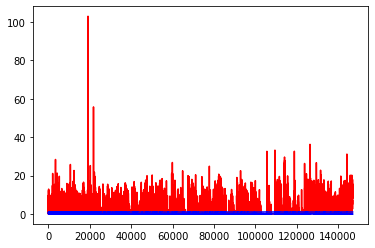

white ratio : 51.5
min : 177
max : 228


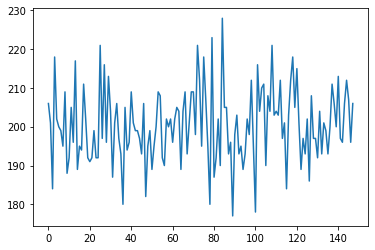

Generating interpolations...
147001 [D loss: 0.000041, acc.: 100.00%] [G loss: 11.348736, 10.850658]
147002 [D loss: 0.000092, acc.: 100.00%] [G loss: 10.756904, 10.088610]
147003 [D loss: 0.000209, acc.: 100.00%] [G loss: 11.252235, 10.485170]
147004 [D loss: 0.000397, acc.: 100.00%] [G loss: 10.931759, 10.604509]
147005 [D loss: 0.000025, acc.: 100.00%] [G loss: 11.494512, 10.545081]
147006 [D loss: 0.000025, acc.: 100.00%] [G loss: 8.530732, 8.459534]
147007 [D loss: 0.000546, acc.: 100.00%] [G loss: 8.486971, 8.163035]
147008 [D loss: 0.000463, acc.: 100.00%] [G loss: 11.020462, 10.704559]
147009 [D loss: 0.003090, acc.: 100.00%] [G loss: 9.948435, 8.932165]
147010 [D loss: 0.000168, acc.: 100.00%] [G loss: 10.520264, 10.218428]
147011 [D loss: 0.000034, acc.: 100.00%] [G loss: 9.893713, 8.390713]
147012 [D loss: 0.000845, acc.: 100.00%] [G loss: 10.963786, 10.246204]
147013 [D loss: 0.000496, acc.: 100.00%] [G loss: 9.621437, 10.664518]
147014 [D loss: 0.000026, acc.: 100.00%] [G 

147116 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.758429, 13.381737]
147117 [D loss: 0.000641, acc.: 100.00%] [G loss: 14.351717, 14.625402]
147118 [D loss: 0.000018, acc.: 100.00%] [G loss: 14.792634, 14.883468]
147119 [D loss: 0.000041, acc.: 100.00%] [G loss: 14.046762, 14.514118]
147120 [D loss: 0.000049, acc.: 100.00%] [G loss: 15.271389, 14.184956]
147121 [D loss: 0.000017, acc.: 100.00%] [G loss: 13.134271, 13.002700]
147122 [D loss: 0.000013, acc.: 100.00%] [G loss: 13.782179, 13.774245]
147123 [D loss: 0.000061, acc.: 100.00%] [G loss: 11.786638, 12.704002]
147124 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.611171, 12.956493]
147125 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.702015, 12.390767]
147126 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.651884, 12.696255]
147127 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.955030, 11.697409]
147128 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.695050, 13.318944]
147129 [D loss: 0.000002, acc.: 100.00%] [G loss: 14.384815, 14.

147234 [D loss: 0.000554, acc.: 100.00%] [G loss: 7.090526, 7.057425]
147235 [D loss: 0.000579, acc.: 100.00%] [G loss: 6.244034, 5.081490]
147236 [D loss: 0.000346, acc.: 100.00%] [G loss: 7.567218, 7.386143]
147237 [D loss: 0.000203, acc.: 100.00%] [G loss: 7.015007, 7.063012]
147238 [D loss: 0.000162, acc.: 100.00%] [G loss: 6.949897, 7.436345]
147239 [D loss: 0.000939, acc.: 100.00%] [G loss: 8.619029, 9.180848]
147240 [D loss: 0.024263, acc.: 96.88%] [G loss: 2.933364, 3.811722]
147241 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.321280, 1.806289]
147242 [D loss: 0.004293, acc.: 100.00%] [G loss: 12.065695, 4.607790]
147243 [D loss: 0.000396, acc.: 100.00%] [G loss: 3.540773, 3.655768]
147244 [D loss: 0.000120, acc.: 100.00%] [G loss: 6.324858, 6.594932]
147245 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.058683, 4.709161]
147246 [D loss: 0.001269, acc.: 100.00%] [G loss: 4.812564, 5.065782]
147247 [D loss: 0.000125, acc.: 100.00%] [G loss: 6.628407, 6.500397]
147248 [D loss: 0.00

147351 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.379531, 4.447214]
147352 [D loss: 0.000691, acc.: 100.00%] [G loss: 9.244013, 9.038804]
147353 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.226362, 7.642102]
147354 [D loss: 0.000236, acc.: 100.00%] [G loss: 8.325068, 7.004364]
147355 [D loss: 0.000004, acc.: 100.00%] [G loss: 8.495268, 8.017921]
147356 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.044461, 4.356886]
147357 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.572689, 6.596659]
147358 [D loss: 0.000064, acc.: 100.00%] [G loss: 4.494387, 4.374285]
147359 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.777247, 6.517524]
147360 [D loss: 0.000145, acc.: 100.00%] [G loss: 6.900560, 8.008865]
147361 [D loss: 0.000087, acc.: 100.00%] [G loss: 7.088365, 6.258781]
147362 [D loss: 0.000094, acc.: 100.00%] [G loss: 3.694804, 2.732573]
147363 [D loss: 0.000726, acc.: 100.00%] [G loss: 8.811010, 7.761512]
147364 [D loss: 0.001228, acc.: 100.00%] [G loss: 1.719212, 1.732406]
147365 [D loss: 0.00

147471 [D loss: 0.000986, acc.: 100.00%] [G loss: 5.760238, 5.123502]
147472 [D loss: 0.000147, acc.: 100.00%] [G loss: 4.097899, 4.223742]
147473 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.317195, 4.020254]
147474 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.890443, 2.127028]
147475 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.807458, 3.575865]
147476 [D loss: 0.000088, acc.: 100.00%] [G loss: 2.329518, 2.321477]
147477 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.712179, 2.334305]
147478 [D loss: 0.000095, acc.: 100.00%] [G loss: 1.096502, 1.951788]
147479 [D loss: 0.001860, acc.: 100.00%] [G loss: 5.891331, 6.080095]
147480 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.786362, 6.407090]
147481 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.026214, 1.324621]
147482 [D loss: 0.000261, acc.: 100.00%] [G loss: 1.272655, 0.410017]
147483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.294164, 0.181085]
147484 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.276129, 5.448675]
147485 [D loss: 0.0

147590 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.914774, 1.509255]
147591 [D loss: 0.001125, acc.: 100.00%] [G loss: 1.211984, 1.548552]
147592 [D loss: 0.000070, acc.: 100.00%] [G loss: 1.780375, 1.522956]
147593 [D loss: 0.002479, acc.: 100.00%] [G loss: 8.485592, 2.965304]
147594 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.996954, 5.592775]
147595 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.706870, 0.609181]
147596 [D loss: 0.000007, acc.: 100.00%] [G loss: 20.426229, 0.751825]
147597 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.109220, 6.010705]
147598 [D loss: 0.005323, acc.: 100.00%] [G loss: 5.201368, 5.290116]
147599 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.823643, 3.276747]
147600 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.175918, 3.877546]
147601 [D loss: 0.000309, acc.: 100.00%] [G loss: 3.469525, 3.632984]
147602 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.298579, 2.619208]
147603 [D loss: 0.000084, acc.: 100.00%] [G loss: 3.577921, 3.671566]
147604 [D loss: 0.0

147709 [D loss: 0.047169, acc.: 96.88%] [G loss: 0.010835, 0.010926]
147710 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.098611, 0.302849]
147711 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.285837, 0.021607]
147712 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.024829, 0.008842]
147713 [D loss: 0.023307, acc.: 96.88%] [G loss: 0.005809, 0.102665]
147714 [D loss: 0.005668, acc.: 100.00%] [G loss: 0.008061, 0.009088]
147715 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.011160, 0.055671]
147716 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.194230, 0.268414]
147717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284799, 0.207963]
147718 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.029503, 0.015261]
147719 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.002147, 0.006633]
147720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.016431, 0.007065]
147721 [D loss: 0.005831, acc.: 100.00%] [G loss: 0.070218, 0.114562]
147722 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.002014, 0.016224]
147723 [D loss: 0.0000

147827 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016197, 0.003680]
147828 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.177482, 0.108717]
147829 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.326336, 0.210750]
147830 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.018952, 0.006081]
147831 [D loss: 0.002095, acc.: 100.00%] [G loss: 0.062801, 0.071365]
147832 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.070688, 0.271090]
147833 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.630158, 0.502843]
147834 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.034006, 0.000168]
147835 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.393182, 0.080857]
147836 [D loss: 0.000625, acc.: 100.00%] [G loss: 0.311251, 0.300546]
147837 [D loss: 0.000489, acc.: 100.00%] [G loss: 0.016901, 0.005093]
147838 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.009850, 0.001752]
147839 [D loss: 0.000285, acc.: 100.00%] [G loss: 0.003202, 0.066890]
147840 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010021, 0.008672]
147841 [D loss: 0.00

147945 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000028, 0.000327]
147946 [D loss: 0.000155, acc.: 100.00%] [G loss: 0.000695, 0.000072]
147947 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002314, 0.003464]
147948 [D loss: 0.002692, acc.: 100.00%] [G loss: 0.000063, 0.000046]
147949 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.020859, 0.002849]
147950 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.001196, 0.000278]
147951 [D loss: 0.013170, acc.: 100.00%] [G loss: 0.008428, 0.036433]
147952 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001267, 0.000376]
147953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001067, 0.000169]
147954 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.057644, 0.004762]
147955 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.007030, 0.002617]
147956 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.007439, 0.008007]
147957 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.001253, 0.001031]
147958 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.077465, 0.002819]
147959 [D loss: 0.00

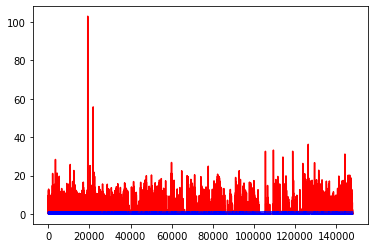

white ratio : 45.5
min : 177
max : 228


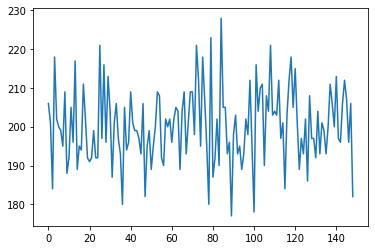

Generating interpolations...
148001 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000470, 0.012014]
148002 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003576, 0.016172]
148003 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000610, 0.000053]
148004 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.001387, 0.000046]
148005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032449, 0.007907]
148006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002434, 0.009524]
148007 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.002614, 0.001247]
148008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001958, 0.000092]
148009 [D loss: 0.057954, acc.: 96.88%] [G loss: 0.000001, 0.000024]
148010 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000013, 0.000004]
148011 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000015, 0.000005]
148012 [D loss: 0.000923, acc.: 100.00%] [G loss: 0.000001, 0.000001]
148013 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000036, 0.001338]
148014 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.

148121 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001162, 0.000007]
148122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000013, 0.000017]
148123 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.000000, 0.000023]
148124 [D loss: 0.001765, acc.: 100.00%] [G loss: 0.000867, 0.000003]
148125 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000565, 0.000084]
148126 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000009, 0.000086]
148127 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.136637, 0.000955]
148128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000036, 0.000026]
148129 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.000101, 0.000040]
148130 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000032, 0.000004]
148131 [D loss: 0.001235, acc.: 100.00%] [G loss: 0.000179, 0.000055]
148132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000040, 0.001712]
148133 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000148, 0.001097]
148134 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.001200, 0.000122]
148135 [D loss: 0.00

148241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000165, 0.000489]
148242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000037, 0.000644]
148243 [D loss: 0.002702, acc.: 100.00%] [G loss: 0.000332, 0.000029]
148244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000643, 0.000014]
148245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000026, 0.001081]
148246 [D loss: 0.000952, acc.: 100.00%] [G loss: 0.014684, 0.003801]
148247 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.052996, 0.003723]
148248 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000066, 0.000088]
148249 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000104, 0.000021]
148250 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000120, 0.024971]
148251 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.000003, 0.000014]
148252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000013, 0.000046]
148253 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000032, 0.001538]
148254 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000238, 0.000005]
148255 [D loss: 0.00

148360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000760]
148361 [D loss: 0.000543, acc.: 100.00%] [G loss: 0.000009, 0.000030]
148362 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.004556, 0.001473]
148363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000122, 0.000004]
148364 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001074, 0.000024]
148365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000222, 0.000026]
148366 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000121, 0.000198]
148367 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000100, 0.000006]
148368 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000189, 0.010495]
148369 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000212, 0.000007]
148370 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000003, 0.000089]
148371 [D loss: 0.000222, acc.: 100.00%] [G loss: 0.000107, 0.000384]
148372 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001314, 0.035119]
148373 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.003405, 0.000815]
148374 [D loss: 0.00

148479 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000043, 0.000069]
148480 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000023]
148481 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.000001, 0.000000]
148482 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
148483 [D loss: 0.000609, acc.: 100.00%] [G loss: 0.000006, 0.000001]
148484 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.000728, 0.000444]
148485 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000001, 0.000019]
148486 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
148487 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000311, 0.000088]
148488 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000006, 0.000006]
148489 [D loss: 0.002283, acc.: 100.00%] [G loss: 0.000032, 0.000003]
148490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000009]
148491 [D loss: 0.008762, acc.: 100.00%] [G loss: 0.000007, 0.000001]
148492 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000007, 0.000001]
148493 [D loss: 0.00

148599 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000032, 0.000016]
148600 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000004]
148601 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000538, 0.000508]
148602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001290, 0.001161]
148603 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000029, 0.000005]
148604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000001]
148605 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.007646, 0.002909]
148606 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000338, 0.000000]
148607 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.050962, 0.088037]
148608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000254, 0.099937]
148609 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.003994, 0.009192]
148610 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000001, 0.000000]
148611 [D loss: 0.053238, acc.: 96.88%] [G loss: 0.004185, 0.046228]
148612 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.003966, 0.001021]
148613 [D loss: 0.000

148720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.318390, 0.220592]
148721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.289211, 0.062857]
148722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.596266, 0.423424]
148723 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.499851, 0.316351]
148724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.244078, 0.418206]
148725 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.345278, 1.849175]
148726 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.224733, 0.404992]
148727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.268399, 0.326056]
148728 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.253576, 0.035497]
148729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.283964, 0.544358]
148730 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.360101, 0.078773]
148731 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.092893, 0.052693]
148732 [D loss: 0.005499, acc.: 100.00%] [G loss: 0.173250, 0.105249]
148733 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.003815, 0.095424]
148734 [D loss: 0.00

148841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003929, 0.016719]
148842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.052152, 0.050533]
148843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.250363, 0.034604]
148844 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.267074, 0.003303]
148845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.040247, 0.095053]
148846 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.003932, 0.025083]
148847 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.056462, 0.362213]
148848 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.336627, 0.242229]
148849 [D loss: 0.000009, acc.: 100.00%] [G loss: 1.532779, 0.902725]
148850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009143, 0.024317]
148851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017864, 0.150633]
148852 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.328478, 0.042611]
148853 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.059401, 0.004879]
148854 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003885, 0.000923]
148855 [D loss: 0.00

148961 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.166239, 0.017687]
148962 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.538883, 0.373703]
148963 [D loss: 0.058654, acc.: 96.88%] [G loss: 1.959835, 2.012182]
148964 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.055706, 11.595444]
148965 [D loss: 0.000033, acc.: 100.00%] [G loss: 8.822714, 8.730610]
148966 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.488693, 7.632202]
148967 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.770430, 6.174706]
148968 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.376789, 6.437995]
148969 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.328360, 10.381815]
148970 [D loss: 0.000018, acc.: 100.00%] [G loss: 5.608719, 4.279657]
148971 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.421767, 7.017144]
148972 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.308167, 3.663898]
148973 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.883921, 4.406627]
148974 [D loss: 0.017574, acc.: 100.00%] [G loss: 1.490791, 1.425177]
148975 [D loss: 0

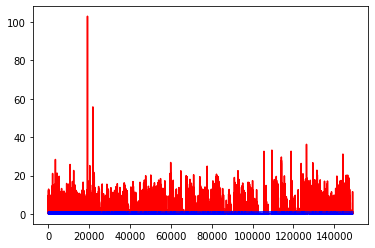

white ratio : 50.75
min : 177
max : 228


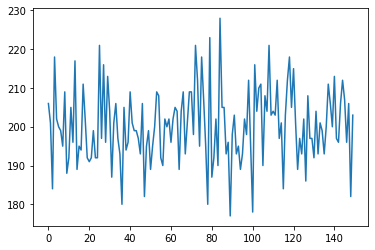

Generating interpolations...
149001 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.868886, 1.673246]
149002 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.907671, 0.417926]
149003 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.334139, 0.854768]
149004 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.842814, 4.678510]
149005 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.394030, 1.021402]
149006 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.595963, 3.408276]
149007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.204730, 0.401599]
149008 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.588337, 0.014218]
149009 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.566068, 3.020476]
149010 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.028895, 0.009932]
149011 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.492385, 0.552608]
149012 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.557982, 2.489419]
149013 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.009331, 0.004316]
149014 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.937131, 1

149119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033542, 0.003611]
149120 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001487, 0.014402]
149121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.230035, 0.418086]
149122 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.014932, 0.008525]
149123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.780985, 0.886108]
149124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.839315, 0.709349]
149125 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.436707, 0.823273]
149126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000157, 0.000061]
149127 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.108861, 0.006116]
149128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006073, 0.081570]
149129 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001233, 0.014637]
149130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009328, 0.031021]
149131 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000406, 0.007238]
149132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001158, 0.031690]
149133 [D loss: 0.00

149239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000542, 0.014380]
149240 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000689, 0.011236]
149241 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.051619, 0.040338]
149242 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.022207, 0.003449]
149243 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.015561, 0.001614]
149244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002664, 0.000558]
149245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001466, 0.001163]
149246 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.002091, 0.002877]
149247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000268, 0.050193]
149248 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.002012, 0.046133]
149249 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.081744, 0.000288]
149250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013643, 0.007648]
149251 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004494, 0.000689]
149252 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.173692, 0.006920]
149253 [D loss: 0.00

149357 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.070283, 0.005301]
149358 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000125, 0.001300]
149359 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.004549, 0.002331]
149360 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.017164, 0.008803]
149361 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.022243, 0.002000]
149362 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.046440, 0.320280]
149363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.022552, 0.000847]
149364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.096888, 0.014893]
149365 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000309, 0.073791]
149366 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.007189, 0.009668]
149367 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000027, 0.000022]
149368 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.001502, 0.000205]
149369 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000838, 0.003301]
149370 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000819, 0.019287]
149371 [D loss: 0.00

149478 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000084, 0.000068]
149479 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000035, 0.000058]
149480 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.315889, 0.350253]
149481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000011, 0.000004]
149482 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000012, 0.000018]
149483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.042619, 0.130931]
149484 [D loss: 0.000559, acc.: 100.00%] [G loss: 0.001307, 0.002321]
149485 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000428, 0.000135]
149486 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000249, 0.004410]
149487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000021, 0.000027]
149488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000217]
149489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000160, 0.001743]
149490 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.002341, 0.002903]
149491 [D loss: 0.001481, acc.: 100.00%] [G loss: 0.085143, 0.026286]
149492 [D loss: 0.00

149597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000254, 0.001181]
149598 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.059560, 0.323106]
149599 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.015980, 0.001759]
149600 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.309025, 1.122721]
149601 [D loss: 0.000013, acc.: 100.00%] [G loss: 3.093210, 0.040561]
149602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.047743, 0.027122]
149603 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000125, 0.000025]
149604 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.033557, 0.075815]
149605 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000140, 0.000188]
149606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000045, 0.000427]
149607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.208310, 0.063962]
149608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000231, 0.000039]
149609 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000051, 0.000080]
149610 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.031116, 0.020078]
149611 [D loss: 0.00

149716 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001129, 0.000543]
149717 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.004547, 0.000217]
149718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009661, 0.000655]
149719 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.498372, 0.305553]
149720 [D loss: 0.000139, acc.: 100.00%] [G loss: 1.034534, 0.471221]
149721 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.009829, 0.006350]
149722 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.000032, 0.000023]
149723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000003]
149724 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.008063, 0.001420]
149725 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.869689, 0.793022]
149726 [D loss: 0.000237, acc.: 100.00%] [G loss: 0.001515, 0.007900]
149727 [D loss: 0.000001, acc.: 100.00%] [G loss: 20.787296, 0.038640]
149728 [D loss: 0.000656, acc.: 100.00%] [G loss: 0.243468, 0.195619]
149729 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.126666, 0.673655]
149730 [D loss: 0.0

149836 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.271255, 0.228989]
149837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.311179, 0.398060]
149838 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.193556, 0.245790]
149839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.995526, 0.721606]
149840 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.412002, 0.487059]
149841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.891148, 0.679844]
149842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.653994, 1.033481]
149843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.230912, 0.498110]
149844 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.548289, 0.416295]
149845 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.200859, 0.467320]
149846 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.069184, 0.178825]
149847 [D loss: 0.000281, acc.: 100.00%] [G loss: 0.400437, 0.461026]
149848 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.493162, 0.260893]
149849 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.418133, 0.227898]
149850 [D loss: 0.00

149957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000011, 0.000017]
149958 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000026, 0.000006]
149959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.001035]
149960 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.000010, 0.000059]
149961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000006]
149962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000012, 0.000001]
149963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000062, 0.000142]
149964 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
149965 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
149966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000027, 0.000669]
149967 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.000003, 0.000021]
149968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000048, 0.000556]
149969 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000662, 0.000056]
149970 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000032, 0.000032]
149971 [D loss: 0.00

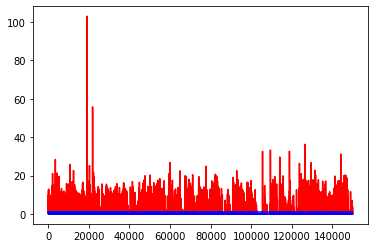

white ratio : 48.0
min : 177
max : 228


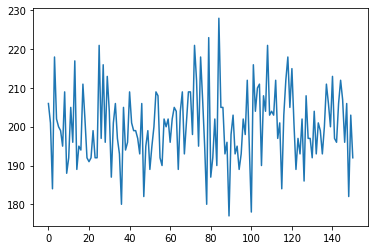

Generating interpolations...
150001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000031, 0.000003]
150002 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.002028, 0.000041]
150003 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000444, 0.000042]
150004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000653, 0.000064]
150005 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.034638, 0.044634]
150006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.072759, 0.007652]
150007 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000485, 0.000383]
150008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002452, 0.125401]
150009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000184, 0.001152]
150010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014842, 0.008345]
150011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.063162, 0.012159]
150012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009674, 0.001062]
150013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001762, 0.013070]
150014 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000988, 0

150116 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.009870, 0.000114]
150117 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000149, 0.000020]
150118 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.071212, 0.000995]
150119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000151, 0.026893]
150120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003342, 0.000925]
150121 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000288, 0.000586]
150122 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000094, 0.000045]
150123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000347, 0.000030]
150124 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000075, 0.000030]
150125 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000092, 0.000371]
150126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.018614, 0.000721]
150127 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.005250, 0.003023]
150128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000370, 0.000698]
150129 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000226, 0.000041]
150130 [D loss: 0.00

150234 [D loss: 0.000377, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150235 [D loss: 0.031236, acc.: 96.88%] [G loss: 0.000271, 0.000000]
150236 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.004570]
150237 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.096046, 0.000080]
150238 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000985, 0.001685]
150239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.194098, 0.006696]
150240 [D loss: 0.001054, acc.: 100.00%] [G loss: 0.001993, 0.077226]
150241 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000235, 0.000103]
150242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032486, 0.015135]
150243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001061, 0.000163]
150244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000037, 0.000019]
150245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.037406, 0.001709]
150246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001978, 0.000194]
150247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000215, 0.002620]
150248 [D loss: 0.000

150353 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000017, 0.000000]
150354 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150355 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150356 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150357 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150358 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150359 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150360 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150361 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150362 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150363 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150364 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150365 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150366 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150367 [D loss: 0.00

150472 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150473 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150474 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000001, 0.000001]
150475 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150476 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
150477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150478 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150479 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000020]
150480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150481 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000005]
150482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007194, 0.000000]
150483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000001]
150484 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000001]
150485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150486 [D loss: 0.00

150592 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
150593 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000001, 0.000002]
150594 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000010, 0.000101]
150595 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000001, 0.000001]
150596 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150597 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000000]
150598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000003]
150599 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000002]
150600 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000009, 0.000001]
150601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000092]
150602 [D loss: 0.001586, acc.: 100.00%] [G loss: 0.000001, 0.000002]
150603 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000002]
150605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150606 [D loss: 0.00

150711 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.000004]
150712 [D loss: 0.000671, acc.: 100.00%] [G loss: 0.000002, 0.000010]
150713 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
150714 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000026]
150715 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150716 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
150718 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000086, 0.000000]
150719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000001]
150721 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000040]
150723 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000002]
150725 [D loss: 0.00

150829 [D loss: 0.000734, acc.: 100.00%] [G loss: 0.000001, 0.000118]
150830 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150831 [D loss: 0.011227, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150832 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000114]
150833 [D loss: 0.000652, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150834 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000016]
150835 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000027]
150836 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150837 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000001]
150838 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.000000, 0.000000]
150839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000075, 0.000003]
150840 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000002, 0.000000]
150841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
150842 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000006, 0.000012]
150843 [D loss: 0.00

150947 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000101, 0.000005]
150948 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000120, 0.000010]
150949 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.014059, 0.000009]
150950 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000435]
150951 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000221, 0.000017]
150952 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000876]
150953 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000434, 0.000140]
150954 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000466, 0.000005]
150955 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000002, 0.000043]
150956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000054, 0.000005]
150957 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000001, 0.000000]
150958 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000009, 0.000003]
150959 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000001, 0.000016]
150960 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000006]
150961 [D loss: 0.00

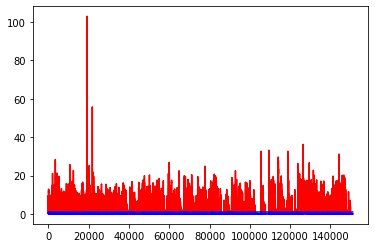

white ratio : 49.5
min : 177
max : 228


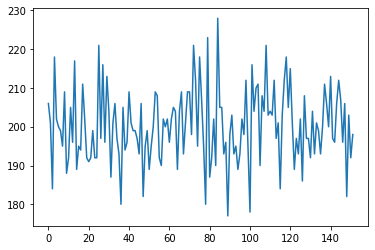

Generating interpolations...
151001 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151002 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151003 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151004 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151005 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151006 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151008 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151009 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151010 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151011 [D loss: 0.000215, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151012 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151013 [D loss: 0.001195, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0

151120 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000020, 0.000020]
151121 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000001]
151122 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151123 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000004]
151124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151125 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151126 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000004, 0.000001]
151127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
151130 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151131 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.000000, 0.000002]
151132 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151133 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000053, 0.000002]
151134 [D loss: 0.00

151240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000166, 0.000161]
151241 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000003, 0.000104]
151242 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000014, 0.000013]
151243 [D loss: 0.037706, acc.: 96.88%] [G loss: 0.000000, 0.000000]
151244 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151245 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151246 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151247 [D loss: 0.005260, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151248 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151249 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151251 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151252 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151253 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151254 [D loss: 0.000

151358 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000012, 0.000004]
151359 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000092, 0.017764]
151360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000369, 0.045929]
151361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000013, 0.000011]
151362 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.057680, 0.001977]
151363 [D loss: 0.001450, acc.: 100.00%] [G loss: 0.003283, 0.000727]
151364 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000170, 0.010268]
151365 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000059, 0.000293]
151366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000000]
151367 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.023509, 0.011464]
151368 [D loss: 0.000773, acc.: 100.00%] [G loss: 0.000112, 0.000033]
151369 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.011040, 0.008077]
151370 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001056, 0.020051]
151371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.018645, 0.001730]
151372 [D loss: 0.00

151478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000006]
151479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000079]
151480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
151481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000335, 0.003684]
151482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000010]
151483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001421, 0.000090]
151484 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000188, 0.000043]
151485 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000113, 0.000507]
151486 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000011, 0.000019]
151487 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000071, 0.000549]
151488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000002, 0.000113]
151489 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000018, 0.000878]
151490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000050, 0.000026]
151491 [D loss: 0.045689, acc.: 96.88%] [G loss: 0.000906, 0.000854]
151492 [D loss: 0.000

151596 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.845856, 8.635050]
151597 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.281065, 8.967136]
151598 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.682431, 7.200936]
151599 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.195611, 6.944551]
151600 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.932978, 6.565373]
151601 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.665634, 7.264464]
151602 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.996253, 7.447977]
151603 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.918763, 5.766814]
151604 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.707664, 6.874134]
151605 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.541618, 5.327506]
151606 [D loss: 0.000422, acc.: 100.00%] [G loss: 5.310984, 5.101623]
151607 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.837581, 5.312791]
151608 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.338038, 7.172266]
151609 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.105915, 7.282400]
151610 [D loss: 0.0

151716 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.270361, 0.174936]
151717 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.289058, 0.363370]
151718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.377458, 0.306417]
151719 [D loss: 0.000201, acc.: 100.00%] [G loss: 1.216802, 1.325054]
151720 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.765947, 0.438293]
151721 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.674415, 0.986513]
151722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.357112, 0.802321]
151723 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.115386, 0.976021]
151724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.099814, 0.089585]
151725 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.157639, 0.137440]
151726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.360942, 0.249498]
151727 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.068808, 0.100117]
151728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.247815, 0.506582]
151729 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.196510, 0.373636]
151730 [D loss: 0.00

151836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.477675, 0.136815]
151837 [D loss: 0.000932, acc.: 100.00%] [G loss: 0.078210, 0.017466]
151838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.020659, 0.021757]
151839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.080736, 0.225975]
151840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.060608, 0.009171]
151841 [D loss: 0.000051, acc.: 100.00%] [G loss: 3.268412, 0.359291]
151842 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.717425, 1.626956]
151843 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.479070, 3.424752]
151844 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.104607, 2.893235]
151845 [D loss: 0.003065, acc.: 100.00%] [G loss: 1.436929, 1.183639]
151846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.582245, 0.667952]
151847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.393412, 0.676851]
151848 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.107507, 1.184336]
151849 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.341782, 0.138575]
151850 [D loss: 0.00

151954 [D loss: 0.011035, acc.: 100.00%] [G loss: 0.272247, 0.075254]
151955 [D loss: 0.000719, acc.: 100.00%] [G loss: 0.066659, 0.363812]
151956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.137505, 0.218790]
151957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.827345, 0.213243]
151958 [D loss: 0.012744, acc.: 100.00%] [G loss: 0.167407, 0.100953]
151959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008078, 0.031265]
151960 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.189765, 0.010757]
151961 [D loss: 0.000287, acc.: 100.00%] [G loss: 0.000215, 0.000021]
151962 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.069767, 0.000987]
151963 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000004, 0.001149]
151964 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.002022, 0.003749]
151965 [D loss: 0.000000, acc.: 100.00%] [G loss: 27.694538, 2.654351]
151966 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.073553, 3.702419]
151967 [D loss: 0.000046, acc.: 100.00%] [G loss: 4.075286, 4.266714]
151968 [D loss: 0.0

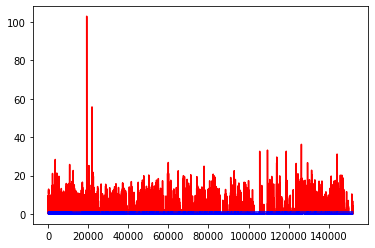

white ratio : 47.0
min : 177
max : 228


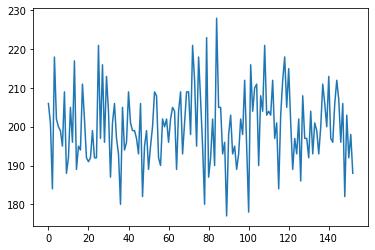

Generating interpolations...
152001 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.008988, 0.004631]
152002 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.219032, 0.318256]
152003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.176153, 0.008742]
152004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.518107, 0.397595]
152005 [D loss: 0.005622, acc.: 100.00%] [G loss: 0.585188, 0.788092]
152006 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.215488, 1.644745]
152007 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.517917, 0.789481]
152008 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.827477, 0.452785]
152009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.902899, 0.766869]
152010 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.701930, 0.194366]
152011 [D loss: 0.003576, acc.: 100.00%] [G loss: 0.611805, 0.767892]
152012 [D loss: 0.000016, acc.: 100.00%] [G loss: 1.185596, 0.657336]
152013 [D loss: 0.000056, acc.: 100.00%] [G loss: 40.457752, 3.543909]
152014 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.349049, 

152119 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.033164, 0.009420]
152120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007539, 0.016654]
152121 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.129750, 0.207206]
152122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.059280, 0.009775]
152123 [D loss: 0.002548, acc.: 100.00%] [G loss: 0.647086, 0.073215]
152124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.025523, 0.138840]
152125 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.052396, 0.130884]
152126 [D loss: 0.000120, acc.: 100.00%] [G loss: 1.290750, 0.938121]
152127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.207405, 0.072297]
152128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001507, 0.001978]
152129 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000044, 0.000021]
152130 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.032944, 0.100699]
152131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.137426, 0.073694]
152132 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.034027, 0.190734]
152133 [D loss: 0.00

152239 [D loss: 0.000556, acc.: 100.00%] [G loss: 0.000187, 0.002217]
152240 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004733, 0.001848]
152241 [D loss: 0.081481, acc.: 96.88%] [G loss: 0.106272, 0.087914]
152242 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.365381, 1.215139]
152243 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.311064, 1.579047]
152244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.835150, 0.342895]
152245 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.084966, 3.141965]
152246 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.886380, 1.987206]
152247 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.201654, 1.412439]
152248 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.756450, 2.775259]
152249 [D loss: 0.001298, acc.: 100.00%] [G loss: 5.340663, 5.287569]
152250 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.660347, 2.679582]
152251 [D loss: 0.002034, acc.: 100.00%] [G loss: 3.504254, 2.483839]
152252 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.154041, 0.063764]
152253 [D loss: 0.000

152358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.398483, 0.319838]
152359 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.860287, 0.508882]
152360 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.380540, 0.441315]
152361 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.419112, 0.690475]
152362 [D loss: 0.004052, acc.: 100.00%] [G loss: 2.047042, 1.111579]
152363 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.820789, 1.552550]
152364 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.010463, 0.063602]
152365 [D loss: 0.002903, acc.: 100.00%] [G loss: 3.270387, 0.479347]
152366 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.299346, 4.582870]
152367 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.018319, 1.665581]
152368 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.209586, 5.312288]
152369 [D loss: 0.000026, acc.: 100.00%] [G loss: 4.353809, 3.494225]
152370 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.607035, 3.203966]
152371 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.884338, 2.281705]
152372 [D loss: 0.00

152478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284164, 0.277402]
152479 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.113410, 0.034677]
152480 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.989476, 2.813558]
152481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.546424, 0.541552]
152482 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.498301, 0.484768]
152483 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.829819, 0.629255]
152484 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.002279, 0.001683]
152485 [D loss: 0.000916, acc.: 100.00%] [G loss: 0.005215, 0.012727]
152486 [D loss: 0.000684, acc.: 100.00%] [G loss: 0.122494, 0.091522]
152487 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.248435, 0.301661]
152488 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.653282, 1.021553]
152489 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.036440, 0.024515]
152490 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.877975, 1.096312]
152491 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.004676, 0.002267]
152492 [D loss: 0.00

152599 [D loss: 0.007914, acc.: 100.00%] [G loss: 3.474754, 3.085896]
152600 [D loss: 0.000664, acc.: 100.00%] [G loss: 1.318020, 0.957903]
152601 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.928030, 0.572472]
152602 [D loss: 0.002027, acc.: 100.00%] [G loss: 1.155057, 0.439375]
152603 [D loss: 0.025342, acc.: 96.88%] [G loss: 0.504980, 0.452919]
152604 [D loss: 0.011118, acc.: 100.00%] [G loss: 5.623559, 0.499103]
152605 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.535317, 1.093265]
152606 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.568434, 3.796127]
152607 [D loss: 0.000036, acc.: 100.00%] [G loss: 4.761218, 4.450397]
152608 [D loss: 0.000032, acc.: 100.00%] [G loss: 5.142205, 5.047226]
152609 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.176231, 2.270377]
152610 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.699685, 0.293562]
152611 [D loss: 0.021602, acc.: 100.00%] [G loss: 1.683525, 1.834444]
152612 [D loss: 0.000016, acc.: 100.00%] [G loss: 3.799124, 2.626749]
152613 [D loss: 0.000

152717 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.125756, 0.023234]
152718 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.064097, 0.016037]
152719 [D loss: 0.000291, acc.: 100.00%] [G loss: 0.403821, 0.449963]
152720 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.051896, 0.229970]
152721 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.457629, 0.528719]
152722 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.040810, 0.224886]
152723 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.118335, 0.287686]
152724 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.054431, 0.052011]
152725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.044329, 0.198827]
152726 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.170145, 0.137758]
152727 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.042174, 0.039485]
152728 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.085602, 0.102083]
152729 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.137748, 0.360217]
152730 [D loss: 0.003716, acc.: 100.00%] [G loss: 7.368122, 0.246312]
152731 [D loss: 0.00

152837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.285105, 0.396963]
152838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.659442, 0.215418]
152839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.370747, 0.291068]
152840 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.407498, 0.448509]
152841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.149498, 0.079489]
152842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.137113, 0.308302]
152843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.055919, 0.158222]
152844 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.541661, 0.721508]
152845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.149828, 0.174503]
152846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.204369, 0.236957]
152847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.278583, 0.515453]
152848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.216787, 0.035707]
152849 [D loss: 0.000954, acc.: 100.00%] [G loss: 0.097680, 0.056936]
152850 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.689280, 0.554432]
152851 [D loss: 0.0

152955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.206221, 0.295651]
152956 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.168742, 0.172364]
152957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.108555, 0.168923]
152958 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.330637, 0.453072]
152959 [D loss: 0.033479, acc.: 96.88%] [G loss: 0.094919, 0.189652]
152960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.127780, 0.211117]
152961 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.496171, 0.245063]
152962 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.276250, 0.257595]
152963 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.503810, 0.748243]
152964 [D loss: 0.001010, acc.: 100.00%] [G loss: 0.263066, 0.504957]
152965 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.294641, 0.747626]
152966 [D loss: 0.003336, acc.: 100.00%] [G loss: 0.628680, 1.001563]
152967 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.873026, 1.435472]
152968 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.468365, 1.581291]
152969 [D loss: 0.000

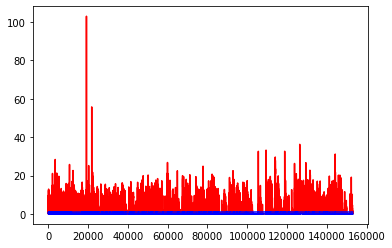

white ratio : 50.0
min : 177
max : 228


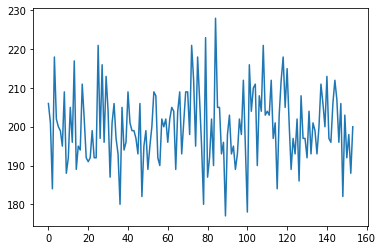

Generating interpolations...
153001 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.655744, 0.750044]
153002 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.237207, 0.199583]
153003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.041693, 0.083138]
153004 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.767429, 0.667476]
153005 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.504154, 0.227754]
153006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.150210, 0.106238]
153007 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.519577, 0.709886]
153008 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.860635, 0.314077]
153009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.506320, 0.560258]
153010 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.364752, 0.128314]
153011 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.076049, 0.093973]
153012 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.273228, 0.069248]
153013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017451, 0.043879]
153014 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.215296, 0

153120 [D loss: 0.003776, acc.: 100.00%] [G loss: 0.342461, 0.533833]
153121 [D loss: 0.126646, acc.: 96.88%] [G loss: 0.008942, 0.011176]
153122 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000055, 0.000054]
153123 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.094383, 0.083374]
153124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000455, 0.001297]
153125 [D loss: 0.000311, acc.: 100.00%] [G loss: 0.006303, 0.026907]
153126 [D loss: 0.009543, acc.: 100.00%] [G loss: 0.001289, 0.000639]
153127 [D loss: 0.010768, acc.: 100.00%] [G loss: 0.001775, 0.001813]
153128 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000076, 0.000098]
153129 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.014343, 0.000608]
153130 [D loss: 0.016791, acc.: 100.00%] [G loss: 0.000034, 0.000037]
153131 [D loss: 0.012529, acc.: 100.00%] [G loss: 0.000403, 0.000715]
153132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.069865, 0.063780]
153133 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.006284, 0.000722]
153134 [D loss: 0.000

153239 [D loss: 0.001389, acc.: 100.00%] [G loss: 0.000575, 0.000352]
153240 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000273, 0.000042]
153241 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.019125, 0.047682]
153242 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.010969, 0.002423]
153243 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.000233, 0.000841]
153244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000173, 0.000425]
153245 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000013, 0.000035]
153246 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.184065, 0.051692]
153247 [D loss: 0.008771, acc.: 100.00%] [G loss: 0.006283, 0.008370]
153248 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.001992, 0.000559]
153249 [D loss: 0.003880, acc.: 100.00%] [G loss: 0.005058, 0.017435]
153250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.030941, 0.013725]
153251 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.010303, 0.004830]
153252 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.235312, 0.056029]
153253 [D loss: 0.00

153358 [D loss: 0.007275, acc.: 100.00%] [G loss: 0.002332, 0.004973]
153359 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000722, 0.000139]
153360 [D loss: 0.004073, acc.: 100.00%] [G loss: 0.002205, 0.002619]
153361 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.038639, 0.004619]
153362 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000890, 0.010320]
153363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000365, 0.000439]
153364 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.011242, 0.000932]
153365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004558, 0.008028]
153366 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.005684, 0.027449]
153367 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001331, 0.000988]
153368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.012656, 0.085800]
153369 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.007498, 0.070322]
153370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.008868, 0.002925]
153371 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.015224, 0.005784]
153372 [D loss: 0.00

153476 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003947, 0.005319]
153477 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.121199, 0.065637]
153478 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.002122, 0.001231]
153479 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.006223, 0.002880]
153480 [D loss: 0.000368, acc.: 100.00%] [G loss: 0.044270, 0.023807]
153481 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002886, 0.010020]
153482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.071655, 0.087800]
153483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002680, 0.004189]
153484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003012, 0.010175]
153485 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021557, 0.028113]
153486 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.069317, 0.089852]
153487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010030, 0.006117]
153488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002780, 0.001023]
153489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002741, 0.001316]
153490 [D loss: 0.00

153596 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017891, 0.000200]
153597 [D loss: 0.038604, acc.: 96.88%] [G loss: 0.000030, 0.000048]
153598 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000003, 0.000005]
153599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000084, 0.000009]
153600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000368, 0.000012]
153601 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000004]
153602 [D loss: 0.014168, acc.: 100.00%] [G loss: 0.000020, 0.000077]
153603 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000006, 0.000076]
153604 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000007, 0.000001]
153605 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000093, 0.000041]
153606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000033]
153607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000035, 0.000068]
153608 [D loss: 0.001550, acc.: 100.00%] [G loss: 0.000034, 0.000035]
153609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
153610 [D loss: 0.002

153716 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153717 [D loss: 0.000333, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153718 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153719 [D loss: 0.000160, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153721 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153722 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153723 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153724 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153726 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153727 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153728 [D loss: 0.002270, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153729 [D loss: 0.005774, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153730 [D loss: 0.00

153835 [D loss: 0.002386, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153836 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153837 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000001, 0.000000]
153838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153839 [D loss: 0.000231, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153840 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000002]
153841 [D loss: 0.000627, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
153843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153846 [D loss: 0.000257, acc.: 100.00%] [G loss: 0.000002, 0.000000]
153847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153848 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153849 [D loss: 0.00

153955 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
153958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000010]
153960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153962 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153964 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153965 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153967 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153968 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
153969 [D loss: 0.00

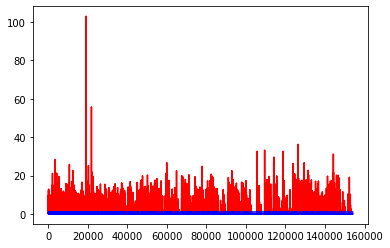

white ratio : 54.0
min : 177
max : 228


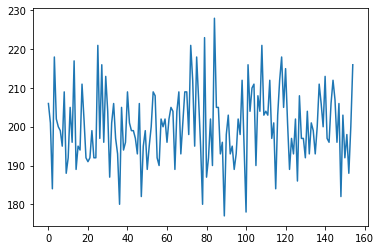

Generating interpolations...
154001 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154002 [D loss: 0.003574, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154003 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154005 [D loss: 0.000914, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154006 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154009 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154010 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154011 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154013 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0

154118 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154119 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154120 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154123 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154127 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154130 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154131 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154132 [D loss: 0.00

154237 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154238 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154239 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154240 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154241 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154242 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154243 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154244 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154246 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154250 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154251 [D loss: 0.00

154355 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154356 [D loss: 0.000183, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154357 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154360 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154363 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154364 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154365 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154367 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154369 [D loss: 0.00

154475 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154476 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154477 [D loss: 0.000481, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154480 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154481 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154482 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154483 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154486 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154487 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154488 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154489 [D loss: 0.00

154594 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154595 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154596 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154597 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154599 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154600 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154608 [D loss: 0.00

154714 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154715 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154716 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154717 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154718 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154719 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154721 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154723 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154724 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154726 [D loss: 0.003309, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154727 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154728 [D loss: 0.00

154835 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154836 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154837 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154838 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154839 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154840 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154841 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154842 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154843 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154844 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154845 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154846 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154847 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154848 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154849 [D loss: 0.00

154954 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154955 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154957 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154958 [D loss: 0.054160, acc.: 96.88%] [G loss: 0.000000, 0.000000]
154959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154960 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154961 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154964 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154965 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154967 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.000000, 0.000000]
154968 [D loss: 0.000

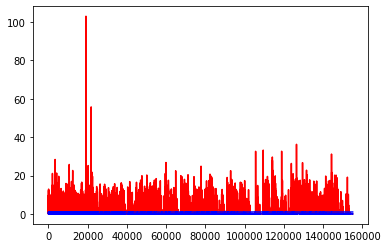

white ratio : 47.5
min : 177
max : 228


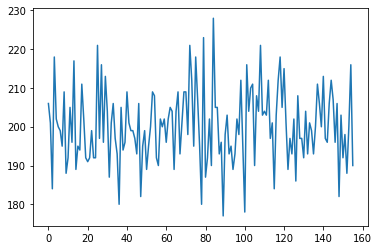

Generating interpolations...
155001 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155003 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155006 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155007 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155009 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155012 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155013 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155014 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0

155119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155120 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155121 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155133 [D loss: 0.00

155239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155240 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155243 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155244 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155245 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155246 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155247 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155248 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155249 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155250 [D loss: 0.000194, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155251 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155253 [D loss: 0.00

155359 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155360 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155361 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155363 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155364 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155365 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155368 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155371 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155372 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155373 [D loss: 0.00

155478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155481 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155483 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155489 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155491 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155492 [D loss: 0.00

155599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155600 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155603 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155611 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155612 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155613 [D loss: 0.00

155719 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155720 [D loss: 0.004069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155721 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155727 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155730 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155731 [D loss: 0.001255, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155732 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155733 [D loss: 0.00

155837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155839 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000001]
155846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155848 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155849 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155850 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155851 [D loss: 0.00

155956 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155957 [D loss: 0.008535, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155958 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155960 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155962 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155963 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155964 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155965 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155967 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155969 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
155970 [D loss: 0.00

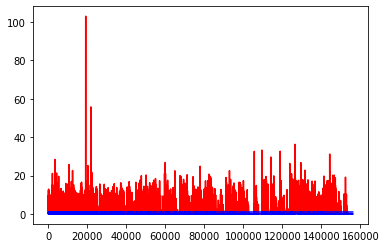

white ratio : 50.25
min : 177
max : 228


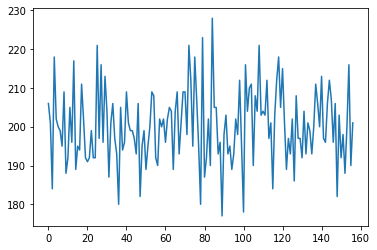

Generating interpolations...
156001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156002 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156004 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156008 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156009 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156010 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156011 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156012 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156013 [D loss: 0.000552, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0

156120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156121 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156123 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156125 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156127 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156129 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156130 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156133 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156134 [D loss: 0.00

156238 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156240 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156242 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156243 [D loss: 0.000592, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156246 [D loss: 0.000883, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156252 [D loss: 0.00

156358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
156360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156361 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156372 [D loss: 0.00

156477 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156478 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156480 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156485 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156486 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156488 [D loss: 0.047248, acc.: 96.88%] [G loss: 0.000000, 0.000000]
156489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000123, 0.000304]
156490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.073863, 0.006517]
156491 [D loss: 0.000

156597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156600 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156601 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156610 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156611 [D loss: 0.00

156718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
156720 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156723 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000026, 0.000141]
156725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156726 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156730 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156732 [D loss: 0.00

156839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156847 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156848 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156850 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156852 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156853 [D loss: 0.00

156959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
156962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
156963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156968 [D loss: 0.000195, acc.: 100.00%] [G loss: 0.000000, 0.000001]
156969 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156970 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156971 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
156972 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000006]
156973 [D loss: 0.00

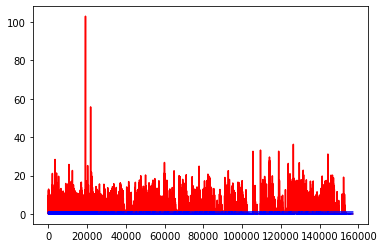

white ratio : 51.75
min : 177
max : 228


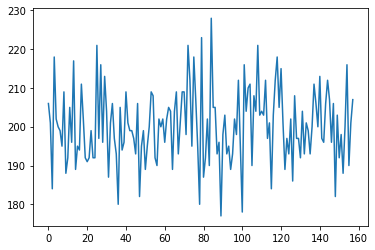

Generating interpolations...
157001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157004 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157007 [D loss: 0.000952, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
157012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
157014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.075882, 0

157120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000042]
157121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000018]
157122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013210, 0.000100]
157123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000061, 0.003316]
157124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.970504, 0.334710]
157125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003151, 0.000591]
157126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000205, 0.000020]
157127 [D loss: 0.000091, acc.: 100.00%] [G loss: 0.287045, 0.162355]
157128 [D loss: 0.000929, acc.: 100.00%] [G loss: 0.345439, 0.059788]
157129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.114876, 0.062202]
157130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000029, 0.000390]
157131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.150753, 0.081328]
157132 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000018, 0.000003]
157133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012736, 0.007604]
157134 [D loss: 0.00

157240 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.041235, 0.003906]
157241 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.005889, 0.017529]
157242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002632, 0.007303]
157243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000480, 0.002266]
157244 [D loss: 0.000324, acc.: 100.00%] [G loss: 0.013142, 0.085894]
157245 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.008753, 0.023250]
157246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.017866, 0.001412]
157247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023236, 0.139380]
157248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008656, 0.102262]
157249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.334329, 0.300740]
157250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002051, 0.000646]
157251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001346, 0.154677]
157252 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000389, 0.001131]
157253 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.043829, 0.082221]
157254 [D loss: 0.00

157358 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.042768, 0.011233]
157359 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.065650, 0.010418]
157360 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.123789, 0.181340]
157361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027157, 0.028447]
157362 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.023160, 0.023407]
157363 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.114016, 0.035002]
157364 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.068295, 0.005077]
157365 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.042871, 0.127263]
157366 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.107164, 0.005578]
157367 [D loss: 0.000659, acc.: 100.00%] [G loss: 0.097076, 0.100247]
157368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.105352, 0.061837]
157369 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.051056, 0.038464]
157370 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.376902, 0.151860]
157371 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.004270, 0.056087]
157372 [D loss: 0.00

157476 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011257, 0.025190]
157477 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.067044, 0.141694]
157478 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.227114, 0.167075]
157479 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.011174, 0.107619]
157480 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.086502, 0.015568]
157481 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.351666, 0.033449]
157482 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.239718, 0.183611]
157483 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.235020, 0.049003]
157484 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.067594, 0.056805]
157485 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.287392, 0.286637]
157486 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.182855, 0.078951]
157487 [D loss: 0.000677, acc.: 100.00%] [G loss: 0.103185, 0.095351]
157488 [D loss: 0.003378, acc.: 100.00%] [G loss: 0.262991, 0.535327]
157489 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.192890, 0.372730]
157490 [D loss: 0.00

157594 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.125933, 1.251706]
157595 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.658214, 0.849603]
157596 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.926914, 1.070169]
157597 [D loss: 0.000523, acc.: 100.00%] [G loss: 0.571930, 1.054939]
157598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.888956, 0.358186]
157599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.999774, 0.951688]
157600 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.055311, 1.106881]
157601 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.653680, 0.638073]
157602 [D loss: 0.000059, acc.: 100.00%] [G loss: 1.658706, 1.001350]
157603 [D loss: 0.129760, acc.: 96.88%] [G loss: 1.360179, 0.897312]
157604 [D loss: 0.000006, acc.: 100.00%] [G loss: 17.779921, 5.049855]
157605 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.959068, 6.681263]
157606 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.513497, 6.617059]
157607 [D loss: 0.000066, acc.: 100.00%] [G loss: 6.537508, 7.366874]
157608 [D loss: 0.00

157712 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.181942, 5.134667]
157713 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.850169, 0.805688]
157714 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.546148, 3.327958]
157715 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.849146, 2.992145]
157716 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.195477, 2.100980]
157717 [D loss: 0.001501, acc.: 100.00%] [G loss: 0.615595, 0.521321]
157718 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.073436, 1.765967]
157719 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.189978, 1.175205]
157720 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.904239, 1.371490]
157721 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.055718, 0.412774]
157722 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.404087, 0.897167]
157723 [D loss: 0.000776, acc.: 100.00%] [G loss: 31.771301, 4.461308]
157724 [D loss: 0.001614, acc.: 100.00%] [G loss: 3.825262, 3.993532]
157725 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.030440, 3.230205]
157726 [D loss: 0.0

157831 [D loss: 0.000582, acc.: 100.00%] [G loss: 0.055139, 0.007898]
157832 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.101037, 0.138163]
157833 [D loss: 0.000474, acc.: 100.00%] [G loss: 0.139385, 0.052290]
157834 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.016825, 0.051523]
157835 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.384417, 0.104298]
157836 [D loss: 0.004127, acc.: 100.00%] [G loss: 0.187071, 0.077125]
157837 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.040022, 0.027915]
157838 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.088135, 0.093145]
157839 [D loss: 0.000793, acc.: 100.00%] [G loss: 0.426100, 0.538534]
157840 [D loss: 0.000238, acc.: 100.00%] [G loss: 15.894932, 0.151679]
157841 [D loss: 0.000034, acc.: 100.00%] [G loss: 1.447176, 1.150286]
157842 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.157009, 0.287252]
157843 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.484062, 0.940187]
157844 [D loss: 0.001937, acc.: 100.00%] [G loss: 1.990059, 1.079335]
157845 [D loss: 0.0

157951 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.453886, 9.385082]
157952 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.216388, 0.119048]
157953 [D loss: 0.000013, acc.: 100.00%] [G loss: 4.532447, 5.163007]
157954 [D loss: 0.001090, acc.: 100.00%] [G loss: 5.412260, 5.713210]
157955 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.190218, 0.162885]
157956 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.698675, 4.253824]
157957 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.500481, 0.310648]
157958 [D loss: 0.000719, acc.: 100.00%] [G loss: 6.656811, 5.619616]
157959 [D loss: 0.011689, acc.: 100.00%] [G loss: 2.341968, 2.094209]
157960 [D loss: 0.002233, acc.: 100.00%] [G loss: 0.242392, 0.157032]
157961 [D loss: 0.000281, acc.: 100.00%] [G loss: 3.491239, 3.063252]
157962 [D loss: 0.002638, acc.: 100.00%] [G loss: 2.403555, 6.712694]
157963 [D loss: 0.005970, acc.: 100.00%] [G loss: 0.493521, 1.127466]
157964 [D loss: 0.000334, acc.: 100.00%] [G loss: 2.787195, 1.985238]
157965 [D loss: 0.00

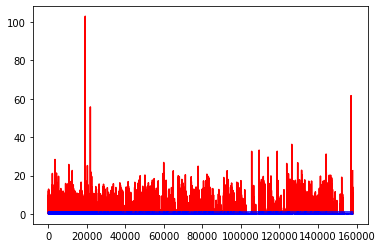

white ratio : 50.5
min : 177
max : 228


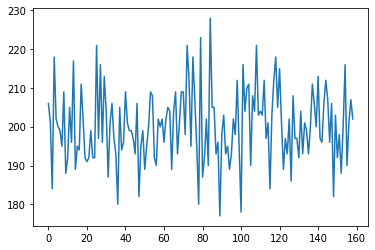

Generating interpolations...
158001 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.608391, 3.644654]
158002 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.556625, 6.809582]
158003 [D loss: 0.023484, acc.: 100.00%] [G loss: 3.695272, 2.941662]
158004 [D loss: 0.000064, acc.: 100.00%] [G loss: 54.982098, 9.551607]
158005 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.278251, 12.540056]
158006 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.750320, 12.065534]
158007 [D loss: 0.002908, acc.: 100.00%] [G loss: 8.940281, 8.728821]
158008 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.693769, 4.151654]
158009 [D loss: 0.015967, acc.: 100.00%] [G loss: 7.113427, 6.428926]
158010 [D loss: 0.000025, acc.: 100.00%] [G loss: 11.595032, 10.681243]
158011 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.120206, 6.962798]
158012 [D loss: 0.001973, acc.: 100.00%] [G loss: 4.621209, 4.779189]
158013 [D loss: 0.000093, acc.: 100.00%] [G loss: 1.766017, 1.015476]
158014 [D loss: 0.002001, acc.: 100.00%] [G loss: 3.7

158118 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.115117, 0.052407]
158119 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000319, 0.000239]
158120 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.000818, 0.001802]
158121 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000036, 0.000010]
158122 [D loss: 0.012040, acc.: 100.00%] [G loss: 0.027838, 0.001034]
158123 [D loss: 0.000674, acc.: 100.00%] [G loss: 3.431829, 0.012931]
158124 [D loss: 0.004091, acc.: 100.00%] [G loss: 0.020831, 0.021777]
158125 [D loss: 0.006531, acc.: 100.00%] [G loss: 0.046434, 0.030111]
158126 [D loss: 0.001537, acc.: 100.00%] [G loss: 0.068243, 0.005563]
158127 [D loss: 0.000376, acc.: 100.00%] [G loss: 0.428117, 0.300737]
158128 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.010099, 0.014259]
158129 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.779396, 0.396999]
158130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000303, 0.000800]
158131 [D loss: 0.000150, acc.: 100.00%] [G loss: 0.000475, 0.001884]
158132 [D loss: 0.00

158238 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000097, 0.000226]
158239 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000006, 0.000002]
158240 [D loss: 0.000391, acc.: 100.00%] [G loss: 0.000624, 0.000838]
158241 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.000017, 0.000002]
158242 [D loss: 0.000310, acc.: 100.00%] [G loss: 0.000007, 0.000034]
158243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000145, 0.000026]
158244 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001515, 0.001772]
158245 [D loss: 0.035408, acc.: 96.88%] [G loss: 0.001667, 0.001691]
158246 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000021, 0.000017]
158247 [D loss: 0.000348, acc.: 100.00%] [G loss: 0.000000, 0.000000]
158248 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000612, 0.000421]
158249 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000315, 0.000469]
158250 [D loss: 0.005695, acc.: 100.00%] [G loss: 0.000194, 0.000602]
158251 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000171, 0.000750]
158252 [D loss: 0.000

158358 [D loss: 0.000345, acc.: 100.00%] [G loss: 0.000000, 0.000000]
158359 [D loss: 0.004802, acc.: 100.00%] [G loss: 0.000000, 0.000001]
158360 [D loss: 0.000295, acc.: 100.00%] [G loss: 0.000499, 0.001445]
158361 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.004307, 0.001137]
158362 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000008, 0.000073]
158363 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000002, 0.000004]
158364 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000040, 0.000144]
158365 [D loss: 0.002542, acc.: 100.00%] [G loss: 0.001794, 0.002150]
158366 [D loss: 0.003157, acc.: 100.00%] [G loss: 0.000002, 0.000003]
158367 [D loss: 0.000225, acc.: 100.00%] [G loss: 0.000046, 0.000050]
158368 [D loss: 0.000656, acc.: 100.00%] [G loss: 0.000729, 0.000552]
158369 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000057, 0.000087]
158370 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.000932, 0.000157]
158371 [D loss: 0.003115, acc.: 100.00%] [G loss: 0.005804, 0.008355]
158372 [D loss: 0.00

158477 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.008914, 0.019814]
158478 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.042567, 0.039840]
158479 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.001705, 0.002818]
158480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000117, 0.000922]
158481 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.029821, 0.012462]
158482 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000040, 0.000013]
158483 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.000020, 0.000005]
158484 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.057241, 0.011473]
158485 [D loss: 0.000079, acc.: 100.00%] [G loss: 0.000053, 0.000033]
158486 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000484, 0.000074]
158487 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.005048, 0.001003]
158488 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.001648, 0.000833]
158489 [D loss: 0.000315, acc.: 100.00%] [G loss: 0.022101, 0.020192]
158490 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.001369, 0.002649]
158491 [D loss: 0.00

158596 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.000720, 0.000047]
158597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000009]
158598 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.057794, 0.018334]
158599 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.013091, 0.017501]
158600 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.011657, 0.007691]
158601 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000001, 0.000437]
158602 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.003866, 0.000026]
158603 [D loss: 0.000419, acc.: 100.00%] [G loss: 0.024345, 0.035575]
158604 [D loss: 0.000471, acc.: 100.00%] [G loss: 0.000919, 0.018287]
158605 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.004828, 0.009225]
158606 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000217, 0.000183]
158607 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.002824, 0.002453]
158608 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.001661, 0.001944]
158609 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.239304, 0.097739]
158610 [D loss: 0.00

158714 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.067732, 0.216670]
158715 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021290, 0.025643]
158716 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000465, 0.000048]
158717 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000004, 0.000022]
158718 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.001522, 0.003832]
158719 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.718976, 0.623109]
158720 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.834099, 3.027071]
158721 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.834448, 4.263972]
158722 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.011322, 2.912267]
158723 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.849269, 2.660248]
158724 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.704750, 1.110345]
158725 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.413750, 3.108848]
158726 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.125374, 1.230197]
158727 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.856086, 2.469891]
158728 [D loss: 0.00

158832 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.934258, 0.028263]
158833 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.549244, 0.397917]
158834 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.026695, 0.000029]
158835 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.038943, 0.023371]
158836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.018256, 0.089382]
158837 [D loss: 0.000886, acc.: 100.00%] [G loss: 0.015282, 0.020958]
158838 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002036, 0.000858]
158839 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.725233, 0.108586]
158840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.170995, 0.087699]
158841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.036579, 0.036984]
158842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.063576, 0.016103]
158843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.017434, 0.033966]
158844 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.387066, 2.683164]
158845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009535, 0.000574]
158846 [D loss: 0.00

158951 [D loss: 0.024153, acc.: 96.88%] [G loss: 0.008179, 0.025450]
158952 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.153276, 0.078659]
158953 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.027137, 0.064789]
158954 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000122, 0.000543]
158955 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.004699, 0.002763]
158956 [D loss: 0.155384, acc.: 93.75%] [G loss: 0.001949, 0.084692]
158957 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.005663, 0.000253]
158958 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.006766, 0.016441]
158959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.151990, 0.058547]
158960 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.035252, 0.010979]
158961 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001118, 0.003707]
158962 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.003798, 0.000198]
158963 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.005864, 0.016710]
158964 [D loss: 0.000430, acc.: 100.00%] [G loss: 0.001186, 0.009159]
158965 [D loss: 0.0000

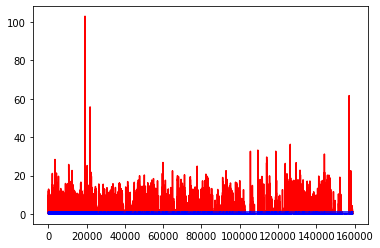

white ratio : 52.0
min : 177
max : 228


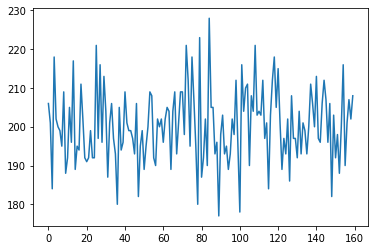

Generating interpolations...
159001 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000057, 0.000153]
159002 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000024, 0.000066]
159003 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.001069, 0.000148]
159004 [D loss: 0.009246, acc.: 100.00%] [G loss: 0.006876, 0.003808]
159005 [D loss: 0.003122, acc.: 100.00%] [G loss: 0.000048, 0.000026]
159006 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.003672, 0.110661]
159007 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.000563, 0.000049]
159008 [D loss: 0.000439, acc.: 100.00%] [G loss: 0.000081, 0.000206]
159009 [D loss: 0.000976, acc.: 100.00%] [G loss: 0.000003, 0.000007]
159010 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.001455, 0.005416]
159011 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.001551, 0.000141]
159012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000114, 0.000140]
159013 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000031, 0.008037]
159014 [D loss: 0.000162, acc.: 100.00%] [G loss: 0.000823, 0

159119 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.024101, 0.014235]
159120 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.024911, 0.078954]
159121 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000009, 0.000011]
159122 [D loss: 0.001045, acc.: 100.00%] [G loss: 0.000064, 0.000273]
159123 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.136338, 0.000013]
159124 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000138, 0.000339]
159125 [D loss: 0.000327, acc.: 100.00%] [G loss: 0.000072, 0.000104]
159126 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.315326, 0.374795]
159127 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.024786, 0.076719]
159128 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.002896, 0.002083]
159129 [D loss: 0.001425, acc.: 100.00%] [G loss: 0.003907, 0.007072]
159130 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.004222, 0.001066]
159131 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.002740, 0.007697]
159132 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.094017, 0.021361]
159133 [D loss: 0.00

159239 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000668, 0.000615]
159240 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.067414, 0.026967]
159241 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.054836, 0.034569]
159242 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.001221, 0.000455]
159243 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.002784, 0.039353]
159244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001664, 0.012047]
159245 [D loss: 0.003861, acc.: 100.00%] [G loss: 0.000015, 0.000015]
159246 [D loss: 0.017620, acc.: 100.00%] [G loss: 0.159313, 0.107481]
159247 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.082946, 0.249435]
159248 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001905, 0.000762]
159249 [D loss: 0.034209, acc.: 96.88%] [G loss: 4.425633, 0.001730]
159250 [D loss: 0.001980, acc.: 100.00%] [G loss: 0.638113, 1.042028]
159251 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.001208, 0.004538]
159252 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.032494, 0.895828]
159253 [D loss: 0.000

159359 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.098666, 1.110077]
159360 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016199, 0.976319]
159361 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000041, 0.000084]
159362 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.272211, 0.114404]
159363 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.113478, 0.128490]
159364 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.003716, 0.001776]
159365 [D loss: 0.000003, acc.: 100.00%] [G loss: 4.674093, 3.456131]
159366 [D loss: 0.000077, acc.: 100.00%] [G loss: 1.315616, 0.000199]
159367 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000532, 0.005611]
159368 [D loss: 0.077057, acc.: 96.88%] [G loss: 12.514145, 0.370837]
159369 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.127069, 4.743028]
159370 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.609052, 6.070803]
159371 [D loss: 0.034809, acc.: 96.88%] [G loss: 2.052091, 1.115736]
159372 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.601520, 0.270499]
159373 [D loss: 0.000

159476 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.416004, 3.859359]
159477 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.153628, 0.221667]
159478 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.730626, 0.408082]
159479 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.801327, 0.317968]
159480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.370134, 0.319109]
159481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.478113, 0.444042]
159482 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.450218, 0.258166]
159483 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.278806, 3.022165]
159484 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.792666, 1.941208]
159485 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000031, 0.005412]
159486 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.644889, 0.408814]
159487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.180750, 0.009435]
159488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.107986, 0.003418]
159489 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.138942, 0.088843]
159490 [D loss: 0.00

159595 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.626021, 0.288049]
159596 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.477422, 0.220575]
159597 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.404605, 0.625843]
159598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.023855, 0.030432]
159599 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.188583, 0.107477]
159600 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.307149, 0.085040]
159601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.054621, 0.004947]
159602 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.037054, 0.069892]
159603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.280454, 0.319307]
159604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.237327, 0.135139]
159605 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.497958, 0.458539]
159606 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.179918, 0.193699]
159607 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.370103, 0.493138]
159608 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.667754, 0.685706]
159609 [D loss: 0.00

159715 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.002480, 0.000343]
159716 [D loss: 0.000282, acc.: 100.00%] [G loss: 0.000003, 0.000009]
159717 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.005217, 0.000147]
159718 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.000171, 0.000005]
159719 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000580, 0.000102]
159720 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.073969, 0.087186]
159721 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000041, 0.000859]
159722 [D loss: 0.000164, acc.: 100.00%] [G loss: 0.000132, 0.000001]
159723 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.000118]
159724 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000001, 0.000001]
159725 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000065, 0.000033]
159726 [D loss: 0.002392, acc.: 100.00%] [G loss: 0.000002, 0.000004]
159727 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000072, 0.000047]
159728 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000195, 0.000620]
159729 [D loss: 0.00

159836 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000526, 0.000075]
159837 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.000019, 0.000059]
159838 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000270, 0.000029]
159839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039643, 0.000002]
159840 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000218, 0.000356]
159841 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000016, 0.000526]
159842 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001697, 0.000112]
159843 [D loss: 0.004031, acc.: 100.00%] [G loss: 0.037290, 0.016731]
159844 [D loss: 0.004875, acc.: 100.00%] [G loss: 0.000675, 0.001016]
159845 [D loss: 0.002181, acc.: 100.00%] [G loss: 0.007381, 0.000255]
159846 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.001243, 0.048716]
159847 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000034, 0.000699]
159848 [D loss: 0.051451, acc.: 96.88%] [G loss: 0.135013, 0.306601]
159849 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.667322, 1.732922]
159850 [D loss: 0.000

159956 [D loss: 0.000225, acc.: 100.00%] [G loss: 0.053286, 0.133634]
159957 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000127, 0.000528]
159958 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.046255, 0.017180]
159959 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.101364, 0.009482]
159960 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.004653, 0.001809]
159961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.130564, 0.007144]
159962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.024133, 0.000752]
159963 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.001729, 0.001243]
159964 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.016293, 0.125919]
159965 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000671, 0.012441]
159966 [D loss: 0.026226, acc.: 96.88%] [G loss: 0.016386, 0.025810]
159967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.742239, 0.079434]
159968 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.217598, 0.495635]
159969 [D loss: 0.215821, acc.: 96.88%] [G loss: 0.000390, 0.000515]
159970 [D loss: 0.0012

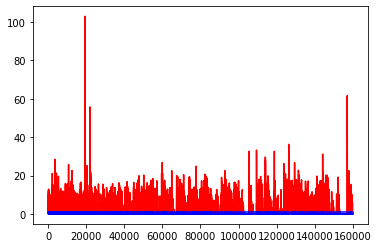

white ratio : 50.75
min : 177
max : 228


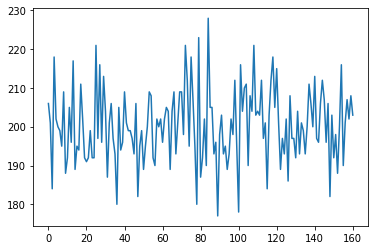

Generating interpolations...
160001 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.272994, 0.304906]
160002 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000012, 0.000057]
160003 [D loss: 0.000601, acc.: 100.00%] [G loss: 0.005394, 0.003602]
160004 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000740, 0.000452]
160005 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.340973, 0.001032]
160006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001781, 0.000435]
160007 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.003919, 0.011812]
160008 [D loss: 0.003324, acc.: 100.00%] [G loss: 0.041419, 0.056024]
160009 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.012266, 0.058322]
160010 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000748, 0.008064]
160011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.208082, 0.132456]
160012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.022674, 0.004116]
160013 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.081796, 0.016341]
160014 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.003788, 0

160116 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.071380, 0.231487]
160117 [D loss: 0.000210, acc.: 100.00%] [G loss: 0.056970, 0.037916]
160118 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.029998, 0.013855]
160119 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.420056, 0.347257]
160120 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.009102, 0.002328]
160121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.426323, 0.119316]
160122 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.152875, 0.002101]
160123 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.415555, 0.401852]
160124 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.006318, 0.018488]
160125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000446, 0.005028]
160126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.048028, 0.010988]
160127 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.121734, 0.111149]
160128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.019631, 0.116916]
160129 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.000949, 0.010347]
160130 [D loss: 0.00

160236 [D loss: 0.000324, acc.: 100.00%] [G loss: 0.000110, 0.000028]
160237 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000486, 0.000074]
160238 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.013563, 0.000145]
160239 [D loss: 0.001252, acc.: 100.00%] [G loss: 0.000493, 0.001280]
160240 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000074, 0.000085]
160241 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000046, 0.000316]
160242 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.004609, 0.003466]
160243 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.028670, 0.027977]
160244 [D loss: 0.000928, acc.: 100.00%] [G loss: 0.001602, 0.000300]
160245 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000115, 0.000209]
160246 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.004033, 0.002131]
160247 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.000103, 0.000038]
160248 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000288, 0.000027]
160249 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001536, 0.000698]
160250 [D loss: 0.00

160354 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004508, 0.000098]
160355 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000989, 0.000438]
160356 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049192, 0.003496]
160357 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.356985, 0.009513]
160358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000170, 0.000146]
160359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000155, 0.000260]
160360 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000398, 0.000156]
160361 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000083, 0.000396]
160362 [D loss: 0.000534, acc.: 100.00%] [G loss: 0.000248, 0.000063]
160363 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.258305, 0.053225]
160364 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.033956, 0.017894]
160365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.051180, 0.162992]
160366 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002938, 0.000146]
160367 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002017, 0.008807]
160368 [D loss: 0.00

160472 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.128643, 0.031131]
160473 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.093658, 0.069429]
160474 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.157846, 0.033987]
160475 [D loss: 0.004695, acc.: 100.00%] [G loss: 0.002313, 0.016811]
160476 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000774, 0.002271]
160477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004774, 0.004472]
160478 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.076403, 0.001121]
160479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.059592, 0.032869]
160480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.090421, 0.034865]
160481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000430, 0.036993]
160482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000264, 0.034301]
160483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000678, 0.000950]
160484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003758, 0.017234]
160485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.110183, 0.013083]
160486 [D loss: 0.00

160592 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000001, 0.000133]
160593 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000011]
160594 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.001144]
160595 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000820]
160596 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.000037, 0.000420]
160597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000738, 0.000017]
160599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000920, 0.001456]
160600 [D loss: 0.000390, acc.: 100.00%] [G loss: 0.000234, 0.000092]
160601 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000084, 0.000048]
160602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001607, 0.002809]
160603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
160604 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000225, 0.000022]
160605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.000000]
160606 [D loss: 0.00

160712 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160713 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160714 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160715 [D loss: 0.001000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160716 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000007, 0.000001]
160717 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000001, 0.000000]
160718 [D loss: 0.000220, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160719 [D loss: 0.000673, acc.: 100.00%] [G loss: 0.000000, 0.000008]
160720 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000325]
160722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
160723 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000002]
160724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160726 [D loss: 0.00

160830 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000329, 0.000146]
160831 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003764, 0.001090]
160832 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000611, 0.000219]
160833 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.036277, 0.020535]
160834 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000690, 0.000542]
160835 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000023, 0.000054]
160836 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.003044, 0.004883]
160837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027846, 0.006734]
160838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023736, 0.000622]
160839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000168, 0.000590]
160840 [D loss: 0.000206, acc.: 100.00%] [G loss: 0.000025, 0.000094]
160841 [D loss: 0.002311, acc.: 100.00%] [G loss: 0.001595, 0.005564]
160842 [D loss: 0.036817, acc.: 96.88%] [G loss: 0.000002, 0.000043]
160843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005677, 0.000256]
160844 [D loss: 0.000

160951 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000001, 0.000000]
160952 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000020, 0.000103]
160953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000007]
160954 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
160955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
160957 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000001, 0.000000]
160958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
160960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000001]
160961 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000050, 0.002311]
160962 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000031]
160963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000632]
160964 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000006, 0.000058]
160965 [D loss: 0.00

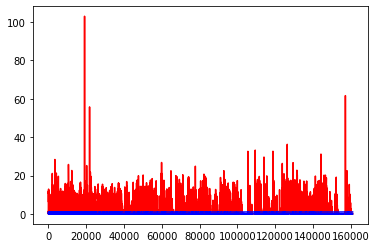

white ratio : 53.5
min : 177
max : 228


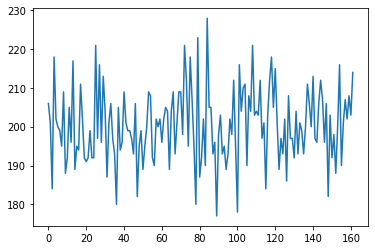

Generating interpolations...
161001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161003 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.005273, 0.000008]
161004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
161005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002276, 0.000073]
161006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161007 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000011]
161008 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
161009 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000001, 0.000000]
161010 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000001]
161012 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000000, 0.000140]
161013 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000001, 0.000000]
161014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000158, 0

161120 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161121 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000063, 0.000003]
161123 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161124 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161127 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161128 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161129 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161130 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161131 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161132 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161133 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161134 [D loss: 0.00

161239 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000053, 0.000291]
161240 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001627, 0.000103]
161241 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000087, 0.000059]
161242 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000361, 0.001797]
161243 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.013094, 0.020616]
161244 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000442, 0.000108]
161245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.014412, 0.002967]
161246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007207, 0.004850]
161247 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000021, 0.000080]
161248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000189, 0.000134]
161249 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.044586, 0.001431]
161250 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000561, 0.000277]
161251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000308, 0.000892]
161252 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000280, 0.004224]
161253 [D loss: 0.00

161360 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.063528, 0.004660]
161361 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000004, 0.000105]
161362 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.001155, 0.000104]
161363 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.051131, 0.008551]
161364 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000051, 0.000024]
161365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001529, 0.102500]
161366 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.003536, 0.000235]
161367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019464, 0.022354]
161368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000532]
161369 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001325, 0.000207]
161370 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000087]
161371 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000055, 0.001766]
161372 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000147, 0.000147]
161373 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000088, 0.000042]
161374 [D loss: 0.00

161479 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.000561, 0.000533]
161480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000008, 0.000145]
161481 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000149, 0.000961]
161482 [D loss: 0.006662, acc.: 100.00%] [G loss: 0.000001, 0.000027]
161483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000987]
161484 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000072, 0.000751]
161485 [D loss: 0.003436, acc.: 100.00%] [G loss: 0.006413, 0.001838]
161486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000297, 0.000008]
161487 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000017, 0.000007]
161488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000045]
161489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000032, 0.000017]
161490 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000011, 0.000104]
161491 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000457, 0.000032]
161492 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000195, 0.000027]
161493 [D loss: 0.00

161598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000235, 0.000219]
161599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000042]
161600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000307, 0.000046]
161601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000039, 0.018080]
161602 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000011, 0.000010]
161603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012400, 0.056942]
161604 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000044, 0.000009]
161605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.000167]
161606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.093630, 0.067519]
161607 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.013355, 0.003580]
161608 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000002, 0.000129]
161609 [D loss: 0.000408, acc.: 100.00%] [G loss: 0.000026, 0.000007]
161610 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000031, 0.000034]
161611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004949, 0.022251]
161612 [D loss: 0.00

161719 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000296, 0.000179]
161720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000106, 0.000033]
161721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000266, 0.000060]
161722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000405, 0.000351]
161723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039449, 0.111771]
161724 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.003275, 0.004950]
161725 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001782, 0.000667]
161726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004340, 0.086103]
161727 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000315, 0.002999]
161728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000095, 0.000054]
161729 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000170, 0.000287]
161730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000005]
161731 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.052352, 0.006141]
161732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002727, 0.000259]
161733 [D loss: 0.00

161840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049408, 0.017933]
161841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000097, 0.000025]
161842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015185, 0.051804]
161843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000211, 0.007863]
161844 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.032850, 0.005330]
161845 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.102989, 0.003156]
161846 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000881, 0.002164]
161847 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.006900, 0.001988]
161848 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.015349, 0.001689]
161849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000277, 0.000382]
161850 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000325, 0.000349]
161851 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005582, 0.009745]
161852 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002171, 0.008670]
161853 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000013]
161854 [D loss: 0.00

161960 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000004]
161961 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.008328, 0.000191]
161962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
161963 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161964 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000047, 0.000001]
161965 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000040, 0.003979]
161966 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161967 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000003, 0.000000]
161968 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000005]
161969 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000003]
161970 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000279, 0.000374]
161971 [D loss: 0.020842, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161972 [D loss: 0.001327, acc.: 100.00%] [G loss: 0.000000, 0.000000]
161973 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000000, 0.000001]
161974 [D loss: 0.00

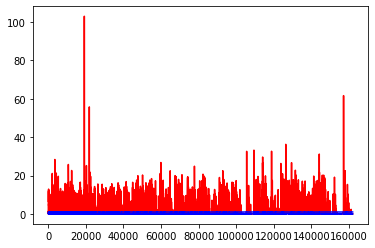

white ratio : 50.75
min : 177
max : 228


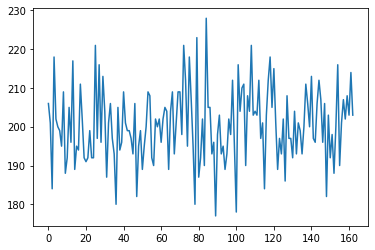

Generating interpolations...
162001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000574, 0.000256]
162002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000068, 0.000019]
162003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016739, 0.000054]
162004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003323, 0.000002]
162005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000007, 0.000000]
162006 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000001, 0.000005]
162007 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000012, 0.000003]
162008 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000002]
162009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000018, 0.000001]
162010 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000041, 0.000039]
162011 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162012 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162014 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000153, 0

162120 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.073192, 0.010982]
162121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000239, 0.024860]
162122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000027, 0.000004]
162123 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000565, 0.001449]
162124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.039228, 0.032744]
162125 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.005297, 0.004595]
162126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000006]
162127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.000499]
162128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000119, 0.000041]
162129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.103712]
162130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000694, 0.000056]
162131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003272, 0.000402]
162132 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000292, 0.002265]
162133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000830, 0.001411]
162134 [D loss: 0.00

162241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001242, 0.000009]
162242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002324, 0.000086]
162244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000008]
162245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000063, 0.000031]
162246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006245, 0.000093]
162247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.000055]
162249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000003]
162250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000078, 0.000152]
162251 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002491, 0.000081]
162252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000054, 0.000018]
162253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000026, 0.001288]
162254 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162255 [D loss: 0.00

162359 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000221, 0.000221]
162360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032731, 0.005921]
162361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000002]
162362 [D loss: 0.084556, acc.: 96.88%] [G loss: 0.000000, 0.000000]
162363 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000261, 0.000002]
162364 [D loss: 0.000898, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162365 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000003, 0.000000]
162366 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162367 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000010, 0.000001]
162369 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000002, 0.000000]
162370 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162371 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162372 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000002, 0.000035]
162373 [D loss: 0.000

162478 [D loss: 0.009529, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162479 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000012]
162480 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162481 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.001875, 0.001011]
162482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
162483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000102, 0.000008]
162485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001684, 0.000219]
162486 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000038]
162487 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000015, 0.000000]
162488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000136]
162489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000079, 0.000024]
162490 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.019944, 0.000044]
162491 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000002, 0.000000]
162492 [D loss: 0.00

162598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162600 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162601 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162602 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
162603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162604 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000000]
162605 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162608 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.000034]
162609 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
162611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162612 [D loss: 0.00

162717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000004]
162722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000006]
162723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162724 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000002, 0.000000]
162725 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000005]
162726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000005]
162728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000004]
162729 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.005448, 0.003172]
162730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000000]
162731 [D loss: 0.00

162838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000006, 0.000013]
162840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000000]
162843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162844 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000047, 0.000004]
162845 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000007]
162846 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162848 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000002, 0.000385]
162849 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162850 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162851 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162852 [D loss: 0.00

162959 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162960 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162961 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
162962 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.001346, 0.000000]
162963 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000001]
162964 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162965 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162966 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000000]
162967 [D loss: 0.000861, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000853]
162969 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000000]
162970 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000003, 0.000010]
162971 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162972 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
162973 [D loss: 0.00

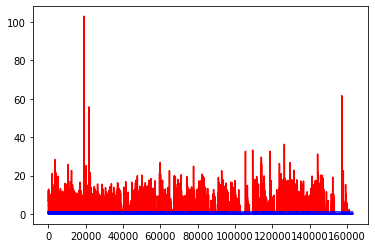

white ratio : 48.5
min : 177
max : 228


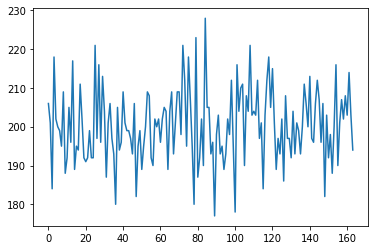

Generating interpolations...
163001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002224, 0.000014]
163002 [D loss: 0.000895, acc.: 100.00%] [G loss: 0.000080, 0.000001]
163003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
163004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000168, 0.000106]
163005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000073, 0.000029]
163006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000142, 0.000165]
163007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.016835, 0.087084]
163008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.000854]
163009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000118, 0.000062]
163010 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000027]
163011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000029]
163012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000217, 0.000263]
163013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000018]
163014 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000030, 0

163119 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000000, 0.000019]
163120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000017, 0.000004]
163121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003086, 0.000244]
163122 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
163123 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000002]
163124 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000752, 0.016665]
163125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000455]
163127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000526, 0.001786]
163128 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000018, 0.000000]
163129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163130 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000001, 0.003376]
163131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000019, 0.000001]
163132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000138, 0.000086]
163133 [D loss: 0.00

163238 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163240 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163241 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163242 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163246 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163247 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163248 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163249 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000006, 0.000005]
163250 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163251 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000004]
163252 [D loss: 0.00

163358 [D loss: 0.000378, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163359 [D loss: 0.000285, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163360 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163361 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009409, 0.000006]
163363 [D loss: 0.000185, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163364 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163365 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163366 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163367 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163368 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163369 [D loss: 0.018036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001704, 0.026928]
163371 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.002477, 0.000094]
163372 [D loss: 0.00

163478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000227]
163479 [D loss: 0.000695, acc.: 100.00%] [G loss: 0.000004, 0.000000]
163480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001713, 0.000037]
163481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000003]
163483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000157, 0.024438]
163484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000121, 0.000150]
163485 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000027, 0.000000]
163486 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163487 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163488 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
163490 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000018, 0.000000]
163491 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
163492 [D loss: 0.00

163597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008438, 0.000033]
163598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.073999, 0.022070]
163599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001156, 0.006992]
163600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.251766, 0.023231]
163601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000024, 0.000105]
163602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000250, 0.000025]
163603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000498, 0.000716]
163604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.024816, 0.086483]
163605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000065, 0.000328]
163606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006699, 0.043150]
163607 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.060376, 0.142405]
163608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.031596, 0.015078]
163609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001677, 0.023965]
163610 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.014956, 0.057824]
163611 [D loss: 0.00

163715 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000081, 0.000019]
163716 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000041, 0.000090]
163717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004089, 0.004219]
163718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000001]
163719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000223]
163720 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.000011, 0.000115]
163721 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000009, 0.000041]
163722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.002232]
163723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000019, 0.000301]
163724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003089, 0.000218]
163725 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001157, 0.000003]
163726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000015]
163727 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
163728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000011, 0.000074]
163729 [D loss: 0.00

163834 [D loss: 0.022421, acc.: 100.00%] [G loss: 0.882954, 49.857819]
163835 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.365090, 12.661839]
163836 [D loss: 0.000175, acc.: 100.00%] [G loss: 15.522511, 13.905487]
163837 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.336998, 12.325974]
163838 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.188990, 11.273810]
163839 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.785660, 8.224210]
163840 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.323693, 51.679535]
163841 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.215570, 14.667459]
163842 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.847847, 15.505072]
163843 [D loss: 0.182255, acc.: 96.88%] [G loss: 4.699675, 5.113511]
163844 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.762702, 2.977458]
163845 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.217690, 1.108175]
163846 [D loss: 0.000015, acc.: 100.00%] [G loss: 3.659843, 2.368734]
163847 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.785457, 3.688980]
163848

163951 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.088968, 0.113270]
163952 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.700679, 0.307684]
163953 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.271977, 0.015097]
163954 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.273418, 0.635709]
163955 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.314541, 2.058894]
163956 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.886295, 1.182140]
163957 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.109751, 0.106082]
163958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.602139, 1.222430]
163959 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.487097, 0.620120]
163960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.508356, 0.478091]
163961 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.010561, 0.010174]
163962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.246353, 0.326390]
163963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003817, 0.010350]
163964 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.719048, 1.729245]
163965 [D loss: 0.00

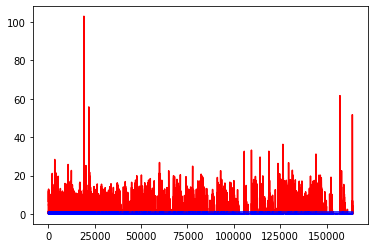

white ratio : 46.0
min : 177
max : 228


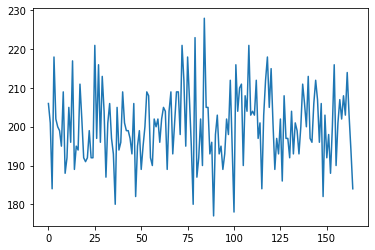

Generating interpolations...
164001 [D loss: 0.039161, acc.: 96.88%] [G loss: 0.001982, 0.000653]
164002 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.184323, 0.021683]
164003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.455861, 0.493370]
164004 [D loss: 0.000442, acc.: 100.00%] [G loss: 0.824852, 0.249401]
164005 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000699, 0.000366]
164006 [D loss: 0.018900, acc.: 100.00%] [G loss: 0.331320, 0.001118]
164007 [D loss: 0.000886, acc.: 100.00%] [G loss: 0.302471, 0.142039]
164008 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.684197, 2.042573]
164009 [D loss: 0.018056, acc.: 100.00%] [G loss: 0.387077, 0.097554]
164010 [D loss: 0.000386, acc.: 100.00%] [G loss: 7.877500, 7.840521]
164011 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.236923, 9.737735]
164012 [D loss: 0.000503, acc.: 100.00%] [G loss: 10.434220, 37.791931]
164013 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.049425, 15.146303]
164014 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.60821

164118 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.303764, 0.321922]
164119 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000399, 0.050267]
164120 [D loss: 0.000066, acc.: 100.00%] [G loss: 30.709669, 1.556377]
164121 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.713010, 5.880509]
164122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.444404, 0.207469]
164123 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.774465, 1.323502]
164124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.055286, 0.008038]
164125 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.512725, 4.951266]
164126 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.014936, 1.103963]
164127 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.020621, 0.019615]
164128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.789450, 0.241276]
164129 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.146272, 0.913067]
164130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.228459, 0.279064]
164131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.407390, 0.364794]
164132 [D loss: 0.0

164237 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.232283, 0.362422]
164238 [D loss: 0.000714, acc.: 100.00%] [G loss: 0.000052, 0.000320]
164239 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000475, 0.000550]
164240 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.001476, 0.003111]
164241 [D loss: 0.001631, acc.: 100.00%] [G loss: 0.118321, 0.063903]
164242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008291, 0.108578]
164243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001533, 0.000160]
164244 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.014968, 0.039313]
164245 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.020563, 0.045263]
164246 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.153592, 0.117821]
164247 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000110, 0.003505]
164248 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.994562, 0.570080]
164249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.043149, 0.020602]
164250 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.003227, 0.017469]
164251 [D loss: 0.00

164357 [D loss: 0.000481, acc.: 100.00%] [G loss: 0.007386, 0.004510]
164358 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.005817, 0.013033]
164359 [D loss: 0.004606, acc.: 100.00%] [G loss: 0.001767, 0.036060]
164360 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.092780, 0.329310]
164361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027143, 0.013894]
164362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.027400, 0.129873]
164363 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.172830, 0.264012]
164364 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.088322, 0.016707]
164365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.008171, 0.000360]
164366 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.000018, 0.000005]
164367 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000036, 0.000015]
164368 [D loss: 0.000966, acc.: 100.00%] [G loss: 0.000218, 0.004890]
164369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000377, 0.000031]
164370 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000136, 0.000187]
164371 [D loss: 0.00

164475 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000535, 0.000012]
164476 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.458688, 0.016215]
164477 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000055, 0.000699]
164478 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000426, 0.000567]
164479 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.008461, 0.000143]
164480 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001792, 0.000151]
164481 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.002664, 0.030068]
164482 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.489908, 0.286463]
164483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.211417, 0.131696]
164484 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.057844, 0.077626]
164485 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000732, 0.001919]
164486 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.173986, 0.130014]
164487 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.000117, 0.000067]
164488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.081744, 0.040936]
164489 [D loss: 0.00

164595 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000002, 0.000004]
164596 [D loss: 0.002413, acc.: 100.00%] [G loss: 0.009243, 0.007398]
164597 [D loss: 0.000462, acc.: 100.00%] [G loss: 0.017119, 0.125349]
164598 [D loss: 0.001111, acc.: 100.00%] [G loss: 0.173336, 0.139463]
164599 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.147771, 0.046235]
164600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000009]
164601 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.075088, 0.095354]
164602 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.967756, 0.873367]
164603 [D loss: 0.000056, acc.: 100.00%] [G loss: 1.167806, 0.927565]
164604 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.047173, 0.158340]
164605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019158, 0.011083]
164606 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000467, 0.000153]
164607 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.129533, 0.022251]
164608 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.941228, 0.832508]
164609 [D loss: 0.00

164713 [D loss: 0.003790, acc.: 100.00%] [G loss: 1.194778, 0.367102]
164714 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.133309, 0.066293]
164715 [D loss: 0.000006, acc.: 100.00%] [G loss: 8.361412, 2.333757]
164716 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.328203, 0.366620]
164717 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.192931, 2.171950]
164718 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.500570, 0.462734]
164719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.098607, 0.128706]
164720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.428749, 0.939962]
164721 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.127150, 1.273390]
164722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.161902, 0.223566]
164723 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.583426, 1.775721]
164724 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.596829, 0.923736]
164725 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.763108, 2.820096]
164726 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.137258, 0.367326]
164727 [D loss: 0.00

164832 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.030659, 0.076254]
164833 [D loss: 0.000416, acc.: 100.00%] [G loss: 0.014525, 0.003391]
164834 [D loss: 0.118028, acc.: 96.88%] [G loss: 0.000006, 0.000001]
164835 [D loss: 0.021304, acc.: 100.00%] [G loss: 0.000129, 0.000019]
164836 [D loss: 0.001647, acc.: 100.00%] [G loss: 0.000028, 0.000011]
164837 [D loss: 0.001650, acc.: 100.00%] [G loss: 0.000186, 0.000140]
164838 [D loss: 0.004217, acc.: 100.00%] [G loss: 0.064488, 0.077347]
164839 [D loss: 0.025442, acc.: 96.88%] [G loss: 0.002480, 0.006650]
164840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.084070, 0.102277]
164841 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.000643, 0.000563]
164842 [D loss: 0.000084, acc.: 100.00%] [G loss: 0.093400, 0.039656]
164843 [D loss: 0.000154, acc.: 100.00%] [G loss: 0.027530, 0.007223]
164844 [D loss: 0.000498, acc.: 100.00%] [G loss: 0.003011, 0.007105]
164845 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.001647, 0.007228]
164846 [D loss: 0.0000

164949 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.000429, 0.000011]
164950 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.201214, 0.174519]
164951 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.586138, 0.419958]
164952 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.806172, 1.001723]
164953 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.136068, 0.196779]
164954 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000549, 0.000426]
164955 [D loss: 0.000865, acc.: 100.00%] [G loss: 12.814189, 0.448361]
164956 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.398003, 2.506871]
164957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.506072, 0.609608]
164958 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.236870, 2.213074]
164959 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.438520, 0.494291]
164960 [D loss: 0.000240, acc.: 100.00%] [G loss: 0.205933, 0.103002]
164961 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.302940, 0.325904]
164962 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.011857, 1.005694]
164963 [D loss: 0.0

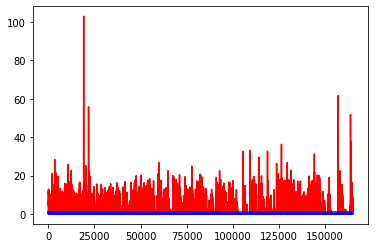

white ratio : 52.5
min : 177
max : 228


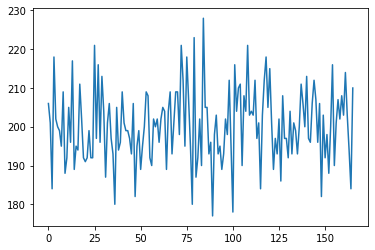

Generating interpolations...
165001 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000045, 0.000024]
165002 [D loss: 0.004196, acc.: 100.00%] [G loss: 0.004519, 0.015657]
165003 [D loss: 0.000998, acc.: 100.00%] [G loss: 0.001521, 0.009647]
165004 [D loss: 0.000527, acc.: 100.00%] [G loss: 0.051211, 0.217179]
165005 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.016288, 0.112204]
165006 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000410, 0.001525]
165007 [D loss: 0.005008, acc.: 100.00%] [G loss: 0.228069, 0.704602]
165008 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.003526, 0.003316]
165009 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000213, 0.006625]
165010 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.261949, 0.354504]
165011 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000313, 0.000164]
165012 [D loss: 0.009871, acc.: 100.00%] [G loss: 0.034972, 0.083291]
165013 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.300478, 0.233745]
165014 [D loss: 0.001082, acc.: 100.00%] [G loss: 0.005615, 0

165116 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.323532, 0.332834]
165117 [D loss: 0.001430, acc.: 100.00%] [G loss: 0.097001, 0.098238]
165118 [D loss: 0.038708, acc.: 96.88%] [G loss: 0.138756, 0.032201]
165119 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.298994, 0.260111]
165120 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.015412, 0.127027]
165121 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.353220, 0.000020]
165122 [D loss: 0.001246, acc.: 100.00%] [G loss: 0.085009, 0.011428]
165123 [D loss: 0.000169, acc.: 100.00%] [G loss: 1.384717, 1.325096]
165124 [D loss: 0.000948, acc.: 100.00%] [G loss: 0.093576, 0.131303]
165125 [D loss: 0.001444, acc.: 100.00%] [G loss: 0.058113, 0.116930]
165126 [D loss: 0.000257, acc.: 100.00%] [G loss: 57.723061, 1.236780]
165127 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.609460, 1.508414]
165128 [D loss: 0.000164, acc.: 100.00%] [G loss: 2.240350, 1.666120]
165129 [D loss: 0.000373, acc.: 100.00%] [G loss: 1.136835, 0.556658]
165130 [D loss: 0.00

165235 [D loss: 0.000000, acc.: 100.00%] [G loss: 25.940918, 0.232123]
165236 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.323394, 1.106280]
165237 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.738697, 0.562914]
165238 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.610310, 1.053360]
165239 [D loss: 0.006285, acc.: 100.00%] [G loss: 0.525171, 0.679312]
165240 [D loss: 0.001593, acc.: 100.00%] [G loss: 1.151313, 0.885836]
165241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.790009, 0.453683]
165242 [D loss: 0.000424, acc.: 100.00%] [G loss: 0.139909, 0.325817]
165243 [D loss: 0.000230, acc.: 100.00%] [G loss: 1.305798, 0.459651]
165244 [D loss: 0.000458, acc.: 100.00%] [G loss: 0.639554, 0.424353]
165245 [D loss: 0.004193, acc.: 100.00%] [G loss: 0.280198, 0.123261]
165246 [D loss: 0.002768, acc.: 100.00%] [G loss: 0.018688, 0.014535]
165247 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.100121, 0.184934]
165248 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.970522, 3.084225]
165249 [D loss: 0.0

165354 [D loss: 0.000036, acc.: 100.00%] [G loss: 1.265135, 0.010642]
165355 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.245963, 0.174824]
165356 [D loss: 0.000821, acc.: 100.00%] [G loss: 0.095784, 0.153572]
165357 [D loss: 0.000603, acc.: 100.00%] [G loss: 2.141101, 1.621640]
165358 [D loss: 0.011645, acc.: 100.00%] [G loss: 2.357142, 1.780088]
165359 [D loss: 0.000079, acc.: 100.00%] [G loss: 1.467328, 1.501498]
165360 [D loss: 0.000086, acc.: 100.00%] [G loss: 2.372550, 2.217452]
165361 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.047812, 0.028881]
165362 [D loss: 0.000659, acc.: 100.00%] [G loss: 0.013628, 0.131922]
165363 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.129944, 0.245611]
165364 [D loss: 0.000144, acc.: 100.00%] [G loss: 0.362218, 0.362023]
165365 [D loss: 0.002030, acc.: 100.00%] [G loss: 0.169522, 0.229437]
165366 [D loss: 0.000447, acc.: 100.00%] [G loss: 0.079371, 0.137820]
165367 [D loss: 0.000993, acc.: 100.00%] [G loss: 0.002723, 0.000917]
165368 [D loss: 0.00

165474 [D loss: 0.024455, acc.: 96.88%] [G loss: 0.007554, 0.004650]
165475 [D loss: 0.004332, acc.: 100.00%] [G loss: 0.034719, 0.003006]
165476 [D loss: 0.013570, acc.: 100.00%] [G loss: 0.000002, 0.000007]
165477 [D loss: 0.002949, acc.: 100.00%] [G loss: 0.000847, 0.000384]
165478 [D loss: 0.094081, acc.: 96.88%] [G loss: 0.000236, 0.000143]
165479 [D loss: 0.001264, acc.: 100.00%] [G loss: 0.000069, 0.000059]
165480 [D loss: 0.000847, acc.: 100.00%] [G loss: 0.000001, 0.000011]
165481 [D loss: 0.029590, acc.: 96.88%] [G loss: 0.090733, 0.126033]
165482 [D loss: 0.006972, acc.: 100.00%] [G loss: 0.000004, 0.000014]
165483 [D loss: 0.005210, acc.: 100.00%] [G loss: 0.004317, 0.002174]
165484 [D loss: 0.097720, acc.: 90.62%] [G loss: 0.000029, 0.000703]
165485 [D loss: 0.020192, acc.: 100.00%] [G loss: 25.287735, 0.000059]
165486 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.002086, 0.001144]
165487 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.002103, 0.032866]
165488 [D loss: 0.00001

165593 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.599244, 0.927718]
165594 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.000448, 0.001460]
165595 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.031506, 0.007241]
165596 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000477, 0.000059]
165597 [D loss: 0.000784, acc.: 100.00%] [G loss: 0.279080, 0.000030]
165598 [D loss: 0.000190, acc.: 100.00%] [G loss: 0.000163, 0.002384]
165599 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.001341, 0.006522]
165600 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.000009, 0.000000]
165601 [D loss: 0.001106, acc.: 100.00%] [G loss: 0.000756, 0.001002]
165602 [D loss: 0.000385, acc.: 100.00%] [G loss: 0.003080, 0.001031]
165603 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.113462, 0.009465]
165604 [D loss: 0.000243, acc.: 100.00%] [G loss: 0.000126, 0.000002]
165605 [D loss: 0.002880, acc.: 100.00%] [G loss: 0.000007, 0.000010]
165606 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.031853, 0.007577]
165607 [D loss: 0.00

165713 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.026943, 0.002008]
165714 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.000067, 0.000092]
165715 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.002469, 0.000315]
165716 [D loss: 0.004351, acc.: 100.00%] [G loss: 0.000000, 0.000001]
165717 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.000064, 0.000020]
165718 [D loss: 0.003347, acc.: 100.00%] [G loss: 0.000363, 0.000105]
165719 [D loss: 0.002323, acc.: 100.00%] [G loss: 0.007173, 0.000025]
165720 [D loss: 0.000185, acc.: 100.00%] [G loss: 12.086269, 1.605445]
165721 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.112204, 1.182991]
165722 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.053595, 0.027765]
165723 [D loss: 0.037678, acc.: 96.88%] [G loss: 0.018195, 0.084127]
165724 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.587746, 0.311274]
165725 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.131853, 0.003808]
165726 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.042191, 0.000196]
165727 [D loss: 0.00

165834 [D loss: 0.001140, acc.: 100.00%] [G loss: 0.554297, 0.180608]
165835 [D loss: 0.006689, acc.: 100.00%] [G loss: 0.013081, 0.000901]
165836 [D loss: 0.001502, acc.: 100.00%] [G loss: 0.003938, 0.000007]
165837 [D loss: 0.005949, acc.: 100.00%] [G loss: 0.000004, 0.000005]
165838 [D loss: 0.003462, acc.: 100.00%] [G loss: 0.024583, 0.000016]
165839 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021077, 0.012225]
165840 [D loss: 0.000402, acc.: 100.00%] [G loss: 0.000011, 0.000009]
165841 [D loss: 0.001526, acc.: 100.00%] [G loss: 0.001240, 0.003165]
165842 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.019191, 0.013757]
165843 [D loss: 0.000644, acc.: 100.00%] [G loss: 0.000060, 0.000219]
165844 [D loss: 0.000109, acc.: 100.00%] [G loss: 0.000099, 0.000012]
165845 [D loss: 0.002705, acc.: 100.00%] [G loss: 0.009138, 0.000726]
165846 [D loss: 0.001929, acc.: 100.00%] [G loss: 0.000085, 0.000027]
165847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
165848 [D loss: 0.00

165953 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000063, 0.000636]
165954 [D loss: 0.060607, acc.: 96.88%] [G loss: 0.052131, 0.000184]
165955 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.000021, 0.000025]
165956 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000310, 0.009034]
165957 [D loss: 0.000691, acc.: 100.00%] [G loss: 0.100167, 0.061568]
165958 [D loss: 0.000585, acc.: 100.00%] [G loss: 0.008404, 0.000071]
165959 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.046796, 0.017421]
165960 [D loss: 0.000865, acc.: 100.00%] [G loss: 0.000497, 0.000013]
165961 [D loss: 0.001855, acc.: 100.00%] [G loss: 0.053755, 0.003069]
165962 [D loss: 0.003570, acc.: 100.00%] [G loss: 0.122562, 0.003359]
165963 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.262740, 0.370616]
165964 [D loss: 0.001041, acc.: 100.00%] [G loss: 0.000765, 0.000109]
165965 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.110328, 0.030123]
165966 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.049779, 0.104211]
165967 [D loss: 0.000

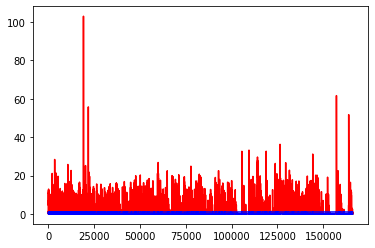

white ratio : 51.25
min : 177
max : 228


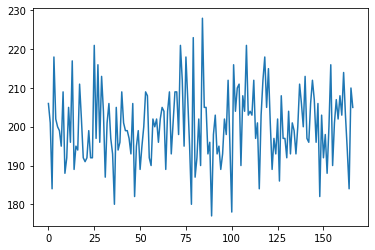

Generating interpolations...
166001 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000000, 0.000004]
166002 [D loss: 0.000136, acc.: 100.00%] [G loss: 9.271053, 3.519318]
166003 [D loss: 0.000606, acc.: 100.00%] [G loss: 0.665876, 0.599554]
166004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002818, 0.000161]
166005 [D loss: 0.004019, acc.: 100.00%] [G loss: 0.024144, 0.023498]
166006 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.940802, 3.446762]
166007 [D loss: 0.000008, acc.: 100.00%] [G loss: 5.932192, 5.103132]
166008 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.056752, 1.171178]
166009 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.353476, 0.961250]
166010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000189, 0.000326]
166011 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000372, 0.040945]
166012 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000006, 0.000113]
166013 [D loss: 0.001696, acc.: 100.00%] [G loss: 0.000045, 0.000012]
166014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000243, 0

166120 [D loss: 0.002152, acc.: 100.00%] [G loss: 0.240348, 0.224491]
166121 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.069109, 1.773465]
166122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.292335, 0.057399]
166123 [D loss: 0.008637, acc.: 100.00%] [G loss: 0.001058, 0.002357]
166124 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.158762, 0.030520]
166125 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.067183, 0.356684]
166126 [D loss: 0.029881, acc.: 96.88%] [G loss: 0.000036, 0.001830]
166127 [D loss: 0.051650, acc.: 96.88%] [G loss: 0.000001, 0.000000]
166128 [D loss: 0.000088, acc.: 100.00%] [G loss: 1.835746, 0.000000]
166129 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000325]
166130 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000003, 0.000240]
166131 [D loss: 0.032268, acc.: 96.88%] [G loss: 0.000000, 0.000000]
166132 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000001, 0.000002]
166133 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.111363, 0.090383]
166134 [D loss: 0.00392

166239 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.004535, 0.070504]
166240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.245938, 0.396808]
166241 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.097109, 0.215649]
166242 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.776343, 0.903870]
166243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000075, 0.000000]
166244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.452136, 0.733086]
166245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000738, 0.000154]
166246 [D loss: 0.002620, acc.: 100.00%] [G loss: 0.000001, 0.000001]
166247 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.476947, 0.323542]
166248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.663689, 0.044759]
166249 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.739803, 0.219570]
166250 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000025, 0.000002]
166251 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.126223, 0.002983]
166252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
166253 [D loss: 0.00

166358 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000016]
166359 [D loss: 0.021968, acc.: 96.88%] [G loss: 0.000050, 0.000015]
166360 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.001885, 0.000002]
166361 [D loss: 0.037515, acc.: 96.88%] [G loss: 0.069789, 0.205310]
166362 [D loss: 0.012282, acc.: 100.00%] [G loss: 0.459084, 0.227241]
166363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000002]
166364 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.574229, 1.356942]
166365 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000506, 0.015277]
166366 [D loss: 0.000132, acc.: 100.00%] [G loss: 0.004097, 0.000136]
166367 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.424707, 0.603845]
166368 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000001, 0.000373]
166369 [D loss: 0.001326, acc.: 100.00%] [G loss: 0.085358, 0.033434]
166370 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.002672, 0.000200]
166371 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000146, 0.000007]
166372 [D loss: 0.0000

166477 [D loss: 0.002754, acc.: 100.00%] [G loss: 0.000000, 0.000001]
166478 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000023, 0.000000]
166479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166480 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.034828, 0.001703]
166481 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.056590, 0.044033]
166482 [D loss: 0.000470, acc.: 100.00%] [G loss: 0.001132, 0.000053]
166483 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166484 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000001]
166485 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.029678, 0.055435]
166486 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166487 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000037, 0.013519]
166488 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166489 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166490 [D loss: 0.016142, acc.: 100.00%] [G loss: 0.286617, 0.067618]
166491 [D loss: 0.00

166596 [D loss: 0.001377, acc.: 100.00%] [G loss: 0.001710, 0.002049]
166597 [D loss: 0.000577, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166598 [D loss: 0.001098, acc.: 100.00%] [G loss: 0.003233, 0.025244]
166599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000268, 0.000018]
166600 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000030, 0.000113]
166601 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000011, 0.000001]
166602 [D loss: 0.000887, acc.: 100.00%] [G loss: 0.000400, 0.002867]
166603 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166604 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004597, 0.004893]
166605 [D loss: 0.001041, acc.: 100.00%] [G loss: 0.002032, 0.000050]
166606 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000139, 0.000001]
166607 [D loss: 0.000403, acc.: 100.00%] [G loss: 0.350542, 0.236015]
166608 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.068379, 0.137490]
166609 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000000, 0.000004]
166610 [D loss: 0.00

166715 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000050, 0.005673]
166716 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166717 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166718 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000000]
166719 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166720 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000003]
166721 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166722 [D loss: 0.000352, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166723 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000004, 0.000001]
166724 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166725 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000003, 0.000139]
166726 [D loss: 0.000697, acc.: 100.00%] [G loss: 0.000018, 0.000744]
166727 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000415, 0.000003]
166728 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166729 [D loss: 0.00

166834 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.001800, 0.001796]
166835 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.047807, 0.032266]
166836 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000101, 0.000007]
166837 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.307407, 0.233205]
166838 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166839 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166840 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.039669, 0.000037]
166841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.075651, 0.265238]
166842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
166843 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000599, 0.004361]
166844 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.024982, 0.008287]
166845 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.073220, 0.097752]
166846 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.105581, 0.000050]
166847 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.021673, 0.021228]
166848 [D loss: 0.00

166954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.213014, 1.336304]
166955 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.168936, 2.491040]
166956 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.539459, 0.713991]
166957 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.157832, 0.468379]
166958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.598786, 0.287725]
166959 [D loss: 0.001380, acc.: 100.00%] [G loss: 3.692103, 4.335229]
166960 [D loss: 0.000036, acc.: 100.00%] [G loss: 2.960309, 2.651008]
166961 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.052807, 6.630063]
166962 [D loss: 0.000025, acc.: 100.00%] [G loss: 3.455752, 3.865603]
166963 [D loss: 0.000047, acc.: 100.00%] [G loss: 4.882169, 2.812306]
166964 [D loss: 0.000036, acc.: 100.00%] [G loss: 1.155611, 0.802635]
166965 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.789371, 6.853554]
166966 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.630471, 7.771360]
166967 [D loss: 0.000107, acc.: 100.00%] [G loss: 1.189482, 1.137977]
166968 [D loss: 0.00

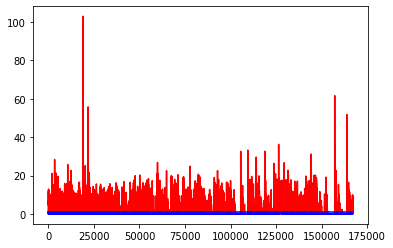

white ratio : 49.5
min : 177
max : 228


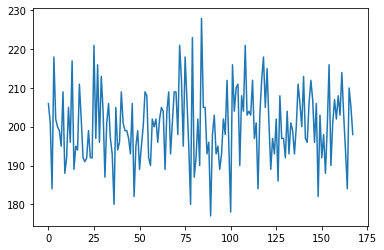

Generating interpolations...
167001 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.814769, 1.780654]
167002 [D loss: 0.000673, acc.: 100.00%] [G loss: 3.838800, 4.068275]
167003 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.600103, 1.193623]
167004 [D loss: 0.000029, acc.: 100.00%] [G loss: 5.041449, 4.095563]
167005 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.368970, 2.191488]
167006 [D loss: 0.000047, acc.: 100.00%] [G loss: 6.675332, 6.310194]
167007 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.313052, 3.548760]
167008 [D loss: 0.000202, acc.: 100.00%] [G loss: 1.567893, 1.611084]
167009 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.198804, 1.323394]
167010 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.011814, 0.000000]
167011 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167012 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.608022, 0.007443]
167013 [D loss: 0.016159, acc.: 100.00%] [G loss: 0.007764, 0.062104]
167014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.717751, 0

167118 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.149805, 0.269514]
167119 [D loss: 0.000986, acc.: 100.00%] [G loss: 0.006342, 0.063961]
167120 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.252236, 0.328066]
167121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
167122 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.912104, 0.458481]
167123 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.171127, 0.008746]
167124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
167125 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.044321, 0.000118]
167126 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167127 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.982759, 0.000014]
167128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.021584, 0.005303]
167129 [D loss: 0.000060, acc.: 100.00%] [G loss: 3.594223, 4.598764]
167130 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.348336, 1.353610]
167131 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.926838, 2.541895]
167132 [D loss: 0.00

167236 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.128372, 0.103407]
167237 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.013885, 0.066763]
167238 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000005]
167239 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.994682, 0.326246]
167240 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.262794, 0.648666]
167241 [D loss: 0.000198, acc.: 100.00%] [G loss: 0.000008, 0.000017]
167242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.139119, 0.093179]
167243 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.013834, 0.156774]
167244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
167245 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167246 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000913, 0.001380]
167247 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.055095, 0.000141]
167248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000091]
167249 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.080885, 0.016141]
167250 [D loss: 0.00

167355 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167356 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167357 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
167358 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000136, 0.000181]
167359 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.565287, 0.530832]
167360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.191375, 0.148475]
167361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000019]
167363 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.215705, 0.155419]
167364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167365 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.655900, 0.224280]
167366 [D loss: 0.000122, acc.: 100.00%] [G loss: 0.310024, 0.283162]
167367 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.388476, 0.228122]
167368 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167369 [D loss: 0.00

167474 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000004, 0.000000]
167475 [D loss: 0.004328, acc.: 100.00%] [G loss: 0.000315, 0.000066]
167476 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.165610, 0.076385]
167477 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.239607, 0.616587]
167478 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.295081, 0.349848]
167479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000002]
167480 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.014247, 0.000003]
167481 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.992141, 0.673867]
167482 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000035]
167483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167484 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000034, 0.000038]
167485 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.079958, 1.076391]
167486 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.139526, 0.195733]
167487 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000002, 0.000000]
167488 [D loss: 0.00

167594 [D loss: 0.000530, acc.: 100.00%] [G loss: 1.100473, 0.929924]
167595 [D loss: 0.000187, acc.: 100.00%] [G loss: 1.142167, 5.949106]
167596 [D loss: 0.000012, acc.: 100.00%] [G loss: 13.608644, 11.794809]
167597 [D loss: 0.000049, acc.: 100.00%] [G loss: 8.922581, 7.519089]
167598 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.383272, 5.755642]
167599 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.639975, 11.522696]
167600 [D loss: 0.000619, acc.: 100.00%] [G loss: 15.601198, 17.222343]
167601 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.397415, 4.176932]
167602 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.295486, 0.579842]
167603 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.965153, 17.055264]
167604 [D loss: 0.010729, acc.: 100.00%] [G loss: 1.188585, 1.769001]
167605 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000005, 0.000007]
167606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.136749, 0.000279]
167607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000686, 0.008945]
167608 [D los

167711 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.005268, 0.046536]
167712 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000000, 0.000026]
167713 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.563466, 0.519182]
167714 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000009, 0.000010]
167715 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.622734, 0.670301]
167716 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000766, 0.003653]
167717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.166767, 0.452031]
167718 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000051, 0.006083]
167719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000539, 0.000001]
167720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000000]
167721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167722 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.035154, 0.404471]
167723 [D loss: 0.000064, acc.: 100.00%] [G loss: 0.001024, 0.000012]
167724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.093011, 0.000326]
167725 [D loss: 0.00

167829 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167830 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000001, 0.000041]
167831 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000975, 0.069699]
167832 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167833 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167834 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.036507, 0.000005]
167835 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167836 [D loss: 0.000293, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167837 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167838 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000000]
167839 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.241107, 0.004826]
167840 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000022, 0.000000]
167841 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000060, 0.000003]
167842 [D loss: 0.000719, acc.: 100.00%] [G loss: 0.000006, 0.000000]
167843 [D loss: 0.00

167948 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167949 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167950 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000012]
167951 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.001585, 0.091145]
167952 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.042727, 0.366671]
167953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027506, 0.000017]
167954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000000]
167955 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000006, 0.000117]
167956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000099]
167957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
167958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
167959 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.100067, 0.230819]
167960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.231970, 0.937964]
167961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.093318, 0.498111]
167962 [D loss: 0.00

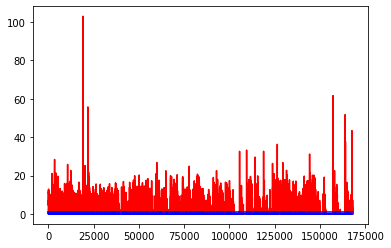

white ratio : 54.0
min : 177
max : 228


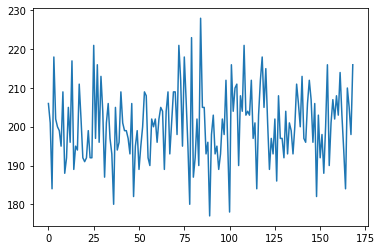

Generating interpolations...
168001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002453, 0.000034]
168002 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.098098, 5.353212]
168003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.838300, 0.528162]
168004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.024061]
168005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000023, 0.000064]
168006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014104, 0.000082]
168007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000129, 0.000734]
168008 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000008, 0.000051]
168009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.075060, 0.261857]
168010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.509189, 0.334492]
168011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010137, 0.000129]
168012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002143, 0.312976]
168013 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.234075, 1.418503]
168014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0

168120 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000000, 0.000000]
168121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000005]
168122 [D loss: 0.003277, acc.: 100.00%] [G loss: 0.000001, 0.000031]
168123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
168124 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000009, 0.000006]
168125 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000421, 0.002112]
168126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010186, 0.000053]
168127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
168128 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000058]
168129 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000004]
168130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
168131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.026580, 0.398165]
168132 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000019]
168133 [D loss: 0.003140, acc.: 100.00%] [G loss: 0.087616, 0.094039]
168134 [D loss: 0.00

168240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002886, 0.000763]
168241 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001656, 0.000250]
168242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
168243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000008]
168244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001888, 0.000024]
168245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.136909, 0.104016]
168246 [D loss: 0.001168, acc.: 100.00%] [G loss: 0.043515, 0.050351]
168247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.091512, 0.091932]
168248 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000001]
168249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.291031, 0.046604]
168250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.024025, 0.027403]
168251 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
168252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000146, 0.050287]
168253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000010]
168254 [D loss: 0.00

168358 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.397208, 0.125457]
168359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000187, 0.000328]
168360 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.361153, 0.109799]
168361 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.009247, 0.000585]
168362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.050753, 0.434738]
168363 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.014522, 0.001420]
168364 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.436929, 0.227966]
168365 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.008885, 0.605004]
168366 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000377, 0.022639]
168367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000007]
168368 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.030312, 0.003575]
168369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.344191, 0.643297]
168370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.093783, 0.048279]
168371 [D loss: 0.000004, acc.: 100.00%] [G loss: 13.556116, 4.120390]
168372 [D loss: 0.0

168478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000047, 0.000055]
168479 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.001126, 0.093522]
168480 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.244294, 0.405939]
168481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000049, 0.000000]
168482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000041, 0.002600]
168483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000033, 0.000035]
168484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010302, 0.000190]
168485 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000212, 0.000354]
168486 [D loss: 0.045354, acc.: 96.88%] [G loss: 0.000000, 0.000000]
168487 [D loss: 0.216959, acc.: 96.88%] [G loss: 0.000753, 0.029574]
168488 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.032782, 1.953454]
168489 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.118207, 8.659724]
168490 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.139094, 10.051252]
168491 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.654819, 14.209568]
168492 [D loss: 0

168596 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.061876, 0.360627]
168597 [D loss: 0.000341, acc.: 100.00%] [G loss: 2.718495, 2.401559]
168598 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.001767, 0.000661]
168599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.072346, 0.127495]
168600 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.084777, 0.013957]
168601 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.017835, 0.183757]
168602 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.135122, 0.007783]
168603 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.180414, 0.112721]
168604 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000050, 0.000019]
168605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.177241, 0.332172]
168606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.212891, 0.091862]
168607 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.013227, 0.034983]
168608 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.027856, 0.055029]
168609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000062, 0.003405]
168610 [D loss: 0.00

168714 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.036195, 0.000262]
168715 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.132370, 0.138665]
168716 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.186980, 0.288613]
168717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000167, 0.000009]
168718 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.167696, 0.247890]
168719 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049754, 0.018196]
168720 [D loss: 0.008378, acc.: 100.00%] [G loss: 0.000231, 0.013862]
168721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.287929, 0.099192]
168722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.000559]
168723 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000168, 0.000538]
168724 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.513674, 0.152878]
168725 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.066482, 0.122289]
168726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000135, 0.000345]
168727 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.005311, 0.008052]
168728 [D loss: 0.00

168833 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004036, 0.000406]
168834 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001174, 0.166504]
168835 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.027575, 0.297424]
168836 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.347620, 0.544164]
168837 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.141479, 0.000964]
168838 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.005464, 0.000902]
168839 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000175, 0.000069]
168840 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.004573, 0.019969]
168841 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000452, 0.002085]
168842 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000274, 0.070066]
168843 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.005014, 0.057078]
168844 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.088539, 0.010609]
168845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000970, 0.000001]
168846 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.081147, 0.038565]
168847 [D loss: 0.00

168952 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000220, 0.000289]
168953 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000011]
168954 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.562688, 0.338068]
168955 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.369852, 0.113150]
168956 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000052, 0.000023]
168957 [D loss: 0.000509, acc.: 100.00%] [G loss: 0.000217, 0.000494]
168958 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.065480, 0.120621]
168959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001144, 0.000423]
168960 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.006701, 0.062414]
168961 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000001]
168962 [D loss: 0.000340, acc.: 100.00%] [G loss: 0.001564, 0.013306]
168963 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.304887, 0.137942]
168964 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000009, 0.000304]
168965 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.021978, 0.000591]
168966 [D loss: 0.00

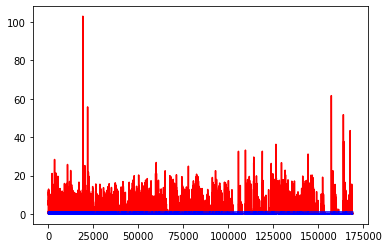

white ratio : 48.5
min : 177
max : 228


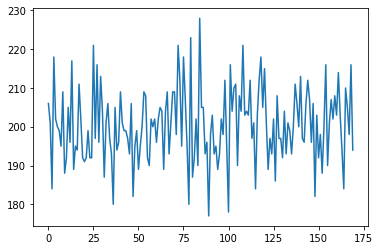

Generating interpolations...
169001 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169002 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.001863, 0.002665]
169003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000053, 0.000166]
169004 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000019, 0.000586]
169006 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169007 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000005]
169008 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.036331, 0.000060]
169010 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
169011 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000360, 0.000000]
169012 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.002854, 0.000015]
169013 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000005, 0.000000]
169014 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001425, 0

169120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000594, 0.000370]
169121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014547, 0.076591]
169122 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.003575, 0.001159]
169123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.258732, 0.097757]
169124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000069, 0.000000]
169125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.125025, 0.043441]
169126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.546455, 0.658659]
169127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000194, 0.000267]
169128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.046881, 0.002683]
169129 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.420626, 3.214079]
169130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000135, 0.000007]
169131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001135, 0.000028]
169132 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001190, 0.000002]
169133 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
169134 [D loss: 0.00

169239 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
169240 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000000]
169243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169244 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000011, 0.000030]
169245 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000041, 0.000513]
169246 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169247 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169249 [D loss: 0.002174, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000356]
169251 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001367, 0.000001]
169252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169253 [D loss: 0.00

169358 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000000]
169359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000108, 0.000198]
169360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000017, 0.000211]
169361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000000]
169362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000006, 0.000000]
169363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008526, 0.002416]
169364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000011, 0.000001]
169366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.408046, 0.146092]
169367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000004]
169368 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000289, 0.002568]
169369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001856, 0.056350]
169370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033455, 0.140937]
169371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011058, 0.011887]
169372 [D loss: 0.00

169476 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.002987, 0.000006]
169477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000051]
169478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000007]
169479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000015]
169480 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000003]
169482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000003]
169484 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
169485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
169486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169487 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000060, 0.000001]
169488 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000009, 0.000045]
169489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000005]
169490 [D loss: 0.00

169595 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.009903, 0.000080]
169596 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000002, 0.000032]
169597 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.001885]
169598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169599 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169601 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000612, 0.015069]
169602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169603 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169604 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000020, 0.000001]
169605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169606 [D loss: 0.000775, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169607 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000127, 0.000000]
169609 [D loss: 0.00

169714 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000016]
169715 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000014, 0.000439]
169716 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000024, 0.000001]
169717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169718 [D loss: 0.075870, acc.: 96.88%] [G loss: 0.000000, 0.000000]
169719 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169720 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.000000, 0.000000]
169721 [D loss: 0.166824, acc.: 96.88%] [G loss: 0.000003, 0.000007]
169722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000007, 0.000237]
169723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.513670, 0.562765]
169724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.142210, 0.246541]
169725 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000140]
169726 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000896, 0.119596]
169727 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.120084, 0.006760]
169728 [D loss: 0.0000

169831 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.015138, 0.011788]
169832 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.001684, 0.011278]
169833 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001915, 0.000497]
169834 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.848968, 1.190044]
169835 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.192461, 0.411337]
169836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001619, 0.000297]
169838 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.057566, 0.305128]
169839 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000597, 0.000020]
169840 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.008382, 0.007765]
169841 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.108489, 0.000875]
169842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000059, 0.000264]
169843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000001]
169844 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.080504, 0.011709]
169845 [D loss: 0.00

169949 [D loss: 0.014533, acc.: 100.00%] [G loss: 0.000326, 0.002129]
169950 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000319, 0.000020]
169951 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001320, 0.000108]
169952 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000195]
169953 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.011305, 0.035502]
169954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.033615, 0.249936]
169955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.047762, 0.029355]
169956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000011]
169957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.210974, 0.235687]
169958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009149, 0.020498]
169959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002920, 0.005443]
169960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.013881]
169961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.073160, 0.006907]
169962 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000161, 0.000033]
169963 [D loss: 0.00

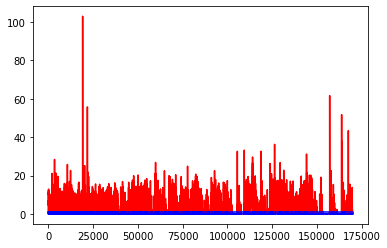

white ratio : 48.5
min : 177
max : 228


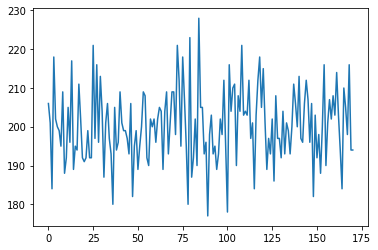

Generating interpolations...
170001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.000055]
170002 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000034, 0.000018]
170003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.018422, 0.013439]
170004 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.024780, 0.017482]
170005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000068, 0.000013]
170006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.120770, 0.487703]
170007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.091129, 0.066067]
170008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010584, 0.000994]
170009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.001507]
170010 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.050791, 0.007694]
170011 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000083, 0.000030]
170012 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.010685, 0.000831]
170013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009234, 0.000173]
170014 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0

170117 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000006, 0.000003]
170118 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.107633, 0.007083]
170119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000299]
170120 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000009, 0.000001]
170121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000032, 0.000736]
170122 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.017490, 0.001171]
170123 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.032404, 0.038913]
170124 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001167, 0.001208]
170125 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.003332, 0.117758]
170126 [D loss: 0.008019, acc.: 100.00%] [G loss: 0.008344, 0.000260]
170127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.036763, 0.008308]
170128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000227, 0.000004]
170129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.164455, 0.228435]
170130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
170131 [D loss: 0.00

170234 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.077573, 0.000099]
170235 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.950913, 1.253435]
170236 [D loss: 0.001675, acc.: 100.00%] [G loss: 0.006516, 0.023115]
170237 [D loss: 0.000264, acc.: 100.00%] [G loss: 0.021019, 0.044807]
170238 [D loss: 0.014567, acc.: 100.00%] [G loss: 0.479289, 0.420565]
170239 [D loss: 0.000776, acc.: 100.00%] [G loss: 0.105616, 0.113012]
170240 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.058581, 0.000599]
170241 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.149065, 0.149721]
170242 [D loss: 0.050139, acc.: 96.88%] [G loss: 0.010982, 0.097864]
170243 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.033826, 0.049722]
170244 [D loss: 0.004982, acc.: 100.00%] [G loss: 0.396415, 0.004950]
170245 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.030590, 0.664818]
170246 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.198447, 0.094660]
170247 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.904013, 1.429169]
170248 [D loss: 0.000

170352 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000532, 0.013556]
170353 [D loss: 0.089561, acc.: 96.88%] [G loss: 0.000011, 0.000120]
170354 [D loss: 0.000356, acc.: 100.00%] [G loss: 0.000002, 0.000004]
170355 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.000260, 0.000179]
170356 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.000002, 0.000004]
170357 [D loss: 0.000304, acc.: 100.00%] [G loss: 0.000029, 0.000098]
170358 [D loss: 0.000609, acc.: 100.00%] [G loss: 0.001665, 0.003796]
170359 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.000000, 0.000000]
170360 [D loss: 0.000553, acc.: 100.00%] [G loss: 0.000086, 0.000068]
170361 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
170362 [D loss: 0.000835, acc.: 100.00%] [G loss: 0.000489, 0.004975]
170363 [D loss: 0.000489, acc.: 100.00%] [G loss: 0.015439, 0.038329]
170364 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000045, 0.000101]
170365 [D loss: 0.000213, acc.: 100.00%] [G loss: 0.000002, 0.000004]
170366 [D loss: 0.000

170472 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.014008, 0.054172]
170473 [D loss: 0.000127, acc.: 100.00%] [G loss: 1.231236, 0.533499]
170474 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.301968, 5.532757]
170475 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.065283, 0.021712]
170476 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.126280, 1.857367]
170477 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.712586, 0.407061]
170478 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.514782, 0.043261]
170479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.730437, 1.126362]
170480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.903482, 0.265699]
170481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.610207, 0.869956]
170482 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.002359, 0.010942]
170483 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.888357, 2.365776]
170484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.071988, 0.048703]
170485 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.920633, 1.142049]
170486 [D loss: 0.00

170591 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.052048, 0.153542]
170592 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.040038, 4.225268]
170593 [D loss: 0.000007, acc.: 100.00%] [G loss: 7.932556, 6.843114]
170594 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.368524, 4.107305]
170595 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.400635, 0.817074]
170596 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.223018, 0.233136]
170597 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.631413, 0.322664]
170598 [D loss: 0.000002, acc.: 100.00%] [G loss: 32.950531, 1.219968]
170599 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.151748, 0.231923]
170600 [D loss: 0.000029, acc.: 100.00%] [G loss: 1.788317, 1.163422]
170601 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.274042, 0.177507]
170602 [D loss: 0.000763, acc.: 100.00%] [G loss: 0.000115, 0.001086]
170603 [D loss: 0.000362, acc.: 100.00%] [G loss: 0.004752, 0.000517]
170604 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.176615, 0.049428]
170605 [D loss: 0.0

170708 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000204, 0.000006]
170709 [D loss: 0.013080, acc.: 100.00%] [G loss: 0.512854, 0.073692]
170710 [D loss: 0.013933, acc.: 100.00%] [G loss: 7.211210, 1.975874]
170711 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.611927, 2.698253]
170712 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.501321, 4.050913]
170713 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.066038, 4.215313]
170714 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.386919, 3.202856]
170715 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.182622, 1.277675]
170716 [D loss: 0.039089, acc.: 96.88%] [G loss: 0.626449, 0.349687]
170717 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.820315, 2.105261]
170718 [D loss: 0.001367, acc.: 100.00%] [G loss: 4.579119, 4.044376]
170719 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.291884, 0.350058]
170720 [D loss: 0.002686, acc.: 100.00%] [G loss: 1.588501, 2.166665]
170721 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003138, 0.125408]
170722 [D loss: 0.000

170826 [D loss: 0.000071, acc.: 100.00%] [G loss: 0.393398, 0.426805]
170827 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.020977, 0.003713]
170828 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000604, 0.001212]
170829 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.041689, 0.046922]
170830 [D loss: 0.000033, acc.: 100.00%] [G loss: 5.298518, 4.266029]
170831 [D loss: 0.000822, acc.: 100.00%] [G loss: 0.413106, 0.804579]
170832 [D loss: 0.001232, acc.: 100.00%] [G loss: 1.969242, 1.516035]
170833 [D loss: 0.005720, acc.: 100.00%] [G loss: 0.794395, 0.629324]
170834 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.750519, 0.766791]
170835 [D loss: 0.000003, acc.: 100.00%] [G loss: 65.977287, 0.008613]
170836 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.436223, 6.470209]
170837 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.581112, 8.048891]
170838 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.132330, 2.351030]
170839 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.903168, 1.780025]
170840 [D loss: 0.0

170946 [D loss: 0.000105, acc.: 100.00%] [G loss: 2.200161, 1.208229]
170947 [D loss: 0.000208, acc.: 100.00%] [G loss: 0.065786, 0.025363]
170948 [D loss: 0.000402, acc.: 100.00%] [G loss: 0.440911, 0.166997]
170949 [D loss: 0.000236, acc.: 100.00%] [G loss: 0.509372, 0.766993]
170950 [D loss: 0.004607, acc.: 100.00%] [G loss: 0.762987, 0.225876]
170951 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.221855, 0.851454]
170952 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.509156, 0.250708]
170953 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.350677, 0.364530]
170954 [D loss: 0.001413, acc.: 100.00%] [G loss: 0.218430, 0.434100]
170955 [D loss: 0.007781, acc.: 100.00%] [G loss: 0.005459, 0.008652]
170956 [D loss: 0.000397, acc.: 100.00%] [G loss: 0.090982, 0.004153]
170957 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.884318, 4.892725]
170958 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.001265, 0.002548]
170959 [D loss: 0.000035, acc.: 100.00%] [G loss: 53.279846, 0.151276]
170960 [D loss: 0.0

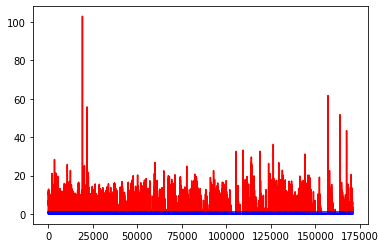

white ratio : 50.0
min : 177
max : 228


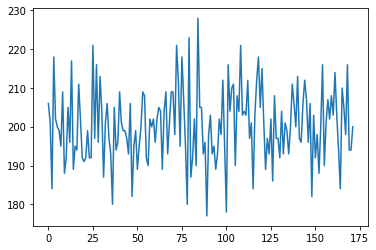

Generating interpolations...
171001 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.150553, 1.203170]
171002 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.423018, 0.531966]
171003 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.287015, 0.573575]
171004 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.069670, 0.005246]
171005 [D loss: 0.006446, acc.: 100.00%] [G loss: 0.135008, 0.725526]
171006 [D loss: 0.042556, acc.: 96.88%] [G loss: 0.006133, 0.009994]
171007 [D loss: 0.000482, acc.: 100.00%] [G loss: 0.010846, 0.062860]
171008 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.060068, 0.037984]
171009 [D loss: 0.000383, acc.: 100.00%] [G loss: 0.855012, 0.723631]
171010 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.512568, 0.180795]
171011 [D loss: 0.000619, acc.: 100.00%] [G loss: 9.340468, 0.918951]
171012 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000201, 0.000178]
171013 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.728476, 3.411230]
171014 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.458663, 1.

171120 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.479100, 1.496261]
171121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.355100, 0.291322]
171122 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.894645, 1.026320]
171123 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.650145, 3.955753]
171124 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.069937, 0.104062]
171125 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.099479, 2.610684]
171126 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.751786, 0.681006]
171127 [D loss: 0.001552, acc.: 100.00%] [G loss: 0.112175, 0.097291]
171128 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.898324, 0.017987]
171129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.004890, 0.038982]
171130 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.314971, 1.988560]
171131 [D loss: 0.000115, acc.: 100.00%] [G loss: 0.017680, 0.415235]
171132 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.065572, 0.363998]
171133 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.477017, 0.353564]
171134 [D loss: 0.00

171238 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000431, 0.022076]
171239 [D loss: 0.000312, acc.: 100.00%] [G loss: 0.000979, 0.001955]
171240 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.404439, 0.481079]
171241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.128008, 0.172126]
171242 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.106400, 0.000948]
171243 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.002715, 0.000079]
171244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.091498, 0.069215]
171245 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000028, 0.000011]
171246 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.004612, 0.000081]
171247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027372, 0.212037]
171248 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.001092, 0.000699]
171249 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.077860, 0.143233]
171250 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000757, 0.000344]
171251 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000103, 0.035631]
171252 [D loss: 0.00

171359 [D loss: 0.000282, acc.: 100.00%] [G loss: 1.333368, 0.727253]
171360 [D loss: 0.001116, acc.: 100.00%] [G loss: 1.813039, 0.628212]
171361 [D loss: 0.000043, acc.: 100.00%] [G loss: 4.433497, 0.786076]
171362 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.629935, 3.166671]
171363 [D loss: 0.000598, acc.: 100.00%] [G loss: 1.228400, 0.803438]
171364 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.239064, 5.648123]
171365 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.815478, 7.523794]
171366 [D loss: 0.000010, acc.: 100.00%] [G loss: 1.706121, 1.194516]
171367 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.450720, 0.102656]
171368 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.002604, 0.006028]
171369 [D loss: 0.000046, acc.: 100.00%] [G loss: 5.522660, 4.100962]
171370 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.714180, 0.790195]
171371 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.843747, 2.546841]
171372 [D loss: 0.027675, acc.: 96.88%] [G loss: 0.203855, 0.196465]
171373 [D loss: 0.000

171479 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.057069, 0.020380]
171480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000226, 0.011267]
171481 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.000003, 0.000001]
171482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.209210, 0.210928]
171483 [D loss: 0.007985, acc.: 100.00%] [G loss: 0.000013, 0.000081]
171484 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000559, 0.068253]
171485 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.005871, 0.088689]
171486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000017, 0.000003]
171487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.021543, 0.127890]
171488 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000028, 0.000005]
171489 [D loss: 0.006414, acc.: 100.00%] [G loss: 0.000024, 0.000092]
171490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.493315, 0.457516]
171491 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.030385, 0.001380]
171492 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.002378, 0.000097]
171493 [D loss: 0.00

171598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.008065, 0.003305]
171599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.150072, 0.116277]
171600 [D loss: 0.000131, acc.: 100.00%] [G loss: 0.000390, 0.000010]
171601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000007]
171602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000031, 0.000000]
171603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.509102, 0.029964]
171604 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.075027, 0.393475]
171605 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.116570, 0.203997]
171606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.048486, 0.228152]
171607 [D loss: 0.001067, acc.: 100.00%] [G loss: 0.000006, 0.000000]
171608 [D loss: 0.005277, acc.: 100.00%] [G loss: 0.203602, 0.131103]
171609 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000486, 0.027349]
171610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.077059, 0.110201]
171611 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000401, 0.001732]
171612 [D loss: 0.00

171717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.026638, 0.088488]
171718 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000741, 0.000097]
171719 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.003389, 0.000741]
171720 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001949, 0.000087]
171721 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000656, 0.000004]
171722 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.001844, 0.021798]
171723 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000001, 0.000214]
171724 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000928, 0.232730]
171725 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.000301, 0.000159]
171726 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000056, 0.023946]
171727 [D loss: 0.000221, acc.: 100.00%] [G loss: 0.000985, 0.001229]
171728 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.038142, 0.022233]
171729 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000011, 0.000029]
171730 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.129444, 0.078947]
171731 [D loss: 0.00

171837 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.098990, 0.010741]
171838 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
171839 [D loss: 0.000227, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171840 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000016, 0.000002]
171841 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000111, 0.000020]
171842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000021]
171843 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000036, 0.000002]
171844 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000227]
171845 [D loss: 0.035087, acc.: 96.88%] [G loss: 0.001481, 0.005199]
171846 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.073357, 0.013247]
171847 [D loss: 0.003656, acc.: 100.00%] [G loss: 0.000854, 0.000125]
171848 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000075, 0.000005]
171849 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000950, 0.040313]
171850 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.002939, 0.080151]
171851 [D loss: 0.000

171957 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000001]
171958 [D loss: 0.000546, acc.: 100.00%] [G loss: 0.000006, 0.000000]
171959 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000004, 0.000002]
171960 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000005, 0.000001]
171961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171962 [D loss: 0.000513, acc.: 100.00%] [G loss: 0.000001, 0.000000]
171963 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171964 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171965 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000000]
171966 [D loss: 0.000253, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171967 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
171968 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004721, 0.000283]
171969 [D loss: 0.000517, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171970 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
171971 [D loss: 0.00

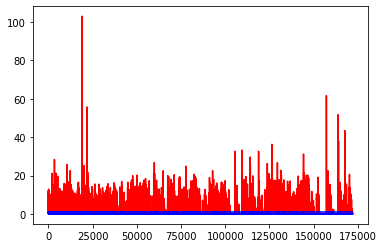

white ratio : 48.25
min : 177
max : 228


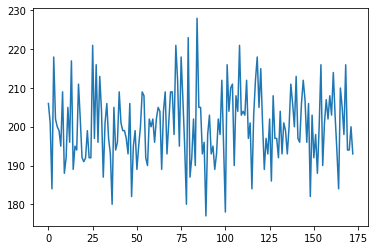

Generating interpolations...
172001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172002 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000001, 0.000000]
172003 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.003788, 0.000039]
172004 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000000]
172005 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.000007, 0.000006]
172006 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000002, 0.000468]
172007 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000149, 0.000358]
172008 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.000001, 0.000001]
172009 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000001]
172010 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000004]
172011 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.001548, 0.000151]
172012 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000003, 0.000000]
172013 [D loss: 0.000096, acc.: 100.00%] [G loss: 0.000143, 0.000952]
172014 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0

172120 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000532, 0.000017]
172121 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.006724, 0.000187]
172122 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172123 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000002, 0.000001]
172124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172125 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000118, 0.000007]
172126 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000000, 0.000002]
172127 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000010, 0.000003]
172128 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000029]
172129 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000195, 0.000014]
172130 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003670, 0.031324]
172131 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000002]
172132 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.001913, 0.004259]
172133 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172134 [D loss: 0.00

172240 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000019, 0.000038]
172241 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000003]
172242 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172243 [D loss: 0.000569, acc.: 100.00%] [G loss: 0.000816, 0.000006]
172244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001127, 0.000271]
172245 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000030, 0.000427]
172246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000030]
172247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001681, 0.000295]
172248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000060, 0.003121]
172249 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172250 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000007, 0.000000]
172251 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000004, 0.000001]
172252 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.003772, 0.000586]
172253 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.038538, 0.035676]
172254 [D loss: 0.00

172359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
172360 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001224, 0.000756]
172361 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.001933, 0.000045]
172362 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000300, 0.005161]
172363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001313, 0.001745]
172364 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000205, 0.000115]
172365 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000597, 0.000446]
172366 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000016, 0.000025]
172367 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172369 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172370 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000057, 0.000007]
172371 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172372 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000022, 0.000400]
172373 [D loss: 0.00

172480 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000489, 0.001057]
172481 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
172482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000599, 0.000446]
172483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000090, 0.006813]
172484 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000279, 0.000036]
172485 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002465, 0.000344]
172486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172487 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172488 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172489 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000004, 0.000000]
172490 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
172491 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000214, 0.005115]
172492 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
172493 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172494 [D loss: 0.00

172600 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000106, 0.000712]
172601 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172602 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000021, 0.000034]
172603 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000232, 0.000575]
172604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172605 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172606 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000002, 0.000002]
172607 [D loss: 0.003247, acc.: 100.00%] [G loss: 0.000021, 0.000052]
172608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000000]
172609 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000399, 0.039519]
172610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000750, 0.031497]
172611 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001288, 0.000043]
172612 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000000, 0.000000]
172613 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000285]
172614 [D loss: 0.00

172718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.950167, 1.337941]
172719 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.763855, 3.583279]
172720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.049921, 0.062274]
172721 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.864429, 2.456563]
172722 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.434481, 2.307867]
172723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.071027, 0.188074]
172724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.313775, 0.367230]
172725 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.004107, 0.021030]
172726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.067444, 0.244120]
172727 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.559412, 0.471685]
172728 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.207289, 0.123947]
172729 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.444131, 0.954477]
172730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.400935, 0.341046]
172731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.321687, 0.114935]
172732 [D loss: 0.00

172836 [D loss: 0.001041, acc.: 100.00%] [G loss: 0.001081, 0.000035]
172837 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.009703, 0.045137]
172838 [D loss: 0.000099, acc.: 100.00%] [G loss: 0.000693, 0.000781]
172839 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000042, 0.059060]
172840 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000324, 0.000974]
172841 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.040167, 0.004470]
172842 [D loss: 0.000143, acc.: 100.00%] [G loss: 0.000090, 0.000347]
172843 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000498, 0.001476]
172844 [D loss: 0.000201, acc.: 100.00%] [G loss: 0.000824, 0.000646]
172845 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.031778, 0.017319]
172846 [D loss: 0.000137, acc.: 100.00%] [G loss: 0.400951, 0.027073]
172847 [D loss: 0.000509, acc.: 100.00%] [G loss: 0.783277, 0.489563]
172848 [D loss: 0.000114, acc.: 100.00%] [G loss: 0.003314, 0.003294]
172849 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.278530, 0.139029]
172850 [D loss: 0.00

172955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000125, 0.001603]
172956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002776, 0.063982]
172957 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.295919, 0.008219]
172958 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.034435, 0.377715]
172959 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.506690, 0.673312]
172960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.183827, 0.163450]
172961 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.328912, 0.416226]
172962 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.001810, 0.000430]
172963 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.203327, 0.212155]
172964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.031048, 0.176899]
172965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.284901, 0.349217]
172966 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.097132, 0.041292]
172967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009884, 0.030331]
172968 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.018223, 0.145087]
172969 [D loss: 0.00

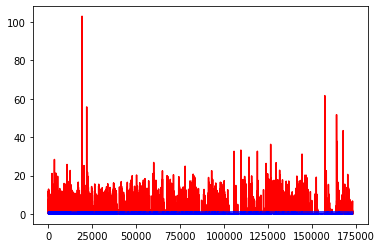

white ratio : 49.0
min : 177
max : 228


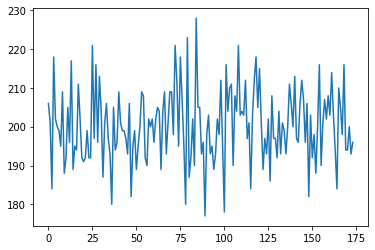

Generating interpolations...
173001 [D loss: 0.002081, acc.: 100.00%] [G loss: 0.000000, 0.000000]
173002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000001]
173003 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.000000, 0.000000]
173004 [D loss: 0.000301, acc.: 100.00%] [G loss: 0.000000, 0.000006]
173005 [D loss: 0.003610, acc.: 100.00%] [G loss: 0.000000, 0.000000]
173006 [D loss: 0.000496, acc.: 100.00%] [G loss: 0.000484, 0.000015]
173007 [D loss: 0.078394, acc.: 96.88%] [G loss: 0.408396, 0.232180]
173008 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.627693, 2.457625]
173009 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.064569, 0.749630]
173010 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.642812, 4.148687]
173011 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.878381, 2.039165]
173012 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.402634, 1.597638]
173013 [D loss: 0.025541, acc.: 96.88%] [G loss: 51.390305, 11.455235]
173014 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.599117,

173118 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.031304, 0.774498]
173119 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.106893, 0.338733]
173120 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.150591, 0.008949]
173121 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.042239, 0.002256]
173122 [D loss: 0.000019, acc.: 100.00%] [G loss: 5.150965, 0.000134]
173123 [D loss: 0.005567, acc.: 100.00%] [G loss: 0.039678, 0.072318]
173124 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.530430, 0.205615]
173125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.323042, 0.057096]
173126 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.039584, 0.077236]
173127 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.541196, 0.278252]
173128 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.329790, 0.296403]
173129 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.500759, 0.513071]
173130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.160921, 0.561816]
173131 [D loss: 0.003407, acc.: 100.00%] [G loss: 0.218311, 0.290694]
173132 [D loss: 0.00

173237 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.247925, 0.262771]
173238 [D loss: 0.000124, acc.: 100.00%] [G loss: 0.000029, 0.000011]
173239 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001351, 0.006708]
173240 [D loss: 0.000093, acc.: 100.00%] [G loss: 0.000067, 0.004100]
173241 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000180, 0.000015]
173242 [D loss: 0.001420, acc.: 100.00%] [G loss: 0.000106, 0.000976]
173243 [D loss: 0.001027, acc.: 100.00%] [G loss: 0.000153, 0.000036]
173244 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.107616, 0.119622]
173245 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000064, 0.000013]
173246 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.011546, 0.023387]
173247 [D loss: 0.039512, acc.: 96.88%] [G loss: 0.000016, 0.000039]
173248 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.024523, 0.014319]
173249 [D loss: 0.000992, acc.: 100.00%] [G loss: 0.000017, 0.000149]
173250 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000002]
173251 [D loss: 0.000

173356 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000157, 0.000739]
173357 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000404, 0.000151]
173358 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.267710, 0.001434]
173359 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000100, 0.000115]
173360 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000003, 0.000174]
173361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000049]
173362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000038, 0.000220]
173363 [D loss: 0.000117, acc.: 100.00%] [G loss: 0.004771, 0.010583]
173364 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000564, 0.000780]
173365 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000483, 0.000005]
173366 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000023, 0.000008]
173367 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.006337, 0.001151]
173368 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.008699, 0.016087]
173369 [D loss: 0.000138, acc.: 100.00%] [G loss: 0.000593, 0.003994]
173370 [D loss: 0.00

173474 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000005, 0.000805]
173475 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000318, 0.000029]
173476 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000008, 0.000327]
173477 [D loss: 0.001540, acc.: 100.00%] [G loss: 0.000359, 0.000358]
173478 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000050, 0.000005]
173479 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000222, 0.000286]
173480 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000211, 0.001609]
173481 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.099759, 0.026961]
173482 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000444, 0.037278]
173483 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000060, 0.000011]
173484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000261, 0.000298]
173485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008456, 0.061937]
173486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.003053, 0.000434]
173487 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.007286, 0.000090]
173488 [D loss: 0.00

173594 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.165358, 0.603133]
173595 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.138611, 0.174642]
173596 [D loss: 0.001038, acc.: 100.00%] [G loss: 0.025299, 0.012395]
173597 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.001225, 0.013243]
173598 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.274305, 0.514593]
173599 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.016302, 0.114208]
173600 [D loss: 0.000078, acc.: 100.00%] [G loss: 3.075236, 1.712810]
173601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.236593, 0.077345]
173602 [D loss: 0.000537, acc.: 100.00%] [G loss: 0.179290, 0.582916]
173603 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.247480, 0.486125]
173604 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.037409, 0.046484]
173605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.165609, 0.024088]
173606 [D loss: 0.000090, acc.: 100.00%] [G loss: 0.029691, 0.001372]
173607 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.159985, 0.080179]
173608 [D loss: 0.00

173713 [D loss: 0.000228, acc.: 100.00%] [G loss: 0.095900, 0.055145]
173714 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000356, 0.000622]
173715 [D loss: 0.004254, acc.: 100.00%] [G loss: 0.002535, 0.019314]
173716 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.007632, 0.001540]
173717 [D loss: 0.000566, acc.: 100.00%] [G loss: 0.000006, 0.000004]
173718 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.162644, 0.000314]
173719 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000406, 0.004336]
173720 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.132835, 0.127444]
173721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001100, 0.001137]
173722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001689, 0.000103]
173723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.030531, 0.326922]
173724 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.016422, 0.002788]
173725 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.003668, 0.020683]
173726 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000003, 0.000037]
173727 [D loss: 0.00

173833 [D loss: 0.000047, acc.: 100.00%] [G loss: 0.000925, 0.000878]
173834 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.007342, 0.001321]
173835 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000003]
173836 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001172, 0.000361]
173837 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000045, 0.007728]
173838 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.023749, 0.000006]
173839 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.018103, 0.014459]
173840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000227, 0.000036]
173841 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000238, 0.010922]
173842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000012, 0.000001]
173843 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000158, 0.000025]
173844 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000001, 0.000003]
173845 [D loss: 0.000618, acc.: 100.00%] [G loss: 0.002235, 0.000027]
173846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002443, 0.020861]
173847 [D loss: 0.00

173951 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.001199, 0.006531]
173952 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.015723, 0.322651]
173953 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006380, 0.000171]
173954 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004663, 0.001621]
173955 [D loss: 0.000290, acc.: 100.00%] [G loss: 0.006601, 0.000032]
173956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.015463, 0.000026]
173957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000661, 0.014963]
173958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.041022, 0.382071]
173959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002326, 0.012725]
173960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.009266, 0.000620]
173961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001845, 0.011438]
173962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001689, 0.004220]
173963 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000998, 0.000780]
173964 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.065247, 0.082508]
173965 [D loss: 0.00

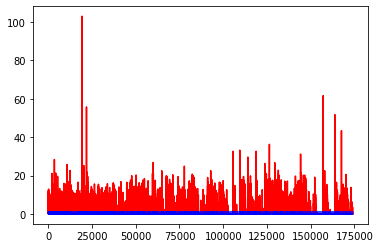

white ratio : 49.75
min : 177
max : 228


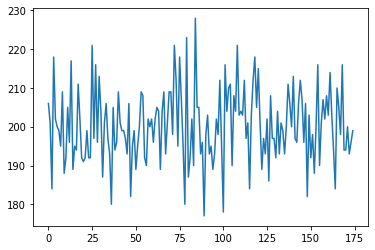

Generating interpolations...
174001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000410, 0.007372]
174002 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000732, 0.000100]
174003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000021, 0.000132]
174004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.005569, 0.000705]
174005 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.002504, 0.048075]
174006 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.046853, 0.045571]
174007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001746, 0.000080]
174008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000050, 0.003051]
174009 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000012, 0.000051]
174010 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.002537, 0.011168]
174011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000413, 0.001880]
174012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000146, 0.005004]
174013 [D loss: 0.000623, acc.: 100.00%] [G loss: 0.123446, 0.190874]
174014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000266, 0

174119 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001533, 0.000201]
174120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000062, 0.004304]
174121 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.002721, 0.007563]
174122 [D loss: 0.006498, acc.: 100.00%] [G loss: 0.000058, 0.000010]
174123 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000002, 0.000001]
174124 [D loss: 0.002270, acc.: 100.00%] [G loss: 0.000019, 0.000003]
174125 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000649, 0.000007]
174126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.008602]
174127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001768, 0.001028]
174128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000394, 0.000981]
174129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000014, 0.000008]
174130 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.011748, 0.002560]
174131 [D loss: 0.000250, acc.: 100.00%] [G loss: 0.047366, 0.034743]
174132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
174133 [D loss: 0.00

174238 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000018, 0.000011]
174239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010212, 0.013780]
174240 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000149, 0.005891]
174241 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000342, 0.000227]
174242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.029789, 0.001246]
174243 [D loss: 0.004733, acc.: 100.00%] [G loss: 0.000032, 0.080545]
174244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010262, 0.000953]
174245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001602, 0.000050]
174246 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.007084, 0.000684]
174247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000262, 0.000543]
174248 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.006528, 0.001261]
174249 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.005990, 0.006629]
174250 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004408, 0.001612]
174251 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000183, 0.000063]
174252 [D loss: 0.00

174356 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000044, 0.000001]
174357 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000520, 0.001212]
174358 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000307, 0.002478]
174359 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000572, 0.000038]
174360 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000001, 0.000009]
174361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000002]
174362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000033, 0.000060]
174363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.000004]
174364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000015, 0.000001]
174365 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.000001, 0.000000]
174366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000196, 0.000027]
174367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000266, 0.000207]
174368 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000011, 0.000035]
174369 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000525, 0.058486]
174370 [D loss: 0.00

174477 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
174478 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
174479 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000003]
174480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
174481 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000007]
174482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000074, 0.000002]
174483 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000002, 0.000003]
174484 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
174485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
174486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000003]
174487 [D loss: 0.000764, acc.: 100.00%] [G loss: 0.000002, 0.000000]
174488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
174489 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000000]
174490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
174491 [D loss: 0.00

174598 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000947, 0.003453]
174599 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.002265, 0.005791]
174600 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.013925, 0.008804]
174601 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.001684, 0.018123]
174602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.012814, 0.008273]
174603 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000268, 0.000166]
174604 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000051, 0.001908]
174605 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.001058, 0.001168]
174606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004595, 0.003373]
174607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000013, 0.000438]
174608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000172, 0.000292]
174609 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000228, 0.000022]
174610 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000337]
174611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000671]
174612 [D loss: 0.00

174719 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.013929, 0.093264]
174720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000088, 0.000146]
174721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000022, 0.000093]
174722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007404, 0.000183]
174723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000876, 0.002324]
174724 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003441, 0.038995]
174725 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000006, 0.000356]
174726 [D loss: 0.000146, acc.: 100.00%] [G loss: 0.023884, 0.068722]
174727 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000030, 0.000002]
174728 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.455505, 0.025105]
174729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001158, 0.070604]
174730 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000155, 0.000020]
174731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004043, 0.114253]
174732 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000158, 0.000454]
174733 [D loss: 0.00

174836 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.237764, 5.349970]
174837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.808540, 0.340514]
174838 [D loss: 0.000030, acc.: 100.00%] [G loss: 5.067996, 4.330163]
174839 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.807705, 4.795783]
174840 [D loss: 0.000015, acc.: 100.00%] [G loss: 8.102336, 2.516326]
174841 [D loss: 0.003331, acc.: 100.00%] [G loss: 1.240189, 1.754895]
174842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.324491, 0.149030]
174843 [D loss: 0.001328, acc.: 100.00%] [G loss: 0.506688, 0.045483]
174844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009192, 0.000970]
174845 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.373837, 0.237852]
174846 [D loss: 0.000126, acc.: 100.00%] [G loss: 0.463488, 0.458818]
174847 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.283012, 0.334017]
174848 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.680636, 0.707538]
174849 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.064412, 0.280345]
174850 [D loss: 0.00

174956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.274537, 0.513495]
174957 [D loss: 0.000523, acc.: 100.00%] [G loss: 0.000019, 0.000026]
174958 [D loss: 0.001011, acc.: 100.00%] [G loss: 0.000004, 0.000026]
174959 [D loss: 0.002251, acc.: 100.00%] [G loss: 0.000002, 0.000000]
174960 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.008955, 0.002165]
174961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.243510, 0.037290]
174962 [D loss: 0.000965, acc.: 100.00%] [G loss: 0.026234, 0.262652]
174963 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.634970, 0.173143]
174964 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.225772, 0.014609]
174965 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.021869, 0.031438]
174966 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.138788, 0.260243]
174967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.117763, 0.401177]
174968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.060641, 0.023863]
174969 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004536, 0.000590]
174970 [D loss: 0.00

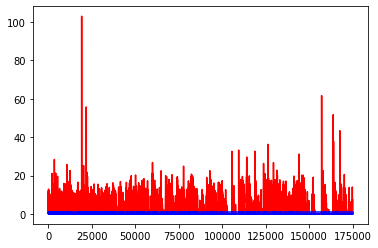

white ratio : 45.75
min : 177
max : 228


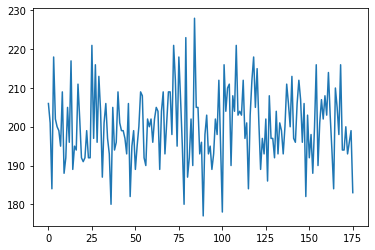

Generating interpolations...
175001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000757, 0.000135]
175002 [D loss: 0.010507, acc.: 100.00%] [G loss: 1.016373, 1.143926]
175003 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.602780, 0.020543]
175004 [D loss: 0.125266, acc.: 96.88%] [G loss: 0.000118, 0.000141]
175005 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.169025, 0.062118]
175006 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.118601, 0.033087]
175007 [D loss: 0.000393, acc.: 100.00%] [G loss: 0.308322, 0.081432]
175008 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000473, 0.000057]
175009 [D loss: 0.000839, acc.: 100.00%] [G loss: 0.000337, 0.005981]
175010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004376, 0.000243]
175011 [D loss: 0.001448, acc.: 100.00%] [G loss: 1.370137, 0.002071]
175012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.107206, 0.056504]
175013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000016]
175014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000905, 0.

175116 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000000]
175117 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.009350, 0.000081]
175118 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000020, 0.000003]
175119 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000001, 0.000001]
175120 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000422, 0.000373]
175121 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000006, 0.000210]
175122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000012, 0.000046]
175123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175124 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175125 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000502, 0.001296]
175126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000871, 0.000003]
175127 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000004, 0.000001]
175128 [D loss: 0.000331, acc.: 100.00%] [G loss: 0.000010, 0.001048]
175129 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.032315, 0.039206]
175130 [D loss: 0.00

175237 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.092125, 0.776048]
175238 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000040]
175239 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000022, 0.000213]
175240 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.421908, 0.039085]
175241 [D loss: 0.027969, acc.: 96.88%] [G loss: 0.000000, 0.000001]
175242 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000001]
175243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000006]
175244 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000003, 0.000001]
175245 [D loss: 0.000295, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175247 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000004, 0.000002]
175248 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000003, 0.000003]
175249 [D loss: 0.000740, acc.: 100.00%] [G loss: 0.000001, 0.001198]
175250 [D loss: 0.000542, acc.: 100.00%] [G loss: 0.000000, 0.000002]
175251 [D loss: 0.000

175355 [D loss: 0.002629, acc.: 100.00%] [G loss: 0.000000, 0.000006]
175356 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175357 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175358 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175359 [D loss: 0.002246, acc.: 100.00%] [G loss: 0.000003, 0.000173]
175360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000069, 0.000028]
175361 [D loss: 0.000805, acc.: 100.00%] [G loss: 0.000270, 0.000000]
175362 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000021, 0.000000]
175363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000003]
175364 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175365 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175366 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000003]
175368 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000011]
175369 [D loss: 0.08

175474 [D loss: 0.000987, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175475 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175476 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175477 [D loss: 0.003118, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175478 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175479 [D loss: 0.000395, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175480 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175481 [D loss: 0.000372, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175482 [D loss: 0.002291, acc.: 100.00%] [G loss: 0.000000, 0.000001]
175483 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175484 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175485 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175487 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175488 [D loss: 0.00

175593 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175594 [D loss: 0.002734, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175595 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175596 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175598 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175599 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175600 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175602 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175604 [D loss: 0.000700, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175605 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175606 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175607 [D loss: 0.00

175712 [D loss: 0.000793, acc.: 100.00%] [G loss: 0.000083, 0.000000]
175713 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000011, 0.000118]
175714 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
175715 [D loss: 0.003559, acc.: 100.00%] [G loss: 0.000021, 0.000039]
175716 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000002, 0.000114]
175717 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.001038]
175718 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000025, 0.000002]
175719 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000085]
175720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000469, 0.001420]
175722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175723 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000001, 0.000001]
175724 [D loss: 0.000298, acc.: 100.00%] [G loss: 0.000006, 0.000002]
175725 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000105, 0.000001]
175726 [D loss: 0.00

175830 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.000001, 0.000000]
175831 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175832 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.000000, 0.000049]
175833 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000027, 0.000000]
175834 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000021, 0.000037]
175835 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000037, 0.000117]
175836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000076, 0.004415]
175837 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175838 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000009, 0.000166]
175840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175841 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000001]
175842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000002]
175843 [D loss: 0.000496, acc.: 100.00%] [G loss: 0.003824, 0.002202]
175844 [D loss: 0.00

175949 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175950 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175951 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000001, 0.000001]
175952 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000009]
175953 [D loss: 0.001872, acc.: 100.00%] [G loss: 0.000005, 0.000001]
175954 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175955 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175956 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000001]
175957 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000000]
175959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175960 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000000, 0.000000]
175961 [D loss: 0.000330, acc.: 100.00%] [G loss: 0.000067, 0.000000]
175962 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000000, 0.000004]
175963 [D loss: 0.00

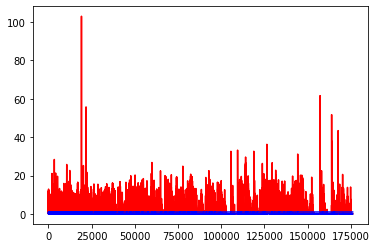

white ratio : 48.0
min : 177
max : 228


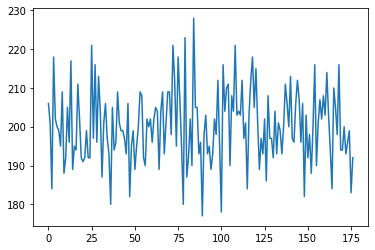

Generating interpolations...
176001 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176002 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176003 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000000]
176005 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176006 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176007 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176008 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176010 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176011 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000003]
176012 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176013 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176014 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000085, 0

176119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000013]
176121 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000003]
176123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176124 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
176125 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176126 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000002]
176128 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176129 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000078]
176131 [D loss: 0.004863, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176132 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176133 [D loss: 0.00

176240 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000015, 0.000503]
176241 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176242 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000006, 0.000002]
176243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000149, 0.114045]
176244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000086, 0.000010]
176246 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000079, 0.001764]
176247 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176248 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176249 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000054, 0.000077]
176250 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176251 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.000000, 0.000006]
176252 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
176253 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176254 [D loss: 0.00

176360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000179, 0.000024]
176361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010331, 0.000697]
176362 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.027422, 0.006377]
176363 [D loss: 0.141697, acc.: 96.88%] [G loss: 0.000000, 0.001554]
176364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000019, 0.000199]
176365 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176366 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176367 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002270, 0.000593]
176368 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176369 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176370 [D loss: 0.007866, acc.: 100.00%] [G loss: 0.000001, 0.000026]
176371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176372 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000008, 0.000022]
176373 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176374 [D loss: 0.000

176478 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176479 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176480 [D loss: 0.000072, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176481 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000398, 0.000012]
176482 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000199, 0.000008]
176483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000093, 0.000000]
176484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000002]
176485 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176486 [D loss: 0.008427, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176487 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000009, 0.000007]
176488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000025]
176489 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176490 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000002]
176491 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176492 [D loss: 0.00

176596 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000000]
176597 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000004, 0.000082]
176598 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000002, 0.000002]
176599 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.004028, 0.000002]
176600 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176601 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176602 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000028, 0.000006]
176603 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000156, 0.000029]
176604 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176605 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176606 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.001580, 0.003345]
176607 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.000186]
176608 [D loss: 0.000846, acc.: 100.00%] [G loss: 0.000002, 0.000000]
176609 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000017, 0.000000]
176610 [D loss: 0.00

176715 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000001, 0.000007]
176716 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000043, 0.000013]
176717 [D loss: 0.001073, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176718 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000065, 0.000136]
176719 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000078]
176724 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000004]
176727 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.000004, 0.000000]
176728 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000008, 0.000000]
176729 [D loss: 0.00

176835 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000545, 0.000031]
176836 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000001]
176837 [D loss: 0.000547, acc.: 100.00%] [G loss: 0.000000, 0.000395]
176838 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000002]
176839 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176840 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.001516, 0.000084]
176841 [D loss: 0.000544, acc.: 100.00%] [G loss: 0.001134, 0.000194]
176842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000012]
176843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176844 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176845 [D loss: 0.000209, acc.: 100.00%] [G loss: 0.000000, 0.000097]
176846 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000027, 0.000323]
176847 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176848 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000018, 0.003318]
176849 [D loss: 0.00

176955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000876, 0.007893]
176956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001148, 0.000004]
176957 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.038884, 0.000000]
176958 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000015, 0.000002]
176959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000024, 0.000000]
176960 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000041, 0.001304]
176961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000009, 0.000023]
176962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000067, 0.002615]
176963 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.017573, 0.000051]
176964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000270, 0.000058]
176965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
176966 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000001, 0.000000]
176967 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.001246, 0.000005]
176968 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.000000, 0.000026]
176969 [D loss: 0.00

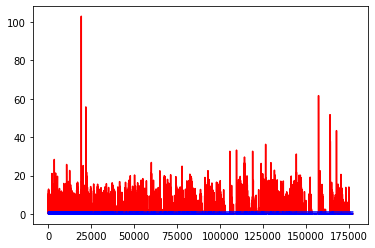

white ratio : 48.5
min : 177
max : 228


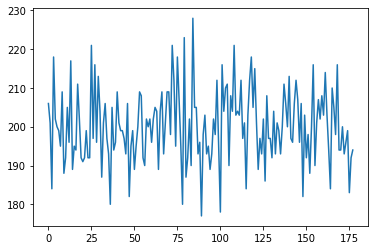

Generating interpolations...
177001 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.000047]
177002 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.014074]
177003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.075798, 0.000051]
177004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000011, 0.000000]
177005 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000026, 0.000008]
177006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002284, 0.000119]
177007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.010653, 0.000196]
177008 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000005, 0.000000]
177009 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000191]
177010 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000132, 0.000021]
177012 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000025, 0.000008]
177013 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000882, 0.202265]
177014 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.204608, 0

177120 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000000]
177121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177122 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000002, 0.000002]
177123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177124 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000001, 0.000862]
177125 [D loss: 0.000563, acc.: 100.00%] [G loss: 0.000001, 0.000001]
177126 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.002570, 0.000307]
177127 [D loss: 0.000625, acc.: 100.00%] [G loss: 0.000000, 0.000008]
177128 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
177130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000246, 0.000003]
177131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000001]
177133 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000754, 0.003606]
177134 [D loss: 0.00

177239 [D loss: 0.042413, acc.: 96.88%] [G loss: 0.000287, 0.004048]
177240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000002]
177241 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000001, 0.000037]
177242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000004]
177243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000001]
177245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177246 [D loss: 0.043074, acc.: 96.88%] [G loss: 0.045190, 0.003996]
177247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.911372, 0.291312]
177248 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.092558, 0.005744]
177249 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.532583, 0.696894]
177250 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.489265, 0.496693]
177251 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.719647, 3.053608]
177252 [D loss: 0.014950, acc.: 100.00%] [G loss: 0.004019, 0.045766]
177253 [D loss: 0.0000

177359 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.231981, 0.622160]
177360 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000056, 0.000024]
177361 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.081221, 0.211429]
177362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000004]
177363 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.008020, 0.003315]
177364 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.040618, 0.182359]
177365 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.122735, 2.694602]
177366 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.388638, 0.465556]
177367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.446789, 0.321306]
177368 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.144949, 0.657121]
177369 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.714446, 0.882545]
177370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.279137, 0.204466]
177371 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.788066, 2.803697]
177372 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.532577, 0.724974]
177373 [D loss: 0.0

177477 [D loss: 0.000166, acc.: 100.00%] [G loss: 0.026858, 0.000645]
177478 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.065711, 0.000200]
177479 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000409, 0.001273]
177480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000416, 0.004892]
177481 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000087, 0.000098]
177482 [D loss: 0.000254, acc.: 100.00%] [G loss: 0.000004, 0.005523]
177483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000004]
177484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.082288, 0.013798]
177485 [D loss: 0.001380, acc.: 100.00%] [G loss: 0.000087, 0.000021]
177486 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000037, 0.000057]
177487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006993, 0.000128]
177488 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000007, 0.000001]
177489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.021229, 0.000001]
177490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000057, 0.000011]
177491 [D loss: 0.00

177598 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000357, 0.008732]
177599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000251, 0.000018]
177600 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000155, 0.009096]
177601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000421]
177602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000246, 0.000050]
177603 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.043284, 0.000370]
177604 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001685, 0.000168]
177605 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000022]
177606 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
177607 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001128, 0.016537]
177608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001161, 0.082863]
177609 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000007, 0.000000]
177610 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000121, 0.000109]
177611 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006064, 0.000398]
177612 [D loss: 0.00

177716 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.245590, 0.046599]
177717 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000800, 0.022286]
177718 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.041972, 0.083517]
177719 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.003572, 0.011234]
177720 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.166105, 0.057942]
177721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000004, 0.000044]
177722 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000323, 0.051489]
177723 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000150, 0.009444]
177724 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000193, 0.000371]
177725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000007]
177726 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000198, 0.000458]
177727 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000027, 0.000006]
177728 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002392, 0.038631]
177729 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001091, 0.002825]
177730 [D loss: 0.00

177836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.023320, 0.177508]
177837 [D loss: 0.000484, acc.: 100.00%] [G loss: 0.000013, 0.010201]
177838 [D loss: 0.000199, acc.: 100.00%] [G loss: 0.217160, 0.577674]
177839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010165, 0.000000]
177840 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000126, 0.000257]
177841 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000262, 0.000648]
177842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
177843 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177844 [D loss: 0.000111, acc.: 100.00%] [G loss: 0.000005, 0.000006]
177845 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000261, 0.026865]
177846 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000037, 0.000277]
177847 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000005, 0.000150]
177848 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000040, 0.002758]
177849 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
177850 [D loss: 0.00

177954 [D loss: 0.002975, acc.: 100.00%] [G loss: 0.003074, 0.016813]
177955 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001198, 0.002615]
177956 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.043558, 0.000767]
177958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177959 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177960 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000031, 0.000000]
177963 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000168, 0.002440]
177964 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017832, 0.107554]
177965 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.016728, 0.016148]
177966 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.020940, 0.134271]
177967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
177968 [D loss: 0.00

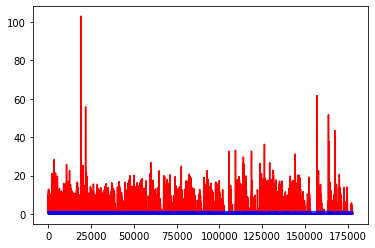

white ratio : 51.5
min : 177
max : 228


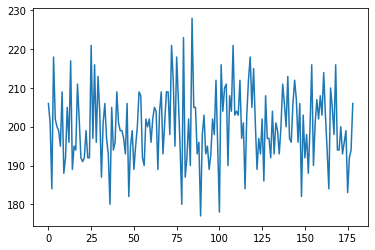

Generating interpolations...
178001 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.145823, 0.044189]
178002 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000000]
178003 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
178004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178005 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.024356, 0.008902]
178006 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000016, 0.000000]
178007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178008 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178009 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005673, 0.076228]
178010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000005]
178011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000419, 0.002091]
178012 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000010, 0.003647]
178013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002379, 0.000161]
178014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0

178119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.042784, 0.221288]
178120 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.112802, 0.731629]
178121 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.420142, 1.326592]
178122 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.765682, 0.588453]
178123 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.142204, 1.119471]
178124 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.743768, 1.265011]
178125 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.059934, 0.197568]
178126 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.027242, 0.022964]
178127 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000062, 0.000182]
178128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.004399, 0.000006]
178129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.344549, 0.255306]
178130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.296372, 0.970993]
178131 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.895482, 0.485188]
178132 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.043925, 0.004003]
178133 [D loss: 0.00

178239 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.747173, 0.666837]
178240 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.544954, 0.757212]
178241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.018774, 0.087961]
178242 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.174754, 1.767481]
178243 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.204634, 0.907260]
178244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.079458, 0.135114]
178245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.061308, 0.346427]
178246 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.152213, 0.084057]
178247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.287072, 0.125357]
178248 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.950199, 1.208519]
178249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001325, 0.003100]
178250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032474, 0.293455]
178251 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.596281, 1.362147]
178252 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.693609, 0.279707]
178253 [D loss: 0.00

178358 [D loss: 0.002271, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178359 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000409, 0.002758]
178360 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.001003, 0.003238]
178361 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000190, 0.001101]
178362 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.000019, 0.000168]
178363 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000002]
178364 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000434, 0.001109]
178365 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.000001, 0.000000]
178366 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000003, 0.000003]
178367 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000002, 0.000000]
178368 [D loss: 0.002916, acc.: 100.00%] [G loss: 0.006731, 0.001309]
178369 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000003, 0.000000]
178370 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000188, 0.000246]
178371 [D loss: 0.000181, acc.: 100.00%] [G loss: 0.000001, 0.000001]
178372 [D loss: 0.00

178476 [D loss: 0.000296, acc.: 100.00%] [G loss: 0.000000, 0.000013]
178477 [D loss: 0.000513, acc.: 100.00%] [G loss: 0.000000, 0.000002]
178478 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178479 [D loss: 0.002873, acc.: 100.00%] [G loss: 0.000005, 0.000028]
178480 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000000, 0.000001]
178481 [D loss: 0.001505, acc.: 100.00%] [G loss: 0.000076, 0.000064]
178482 [D loss: 0.000265, acc.: 100.00%] [G loss: 0.000280, 0.000033]
178483 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
178484 [D loss: 0.217188, acc.: 96.88%] [G loss: 0.008501, 0.113847]
178485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.227751, 0.017860]
178486 [D loss: 0.000099, acc.: 100.00%] [G loss: 1.498930, 0.794391]
178487 [D loss: 0.000129, acc.: 100.00%] [G loss: 0.129938, 0.199689]
178488 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.588483, 0.106420]
178489 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.098766, 0.101294]
178490 [D loss: 0.000

178596 [D loss: 0.012087, acc.: 100.00%] [G loss: 0.090720, 0.012995]
178597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009298, 0.016709]
178598 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.038261, 0.001051]
178599 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.067859, 0.120065]
178600 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.998684, 0.848479]
178601 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000688, 0.000396]
178602 [D loss: 0.000098, acc.: 100.00%] [G loss: 0.014821, 0.000004]
178603 [D loss: 0.000218, acc.: 100.00%] [G loss: 0.063213, 0.212902]
178604 [D loss: 0.005055, acc.: 100.00%] [G loss: 0.004493, 0.010033]
178605 [D loss: 0.002882, acc.: 100.00%] [G loss: 0.102303, 0.236803]
178606 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.202250, 0.442262]
178607 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.001320, 0.000375]
178608 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.589285, 0.048559]
178609 [D loss: 0.000405, acc.: 100.00%] [G loss: 0.000157, 0.000090]
178610 [D loss: 0.00

178715 [D loss: 0.000622, acc.: 100.00%] [G loss: 1.193517, 1.375910]
178716 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.936230, 1.091873]
178717 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.463956, 0.525285]
178718 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.921667, 1.076450]
178719 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.784309, 0.043814]
178720 [D loss: 0.000019, acc.: 100.00%] [G loss: 5.562087, 2.005120]
178721 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.116800, 4.557673]
178722 [D loss: 0.000243, acc.: 100.00%] [G loss: 1.959933, 2.223153]
178723 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.887094, 0.719965]
178724 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.023558, 6.233768]
178725 [D loss: 0.146201, acc.: 96.88%] [G loss: 0.089038, 0.040635]
178726 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.007825, 0.001932]
178727 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.046646, 0.001164]
178728 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.125042, 0.050687]
178729 [D loss: 0.00

178836 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.242017, 0.487118]
178837 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.008151, 0.014961]
178838 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.120196, 0.148207]
178839 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.061137, 0.017827]
178840 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.022446, 0.030870]
178841 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000134, 0.001564]
178842 [D loss: 0.000147, acc.: 100.00%] [G loss: 0.004378, 0.009504]
178843 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.068883, 0.003322]
178844 [D loss: 0.000297, acc.: 100.00%] [G loss: 0.000164, 0.000828]
178845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002608, 0.045373]
178846 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.015004, 0.016327]
178847 [D loss: 0.000205, acc.: 100.00%] [G loss: 2.415743, 0.340607]
178848 [D loss: 0.165461, acc.: 96.88%] [G loss: 0.038258, 0.115700]
178849 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.816987, 1.996814]
178850 [D loss: 0.000

178954 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000568, 0.006432]
178955 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001220, 0.011411]
178956 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.192854, 0.097118]
178957 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004519, 0.257398]
178958 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.055568, 0.003562]
178959 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.015063, 0.016910]
178960 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.056256, 0.212856]
178961 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.022354, 0.001917]
178962 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.641682, 0.452227]
178963 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000031, 0.000017]
178964 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000179, 0.024945]
178965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.017462, 0.003053]
178966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.396479, 0.201742]
178967 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001414, 0.000108]
178968 [D loss: 0.00

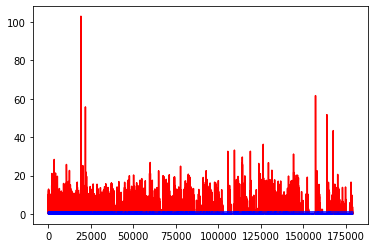

white ratio : 50.25
min : 177
max : 228


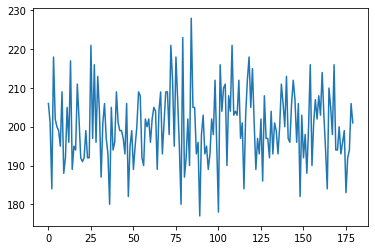

Generating interpolations...
179001 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.043720, 0.032267]
179002 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.010658, 0.000549]
179003 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000289, 0.001974]
179004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.036830, 0.075032]
179005 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000065, 0.000610]
179006 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001373, 0.034696]
179007 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000306, 0.000042]
179008 [D loss: 0.000488, acc.: 100.00%] [G loss: 0.000303, 0.002023]
179009 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.006627, 0.329894]
179010 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.306105, 0.323782]
179011 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002381, 0.089505]
179012 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002924, 0.003343]
179013 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.419336, 0.248359]
179014 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000018, 0

179119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.014512, 0.010010]
179120 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.008383, 0.090090]
179121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.048985, 0.012604]
179122 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000123, 0.001459]
179123 [D loss: 0.000235, acc.: 100.00%] [G loss: 0.054341, 0.160323]
179124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.109591, 0.223994]
179125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003732, 0.001240]
179126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002414, 0.007045]
179127 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001014, 0.005702]
179128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.006107, 0.017041]
179129 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.001239, 0.002451]
179130 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000716, 0.004284]
179131 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.186277, 0.004968]
179132 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.004720, 0.006627]
179133 [D loss: 0.00

179238 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013971, 0.005928]
179239 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.012017, 0.040454]
179240 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.309782, 0.404553]
179241 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.029278, 0.004898]
179242 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000092, 0.034338]
179243 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.009811, 0.000090]
179244 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.002122, 0.003193]
179245 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002503, 0.000140]
179246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000137, 0.000122]
179247 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001340, 0.001163]
179248 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001295, 0.002107]
179249 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.045855, 0.001834]
179250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.013109, 0.000081]
179251 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.004343, 0.001242]
179252 [D loss: 0.00

179359 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.502054, 0.362485]
179360 [D loss: 0.042245, acc.: 96.88%] [G loss: 8.033118, 4.790407]
179361 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.442922, 6.823644]
179362 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.376970, 0.285648]
179363 [D loss: 0.000000, acc.: 100.00%] [G loss: 27.603832, 5.418734]
179364 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.823477, 11.110888]
179365 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.095629, 10.287542]
179366 [D loss: 0.000013, acc.: 100.00%] [G loss: 1.213449, 1.366000]
179367 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.026331, 9.908958]
179368 [D loss: 0.000222, acc.: 100.00%] [G loss: 1.171194, 0.490987]
179369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.975344, 0.468706]
179370 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.239273, 1.112614]
179371 [D loss: 0.000000, acc.: 100.00%] [G loss: 18.572697, 7.936944]
179372 [D loss: 0.000355, acc.: 100.00%] [G loss: 9.894828, 6.566251]
179373 [D loss:

179476 [D loss: 0.000912, acc.: 100.00%] [G loss: 0.069141, 0.028639]
179477 [D loss: 0.000223, acc.: 100.00%] [G loss: 0.022928, 0.021840]
179478 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.001198, 0.000529]
179479 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.010819, 0.026590]
179480 [D loss: 0.000106, acc.: 100.00%] [G loss: 2.189684, 1.471046]
179481 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.024270, 0.027434]
179482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001529, 0.003468]
179483 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.030529, 0.012709]
179484 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000181, 0.000188]
179485 [D loss: 0.048147, acc.: 96.88%] [G loss: 0.002789, 0.011106]
179486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019662, 0.001399]
179487 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.041242, 0.043071]
179488 [D loss: 0.000245, acc.: 100.00%] [G loss: 0.122473, 0.107026]
179489 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.289515, 0.091952]
179490 [D loss: 0.000

179595 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000158, 0.000654]
179596 [D loss: 0.000789, acc.: 100.00%] [G loss: 0.019697, 0.041400]
179597 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.000030, 0.000239]
179598 [D loss: 0.004582, acc.: 100.00%] [G loss: 0.000715, 0.005709]
179599 [D loss: 0.001711, acc.: 100.00%] [G loss: 0.002282, 0.001343]
179600 [D loss: 0.001706, acc.: 100.00%] [G loss: 0.000055, 0.000008]
179601 [D loss: 0.003737, acc.: 100.00%] [G loss: 0.000031, 0.000007]
179602 [D loss: 0.001349, acc.: 100.00%] [G loss: 0.000424, 0.000557]
179603 [D loss: 0.007144, acc.: 100.00%] [G loss: 0.000423, 0.000637]
179604 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.015830, 0.054626]
179605 [D loss: 0.000634, acc.: 100.00%] [G loss: 0.000395, 0.001270]
179606 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000319, 0.001081]
179607 [D loss: 0.000802, acc.: 100.00%] [G loss: 0.000899, 0.000448]
179608 [D loss: 0.002191, acc.: 100.00%] [G loss: 0.006680, 0.010467]
179609 [D loss: 0.00

179716 [D loss: 0.000455, acc.: 100.00%] [G loss: 0.000166, 0.000028]
179717 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.001245, 0.023312]
179718 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000002, 0.000026]
179719 [D loss: 0.000222, acc.: 100.00%] [G loss: 0.000133, 0.004421]
179720 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000099, 0.000007]
179721 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.008236, 0.014124]
179722 [D loss: 0.000539, acc.: 100.00%] [G loss: 0.030504, 0.061595]
179723 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.001583, 0.000060]
179724 [D loss: 0.000263, acc.: 100.00%] [G loss: 0.000369, 0.000432]
179725 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000221, 0.000803]
179726 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.001525, 0.000443]
179727 [D loss: 0.000180, acc.: 100.00%] [G loss: 0.001024, 0.001284]
179728 [D loss: 0.000723, acc.: 100.00%] [G loss: 0.000018, 0.000057]
179729 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.013287, 0.002317]
179730 [D loss: 0.00

179836 [D loss: 0.000701, acc.: 100.00%] [G loss: 0.001044, 0.000010]
179837 [D loss: 0.000327, acc.: 100.00%] [G loss: 0.000000, 0.000002]
179838 [D loss: 0.000332, acc.: 100.00%] [G loss: 0.000009, 0.000033]
179839 [D loss: 0.000148, acc.: 100.00%] [G loss: 0.000000, 0.000000]
179840 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.000002, 0.000009]
179841 [D loss: 0.000730, acc.: 100.00%] [G loss: 0.000272, 0.000022]
179842 [D loss: 0.000392, acc.: 100.00%] [G loss: 0.000067, 0.000066]
179843 [D loss: 0.000203, acc.: 100.00%] [G loss: 0.000002, 0.000006]
179844 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.163606, 0.147176]
179845 [D loss: 0.001117, acc.: 100.00%] [G loss: 0.000000, 0.000000]
179846 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000002, 0.000004]
179847 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000012, 0.000006]
179848 [D loss: 0.000249, acc.: 100.00%] [G loss: 0.000007, 0.000004]
179849 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.000593, 0.000036]
179850 [D loss: 0.00

179954 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000001]
179955 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000004, 0.000005]
179956 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000006, 0.001673]
179957 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
179958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000236, 0.000034]
179959 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000091, 0.000232]
179960 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000000, 0.000002]
179961 [D loss: 0.000171, acc.: 100.00%] [G loss: 0.000054, 0.000162]
179962 [D loss: 0.000300, acc.: 100.00%] [G loss: 0.000146, 0.000305]
179963 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000178, 0.000021]
179964 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.000008, 0.000007]
179965 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000297, 0.000149]
179966 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000009, 0.000001]
179967 [D loss: 0.010186, acc.: 100.00%] [G loss: 0.000001, 0.000000]
179968 [D loss: 0.00

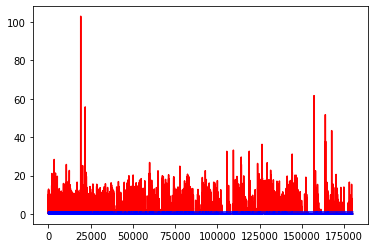

white ratio : 51.25
min : 177
max : 228


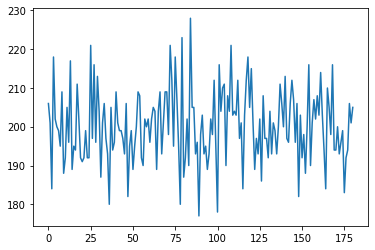

Generating interpolations...
180001 [D loss: 0.001573, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180002 [D loss: 0.000310, acc.: 100.00%] [G loss: 0.000001, 0.000001]
180003 [D loss: 0.000247, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180004 [D loss: 0.000255, acc.: 100.00%] [G loss: 0.000006, 0.000001]
180005 [D loss: 0.000687, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180006 [D loss: 0.000513, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180007 [D loss: 0.001529, acc.: 100.00%] [G loss: 0.000084, 0.000007]
180008 [D loss: 0.000151, acc.: 100.00%] [G loss: 0.000119, 0.002461]
180009 [D loss: 0.000187, acc.: 100.00%] [G loss: 0.000007, 0.000009]
180010 [D loss: 0.000186, acc.: 100.00%] [G loss: 0.000125, 0.000132]
180011 [D loss: 0.006914, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180012 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180013 [D loss: 0.070582, acc.: 96.88%] [G loss: 0.000000, 0.000000]
180014 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000000, 0.

180118 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180119 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.000002, 0.000000]
180120 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000044, 0.000009]
180121 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001522, 0.001539]
180122 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000059]
180123 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000095, 0.000267]
180124 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000013, 0.000005]
180125 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000307, 0.000233]
180126 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.030876, 0.012588]
180127 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000377, 0.003213]
180128 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000517, 0.000009]
180129 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000357, 0.000451]
180130 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000007]
180131 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000018, 0.000000]
180132 [D loss: 0.00

180237 [D loss: 0.000278, acc.: 100.00%] [G loss: 0.000001, 0.000000]
180238 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000009, 0.000023]
180239 [D loss: 0.000165, acc.: 100.00%] [G loss: 0.000760, 0.005820]
180240 [D loss: 0.000169, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180241 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000002, 0.000077]
180242 [D loss: 0.007135, acc.: 100.00%] [G loss: 0.000000, 0.000003]
180243 [D loss: 0.000177, acc.: 100.00%] [G loss: 0.000077, 0.000009]
180244 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180245 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180246 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000004]
180247 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000003, 0.000076]
180248 [D loss: 0.000101, acc.: 100.00%] [G loss: 3.055597, 0.000630]
180249 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000106, 0.000147]
180250 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001303, 0.000104]
180251 [D loss: 0.00

180356 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.005213, 0.005414]
180357 [D loss: 0.000134, acc.: 100.00%] [G loss: 0.000183, 0.001791]
180358 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000003, 0.000000]
180359 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.008004, 0.032254]
180360 [D loss: 0.000176, acc.: 100.00%] [G loss: 0.001843, 0.001674]
180361 [D loss: 0.143981, acc.: 96.88%] [G loss: 0.000000, 0.000000]
180362 [D loss: 0.000973, acc.: 100.00%] [G loss: 0.000000, 0.000001]
180363 [D loss: 0.002644, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180364 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180365 [D loss: 0.024173, acc.: 96.88%] [G loss: 0.000001, 0.000015]
180366 [D loss: 0.000805, acc.: 100.00%] [G loss: 0.000265, 0.000005]
180367 [D loss: 0.000692, acc.: 100.00%] [G loss: 0.000021, 0.000002]
180368 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000067, 0.000116]
180370 [D loss: 0.0000

180476 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.000018, 0.000078]
180477 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000050, 0.000123]
180478 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180479 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.002608, 0.000414]
180480 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000000, 0.000002]
180481 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.009226, 0.003059]
180482 [D loss: 0.001151, acc.: 100.00%] [G loss: 0.000014, 0.000220]
180483 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000964, 0.028640]
180484 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000006, 0.000001]
180485 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.073286, 0.046079]
180486 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000098, 0.000024]
180487 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.064949, 0.018426]
180488 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180489 [D loss: 0.000552, acc.: 100.00%] [G loss: 0.001288, 0.000561]
180490 [D loss: 0.00

180595 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000020, 0.000000]
180596 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180597 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.019316, 0.001492]
180598 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180599 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180600 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000455, 0.000100]
180601 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000009, 0.000003]
180602 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000104, 0.000003]
180603 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000349, 0.000054]
180604 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000768, 0.000427]
180605 [D loss: 0.000304, acc.: 100.00%] [G loss: 0.000182, 0.000122]
180606 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180607 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.000008, 0.000056]
180608 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000068, 0.000350]
180609 [D loss: 0.00

180716 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180717 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000740, 0.004996]
180718 [D loss: 0.000046, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180719 [D loss: 0.002645, acc.: 100.00%] [G loss: 0.000724, 0.000202]
180720 [D loss: 0.001033, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180721 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.000005, 0.000002]
180722 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000001]
180723 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000005, 0.000012]
180724 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000016, 0.000015]
180725 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180726 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000008, 0.000128]
180727 [D loss: 0.000893, acc.: 100.00%] [G loss: 0.000444, 0.000031]
180728 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.001132, 0.003031]
180729 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.000004, 0.000000]
180730 [D loss: 0.00

180836 [D loss: 0.004498, acc.: 100.00%] [G loss: 0.000025, 0.000005]
180837 [D loss: 0.001955, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180838 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180839 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180840 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.003274, 0.000664]
180841 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000002, 0.000018]
180842 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180843 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.001456, 0.000060]
180844 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000001, 0.000000]
180845 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.000008, 0.000002]
180846 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180847 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.000001, 0.000005]
180848 [D loss: 0.000142, acc.: 100.00%] [G loss: 0.000003, 0.000205]
180849 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000003]
180850 [D loss: 0.00

180956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.007800, 0.002033]
180957 [D loss: 0.002277, acc.: 100.00%] [G loss: 0.000027, 0.000014]
180958 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.009284, 0.000825]
180959 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180960 [D loss: 0.002329, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180961 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000078, 0.000082]
180962 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000034, 0.000007]
180963 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.000024, 0.000006]
180964 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180965 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180966 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
180967 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000019]
180968 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000001, 0.000001]
180969 [D loss: 0.000241, acc.: 100.00%] [G loss: 0.000137, 0.001086]
180970 [D loss: 0.00

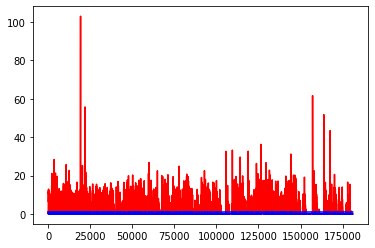

white ratio : 50.0
min : 177
max : 228


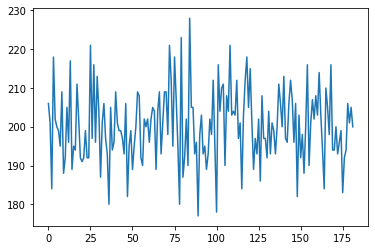

Generating interpolations...
181001 [D loss: 0.000374, acc.: 100.00%] [G loss: 0.011851, 0.006010]
181002 [D loss: 0.001403, acc.: 100.00%] [G loss: 0.000001, 0.000000]
181003 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181004 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000003, 0.000001]
181005 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000051, 0.000027]
181006 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.000064, 0.000599]
181007 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000189, 0.000101]
181008 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.000073, 0.000023]
181009 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181010 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.000000, 0.000003]
181011 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181012 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000413, 0.000193]
181013 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000064, 0.000021]
181014 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000028, 0

181121 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000007, 0.000088]
181122 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181123 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181124 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000079, 0.000430]
181125 [D loss: 0.000967, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181126 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000156, 0.000148]
181127 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181128 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000001, 0.000002]
181129 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000432, 0.000030]
181130 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000001, 0.000000]
181131 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181132 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000035]
181133 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000000, 0.000008]
181134 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181135 [D loss: 0.00

181239 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181240 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181241 [D loss: 0.000292, acc.: 100.00%] [G loss: 0.003936, 0.000233]
181242 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.000027, 0.000013]
181243 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.001131, 0.000320]
181244 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000171, 0.000764]
181245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000072, 0.000145]
181246 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181247 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.000234, 0.000029]
181248 [D loss: 0.002222, acc.: 100.00%] [G loss: 0.000000, 0.000005]
181249 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181250 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000002, 0.000027]
181251 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181252 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000812, 0.000130]
181253 [D loss: 0.00

181359 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000007, 0.000005]
181360 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.000107, 0.000014]
181361 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000019, 0.000039]
181362 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000060, 0.000040]
181363 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000001]
181364 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000288, 0.000027]
181365 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181366 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000007, 0.000002]
181367 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181368 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.007362, 0.014248]
181369 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000009, 0.000005]
181370 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.022514, 0.008543]
181371 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.000323]
181372 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181373 [D loss: 0.00

181479 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000053, 0.000002]
181480 [D loss: 0.000042, acc.: 100.00%] [G loss: 1.404504, 0.866067]
181481 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181482 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000001, 0.000002]
181483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181484 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.002418, 0.005782]
181485 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000024, 0.000030]
181486 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000031, 0.000030]
181487 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.694532, 0.727816]
181488 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.000845, 0.000000]
181489 [D loss: 0.000204, acc.: 100.00%] [G loss: 0.152845, 0.995752]
181490 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000018, 0.000055]
181491 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.000020, 0.000080]
181492 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000000, 0.000003]
181493 [D loss: 0.00

181599 [D loss: 0.000852, acc.: 100.00%] [G loss: 0.018820, 0.012178]
181600 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.000015, 0.000056]
181601 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.247756, 2.744243]
181602 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.002347, 0.006772]
181603 [D loss: 0.001405, acc.: 100.00%] [G loss: 0.000032, 0.000068]
181604 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.000072, 0.005900]
181605 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.000133, 0.000040]
181606 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000217, 0.161163]
181607 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.000002, 0.000328]
181608 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000039, 0.000007]
181609 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000040, 0.005169]
181610 [D loss: 0.032553, acc.: 96.88%] [G loss: 0.439360, 0.145858]
181611 [D loss: 0.001936, acc.: 100.00%] [G loss: 0.000000, 0.000000]
181612 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000003, 0.000000]
181613 [D loss: 0.000

181718 [D loss: 0.000345, acc.: 100.00%] [G loss: 3.745186, 2.908083]
181719 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.765924, 1.643680]
181720 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.421147, 4.225236]
181721 [D loss: 0.006893, acc.: 100.00%] [G loss: 2.237092, 1.437659]
181722 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.164918, 1.206023]
181723 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.155491, 0.373225]
181724 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.399726, 2.351165]
181725 [D loss: 0.000040, acc.: 100.00%] [G loss: 3.990983, 2.341998]
181726 [D loss: 0.000034, acc.: 100.00%] [G loss: 5.881227, 2.715910]
181727 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.579710, 7.597476]
181728 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.042068, 7.947247]
181729 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.650254, 1.742735]
181730 [D loss: 0.024595, acc.: 96.88%] [G loss: 1.057705, 1.013001]
181731 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.189714, 1.073030]
181732 [D loss: 0.000

181836 [D loss: 0.000010, acc.: 100.00%] [G loss: 10.550894, 12.300014]
181837 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.080942, 9.431464]
181838 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.749733, 4.838136]
181839 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.613292, 5.363352]
181840 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.777711, 10.766993]
181841 [D loss: 0.004584, acc.: 100.00%] [G loss: 3.994055, 2.578005]
181842 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.402092, 4.858858]
181843 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.007435, 1.557580]
181844 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.423580, 4.216893]
181845 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.152300, 10.762568]
181846 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.868307, 12.764627]
181847 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.513629, 2.730054]
181848 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.850812, 5.962022]
181849 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.549282, 5.932738]
181850 [D

181955 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.486053, 1.045596]
181956 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.243883, 1.527538]
181957 [D loss: 0.006513, acc.: 100.00%] [G loss: 1.002904, 1.038730]
181958 [D loss: 0.000047, acc.: 100.00%] [G loss: 1.453534, 1.810713]
181959 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.194912, 0.930720]
181960 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.763209, 2.084681]
181961 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.916366, 1.957135]
181962 [D loss: 0.000294, acc.: 100.00%] [G loss: 3.487512, 3.259290]
181963 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.376791, 0.671785]
181964 [D loss: 0.005322, acc.: 100.00%] [G loss: 3.058035, 4.474463]
181965 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.599604, 0.202051]
181966 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.650953, 3.606494]
181967 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.286529, 1.551673]
181968 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.453902, 0.324580]
181969 [D loss: 0.00

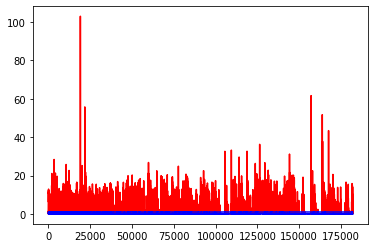

white ratio : 51.25
min : 177
max : 228


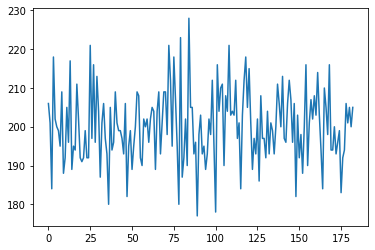

Generating interpolations...
182001 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.851141, 5.447425]
182002 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.425931, 6.644733]
182003 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.997361, 5.043717]
182004 [D loss: 0.000000, acc.: 100.00%] [G loss: 23.233690, 9.598640]
182005 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.579716, 9.026690]
182006 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.451211, 13.969423]
182007 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.691488, 7.898087]
182008 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.659389, 6.654093]
182009 [D loss: 0.000018, acc.: 100.00%] [G loss: 9.117774, 6.941678]
182010 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.086401, 9.995562]
182011 [D loss: 0.000000, acc.: 100.00%] [G loss: 35.183540, 14.488047]
182012 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.072010, 14.358420]
182013 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.230339, 16.806162]
182014 [D loss: 0.000048, acc.: 100.00%] [G loss: 

182117 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.042278, 7.080337]
182118 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.757205, 6.347388]
182119 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.356307, 5.127038]
182120 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.162185, 3.814841]
182121 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.939124, 5.290134]
182122 [D loss: 0.000000, acc.: 100.00%] [G loss: 35.315212, 9.284800]
182123 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.770398, 7.319706]
182124 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.658867, 8.011487]
182125 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.817711, 13.310884]
182126 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.812400, 8.505586]
182127 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.774070, 5.683392]
182128 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.481358, 6.227515]
182129 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.281874, 8.671095]
182130 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.846577, 5.907010]
182131 [D loss: 

182233 [D loss: 0.000004, acc.: 100.00%] [G loss: 14.641881, 11.809088]
182234 [D loss: 0.000002, acc.: 100.00%] [G loss: 12.121666, 13.654095]
182235 [D loss: 0.030528, acc.: 96.88%] [G loss: 15.088119, 14.802122]
182236 [D loss: 0.016289, acc.: 100.00%] [G loss: 13.869963, 11.829956]
182237 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.096010, 15.577271]
182238 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.005638, 16.425991]
182239 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.512802, 16.662399]
182240 [D loss: 0.035229, acc.: 96.88%] [G loss: 40.381233, 8.251949]
182241 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.265420, 10.416455]
182242 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.508228, 9.832152]
182243 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.195718, 9.035933]
182244 [D loss: 0.017535, acc.: 100.00%] [G loss: 30.278938, 6.003060]
182245 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.150894, 11.422598]
182246 [D loss: 0.000130, acc.: 100.00%] [G loss: 11.290565, 12.121434]

182349 [D loss: 0.000000, acc.: 100.00%] [G loss: 20.670631, 18.915516]
182350 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.367310, 18.954487]
182351 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.918354, 17.704178]
182352 [D loss: 0.000007, acc.: 100.00%] [G loss: 20.394741, 18.662403]
182353 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.351957, 17.118811]
182354 [D loss: 0.000000, acc.: 100.00%] [G loss: 19.194380, 18.678413]
182355 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.069233, 11.481588]
182356 [D loss: 0.000003, acc.: 100.00%] [G loss: 13.151793, 11.048003]
182357 [D loss: 0.013520, acc.: 100.00%] [G loss: 12.858517, 11.464930]
182358 [D loss: 0.000005, acc.: 100.00%] [G loss: 16.630056, 11.988042]
182359 [D loss: 0.003444, acc.: 100.00%] [G loss: 13.291964, 16.995119]
182360 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.099010, 9.340359]
182361 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.109501, 9.518562]
182362 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.755146, 8.0161

182465 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.394032, 12.987189]
182466 [D loss: 0.000000, acc.: 100.00%] [G loss: 21.571991, 21.680519]
182467 [D loss: 0.256492, acc.: 96.88%] [G loss: 9.860609, 9.387379]
182468 [D loss: 0.000000, acc.: 100.00%] [G loss: 37.310726, 11.183941]
182469 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.035370, 14.372551]
182470 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.626050, 14.171856]
182471 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.084093, 14.943367]
182472 [D loss: 0.000000, acc.: 100.00%] [G loss: 17.385469, 15.684478]
182473 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.316868, 14.289469]
182474 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.604161, 15.286155]
182475 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.204123, 9.546103]
182476 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.734978, 12.064071]
182477 [D loss: 0.000461, acc.: 100.00%] [G loss: 11.851074, 10.402692]
182478 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.115088, 10.7048

182584 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.573340, 2.457150]
182585 [D loss: 0.003864, acc.: 100.00%] [G loss: 5.124655, 4.856977]
182586 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.469899, 5.473455]
182587 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.173260, 6.226498]
182588 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.144003, 0.829203]
182589 [D loss: 0.085929, acc.: 96.88%] [G loss: 72.258492, 9.849726]
182590 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.345827, 10.782352]
182591 [D loss: 0.000011, acc.: 100.00%] [G loss: 13.672200, 10.244926]
182592 [D loss: 0.000106, acc.: 100.00%] [G loss: 14.538449, 11.852636]
182593 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.851771, 12.599788]
182594 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.677193, 12.938721]
182595 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.025437, 12.800266]
182596 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.220254, 13.845428]
182597 [D loss: 0.000041, acc.: 100.00%] [G loss: 14.028169, 12.710695]
182598

182701 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.563118, 10.313116]
182702 [D loss: 0.000130, acc.: 100.00%] [G loss: 7.517188, 5.362488]
182703 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.813400, 4.978223]
182704 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.625708, 4.366975]
182705 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.676006, 7.161915]
182706 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.553612, 4.326973]
182707 [D loss: 0.012960, acc.: 100.00%] [G loss: 10.429125, 9.900236]
182708 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.415607, 5.535698]
182709 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.157949, 9.397188]
182710 [D loss: 0.001636, acc.: 100.00%] [G loss: 8.555071, 9.436262]
182711 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.643366, 2.379262]
182712 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.747271, 9.425305]
182713 [D loss: 0.000005, acc.: 100.00%] [G loss: 37.052582, 3.847691]
182714 [D loss: 0.000021, acc.: 100.00%] [G loss: 20.528929, 10.035092]
182715 [D lo

182819 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.829212, 5.354723]
182820 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.583164, 2.871640]
182821 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.987540, 1.557666]
182822 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.442523, 12.705155]
182823 [D loss: 0.000207, acc.: 100.00%] [G loss: 3.742931, 5.556744]
182824 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.678480, 5.463803]
182825 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.200495, 4.144629]
182826 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.719472, 4.942043]
182827 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.766920, 3.218314]
182828 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.672117, 3.141084]
182829 [D loss: 0.000015, acc.: 100.00%] [G loss: 33.434887, 1.864564]
182830 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.442744, 4.742863]
182831 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.144954, 5.143913]
182832 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.500402, 3.541521]
182833 [D loss: 0

182939 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.670191, 2.526847]
182940 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.970015, 3.796917]
182941 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.906931, 7.079154]
182942 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.149150, 7.369459]
182943 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.312798, 10.724305]
182944 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.528225, 2.927308]
182945 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.058234, 2.782071]
182946 [D loss: 0.000017, acc.: 100.00%] [G loss: 5.763401, 3.791285]
182947 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.799671, 9.776687]
182948 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.348263, 4.363624]
182949 [D loss: 0.000022, acc.: 100.00%] [G loss: 5.631222, 4.851393]
182950 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.573777, 1.025184]
182951 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.231507, 5.388668]
182952 [D loss: 0.000186, acc.: 100.00%] [G loss: 5.457236, 3.298357]
182953 [D loss: 

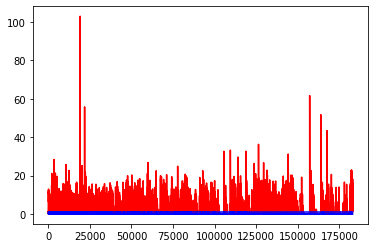

white ratio : 47.5
min : 177
max : 228


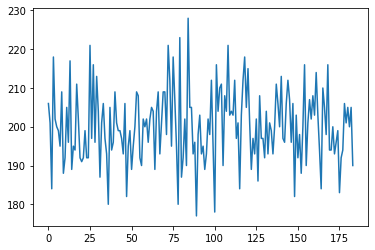

Generating interpolations...
183001 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.271952, 9.236981]
183002 [D loss: 0.000013, acc.: 100.00%] [G loss: 6.606862, 5.853185]
183003 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.697796, 7.480446]
183004 [D loss: 0.004987, acc.: 100.00%] [G loss: 8.522211, 7.473127]
183005 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.708677, 7.816895]
183006 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.199621, 2.754577]
183007 [D loss: 0.000000, acc.: 100.00%] [G loss: 18.991425, 7.812426]
183008 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.057782, 3.546293]
183009 [D loss: 0.000009, acc.: 100.00%] [G loss: 3.516132, 4.301559]
183010 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.361445, 6.096248]
183011 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.349411, 8.208144]
183012 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.563148, 9.852909]
183013 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.930103, 10.144659]
183014 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.408833

183117 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.992125, 1.921076]
183118 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.526405, 3.565589]
183119 [D loss: 0.000765, acc.: 100.00%] [G loss: 4.649188, 4.075305]
183120 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.565998, 4.450736]
183121 [D loss: 0.000000, acc.: 100.00%] [G loss: 36.759701, 8.153797]
183122 [D loss: 0.000007, acc.: 100.00%] [G loss: 14.965061, 13.509578]
183123 [D loss: 0.000001, acc.: 100.00%] [G loss: 12.865272, 10.599545]
183124 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.104946, 10.671602]
183125 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.830253, 8.938370]
183126 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.619809, 10.026875]
183127 [D loss: 0.000049, acc.: 100.00%] [G loss: 4.706881, 4.317298]
183128 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.576564, 1.764009]
183129 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.698507, 8.873400]
183130 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.007424, 3.577394]
183131 [D 

183236 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.801888, 7.506974]
183237 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.644646, 7.659369]
183238 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.604804, 1.568849]
183239 [D loss: 0.000146, acc.: 100.00%] [G loss: 8.489391, 6.876194]
183240 [D loss: 0.000048, acc.: 100.00%] [G loss: 1.856719, 1.228984]
183241 [D loss: 0.000055, acc.: 100.00%] [G loss: 2.241722, 3.173463]
183242 [D loss: 0.003745, acc.: 100.00%] [G loss: 19.918709, 11.009583]
183243 [D loss: 0.000010, acc.: 100.00%] [G loss: 5.969831, 7.481627]
183244 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.103958, 7.164259]
183245 [D loss: 0.000013, acc.: 100.00%] [G loss: 2.808815, 2.129731]
183246 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.788877, 7.075363]
183247 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.853046, 3.832198]
183248 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.859329, 6.066597]
183249 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.011765, 15.251884]
183250 [D loss

183354 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.680993, 5.018252]
183355 [D loss: 0.000053, acc.: 100.00%] [G loss: 4.593688, 3.115628]
183356 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.318145, 5.590164]
183357 [D loss: 0.000030, acc.: 100.00%] [G loss: 4.930947, 4.730792]
183358 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.486877, 2.332098]
183359 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.153988, 7.878860]
183360 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.414895, 6.270197]
183361 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.600779, 3.053823]
183362 [D loss: 0.000130, acc.: 100.00%] [G loss: 4.762504, 4.612020]
183363 [D loss: 0.000002, acc.: 100.00%] [G loss: 10.977158, 4.175470]
183364 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.972621, 5.831347]
183365 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.104880, 6.009652]
183366 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.673449, 7.428747]
183367 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.566065, 9.772668]
183368 [D loss: 0.0

183472 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.201759, 2.573025]
183473 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.442610, 6.120340]
183474 [D loss: 0.000045, acc.: 100.00%] [G loss: 7.580796, 7.407344]
183475 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.830953, 4.433530]
183476 [D loss: 0.000046, acc.: 100.00%] [G loss: 10.582849, 7.594495]
183477 [D loss: 0.000006, acc.: 100.00%] [G loss: 17.232229, 7.393087]
183478 [D loss: 0.000195, acc.: 100.00%] [G loss: 6.448415, 7.151850]
183479 [D loss: 0.000007, acc.: 100.00%] [G loss: 3.071446, 3.258565]
183480 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.278017, 2.837279]
183481 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.488058, 2.546619]
183482 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.852586, 3.783852]
183483 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.178833, 13.296225]
183484 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.371115, 4.726029]
183485 [D loss: 0.000050, acc.: 100.00%] [G loss: 8.338856, 6.644843]
183486 [D loss:

183591 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.205436, 2.358420]
183592 [D loss: 0.000003, acc.: 100.00%] [G loss: 37.020325, 3.301471]
183593 [D loss: 0.000000, acc.: 100.00%] [G loss: 22.969934, 5.229321]
183594 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.658864, 7.065373]
183595 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.659195, 14.905840]
183596 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.387187, 2.583600]
183597 [D loss: 0.000014, acc.: 100.00%] [G loss: 9.529202, 8.999064]
183598 [D loss: 0.000095, acc.: 100.00%] [G loss: 6.012424, 5.322488]
183599 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.796621, 0.547295]
183600 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.164166, 2.489301]
183601 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.244283, 1.921734]
183602 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.553695, 0.907808]
183603 [D loss: 0.000061, acc.: 100.00%] [G loss: 1.448106, 0.761834]
183604 [D loss: 0.000024, acc.: 100.00%] [G loss: 10.032873, 1.806237]
183605 [D loss:

183710 [D loss: 0.005781, acc.: 100.00%] [G loss: 2.326364, 0.737051]
183711 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.452557, 4.685003]
183712 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.482033, 4.768168]
183713 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.185859, 6.909643]
183714 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.278460, 4.407436]
183715 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.565954, 1.962202]
183716 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.328241, 2.240274]
183717 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.712507, 1.776329]
183718 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.912815, 4.412364]
183719 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.055514, 3.691898]
183720 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.147805, 3.038487]
183721 [D loss: 0.000016, acc.: 100.00%] [G loss: 9.690119, 10.137560]
183722 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.667589, 1.715448]
183723 [D loss: 0.000017, acc.: 100.00%] [G loss: 10.871790, 1.848574]
183724 [D loss: 0

183829 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.554812, 4.495978]
183830 [D loss: 0.000012, acc.: 100.00%] [G loss: 7.485319, 7.701815]
183831 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.292693, 5.126395]
183832 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.268726, 4.366136]
183833 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.734165, 6.026394]
183834 [D loss: 0.000003, acc.: 100.00%] [G loss: 15.184040, 8.675993]
183835 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.681753, 1.750418]
183836 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.135788, 4.501738]
183837 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.198681, 7.167907]
183838 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.599828, 12.381489]
183839 [D loss: 0.000046, acc.: 100.00%] [G loss: 4.118351, 4.073498]
183840 [D loss: 0.000001, acc.: 100.00%] [G loss: 23.037397, 11.038633]
183841 [D loss: 0.000019, acc.: 100.00%] [G loss: 10.622830, 10.121868]
183842 [D loss: 0.000683, acc.: 100.00%] [G loss: 9.559005, 7.895401]
183843 [D lo

183946 [D loss: 0.000028, acc.: 100.00%] [G loss: 7.397187, 14.581222]
183947 [D loss: 0.000003, acc.: 100.00%] [G loss: 13.165712, 12.447130]
183948 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.496975, 12.885941]
183949 [D loss: 0.000000, acc.: 100.00%] [G loss: 12.034347, 12.051172]
183950 [D loss: 0.000003, acc.: 100.00%] [G loss: 11.034837, 10.571005]
183951 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.156853, 6.432859]
183952 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.319069, 4.487967]
183953 [D loss: 0.000000, acc.: 100.00%] [G loss: 42.716373, 11.937988]
183954 [D loss: 0.029640, acc.: 96.88%] [G loss: 11.499204, 11.105675]
183955 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.958442, 9.985769]
183956 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.437830, 6.999129]
183957 [D loss: 0.000082, acc.: 100.00%] [G loss: 7.753324, 6.646501]
183958 [D loss: 0.000037, acc.: 100.00%] [G loss: 8.024575, 6.593674]
183959 [D loss: 0.000569, acc.: 100.00%] [G loss: 6.154054, 6.031877]
183960 [

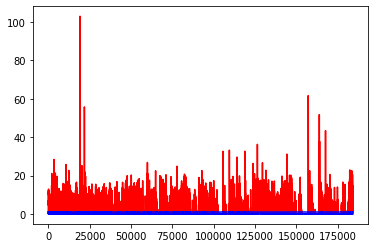

white ratio : 48.75
min : 177
max : 228


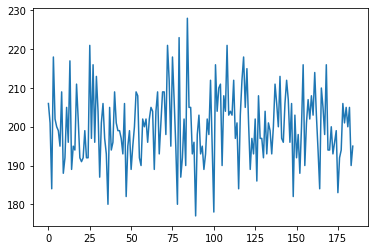

Generating interpolations...
184001 [D loss: 0.000071, acc.: 100.00%] [G loss: 8.147387, 7.591833]
184002 [D loss: 0.000916, acc.: 100.00%] [G loss: 10.211411, 9.674526]
184003 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.507207, 12.639751]
184004 [D loss: 0.000003, acc.: 100.00%] [G loss: 12.040451, 12.175100]
184005 [D loss: 0.000008, acc.: 100.00%] [G loss: 11.910126, 9.278288]
184006 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.201950, 8.262054]
184007 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.557535, 10.470234]
184008 [D loss: 0.000000, acc.: 100.00%] [G loss: 30.459688, 10.603349]
184009 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.209186, 11.952349]
184010 [D loss: 0.000023, acc.: 100.00%] [G loss: 15.279448, 14.289082]
184011 [D loss: 0.000024, acc.: 100.00%] [G loss: 11.935154, 11.202055]
184012 [D loss: 0.003952, acc.: 100.00%] [G loss: 12.005035, 11.868037]
184013 [D loss: 0.000095, acc.: 100.00%] [G loss: 10.993946, 11.119269]
184014 [D loss: 0.000061, acc.: 100.00%] 

184119 [D loss: 0.000093, acc.: 100.00%] [G loss: 2.609735, 2.844407]
184120 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.779535, 4.562092]
184121 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.023110, 6.246336]
184122 [D loss: 0.000019, acc.: 100.00%] [G loss: 6.525325, 6.564014]
184123 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.511657, 2.047208]
184124 [D loss: 0.000022, acc.: 100.00%] [G loss: 8.410255, 3.424109]
184125 [D loss: 0.000005, acc.: 100.00%] [G loss: 16.113014, 5.070584]
184126 [D loss: 0.000502, acc.: 100.00%] [G loss: 10.534805, 11.347580]
184127 [D loss: 0.000329, acc.: 100.00%] [G loss: 4.441822, 3.757086]
184128 [D loss: 0.000010, acc.: 100.00%] [G loss: 8.323690, 8.222121]
184129 [D loss: 0.000036, acc.: 100.00%] [G loss: 3.757349, 4.394757]
184130 [D loss: 0.000021, acc.: 100.00%] [G loss: 7.233761, 6.721022]
184131 [D loss: 0.000055, acc.: 100.00%] [G loss: 5.653153, 5.486066]
184132 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.855692, 2.959980]
184133 [D loss: 0

184236 [D loss: 0.000023, acc.: 100.00%] [G loss: 8.998487, 7.350580]
184237 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.919298, 6.944566]
184238 [D loss: 0.003776, acc.: 100.00%] [G loss: 5.239013, 6.331731]
184239 [D loss: 0.000220, acc.: 100.00%] [G loss: 27.824471, 7.436799]
184240 [D loss: 0.000824, acc.: 100.00%] [G loss: 7.374499, 8.875031]
184241 [D loss: 0.000038, acc.: 100.00%] [G loss: 5.115716, 4.496222]
184242 [D loss: 0.000636, acc.: 100.00%] [G loss: 5.649114, 5.132348]
184243 [D loss: 0.012196, acc.: 100.00%] [G loss: 5.287482, 4.003640]
184244 [D loss: 0.046259, acc.: 96.88%] [G loss: 7.087148, 5.009425]
184245 [D loss: 0.000085, acc.: 100.00%] [G loss: 4.071510, 3.680385]
184246 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.053735, 4.563615]
184247 [D loss: 0.000115, acc.: 100.00%] [G loss: 2.402173, 0.796663]
184248 [D loss: 0.000275, acc.: 100.00%] [G loss: 4.344332, 3.849115]
184249 [D loss: 0.000124, acc.: 100.00%] [G loss: 4.857032, 4.955402]
184250 [D loss: 0.00

184355 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.710471, 0.407382]
184356 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.138089, 0.026802]
184357 [D loss: 0.000007, acc.: 100.00%] [G loss: 60.941925, 1.730377]
184358 [D loss: 0.032050, acc.: 96.88%] [G loss: 4.724044, 4.998762]
184359 [D loss: 0.026331, acc.: 100.00%] [G loss: 0.417042, 0.540017]
184360 [D loss: 0.000007, acc.: 100.00%] [G loss: 7.573791, 7.189005]
184361 [D loss: 0.000022, acc.: 100.00%] [G loss: 5.282902, 5.034650]
184362 [D loss: 0.000670, acc.: 100.00%] [G loss: 9.113655, 7.604719]
184363 [D loss: 0.000031, acc.: 100.00%] [G loss: 5.841082, 5.710090]
184364 [D loss: 0.005993, acc.: 100.00%] [G loss: 5.749658, 4.747937]
184365 [D loss: 0.000285, acc.: 100.00%] [G loss: 7.049363, 6.970203]
184366 [D loss: 0.000086, acc.: 100.00%] [G loss: 3.680437, 3.308688]
184367 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.698161, 0.322878]
184368 [D loss: 0.004060, acc.: 100.00%] [G loss: 5.994903, 4.467465]
184369 [D loss: 0.00

184474 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.180675, 0.863573]
184475 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.716692, 0.702876]
184476 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.458002, 1.585401]
184477 [D loss: 0.001781, acc.: 100.00%] [G loss: 0.665116, 1.401891]
184478 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.010255, 0.001819]
184479 [D loss: 0.000056, acc.: 100.00%] [G loss: 7.021813, 1.660820]
184480 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.476214, 1.700436]
184481 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.014137, 0.012580]
184482 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.001007, 0.001844]
184483 [D loss: 0.000032, acc.: 100.00%] [G loss: 1.232881, 1.042538]
184484 [D loss: 0.121152, acc.: 96.88%] [G loss: 0.008450, 0.016602]
184485 [D loss: 0.064214, acc.: 96.88%] [G loss: 0.399453, 0.199543]
184486 [D loss: 0.002476, acc.: 100.00%] [G loss: 0.080485, 0.023143]
184487 [D loss: 0.001643, acc.: 100.00%] [G loss: 0.042853, 0.461885]
184488 [D loss: 0.0000

184592 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.291549, 0.228925]
184593 [D loss: 0.000154, acc.: 100.00%] [G loss: 1.422152, 0.943988]
184594 [D loss: 0.040534, acc.: 96.88%] [G loss: 11.930489, 4.794858]
184595 [D loss: 0.000132, acc.: 100.00%] [G loss: 7.343699, 5.672030]
184596 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.469293, 1.224036]
184597 [D loss: 0.016339, acc.: 100.00%] [G loss: 7.906794, 7.171098]
184598 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.891280, 9.740647]
184599 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.019273, 0.761887]
184600 [D loss: 0.000228, acc.: 100.00%] [G loss: 10.083112, 8.096042]
184601 [D loss: 0.000896, acc.: 100.00%] [G loss: 8.929176, 5.702979]
184602 [D loss: 0.035765, acc.: 96.88%] [G loss: 4.694273, 4.470993]
184603 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.737830, 0.851331]
184604 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.222247, 3.217544]
184605 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.413453, 0.178919]
184606 [D loss: 0.00

184710 [D loss: 0.000731, acc.: 100.00%] [G loss: 0.849559, 1.384434]
184711 [D loss: 0.000004, acc.: 100.00%] [G loss: 1.927559, 1.819766]
184712 [D loss: 0.000253, acc.: 100.00%] [G loss: 2.118724, 2.134676]
184713 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.258087, 2.534029]
184714 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.942085, 1.180542]
184715 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.025169, 0.891564]
184716 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.327230, 1.098033]
184717 [D loss: 0.000102, acc.: 100.00%] [G loss: 0.168039, 0.749764]
184718 [D loss: 0.000065, acc.: 100.00%] [G loss: 0.795970, 0.769996]
184719 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.916153, 1.409036]
184720 [D loss: 0.007278, acc.: 100.00%] [G loss: 0.225634, 0.838800]
184721 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.655927, 0.258546]
184722 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.778344, 0.002100]
184723 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.011407, 0.043714]
184724 [D loss: 0.00

184829 [D loss: 0.001463, acc.: 100.00%] [G loss: 2.243142, 1.316847]
184830 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.289678, 0.846815]
184831 [D loss: 0.000078, acc.: 100.00%] [G loss: 1.525834, 1.328643]
184832 [D loss: 0.000173, acc.: 100.00%] [G loss: 0.027656, 0.010185]
184833 [D loss: 0.000968, acc.: 100.00%] [G loss: 0.490295, 0.618816]
184834 [D loss: 0.000209, acc.: 100.00%] [G loss: 1.378783, 0.949742]
184835 [D loss: 0.005867, acc.: 100.00%] [G loss: 3.363253, 2.878426]
184836 [D loss: 0.000004, acc.: 100.00%] [G loss: 30.304066, 4.106860]
184837 [D loss: 0.000110, acc.: 100.00%] [G loss: 0.223249, 0.181073]
184838 [D loss: 0.000170, acc.: 100.00%] [G loss: 0.023462, 0.187008]
184839 [D loss: 0.000087, acc.: 100.00%] [G loss: 6.525758, 3.675824]
184840 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.272496, 1.438733]
184841 [D loss: 0.000424, acc.: 100.00%] [G loss: 2.291093, 2.389639]
184842 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.204769, 0.094361]
184843 [D loss: 0.0

184949 [D loss: 0.001770, acc.: 100.00%] [G loss: 14.157660, 1.900640]
184950 [D loss: 0.000069, acc.: 100.00%] [G loss: 3.352586, 3.245751]
184951 [D loss: 0.009398, acc.: 100.00%] [G loss: 1.375641, 1.564846]
184952 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.014855, 0.137742]
184953 [D loss: 0.000134, acc.: 100.00%] [G loss: 2.384279, 2.002614]
184954 [D loss: 0.005758, acc.: 100.00%] [G loss: 1.883050, 1.449751]
184955 [D loss: 0.003829, acc.: 100.00%] [G loss: 0.448478, 0.632763]
184956 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.513143, 1.644143]
184957 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.432701, 1.331923]
184958 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.275212, 0.430723]
184959 [D loss: 0.000990, acc.: 100.00%] [G loss: 1.729202, 1.402397]
184960 [D loss: 0.008202, acc.: 100.00%] [G loss: 1.332312, 1.742698]
184961 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.092056, 0.229503]
184962 [D loss: 0.001080, acc.: 100.00%] [G loss: 0.528587, 0.056558]
184963 [D loss: 0.0

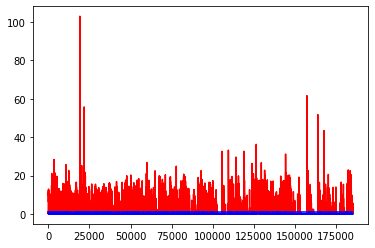

white ratio : 50.25
min : 177
max : 228


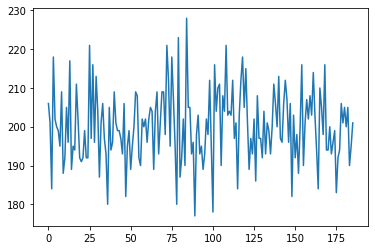

Generating interpolations...
185001 [D loss: 0.000174, acc.: 100.00%] [G loss: 0.237705, 0.042471]
185002 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.620273, 0.350210]
185003 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.086475, 0.232409]
185004 [D loss: 0.010899, acc.: 100.00%] [G loss: 0.000155, 0.149928]
185005 [D loss: 0.005318, acc.: 100.00%] [G loss: 0.000016, 0.000040]
185006 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.033270, 0.010581]
185007 [D loss: 0.000229, acc.: 100.00%] [G loss: 0.103981, 0.020211]
185008 [D loss: 0.001344, acc.: 100.00%] [G loss: 0.000071, 0.042386]
185009 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.059800, 0.645065]
185010 [D loss: 0.000232, acc.: 100.00%] [G loss: 0.014886, 0.091272]
185011 [D loss: 0.000927, acc.: 100.00%] [G loss: 0.039684, 0.007354]
185012 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.123020, 0.137266]
185013 [D loss: 0.000017, acc.: 100.00%] [G loss: 1.329839, 0.731271]
185014 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.857904, 0

185117 [D loss: 0.000505, acc.: 100.00%] [G loss: 1.119048, 1.680797]
185118 [D loss: 0.065460, acc.: 96.88%] [G loss: 1.766538, 1.800095]
185119 [D loss: 0.000328, acc.: 100.00%] [G loss: 0.610330, 0.556701]
185120 [D loss: 0.000216, acc.: 100.00%] [G loss: 0.689723, 0.838844]
185121 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.519167, 0.128508]
185122 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.101494, 0.558444]
185123 [D loss: 0.000753, acc.: 100.00%] [G loss: 0.489399, 0.273876]
185124 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.027151, 0.123219]
185125 [D loss: 0.000217, acc.: 100.00%] [G loss: 0.203068, 0.256359]
185126 [D loss: 0.000731, acc.: 100.00%] [G loss: 0.137151, 0.311490]
185127 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.384747, 0.164397]
185128 [D loss: 0.001550, acc.: 100.00%] [G loss: 0.815210, 0.355113]
185129 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.780420, 0.894599]
185130 [D loss: 0.000211, acc.: 100.00%] [G loss: 0.538458, 0.255442]
185131 [D loss: 0.000

185238 [D loss: 0.059956, acc.: 96.88%] [G loss: 3.900676, 3.563075]
185239 [D loss: 0.000325, acc.: 100.00%] [G loss: 3.733677, 4.156839]
185240 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.607572, 6.735136]
185241 [D loss: 0.001972, acc.: 100.00%] [G loss: 14.897585, 3.064476]
185242 [D loss: 0.003124, acc.: 100.00%] [G loss: 3.736747, 5.034641]
185243 [D loss: 0.001005, acc.: 100.00%] [G loss: 11.701035, 5.007954]
185244 [D loss: 0.000020, acc.: 100.00%] [G loss: 3.879405, 5.477680]
185245 [D loss: 0.000500, acc.: 100.00%] [G loss: 5.776593, 4.656734]
185246 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.624736, 4.617416]
185247 [D loss: 0.000081, acc.: 100.00%] [G loss: 6.594182, 6.924674]
185248 [D loss: 0.000792, acc.: 100.00%] [G loss: 5.166276, 3.309810]
185249 [D loss: 0.012639, acc.: 100.00%] [G loss: 1.628109, 1.110942]
185250 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.927725, 0.523200]
185251 [D loss: 0.001685, acc.: 100.00%] [G loss: 1.896794, 1.591077]
185252 [D loss: 0.0

185358 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.168408, 0.035698]
185359 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.346399, 0.545917]
185360 [D loss: 0.082809, acc.: 96.88%] [G loss: 1.471642, 1.083924]
185361 [D loss: 0.031845, acc.: 96.88%] [G loss: 3.311736, 2.850704]
185362 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.668831, 0.566657]
185363 [D loss: 0.003716, acc.: 100.00%] [G loss: 2.048569, 2.677649]
185364 [D loss: 0.001739, acc.: 100.00%] [G loss: 1.383326, 2.067507]
185365 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.124553, 3.106694]
185366 [D loss: 0.003467, acc.: 100.00%] [G loss: 1.535442, 0.721359]
185367 [D loss: 0.003656, acc.: 100.00%] [G loss: 19.934898, 8.009577]
185368 [D loss: 0.000223, acc.: 100.00%] [G loss: 5.357160, 4.945265]
185369 [D loss: 0.000013, acc.: 100.00%] [G loss: 5.146606, 5.092072]
185370 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.537826, 1.738071]
185371 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.134283, 1.299350]
185372 [D loss: 0.000

185476 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.597399, 2.116024]
185477 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.390769, 1.764204]
185478 [D loss: 0.000015, acc.: 100.00%] [G loss: 2.109478, 2.424849]
185479 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.335500, 0.473998]
185480 [D loss: 0.000800, acc.: 100.00%] [G loss: 0.896081, 0.403925]
185481 [D loss: 0.000067, acc.: 100.00%] [G loss: 1.700503, 1.949391]
185482 [D loss: 0.000012, acc.: 100.00%] [G loss: 1.755134, 0.645427]
185483 [D loss: 0.000024, acc.: 100.00%] [G loss: 1.220579, 0.831955]
185484 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.839623, 1.211195]
185485 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.265095, 0.089423]
185486 [D loss: 0.076218, acc.: 96.88%] [G loss: 0.342532, 0.280448]
185487 [D loss: 0.002311, acc.: 100.00%] [G loss: 0.362379, 0.313199]
185488 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.013347, 0.005504]
185489 [D loss: 0.001086, acc.: 100.00%] [G loss: 0.080312, 0.080145]
185490 [D loss: 0.000

185597 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.098313, 3.223756]
185598 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.801818, 1.481783]
185599 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.881473, 0.570435]
185600 [D loss: 0.000895, acc.: 100.00%] [G loss: 1.004297, 0.626159]
185601 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.624186, 2.351653]
185602 [D loss: 0.000026, acc.: 100.00%] [G loss: 3.680209, 2.997800]
185603 [D loss: 0.000277, acc.: 100.00%] [G loss: 2.880756, 3.067695]
185604 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.463922, 5.069859]
185605 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.934738, 4.020246]
185606 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.276323, 1.259707]
185607 [D loss: 0.000008, acc.: 100.00%] [G loss: 2.850680, 2.640077]
185608 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.081813, 2.130319]
185609 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.388680, 0.160306]
185610 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.106303, 0.074511]
185611 [D loss: 0.00

185714 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000598, 0.001208]
185715 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.074829, 0.006586]
185716 [D loss: 0.010702, acc.: 100.00%] [G loss: 0.021809, 0.143349]
185717 [D loss: 0.000168, acc.: 100.00%] [G loss: 0.071762, 0.157691]
185718 [D loss: 0.000675, acc.: 100.00%] [G loss: 0.123806, 0.157985]
185719 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.799840, 0.050830]
185720 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.576794, 0.035912]
185721 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.164479, 0.067134]
185722 [D loss: 0.000077, acc.: 100.00%] [G loss: 0.559609, 0.745850]
185723 [D loss: 0.000596, acc.: 100.00%] [G loss: 0.923201, 1.114883]
185724 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.044868, 0.195066]
185725 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.308321, 0.368957]
185726 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.625664, 0.401380]
185727 [D loss: 0.000121, acc.: 100.00%] [G loss: 0.609820, 0.581282]
185728 [D loss: 0.00

185833 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.081950, 0.639157]
185834 [D loss: 0.000002, acc.: 100.00%] [G loss: 172.148102, 2.493103]
185835 [D loss: 0.005192, acc.: 100.00%] [G loss: 1.655616, 2.906298]
185836 [D loss: 0.000028, acc.: 100.00%] [G loss: 11.643894, 10.105643]
185837 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.941500, 5.216418]
185838 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.132964, 4.999034]
185839 [D loss: 0.000028, acc.: 100.00%] [G loss: 10.540440, 9.415655]
185840 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.307417, 3.635304]
185841 [D loss: 0.000023, acc.: 100.00%] [G loss: 1.944457, 1.627693]
185842 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.032422, 0.032595]
185843 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.792138, 2.444725]
185844 [D loss: 0.000692, acc.: 100.00%] [G loss: 0.013776, 0.090587]
185845 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.675504, 2.300929]
185846 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.383997, 0.157512]
185847 [D loss:

185953 [D loss: 0.185015, acc.: 93.75%] [G loss: 0.000333, 0.002239]
185954 [D loss: 0.013429, acc.: 100.00%] [G loss: 0.002054, 0.009041]
185955 [D loss: 0.007088, acc.: 100.00%] [G loss: 0.018613, 0.041952]
185956 [D loss: 0.000701, acc.: 100.00%] [G loss: 0.000185, 0.007901]
185957 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.054741, 0.187536]
185958 [D loss: 0.003671, acc.: 100.00%] [G loss: 0.001964, 0.000832]
185959 [D loss: 0.000365, acc.: 100.00%] [G loss: 0.001309, 0.001160]
185960 [D loss: 0.002161, acc.: 100.00%] [G loss: 0.188006, 0.056174]
185961 [D loss: 0.002224, acc.: 100.00%] [G loss: 0.000491, 0.005296]
185962 [D loss: 0.000025, acc.: 100.00%] [G loss: 0.000281, 0.000891]
185963 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.004093, 0.001391]
185964 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.016187, 0.075671]
185965 [D loss: 0.001060, acc.: 100.00%] [G loss: 0.047549, 0.020799]
185966 [D loss: 0.000258, acc.: 100.00%] [G loss: 17.154461, 0.063108]
185967 [D loss: 0.00

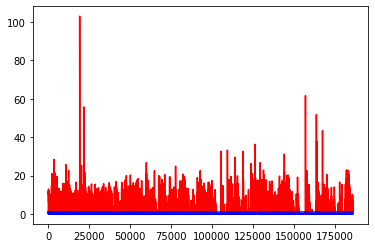

white ratio : 51.25
min : 177
max : 228


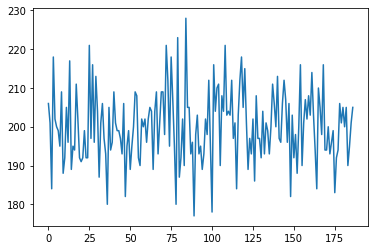

Generating interpolations...
186001 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.434134, 0.499403]
186002 [D loss: 0.000156, acc.: 100.00%] [G loss: 1.435124, 1.583853]
186003 [D loss: 0.001232, acc.: 100.00%] [G loss: 0.005483, 0.010549]
186004 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.180015, 0.076943]
186005 [D loss: 0.010213, acc.: 100.00%] [G loss: 11.772525, 0.454812]
186006 [D loss: 0.003609, acc.: 100.00%] [G loss: 0.271855, 0.078200]
186007 [D loss: 0.002389, acc.: 100.00%] [G loss: 0.533136, 0.236598]
186008 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.981293, 1.082644]
186009 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.135952, 0.129460]
186010 [D loss: 0.001349, acc.: 100.00%] [G loss: 0.023585, 0.033095]
186011 [D loss: 0.000052, acc.: 100.00%] [G loss: 1.322670, 1.727120]
186012 [D loss: 0.057280, acc.: 96.88%] [G loss: 0.288080, 0.280895]
186013 [D loss: 0.001675, acc.: 100.00%] [G loss: 0.325732, 0.145901]
186014 [D loss: 0.000107, acc.: 100.00%] [G loss: 0.358450, 0

186119 [D loss: 0.000924, acc.: 100.00%] [G loss: 0.742906, 0.273114]
186120 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.316143, 0.288897]
186121 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.140937, 1.032376]
186122 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.320520, 0.392907]
186123 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.897267, 0.686468]
186124 [D loss: 0.002392, acc.: 100.00%] [G loss: 0.015728, 0.005834]
186125 [D loss: 0.000058, acc.: 100.00%] [G loss: 1.461552, 0.609917]
186126 [D loss: 0.034403, acc.: 96.88%] [G loss: 0.139758, 0.322872]
186127 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.563125, 0.357620]
186128 [D loss: 0.000135, acc.: 100.00%] [G loss: 0.402365, 0.151994]
186129 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.001148, 0.001684]
186130 [D loss: 0.000284, acc.: 100.00%] [G loss: 0.111498, 0.085641]
186131 [D loss: 0.000116, acc.: 100.00%] [G loss: 0.003739, 0.092592]
186132 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.066837, 0.056043]
186133 [D loss: 0.007

186239 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.367478, 0.196301]
186240 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.132099, 0.399656]
186241 [D loss: 0.001248, acc.: 100.00%] [G loss: 0.082000, 0.033942]
186242 [D loss: 0.001284, acc.: 100.00%] [G loss: 0.001116, 0.000441]
186243 [D loss: 0.034136, acc.: 96.88%] [G loss: 0.063976, 0.080217]
186244 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.437057, 0.005696]
186245 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.132271, 0.002579]
186246 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.430625, 0.451587]
186247 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.007076, 0.011302]
186248 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.007536, 0.000947]
186249 [D loss: 0.011639, acc.: 100.00%] [G loss: 0.002715, 0.000492]
186250 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.016444, 0.008377]
186251 [D loss: 0.006642, acc.: 100.00%] [G loss: 0.001317, 0.036496]
186252 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.000228, 0.000039]
186253 [D loss: 0.000

186357 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000051, 0.000014]
186358 [D loss: 0.017986, acc.: 100.00%] [G loss: 0.004955, 0.049422]
186359 [D loss: 0.006026, acc.: 100.00%] [G loss: 0.161737, 0.012808]
186360 [D loss: 0.155980, acc.: 96.88%] [G loss: 0.000014, 0.000000]
186361 [D loss: 0.013998, acc.: 100.00%] [G loss: 0.001775, 0.000184]
186362 [D loss: 0.000280, acc.: 100.00%] [G loss: 0.000153, 0.000056]
186363 [D loss: 0.011969, acc.: 100.00%] [G loss: 0.000000, 0.000000]
186364 [D loss: 0.001031, acc.: 100.00%] [G loss: 0.001050, 0.003003]
186365 [D loss: 0.000294, acc.: 100.00%] [G loss: 0.031525, 0.010448]
186366 [D loss: 0.000431, acc.: 100.00%] [G loss: 0.000144, 0.000848]
186367 [D loss: 0.000196, acc.: 100.00%] [G loss: 0.002292, 0.010712]
186368 [D loss: 0.000709, acc.: 100.00%] [G loss: 0.000149, 0.001882]
186369 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.000017, 0.000057]
186370 [D loss: 0.000172, acc.: 100.00%] [G loss: 0.000007, 0.000024]
186371 [D loss: 0.000

186477 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.011648, 0.000515]
186478 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000076, 0.000358]
186479 [D loss: 0.000545, acc.: 100.00%] [G loss: 0.000003, 0.000231]
186480 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.001338, 0.019432]
186481 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.000100, 0.000002]
186482 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.001366, 0.028567]
186483 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000626, 0.002404]
186484 [D loss: 0.001386, acc.: 100.00%] [G loss: 0.034640, 0.028852]
186485 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.000509, 0.013409]
186486 [D loss: 0.003060, acc.: 100.00%] [G loss: 0.000004, 0.000012]
186487 [D loss: 0.000280, acc.: 100.00%] [G loss: 0.000713, 0.000087]
186488 [D loss: 0.007063, acc.: 100.00%] [G loss: 0.178062, 0.040305]
186489 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000364, 0.001179]
186490 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.031796, 0.001446]
186491 [D loss: 0.01

186597 [D loss: 0.183021, acc.: 96.88%] [G loss: 0.000020, 0.000012]
186598 [D loss: 0.025210, acc.: 96.88%] [G loss: 0.049886, 0.000526]
186599 [D loss: 0.004882, acc.: 100.00%] [G loss: 0.232177, 0.126694]
186600 [D loss: 0.001077, acc.: 100.00%] [G loss: 0.006215, 0.066870]
186601 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000086, 0.000527]
186602 [D loss: 0.001441, acc.: 100.00%] [G loss: 0.035172, 0.050024]
186603 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000008, 0.000009]
186604 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.000061, 0.000932]
186605 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.010612, 0.022517]
186606 [D loss: 0.000246, acc.: 100.00%] [G loss: 0.000706, 0.011526]
186607 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000030, 0.000092]
186608 [D loss: 0.000101, acc.: 100.00%] [G loss: 0.007047, 0.005231]
186609 [D loss: 0.000268, acc.: 100.00%] [G loss: 0.017813, 0.010719]
186610 [D loss: 0.000049, acc.: 100.00%] [G loss: 0.098164, 0.049214]
186611 [D loss: 0.0002

186716 [D loss: 0.005654, acc.: 100.00%] [G loss: 0.000018, 0.000033]
186717 [D loss: 0.000108, acc.: 100.00%] [G loss: 0.000594, 0.000661]
186718 [D loss: 0.005450, acc.: 100.00%] [G loss: 0.011881, 0.004260]
186719 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.021386, 0.001171]
186720 [D loss: 0.060912, acc.: 96.88%] [G loss: 0.000000, 0.000001]
186721 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000008, 0.000284]
186722 [D loss: 0.003499, acc.: 100.00%] [G loss: 0.000887, 0.000091]
186723 [D loss: 0.410936, acc.: 96.88%] [G loss: 0.000468, 0.000092]
186724 [D loss: 0.008284, acc.: 100.00%] [G loss: 0.000274, 0.000003]
186725 [D loss: 0.011134, acc.: 100.00%] [G loss: 0.021853, 0.011292]
186726 [D loss: 0.004374, acc.: 100.00%] [G loss: 0.010012, 0.009715]
186727 [D loss: 0.000816, acc.: 100.00%] [G loss: 0.023980, 0.016868]
186728 [D loss: 0.000649, acc.: 100.00%] [G loss: 0.003759, 0.023532]
186729 [D loss: 0.001425, acc.: 100.00%] [G loss: 0.000000, 0.000000]
186730 [D loss: 0.0428

186836 [D loss: 0.001671, acc.: 100.00%] [G loss: 0.023804, 0.008001]
186837 [D loss: 0.000648, acc.: 100.00%] [G loss: 0.073315, 0.081086]
186838 [D loss: 0.000106, acc.: 100.00%] [G loss: 0.025240, 0.017115]
186839 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.171730, 0.238442]
186840 [D loss: 0.057595, acc.: 96.88%] [G loss: 0.000000, 0.000000]
186841 [D loss: 0.029539, acc.: 96.88%] [G loss: 0.036677, 0.000432]
186842 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000628, 0.000183]
186843 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.000113, 0.000071]
186844 [D loss: 0.000055, acc.: 100.00%] [G loss: 0.282152, 0.257333]
186845 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.006867, 0.003710]
186846 [D loss: 0.000336, acc.: 100.00%] [G loss: 0.007285, 0.001221]
186847 [D loss: 0.016660, acc.: 100.00%] [G loss: 0.140106, 0.021909]
186848 [D loss: 0.001972, acc.: 100.00%] [G loss: 0.151972, 0.061167]
186849 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.037770, 0.017823]
186850 [D loss: 0.0000

186954 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.389307, 0.276675]
186955 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.082066, 0.002120]
186956 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.002010, 0.000691]
186957 [D loss: 0.005861, acc.: 100.00%] [G loss: 0.000068, 0.000009]
186958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.007478, 0.036333]
186959 [D loss: 0.000025, acc.: 100.00%] [G loss: 14.034077, 0.547353]
186960 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001372, 0.002998]
186961 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.452766, 4.744446]
186962 [D loss: 0.007577, acc.: 100.00%] [G loss: 0.592007, 0.371646]
186963 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.282596, 1.518397]
186964 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000601, 0.017025]
186965 [D loss: 0.000622, acc.: 100.00%] [G loss: 0.667700, 0.314203]
186966 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.004326, 0.008396]
186967 [D loss: 0.000334, acc.: 100.00%] [G loss: 0.541344, 0.559644]
186968 [D loss: 0.0

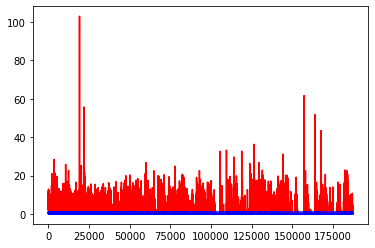

white ratio : 53.75
min : 177
max : 228


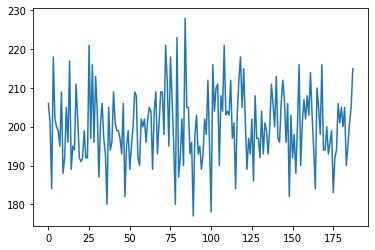

Generating interpolations...
187001 [D loss: 0.002460, acc.: 100.00%] [G loss: 0.000011, 0.000116]
187002 [D loss: 0.000113, acc.: 100.00%] [G loss: 0.000502, 0.001034]
187003 [D loss: 0.000353, acc.: 100.00%] [G loss: 0.002472, 0.008685]
187004 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.002239, 0.004399]
187005 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.000002, 0.000001]
187006 [D loss: 0.976226, acc.: 96.88%] [G loss: 0.000001, 0.000046]
187007 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.040955, 0.014043]
187008 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.209383, 0.113306]
187009 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.227117, 0.182773]
187010 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.487920, 0.147441]
187011 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.039026, 0.081244]
187012 [D loss: 0.003472, acc.: 100.00%] [G loss: 0.004489, 0.011098]
187013 [D loss: 0.001173, acc.: 100.00%] [G loss: 0.810079, 0.935427]
187014 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.010362, 0.

187118 [D loss: 0.327144, acc.: 93.75%] [G loss: 0.445673, 0.121171]
187119 [D loss: 0.000026, acc.: 100.00%] [G loss: 6.511660, 0.097726]
187120 [D loss: 0.000424, acc.: 100.00%] [G loss: 0.063826, 0.107513]
187121 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.001311, 0.004176]
187122 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.445436, 0.292668]
187123 [D loss: 0.000983, acc.: 100.00%] [G loss: 0.194429, 0.000002]
187124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.032610, 0.183658]
187125 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000082, 0.000061]
187126 [D loss: 0.000277, acc.: 100.00%] [G loss: 1.128017, 0.731960]
187127 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000010, 0.000005]
187128 [D loss: 0.000272, acc.: 100.00%] [G loss: 0.060390, 0.001374]
187129 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.001765, 0.002366]
187130 [D loss: 0.000851, acc.: 100.00%] [G loss: 0.039145, 0.107709]
187131 [D loss: 0.000785, acc.: 100.00%] [G loss: 0.001581, 0.001312]
187132 [D loss: 0.005

187239 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000009, 0.000223]
187240 [D loss: 0.000251, acc.: 100.00%] [G loss: 0.206631, 0.097499]
187241 [D loss: 0.011933, acc.: 100.00%] [G loss: 0.149672, 0.137751]
187242 [D loss: 0.000089, acc.: 100.00%] [G loss: 0.013008, 0.064064]
187243 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.726949, 0.268666]
187244 [D loss: 0.003223, acc.: 100.00%] [G loss: 0.000601, 0.000032]
187245 [D loss: 0.001424, acc.: 100.00%] [G loss: 0.105494, 0.236385]
187246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.088797, 0.060735]
187247 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.733832, 0.539221]
187248 [D loss: 0.001355, acc.: 100.00%] [G loss: 0.349672, 0.183403]
187249 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.012977, 0.001166]
187250 [D loss: 0.053310, acc.: 96.88%] [G loss: 0.000031, 0.000021]
187251 [D loss: 0.000397, acc.: 100.00%] [G loss: 9.419847, 0.151878]
187252 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.747399, 5.304488]
187253 [D loss: 0.000

187360 [D loss: 0.001191, acc.: 100.00%] [G loss: 0.049070, 0.113697]
187361 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.000108, 0.000012]
187362 [D loss: 0.000057, acc.: 100.00%] [G loss: 21.303440, 1.902540]
187363 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.135956, 9.821705]
187364 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.910095, 9.918434]
187365 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.012541, 8.924301]
187366 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.535252, 7.338133]
187367 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.544046, 1.062232]
187368 [D loss: 0.000014, acc.: 100.00%] [G loss: 7.024040, 5.295547]
187369 [D loss: 0.000062, acc.: 100.00%] [G loss: 0.742384, 1.153578]
187370 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.213501, 3.457570]
187371 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.077372, 3.464344]
187372 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.673800, 2.215731]
187373 [D loss: 0.007526, acc.: 100.00%] [G loss: 7.410514, 6.439492]
187374 [D loss: 0.

187479 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.026398, 0.000225]
187480 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000892, 0.008761]
187481 [D loss: 0.000242, acc.: 100.00%] [G loss: 0.003071, 0.005679]
187482 [D loss: 0.000288, acc.: 100.00%] [G loss: 0.002590, 0.001099]
187483 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.000177, 0.002324]
187484 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.002018, 0.001111]
187485 [D loss: 0.000082, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187486 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.000000, 0.000005]
187487 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000006, 0.000004]
187488 [D loss: 0.008516, acc.: 100.00%] [G loss: 0.000000, 0.000004]
187489 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.007125, 0.002307]
187490 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.002136, 0.002796]
187491 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.333776, 0.012920]
187492 [D loss: 0.002085, acc.: 100.00%] [G loss: 0.000017, 0.000016]
187493 [D loss: 0.00

187599 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000133, 0.000989]
187600 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000011, 0.000001]
187601 [D loss: 0.004245, acc.: 100.00%] [G loss: 0.000006, 0.000030]
187602 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.003604, 0.000121]
187603 [D loss: 0.000764, acc.: 100.00%] [G loss: 0.000000, 0.000002]
187604 [D loss: 0.000306, acc.: 100.00%] [G loss: 0.002298, 0.002374]
187605 [D loss: 0.189111, acc.: 96.88%] [G loss: 0.000139, 0.000088]
187606 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.000646, 0.000466]
187607 [D loss: 0.001436, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187608 [D loss: 0.001051, acc.: 100.00%] [G loss: 0.000205, 0.008414]
187609 [D loss: 0.003469, acc.: 100.00%] [G loss: 0.001246, 0.008148]
187610 [D loss: 0.000421, acc.: 100.00%] [G loss: 0.000702, 0.000083]
187611 [D loss: 0.000127, acc.: 100.00%] [G loss: 0.000006, 0.000118]
187612 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000192, 0.000435]
187613 [D loss: 0.000

187718 [D loss: 0.000433, acc.: 100.00%] [G loss: 0.000030, 0.000003]
187719 [D loss: 0.002787, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187720 [D loss: 0.001529, acc.: 100.00%] [G loss: 0.000005, 0.000001]
187721 [D loss: 0.000722, acc.: 100.00%] [G loss: 0.000323, 0.000177]
187722 [D loss: 0.006232, acc.: 100.00%] [G loss: 0.000000, 0.000003]
187723 [D loss: 0.000212, acc.: 100.00%] [G loss: 0.000029, 0.015921]
187724 [D loss: 0.000053, acc.: 100.00%] [G loss: 0.000198, 0.003480]
187725 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.000706, 0.000096]
187726 [D loss: 0.020799, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187727 [D loss: 0.000069, acc.: 100.00%] [G loss: 0.000966, 0.000565]
187728 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000114, 0.000255]
187729 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000137, 0.000055]
187730 [D loss: 0.023241, acc.: 96.88%] [G loss: 0.000971, 0.000006]
187731 [D loss: 0.006452, acc.: 100.00%] [G loss: 0.000016, 0.000732]
187732 [D loss: 0.000

187837 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.004027, 0.002845]
187838 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000034, 0.000000]
187839 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.001605, 0.000354]
187840 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.023601, 0.027299]
187841 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.000006, 0.000002]
187842 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000001, 0.000001]
187843 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.000036, 0.000064]
187844 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.000000, 0.000003]
187845 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000209, 0.000058]
187846 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000002, 0.000000]
187847 [D loss: 0.000032, acc.: 100.00%] [G loss: 0.000069, 0.000203]
187848 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.022624, 0.017416]
187849 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187850 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
187851 [D loss: 0.00

187956 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000049, 0.000002]
187957 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.050928, 0.039477]
187958 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.000585, 0.012882]
187959 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.062805, 0.066504]
187960 [D loss: 0.000152, acc.: 100.00%] [G loss: 0.124447, 0.000567]
187961 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000659, 0.000352]
187962 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.308416, 0.445182]
187963 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.219327, 0.130073]
187964 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.338304, 0.286198]
187965 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.388589, 0.203121]
187966 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.004231, 0.001907]
187967 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001963, 0.000505]
187968 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.174829, 0.291329]
187969 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.151120, 0.182655]
187970 [D loss: 0.00

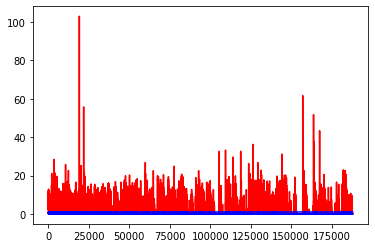

white ratio : 50.75
min : 177
max : 228


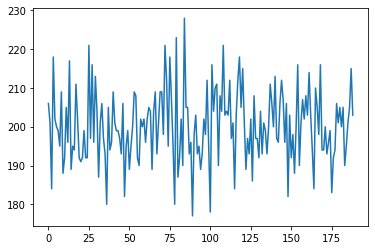

Generating interpolations...
188001 [D loss: 0.000061, acc.: 100.00%] [G loss: 0.033260, 0.003445]
188002 [D loss: 0.000123, acc.: 100.00%] [G loss: 0.000007, 0.000001]
188003 [D loss: 0.001064, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188004 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.002229, 0.001886]
188005 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.000046, 0.000133]
188006 [D loss: 0.002385, acc.: 100.00%] [G loss: 0.001637, 0.028545]
188007 [D loss: 0.000804, acc.: 100.00%] [G loss: 0.189318, 0.000000]
188008 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.027293, 0.005506]
188009 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000134, 0.002344]
188010 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000270, 0.019953]
188011 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.009764, 0.001636]
188012 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.763625, 0.095267]
188013 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.109013, 0.116659]
188014 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.082756, 0

188118 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000002, 0.000000]
188119 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.001548, 0.023193]
188120 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188121 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188122 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000238, 0.000841]
188123 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.003572, 0.000469]
188124 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.013213, 0.000058]
188125 [D loss: 0.000083, acc.: 100.00%] [G loss: 0.000009, 0.000000]
188126 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.066814, 0.000084]
188127 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.000143, 0.000112]
188128 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000003, 0.000001]
188129 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000001]
188130 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000112, 0.000627]
188131 [D loss: 0.000086, acc.: 100.00%] [G loss: 0.009353, 0.000484]
188132 [D loss: 0.00

188238 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000567, 0.000329]
188239 [D loss: 0.000347, acc.: 100.00%] [G loss: 0.000149, 0.000168]
188240 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000048, 0.000003]
188241 [D loss: 0.004138, acc.: 100.00%] [G loss: 0.004495, 0.000125]
188242 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188243 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001024, 0.000318]
188244 [D loss: 0.000060, acc.: 100.00%] [G loss: 0.047620, 0.004662]
188245 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.003867, 0.001372]
188246 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.000198, 0.000472]
188247 [D loss: 0.000040, acc.: 100.00%] [G loss: 0.006400, 0.000758]
188248 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.151059, 0.044479]
188249 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.103022, 0.031353]
188250 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.001634, 0.013554]
188251 [D loss: 0.000048, acc.: 100.00%] [G loss: 0.000000, 0.000003]
188252 [D loss: 0.00

188358 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000018, 0.000002]
188359 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188360 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000025, 0.000036]
188361 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188362 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.010918, 0.028566]
188363 [D loss: 0.000028, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188364 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000035, 0.000008]
188365 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.000092, 0.000000]
188366 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.007411, 0.000021]
188367 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.061909, 0.000000]
188368 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188369 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.015413, 0.056882]
188370 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000040, 0.004395]
188371 [D loss: 0.000175, acc.: 100.00%] [G loss: 0.000016, 0.000006]
188372 [D loss: 0.00

188477 [D loss: 0.000024, acc.: 100.00%] [G loss: 0.000000, 0.000000]
188478 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000558, 0.000038]
188479 [D loss: 0.000112, acc.: 100.00%] [G loss: 0.000013, 0.000457]
188480 [D loss: 0.000016, acc.: 100.00%] [G loss: 0.000008, 0.000000]
188481 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.006504, 0.000229]
188482 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.579722, 0.058091]
188483 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.010586, 0.001085]
188484 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000020, 0.004620]
188485 [D loss: 0.039310, acc.: 96.88%] [G loss: 0.010452, 0.016614]
188486 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.664600, 0.316002]
188487 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.000122, 0.000065]
188488 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.000235, 0.000116]
188489 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.457797, 0.416543]
188490 [D loss: 0.000063, acc.: 100.00%] [G loss: 0.000092, 0.000002]
188491 [D loss: 0.000

188598 [D loss: 0.000693, acc.: 100.00%] [G loss: 0.000011, 0.000819]
188599 [D loss: 0.008193, acc.: 100.00%] [G loss: 0.000001, 0.000000]
188600 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000828, 0.006580]
188601 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000002, 0.000000]
188602 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000004, 0.000566]
188603 [D loss: 0.000041, acc.: 100.00%] [G loss: 0.000091, 0.000057]
188604 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000000, 0.000011]
188605 [D loss: 0.000006, acc.: 100.00%] [G loss: 0.000090, 0.000087]
188606 [D loss: 0.000158, acc.: 100.00%] [G loss: 0.000126, 0.000001]
188607 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000057, 0.002372]
188608 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.003754, 0.000751]
188609 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.000509, 0.000135]
188610 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.027251, 0.277606]
188611 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.000001, 0.000001]
188612 [D loss: 0.00

188716 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.836216, 5.991872]
188717 [D loss: 0.000076, acc.: 100.00%] [G loss: 6.077087, 6.485882]
188718 [D loss: 0.000094, acc.: 100.00%] [G loss: 6.772714, 5.373099]
188719 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.845931, 2.595007]
188720 [D loss: 0.000679, acc.: 100.00%] [G loss: 6.506603, 5.741228]
188721 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.343348, 0.020288]
188722 [D loss: 0.000036, acc.: 100.00%] [G loss: 0.030553, 0.408882]
188723 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.918579, 3.220788]
188724 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.218385, 4.390360]
188725 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.338951, 5.360807]
188726 [D loss: 0.001140, acc.: 100.00%] [G loss: 3.377311, 1.796328]
188727 [D loss: 0.000022, acc.: 100.00%] [G loss: 2.094752, 2.110997]
188728 [D loss: 0.000179, acc.: 100.00%] [G loss: 0.670344, 1.179716]
188729 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.803023, 1.600531]
188730 [D loss: 0.00

188836 [D loss: 0.001210, acc.: 100.00%] [G loss: 12.318450, 12.301816]
188837 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.698250, 9.372162]
188838 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.652160, 9.042860]
188839 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.568735, 8.439218]
188840 [D loss: 0.000013, acc.: 100.00%] [G loss: 8.877007, 8.512386]
188841 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.895492, 7.543662]
188842 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.511698, 5.894043]
188843 [D loss: 0.026851, acc.: 96.88%] [G loss: 5.935168, 5.515478]
188844 [D loss: 0.000082, acc.: 100.00%] [G loss: 1.943351, 0.734846]
188845 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.049937, 2.598562]
188846 [D loss: 0.000142, acc.: 100.00%] [G loss: 4.371640, 2.608180]
188847 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.877057, 4.380530]
188848 [D loss: 0.000020, acc.: 100.00%] [G loss: 1.643867, 1.274627]
188849 [D loss: 0.000049, acc.: 100.00%] [G loss: 5.700761, 4.226505]
188850 [D loss: 0.0

188956 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.066394, 0.615720]
188957 [D loss: 0.000778, acc.: 100.00%] [G loss: 3.319620, 2.007299]
188958 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.241652, 0.360605]
188959 [D loss: 0.000997, acc.: 100.00%] [G loss: 0.029651, 0.077794]
188960 [D loss: 0.000207, acc.: 100.00%] [G loss: 0.017858, 0.192617]
188961 [D loss: 0.000278, acc.: 100.00%] [G loss: 1.096497, 1.104504]
188962 [D loss: 0.001152, acc.: 100.00%] [G loss: 0.088040, 0.048488]
188963 [D loss: 0.000791, acc.: 100.00%] [G loss: 1.577685, 1.260629]
188964 [D loss: 0.000125, acc.: 100.00%] [G loss: 0.076760, 0.154269]
188965 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.035850, 0.008268]
188966 [D loss: 0.006612, acc.: 100.00%] [G loss: 0.000163, 0.000404]
188967 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.626362, 0.383585]
188968 [D loss: 0.000030, acc.: 100.00%] [G loss: 0.014073, 0.302230]
188969 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.841043, 0.732389]
188970 [D loss: 0.00

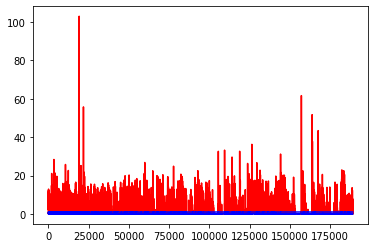

white ratio : 47.75
min : 177
max : 228


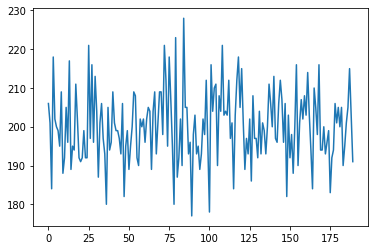

Generating interpolations...
189001 [D loss: 0.010461, acc.: 100.00%] [G loss: 0.038292, 0.015375]
189002 [D loss: 0.000128, acc.: 100.00%] [G loss: 0.201942, 0.017730]
189003 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.188948, 0.179344]
189004 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.376712, 0.694695]
189005 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.185113, 1.237019]
189006 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.035482, 0.156154]
189007 [D loss: 0.000018, acc.: 100.00%] [G loss: 1.030732, 1.004987]
189008 [D loss: 0.000439, acc.: 100.00%] [G loss: 0.175320, 0.211698]
189009 [D loss: 0.002916, acc.: 100.00%] [G loss: 0.179919, 0.054070]
189010 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.001774, 0.006411]
189011 [D loss: 0.000261, acc.: 100.00%] [G loss: 0.105122, 0.036824]
189012 [D loss: 0.005034, acc.: 100.00%] [G loss: 20.010868, 0.016365]
189013 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.096059, 0.194581]
189014 [D loss: 0.000047, acc.: 100.00%] [G loss: 1.681694, 

189120 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.117047, 0.311328]
189121 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.989341, 0.797572]
189122 [D loss: 0.000045, acc.: 100.00%] [G loss: 0.241070, 0.245772]
189123 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.319521, 0.223274]
189124 [D loss: 0.000196, acc.: 100.00%] [G loss: 11.397181, 0.227337]
189125 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.041525, 1.070950]
189126 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.851535, 1.106770]
189127 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.090523, 0.053483]
189128 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.598375, 0.766054]
189129 [D loss: 0.000343, acc.: 100.00%] [G loss: 0.597306, 1.051120]
189130 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.333946, 3.664561]
189131 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.393336, 0.787419]
189132 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.053536, 0.059984]
189133 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.232443, 0.803458]
189134 [D loss: 0.0

189239 [D loss: 0.000105, acc.: 100.00%] [G loss: 0.213920, 0.127713]
189240 [D loss: 0.000594, acc.: 100.00%] [G loss: 0.009664, 0.125473]
189241 [D loss: 0.000669, acc.: 100.00%] [G loss: 0.018116, 0.010819]
189242 [D loss: 0.000192, acc.: 100.00%] [G loss: 0.064076, 0.041066]
189243 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.139422, 0.019415]
189244 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.005442, 0.167433]
189245 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.295069, 0.100526]
189246 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.058687, 0.079602]
189247 [D loss: 0.000396, acc.: 100.00%] [G loss: 0.192587, 0.022596]
189248 [D loss: 0.000200, acc.: 100.00%] [G loss: 0.012033, 0.020164]
189249 [D loss: 0.001867, acc.: 100.00%] [G loss: 22.290770, 1.052441]
189250 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.278878, 4.378778]
189251 [D loss: 0.000034, acc.: 100.00%] [G loss: 2.936281, 2.535187]
189252 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.916597, 3.662173]
189253 [D loss: 0.0

189359 [D loss: 0.000311, acc.: 100.00%] [G loss: 0.312042, 0.128832]
189360 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.296691, 1.227868]
189361 [D loss: 0.000011, acc.: 100.00%] [G loss: 1.421969, 1.727921]
189362 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.009513, 0.129159]
189363 [D loss: 0.000014, acc.: 100.00%] [G loss: 0.669600, 0.361221]
189364 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.931531, 2.130657]
189365 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.030284, 0.668679]
189366 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.496831, 0.311136]
189367 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.792818, 2.637533]
189368 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.230285, 0.409552]
189369 [D loss: 0.000029, acc.: 100.00%] [G loss: 2.063643, 1.552390]
189370 [D loss: 0.000033, acc.: 100.00%] [G loss: 0.334785, 0.386293]
189371 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.666978, 0.021007]
189372 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.150065, 0.049384]
189373 [D loss: 0.00

189479 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.473855, 0.255087]
189480 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.435819, 0.108963]
189481 [D loss: 0.071285, acc.: 96.88%] [G loss: 0.055648, 0.648315]
189482 [D loss: 0.000097, acc.: 100.00%] [G loss: 0.135821, 0.001860]
189483 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.455407, 1.412372]
189484 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.033137, 0.148000]
189485 [D loss: 0.000833, acc.: 100.00%] [G loss: 0.007110, 0.117766]
189486 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.217831, 0.120592]
189487 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.154200, 0.103747]
189488 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.021058, 0.001860]
189489 [D loss: 0.000277, acc.: 100.00%] [G loss: 0.017604, 0.138347]
189490 [D loss: 0.000157, acc.: 100.00%] [G loss: 0.002102, 0.000510]
189491 [D loss: 0.008797, acc.: 100.00%] [G loss: 0.006123, 0.243677]
189492 [D loss: 0.000276, acc.: 100.00%] [G loss: 0.043991, 0.016025]
189493 [D loss: 0.000

189596 [D loss: 0.000016, acc.: 100.00%] [G loss: 4.056970, 2.832790]
189597 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.502309, 2.830641]
189598 [D loss: 0.000184, acc.: 100.00%] [G loss: 1.513352, 0.848630]
189599 [D loss: 0.002211, acc.: 100.00%] [G loss: 2.113584, 1.052737]
189600 [D loss: 0.004791, acc.: 100.00%] [G loss: 1.117651, 0.225122]
189601 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.812478, 0.320314]
189602 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.568059, 0.626567]
189603 [D loss: 0.000005, acc.: 100.00%] [G loss: 3.872499, 4.661512]
189604 [D loss: 0.000191, acc.: 100.00%] [G loss: 0.773423, 0.721581]
189605 [D loss: 0.000023, acc.: 100.00%] [G loss: 28.071787, 3.892715]
189606 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.031584, 4.097150]
189607 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.611355, 5.463516]
189608 [D loss: 0.000019, acc.: 100.00%] [G loss: 4.133894, 3.797187]
189609 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.618890, 2.276980]
189610 [D loss: 0.0

189713 [D loss: 0.002406, acc.: 100.00%] [G loss: 0.388793, 0.203710]
189714 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.639154, 0.529317]
189715 [D loss: 0.000723, acc.: 100.00%] [G loss: 1.279265, 0.769678]
189716 [D loss: 0.000230, acc.: 100.00%] [G loss: 0.414668, 0.445331]
189717 [D loss: 0.000432, acc.: 100.00%] [G loss: 0.619213, 0.738235]
189718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.779313, 0.400456]
189719 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.260622, 0.037733]
189720 [D loss: 0.000005, acc.: 100.00%] [G loss: 19.023838, 2.399818]
189721 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.252106, 6.503048]
189722 [D loss: 0.033437, acc.: 96.88%] [G loss: 2.583779, 2.290530]
189723 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.515409, 9.586016]
189724 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.924479, 11.093425]
189725 [D loss: 0.000000, acc.: 100.00%] [G loss: 15.513205, 12.879117]
189726 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.152340, 4.903502]
189727 [D loss:

189830 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.362589, 1.865434]
189831 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.285149, 0.444462]
189832 [D loss: 0.000054, acc.: 100.00%] [G loss: 0.400079, 0.402769]
189833 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.547430, 0.261843]
189834 [D loss: 0.000018, acc.: 100.00%] [G loss: 0.020256, 0.052565]
189835 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.105383, 0.654785]
189836 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.215056, 0.267761]
189837 [D loss: 0.000234, acc.: 100.00%] [G loss: 0.220015, 0.168670]
189838 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.032009, 2.954248]
189839 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.098014, 0.091556]
189840 [D loss: 0.188489, acc.: 96.88%] [G loss: 0.072679, 0.008976]
189841 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.835908, 0.223047]
189842 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.059564, 0.006952]
189843 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.816133, 0.108852]
189844 [D loss: 0.000

189950 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.103099, 0.240695]
189951 [D loss: 0.000005, acc.: 100.00%] [G loss: 4.972607, 4.771956]
189952 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.900570, 2.759049]
189953 [D loss: 0.000151, acc.: 100.00%] [G loss: 2.405735, 2.077804]
189954 [D loss: 0.065421, acc.: 96.88%] [G loss: 5.924381, 4.672247]
189955 [D loss: 0.000007, acc.: 100.00%] [G loss: 12.812855, 11.022738]
189956 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.478439, 7.138973]
189957 [D loss: 0.000249, acc.: 100.00%] [G loss: 12.891863, 11.114712]
189958 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.881395, 5.579730]
189959 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.671207, 8.575800]
189960 [D loss: 0.151321, acc.: 96.88%] [G loss: 7.475273, 7.109612]
189961 [D loss: 0.000027, acc.: 100.00%] [G loss: 5.048908, 5.997514]
189962 [D loss: 0.001190, acc.: 100.00%] [G loss: 4.842194, 3.799780]
189963 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.125947, 4.301191]
189964 [D loss: 0

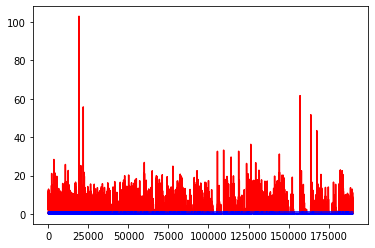

white ratio : 49.0
min : 177
max : 228


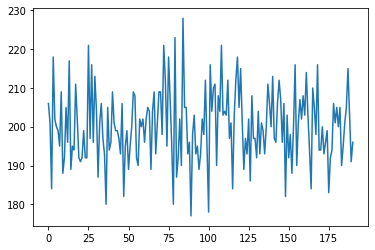

Generating interpolations...
190001 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.105609, 1.957707]
190002 [D loss: 0.000346, acc.: 100.00%] [G loss: 1.736055, 1.678628]
190003 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.972941, 3.797765]
190004 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.241813, 1.547648]
190005 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.399207, 2.580418]
190006 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.911236, 1.166781]
190007 [D loss: 0.000060, acc.: 100.00%] [G loss: 6.860308, 2.777873]
190008 [D loss: 0.000105, acc.: 100.00%] [G loss: 3.929456, 5.178972]
190009 [D loss: 0.000029, acc.: 100.00%] [G loss: 6.436368, 0.518914]
190010 [D loss: 0.003344, acc.: 100.00%] [G loss: 3.663068, 3.093456]
190011 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.041232, 2.244576]
190012 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.336952, 3.115217]
190013 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.704502, 1.272308]
190014 [D loss: 0.016056, acc.: 100.00%] [G loss: 1.040185, 0

190115 [D loss: 0.000001, acc.: 100.00%] [G loss: 17.968510, 10.982163]
190116 [D loss: 0.057255, acc.: 96.88%] [G loss: 10.300811, 10.668718]
190117 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.694761, 10.949468]
190118 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.606236, 12.354254]
190119 [D loss: 0.000003, acc.: 100.00%] [G loss: 3.112847, 1.598260]
190120 [D loss: 0.000110, acc.: 100.00%] [G loss: 3.770994, 2.234867]
190121 [D loss: 0.000075, acc.: 100.00%] [G loss: 6.435402, 8.538146]
190122 [D loss: 0.000046, acc.: 100.00%] [G loss: 4.917867, 5.455524]
190123 [D loss: 0.000001, acc.: 100.00%] [G loss: 23.312172, 7.147518]
190124 [D loss: 0.000008, acc.: 100.00%] [G loss: 6.772300, 7.719459]
190125 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.904538, 8.724618]
190126 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.833982, 10.402051]
190127 [D loss: 0.000102, acc.: 100.00%] [G loss: 4.514355, 5.060047]
190128 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.135665, 8.096495]
190129 [D l

190234 [D loss: 0.000006, acc.: 100.00%] [G loss: 10.699584, 9.024075]
190235 [D loss: 0.001111, acc.: 100.00%] [G loss: 5.765378, 5.745648]
190236 [D loss: 0.000205, acc.: 100.00%] [G loss: 8.261059, 6.325682]
190237 [D loss: 0.000632, acc.: 100.00%] [G loss: 4.660744, 2.533394]
190238 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.401348, 4.059612]
190239 [D loss: 0.000265, acc.: 100.00%] [G loss: 10.157009, 4.662817]
190240 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.262026, 6.429094]
190241 [D loss: 0.000013, acc.: 100.00%] [G loss: 6.422990, 6.145328]
190242 [D loss: 0.001312, acc.: 100.00%] [G loss: 5.435251, 5.088360]
190243 [D loss: 0.000008, acc.: 100.00%] [G loss: 9.461786, 7.489744]
190244 [D loss: 0.000003, acc.: 100.00%] [G loss: 5.753727, 5.208412]
190245 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.548201, 5.076715]
190246 [D loss: 0.004270, acc.: 100.00%] [G loss: 7.599288, 6.553359]
190247 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.923119, 5.829789]
190248 [D loss: 0.

190352 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.928170, 4.367534]
190353 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.805193, 4.170456]
190354 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.012999, 5.761227]
190355 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.131054, 4.890603]
190356 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.076160, 4.511889]
190357 [D loss: 0.000608, acc.: 100.00%] [G loss: 11.595544, 11.648612]
190358 [D loss: 0.000006, acc.: 100.00%] [G loss: 9.916675, 8.689001]
190359 [D loss: 0.000259, acc.: 100.00%] [G loss: 2.439627, 3.318139]
190360 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.558733, 10.000116]
190361 [D loss: 0.000063, acc.: 100.00%] [G loss: 8.740381, 8.487537]
190362 [D loss: 0.000025, acc.: 100.00%] [G loss: 5.001831, 4.615051]
190363 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.473074, 7.008115]
190364 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.996727, 10.191992]
190365 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.585226, 6.853651]
190366 [D loss

190471 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.279846, 7.991320]
190472 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.585777, 4.899149]
190473 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.072002, 8.003790]
190474 [D loss: 0.000272, acc.: 100.00%] [G loss: 3.815308, 3.519948]
190475 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.771548, 2.464058]
190476 [D loss: 0.005872, acc.: 100.00%] [G loss: 0.297769, 0.556007]
190477 [D loss: 0.000871, acc.: 100.00%] [G loss: 7.622176, 1.862407]
190478 [D loss: 0.000092, acc.: 100.00%] [G loss: 9.045084, 4.025152]
190479 [D loss: 0.001480, acc.: 100.00%] [G loss: 4.952488, 5.695430]
190480 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.331815, 1.828305]
190481 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.307840, 2.887256]
190482 [D loss: 0.000858, acc.: 100.00%] [G loss: 6.093284, 5.398565]
190483 [D loss: 0.001121, acc.: 100.00%] [G loss: 3.873678, 2.629906]
190484 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.334654, 3.419199]
190485 [D loss: 0.00

190589 [D loss: 0.000181, acc.: 100.00%] [G loss: 7.903781, 6.337930]
190590 [D loss: 0.000027, acc.: 100.00%] [G loss: 5.957505, 5.554255]
190591 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.631059, 1.286023]
190592 [D loss: 0.000509, acc.: 100.00%] [G loss: 8.294078, 6.228701]
190593 [D loss: 0.000016, acc.: 100.00%] [G loss: 2.624509, 1.096283]
190594 [D loss: 0.000218, acc.: 100.00%] [G loss: 3.736719, 4.566106]
190595 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.766816, 6.290574]
190596 [D loss: 0.001918, acc.: 100.00%] [G loss: 0.868485, 0.956714]
190597 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.065283, 1.056300]
190598 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.063753, 1.589207]
190599 [D loss: 0.000041, acc.: 100.00%] [G loss: 6.886818, 5.516623]
190600 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.881906, 1.785098]
190601 [D loss: 0.000229, acc.: 100.00%] [G loss: 5.874997, 4.946770]
190602 [D loss: 0.003027, acc.: 100.00%] [G loss: 5.911877, 5.700696]
190603 [D loss: 0.00

190708 [D loss: 0.007937, acc.: 100.00%] [G loss: 1.210959, 0.860049]
190709 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.172447, 6.216590]
190710 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.221693, 5.377754]
190711 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.051231, 0.520412]
190712 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.589739, 7.725087]
190713 [D loss: 0.000018, acc.: 100.00%] [G loss: 4.337172, 4.785920]
190714 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.301615, 7.076200]
190715 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.356907, 1.691964]
190716 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.314987, 6.750579]
190717 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.574573, 0.652649]
190718 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.987791, 2.591900]
190719 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.872270, 0.943433]
190720 [D loss: 0.000095, acc.: 100.00%] [G loss: 1.020988, 1.018876]
190721 [D loss: 0.000005, acc.: 100.00%] [G loss: 5.188602, 5.512269]
190722 [D loss: 0.0

190827 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.353294, 1.996451]
190828 [D loss: 0.000110, acc.: 100.00%] [G loss: 1.874876, 1.816540]
190829 [D loss: 0.000191, acc.: 100.00%] [G loss: 9.083611, 6.235800]
190830 [D loss: 0.000086, acc.: 100.00%] [G loss: 10.145548, 8.338136]
190831 [D loss: 0.000315, acc.: 100.00%] [G loss: 1.836352, 1.617256]
190832 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.498055, 11.558231]
190833 [D loss: 0.000134, acc.: 100.00%] [G loss: 11.115772, 9.928631]
190834 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.799304, 5.973163]
190835 [D loss: 0.000049, acc.: 100.00%] [G loss: 7.986646, 5.591802]
190836 [D loss: 0.000090, acc.: 100.00%] [G loss: 8.693005, 6.876880]
190837 [D loss: 0.000164, acc.: 100.00%] [G loss: 9.494786, 8.417305]
190838 [D loss: 0.000034, acc.: 100.00%] [G loss: 13.758665, 4.280481]
190839 [D loss: 0.000111, acc.: 100.00%] [G loss: 2.637145, 1.887909]
190840 [D loss: 0.000136, acc.: 100.00%] [G loss: 10.807907, 9.718214]
190841 [D loss

190945 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.301670, 0.164304]
190946 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.407915, 2.697554]
190947 [D loss: 0.000241, acc.: 100.00%] [G loss: 2.279151, 2.041741]
190948 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.156440, 4.238227]
190949 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.350529, 0.801406]
190950 [D loss: 0.000107, acc.: 100.00%] [G loss: 23.550238, 3.506889]
190951 [D loss: 0.000062, acc.: 100.00%] [G loss: 4.571030, 4.089855]
190952 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.561427, 5.657804]
190953 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.625879, 3.937284]
190954 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.173228, 0.182488]
190955 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.149570, 0.178136]
190956 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.234920, 3.316713]
190957 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.188605, 0.838587]
190958 [D loss: 0.000006, acc.: 100.00%] [G loss: 2.247381, 3.711509]
190959 [D loss: 0.0

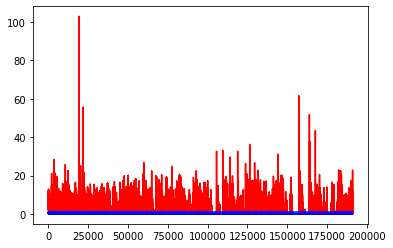

white ratio : 50.0
min : 177
max : 228


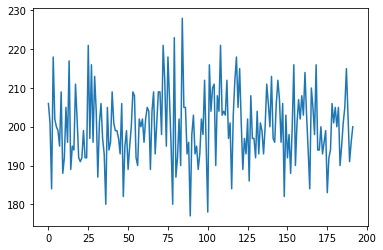

Generating interpolations...
191001 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.362988, 14.332797]
191002 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.023676, 5.771302]
191003 [D loss: 0.002332, acc.: 100.00%] [G loss: 12.037056, 12.667137]
191004 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.990389, 3.643290]
191005 [D loss: 0.000104, acc.: 100.00%] [G loss: 10.466925, 10.615824]
191006 [D loss: 0.000580, acc.: 100.00%] [G loss: 9.797240, 10.373129]
191007 [D loss: 0.000027, acc.: 100.00%] [G loss: 11.219064, 11.523758]
191008 [D loss: 0.000612, acc.: 100.00%] [G loss: 5.456107, 3.731968]
191009 [D loss: 0.000039, acc.: 100.00%] [G loss: 12.997272, 14.198180]
191010 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.448646, 4.135969]
191011 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.192900, 7.934450]
191012 [D loss: 0.001510, acc.: 100.00%] [G loss: 9.873424, 8.595727]
191013 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.383288, 5.718500]
191014 [D loss: 0.000030, acc.: 100.00%] [G loss: 

191119 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.164405, 3.984075]
191120 [D loss: 0.000604, acc.: 100.00%] [G loss: 12.662613, 9.542358]
191121 [D loss: 0.000516, acc.: 100.00%] [G loss: 8.663151, 8.838240]
191122 [D loss: 0.000040, acc.: 100.00%] [G loss: 2.639840, 4.004828]
191123 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.432220, 9.185796]
191124 [D loss: 0.000032, acc.: 100.00%] [G loss: 6.715247, 7.188146]
191125 [D loss: 0.000017, acc.: 100.00%] [G loss: 8.323315, 9.233521]
191126 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.048525, 2.965342]
191127 [D loss: 0.000003, acc.: 100.00%] [G loss: 9.264903, 10.511669]
191128 [D loss: 0.000031, acc.: 100.00%] [G loss: 9.353864, 11.352426]
191129 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.099918, 10.665926]
191130 [D loss: 0.000035, acc.: 100.00%] [G loss: 2.966055, 1.598762]
191131 [D loss: 0.000160, acc.: 100.00%] [G loss: 6.540093, 6.215265]
191132 [D loss: 0.000038, acc.: 100.00%] [G loss: 3.245714, 2.527976]
191133 [D loss:

191239 [D loss: 0.000018, acc.: 100.00%] [G loss: 2.536318, 2.575792]
191240 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.247866, 2.690553]
191241 [D loss: 0.003729, acc.: 100.00%] [G loss: 0.625657, 1.009040]
191242 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.474302, 3.489321]
191243 [D loss: 0.000655, acc.: 100.00%] [G loss: 0.246055, 1.077222]
191244 [D loss: 0.001089, acc.: 100.00%] [G loss: 1.519917, 2.375291]
191245 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.846791, 3.007273]
191246 [D loss: 0.000087, acc.: 100.00%] [G loss: 0.532246, 0.251627]
191247 [D loss: 0.000555, acc.: 100.00%] [G loss: 0.137267, 0.346747]
191248 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.540572, 6.883422]
191249 [D loss: 0.000037, acc.: 100.00%] [G loss: 2.204172, 1.397520]
191250 [D loss: 0.004383, acc.: 100.00%] [G loss: 7.304100, 8.787793]
191251 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.808716, 1.537081]
191252 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.510249, 7.497678]
191253 [D loss: 0.00

191359 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.462971, 8.531711]
191360 [D loss: 0.003738, acc.: 100.00%] [G loss: 11.757912, 11.681572]
191361 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.604630, 6.279196]
191362 [D loss: 0.000019, acc.: 100.00%] [G loss: 5.337948, 4.816983]
191363 [D loss: 0.002206, acc.: 100.00%] [G loss: 1.282025, 1.340614]
191364 [D loss: 0.000035, acc.: 100.00%] [G loss: 3.827834, 3.622899]
191365 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.464421, 3.210531]
191366 [D loss: 0.000120, acc.: 100.00%] [G loss: 3.279948, 3.096620]
191367 [D loss: 0.000007, acc.: 100.00%] [G loss: 6.773984, 5.212261]
191368 [D loss: 0.000027, acc.: 100.00%] [G loss: 1.384541, 0.541118]
191369 [D loss: 0.002804, acc.: 100.00%] [G loss: 3.688359, 3.025488]
191370 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.316888, 2.457338]
191371 [D loss: 0.000401, acc.: 100.00%] [G loss: 5.799207, 5.406195]
191372 [D loss: 0.000608, acc.: 100.00%] [G loss: 4.186023, 3.509454]
191373 [D loss: 0.

191477 [D loss: 0.000043, acc.: 100.00%] [G loss: 0.934175, 0.465139]
191478 [D loss: 0.000709, acc.: 100.00%] [G loss: 1.390992, 1.848940]
191479 [D loss: 0.002537, acc.: 100.00%] [G loss: 3.147626, 3.149003]
191480 [D loss: 0.007143, acc.: 100.00%] [G loss: 4.522764, 4.824776]
191481 [D loss: 0.000181, acc.: 100.00%] [G loss: 16.023251, 3.716630]
191482 [D loss: 0.000087, acc.: 100.00%] [G loss: 8.823160, 8.315063]
191483 [D loss: 0.002999, acc.: 100.00%] [G loss: 4.282928, 3.186000]
191484 [D loss: 0.004900, acc.: 100.00%] [G loss: 3.095922, 3.096020]
191485 [D loss: 0.000696, acc.: 100.00%] [G loss: 8.868914, 9.404984]
191486 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.361570, 2.609492]
191487 [D loss: 0.000537, acc.: 100.00%] [G loss: 8.021517, 7.104620]
191488 [D loss: 0.000536, acc.: 100.00%] [G loss: 2.807010, 1.635702]
191489 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.504529, 4.623758]
191490 [D loss: 0.000002, acc.: 100.00%] [G loss: 59.605515, 0.757749]
191491 [D loss: 0.

191596 [D loss: 0.000051, acc.: 100.00%] [G loss: 4.787264, 4.416516]
191597 [D loss: 0.000880, acc.: 100.00%] [G loss: 3.954412, 3.700315]
191598 [D loss: 0.000096, acc.: 100.00%] [G loss: 4.847770, 3.555579]
191599 [D loss: 0.002993, acc.: 100.00%] [G loss: 16.414280, 5.879423]
191600 [D loss: 0.035021, acc.: 100.00%] [G loss: 0.837369, 0.890166]
191601 [D loss: 0.000004, acc.: 100.00%] [G loss: 4.496601, 3.050292]
191602 [D loss: 0.000102, acc.: 100.00%] [G loss: 7.688684, 3.433488]
191603 [D loss: 0.000027, acc.: 100.00%] [G loss: 2.190087, 1.952820]
191604 [D loss: 0.000083, acc.: 100.00%] [G loss: 2.839214, 1.525229]
191605 [D loss: 0.000080, acc.: 100.00%] [G loss: 2.541263, 3.060508]
191606 [D loss: 0.000349, acc.: 100.00%] [G loss: 0.675629, 2.592496]
191607 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.472881, 1.880233]
191608 [D loss: 0.000034, acc.: 100.00%] [G loss: 0.672602, 0.966622]
191609 [D loss: 0.004632, acc.: 100.00%] [G loss: 4.126765, 3.756469]
191610 [D loss: 0.0

191716 [D loss: 0.000387, acc.: 100.00%] [G loss: 10.389517, 7.965725]
191717 [D loss: 0.000014, acc.: 100.00%] [G loss: 7.761044, 1.851485]
191718 [D loss: 0.000076, acc.: 100.00%] [G loss: 3.412177, 3.069544]
191719 [D loss: 0.114767, acc.: 96.88%] [G loss: 3.731575, 2.189758]
191720 [D loss: 0.001299, acc.: 100.00%] [G loss: 1.344392, 0.914033]
191721 [D loss: 0.000077, acc.: 100.00%] [G loss: 1.922621, 1.527360]
191722 [D loss: 0.000286, acc.: 100.00%] [G loss: 1.719797, 1.208034]
191723 [D loss: 0.000261, acc.: 100.00%] [G loss: 1.362024, 1.420687]
191724 [D loss: 0.001056, acc.: 100.00%] [G loss: 3.455439, 3.037152]
191725 [D loss: 0.000704, acc.: 100.00%] [G loss: 0.832394, 0.506555]
191726 [D loss: 0.005834, acc.: 100.00%] [G loss: 0.426422, 0.767180]
191727 [D loss: 0.004051, acc.: 100.00%] [G loss: 1.046386, 0.887948]
191728 [D loss: 0.002918, acc.: 100.00%] [G loss: 3.865915, 0.555038]
191729 [D loss: 0.000506, acc.: 100.00%] [G loss: 4.801399, 4.618145]
191730 [D loss: 0.00

191835 [D loss: 0.000021, acc.: 100.00%] [G loss: 0.017565, 0.153711]
191836 [D loss: 0.004282, acc.: 100.00%] [G loss: 3.485576, 3.983318]
191837 [D loss: 0.072123, acc.: 96.88%] [G loss: 0.933920, 0.926672]
191838 [D loss: 0.000631, acc.: 100.00%] [G loss: 0.193156, 0.119000]
191839 [D loss: 0.009254, acc.: 100.00%] [G loss: 0.011671, 0.000713]
191840 [D loss: 0.007917, acc.: 100.00%] [G loss: 0.015199, 0.052064]
191841 [D loss: 0.000140, acc.: 100.00%] [G loss: 0.006937, 0.025503]
191842 [D loss: 0.005460, acc.: 100.00%] [G loss: 1.384168, 1.793323]
191843 [D loss: 0.000360, acc.: 100.00%] [G loss: 0.026915, 0.084298]
191844 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.122088, 0.148527]
191845 [D loss: 0.000136, acc.: 100.00%] [G loss: 0.639015, 1.546334]
191846 [D loss: 0.001764, acc.: 100.00%] [G loss: 2.473747, 1.034802]
191847 [D loss: 0.007280, acc.: 100.00%] [G loss: 4.931680, 3.950234]
191848 [D loss: 0.002835, acc.: 100.00%] [G loss: 5.344749, 0.894910]
191849 [D loss: 0.000

191952 [D loss: 0.019971, acc.: 100.00%] [G loss: 6.301986, 6.978946]
191953 [D loss: 0.000899, acc.: 100.00%] [G loss: 0.945038, 1.108316]
191954 [D loss: 0.000583, acc.: 100.00%] [G loss: 8.554361, 6.502402]
191955 [D loss: 0.000114, acc.: 100.00%] [G loss: 2.258030, 2.750316]
191956 [D loss: 0.005280, acc.: 100.00%] [G loss: 1.272247, 0.317367]
191957 [D loss: 0.000573, acc.: 100.00%] [G loss: 4.154073, 4.378536]
191958 [D loss: 0.000586, acc.: 100.00%] [G loss: 1.760813, 0.401969]
191959 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.232586, 3.594216]
191960 [D loss: 0.000067, acc.: 100.00%] [G loss: 1.304269, 1.373713]
191961 [D loss: 0.000237, acc.: 100.00%] [G loss: 4.450494, 5.536345]
191962 [D loss: 0.000043, acc.: 100.00%] [G loss: 1.125376, 1.297952]
191963 [D loss: 0.000019, acc.: 100.00%] [G loss: 10.433460, 9.602825]
191964 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.341241, 3.515867]
191965 [D loss: 0.000198, acc.: 100.00%] [G loss: 1.844490, 1.335339]
191966 [D loss: 0.0

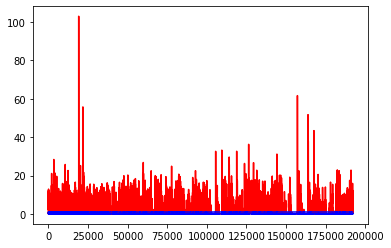

white ratio : 49.25
min : 177
max : 228


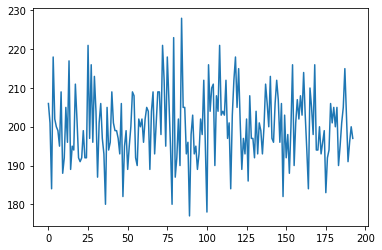

Generating interpolations...
192001 [D loss: 0.000133, acc.: 100.00%] [G loss: 8.948689, 9.313461]
192002 [D loss: 0.008240, acc.: 100.00%] [G loss: 14.353646, 13.723438]
192003 [D loss: 0.000049, acc.: 100.00%] [G loss: 3.539792, 2.175624]
192004 [D loss: 0.007988, acc.: 100.00%] [G loss: 3.410417, 2.748855]
192005 [D loss: 0.000032, acc.: 100.00%] [G loss: 4.857540, 4.391502]
192006 [D loss: 0.002539, acc.: 100.00%] [G loss: 10.132427, 8.726231]
192007 [D loss: 0.000158, acc.: 100.00%] [G loss: 42.932312, 1.631806]
192008 [D loss: 0.005273, acc.: 100.00%] [G loss: 3.401495, 4.076190]
192009 [D loss: 0.002648, acc.: 100.00%] [G loss: 7.359978, 6.993929]
192010 [D loss: 0.000549, acc.: 100.00%] [G loss: 5.635920, 5.368050]
192011 [D loss: 0.031106, acc.: 96.88%] [G loss: 5.192224, 5.752175]
192012 [D loss: 0.008456, acc.: 100.00%] [G loss: 10.224421, 9.877584]
192013 [D loss: 0.000027, acc.: 100.00%] [G loss: 6.776471, 5.545555]
192014 [D loss: 0.000061, acc.: 100.00%] [G loss: 2.81782

192120 [D loss: 0.001083, acc.: 100.00%] [G loss: 0.014195, 0.084747]
192121 [D loss: 0.006049, acc.: 100.00%] [G loss: 8.082369, 7.576669]
192122 [D loss: 0.000012, acc.: 100.00%] [G loss: 4.445226, 3.581484]
192123 [D loss: 0.000041, acc.: 100.00%] [G loss: 5.519353, 8.332407]
192124 [D loss: 0.000101, acc.: 100.00%] [G loss: 3.968078, 6.663525]
192125 [D loss: 0.000392, acc.: 100.00%] [G loss: 5.215412, 4.474573]
192126 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.741500, 0.550525]
192127 [D loss: 0.004220, acc.: 100.00%] [G loss: 17.139040, 4.115303]
192128 [D loss: 0.001344, acc.: 100.00%] [G loss: 20.352722, 11.584454]
192129 [D loss: 0.000278, acc.: 100.00%] [G loss: 12.470564, 12.366790]
192130 [D loss: 0.000067, acc.: 100.00%] [G loss: 9.288908, 10.094886]
192131 [D loss: 0.000037, acc.: 100.00%] [G loss: 13.290905, 11.743916]
192132 [D loss: 0.008637, acc.: 100.00%] [G loss: 4.200022, 3.905079]
192133 [D loss: 0.000115, acc.: 100.00%] [G loss: 19.676308, 10.730181]
192134 [D 

192238 [D loss: 0.000630, acc.: 100.00%] [G loss: 0.850260, 0.633260]
192239 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.631120, 0.579439]
192240 [D loss: 0.000201, acc.: 100.00%] [G loss: 14.057717, 11.741687]
192241 [D loss: 0.000336, acc.: 100.00%] [G loss: 12.379388, 12.718245]
192242 [D loss: 0.000026, acc.: 100.00%] [G loss: 7.806529, 7.137469]
192243 [D loss: 0.000064, acc.: 100.00%] [G loss: 5.144321, 6.904169]
192244 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.209760, 6.214134]
192245 [D loss: 0.034849, acc.: 96.88%] [G loss: 14.612640, 5.034664]
192246 [D loss: 0.000455, acc.: 100.00%] [G loss: 10.372688, 9.103621]
192247 [D loss: 0.000583, acc.: 100.00%] [G loss: 9.565483, 9.899973]
192248 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.035947, 0.584944]
192249 [D loss: 0.002309, acc.: 100.00%] [G loss: 7.259995, 6.322785]
192250 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.870798, 2.383387]
192251 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.964576, 3.044233]
192252 [D loss:

192355 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.525220, 11.233435]
192356 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.685326, 7.634135]
192357 [D loss: 0.000128, acc.: 100.00%] [G loss: 7.842752, 7.169429]
192358 [D loss: 0.070553, acc.: 96.88%] [G loss: 0.240346, 0.651320]
192359 [D loss: 0.000195, acc.: 100.00%] [G loss: 3.460593, 2.305180]
192360 [D loss: 0.000425, acc.: 100.00%] [G loss: 3.633105, 2.055032]
192361 [D loss: 0.004193, acc.: 100.00%] [G loss: 1.682538, 2.327231]
192362 [D loss: 0.049576, acc.: 96.88%] [G loss: 9.061514, 8.267635]
192363 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.001261, 8.897158]
192364 [D loss: 0.003154, acc.: 100.00%] [G loss: 1.290004, 1.341779]
192365 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.489517, 1.328210]
192366 [D loss: 0.000122, acc.: 100.00%] [G loss: 8.344864, 7.044805]
192367 [D loss: 0.005284, acc.: 100.00%] [G loss: 12.517024, 11.770771]
192368 [D loss: 0.000396, acc.: 100.00%] [G loss: 11.789602, 8.644962]
192369 [D loss: 0

192474 [D loss: 0.003958, acc.: 100.00%] [G loss: 5.486637, 4.734083]
192475 [D loss: 0.000944, acc.: 100.00%] [G loss: 4.816117, 4.723538]
192476 [D loss: 0.000374, acc.: 100.00%] [G loss: 5.625453, 4.554195]
192477 [D loss: 0.000315, acc.: 100.00%] [G loss: 5.728491, 5.658898]
192478 [D loss: 0.000447, acc.: 100.00%] [G loss: 14.370592, 8.709749]
192479 [D loss: 0.000240, acc.: 100.00%] [G loss: 11.896416, 10.819726]
192480 [D loss: 0.000007, acc.: 100.00%] [G loss: 8.380604, 7.672134]
192481 [D loss: 0.000704, acc.: 100.00%] [G loss: 10.639919, 7.653326]
192482 [D loss: 0.006937, acc.: 100.00%] [G loss: 10.704405, 9.581049]
192483 [D loss: 0.000155, acc.: 100.00%] [G loss: 8.905471, 8.580095]
192484 [D loss: 0.000280, acc.: 100.00%] [G loss: 2.746073, 2.516740]
192485 [D loss: 0.001650, acc.: 100.00%] [G loss: 6.076023, 2.397664]
192486 [D loss: 0.000247, acc.: 100.00%] [G loss: 6.069743, 5.304810]
192487 [D loss: 0.000332, acc.: 100.00%] [G loss: 4.250144, 2.685423]
192488 [D loss:

192591 [D loss: 0.003212, acc.: 100.00%] [G loss: 6.680215, 5.310723]
192592 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.340403, 9.147211]
192593 [D loss: 0.001496, acc.: 100.00%] [G loss: 6.432457, 7.470958]
192594 [D loss: 0.000940, acc.: 100.00%] [G loss: 7.426128, 7.118789]
192595 [D loss: 0.002279, acc.: 100.00%] [G loss: 6.606916, 6.347104]
192596 [D loss: 0.000117, acc.: 100.00%] [G loss: 18.508215, 8.632944]
192597 [D loss: 0.116713, acc.: 96.88%] [G loss: 4.068380, 3.931990]
192598 [D loss: 0.000125, acc.: 100.00%] [G loss: 9.144853, 8.415917]
192599 [D loss: 0.000385, acc.: 100.00%] [G loss: 9.582185, 5.080680]
192600 [D loss: 0.000313, acc.: 100.00%] [G loss: 9.735550, 8.756889]
192601 [D loss: 0.001527, acc.: 100.00%] [G loss: 5.267797, 5.936697]
192602 [D loss: 0.000668, acc.: 100.00%] [G loss: 9.297710, 7.858245]
192603 [D loss: 0.003614, acc.: 100.00%] [G loss: 5.687315, 5.114924]
192604 [D loss: 0.000933, acc.: 100.00%] [G loss: 6.145752, 7.638892]
192605 [D loss: 0.00

192710 [D loss: 0.000055, acc.: 100.00%] [G loss: 8.707202, 8.560828]
192711 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.495815, 8.726276]
192712 [D loss: 0.000466, acc.: 100.00%] [G loss: 4.724916, 5.124458]
192713 [D loss: 0.000073, acc.: 100.00%] [G loss: 8.730370, 7.953159]
192714 [D loss: 0.013799, acc.: 100.00%] [G loss: 5.898061, 6.436755]
192715 [D loss: 0.000278, acc.: 100.00%] [G loss: 1.815470, 1.942643]
192716 [D loss: 0.000033, acc.: 100.00%] [G loss: 1.445253, 2.333075]
192717 [D loss: 0.005536, acc.: 100.00%] [G loss: 3.613168, 4.746590]
192718 [D loss: 0.000104, acc.: 100.00%] [G loss: 3.479635, 3.231601]
192719 [D loss: 0.021737, acc.: 96.88%] [G loss: 39.353291, 8.696545]
192720 [D loss: 0.001082, acc.: 100.00%] [G loss: 7.385888, 7.561192]
192721 [D loss: 0.000356, acc.: 100.00%] [G loss: 9.860970, 9.179898]
192722 [D loss: 0.000115, acc.: 100.00%] [G loss: 7.486691, 4.451333]
192723 [D loss: 0.000386, acc.: 100.00%] [G loss: 3.032819, 2.591016]
192724 [D loss: 0.03

192829 [D loss: 0.000489, acc.: 100.00%] [G loss: 6.631201, 5.717982]
192830 [D loss: 0.000014, acc.: 100.00%] [G loss: 5.383215, 4.810209]
192831 [D loss: 0.031608, acc.: 96.88%] [G loss: 1.701652, 1.898595]
192832 [D loss: 0.000362, acc.: 100.00%] [G loss: 13.432913, 8.880928]
192833 [D loss: 0.000238, acc.: 100.00%] [G loss: 9.395739, 9.546149]
192834 [D loss: 0.000035, acc.: 100.00%] [G loss: 13.467972, 3.556011]
192835 [D loss: 0.000285, acc.: 100.00%] [G loss: 5.388520, 3.057159]
192836 [D loss: 0.000056, acc.: 100.00%] [G loss: 7.002688, 6.327128]
192837 [D loss: 0.000068, acc.: 100.00%] [G loss: 8.684414, 7.921134]
192838 [D loss: 0.000281, acc.: 100.00%] [G loss: 3.545525, 3.316299]
192839 [D loss: 0.000060, acc.: 100.00%] [G loss: 3.343592, 2.716335]
192840 [D loss: 0.060485, acc.: 96.88%] [G loss: 3.654681, 4.660877]
192841 [D loss: 0.011187, acc.: 100.00%] [G loss: 3.037406, 3.349485]
192842 [D loss: 0.000086, acc.: 100.00%] [G loss: 2.619245, 1.957250]
192843 [D loss: 0.00

192946 [D loss: 0.000021, acc.: 100.00%] [G loss: 5.931988, 5.007770]
192947 [D loss: 0.000119, acc.: 100.00%] [G loss: 1.339013, 1.967089]
192948 [D loss: 0.000246, acc.: 100.00%] [G loss: 8.508598, 8.868416]
192949 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.529660, 2.543992]
192950 [D loss: 0.000079, acc.: 100.00%] [G loss: 10.930219, 11.265104]
192951 [D loss: 0.001102, acc.: 100.00%] [G loss: 4.509606, 3.784042]
192952 [D loss: 0.002626, acc.: 100.00%] [G loss: 7.176097, 6.612022]
192953 [D loss: 0.165083, acc.: 96.88%] [G loss: 4.908323, 3.462016]
192954 [D loss: 0.000440, acc.: 100.00%] [G loss: 4.278549, 4.133623]
192955 [D loss: 0.001371, acc.: 100.00%] [G loss: 9.373743, 3.504668]
192956 [D loss: 0.000953, acc.: 100.00%] [G loss: 3.484969, 4.012584]
192957 [D loss: 0.001018, acc.: 100.00%] [G loss: 3.750543, 4.047456]
192958 [D loss: 0.000221, acc.: 100.00%] [G loss: 3.410003, 1.275393]
192959 [D loss: 0.007747, acc.: 100.00%] [G loss: 8.745605, 3.553310]
192960 [D loss: 0.0

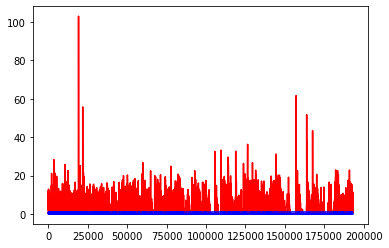

white ratio : 53.5
min : 177
max : 228


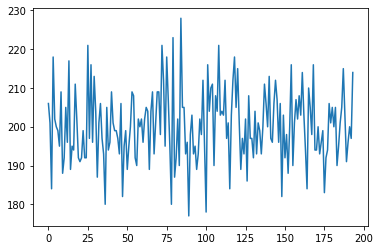

Generating interpolations...
193001 [D loss: 0.000242, acc.: 100.00%] [G loss: 8.627661, 8.123382]
193002 [D loss: 0.001189, acc.: 100.00%] [G loss: 1.707999, 1.510973]
193003 [D loss: 0.002907, acc.: 100.00%] [G loss: 7.603203, 7.224641]
193004 [D loss: 0.001678, acc.: 100.00%] [G loss: 3.894892, 1.840634]
193005 [D loss: 0.001268, acc.: 100.00%] [G loss: 8.759154, 7.463627]
193006 [D loss: 0.000078, acc.: 100.00%] [G loss: 5.369740, 5.907306]
193007 [D loss: 0.001484, acc.: 100.00%] [G loss: 1.864901, 1.363160]
193008 [D loss: 0.005768, acc.: 100.00%] [G loss: 1.036898, 1.183522]
193009 [D loss: 0.000317, acc.: 100.00%] [G loss: 29.885162, 8.579118]
193010 [D loss: 0.000040, acc.: 100.00%] [G loss: 9.317336, 9.082529]
193011 [D loss: 0.000253, acc.: 100.00%] [G loss: 9.801276, 7.577894]
193012 [D loss: 0.000011, acc.: 100.00%] [G loss: 5.867493, 3.972290]
193013 [D loss: 0.174923, acc.: 96.88%] [G loss: 1.026208, 0.581003]
193014 [D loss: 0.000197, acc.: 100.00%] [G loss: 6.717851, 5

193119 [D loss: 0.000050, acc.: 100.00%] [G loss: 10.307372, 7.766151]
193120 [D loss: 0.000537, acc.: 100.00%] [G loss: 3.944137, 2.739145]
193121 [D loss: 0.000037, acc.: 100.00%] [G loss: 20.605059, 11.309748]
193122 [D loss: 0.000347, acc.: 100.00%] [G loss: 9.654164, 8.448613]
193123 [D loss: 0.016251, acc.: 100.00%] [G loss: 10.905756, 10.583420]
193124 [D loss: 0.000148, acc.: 100.00%] [G loss: 13.497763, 5.854172]
193125 [D loss: 0.015720, acc.: 100.00%] [G loss: 10.102710, 10.179646]
193126 [D loss: 0.001754, acc.: 100.00%] [G loss: 10.240393, 8.707064]
193127 [D loss: 0.000053, acc.: 100.00%] [G loss: 10.412498, 11.266550]
193128 [D loss: 0.000068, acc.: 100.00%] [G loss: 8.348192, 7.787672]
193129 [D loss: 0.000899, acc.: 100.00%] [G loss: 2.913066, 4.146755]
193130 [D loss: 0.000150, acc.: 100.00%] [G loss: 7.580597, 7.439811]
193131 [D loss: 0.000010, acc.: 100.00%] [G loss: 3.485538, 3.775125]
193132 [D loss: 0.000010, acc.: 100.00%] [G loss: 19.273159, 4.756764]
193133 [

193238 [D loss: 0.000602, acc.: 100.00%] [G loss: 2.837260, 2.254575]
193239 [D loss: 0.000159, acc.: 100.00%] [G loss: 7.001880, 4.950814]
193240 [D loss: 0.000047, acc.: 100.00%] [G loss: 8.158407, 8.473286]
193241 [D loss: 0.000297, acc.: 100.00%] [G loss: 6.972661, 6.847028]
193242 [D loss: 0.000204, acc.: 100.00%] [G loss: 5.817683, 5.714577]
193243 [D loss: 0.000421, acc.: 100.00%] [G loss: 10.045429, 10.107418]
193244 [D loss: 0.010913, acc.: 100.00%] [G loss: 5.420154, 5.601755]
193245 [D loss: 0.002221, acc.: 100.00%] [G loss: 4.399489, 2.481395]
193246 [D loss: 0.000751, acc.: 100.00%] [G loss: 1.950294, 1.782811]
193247 [D loss: 0.001077, acc.: 100.00%] [G loss: 3.373985, 3.473556]
193248 [D loss: 0.000246, acc.: 100.00%] [G loss: 4.485970, 3.547089]
193249 [D loss: 0.094144, acc.: 96.88%] [G loss: 84.225067, 7.244040]
193250 [D loss: 0.001291, acc.: 100.00%] [G loss: 4.349980, 3.451584]
193251 [D loss: 0.001969, acc.: 100.00%] [G loss: 6.429789, 6.299410]
193252 [D loss: 0.

193357 [D loss: 0.001773, acc.: 100.00%] [G loss: 7.770301, 7.292054]
193358 [D loss: 0.015187, acc.: 100.00%] [G loss: 21.570684, 6.794839]
193359 [D loss: 0.001786, acc.: 100.00%] [G loss: 6.525621, 6.250695]
193360 [D loss: 0.001685, acc.: 100.00%] [G loss: 1.273831, 1.262239]
193361 [D loss: 0.003669, acc.: 100.00%] [G loss: 1.438077, 1.170277]
193362 [D loss: 0.001108, acc.: 100.00%] [G loss: 7.176420, 5.407150]
193363 [D loss: 0.000224, acc.: 100.00%] [G loss: 0.912892, 1.473390]
193364 [D loss: 0.000532, acc.: 100.00%] [G loss: 4.538284, 3.435034]
193365 [D loss: 0.000525, acc.: 100.00%] [G loss: 1.774096, 0.983338]
193366 [D loss: 0.001510, acc.: 100.00%] [G loss: 0.001580, 0.074530]
193367 [D loss: 0.000223, acc.: 100.00%] [G loss: 15.051569, 6.893458]
193368 [D loss: 0.000591, acc.: 100.00%] [G loss: 8.074818, 8.779522]
193369 [D loss: 0.000477, acc.: 100.00%] [G loss: 7.377247, 6.967915]
193370 [D loss: 0.005369, acc.: 100.00%] [G loss: 7.092535, 9.448756]
193371 [D loss: 0.

193476 [D loss: 0.000053, acc.: 100.00%] [G loss: 10.039764, 9.943231]
193477 [D loss: 0.000027, acc.: 100.00%] [G loss: 6.403225, 7.596592]
193478 [D loss: 0.000135, acc.: 100.00%] [G loss: 11.501254, 9.824787]
193479 [D loss: 0.000932, acc.: 100.00%] [G loss: 4.294430, 4.393510]
193480 [D loss: 0.000377, acc.: 100.00%] [G loss: 4.791593, 4.825078]
193481 [D loss: 0.000091, acc.: 100.00%] [G loss: 2.528939, 0.942842]
193482 [D loss: 0.000313, acc.: 100.00%] [G loss: 11.003354, 0.427886]
193483 [D loss: 0.000603, acc.: 100.00%] [G loss: 1.291990, 1.342971]
193484 [D loss: 0.000070, acc.: 100.00%] [G loss: 5.043472, 4.726639]
193485 [D loss: 0.000077, acc.: 100.00%] [G loss: 3.588411, 3.626354]
193486 [D loss: 0.000544, acc.: 100.00%] [G loss: 2.120850, 1.671036]
193487 [D loss: 0.000086, acc.: 100.00%] [G loss: 11.955245, 11.328024]
193488 [D loss: 0.000405, acc.: 100.00%] [G loss: 12.003198, 11.083586]
193489 [D loss: 0.000406, acc.: 100.00%] [G loss: 0.411756, 0.226796]
193490 [D los

193596 [D loss: 0.000760, acc.: 100.00%] [G loss: 1.551154, 1.576853]
193597 [D loss: 0.000959, acc.: 100.00%] [G loss: 7.483280, 8.135395]
193598 [D loss: 0.198364, acc.: 96.88%] [G loss: 6.032832, 4.471598]
193599 [D loss: 0.003082, acc.: 100.00%] [G loss: 1.008572, 1.476996]
193600 [D loss: 0.001289, acc.: 100.00%] [G loss: 7.342635, 7.956079]
193601 [D loss: 0.010926, acc.: 100.00%] [G loss: 1.895592, 1.526527]
193602 [D loss: 0.000782, acc.: 100.00%] [G loss: 2.035918, 1.099851]
193603 [D loss: 0.000553, acc.: 100.00%] [G loss: 6.237446, 4.317875]
193604 [D loss: 0.003409, acc.: 100.00%] [G loss: 38.290390, 7.725072]
193605 [D loss: 0.000198, acc.: 100.00%] [G loss: 10.725704, 10.929937]
193606 [D loss: 0.000078, acc.: 100.00%] [G loss: 0.356614, 0.101760]
193607 [D loss: 0.000074, acc.: 100.00%] [G loss: 0.000216, 0.000039]
193608 [D loss: 0.399935, acc.: 96.88%] [G loss: 0.000004, 0.000132]
193609 [D loss: 0.001021, acc.: 100.00%] [G loss: 5.386109, 5.705668]
193610 [D loss: 0.1

193714 [D loss: 0.000129, acc.: 100.00%] [G loss: 8.996048, 7.143581]
193715 [D loss: 0.002234, acc.: 100.00%] [G loss: 0.023973, 0.010264]
193716 [D loss: 0.000722, acc.: 100.00%] [G loss: 0.000178, 0.000001]
193717 [D loss: 0.000080, acc.: 100.00%] [G loss: 9.117198, 8.378523]
193718 [D loss: 0.000637, acc.: 100.00%] [G loss: 0.010123, 0.043431]
193719 [D loss: 0.037326, acc.: 96.88%] [G loss: 0.000000, 0.000000]
193720 [D loss: 0.008183, acc.: 100.00%] [G loss: 8.394014, 8.867304]
193721 [D loss: 0.000261, acc.: 100.00%] [G loss: 1.227627, 0.893848]
193722 [D loss: 0.000090, acc.: 100.00%] [G loss: 2.066374, 2.818430]
193723 [D loss: 0.000380, acc.: 100.00%] [G loss: 4.230594, 3.513964]
193724 [D loss: 0.001429, acc.: 100.00%] [G loss: 6.821010, 7.221294]
193725 [D loss: 0.008252, acc.: 100.00%] [G loss: 8.931755, 8.235426]
193726 [D loss: 0.000095, acc.: 100.00%] [G loss: 6.461665, 3.523405]
193727 [D loss: 0.000166, acc.: 100.00%] [G loss: 12.293941, 11.994627]
193728 [D loss: 0.0

193833 [D loss: 0.000159, acc.: 100.00%] [G loss: 0.015778, 0.014840]
193834 [D loss: 0.000099, acc.: 100.00%] [G loss: 10.915715, 11.649226]
193835 [D loss: 0.000192, acc.: 100.00%] [G loss: 11.051056, 11.552321]
193836 [D loss: 0.000300, acc.: 100.00%] [G loss: 2.400935, 1.506514]
193837 [D loss: 0.000037, acc.: 100.00%] [G loss: 0.001328, 0.000016]
193838 [D loss: 0.000059, acc.: 100.00%] [G loss: 5.236492, 5.189939]
193839 [D loss: 0.000092, acc.: 100.00%] [G loss: 0.000000, 0.000000]
193840 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000632, 0.000010]
193841 [D loss: 0.000075, acc.: 100.00%] [G loss: 0.000004, 0.000002]
193842 [D loss: 0.000028, acc.: 100.00%] [G loss: 4.993623, 3.038642]
193843 [D loss: 0.000213, acc.: 100.00%] [G loss: 5.189148, 3.359568]
193844 [D loss: 0.000131, acc.: 100.00%] [G loss: 2.378705, 1.840844]
193845 [D loss: 0.000067, acc.: 100.00%] [G loss: 0.260578, 0.000015]
193846 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000281, 0.000010]
193847 [D loss: 

193952 [D loss: 0.000242, acc.: 100.00%] [G loss: 8.595871, 8.866089]
193953 [D loss: 0.000096, acc.: 100.00%] [G loss: 3.473099, 3.396533]
193954 [D loss: 0.000546, acc.: 100.00%] [G loss: 8.522462, 4.108250]
193955 [D loss: 0.000125, acc.: 100.00%] [G loss: 10.955260, 8.712649]
193956 [D loss: 0.000266, acc.: 100.00%] [G loss: 10.876608, 10.361449]
193957 [D loss: 0.000638, acc.: 100.00%] [G loss: 9.027685, 6.534989]
193958 [D loss: 0.001044, acc.: 100.00%] [G loss: 7.698753, 7.957029]
193959 [D loss: 0.000037, acc.: 100.00%] [G loss: 9.586699, 8.959631]
193960 [D loss: 0.000089, acc.: 100.00%] [G loss: 3.519610, 3.034170]
193961 [D loss: 0.000106, acc.: 100.00%] [G loss: 9.854780, 9.881191]
193962 [D loss: 0.000215, acc.: 100.00%] [G loss: 3.706351, 3.452348]
193963 [D loss: 0.000151, acc.: 100.00%] [G loss: 9.134490, 8.925121]
193964 [D loss: 0.009619, acc.: 100.00%] [G loss: 5.077016, 2.282084]
193965 [D loss: 0.027138, acc.: 96.88%] [G loss: 1.472477, 0.871931]
193966 [D loss: 0.

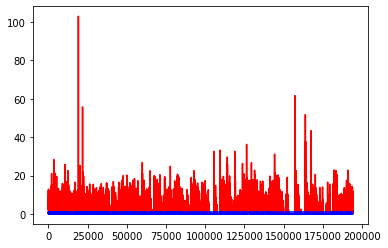

white ratio : 49.0
min : 177
max : 228


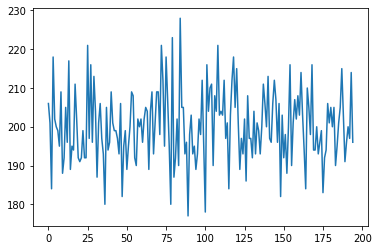

Generating interpolations...
194001 [D loss: 0.000458, acc.: 100.00%] [G loss: 7.013610, 7.213977]
194002 [D loss: 0.000102, acc.: 100.00%] [G loss: 3.237006, 3.212054]
194003 [D loss: 0.000020, acc.: 100.00%] [G loss: 27.191269, 1.544858]
194004 [D loss: 0.000085, acc.: 100.00%] [G loss: 6.746966, 7.444163]
194005 [D loss: 0.000213, acc.: 100.00%] [G loss: 3.524242, 3.446872]
194006 [D loss: 0.000086, acc.: 100.00%] [G loss: 7.085625, 5.376083]
194007 [D loss: 0.000803, acc.: 100.00%] [G loss: 3.064466, 2.602752]
194008 [D loss: 0.000075, acc.: 100.00%] [G loss: 8.245323, 5.908076]
194009 [D loss: 0.000074, acc.: 100.00%] [G loss: 8.808171, 6.606463]
194010 [D loss: 0.000723, acc.: 100.00%] [G loss: 0.003336, 0.000328]
194011 [D loss: 0.000345, acc.: 100.00%] [G loss: 5.290336, 5.559111]
194012 [D loss: 0.000058, acc.: 100.00%] [G loss: 0.000008, 0.000075]
194013 [D loss: 0.000039, acc.: 100.00%] [G loss: 5.032967, 4.119705]
194014 [D loss: 0.000235, acc.: 100.00%] [G loss: 3.045265, 

194119 [D loss: 0.000095, acc.: 100.00%] [G loss: 8.095158, 6.234484]
194120 [D loss: 0.000051, acc.: 100.00%] [G loss: 0.000038, 0.000135]
194121 [D loss: 0.000061, acc.: 100.00%] [G loss: 5.525010, 5.399783]
194122 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000048, 0.000437]
194123 [D loss: 0.000020, acc.: 100.00%] [G loss: 12.973526, 13.705871]
194124 [D loss: 0.000269, acc.: 100.00%] [G loss: 9.442129, 9.330189]
194125 [D loss: 0.000034, acc.: 100.00%] [G loss: 4.616606, 3.670178]
194126 [D loss: 0.003185, acc.: 100.00%] [G loss: 0.021232, 0.000351]
194127 [D loss: 0.000125, acc.: 100.00%] [G loss: 7.626199, 4.652129]
194128 [D loss: 0.000039, acc.: 100.00%] [G loss: 0.000000, 0.000852]
194129 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.240472, 0.594791]
194130 [D loss: 0.001088, acc.: 100.00%] [G loss: 12.359088, 11.832774]
194131 [D loss: 0.000070, acc.: 100.00%] [G loss: 9.274403, 9.120776]
194132 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.000009, 0.000062]
194133 [D loss: 

194238 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.000002, 0.000009]
194239 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.159031, 0.244494]
194240 [D loss: 0.000141, acc.: 100.00%] [G loss: 0.000018, 0.000008]
194241 [D loss: 0.000028, acc.: 100.00%] [G loss: 3.465506, 5.205765]
194242 [D loss: 0.000242, acc.: 100.00%] [G loss: 6.849261, 8.607414]
194243 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.000310, 0.000062]
194244 [D loss: 0.000019, acc.: 100.00%] [G loss: 0.037195, 0.012731]
194245 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.569125, 4.019204]
194246 [D loss: 0.000023, acc.: 100.00%] [G loss: 0.000005, 0.057249]
194247 [D loss: 0.000175, acc.: 100.00%] [G loss: 11.042084, 9.420801]
194248 [D loss: 0.000038, acc.: 100.00%] [G loss: 0.000002, 0.001079]
194249 [D loss: 0.000057, acc.: 100.00%] [G loss: 0.000083, 0.000042]
194250 [D loss: 0.002692, acc.: 100.00%] [G loss: 7.190823, 9.092140]
194251 [D loss: 0.000088, acc.: 100.00%] [G loss: 0.000144, 0.000000]
194252 [D loss: 0.0

194357 [D loss: 0.000025, acc.: 100.00%] [G loss: 17.064507, 17.052074]
194358 [D loss: 0.000065, acc.: 100.00%] [G loss: 19.107811, 17.552523]
194359 [D loss: 0.000133, acc.: 100.00%] [G loss: 0.037336, 0.027718]
194360 [D loss: 0.000015, acc.: 100.00%] [G loss: 1.980581, 1.689448]
194361 [D loss: 0.000088, acc.: 100.00%] [G loss: 17.715252, 18.054573]
194362 [D loss: 0.000517, acc.: 100.00%] [G loss: 19.237446, 17.904963]
194363 [D loss: 0.000014, acc.: 100.00%] [G loss: 16.185802, 15.214368]
194364 [D loss: 0.000011, acc.: 100.00%] [G loss: 19.027382, 18.068287]
194365 [D loss: 0.000032, acc.: 100.00%] [G loss: 17.210850, 17.360538]
194366 [D loss: 0.002762, acc.: 100.00%] [G loss: 16.529863, 17.392807]
194367 [D loss: 0.000086, acc.: 100.00%] [G loss: 1.252938, 0.853600]
194368 [D loss: 0.000197, acc.: 100.00%] [G loss: 0.000119, 0.000805]
194369 [D loss: 0.065498, acc.: 96.88%] [G loss: 14.192642, 13.398231]
194370 [D loss: 0.001056, acc.: 100.00%] [G loss: 0.123655, 0.501025]
194

194473 [D loss: 0.000276, acc.: 100.00%] [G loss: 16.813175, 16.873571]
194474 [D loss: 0.000188, acc.: 100.00%] [G loss: 6.479480, 5.879617]
194475 [D loss: 0.000060, acc.: 100.00%] [G loss: 15.477165, 18.176754]
194476 [D loss: 0.006081, acc.: 100.00%] [G loss: 7.481095, 8.524240]
194477 [D loss: 0.000119, acc.: 100.00%] [G loss: 10.710566, 8.530943]
194478 [D loss: 0.000381, acc.: 100.00%] [G loss: 0.002320, 0.024443]
194479 [D loss: 0.000357, acc.: 100.00%] [G loss: 6.894050, 7.841834]
194480 [D loss: 0.004267, acc.: 100.00%] [G loss: 7.362142, 5.715234]
194481 [D loss: 0.000037, acc.: 100.00%] [G loss: 19.711857, 12.387433]
194482 [D loss: 0.000062, acc.: 100.00%] [G loss: 2.440990, 0.918775]
194483 [D loss: 0.000091, acc.: 100.00%] [G loss: 13.962036, 14.943632]
194484 [D loss: 0.001376, acc.: 100.00%] [G loss: 14.981331, 8.422838]
194485 [D loss: 0.000020, acc.: 100.00%] [G loss: 7.680166, 10.217167]
194486 [D loss: 0.000091, acc.: 100.00%] [G loss: 1.876502, 1.542538]
194487 [D

194591 [D loss: 0.000182, acc.: 100.00%] [G loss: 3.574660, 4.066520]
194592 [D loss: 0.001311, acc.: 100.00%] [G loss: 4.166891, 3.217252]
194593 [D loss: 0.001055, acc.: 100.00%] [G loss: 5.502728, 4.462084]
194594 [D loss: 0.000203, acc.: 100.00%] [G loss: 1.318208, 2.233640]
194595 [D loss: 0.000031, acc.: 100.00%] [G loss: 1.239278, 0.928096]
194596 [D loss: 0.000387, acc.: 100.00%] [G loss: 11.108134, 10.175831]
194597 [D loss: 0.001978, acc.: 100.00%] [G loss: 20.407940, 10.217163]
194598 [D loss: 0.000070, acc.: 100.00%] [G loss: 12.271450, 12.135294]
194599 [D loss: 0.000147, acc.: 100.00%] [G loss: 7.949018, 8.130935]
194600 [D loss: 0.000118, acc.: 100.00%] [G loss: 11.162740, 9.895910]
194601 [D loss: 0.000035, acc.: 100.00%] [G loss: 0.222777, 0.047050]
194602 [D loss: 0.000174, acc.: 100.00%] [G loss: 8.992159, 9.890551]
194603 [D loss: 0.000273, acc.: 100.00%] [G loss: 11.361534, 11.462549]
194604 [D loss: 0.000777, acc.: 100.00%] [G loss: 6.821507, 9.166759]
194605 [D l

194710 [D loss: 0.000149, acc.: 100.00%] [G loss: 1.546135, 1.435863]
194711 [D loss: 0.000160, acc.: 100.00%] [G loss: 7.104035, 5.168694]
194712 [D loss: 0.000092, acc.: 100.00%] [G loss: 8.755560, 6.971624]
194713 [D loss: 0.000074, acc.: 100.00%] [G loss: 8.110046, 9.243568]
194714 [D loss: 0.000359, acc.: 100.00%] [G loss: 7.717559, 8.216522]
194715 [D loss: 0.000015, acc.: 100.00%] [G loss: 31.974865, 7.601416]
194716 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.828306, 0.014561]
194717 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.268941, 0.403081]
194718 [D loss: 0.000038, acc.: 100.00%] [G loss: 10.949841, 10.192551]
194719 [D loss: 0.000079, acc.: 100.00%] [G loss: 12.184756, 11.634159]
194720 [D loss: 0.000104, acc.: 100.00%] [G loss: 0.674187, 0.563078]
194721 [D loss: 0.000488, acc.: 100.00%] [G loss: 0.657838, 0.071899]
194722 [D loss: 0.000018, acc.: 100.00%] [G loss: 7.785637, 7.073861]
194723 [D loss: 0.000064, acc.: 100.00%] [G loss: 2.972375, 3.530296]
194724 [D loss:

194828 [D loss: 0.000033, acc.: 100.00%] [G loss: 3.582480, 5.241245]
194829 [D loss: 0.009363, acc.: 100.00%] [G loss: 3.494102, 3.090206]
194830 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.786147, 1.939448]
194831 [D loss: 0.000036, acc.: 100.00%] [G loss: 6.057654, 3.925364]
194832 [D loss: 0.000017, acc.: 100.00%] [G loss: 2.184422, 1.099800]
194833 [D loss: 0.000009, acc.: 100.00%] [G loss: 9.484935, 9.300213]
194834 [D loss: 0.000161, acc.: 100.00%] [G loss: 3.185760, 2.372358]
194835 [D loss: 0.000025, acc.: 100.00%] [G loss: 4.919029, 6.185570]
194836 [D loss: 0.000143, acc.: 100.00%] [G loss: 7.418908, 8.347700]
194837 [D loss: 0.000126, acc.: 100.00%] [G loss: 9.206466, 9.830855]
194838 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.145979, 0.486868]
194839 [D loss: 0.000147, acc.: 100.00%] [G loss: 2.432064, 0.648665]
194840 [D loss: 0.008939, acc.: 100.00%] [G loss: 15.115903, 11.406380]
194841 [D loss: 0.000111, acc.: 100.00%] [G loss: 10.746643, 11.633195]
194842 [D loss: 

194945 [D loss: 0.000046, acc.: 100.00%] [G loss: 11.635490, 11.810720]
194946 [D loss: 0.000091, acc.: 100.00%] [G loss: 2.571541, 1.590849]
194947 [D loss: 0.000035, acc.: 100.00%] [G loss: 13.047301, 11.840356]
194948 [D loss: 0.000010, acc.: 100.00%] [G loss: 10.458582, 11.097714]
194949 [D loss: 0.000023, acc.: 100.00%] [G loss: 11.889273, 10.755843]
194950 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.815645, 14.068052]
194951 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.160868, 1.331744]
194952 [D loss: 0.000002, acc.: 100.00%] [G loss: 33.525345, 2.005089]
194953 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.594458, 3.468353]
194954 [D loss: 0.000016, acc.: 100.00%] [G loss: 2.968727, 3.068415]
194955 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000083, 0.000820]
194956 [D loss: 0.000538, acc.: 100.00%] [G loss: 4.304085, 5.361951]
194957 [D loss: 0.000038, acc.: 100.00%] [G loss: 15.454378, 15.607999]
194958 [D loss: 0.000006, acc.: 100.00%] [G loss: 13.193723, 15.750113]
19495

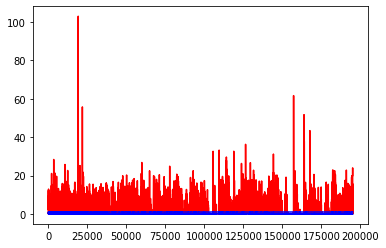

white ratio : 45.0
min : 177
max : 228


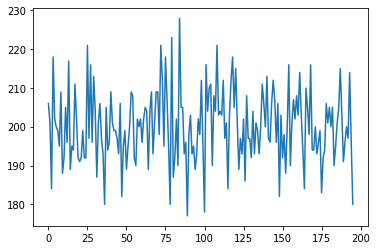

Generating interpolations...
195001 [D loss: 0.000305, acc.: 100.00%] [G loss: 3.239687, 3.605535]
195002 [D loss: 0.000036, acc.: 100.00%] [G loss: 21.971275, 21.972488]
195003 [D loss: 0.000016, acc.: 100.00%] [G loss: 21.805153, 21.629238]
195004 [D loss: 0.000048, acc.: 100.00%] [G loss: 8.334517, 9.265565]
195005 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.632648, 5.405375]
195006 [D loss: 0.125945, acc.: 96.88%] [G loss: 19.820068, 17.491697]
195007 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.432689, 1.658077]
195008 [D loss: 0.000085, acc.: 100.00%] [G loss: 14.962690, 14.974727]
195009 [D loss: 0.000056, acc.: 100.00%] [G loss: 18.189980, 17.862883]
195010 [D loss: 0.000042, acc.: 100.00%] [G loss: 0.900565, 0.604424]
195011 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.029421, 0.152467]
195012 [D loss: 0.006994, acc.: 100.00%] [G loss: 13.529590, 13.227793]
195013 [D loss: 0.188713, acc.: 96.88%] [G loss: 13.308083, 13.519730]
195014 [D loss: 0.000376, acc.: 100.00%] [G loss:

195115 [D loss: 0.000032, acc.: 100.00%] [G loss: 9.245438, 10.613832]
195116 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.131260, 3.656828]
195117 [D loss: 0.000580, acc.: 100.00%] [G loss: 11.977022, 13.508807]
195118 [D loss: 0.000536, acc.: 100.00%] [G loss: 12.827347, 11.674792]
195119 [D loss: 0.000028, acc.: 100.00%] [G loss: 4.259492, 6.062740]
195120 [D loss: 0.000078, acc.: 100.00%] [G loss: 2.878034, 4.554524]
195121 [D loss: 0.000054, acc.: 100.00%] [G loss: 11.100142, 11.017231]
195122 [D loss: 0.003846, acc.: 100.00%] [G loss: 9.378480, 7.837733]
195123 [D loss: 0.000198, acc.: 100.00%] [G loss: 10.025038, 9.576939]
195124 [D loss: 0.000047, acc.: 100.00%] [G loss: 7.135736, 4.405401]
195125 [D loss: 0.000018, acc.: 100.00%] [G loss: 28.616512, 5.578390]
195126 [D loss: 0.000308, acc.: 100.00%] [G loss: 12.858147, 11.755208]
195127 [D loss: 0.000044, acc.: 100.00%] [G loss: 0.306125, 0.039045]
195128 [D loss: 0.002738, acc.: 100.00%] [G loss: 1.306096, 0.034022]
195129 [D

195234 [D loss: 0.000361, acc.: 100.00%] [G loss: 10.575201, 10.444253]
195235 [D loss: 0.000063, acc.: 100.00%] [G loss: 13.249653, 11.315208]
195236 [D loss: 0.000004, acc.: 100.00%] [G loss: 9.043495, 13.873703]
195237 [D loss: 0.000108, acc.: 100.00%] [G loss: 9.430759, 10.426635]
195238 [D loss: 0.000085, acc.: 100.00%] [G loss: 0.029961, 0.188539]
195239 [D loss: 0.000012, acc.: 100.00%] [G loss: 10.802731, 7.740370]
195240 [D loss: 0.000043, acc.: 100.00%] [G loss: 14.900366, 12.947663]
195241 [D loss: 0.000069, acc.: 100.00%] [G loss: 16.142277, 8.278034]
195242 [D loss: 0.000041, acc.: 100.00%] [G loss: 1.579813, 0.845993]
195243 [D loss: 0.030987, acc.: 96.88%] [G loss: 0.183674, 0.346137]
195244 [D loss: 0.000122, acc.: 100.00%] [G loss: 7.662542, 7.589313]
195245 [D loss: 0.000542, acc.: 100.00%] [G loss: 8.227417, 8.213458]
195246 [D loss: 0.000015, acc.: 100.00%] [G loss: 9.883536, 9.277197]
195247 [D loss: 0.000010, acc.: 100.00%] [G loss: 21.864677, 13.901484]
195248 [D

195353 [D loss: 0.000079, acc.: 100.00%] [G loss: 11.507019, 11.586047]
195354 [D loss: 0.001709, acc.: 100.00%] [G loss: 7.205941, 7.740096]
195355 [D loss: 0.000095, acc.: 100.00%] [G loss: 0.992084, 0.627756]
195356 [D loss: 0.000464, acc.: 100.00%] [G loss: 13.898169, 13.122125]
195357 [D loss: 0.000142, acc.: 100.00%] [G loss: 9.482195, 9.117925]
195358 [D loss: 0.000021, acc.: 100.00%] [G loss: 12.152302, 11.311611]
195359 [D loss: 0.001727, acc.: 100.00%] [G loss: 11.388224, 8.976151]
195360 [D loss: 0.000162, acc.: 100.00%] [G loss: 8.593431, 5.308432]
195361 [D loss: 0.000188, acc.: 100.00%] [G loss: 18.826488, 13.313684]
195362 [D loss: 0.000145, acc.: 100.00%] [G loss: 13.795826, 0.465583]
195363 [D loss: 0.000452, acc.: 100.00%] [G loss: 0.000046, 0.000232]
195364 [D loss: 0.000061, acc.: 100.00%] [G loss: 15.421134, 15.260664]
195365 [D loss: 0.000294, acc.: 100.00%] [G loss: 10.038065, 10.414572]
195366 [D loss: 0.000019, acc.: 100.00%] [G loss: 12.159586, 11.910161]
1953

195470 [D loss: 0.013753, acc.: 100.00%] [G loss: 2.914809, 3.263011]
195471 [D loss: 0.001032, acc.: 100.00%] [G loss: 8.643551, 6.750138]
195472 [D loss: 0.000391, acc.: 100.00%] [G loss: 11.167576, 10.155018]
195473 [D loss: 0.000332, acc.: 100.00%] [G loss: 7.884009, 8.187952]
195474 [D loss: 0.000887, acc.: 100.00%] [G loss: 0.761910, 0.471660]
195475 [D loss: 0.000510, acc.: 100.00%] [G loss: 3.598406, 4.943803]
195476 [D loss: 0.003383, acc.: 100.00%] [G loss: 7.064249, 5.630820]
195477 [D loss: 0.000541, acc.: 100.00%] [G loss: 2.443468, 2.315290]
195478 [D loss: 0.000464, acc.: 100.00%] [G loss: 0.000000, 0.000024]
195479 [D loss: 0.001800, acc.: 100.00%] [G loss: 3.583130, 2.850558]
195480 [D loss: 0.027786, acc.: 96.88%] [G loss: 0.772324, 0.000159]
195481 [D loss: 0.000477, acc.: 100.00%] [G loss: 15.656123, 7.138961]
195482 [D loss: 0.000246, acc.: 100.00%] [G loss: 1.885404, 1.691638]
195483 [D loss: 0.046683, acc.: 96.88%] [G loss: 0.303668, 0.341564]
195484 [D loss: 0.0

195588 [D loss: 0.048340, acc.: 96.88%] [G loss: 11.897451, 8.142723]
195589 [D loss: 0.000691, acc.: 100.00%] [G loss: 0.492251, 0.352821]
195590 [D loss: 0.052317, acc.: 96.88%] [G loss: 3.957994, 3.141082]
195591 [D loss: 0.007903, acc.: 100.00%] [G loss: 9.749449, 5.630628]
195592 [D loss: 0.000904, acc.: 100.00%] [G loss: 0.621988, 0.182423]
195593 [D loss: 0.000138, acc.: 100.00%] [G loss: 9.979626, 8.916431]
195594 [D loss: 0.001506, acc.: 100.00%] [G loss: 0.001893, 0.013031]
195595 [D loss: 0.000305, acc.: 100.00%] [G loss: 0.254760, 0.128983]
195596 [D loss: 0.037398, acc.: 96.88%] [G loss: 0.261292, 0.306727]
195597 [D loss: 0.006907, acc.: 100.00%] [G loss: 2.321181, 0.234168]
195598 [D loss: 0.003082, acc.: 100.00%] [G loss: 0.176155, 0.141803]
195599 [D loss: 0.006257, acc.: 100.00%] [G loss: 9.770643, 8.462967]
195600 [D loss: 0.001115, acc.: 100.00%] [G loss: 7.462926, 7.679304]
195601 [D loss: 0.001298, acc.: 100.00%] [G loss: 4.139304, 11.755325]
195602 [D loss: 0.000

195707 [D loss: 0.001495, acc.: 100.00%] [G loss: 11.443178, 0.899368]
195708 [D loss: 0.003520, acc.: 100.00%] [G loss: 3.297387, 2.296607]
195709 [D loss: 0.144233, acc.: 96.88%] [G loss: 0.717646, 0.420707]
195710 [D loss: 0.000948, acc.: 100.00%] [G loss: 12.858677, 14.313250]
195711 [D loss: 0.005593, acc.: 100.00%] [G loss: 3.469885, 2.783053]
195712 [D loss: 0.089190, acc.: 96.88%] [G loss: 0.044273, 0.000323]
195713 [D loss: 0.000132, acc.: 100.00%] [G loss: 8.635279, 9.359011]
195714 [D loss: 0.001372, acc.: 100.00%] [G loss: 6.597128, 5.815480]
195715 [D loss: 0.000286, acc.: 100.00%] [G loss: 0.500801, 0.780141]
195716 [D loss: 0.000160, acc.: 100.00%] [G loss: 5.348386, 6.235126]
195717 [D loss: 0.007457, acc.: 100.00%] [G loss: 4.945381, 5.160486]
195718 [D loss: 0.002000, acc.: 100.00%] [G loss: 2.550967, 2.776922]
195719 [D loss: 0.048592, acc.: 96.88%] [G loss: 0.159828, 0.108644]
195720 [D loss: 0.000629, acc.: 100.00%] [G loss: 7.792965, 6.899378]
195721 [D loss: 0.11

195826 [D loss: 0.000387, acc.: 100.00%] [G loss: 0.162450, 0.089208]
195827 [D loss: 0.000040, acc.: 100.00%] [G loss: 4.222737, 3.471416]
195828 [D loss: 0.006135, acc.: 100.00%] [G loss: 0.149357, 0.067050]
195829 [D loss: 0.000283, acc.: 100.00%] [G loss: 0.164229, 0.117277]
195830 [D loss: 0.001046, acc.: 100.00%] [G loss: 4.337094, 4.111501]
195831 [D loss: 0.004225, acc.: 100.00%] [G loss: 3.341518, 2.781190]
195832 [D loss: 0.000157, acc.: 100.00%] [G loss: 4.331612, 3.714797]
195833 [D loss: 0.000288, acc.: 100.00%] [G loss: 2.230983, 2.924422]
195834 [D loss: 0.000031, acc.: 100.00%] [G loss: 6.471795, 5.211179]
195835 [D loss: 0.000028, acc.: 100.00%] [G loss: 28.710186, 0.000001]
195836 [D loss: 0.000519, acc.: 100.00%] [G loss: 0.714070, 1.080112]
195837 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.000059, 0.000143]
195838 [D loss: 0.000023, acc.: 100.00%] [G loss: 11.437211, 9.594471]
195839 [D loss: 0.000052, acc.: 100.00%] [G loss: 10.015079, 10.143772]
195840 [D loss: 

195943 [D loss: 0.000020, acc.: 100.00%] [G loss: 0.050922, 0.270110]
195944 [D loss: 0.000104, acc.: 100.00%] [G loss: 8.849344, 7.905816]
195945 [D loss: 0.000050, acc.: 100.00%] [G loss: 0.000008, 0.000267]
195946 [D loss: 0.000050, acc.: 100.00%] [G loss: 10.251850, 10.511593]
195947 [D loss: 0.000109, acc.: 100.00%] [G loss: 6.439340, 5.984632]
195948 [D loss: 0.039480, acc.: 96.88%] [G loss: 0.000004, 0.000023]
195949 [D loss: 0.000359, acc.: 100.00%] [G loss: 0.000001, 0.002766]
195950 [D loss: 0.000800, acc.: 100.00%] [G loss: 11.535698, 2.921801]
195951 [D loss: 0.000260, acc.: 100.00%] [G loss: 4.356718, 3.532502]
195952 [D loss: 0.000132, acc.: 100.00%] [G loss: 8.796123, 6.633498]
195953 [D loss: 0.001138, acc.: 100.00%] [G loss: 8.081321, 5.463672]
195954 [D loss: 0.000344, acc.: 100.00%] [G loss: 7.473514, 4.552007]
195955 [D loss: 0.002444, acc.: 100.00%] [G loss: 0.000003, 0.000001]
195956 [D loss: 0.000174, acc.: 100.00%] [G loss: 6.947969, 4.760015]
195957 [D loss: 0.

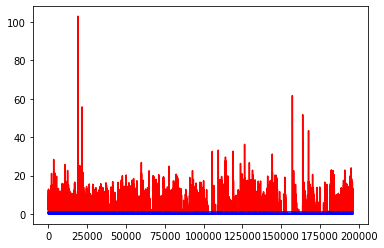

white ratio : 48.0
min : 177
max : 228


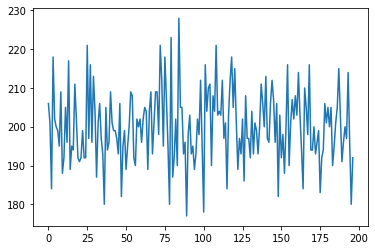

Generating interpolations...
196001 [D loss: 0.000068, acc.: 100.00%] [G loss: 8.871642, 7.913176]
196002 [D loss: 0.000081, acc.: 100.00%] [G loss: 11.052301, 9.539165]
196003 [D loss: 0.000080, acc.: 100.00%] [G loss: 4.224940, 3.396535]
196004 [D loss: 0.000093, acc.: 100.00%] [G loss: 6.086692, 4.269497]
196005 [D loss: 0.000026, acc.: 100.00%] [G loss: 6.173038, 4.137251]
196006 [D loss: 0.000125, acc.: 100.00%] [G loss: 5.149434, 6.009321]
196007 [D loss: 0.000015, acc.: 100.00%] [G loss: 6.208809, 6.067339]
196008 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.010081, 0.005949]
196009 [D loss: 0.000099, acc.: 100.00%] [G loss: 6.653327, 6.870445]
196010 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.381600, 4.880903]
196011 [D loss: 0.000012, acc.: 100.00%] [G loss: 25.737541, 7.443006]
196012 [D loss: 0.000043, acc.: 100.00%] [G loss: 6.136493, 6.827620]
196013 [D loss: 0.000066, acc.: 100.00%] [G loss: 6.505679, 5.017101]
196014 [D loss: 0.000047, acc.: 100.00%] [G loss: 8.868245,

196118 [D loss: 0.000293, acc.: 100.00%] [G loss: 9.213345, 8.389275]
196119 [D loss: 0.000278, acc.: 100.00%] [G loss: 9.627419, 9.186211]
196120 [D loss: 0.000210, acc.: 100.00%] [G loss: 14.345835, 4.036155]
196121 [D loss: 0.000333, acc.: 100.00%] [G loss: 6.972919, 7.509158]
196122 [D loss: 0.000179, acc.: 100.00%] [G loss: 7.298253, 5.453940]
196123 [D loss: 0.000121, acc.: 100.00%] [G loss: 3.760060, 2.715454]
196124 [D loss: 0.000097, acc.: 100.00%] [G loss: 3.282068, 4.610874]
196125 [D loss: 0.013816, acc.: 100.00%] [G loss: 7.832575, 7.580294]
196126 [D loss: 0.005188, acc.: 100.00%] [G loss: 7.972136, 6.394734]
196127 [D loss: 0.005716, acc.: 100.00%] [G loss: 4.410746, 7.279504]
196128 [D loss: 0.000702, acc.: 100.00%] [G loss: 38.384556, 6.857785]
196129 [D loss: 0.000118, acc.: 100.00%] [G loss: 10.104496, 12.036509]
196130 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.345118, 8.166937]
196131 [D loss: 0.004357, acc.: 100.00%] [G loss: 7.695297, 7.107311]
196132 [D loss: 

196235 [D loss: 0.000031, acc.: 100.00%] [G loss: 0.000025, 0.000014]
196236 [D loss: 0.000036, acc.: 100.00%] [G loss: 3.257379, 2.917310]
196237 [D loss: 0.000308, acc.: 100.00%] [G loss: 16.656368, 4.630916]
196238 [D loss: 0.000936, acc.: 100.00%] [G loss: 6.828688, 4.340947]
196239 [D loss: 0.000139, acc.: 100.00%] [G loss: 60.656628, 5.601133]
196240 [D loss: 0.008153, acc.: 100.00%] [G loss: 8.777192, 7.558906]
196241 [D loss: 0.014701, acc.: 100.00%] [G loss: 0.694723, 0.897187]
196242 [D loss: 0.000086, acc.: 100.00%] [G loss: 10.572189, 11.897266]
196243 [D loss: 0.000186, acc.: 100.00%] [G loss: 9.463404, 11.544764]
196244 [D loss: 0.001611, acc.: 100.00%] [G loss: 7.784338, 7.252367]
196245 [D loss: 0.001222, acc.: 100.00%] [G loss: 5.690539, 6.255232]
196246 [D loss: 0.000189, acc.: 100.00%] [G loss: 0.421192, 0.106222]
196247 [D loss: 0.002402, acc.: 100.00%] [G loss: 4.927601, 4.752416]
196248 [D loss: 0.000037, acc.: 100.00%] [G loss: 5.164519, 3.866970]
196249 [D loss:

196352 [D loss: 0.000237, acc.: 100.00%] [G loss: 11.606808, 12.831950]
196353 [D loss: 0.000099, acc.: 100.00%] [G loss: 8.426996, 8.563359]
196354 [D loss: 0.000153, acc.: 100.00%] [G loss: 0.532819, 0.767604]
196355 [D loss: 0.000142, acc.: 100.00%] [G loss: 1.365151, 1.396623]
196356 [D loss: 0.001268, acc.: 100.00%] [G loss: 4.796984, 0.000007]
196357 [D loss: 0.000209, acc.: 100.00%] [G loss: 5.974509, 5.952913]
196358 [D loss: 0.000046, acc.: 100.00%] [G loss: 5.070814, 3.838205]
196359 [D loss: 0.000088, acc.: 100.00%] [G loss: 4.902447, 3.587017]
196360 [D loss: 0.000587, acc.: 100.00%] [G loss: 0.026925, 0.020136]
196361 [D loss: 0.000059, acc.: 100.00%] [G loss: 4.459594, 2.980732]
196362 [D loss: 0.001226, acc.: 100.00%] [G loss: 0.000000, 0.000000]
196363 [D loss: 0.000076, acc.: 100.00%] [G loss: 0.000005, 0.000010]
196364 [D loss: 0.000412, acc.: 100.00%] [G loss: 4.990867, 6.155633]
196365 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.996570, 8.115952]
196366 [D loss: 0.

196472 [D loss: 0.000108, acc.: 100.00%] [G loss: 15.987384, 12.789507]
196473 [D loss: 0.000094, acc.: 100.00%] [G loss: 0.004309, 0.001136]
196474 [D loss: 0.000702, acc.: 100.00%] [G loss: 11.454969, 9.921395]
196475 [D loss: 0.000211, acc.: 100.00%] [G loss: 13.336289, 13.701004]
196476 [D loss: 0.000006, acc.: 100.00%] [G loss: 1.657274, 2.450538]
196477 [D loss: 0.012805, acc.: 100.00%] [G loss: 0.009492, 0.193318]
196478 [D loss: 0.009591, acc.: 100.00%] [G loss: 10.855421, 10.721376]
196479 [D loss: 0.000019, acc.: 100.00%] [G loss: 8.960667, 11.394735]
196480 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.017750, 0.014005]
196481 [D loss: 0.000168, acc.: 100.00%] [G loss: 1.500708, 0.817184]
196482 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.006989, 0.000158]
196483 [D loss: 0.000054, acc.: 100.00%] [G loss: 30.254742, 14.751978]
196484 [D loss: 0.000576, acc.: 100.00%] [G loss: 2.802156, 2.332872]
196485 [D loss: 0.000018, acc.: 100.00%] [G loss: 16.134928, 16.791542]
196486 [

196588 [D loss: 0.000029, acc.: 100.00%] [G loss: 7.470850, 6.463346]
196589 [D loss: 0.000537, acc.: 100.00%] [G loss: 0.068901, 0.000012]
196590 [D loss: 0.002125, acc.: 100.00%] [G loss: 6.362227, 4.762372]
196591 [D loss: 0.007158, acc.: 100.00%] [G loss: 6.749876, 6.225659]
196592 [D loss: 0.000177, acc.: 100.00%] [G loss: 11.266959, 10.900537]
196593 [D loss: 0.000101, acc.: 100.00%] [G loss: 6.918768, 7.784033]
196594 [D loss: 0.000053, acc.: 100.00%] [G loss: 4.651161, 4.855508]
196595 [D loss: 0.000194, acc.: 100.00%] [G loss: 5.900324, 8.522017]
196596 [D loss: 0.000622, acc.: 100.00%] [G loss: 18.849117, 11.404056]
196597 [D loss: 0.000073, acc.: 100.00%] [G loss: 1.418308, 0.832085]
196598 [D loss: 0.000361, acc.: 100.00%] [G loss: 8.246582, 6.160374]
196599 [D loss: 0.000208, acc.: 100.00%] [G loss: 9.328272, 7.830441]
196600 [D loss: 0.004056, acc.: 100.00%] [G loss: 5.931240, 5.183303]
196601 [D loss: 0.006732, acc.: 100.00%] [G loss: 9.669287, 5.741776]
196602 [D loss: 

196706 [D loss: 0.000004, acc.: 100.00%] [G loss: 11.207508, 12.027182]
196707 [D loss: 0.000049, acc.: 100.00%] [G loss: 12.411940, 12.250176]
196708 [D loss: 0.000125, acc.: 100.00%] [G loss: 12.892389, 9.883534]
196709 [D loss: 0.000020, acc.: 100.00%] [G loss: 9.199417, 9.481990]
196710 [D loss: 0.000057, acc.: 100.00%] [G loss: 6.551719, 7.121253]
196711 [D loss: 0.000115, acc.: 100.00%] [G loss: 24.870850, 15.373297]
196712 [D loss: 0.000056, acc.: 100.00%] [G loss: 0.011362, 0.026005]
196713 [D loss: 0.000216, acc.: 100.00%] [G loss: 15.021471, 14.324778]
196714 [D loss: 0.000029, acc.: 100.00%] [G loss: 14.177021, 12.480931]
196715 [D loss: 0.000117, acc.: 100.00%] [G loss: 14.115683, 13.372078]
196716 [D loss: 0.000052, acc.: 100.00%] [G loss: 15.465914, 14.781143]
196717 [D loss: 0.000018, acc.: 100.00%] [G loss: 16.368540, 16.124540]
196718 [D loss: 0.000009, acc.: 100.00%] [G loss: 11.065416, 11.301827]
196719 [D loss: 0.000051, acc.: 100.00%] [G loss: 12.667234, 13.770496]

196823 [D loss: 0.000422, acc.: 100.00%] [G loss: 0.164174, 0.000359]
196824 [D loss: 0.000739, acc.: 100.00%] [G loss: 9.508978, 6.166921]
196825 [D loss: 0.000376, acc.: 100.00%] [G loss: 7.391988, 6.447037]
196826 [D loss: 0.000248, acc.: 100.00%] [G loss: 0.043655, 0.002210]
196827 [D loss: 0.000839, acc.: 100.00%] [G loss: 9.548874, 13.011388]
196828 [D loss: 0.000477, acc.: 100.00%] [G loss: 0.220779, 0.479764]
196829 [D loss: 0.000255, acc.: 100.00%] [G loss: 15.773008, 14.944331]
196830 [D loss: 0.000187, acc.: 100.00%] [G loss: 15.918825, 14.449042]
196831 [D loss: 0.011885, acc.: 100.00%] [G loss: 6.683125, 6.763327]
196832 [D loss: 0.000160, acc.: 100.00%] [G loss: 12.883793, 12.049481]
196833 [D loss: 0.002466, acc.: 100.00%] [G loss: 0.549505, 0.571383]
196834 [D loss: 0.000671, acc.: 100.00%] [G loss: 3.971540, 3.367456]
196835 [D loss: 0.001003, acc.: 100.00%] [G loss: 8.938299, 7.824515]
196836 [D loss: 0.000411, acc.: 100.00%] [G loss: 9.684063, 8.478582]
196837 [D los

196940 [D loss: 0.000088, acc.: 100.00%] [G loss: 5.417590, 3.850492]
196941 [D loss: 0.000118, acc.: 100.00%] [G loss: 5.901050, 4.494550]
196942 [D loss: 0.000048, acc.: 100.00%] [G loss: 9.763840, 10.097467]
196943 [D loss: 0.000107, acc.: 100.00%] [G loss: 5.101372, 3.798803]
196944 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.452482, 0.000291]
196945 [D loss: 0.000252, acc.: 100.00%] [G loss: 0.000013, 0.001717]
196946 [D loss: 0.000080, acc.: 100.00%] [G loss: 0.198187, 0.078210]
196947 [D loss: 0.000103, acc.: 100.00%] [G loss: 0.179013, 0.008686]
196948 [D loss: 0.000059, acc.: 100.00%] [G loss: 0.001044, 0.000395]
196949 [D loss: 0.000474, acc.: 100.00%] [G loss: 7.767081, 7.251275]
196950 [D loss: 0.000232, acc.: 100.00%] [G loss: 7.645092, 5.903070]
196951 [D loss: 0.000067, acc.: 100.00%] [G loss: 6.964449, 4.191377]
196952 [D loss: 0.000149, acc.: 100.00%] [G loss: 1.209395, 0.000000]
196953 [D loss: 0.000759, acc.: 100.00%] [G loss: 5.156880, 8.575575]
196954 [D loss: 0.0

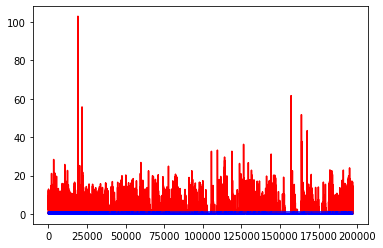

white ratio : 45.75
min : 177
max : 228


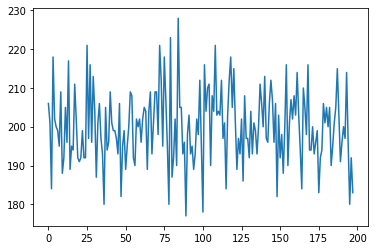

Generating interpolations...
197001 [D loss: 0.000038, acc.: 100.00%] [G loss: 13.291138, 13.418848]
197002 [D loss: 0.000235, acc.: 100.00%] [G loss: 8.914246, 11.589128]
197003 [D loss: 0.000052, acc.: 100.00%] [G loss: 11.142856, 8.937941]
197004 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.422375, 1.630382]
197005 [D loss: 0.000119, acc.: 100.00%] [G loss: 0.456393, 0.398894]
197006 [D loss: 0.000538, acc.: 100.00%] [G loss: 9.573923, 11.297364]
197007 [D loss: 0.000022, acc.: 100.00%] [G loss: 0.000001, 0.000025]
197008 [D loss: 0.000006, acc.: 100.00%] [G loss: 7.030042, 7.230723]
197009 [D loss: 0.000029, acc.: 100.00%] [G loss: 0.003510, 0.004964]
197010 [D loss: 0.000021, acc.: 100.00%] [G loss: 1.498119, 0.687418]
197011 [D loss: 0.176894, acc.: 96.88%] [G loss: 6.016249, 5.747997]
197012 [D loss: 0.000258, acc.: 100.00%] [G loss: 0.172416, 6.533788]
197013 [D loss: 0.000148, acc.: 100.00%] [G loss: 6.422055, 7.291636]
197014 [D loss: 0.001019, acc.: 100.00%] [G loss: 5.60958

197119 [D loss: 0.000063, acc.: 100.00%] [G loss: 8.853551, 7.980701]
197120 [D loss: 0.000408, acc.: 100.00%] [G loss: 0.000252, 0.000006]
197121 [D loss: 0.000125, acc.: 100.00%] [G loss: 7.644612, 7.920630]
197122 [D loss: 0.000028, acc.: 100.00%] [G loss: 8.228597, 7.998899]
197123 [D loss: 0.000022, acc.: 100.00%] [G loss: 6.219328, 4.614950]
197124 [D loss: 0.020330, acc.: 100.00%] [G loss: 0.000311, 0.001512]
197125 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.000785, 0.000004]
197126 [D loss: 0.000508, acc.: 100.00%] [G loss: 9.252902, 1.935554]
197127 [D loss: 0.022539, acc.: 100.00%] [G loss: 5.578654, 4.966803]
197128 [D loss: 0.000813, acc.: 100.00%] [G loss: 2.303936, 2.302208]
197129 [D loss: 0.000035, acc.: 100.00%] [G loss: 7.144825, 10.630981]
197130 [D loss: 0.060813, acc.: 96.88%] [G loss: 0.453302, 0.012852]
197131 [D loss: 0.003485, acc.: 100.00%] [G loss: 3.385104, 3.744797]
197132 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.718208, 2.958132]
197133 [D loss: 0.00

197239 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.025240, 0.534179]
197240 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.377151, 0.969760]
197241 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.827039, 13.763103]
197242 [D loss: 0.000052, acc.: 100.00%] [G loss: 16.597359, 15.809772]
197243 [D loss: 0.000008, acc.: 100.00%] [G loss: 14.681868, 13.107587]
197244 [D loss: 0.000019, acc.: 100.00%] [G loss: 17.904926, 15.288543]
197245 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.009515, 0.207831]
197246 [D loss: 0.000046, acc.: 100.00%] [G loss: 14.549051, 14.033516]
197247 [D loss: 0.000040, acc.: 100.00%] [G loss: 10.536295, 10.886352]
197248 [D loss: 0.000007, acc.: 100.00%] [G loss: 11.757528, 12.853548]
197249 [D loss: 0.000013, acc.: 100.00%] [G loss: 17.405897, 14.752083]
197250 [D loss: 0.000008, acc.: 100.00%] [G loss: 8.359568, 8.333146]
197251 [D loss: 0.000022, acc.: 100.00%] [G loss: 2.321380, 1.955159]
197252 [D loss: 0.007395, acc.: 100.00%] [G loss: 10.016006, 6.210022]
197

197357 [D loss: 0.000002, acc.: 100.00%] [G loss: 7.974155, 6.645264]
197358 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.000005, 0.000285]
197359 [D loss: 0.000002, acc.: 100.00%] [G loss: 6.979553, 8.739787]
197360 [D loss: 0.000016, acc.: 100.00%] [G loss: 8.236249, 7.644311]
197361 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.000046, 0.000001]
197362 [D loss: 0.000671, acc.: 100.00%] [G loss: 0.000000, 0.000000]
197363 [D loss: 0.000162, acc.: 100.00%] [G loss: 1.136951, 0.409848]
197364 [D loss: 0.000059, acc.: 100.00%] [G loss: 7.130168, 4.548465]
197365 [D loss: 0.001216, acc.: 100.00%] [G loss: 1.773948, 1.804299]
197366 [D loss: 0.000047, acc.: 100.00%] [G loss: 9.648851, 2.703324]
197367 [D loss: 0.000027, acc.: 100.00%] [G loss: 4.671755, 5.217389]
197368 [D loss: 0.000275, acc.: 100.00%] [G loss: 0.505696, 0.667982]
197369 [D loss: 0.000004, acc.: 100.00%] [G loss: 0.000000, 0.000000]
197370 [D loss: 0.000101, acc.: 100.00%] [G loss: 13.856642, 8.391722]
197371 [D loss: 0.0

197477 [D loss: 0.000026, acc.: 100.00%] [G loss: 1.873900, 1.119173]
197478 [D loss: 0.000120, acc.: 100.00%] [G loss: 0.593826, 0.223280]
197479 [D loss: 0.000066, acc.: 100.00%] [G loss: 0.729332, 0.900521]
197480 [D loss: 0.000233, acc.: 100.00%] [G loss: 3.009460, 3.912263]
197481 [D loss: 0.000069, acc.: 100.00%] [G loss: 4.434318, 1.086842]
197482 [D loss: 0.000087, acc.: 100.00%] [G loss: 5.937251, 6.057220]
197483 [D loss: 0.000594, acc.: 100.00%] [G loss: 0.976158, 1.143296]
197484 [D loss: 0.000026, acc.: 100.00%] [G loss: 0.098442, 0.271608]
197485 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.258411, 2.547865]
197486 [D loss: 0.000068, acc.: 100.00%] [G loss: 0.010183, 0.108382]
197487 [D loss: 0.000269, acc.: 100.00%] [G loss: 0.037219, 0.041468]
197488 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.013594, 0.094919]
197489 [D loss: 0.000070, acc.: 100.00%] [G loss: 0.049758, 0.227925]
197490 [D loss: 0.000043, acc.: 100.00%] [G loss: 5.892164, 6.514705]
197491 [D loss: 0.00

197594 [D loss: 0.004085, acc.: 100.00%] [G loss: 2.197809, 1.605565]
197595 [D loss: 0.000054, acc.: 100.00%] [G loss: 9.966908, 8.887632]
197596 [D loss: 0.000012, acc.: 100.00%] [G loss: 7.778776, 4.987413]
197597 [D loss: 0.000073, acc.: 100.00%] [G loss: 0.000135, 0.000000]
197598 [D loss: 0.000035, acc.: 100.00%] [G loss: 5.413814, 4.845274]
197599 [D loss: 0.000226, acc.: 100.00%] [G loss: 0.210852, 0.014319]
197600 [D loss: 0.000145, acc.: 100.00%] [G loss: 0.002580, 0.000108]
197601 [D loss: 0.000004, acc.: 100.00%] [G loss: 39.504551, 14.312921]
197602 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.220048, 1.543623]
197603 [D loss: 0.000146, acc.: 100.00%] [G loss: 11.952049, 13.048840]
197604 [D loss: 0.000077, acc.: 100.00%] [G loss: 2.784259, 3.457741]
197605 [D loss: 0.000290, acc.: 100.00%] [G loss: 6.673260, 7.396963]
197606 [D loss: 0.000139, acc.: 100.00%] [G loss: 0.039964, 0.197571]
197607 [D loss: 0.001991, acc.: 100.00%] [G loss: 11.171076, 9.895314]
197608 [D loss:

197714 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.468450, 0.518244]
197715 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.949045, 2.483929]
197716 [D loss: 0.000017, acc.: 100.00%] [G loss: 2.996456, 3.744923]
197717 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.347372, 1.464022]
197718 [D loss: 0.000037, acc.: 100.00%] [G loss: 1.768486, 0.923695]
197719 [D loss: 0.000011, acc.: 100.00%] [G loss: 0.145416, 0.012893]
197720 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.539466, 0.989978]
197721 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.525407, 4.916122]
197722 [D loss: 0.000007, acc.: 100.00%] [G loss: 4.839975, 3.210741]
197723 [D loss: 0.000020, acc.: 100.00%] [G loss: 3.059556, 2.296683]
197724 [D loss: 0.001076, acc.: 100.00%] [G loss: 39.495831, 3.148221]
197725 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.505905, 3.040041]
197726 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.574158, 12.423574]
197727 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.785109, 10.110720]
197728 [D loss:

197832 [D loss: 0.000085, acc.: 100.00%] [G loss: 3.289192, 2.910429]
197833 [D loss: 0.000010, acc.: 100.00%] [G loss: 0.479375, 1.464613]
197834 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.023591, 0.135622]
197835 [D loss: 0.000025, acc.: 100.00%] [G loss: 2.041983, 2.568142]
197836 [D loss: 0.000008, acc.: 100.00%] [G loss: 1.240742, 1.414731]
197837 [D loss: 0.000193, acc.: 100.00%] [G loss: 0.874008, 0.931387]
197838 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.416297, 2.330408]
197839 [D loss: 0.000612, acc.: 100.00%] [G loss: 0.029490, 0.010609]
197840 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.893404, 1.570913]
197841 [D loss: 0.000309, acc.: 100.00%] [G loss: 0.003037, 0.035340]
197842 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.044876, 0.187788]
197843 [D loss: 0.000017, acc.: 100.00%] [G loss: 16.352404, 2.725182]
197844 [D loss: 0.000006, acc.: 100.00%] [G loss: 15.301306, 15.264879]
197845 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.800663, 3.596746]
197846 [D loss: 0

197949 [D loss: 0.000011, acc.: 100.00%] [G loss: 3.976348, 4.773248]
197950 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.853927, 2.079474]
197951 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.501060, 1.803975]
197952 [D loss: 0.000021, acc.: 100.00%] [G loss: 4.796731, 4.212645]
197953 [D loss: 0.000028, acc.: 100.00%] [G loss: 8.588800, 3.717088]
197954 [D loss: 0.000012, acc.: 100.00%] [G loss: 9.628300, 0.312573]
197955 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.864233, 2.295974]
197956 [D loss: 0.000100, acc.: 100.00%] [G loss: 0.000176, 0.000007]
197957 [D loss: 0.000020, acc.: 100.00%] [G loss: 2.656532, 3.240191]
197958 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.000125, 0.004956]
197959 [D loss: 0.000024, acc.: 100.00%] [G loss: 3.397050, 3.481188]
197960 [D loss: 0.000005, acc.: 100.00%] [G loss: 1.654169, 0.240246]
197961 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.922857, 1.391563]
197962 [D loss: 0.000081, acc.: 100.00%] [G loss: 0.364187, 0.132909]
197963 [D loss: 0.00

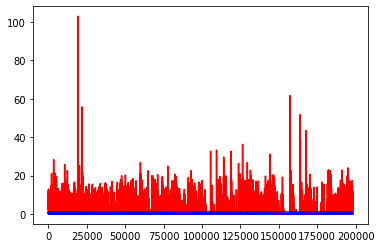

white ratio : 48.25
min : 177
max : 228


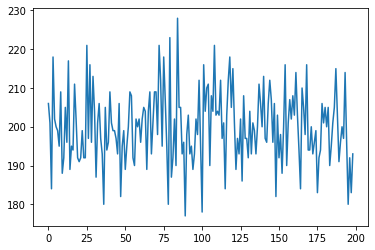

Generating interpolations...
198001 [D loss: 0.000014, acc.: 100.00%] [G loss: 6.096272, 5.483925]
198002 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.222294, 11.787107]
198003 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.667396, 1.303921]
198004 [D loss: 0.000257, acc.: 100.00%] [G loss: 39.818550, 1.361486]
198005 [D loss: 0.000000, acc.: 100.00%] [G loss: 1.837768, 1.872977]
198006 [D loss: 0.000717, acc.: 100.00%] [G loss: 9.424186, 9.211819]
198007 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.980370, 6.960149]
198008 [D loss: 0.000015, acc.: 100.00%] [G loss: 10.210609, 11.167902]
198009 [D loss: 0.000000, acc.: 100.00%] [G loss: 8.814858, 8.587816]
198010 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.792827, 9.758596]
198011 [D loss: 0.000007, acc.: 100.00%] [G loss: 1.287982, 1.017446]
198012 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.696550, 6.604763]
198013 [D loss: 0.000007, acc.: 100.00%] [G loss: 17.204609, 8.862151]
198014 [D loss: 0.000171, acc.: 100.00%] [G loss: 15.20

198120 [D loss: 0.001303, acc.: 100.00%] [G loss: 4.690744, 0.000019]
198121 [D loss: 0.000023, acc.: 100.00%] [G loss: 3.947722, 4.206356]
198122 [D loss: 0.000015, acc.: 100.00%] [G loss: 8.211823, 7.575861]
198123 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.263280, 5.211706]
198124 [D loss: 0.000008, acc.: 100.00%] [G loss: 13.376475, 13.827671]
198125 [D loss: 0.000017, acc.: 100.00%] [G loss: 6.185592, 6.227677]
198126 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.102733, 0.467654]
198127 [D loss: 0.000022, acc.: 100.00%] [G loss: 3.788411, 8.625453]
198128 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.043985, 7.593876]
198129 [D loss: 0.000000, acc.: 100.00%] [G loss: 35.462555, 9.576204]
198130 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.185092, 0.079867]
198131 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.136933, 8.410421]
198132 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.283218, 5.638398]
198133 [D loss: 0.000007, acc.: 100.00%] [G loss: 0.011328, 0.031683]
198134 [D loss: 

198237 [D loss: 0.000061, acc.: 100.00%] [G loss: 3.043819, 2.127578]
198238 [D loss: 0.000341, acc.: 100.00%] [G loss: 0.182190, 0.002392]
198239 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.657742, 5.003758]
198240 [D loss: 0.000105, acc.: 100.00%] [G loss: 22.997807, 0.126241]
198241 [D loss: 0.000122, acc.: 100.00%] [G loss: 4.686562, 5.933700]
198242 [D loss: 0.000046, acc.: 100.00%] [G loss: 5.330359, 4.493943]
198243 [D loss: 0.000506, acc.: 100.00%] [G loss: 5.906475, 5.639801]
198244 [D loss: 0.000005, acc.: 100.00%] [G loss: 2.284595, 2.594684]
198245 [D loss: 0.000105, acc.: 100.00%] [G loss: 2.890741, 3.199219]
198246 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.586569, 2.474342]
198247 [D loss: 0.000044, acc.: 100.00%] [G loss: 16.563864, 13.930057]
198248 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.589402, 5.144913]
198249 [D loss: 0.000087, acc.: 100.00%] [G loss: 11.811866, 12.923378]
198250 [D loss: 0.000117, acc.: 100.00%] [G loss: 5.973948, 7.412469]
198251 [D loss:

198354 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.279923, 9.011165]
198355 [D loss: 0.000002, acc.: 100.00%] [G loss: 2.656850, 1.740818]
198356 [D loss: 0.000001, acc.: 100.00%] [G loss: 2.842472, 4.224652]
198357 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.391094, 0.997848]
198358 [D loss: 0.000004, acc.: 100.00%] [G loss: 17.557335, 9.706837]
198359 [D loss: 0.000011, acc.: 100.00%] [G loss: 10.542062, 10.806715]
198360 [D loss: 0.000015, acc.: 100.00%] [G loss: 8.099976, 3.072348]
198361 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.156275, 11.710691]
198362 [D loss: 0.000016, acc.: 100.00%] [G loss: 13.417187, 5.041653]
198363 [D loss: 0.000092, acc.: 100.00%] [G loss: 11.337137, 11.254830]
198364 [D loss: 0.000004, acc.: 100.00%] [G loss: 6.892136, 6.433436]
198365 [D loss: 0.000050, acc.: 100.00%] [G loss: 2.487171, 2.174808]
198366 [D loss: 0.000028, acc.: 100.00%] [G loss: 3.965131, 3.526772]
198367 [D loss: 0.000111, acc.: 100.00%] [G loss: 1.000295, 1.235494]
198368 [D lo

198472 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.198349, 7.531366]
198473 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.784715, 7.747656]
198474 [D loss: 0.000188, acc.: 100.00%] [G loss: 7.100700, 6.833681]
198475 [D loss: 0.000006, acc.: 100.00%] [G loss: 6.975076, 5.668920]
198476 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.938093, 3.808277]
198477 [D loss: 0.000005, acc.: 100.00%] [G loss: 6.387512, 4.421164]
198478 [D loss: 0.000000, acc.: 100.00%] [G loss: 5.719069, 5.375463]
198479 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.587357, 3.389064]
198480 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.489264, 7.393035]
198481 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.149215, 5.113341]
198482 [D loss: 0.000001, acc.: 100.00%] [G loss: 5.796361, 3.515534]
198483 [D loss: 0.000006, acc.: 100.00%] [G loss: 4.730714, 4.773954]
198484 [D loss: 0.000024, acc.: 100.00%] [G loss: 2.205707, 2.305876]
198485 [D loss: 0.000202, acc.: 100.00%] [G loss: 5.353568, 5.050200]
198486 [D loss: 0.00

198592 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.018733, 6.488049]
198593 [D loss: 0.001641, acc.: 100.00%] [G loss: 0.243595, 0.352654]
198594 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.045690, 0.000342]
198595 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.240371, 5.095844]
198596 [D loss: 0.000075, acc.: 100.00%] [G loss: 10.497195, 5.410851]
198597 [D loss: 0.000006, acc.: 100.00%] [G loss: 9.685249, 7.380196]
198598 [D loss: 0.000001, acc.: 100.00%] [G loss: 14.207949, 12.428871]
198599 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.859548, 7.493858]
198600 [D loss: 0.000002, acc.: 100.00%] [G loss: 13.505826, 11.818623]
198601 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.120395, 0.039284]
198602 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.294074, 5.962246]
198603 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.237131, 4.754303]
198604 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.473260, 2.584785]
198605 [D loss: 0.000000, acc.: 100.00%] [G loss: 4.418730, 4.525974]
198606 [D loss:

198711 [D loss: 0.000025, acc.: 100.00%] [G loss: 1.076973, 1.848667]
198712 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.833429, 1.772700]
198713 [D loss: 0.000052, acc.: 100.00%] [G loss: 0.724552, 0.406388]
198714 [D loss: 0.000012, acc.: 100.00%] [G loss: 0.635358, 1.108116]
198715 [D loss: 0.000014, acc.: 100.00%] [G loss: 1.075413, 1.339437]
198716 [D loss: 0.000030, acc.: 100.00%] [G loss: 1.141524, 1.835790]
198717 [D loss: 0.002663, acc.: 100.00%] [G loss: 0.977142, 1.098497]
198718 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000018, 0.000054]
198719 [D loss: 0.000109, acc.: 100.00%] [G loss: 1.569336, 2.386693]
198720 [D loss: 0.000093, acc.: 100.00%] [G loss: 2.569811, 2.231787]
198721 [D loss: 0.000003, acc.: 100.00%] [G loss: 1.497319, 1.755660]
198722 [D loss: 0.000036, acc.: 100.00%] [G loss: 1.495151, 0.302996]
198723 [D loss: 0.000015, acc.: 100.00%] [G loss: 0.660876, 1.342909]
198724 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.000574, 0.000000]
198725 [D loss: 0.00

198831 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.000002, 0.000001]
198832 [D loss: 0.000011, acc.: 100.00%] [G loss: 2.474279, 3.009465]
198833 [D loss: 0.000125, acc.: 100.00%] [G loss: 2.883684, 2.831970]
198834 [D loss: 0.000031, acc.: 100.00%] [G loss: 2.874869, 3.338435]
198835 [D loss: 0.000188, acc.: 100.00%] [G loss: 0.000027, 0.000002]
198836 [D loss: 0.000166, acc.: 100.00%] [G loss: 2.913465, 1.954496]
198837 [D loss: 0.000001, acc.: 100.00%] [G loss: 1.921683, 2.292826]
198838 [D loss: 0.000058, acc.: 100.00%] [G loss: 2.007421, 0.782342]
198839 [D loss: 0.000169, acc.: 100.00%] [G loss: 9.663654, 4.316994]
198840 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.692429, 4.695232]
198841 [D loss: 0.000014, acc.: 100.00%] [G loss: 3.373945, 2.402527]
198842 [D loss: 0.000004, acc.: 100.00%] [G loss: 2.466986, 3.341027]
198843 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.003227, 0.100848]
198844 [D loss: 0.000035, acc.: 100.00%] [G loss: 1.189033, 2.052872]
198845 [D loss: 0.00

198951 [D loss: 0.000085, acc.: 100.00%] [G loss: 3.940608, 4.562881]
198952 [D loss: 0.000012, acc.: 100.00%] [G loss: 5.406898, 5.505091]
198953 [D loss: 0.000156, acc.: 100.00%] [G loss: 3.271680, 2.422061]
198954 [D loss: 0.000131, acc.: 100.00%] [G loss: 8.643053, 5.094008]
198955 [D loss: 0.000057, acc.: 100.00%] [G loss: 35.573902, 7.328079]
198956 [D loss: 0.000009, acc.: 100.00%] [G loss: 8.136550, 5.926343]
198957 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.374815, 7.452367]
198958 [D loss: 0.000020, acc.: 100.00%] [G loss: 6.500374, 7.135793]
198959 [D loss: 0.000043, acc.: 100.00%] [G loss: 5.802208, 4.165013]
198960 [D loss: 0.000025, acc.: 100.00%] [G loss: 8.195684, 8.689258]
198961 [D loss: 0.000013, acc.: 100.00%] [G loss: 6.323310, 8.349525]
198962 [D loss: 0.000008, acc.: 100.00%] [G loss: 3.216424, 3.844110]
198963 [D loss: 0.000027, acc.: 100.00%] [G loss: 0.000001, 0.000078]
198964 [D loss: 0.000042, acc.: 100.00%] [G loss: 3.363485, 2.456389]
198965 [D loss: 0.0

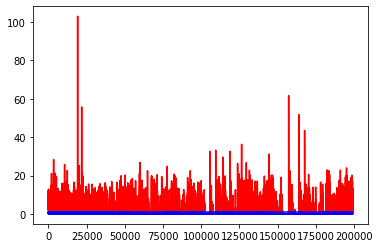

white ratio : 48.5
min : 177
max : 228


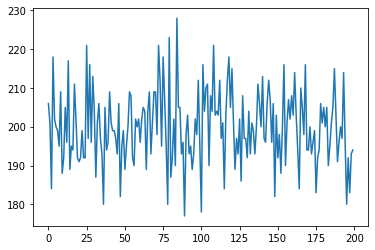

Generating interpolations...
199001 [D loss: 0.000007, acc.: 100.00%] [G loss: 5.446053, 4.478565]
199002 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.213923, 0.624321]
199003 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.979620, 6.798231]
199004 [D loss: 0.000006, acc.: 100.00%] [G loss: 3.031012, 1.867049]
199005 [D loss: 0.009583, acc.: 100.00%] [G loss: 2.922276, 3.046638]
199006 [D loss: 0.000020, acc.: 100.00%] [G loss: 4.681089, 2.872616]
199007 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.735627, 3.374950]
199008 [D loss: 0.000014, acc.: 100.00%] [G loss: 2.890331, 3.235587]
199009 [D loss: 0.000009, acc.: 100.00%] [G loss: 0.011559, 0.056981]
199010 [D loss: 0.000001, acc.: 100.00%] [G loss: 0.001234, 0.064358]
199011 [D loss: 0.000042, acc.: 100.00%] [G loss: 2.477001, 3.889149]
199012 [D loss: 0.000010, acc.: 100.00%] [G loss: 2.114809, 2.538452]
199013 [D loss: 0.000018, acc.: 100.00%] [G loss: 4.273070, 2.804378]
199014 [D loss: 0.000023, acc.: 100.00%] [G loss: 6.884192, 

199120 [D loss: 0.000002, acc.: 100.00%] [G loss: 4.892969, 6.578218]
199121 [D loss: 0.000008, acc.: 100.00%] [G loss: 4.595517, 5.327109]
199122 [D loss: 0.000000, acc.: 100.00%] [G loss: 3.538697, 4.484046]
199123 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.363252, 7.014898]
199124 [D loss: 0.000004, acc.: 100.00%] [G loss: 3.609258, 3.685741]
199125 [D loss: 0.000249, acc.: 100.00%] [G loss: 4.374975, 3.400282]
199126 [D loss: 0.000007, acc.: 100.00%] [G loss: 11.463345, 10.365175]
199127 [D loss: 0.000011, acc.: 100.00%] [G loss: 10.609817, 12.188349]
199128 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.242182, 8.438921]
199129 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.478624, 6.391726]
199130 [D loss: 0.000031, acc.: 100.00%] [G loss: 8.277033, 5.844901]
199131 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.974874, 9.626560]
199132 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.708921, 9.269808]
199133 [D loss: 0.000005, acc.: 100.00%] [G loss: 9.235404, 7.372812]
199134 [D loss: 

199239 [D loss: 0.032172, acc.: 96.88%] [G loss: 10.489640, 7.977623]
199240 [D loss: 0.000007, acc.: 100.00%] [G loss: 15.132532, 14.748515]
199241 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.894718, 13.423754]
199242 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.294047, 0.045657]
199243 [D loss: 0.000003, acc.: 100.00%] [G loss: 0.033477, 0.251200]
199244 [D loss: 0.000001, acc.: 100.00%] [G loss: 13.272266, 17.204659]
199245 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.668715, 13.056553]
199246 [D loss: 0.000000, acc.: 100.00%] [G loss: 13.584412, 11.872368]
199247 [D loss: 0.000001, acc.: 100.00%] [G loss: 22.557640, 10.922848]
199248 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.541880, 10.598558]
199249 [D loss: 0.000003, acc.: 100.00%] [G loss: 52.355644, 14.257865]
199250 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.011365, 0.475631]
199251 [D loss: 0.000233, acc.: 100.00%] [G loss: 19.669033, 17.697502]
199252 [D loss: 0.000009, acc.: 100.00%] [G loss: 18.818913, 16.801804]


199358 [D loss: 0.000006, acc.: 100.00%] [G loss: 5.465198, 0.801239]
199359 [D loss: 0.000021, acc.: 100.00%] [G loss: 10.414079, 7.562577]
199360 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.272727, 6.189148]
199361 [D loss: 0.000003, acc.: 100.00%] [G loss: 7.033549, 6.294486]
199362 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.734675, 6.861885]
199363 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.752972, 7.206166]
199364 [D loss: 0.000024, acc.: 100.00%] [G loss: 7.301330, 7.242808]
199365 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.493665, 11.972566]
199366 [D loss: 0.000013, acc.: 100.00%] [G loss: 0.196051, 0.159652]
199367 [D loss: 0.000018, acc.: 100.00%] [G loss: 5.844146, 5.885500]
199368 [D loss: 0.000004, acc.: 100.00%] [G loss: 10.084110, 8.453449]
199369 [D loss: 0.000015, acc.: 100.00%] [G loss: 7.429247, 10.499733]
199370 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.449194, 8.569775]
199371 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.366869, 9.264399]
199372 [D loss:

199475 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.379737, 5.550508]
199476 [D loss: 0.000003, acc.: 100.00%] [G loss: 6.682086, 7.642340]
199477 [D loss: 0.000080, acc.: 100.00%] [G loss: 9.290445, 6.960928]
199478 [D loss: 0.000044, acc.: 100.00%] [G loss: 5.229686, 5.671423]
199479 [D loss: 0.000000, acc.: 100.00%] [G loss: 10.465263, 7.019411]
199480 [D loss: 0.000001, acc.: 100.00%] [G loss: 8.039660, 6.681183]
199481 [D loss: 0.000001, acc.: 100.00%] [G loss: 9.571458, 8.306702]
199482 [D loss: 0.000008, acc.: 100.00%] [G loss: 0.354258, 0.038196]
199483 [D loss: 0.000007, acc.: 100.00%] [G loss: 9.222303, 10.255162]
199484 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.994646, 6.871185]
199485 [D loss: 0.000000, acc.: 100.00%] [G loss: 7.170451, 7.203322]
199486 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.764264, 4.305243]
199487 [D loss: 0.000003, acc.: 100.00%] [G loss: 2.501919, 3.507236]
199488 [D loss: 0.000000, acc.: 100.00%] [G loss: 6.619497, 5.621603]
199489 [D loss: 0.

199592 [D loss: 0.000020, acc.: 100.00%] [G loss: 11.577945, 11.311055]
199593 [D loss: 0.000047, acc.: 100.00%] [G loss: 8.883083, 11.799333]
199594 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.274252, 12.489710]
199595 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.101263, 10.389880]
199596 [D loss: 0.000005, acc.: 100.00%] [G loss: 0.289241, 0.005564]
199597 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.938938, 10.131778]
199598 [D loss: 0.000002, acc.: 100.00%] [G loss: 0.041897, 0.007258]
199599 [D loss: 0.000022, acc.: 100.00%] [G loss: 9.495162, 10.770376]
199600 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.255166, 8.143345]
199601 [D loss: 0.000005, acc.: 100.00%] [G loss: 8.086204, 7.528716]
199602 [D loss: 0.000019, acc.: 100.00%] [G loss: 9.668577, 8.132250]
199603 [D loss: 0.000030, acc.: 100.00%] [G loss: 7.103849, 7.405289]
199604 [D loss: 0.000000, acc.: 100.00%] [G loss: 2.190865, 1.904913]
199605 [D loss: 0.000002, acc.: 100.00%] [G loss: 1.501453, 1.444706]
199606 [D 

199709 [D loss: 0.000014, acc.: 100.00%] [G loss: 5.797899, 6.421188]
199710 [D loss: 0.000070, acc.: 100.00%] [G loss: 4.870441, 5.419360]
199711 [D loss: 0.000001, acc.: 100.00%] [G loss: 33.796871, 0.009031]
199712 [D loss: 0.000003, acc.: 100.00%] [G loss: 8.924296, 8.193982]
199713 [D loss: 0.000001, acc.: 100.00%] [G loss: 10.214254, 10.213850]
199714 [D loss: 0.000050, acc.: 100.00%] [G loss: 8.339992, 7.313181]
199715 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.069263, 7.602504]
199716 [D loss: 0.000000, acc.: 100.00%] [G loss: 14.055084, 10.162826]
199717 [D loss: 0.000002, acc.: 100.00%] [G loss: 9.966406, 11.456913]
199718 [D loss: 0.000021, acc.: 100.00%] [G loss: 11.085276, 6.794505]
199719 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.609822, 11.544298]
199720 [D loss: 0.000003, acc.: 100.00%] [G loss: 10.770823, 8.607708]
199721 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.685799, 8.042473]
199722 [D loss: 0.000014, acc.: 100.00%] [G loss: 9.727060, 8.939562]
199723 [D 

199829 [D loss: 0.000045, acc.: 100.00%] [G loss: 7.181799, 5.615564]
199830 [D loss: 0.000057, acc.: 100.00%] [G loss: 7.821520, 7.020701]
199831 [D loss: 0.000004, acc.: 100.00%] [G loss: 5.831209, 6.030837]
199832 [D loss: 0.000004, acc.: 100.00%] [G loss: 7.019055, 5.552594]
199833 [D loss: 0.000001, acc.: 100.00%] [G loss: 3.801405, 4.864352]
199834 [D loss: 0.000008, acc.: 100.00%] [G loss: 7.612992, 3.362795]
199835 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.354609, 4.595739]
199836 [D loss: 0.000081, acc.: 100.00%] [G loss: 18.645428, 4.949524]
199837 [D loss: 0.000001, acc.: 100.00%] [G loss: 6.606195, 6.517039]
199838 [D loss: 0.000017, acc.: 100.00%] [G loss: 0.104643, 0.000009]
199839 [D loss: 0.000153, acc.: 100.00%] [G loss: 4.581646, 4.966718]
199840 [D loss: 0.000129, acc.: 100.00%] [G loss: 8.939645, 6.398636]
199841 [D loss: 0.000009, acc.: 100.00%] [G loss: 4.801841, 5.194584]
199842 [D loss: 0.000002, acc.: 100.00%] [G loss: 5.882471, 6.927348]
199843 [D loss: 0.0

199947 [D loss: 0.000002, acc.: 100.00%] [G loss: 3.966702, 3.088949]
199948 [D loss: 0.000001, acc.: 100.00%] [G loss: 4.375956, 2.730791]
199949 [D loss: 0.000002, acc.: 100.00%] [G loss: 8.186283, 8.742924]
199950 [D loss: 0.000002, acc.: 100.00%] [G loss: 11.351089, 11.713923]
199951 [D loss: 0.000000, acc.: 100.00%] [G loss: 16.056387, 9.767061]
199952 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.061897, 7.815216]
199953 [D loss: 0.000007, acc.: 100.00%] [G loss: 2.268644, 2.636603]
199954 [D loss: 0.000001, acc.: 100.00%] [G loss: 7.760238, 4.449493]
199955 [D loss: 0.000000, acc.: 100.00%] [G loss: 11.197376, 12.664397]
199956 [D loss: 0.000064, acc.: 100.00%] [G loss: 9.551743, 9.453664]
199957 [D loss: 0.000000, acc.: 100.00%] [G loss: 9.103558, 8.693746]
199958 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.688039, 1.463001]
199959 [D loss: 0.000000, acc.: 100.00%] [G loss: 0.863410, 0.588007]
199960 [D loss: 0.000001, acc.: 100.00%] [G loss: 11.673462, 11.152613]
199961 [D lo

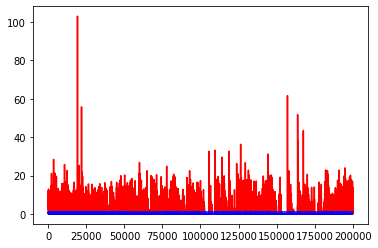

white ratio : 50.0
min : 177
max : 228


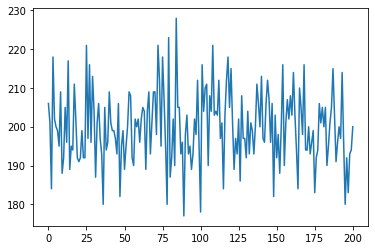

Generating interpolations...


In [50]:
if __name__ == '__main__':
   
    dcgan = DCGAN()
    
    r, c = 5, 5
    check_noise = np.random.uniform(-1, 1, (r * c, 100))
    dcgan.train(iterations=200001, batch_size=32, save_interval=1000,
                model_interval=5000, check_noise=check_noise, r=r,c=c)



In [298]:
n=[]
v=[[1,2,3],[4,5,6],[7,8,9]]
c=[[3,3,3],[3,3,3],[3,3,3]]
v1=np.array(v).reshape(9).tolist()
c1=np.array(c).reshape(9).tolist()
l = list(map(max,v1,c1))
print("max", l)
v1=np.array(v).reshape(9).tolist()
c1=np.array(l).reshape(3,3).tolist()
print("change:",c1)
n.append(c)
n.append(v)
print(n)
#これを[3,2]にしたい。。。
h=np.array(n).reshape(3, 3, 2).tolist()
print(h)

max [3, 3, 3, 4, 5, 6, 7, 8, 9]
change: [[3, 3, 3], [4, 5, 6], [7, 8, 9]]
[[[3, 3, 3], [3, 3, 3], [3, 3, 3]], [[1, 2, 3], [4, 5, 6], [7, 8, 9]]]
[[[3, 3], [3, 3], [3, 3]], [[3, 3], [3, 1], [2, 3]], [[4, 5], [6, 7], [8, 9]]]


In [307]:
v=[[1,2,3],[4,5,6],[7,8,9]]
c=[3,3,3]
v[::3] = c
print(v)

ValueError: attempt to assign sequence of size 3 to extended slice of size 1

In [246]:
import numpy as np

l_2d = [0, 1, 2]
arr_2d = np.array(l_2d)

print(arr_2d.shape)

(3,)


In [251]:
mx=np.array([[[0.0] * 2 for i in range(4)] for i in range(4)])
print(mx.shape)
print(mx)

(4, 4, 2)
[[[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]

 [[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]

 [[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]

 [[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]]


In [254]:
a = np.zeros((4, 4, 2))
print(a.shape)

(4, 4, 2)


In [257]:
np.append(a, a)
print(a.shape)

(4, 4, 2)


In [259]:
b = np.ndarray([1, 2, 3])
print(np.append(b, b))

[0.0e+000 4.9e-324 9.9e-324 1.5e-323 2.0e-323 2.5e-323 0.0e+000 4.9e-324
 9.9e-324 1.5e-323 2.0e-323 2.5e-323]


In [263]:
a = [0, 1, 2]
print(np.array(a).shape)
a.append(a)
print(np.array(a).shape)
print(a)


(3,)
(4,)
[0, 1, 2, [...]]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  after removing the cwd from sys.path.


In [339]:
a = np.zeros([16,4, 4])
b = np.ones([16, 4, 4])

In [324]:
c = np.stack([a, b])
print(c.shape)
print(c)

(2, 4, 4)
[[[0. 0. 0. 0.]
  [0. 0. 0. 0.]
  [0. 0. 0. 0.]
  [0. 0. 0. 0.]]

 [[1. 1. 1. 1.]
  [1. 1. 1. 1.]
  [1. 1. 1. 1.]
  [1. 1. 1. 1.]]]


In [327]:
d = c.reshape([4, 4, 2], order='F')
print(d.shape)
print(d)

(4, 4, 2)
[[[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]

 [[1. 1.]
  [1. 1.]
  [1. 1.]
  [1. 1.]]

 [[0. 0.]
  [0. 0.]
  [0. 0.]
  [0. 0.]]

 [[1. 1.]
  [1. 1.]
  [1. 1.]
  [1. 1.]]]


In [340]:
e = np.stack([a, b], axis=3)
print(e.shape)
print(e)

(16, 4, 4, 2)
[[[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]]


 [[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]]


 [[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]]


 [[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]]


 [[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]]


 [[[0. 1.]
   [0. 1.]
   [0. 1.]
   [0. 1.]]

  [[0. 1.]